In [1]:
from uuid import uuid4

import torch
from torchvision import datasets
from torchvision import transforms

import syft as sy

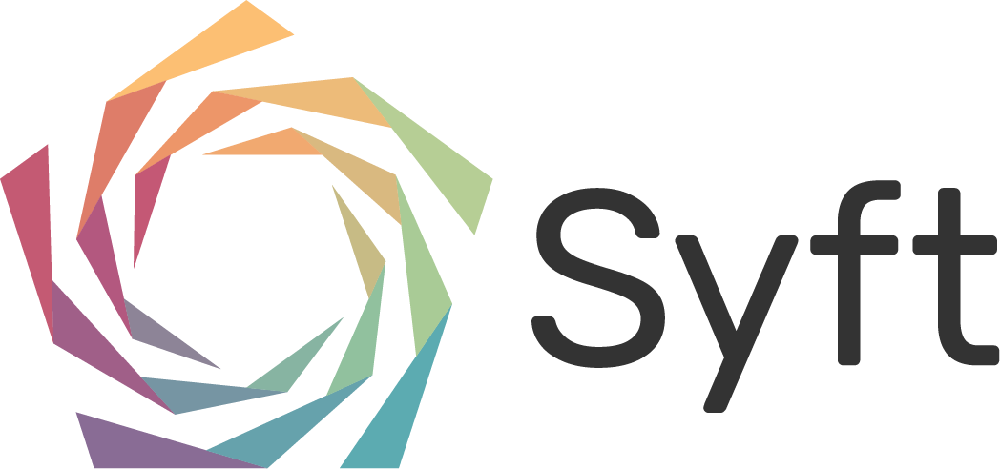

🎤  🎸  ♪♪♪ Starting Duet ♫♫♫  🎻  🎹

♫♫♫ > DISCLAIMER: Duet is an experimental feature currently in beta.
♫♫♫ > Use at your own risk.


    > ❤️ Love Duet? Please consider supporting our community!
    > https://github.com/sponsors/OpenMined

♫♫♫ > Punching through firewall to OpenGrid Network Node at:
♫♫♫ > http://ec2-18-216-8-163.us-east-2.compute.amazonaws.com:5000
♫♫♫ >
♫♫♫ > ...waiting for response from OpenGrid Network... 
♫♫♫ > DONE!

♫♫♫ > STEP 1: Send the following code to your Duet Partner!

import syft as sy
duet = sy.join_duet(loopback=True)

♫♫♫ > Connecting...

♫♫♫ > CONNECTED!

♫♫♫ > DUET LIVE STATUS  *  Objects: 0  Requests: 0   Messages: 0  Request Handlers: 0                                torch.Size([25000, 392])


In [2]:
import syft as sy
duet = sy.duet(loopback=True)

In [3]:
def split_data(dataset, worker_list=None, n_workers=2):

    if worker_list is None:
        worker_list = list(range(0, n_workers))
            
    #counter to create the index of different data samples
    idx = 0 
    
    #dictionary to accomodate the split data
    dic_single_datasets = {}
    for worker in worker_list: 
        """
        Each value is a list of three elements, to accomodate, in order: 
        - data examples (as tensors)
        - label
        - index 
        """
        dic_single_datasets[worker] = [] 

    """
    Loop through the dataset to split the data and labels vertically across workers. 
    Splitting method from @abbas5253: https://github.com/abbas5253/SplitNN-for-Vertically-Partitioned-Data/blob/master/distribute_data.py
    """
    label_list = []
    index_list = []
    index_list_UUID = []
    for tensor, label in dataset:
        height = tensor.shape[-1]//len(worker_list)
        i = 0
        uuid_idx = uuid4()
        for worker in worker_list[:-1]: 
            dic_single_datasets[worker].append(tensor[:, :, height * i : height * (i + 1)])
            i += 1
            
        #add the value of the last worker / split
        dic_single_datasets[worker_list[-1]].append(tensor[:, :, height * (i) : ])
        label_list.append(torch.Tensor([label]))
        index_list_UUID.append(uuid_idx)
        index_list.append(torch.Tensor([idx]))
        
        idx += 1
        
    return dic_single_datasets, label_list, index_list, index_list_UUID

In [4]:
transform = transforms.Compose([transforms.ToTensor(),
                              transforms.Normalize((0.5,), (0.5,)),
                              ])
trainset = datasets.MNIST('mnist', download=True, train=True, transform=transform)

In [5]:
valset = datasets.MNIST('mnist', download=True, train=False, transform=transform)

In [6]:
img, _, _, _ = split_data(trainset)
img = torch.cat(img[1][:25_000])
img_rshp = img.view(img.shape[0], -1)
print(img_rshp.shape)

In [7]:
val_img, _, _, _ = split_data(valset)
val_img = torch.cat(val_img[1][:5_000])
val_img_rshp = val_img.view(val_img.shape[0], -1)
print(val_img_rshp.shape)

torch.Size([5000, 392])


In [8]:
img_rshp.send(duet, searchable=True, tags=["flatten"], description="flattened")
val_img_rshp.send(duet, searchable=True, tags=["flatten_val"], description="flattened")

In [9]:
duet.requests.add_handler(action="accept", tags=[""])

Exception in callback Transaction.__retry()
handle: <TimerHandle when=9931.549939031 Transaction.__retry()>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/aioice/stun.py", line 306, in __retry
    self.__future.set_exception(TransactionTimeout())
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/futures.py", line 246, in set_exception
    raise exceptions.InvalidStateError(f'{self._state}: {self!r}')
asyncio.exceptions.InvalidStateError: FINISHED: <Future finished result=(Message(messa...\xd2\xa9\x8b'), ('172.25.154.90', 54521))>
/mnt/g/Projects/PySyft/src/syft/lib/torch/uppercase_tensor.py:30: UserWarning: The .grad attribute of a Tensor that is not a leaf Tensor is being accessed. Its .grad attribute won't be populated during autograd.backward(). If y

[2021-02-25T21:20:45.190216+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 051e876d1e954ef2a34f84f0e576f62f>.
[2021-02-25T21:20:45.311911+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4a87c10b3fd44f96980a6ddf20b15982>.
[2021-02-25T21:20:45.426321+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ff2b42aa771343e59588c65593d693a5> <UID: ff2b42aa771343e59588c65593d693a5>
[2021-02-25T21:20:45.426495+0000][CRITICAL][logger]][645] <UID: ff2b42aa771343e59588c65593d693a5>
[2021-02-25T21:20:45.426617+0000][CRITICAL][logger]][645] <UID: ff2b42aa771343e59588c65593d693a5>
[2021-02-25T21:20:45.426726+0000][CRITICAL][logger]][645] <UID: ff2b42aa771343e59588c65593d693a5>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...65593d693a5>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:20:45.929150+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 6e4be0d4895d48d18d3c19e194d26982> <UID: 6e4be0d4895d48d18d3c19e194d26982>
[2021-02-25T21:20:45.929380+0000][CRITICAL][logger]][645] <UID: 6e4be0d4895d48d18d3c19e194d26982>
[2021-02-25T21:20:45.929504+0000][CRITICAL][logger]][645] <UID: 6e4be0d4895d48d18d3c19e194d26982>
[2021-02-25T21:20:45.929616+0000][CRITICAL][logger]][645] <UID: 6e4be0d4895d48d18d3c19e194d26982>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9e194d26982>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9e194d26982>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:20:46.432508+0000][CRITICAL][logger]][645] <UID: 74c3514d1f5646b7bc21fa1b728f36b5>
[2021-02-25T21:20:46.432620+0000][CRITICAL][logger]][645] <UID: 74c3514d1f5646b7bc21fa1b728f36b5>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a1b728f36b5>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a1b728f36b5>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:20:46.954992+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5faae8c7d01348fd88f588226d03292d>.
[2021-02-25T21:20:47.071551+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c0dae50eca4f457ca509b9d29b596564>.
[2021-02-25T21:20:47.186189+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 69f0c1fc61b944f7b22ca3ba8790e1b9> <UID: 69f0c1fc61b944f7b22ca3ba8790e1b9>
[2021-02-25T21:20:47.186374+0000][CRITICAL][logger]][645] <UID: 69f0c1fc61b944f7b22ca3ba8790e1b9>
[2021-02-25T21:20:47.186494+0000][CRITICAL][logger]][645] <UID: 69f0c1fc61b944f7b22ca3ba8790e1b9>
[2021-02-25T21:20:47.186604+0000][CRITICAL][logger]][645] <UID: 69f0c1fc61b944f7b22ca3ba8790e1b9>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3ba8790e1b9>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:20:47.698153+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: cc5d0a33c9634a20a15901b8909ef610> <UID: cc5d0a33c9634a20a15901b8909ef610>
[2021-02-25T21:20:47.698326+0000][CRITICAL][logger]][645] <UID: cc5d0a33c9634a20a15901b8909ef610>
[2021-02-25T21:20:47.698448+0000][CRITICAL][logger]][645] <UID: cc5d0a33c9634a20a15901b8909ef610>
[2021-02-25T21:20:47.698574+0000][CRITICAL][logger]][645] <UID: cc5d0a33c9634a20a15901b8909ef610>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1b8909ef610>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1b8909ef610>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:20:48.206002+0000][CRITICAL][logger]][645] <UID: 540dfabbf86c481dbf959ad978ae62f6>
[2021-02-25T21:20:48.206114+0000][CRITICAL][logger]][645] <UID: 540dfabbf86c481dbf959ad978ae62f6>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ad978ae62f6>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ad978ae62f6>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:20:48.734268+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: fc839ca938e34ee08e695e5b113b6b0f>.
[2021-02-25T21:20:48.852118+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3e278bde907e46c092d6364ea8545ebf>.
[2021-02-25T21:20:48.967289+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 16738eb748d648879e97b2d4cb770f8f> <UID: 16738eb748d648879e97b2d4cb770f8f>
[2021-02-25T21:20:48.967472+0000][CRITICAL][logger]][645] <UID: 16738eb748d648879e97b2d4cb770f8f>
[2021-02-25T21:20:48.967591+0000][CRITICAL][logger]][645] <UID: 16738eb748d648879e97b2d4cb770f8f>
[2021-02-25T21:20:48.967704+0000][CRITICAL][logger]][645] <UID: 16738eb748d648879e97b2d4cb770f8f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2d4cb770f8f>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:20:49.472266+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 15210951b5f44e60b7ae4c0c7c6d154e> <UID: 15210951b5f44e60b7ae4c0c7c6d154e>
[2021-02-25T21:20:49.472780+0000][CRITICAL][logger]][645] <UID: 15210951b5f44e60b7ae4c0c7c6d154e>
[2021-02-25T21:20:49.472933+0000][CRITICAL][logger]][645] <UID: 15210951b5f44e60b7ae4c0c7c6d154e>
[2021-02-25T21:20:49.473051+0000][CRITICAL][logger]][645] <UID: 15210951b5f44e60b7ae4c0c7c6d154e>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c0c7c6d154e>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c0c7c6d154e>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:20:49.977024+0000][CRITICAL][logger]][645] <UID: 4ec056214ea64347af7e2f5694cdaf03>
[2021-02-25T21:20:49.977141+0000][CRITICAL][logger]][645] <UID: 4ec056214ea64347af7e2f5694cdaf03>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f5694cdaf03>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f5694cdaf03>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:20:50.503363+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b3c3da0e89434383b6fa8dfdd0ac5d7a>.
[2021-02-25T21:20:50.619223+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e54c7979594b4dfb8db6119c60b8f735>.
[2021-02-25T21:20:50.734006+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a40b44a958c14a7381e135f45f177244> <UID: a40b44a958c14a7381e135f45f177244>
[2021-02-25T21:20:50.734174+0000][CRITICAL][logger]][645] <UID: a40b44a958c14a7381e135f45f177244>
[2021-02-25T21:20:50.734296+0000][CRITICAL][logger]][645] <UID: a40b44a958c14a7381e135f45f177244>
[2021-02-25T21:20:50.734419+0000][CRITICAL][logger]][645] <UID: a40b44a958c14a7381e135f45f177244>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5f45f177244>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:20:51.238170+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e4b508c97d964f14a2fad3a5ab159ec7> <UID: e4b508c97d964f14a2fad3a5ab159ec7>
[2021-02-25T21:20:51.238363+0000][CRITICAL][logger]][645] <UID: e4b508c97d964f14a2fad3a5ab159ec7>
[2021-02-25T21:20:51.238489+0000][CRITICAL][logger]][645] <UID: e4b508c97d964f14a2fad3a5ab159ec7>
[2021-02-25T21:20:51.238600+0000][CRITICAL][logger]][645] <UID: e4b508c97d964f14a2fad3a5ab159ec7>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3a5ab159ec7>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3a5ab159ec7>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:20:51.742505+0000][CRITICAL][logger]][645] <UID: 18fd6cb72ad34282b280b01eebbd79da>
[2021-02-25T21:20:51.742616+0000][CRITICAL][logger]][645] <UID: 18fd6cb72ad34282b280b01eebbd79da>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...01eebbd79da>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...01eebbd79da>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:20:52.269103+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c0876f2a8ff24cf1a733bc7b4c07c509>.
[2021-02-25T21:20:52.385271+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 898183b836fa40f085f7d7acefdd0f70>.
[2021-02-25T21:20:52.504032+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 804b9510217046048db2420012434c25> <UID: 804b9510217046048db2420012434c25>
[2021-02-25T21:20:52.504273+0000][CRITICAL][logger]][645] <UID: 804b9510217046048db2420012434c25>
[2021-02-25T21:20:52.504409+0000][CRITICAL][logger]][645] <UID: 804b9510217046048db2420012434c25>
[2021-02-25T21:20:52.504517+0000][CRITICAL][logger]][645] <UID: 804b9510217046048db2420012434c25>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...20012434c25>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:20:53.005530+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a5949fcfdb024adaaa773971c8ba2017> <UID: a5949fcfdb024adaaa773971c8ba2017>
[2021-02-25T21:20:53.005697+0000][CRITICAL][logger]][645] <UID: a5949fcfdb024adaaa773971c8ba2017>
[2021-02-25T21:20:53.005819+0000][CRITICAL][logger]][645] <UID: a5949fcfdb024adaaa773971c8ba2017>
[2021-02-25T21:20:53.005929+0000][CRITICAL][logger]][645] <UID: a5949fcfdb024adaaa773971c8ba2017>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...971c8ba2017>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...971c8ba2017>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:20:53.508421+0000][CRITICAL][logger]][645] <UID: a8750257f8f24cfda777f6f8e708a667>
[2021-02-25T21:20:53.508530+0000][CRITICAL][logger]][645] <UID: a8750257f8f24cfda777f6f8e708a667>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6f8e708a667>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6f8e708a667>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:20:54.032050+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 12d9d48616ab4616888ffde2d3d0c822>.
[2021-02-25T21:20:54.148638+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0410d15e59b44050877549f185bd721f>.
[2021-02-25T21:20:54.263098+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 69523f66a71f42329bfc561a37fbe117> <UID: 69523f66a71f42329bfc561a37fbe117>
[2021-02-25T21:20:54.263264+0000][CRITICAL][logger]][645] <UID: 69523f66a71f42329bfc561a37fbe117>
[2021-02-25T21:20:54.263384+0000][CRITICAL][logger]][645] <UID: 69523f66a71f42329bfc561a37fbe117>
[2021-02-25T21:20:54.263509+0000][CRITICAL][logger]][645] <UID: 69523f66a71f42329bfc561a37fbe117>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...61a37fbe117>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:20:54.767796+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 084152b48e284d4cb68f0c3fde8caf3c> <UID: 084152b48e284d4cb68f0c3fde8caf3c>
[2021-02-25T21:20:54.767978+0000][CRITICAL][logger]][645] <UID: 084152b48e284d4cb68f0c3fde8caf3c>
[2021-02-25T21:20:54.768097+0000][CRITICAL][logger]][645] <UID: 084152b48e284d4cb68f0c3fde8caf3c>
[2021-02-25T21:20:54.768207+0000][CRITICAL][logger]][645] <UID: 084152b48e284d4cb68f0c3fde8caf3c>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c3fde8caf3c>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c3fde8caf3c>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:20:55.270822+0000][CRITICAL][logger]][645] <UID: 814105781be74c5cb2a943aaaf01458a>
[2021-02-25T21:20:55.270933+0000][CRITICAL][logger]][645] <UID: 814105781be74c5cb2a943aaaf01458a>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3aaaf01458a>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3aaaf01458a>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:20:55.796978+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0fc57ca72ae84adfb7402df69fda7856>.
[2021-02-25T21:20:55.917481+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 85a32c1c84f742c3a9bb5d1588716dfa>.
[2021-02-25T21:20:56.031737+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c993e710a8f44dc28eb896f35f7c4f20> <UID: c993e710a8f44dc28eb896f35f7c4f20>
[2021-02-25T21:20:56.031917+0000][CRITICAL][logger]][645] <UID: c993e710a8f44dc28eb896f35f7c4f20>
[2021-02-25T21:20:56.032035+0000][CRITICAL][logger]][645] <UID: c993e710a8f44dc28eb896f35f7c4f20>
[2021-02-25T21:20:56.032145+0000][CRITICAL][logger]][645] <UID: c993e710a8f44dc28eb896f35f7c4f20>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6f35f7c4f20>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:20:56.536494+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: dc2c111c24984d6dadc5aaef41618451> <UID: dc2c111c24984d6dadc5aaef41618451>
[2021-02-25T21:20:56.536660+0000][CRITICAL][logger]][645] <UID: dc2c111c24984d6dadc5aaef41618451>
[2021-02-25T21:20:56.536780+0000][CRITICAL][logger]][645] <UID: dc2c111c24984d6dadc5aaef41618451>
[2021-02-25T21:20:56.536914+0000][CRITICAL][logger]][645] <UID: dc2c111c24984d6dadc5aaef41618451>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...aef41618451>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...aef41618451>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:20:57.040177+0000][CRITICAL][logger]][645] <UID: 15c9b1a606b44a21b101ba38fa304ed0>
[2021-02-25T21:20:57.040288+0000][CRITICAL][logger]][645] <UID: 15c9b1a606b44a21b101ba38fa304ed0>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a38fa304ed0>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a38fa304ed0>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:20:57.566461+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9f8694d3e4974d749895d73811eeb95b>.
[2021-02-25T21:20:57.685624+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 537e056ae67d4a05be0b55ec037c26b0>.
[2021-02-25T21:20:57.800359+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 5e2bbb391e9c4c4a81cd7bd121e2fcc2> <UID: 5e2bbb391e9c4c4a81cd7bd121e2fcc2>
[2021-02-25T21:20:57.800523+0000][CRITICAL][logger]][645] <UID: 5e2bbb391e9c4c4a81cd7bd121e2fcc2>
[2021-02-25T21:20:57.800655+0000][CRITICAL][logger]][645] <UID: 5e2bbb391e9c4c4a81cd7bd121e2fcc2>
[2021-02-25T21:20:57.800765+0000][CRITICAL][logger]][645] <UID: 5e2bbb391e9c4c4a81cd7bd121e2fcc2>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...bd121e2fcc2>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:20:58.307886+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d5fab5e8a35847e983fd9e56dbaf9c7d> <UID: d5fab5e8a35847e983fd9e56dbaf9c7d>
[2021-02-25T21:20:58.308057+0000][CRITICAL][logger]][645] <UID: d5fab5e8a35847e983fd9e56dbaf9c7d>
[2021-02-25T21:20:58.308175+0000][CRITICAL][logger]][645] <UID: d5fab5e8a35847e983fd9e56dbaf9c7d>
[2021-02-25T21:20:58.308285+0000][CRITICAL][logger]][645] <UID: d5fab5e8a35847e983fd9e56dbaf9c7d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e56dbaf9c7d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e56dbaf9c7d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:20:58.816283+0000][CRITICAL][logger]][645] <UID: d51c63dcbb6e4b91ae8b657f7b2130f4>
[2021-02-25T21:20:58.816406+0000][CRITICAL][logger]][645] <UID: d51c63dcbb6e4b91ae8b657f7b2130f4>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...57f7b2130f4>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...57f7b2130f4>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:20:59.338773+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: da15950b85ef4902a0945744fd341a05>.
[2021-02-25T21:20:59.456716+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c24b92dc900e444581e458750a37d2ec>.
[2021-02-25T21:20:59.570872+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 979597e0f2c9475e888bbafeec987cae> <UID: 979597e0f2c9475e888bbafeec987cae>
[2021-02-25T21:20:59.571285+0000][CRITICAL][logger]][645] <UID: 979597e0f2c9475e888bbafeec987cae>
[2021-02-25T21:20:59.571411+0000][CRITICAL][logger]][645] <UID: 979597e0f2c9475e888bbafeec987cae>
[2021-02-25T21:20:59.571521+0000][CRITICAL][logger]][645] <UID: 979597e0f2c9475e888bbafeec987cae>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...afeec987cae>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:21:00.078779+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 36a8b330067d40faa59a30f811728775> <UID: 36a8b330067d40faa59a30f811728775>
[2021-02-25T21:21:00.078968+0000][CRITICAL][logger]][645] <UID: 36a8b330067d40faa59a30f811728775>
[2021-02-25T21:21:00.079094+0000][CRITICAL][logger]][645] <UID: 36a8b330067d40faa59a30f811728775>
[2021-02-25T21:21:00.079209+0000][CRITICAL][logger]][645] <UID: 36a8b330067d40faa59a30f811728775>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0f811728775>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0f811728775>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:21:00.583561+0000][CRITICAL][logger]][645] <UID: 4a6c3a8a693045aead34651d2755abed>
[2021-02-25T21:21:00.583673+0000][CRITICAL][logger]][645] <UID: 4a6c3a8a693045aead34651d2755abed>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...51d2755abed>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...51d2755abed>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:21:01.106125+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 01f43978532549da91c20bed81baff47>.
[2021-02-25T21:21:01.222922+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: dcc8a655b8cc4934a374529cf82e91ea>.
[2021-02-25T21:21:01.339458+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 125549d9d075416b85f5a039ee1543e7> <UID: 125549d9d075416b85f5a039ee1543e7>
[2021-02-25T21:21:01.339629+0000][CRITICAL][logger]][645] <UID: 125549d9d075416b85f5a039ee1543e7>
[2021-02-25T21:21:01.339749+0000][CRITICAL][logger]][645] <UID: 125549d9d075416b85f5a039ee1543e7>
[2021-02-25T21:21:01.339857+0000][CRITICAL][logger]][645] <UID: 125549d9d075416b85f5a039ee1543e7>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...039ee1543e7>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:21:01.841293+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 7df7e19cf9b44da59e3871e89b9b5588> <UID: 7df7e19cf9b44da59e3871e89b9b5588>
[2021-02-25T21:21:01.841463+0000][CRITICAL][logger]][645] <UID: 7df7e19cf9b44da59e3871e89b9b5588>
[2021-02-25T21:21:01.841583+0000][CRITICAL][logger]][645] <UID: 7df7e19cf9b44da59e3871e89b9b5588>
[2021-02-25T21:21:01.841693+0000][CRITICAL][logger]][645] <UID: 7df7e19cf9b44da59e3871e89b9b5588>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1e89b9b5588>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1e89b9b5588>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:21:02.344463+0000][CRITICAL][logger]][645] <UID: 076e53f9710545998db3d5830658a3ed>
[2021-02-25T21:21:02.344574+0000][CRITICAL][logger]][645] <UID: 076e53f9710545998db3d5830658a3ed>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5830658a3ed>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5830658a3ed>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:21:02.865335+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3e3c62abd4fe464296640515375d8947>.
[2021-02-25T21:21:02.981720+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: de967cd068c24474b10da99a560c8fd5>.
[2021-02-25T21:21:03.095779+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b26bf7fbb7c945a995401ab8c0b8605c> <UID: b26bf7fbb7c945a995401ab8c0b8605c>
[2021-02-25T21:21:03.095959+0000][CRITICAL][logger]][645] <UID: b26bf7fbb7c945a995401ab8c0b8605c>
[2021-02-25T21:21:03.096082+0000][CRITICAL][logger]][645] <UID: b26bf7fbb7c945a995401ab8c0b8605c>
[2021-02-25T21:21:03.096192+0000][CRITICAL][logger]][645] <UID: b26bf7fbb7c945a995401ab8c0b8605c>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ab8c0b8605c>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:21:03.597157+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 1931c5cc56c74232bf5b5c0721f814eb> <UID: 1931c5cc56c74232bf5b5c0721f814eb>
[2021-02-25T21:21:03.597326+0000][CRITICAL][logger]][645] <UID: 1931c5cc56c74232bf5b5c0721f814eb>
[2021-02-25T21:21:03.597447+0000][CRITICAL][logger]][645] <UID: 1931c5cc56c74232bf5b5c0721f814eb>
[2021-02-25T21:21:03.597566+0000][CRITICAL][logger]][645] <UID: 1931c5cc56c74232bf5b5c0721f814eb>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c0721f814eb>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c0721f814eb>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:21:04.100255+0000][CRITICAL][logger]][645] <UID: 858c7576cb974608948b98a4b989d9c0>
[2021-02-25T21:21:04.100378+0000][CRITICAL][logger]][645] <UID: 858c7576cb974608948b98a4b989d9c0>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8a4b989d9c0>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8a4b989d9c0>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:21:04.622458+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f2c8a45315d94cfa843902febbf69ed5>.
[2021-02-25T21:21:04.739050+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2046871284f74f7b81ae1c7c8207f50c>.
[2021-02-25T21:21:04.853402+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 3e5187b7717f46b8a5c10b82fa28d827> <UID: 3e5187b7717f46b8a5c10b82fa28d827>
[2021-02-25T21:21:04.853569+0000][CRITICAL][logger]][645] <UID: 3e5187b7717f46b8a5c10b82fa28d827>
[2021-02-25T21:21:04.853688+0000][CRITICAL][logger]][645] <UID: 3e5187b7717f46b8a5c10b82fa28d827>
[2021-02-25T21:21:04.853801+0000][CRITICAL][logger]][645] <UID: 3e5187b7717f46b8a5c10b82fa28d827>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b82fa28d827>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:21:05.355664+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 99ce3c76a27f41aa80a587b80218789d> <UID: 99ce3c76a27f41aa80a587b80218789d>
[2021-02-25T21:21:05.355833+0000][CRITICAL][logger]][645] <UID: 99ce3c76a27f41aa80a587b80218789d>
[2021-02-25T21:21:05.355955+0000][CRITICAL][logger]][645] <UID: 99ce3c76a27f41aa80a587b80218789d>
[2021-02-25T21:21:05.356065+0000][CRITICAL][logger]][645] <UID: 99ce3c76a27f41aa80a587b80218789d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7b80218789d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7b80218789d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:21:05.858936+0000][CRITICAL][logger]][645] <UID: d443bc39626441bbacf0498f4b79b0fb>
[2021-02-25T21:21:05.859046+0000][CRITICAL][logger]][645] <UID: d443bc39626441bbacf0498f4b79b0fb>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...98f4b79b0fb>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...98f4b79b0fb>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:21:06.382043+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c665d8512bc74abc8b044942c96a843c>.
[2021-02-25T21:21:06.497964+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: fbcbbce7d5bf43149cf56479949b62d8>.
[2021-02-25T21:21:06.612609+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c3d1fca15cae4bfea3418056a7ba709d> <UID: c3d1fca15cae4bfea3418056a7ba709d>
[2021-02-25T21:21:06.612775+0000][CRITICAL][logger]][645] <UID: c3d1fca15cae4bfea3418056a7ba709d>
[2021-02-25T21:21:06.612906+0000][CRITICAL][logger]][645] <UID: c3d1fca15cae4bfea3418056a7ba709d>
[2021-02-25T21:21:06.613014+0000][CRITICAL][logger]][645] <UID: c3d1fca15cae4bfea3418056a7ba709d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...056a7ba709d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:21:07.114854+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 169ee6db36fb49c69388636af6379f8a> <UID: 169ee6db36fb49c69388636af6379f8a>
[2021-02-25T21:21:07.115050+0000][CRITICAL][logger]][645] <UID: 169ee6db36fb49c69388636af6379f8a>
[2021-02-25T21:21:07.115170+0000][CRITICAL][logger]][645] <UID: 169ee6db36fb49c69388636af6379f8a>
[2021-02-25T21:21:07.115280+0000][CRITICAL][logger]][645] <UID: 169ee6db36fb49c69388636af6379f8a>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...36af6379f8a>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...36af6379f8a>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:21:07.617435+0000][CRITICAL][logger]][645] <UID: d4d5c5a5746749cf9b99a176f2c0d1b3>
[2021-02-25T21:21:07.617544+0000][CRITICAL][logger]][645] <UID: d4d5c5a5746749cf9b99a176f2c0d1b3>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...176f2c0d1b3>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...176f2c0d1b3>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:21:08.139822+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5b7fbc5702a34ad4b23da2aeb8cce838>.
[2021-02-25T21:21:08.260524+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f1d5ed23e29d488cb6c35bde24646a69>.
[2021-02-25T21:21:08.374915+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: eff72525c80b4d4b949276749d869dc4> <UID: eff72525c80b4d4b949276749d869dc4>
[2021-02-25T21:21:08.375115+0000][CRITICAL][logger]][645] <UID: eff72525c80b4d4b949276749d869dc4>
[2021-02-25T21:21:08.375234+0000][CRITICAL][logger]][645] <UID: eff72525c80b4d4b949276749d869dc4>
[2021-02-25T21:21:08.375359+0000][CRITICAL][logger]][645] <UID: eff72525c80b4d4b949276749d869dc4>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6749d869dc4>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:21:08.879237+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a899481efbcc42ae83bdcd547e9aa646> <UID: a899481efbcc42ae83bdcd547e9aa646>
[2021-02-25T21:21:08.879416+0000][CRITICAL][logger]][645] <UID: a899481efbcc42ae83bdcd547e9aa646>
[2021-02-25T21:21:08.879534+0000][CRITICAL][logger]][645] <UID: a899481efbcc42ae83bdcd547e9aa646>
[2021-02-25T21:21:08.879643+0000][CRITICAL][logger]][645] <UID: a899481efbcc42ae83bdcd547e9aa646>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d547e9aa646>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d547e9aa646>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:21:09.383241+0000][CRITICAL][logger]][645] <UID: 1ec8b1f1e25a41a6b7b31840834353d1>
[2021-02-25T21:21:09.383368+0000][CRITICAL][logger]][645] <UID: 1ec8b1f1e25a41a6b7b31840834353d1>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...840834353d1>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...840834353d1>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:21:09.906303+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: db98a0e348844743afbaad44bf2109f3>.
[2021-02-25T21:21:10.024135+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: fc80ff07e1ac4d3385c5615d47239e27>.
[2021-02-25T21:21:10.138402+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ee9ab04fd2ad46209ec8059f2674c13d> <UID: ee9ab04fd2ad46209ec8059f2674c13d>
[2021-02-25T21:21:10.138569+0000][CRITICAL][logger]][645] <UID: ee9ab04fd2ad46209ec8059f2674c13d>
[2021-02-25T21:21:10.138688+0000][CRITICAL][logger]][645] <UID: ee9ab04fd2ad46209ec8059f2674c13d>
[2021-02-25T21:21:10.138811+0000][CRITICAL][logger]][645] <UID: ee9ab04fd2ad46209ec8059f2674c13d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...59f2674c13d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:21:10.641740+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 1a66bb95f5404e2cbb000eb4e145d315> <UID: 1a66bb95f5404e2cbb000eb4e145d315>
[2021-02-25T21:21:10.641918+0000][CRITICAL][logger]][645] <UID: 1a66bb95f5404e2cbb000eb4e145d315>
[2021-02-25T21:21:10.642037+0000][CRITICAL][logger]][645] <UID: 1a66bb95f5404e2cbb000eb4e145d315>
[2021-02-25T21:21:10.642145+0000][CRITICAL][logger]][645] <UID: 1a66bb95f5404e2cbb000eb4e145d315>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...eb4e145d315>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...eb4e145d315>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:21:11.145471+0000][CRITICAL][logger]][645] <UID: 8248089fbfe6448cabf72a6612924d0a>
[2021-02-25T21:21:11.145579+0000][CRITICAL][logger]][645] <UID: 8248089fbfe6448cabf72a6612924d0a>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a6612924d0a>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a6612924d0a>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:21:11.670145+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e6407b9d48444b87900d659cf1d2710f>.
[2021-02-25T21:21:11.787339+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: cb691365de66420fba507793c259b83e>.
[2021-02-25T21:21:11.901920+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c96f11b76c3542ea9aceb587198bd181> <UID: c96f11b76c3542ea9aceb587198bd181>
[2021-02-25T21:21:11.902093+0000][CRITICAL][logger]][645] <UID: c96f11b76c3542ea9aceb587198bd181>
[2021-02-25T21:21:11.902213+0000][CRITICAL][logger]][645] <UID: c96f11b76c3542ea9aceb587198bd181>
[2021-02-25T21:21:11.902334+0000][CRITICAL][logger]][645] <UID: c96f11b76c3542ea9aceb587198bd181>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...587198bd181>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:21:12.407470+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 735293d6bc1e4404af21fb7dc3e778b3> <UID: 735293d6bc1e4404af21fb7dc3e778b3>
[2021-02-25T21:21:12.407636+0000][CRITICAL][logger]][645] <UID: 735293d6bc1e4404af21fb7dc3e778b3>
[2021-02-25T21:21:12.407755+0000][CRITICAL][logger]][645] <UID: 735293d6bc1e4404af21fb7dc3e778b3>
[2021-02-25T21:21:12.407876+0000][CRITICAL][logger]][645] <UID: 735293d6bc1e4404af21fb7dc3e778b3>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b7dc3e778b3>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b7dc3e778b3>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:21:12.911274+0000][CRITICAL][logger]][645] <UID: 1799c9495a4c4c26b13e9c2a583d3bd5>
[2021-02-25T21:21:12.911395+0000][CRITICAL][logger]][645] <UID: 1799c9495a4c4c26b13e9c2a583d3bd5>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c2a583d3bd5>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c2a583d3bd5>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:21:13.435545+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e405ad4f110443318039295c65f273e9>.
[2021-02-25T21:21:13.553258+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 636c9368688d45e7b4b55ac6f79d41ec>.
[2021-02-25T21:21:13.667934+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 29b06e25d4b543948abb8acb4d1f1862> <UID: 29b06e25d4b543948abb8acb4d1f1862>
[2021-02-25T21:21:13.668103+0000][CRITICAL][logger]][645] <UID: 29b06e25d4b543948abb8acb4d1f1862>
[2021-02-25T21:21:13.668222+0000][CRITICAL][logger]][645] <UID: 29b06e25d4b543948abb8acb4d1f1862>
[2021-02-25T21:21:13.668343+0000][CRITICAL][logger]][645] <UID: 29b06e25d4b543948abb8acb4d1f1862>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...acb4d1f1862>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:21:14.171522+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d7f0b19b39ef4c939d6c89ee9808d876> <UID: d7f0b19b39ef4c939d6c89ee9808d876>
[2021-02-25T21:21:14.171689+0000][CRITICAL][logger]][645] <UID: d7f0b19b39ef4c939d6c89ee9808d876>
[2021-02-25T21:21:14.171817+0000][CRITICAL][logger]][645] <UID: d7f0b19b39ef4c939d6c89ee9808d876>
[2021-02-25T21:21:14.171925+0000][CRITICAL][logger]][645] <UID: d7f0b19b39ef4c939d6c89ee9808d876>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9ee9808d876>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9ee9808d876>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:21:14.676393+0000][CRITICAL][logger]][645] <UID: f3a1e2c8794a47d2809c5d7b103b66ee>
[2021-02-25T21:21:14.676501+0000][CRITICAL][logger]][645] <UID: f3a1e2c8794a47d2809c5d7b103b66ee>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d7b103b66ee>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d7b103b66ee>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:21:15.200156+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 330100b1f91d40ada462a951b2c5b539>.
[2021-02-25T21:21:15.317364+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f97be4b88a4d44a98d8a71cddb6f41d2>.
[2021-02-25T21:21:15.432132+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 92d9896df81149cba850e4a27f12e631> <UID: 92d9896df81149cba850e4a27f12e631>
[2021-02-25T21:21:15.432315+0000][CRITICAL][logger]][645] <UID: 92d9896df81149cba850e4a27f12e631>
[2021-02-25T21:21:15.432432+0000][CRITICAL][logger]][645] <UID: 92d9896df81149cba850e4a27f12e631>
[2021-02-25T21:21:15.432539+0000][CRITICAL][logger]][645] <UID: 92d9896df81149cba850e4a27f12e631>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4a27f12e631>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:21:15.935122+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 5b2daac03607405298a766ffe5238f15> <UID: 5b2daac03607405298a766ffe5238f15>
[2021-02-25T21:21:15.935288+0000][CRITICAL][logger]][645] <UID: 5b2daac03607405298a766ffe5238f15>
[2021-02-25T21:21:15.935418+0000][CRITICAL][logger]][645] <UID: 5b2daac03607405298a766ffe5238f15>
[2021-02-25T21:21:15.935525+0000][CRITICAL][logger]][645] <UID: 5b2daac03607405298a766ffe5238f15>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6ffe5238f15>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6ffe5238f15>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:21:16.438117+0000][CRITICAL][logger]][645] <UID: b5720753b2d24a3bbce9710ea1c1c138>
[2021-02-25T21:21:16.438227+0000][CRITICAL][logger]][645] <UID: b5720753b2d24a3bbce9710ea1c1c138>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...10ea1c1c138>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...10ea1c1c138>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:21:16.959483+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3636189a978c454a90448d57dde506db>.
[2021-02-25T21:21:17.076475+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 960e44e9668d46f0923e48906abeab82>.
[2021-02-25T21:21:17.191387+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 739b642af56449cab5e1d76e5a3d4f21> <UID: 739b642af56449cab5e1d76e5a3d4f21>
[2021-02-25T21:21:17.191555+0000][CRITICAL][logger]][645] <UID: 739b642af56449cab5e1d76e5a3d4f21>
[2021-02-25T21:21:17.191674+0000][CRITICAL][logger]][645] <UID: 739b642af56449cab5e1d76e5a3d4f21>
[2021-02-25T21:21:17.191783+0000][CRITICAL][logger]][645] <UID: 739b642af56449cab5e1d76e5a3d4f21>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...76e5a3d4f21>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:21:17.692995+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 5bd2806ac4514f9b857ca0a1859b4b0f> <UID: 5bd2806ac4514f9b857ca0a1859b4b0f>
[2021-02-25T21:21:17.693161+0000][CRITICAL][logger]][645] <UID: 5bd2806ac4514f9b857ca0a1859b4b0f>
[2021-02-25T21:21:17.693279+0000][CRITICAL][logger]][645] <UID: 5bd2806ac4514f9b857ca0a1859b4b0f>
[2021-02-25T21:21:17.693400+0000][CRITICAL][logger]][645] <UID: 5bd2806ac4514f9b857ca0a1859b4b0f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0a1859b4b0f>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0a1859b4b0f>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:21:18.196872+0000][CRITICAL][logger]][645] <UID: 1af4f322f3194ed08f47f947900b26bc>
[2021-02-25T21:21:18.196981+0000][CRITICAL][logger]][645] <UID: 1af4f322f3194ed08f47f947900b26bc>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...947900b26bc>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...947900b26bc>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:21:18.718020+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2a16e095be4b4cef823f112a18588d54>.
[2021-02-25T21:21:18.835312+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d0f203984de74344bdb6b528a4c49029>.
[2021-02-25T21:21:18.949964+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f28e5f53c7cf438d8d0ddea148e6a388> <UID: f28e5f53c7cf438d8d0ddea148e6a388>
[2021-02-25T21:21:18.950130+0000][CRITICAL][logger]][645] <UID: f28e5f53c7cf438d8d0ddea148e6a388>
[2021-02-25T21:21:18.950248+0000][CRITICAL][logger]][645] <UID: f28e5f53c7cf438d8d0ddea148e6a388>
[2021-02-25T21:21:18.950369+0000][CRITICAL][logger]][645] <UID: f28e5f53c7cf438d8d0ddea148e6a388>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ea148e6a388>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:21:19.454915+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 5a4ca003f68343c99697d7d1ada18dcc> <UID: 5a4ca003f68343c99697d7d1ada18dcc>
[2021-02-25T21:21:19.455130+0000][CRITICAL][logger]][645] <UID: 5a4ca003f68343c99697d7d1ada18dcc>
[2021-02-25T21:21:19.455251+0000][CRITICAL][logger]][645] <UID: 5a4ca003f68343c99697d7d1ada18dcc>
[2021-02-25T21:21:19.455380+0000][CRITICAL][logger]][645] <UID: 5a4ca003f68343c99697d7d1ada18dcc>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7d1ada18dcc>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7d1ada18dcc>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:21:19.958402+0000][CRITICAL][logger]][645] <UID: 0c5576ce0c9d49dd8c659f8dcf913d2f>
[2021-02-25T21:21:19.958514+0000][CRITICAL][logger]][645] <UID: 0c5576ce0c9d49dd8c659f8dcf913d2f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f8dcf913d2f>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f8dcf913d2f>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:21:20.480325+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ae9e94eb2e514726beb76a85322059fa>.
[2021-02-25T21:21:20.596972+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ae8e365527a247aebe444e5c951466c6>.
[2021-02-25T21:21:20.711515+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 5fbf9a5abf2547e6b53675cc8797dc3d> <UID: 5fbf9a5abf2547e6b53675cc8797dc3d>
[2021-02-25T21:21:20.711693+0000][CRITICAL][logger]][645] <UID: 5fbf9a5abf2547e6b53675cc8797dc3d>
[2021-02-25T21:21:20.711822+0000][CRITICAL][logger]][645] <UID: 5fbf9a5abf2547e6b53675cc8797dc3d>
[2021-02-25T21:21:20.711934+0000][CRITICAL][logger]][645] <UID: 5fbf9a5abf2547e6b53675cc8797dc3d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5cc8797dc3d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:21:21.215362+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a437d3bab2ce49e5ba2d1ff1885fae85> <UID: a437d3bab2ce49e5ba2d1ff1885fae85>
[2021-02-25T21:21:21.215533+0000][CRITICAL][logger]][645] <UID: a437d3bab2ce49e5ba2d1ff1885fae85>
[2021-02-25T21:21:21.215653+0000][CRITICAL][logger]][645] <UID: a437d3bab2ce49e5ba2d1ff1885fae85>
[2021-02-25T21:21:21.215763+0000][CRITICAL][logger]][645] <UID: a437d3bab2ce49e5ba2d1ff1885fae85>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ff1885fae85>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ff1885fae85>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:21:21.717595+0000][CRITICAL][logger]][645] <UID: cb70643c0c404f33a382f74f8b83a5a5>
[2021-02-25T21:21:21.717704+0000][CRITICAL][logger]][645] <UID: cb70643c0c404f33a382f74f8b83a5a5>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...74f8b83a5a5>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...74f8b83a5a5>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:21:22.239765+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c2247ae8e1f54b78a0d4e9e3def97705>.
[2021-02-25T21:21:22.357254+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c11b883b8a074632b92cfb4ddfd81bb0>.
[2021-02-25T21:21:22.471491+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d582af09ce3a40bb89e0df81dd4ecc53> <UID: d582af09ce3a40bb89e0df81dd4ecc53>
[2021-02-25T21:21:22.471682+0000][CRITICAL][logger]][645] <UID: d582af09ce3a40bb89e0df81dd4ecc53>
[2021-02-25T21:21:22.471800+0000][CRITICAL][logger]][645] <UID: d582af09ce3a40bb89e0df81dd4ecc53>
[2021-02-25T21:21:22.471908+0000][CRITICAL][logger]][645] <UID: d582af09ce3a40bb89e0df81dd4ecc53>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f81dd4ecc53>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:21:22.974251+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: bb12bf8a6586476fb2322973672398b3> <UID: bb12bf8a6586476fb2322973672398b3>
[2021-02-25T21:21:22.974427+0000][CRITICAL][logger]][645] <UID: bb12bf8a6586476fb2322973672398b3>
[2021-02-25T21:21:22.974544+0000][CRITICAL][logger]][645] <UID: bb12bf8a6586476fb2322973672398b3>
[2021-02-25T21:21:22.974652+0000][CRITICAL][logger]][645] <UID: bb12bf8a6586476fb2322973672398b3>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...973672398b3>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...973672398b3>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:21:23.479878+0000][CRITICAL][logger]][645] <UID: 92b2a4d1a0424b9b864f1542d4e94c54>
[2021-02-25T21:21:23.479986+0000][CRITICAL][logger]][645] <UID: 92b2a4d1a0424b9b864f1542d4e94c54>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...542d4e94c54>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...542d4e94c54>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:21:23.999140+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4bf7926515634076ad2e3f8567825f52>.
[2021-02-25T21:21:24.114515+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d19d974b4bfe486a8bb0697297b0e513>.
[2021-02-25T21:21:24.228831+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 480d43679b274fc5901eeb3e965ee841> <UID: 480d43679b274fc5901eeb3e965ee841>
[2021-02-25T21:21:24.229018+0000][CRITICAL][logger]][645] <UID: 480d43679b274fc5901eeb3e965ee841>
[2021-02-25T21:21:24.229140+0000][CRITICAL][logger]][645] <UID: 480d43679b274fc5901eeb3e965ee841>
[2021-02-25T21:21:24.229250+0000][CRITICAL][logger]][645] <UID: 480d43679b274fc5901eeb3e965ee841>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b3e965ee841>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:21:24.731013+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 82457e7e5014454a9c23629e80d334cb> <UID: 82457e7e5014454a9c23629e80d334cb>
[2021-02-25T21:21:24.731178+0000][CRITICAL][logger]][645] <UID: 82457e7e5014454a9c23629e80d334cb>
[2021-02-25T21:21:24.731297+0000][CRITICAL][logger]][645] <UID: 82457e7e5014454a9c23629e80d334cb>
[2021-02-25T21:21:24.731417+0000][CRITICAL][logger]][645] <UID: 82457e7e5014454a9c23629e80d334cb>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...29e80d334cb>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...29e80d334cb>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:21:25.234239+0000][CRITICAL][logger]][645] <UID: 747b93468aa443cfa18d4dee70b829bb>
[2021-02-25T21:21:25.234363+0000][CRITICAL][logger]][645] <UID: 747b93468aa443cfa18d4dee70b829bb>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...dee70b829bb>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...dee70b829bb>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:21:25.758271+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 67f3b3a08472403587cd0e22296fdb52>.
[2021-02-25T21:21:25.878942+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4474e293b2ab468ea7bb5c7f47827726>.
[2021-02-25T21:21:25.992856+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b6470c351a2b4f8fb91c06d6f635f55d> <UID: b6470c351a2b4f8fb91c06d6f635f55d>
[2021-02-25T21:21:25.993033+0000][CRITICAL][logger]][645] <UID: b6470c351a2b4f8fb91c06d6f635f55d>
[2021-02-25T21:21:25.993150+0000][CRITICAL][logger]][645] <UID: b6470c351a2b4f8fb91c06d6f635f55d>
[2021-02-25T21:21:25.993260+0000][CRITICAL][logger]][645] <UID: b6470c351a2b4f8fb91c06d6f635f55d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6d6f635f55d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:21:26.492487+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: cd05c88ad35c47ed9a0aa715a27c262c> <UID: cd05c88ad35c47ed9a0aa715a27c262c>
[2021-02-25T21:21:26.492656+0000][CRITICAL][logger]][645] <UID: cd05c88ad35c47ed9a0aa715a27c262c>
[2021-02-25T21:21:26.492777+0000][CRITICAL][logger]][645] <UID: cd05c88ad35c47ed9a0aa715a27c262c>
[2021-02-25T21:21:26.492902+0000][CRITICAL][logger]][645] <UID: cd05c88ad35c47ed9a0aa715a27c262c>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...715a27c262c>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...715a27c262c>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:21:26.996448+0000][CRITICAL][logger]][645] <UID: 6839800b587d49fa9d284eddec67376c>
[2021-02-25T21:21:26.996558+0000][CRITICAL][logger]][645] <UID: 6839800b587d49fa9d284eddec67376c>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...eddec67376c>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...eddec67376c>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:21:27.518278+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7550accbeae840aeb89fe71acc6c3989>.
[2021-02-25T21:21:27.637464+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c5cce8de1cbc45c3b0ea8fbbf68af642>.
[2021-02-25T21:21:27.751611+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 86abe088001f4da8a8e0a9c1bdfda231> <UID: 86abe088001f4da8a8e0a9c1bdfda231>
[2021-02-25T21:21:27.751793+0000][CRITICAL][logger]][645] <UID: 86abe088001f4da8a8e0a9c1bdfda231>
[2021-02-25T21:21:27.751944+0000][CRITICAL][logger]][645] <UID: 86abe088001f4da8a8e0a9c1bdfda231>
[2021-02-25T21:21:27.752059+0000][CRITICAL][logger]][645] <UID: 86abe088001f4da8a8e0a9c1bdfda231>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9c1bdfda231>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:21:28.254345+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f43d113cbc2e468cacb766bfff0cce20> <UID: f43d113cbc2e468cacb766bfff0cce20>
[2021-02-25T21:21:28.254512+0000][CRITICAL][logger]][645] <UID: f43d113cbc2e468cacb766bfff0cce20>
[2021-02-25T21:21:28.254631+0000][CRITICAL][logger]][645] <UID: f43d113cbc2e468cacb766bfff0cce20>
[2021-02-25T21:21:28.254742+0000][CRITICAL][logger]][645] <UID: f43d113cbc2e468cacb766bfff0cce20>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6bfff0cce20>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6bfff0cce20>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:21:28.755999+0000][CRITICAL][logger]][645] <UID: 72551af469e54551bb58e9d8973215ed>
[2021-02-25T21:21:28.756106+0000][CRITICAL][logger]][645] <UID: 72551af469e54551bb58e9d8973215ed>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9d8973215ed>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9d8973215ed>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:21:29.277375+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2a287f18cefe4f8185640b895bd94458>.
[2021-02-25T21:21:29.393845+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b6146403763b42cbb4e36f1fd1cc7e66>.
[2021-02-25T21:21:29.508388+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 23dd045e63ac463280c3964acbf66aab> <UID: 23dd045e63ac463280c3964acbf66aab>
[2021-02-25T21:21:29.508552+0000][CRITICAL][logger]][645] <UID: 23dd045e63ac463280c3964acbf66aab>
[2021-02-25T21:21:29.508668+0000][CRITICAL][logger]][645] <UID: 23dd045e63ac463280c3964acbf66aab>
[2021-02-25T21:21:29.508776+0000][CRITICAL][logger]][645] <UID: 23dd045e63ac463280c3964acbf66aab>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...64acbf66aab>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:21:30.009188+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 8d595348f9154e05b4721295d34c71a9> <UID: 8d595348f9154e05b4721295d34c71a9>
[2021-02-25T21:21:30.009369+0000][CRITICAL][logger]][645] <UID: 8d595348f9154e05b4721295d34c71a9>
[2021-02-25T21:21:30.009487+0000][CRITICAL][logger]][645] <UID: 8d595348f9154e05b4721295d34c71a9>
[2021-02-25T21:21:30.009594+0000][CRITICAL][logger]][645] <UID: 8d595348f9154e05b4721295d34c71a9>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...295d34c71a9>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...295d34c71a9>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:21:30.509217+0000][CRITICAL][logger]][645] <UID: f48f0ab1768441d3a0b6aaa9a977aae6>
[2021-02-25T21:21:30.509327+0000][CRITICAL][logger]][645] <UID: f48f0ab1768441d3a0b6aaa9a977aae6>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...aa9a977aae6>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...aa9a977aae6>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:21:31.032083+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 00cbbe9c48d844ca9fc86bf47c57c459>.
[2021-02-25T21:21:31.149215+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 81cc6b3b57fc41e998493ec7ae3fde22>.
[2021-02-25T21:21:31.263673+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ac49057bdcab49458e8fd0f28f30b97f> <UID: ac49057bdcab49458e8fd0f28f30b97f>
[2021-02-25T21:21:31.263847+0000][CRITICAL][logger]][645] <UID: ac49057bdcab49458e8fd0f28f30b97f>
[2021-02-25T21:21:31.263964+0000][CRITICAL][logger]][645] <UID: ac49057bdcab49458e8fd0f28f30b97f>
[2021-02-25T21:21:31.264073+0000][CRITICAL][logger]][645] <UID: ac49057bdcab49458e8fd0f28f30b97f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0f28f30b97f>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:21:31.767136+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c26e4022f3474838b45ffd8ad3affa31> <UID: c26e4022f3474838b45ffd8ad3affa31>
[2021-02-25T21:21:31.767312+0000][CRITICAL][logger]][645] <UID: c26e4022f3474838b45ffd8ad3affa31>
[2021-02-25T21:21:31.767431+0000][CRITICAL][logger]][645] <UID: c26e4022f3474838b45ffd8ad3affa31>
[2021-02-25T21:21:31.767537+0000][CRITICAL][logger]][645] <UID: c26e4022f3474838b45ffd8ad3affa31>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d8ad3affa31>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d8ad3affa31>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:21:32.268191+0000][CRITICAL][logger]][645] <UID: 72ffa7e70c224941939198dddbb5e9e1>
[2021-02-25T21:21:32.268312+0000][CRITICAL][logger]][645] <UID: 72ffa7e70c224941939198dddbb5e9e1>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8dddbb5e9e1>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8dddbb5e9e1>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:21:32.789453+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 40035adfa47a4698b672838d67300df2>.
[2021-02-25T21:21:32.903692+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 34c5da4207c64b83b60154548853a4b7>.
[2021-02-25T21:21:33.018487+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: bad45aaa5dde4284a78ecac91bb59787> <UID: bad45aaa5dde4284a78ecac91bb59787>
[2021-02-25T21:21:33.018661+0000][CRITICAL][logger]][645] <UID: bad45aaa5dde4284a78ecac91bb59787>
[2021-02-25T21:21:33.018786+0000][CRITICAL][logger]][645] <UID: bad45aaa5dde4284a78ecac91bb59787>
[2021-02-25T21:21:33.018896+0000][CRITICAL][logger]][645] <UID: bad45aaa5dde4284a78ecac91bb59787>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ac91bb59787>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:21:33.519489+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b6d3121f8d8045c3bab1a3d55b488b41> <UID: b6d3121f8d8045c3bab1a3d55b488b41>
[2021-02-25T21:21:33.519650+0000][CRITICAL][logger]][645] <UID: b6d3121f8d8045c3bab1a3d55b488b41>
[2021-02-25T21:21:33.519765+0000][CRITICAL][logger]][645] <UID: b6d3121f8d8045c3bab1a3d55b488b41>
[2021-02-25T21:21:33.519885+0000][CRITICAL][logger]][645] <UID: b6d3121f8d8045c3bab1a3d55b488b41>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3d55b488b41>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3d55b488b41>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:21:34.007814+0000][CRITICAL][logger]][645] <UID: 647904b5515c4c6e9044f27b6fa57a77>
[2021-02-25T21:21:34.007935+0000][CRITICAL][logger]][645] <UID: 647904b5515c4c6e9044f27b6fa57a77>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...27b6fa57a77>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...27b6fa57a77>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:21:42.113601+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a9f98f4efbcb496683afeca73cb96d57>.
[2021-02-25T21:21:42.346071+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 14cc4f75702e42269cc5efdb12e46f32>.
[2021-02-25T21:21:42.578665+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5e689e7995da4998a721b5b5094db410>.
[2021-02-25T21:21:42.812047+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2c7d9271a54440768b09c5d0ce34d273>.
[2021-02-25T21:21:43.044095+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 765da252a77142b1ab28882d797c0ec4>.
[2021-02-25T21:21:43.277518+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: bc98a7392d1d4e82a964dc3c313

[2021-02-25T21:21:47.290188+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 67b12271c64949e98e1fe27f61ec50f5>.
[2021-02-25T21:21:47.408339+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a37849c0c7d44a39893f401932d9ef2c>.
[2021-02-25T21:21:47.522309+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 8f6c4faeec534d188b2b5674a10b30d3> <UID: 8f6c4faeec534d188b2b5674a10b30d3>
[2021-02-25T21:21:47.522479+0000][CRITICAL][logger]][645] <UID: 8f6c4faeec534d188b2b5674a10b30d3>
[2021-02-25T21:21:47.522599+0000][CRITICAL][logger]][645] <UID: 8f6c4faeec534d188b2b5674a10b30d3>
[2021-02-25T21:21:47.522707+0000][CRITICAL][logger]][645] <UID: 8f6c4faeec534d188b2b5674a10b30d3>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...674a10b30d3>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:21:48.028513+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 7464981e706b4f768ba05ad32c4db63e> <UID: 7464981e706b4f768ba05ad32c4db63e>
[2021-02-25T21:21:48.028679+0000][CRITICAL][logger]][645] <UID: 7464981e706b4f768ba05ad32c4db63e>
[2021-02-25T21:21:48.028795+0000][CRITICAL][logger]][645] <UID: 7464981e706b4f768ba05ad32c4db63e>
[2021-02-25T21:21:48.028915+0000][CRITICAL][logger]][645] <UID: 7464981e706b4f768ba05ad32c4db63e>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ad32c4db63e>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ad32c4db63e>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:21:48.535532+0000][CRITICAL][logger]][645] <UID: 52a4b1ad987a460199eaa6cf0bae4fb4>
[2021-02-25T21:21:48.535639+0000][CRITICAL][logger]][645] <UID: 52a4b1ad987a460199eaa6cf0bae4fb4>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6cf0bae4fb4>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6cf0bae4fb4>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:21:49.059142+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 21b0be096e88459c82619377d1e7a3fa>.
[2021-02-25T21:21:49.177859+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f6640e225f784bc0abcae31094b6cb89>.
[2021-02-25T21:21:49.292716+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 607157b8a08045c39a6839be6cfe9d4e> <UID: 607157b8a08045c39a6839be6cfe9d4e>
[2021-02-25T21:21:49.292896+0000][CRITICAL][logger]][645] <UID: 607157b8a08045c39a6839be6cfe9d4e>
[2021-02-25T21:21:49.293014+0000][CRITICAL][logger]][645] <UID: 607157b8a08045c39a6839be6cfe9d4e>
[2021-02-25T21:21:49.293122+0000][CRITICAL][logger]][645] <UID: 607157b8a08045c39a6839be6cfe9d4e>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9be6cfe9d4e>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:21:49.795468+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d8844eaff9954c3e8f0c0af1a97cb856> <UID: d8844eaff9954c3e8f0c0af1a97cb856>
[2021-02-25T21:21:49.795636+0000][CRITICAL][logger]][645] <UID: d8844eaff9954c3e8f0c0af1a97cb856>
[2021-02-25T21:21:49.795752+0000][CRITICAL][logger]][645] <UID: d8844eaff9954c3e8f0c0af1a97cb856>
[2021-02-25T21:21:49.795871+0000][CRITICAL][logger]][645] <UID: d8844eaff9954c3e8f0c0af1a97cb856>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...af1a97cb856>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...af1a97cb856>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:21:50.297133+0000][CRITICAL][logger]][645] <UID: 3a2fdc63422c46f780596f2517c3588d>
[2021-02-25T21:21:50.297243+0000][CRITICAL][logger]][645] <UID: 3a2fdc63422c46f780596f2517c3588d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f2517c3588d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f2517c3588d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:21:50.818335+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 831fa1c4c66645cd9046a3a0682e1f8b>.
[2021-02-25T21:21:50.934490+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a48f739096814af5a1962f10189cf579>.
[2021-02-25T21:21:51.048920+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 8f2a7b25fc6e4a57b8ce85ae29f22b0f> <UID: 8f2a7b25fc6e4a57b8ce85ae29f22b0f>
[2021-02-25T21:21:51.049088+0000][CRITICAL][logger]][645] <UID: 8f2a7b25fc6e4a57b8ce85ae29f22b0f>
[2021-02-25T21:21:51.049213+0000][CRITICAL][logger]][645] <UID: 8f2a7b25fc6e4a57b8ce85ae29f22b0f>
[2021-02-25T21:21:51.049335+0000][CRITICAL][logger]][645] <UID: 8f2a7b25fc6e4a57b8ce85ae29f22b0f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5ae29f22b0f>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:21:51.551757+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 894287799c3d467b94d3b0e6f9768b27> <UID: 894287799c3d467b94d3b0e6f9768b27>
[2021-02-25T21:21:51.551934+0000][CRITICAL][logger]][645] <UID: 894287799c3d467b94d3b0e6f9768b27>
[2021-02-25T21:21:51.552047+0000][CRITICAL][logger]][645] <UID: 894287799c3d467b94d3b0e6f9768b27>
[2021-02-25T21:21:51.552156+0000][CRITICAL][logger]][645] <UID: 894287799c3d467b94d3b0e6f9768b27>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0e6f9768b27>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0e6f9768b27>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:21:52.053716+0000][CRITICAL][logger]][645] <UID: 3cebb68c6582406caec8e178f0deb159>
[2021-02-25T21:21:52.053827+0000][CRITICAL][logger]][645] <UID: 3cebb68c6582406caec8e178f0deb159>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...178f0deb159>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...178f0deb159>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:21:52.571712+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 965c3c6ab8454f50aad9c1d8aa106934>.
[2021-02-25T21:21:52.691946+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f96380fc79594ebaa996b5cf10583f02>.
[2021-02-25T21:21:52.806862+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 3294629e06bd4f578f131e3544aa6fdb> <UID: 3294629e06bd4f578f131e3544aa6fdb>
[2021-02-25T21:21:52.807034+0000][CRITICAL][logger]][645] <UID: 3294629e06bd4f578f131e3544aa6fdb>
[2021-02-25T21:21:52.807154+0000][CRITICAL][logger]][645] <UID: 3294629e06bd4f578f131e3544aa6fdb>
[2021-02-25T21:21:52.807264+0000][CRITICAL][logger]][645] <UID: 3294629e06bd4f578f131e3544aa6fdb>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e3544aa6fdb>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:21:53.308927+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 0747aa170a0d4729b4c633f9424e51a3> <UID: 0747aa170a0d4729b4c633f9424e51a3>
[2021-02-25T21:21:53.309096+0000][CRITICAL][logger]][645] <UID: 0747aa170a0d4729b4c633f9424e51a3>
[2021-02-25T21:21:53.309213+0000][CRITICAL][logger]][645] <UID: 0747aa170a0d4729b4c633f9424e51a3>
[2021-02-25T21:21:53.309326+0000][CRITICAL][logger]][645] <UID: 0747aa170a0d4729b4c633f9424e51a3>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3f9424e51a3>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3f9424e51a3>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:21:53.810448+0000][CRITICAL][logger]][645] <UID: 8dafeb84ec634416b556f86036032737>
[2021-02-25T21:21:53.810557+0000][CRITICAL][logger]][645] <UID: 8dafeb84ec634416b556f86036032737>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...86036032737>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...86036032737>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:21:54.333252+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 14263c77760344b7ad20e69e6b37dd4b>.
[2021-02-25T21:21:54.447434+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5fab0b42c6bc41728ce580785025d4c2>.
[2021-02-25T21:21:54.561674+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 55977ed201844aaaa2a4d79924128d21> <UID: 55977ed201844aaaa2a4d79924128d21>
[2021-02-25T21:21:54.561928+0000][CRITICAL][logger]][645] <UID: 55977ed201844aaaa2a4d79924128d21>
[2021-02-25T21:21:54.562061+0000][CRITICAL][logger]][645] <UID: 55977ed201844aaaa2a4d79924128d21>
[2021-02-25T21:21:54.562172+0000][CRITICAL][logger]][645] <UID: 55977ed201844aaaa2a4d79924128d21>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...79924128d21>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:21:55.061464+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 6716ab44c7c547e0907f412175e3faa2> <UID: 6716ab44c7c547e0907f412175e3faa2>
[2021-02-25T21:21:55.061643+0000][CRITICAL][logger]][645] <UID: 6716ab44c7c547e0907f412175e3faa2>
[2021-02-25T21:21:55.061763+0000][CRITICAL][logger]][645] <UID: 6716ab44c7c547e0907f412175e3faa2>
[2021-02-25T21:21:55.061873+0000][CRITICAL][logger]][645] <UID: 6716ab44c7c547e0907f412175e3faa2>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...12175e3faa2>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...12175e3faa2>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:21:55.563789+0000][CRITICAL][logger]][645] <UID: 05d7cef607f84afd908cee1c72e65186>
[2021-02-25T21:21:55.563896+0000][CRITICAL][logger]][645] <UID: 05d7cef607f84afd908cee1c72e65186>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e1c72e65186>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e1c72e65186>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:21:56.085068+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: cd856fecb6994b449bca9d4a0409c399>.
[2021-02-25T21:21:56.200645+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2817de0cd70543a5885c783f3c59b8bd>.
[2021-02-25T21:21:56.315074+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 0013962a53d544f4a6c93a61d6fbd2a4> <UID: 0013962a53d544f4a6c93a61d6fbd2a4>
[2021-02-25T21:21:56.315241+0000][CRITICAL][logger]][645] <UID: 0013962a53d544f4a6c93a61d6fbd2a4>
[2021-02-25T21:21:56.315377+0000][CRITICAL][logger]][645] <UID: 0013962a53d544f4a6c93a61d6fbd2a4>
[2021-02-25T21:21:56.315490+0000][CRITICAL][logger]][645] <UID: 0013962a53d544f4a6c93a61d6fbd2a4>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a61d6fbd2a4>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:21:56.815851+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: fcd5f578697e4997b9965671270dcd27> <UID: fcd5f578697e4997b9965671270dcd27>
[2021-02-25T21:21:56.816019+0000][CRITICAL][logger]][645] <UID: fcd5f578697e4997b9965671270dcd27>
[2021-02-25T21:21:56.816140+0000][CRITICAL][logger]][645] <UID: fcd5f578697e4997b9965671270dcd27>
[2021-02-25T21:21:56.816250+0000][CRITICAL][logger]][645] <UID: fcd5f578697e4997b9965671270dcd27>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...671270dcd27>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...671270dcd27>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:21:57.316653+0000][CRITICAL][logger]][645] <UID: 105fc274acc649129688949355c05326>
[2021-02-25T21:21:57.316762+0000][CRITICAL][logger]][645] <UID: 105fc274acc649129688949355c05326>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...49355c05326>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...49355c05326>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:21:57.843841+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 369cdcca9f9046bcaa0975975d8840f6>.
[2021-02-25T21:21:57.958868+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6f1199122dcb49bf9afb18d7ae748056>.
[2021-02-25T21:21:58.073131+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 8f5d0b3ba455406e965f63b74e853702> <UID: 8f5d0b3ba455406e965f63b74e853702>
[2021-02-25T21:21:58.073320+0000][CRITICAL][logger]][645] <UID: 8f5d0b3ba455406e965f63b74e853702>
[2021-02-25T21:21:58.073458+0000][CRITICAL][logger]][645] <UID: 8f5d0b3ba455406e965f63b74e853702>
[2021-02-25T21:21:58.073569+0000][CRITICAL][logger]][645] <UID: 8f5d0b3ba455406e965f63b74e853702>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3b74e853702>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:21:58.575049+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 0fe35b7cb3d44f1b9af3a4441be77a4a> <UID: 0fe35b7cb3d44f1b9af3a4441be77a4a>
[2021-02-25T21:21:58.575219+0000][CRITICAL][logger]][645] <UID: 0fe35b7cb3d44f1b9af3a4441be77a4a>
[2021-02-25T21:21:58.575354+0000][CRITICAL][logger]][645] <UID: 0fe35b7cb3d44f1b9af3a4441be77a4a>
[2021-02-25T21:21:58.575465+0000][CRITICAL][logger]][645] <UID: 0fe35b7cb3d44f1b9af3a4441be77a4a>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4441be77a4a>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4441be77a4a>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:21:59.075983+0000][CRITICAL][logger]][645] <UID: d365147668cb4f6cb3372c9a56adfd02>
[2021-02-25T21:21:59.076094+0000][CRITICAL][logger]][645] <UID: d365147668cb4f6cb3372c9a56adfd02>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c9a56adfd02>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c9a56adfd02>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:21:59.598390+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7d2c617121b34c61a36096d83e936d27>.
[2021-02-25T21:21:59.718750+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2985f2324a9248d080588a8451a3ace4>.
[2021-02-25T21:21:59.833213+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c833203909544095a9d1a9b2e54dc912> <UID: c833203909544095a9d1a9b2e54dc912>
[2021-02-25T21:21:59.833399+0000][CRITICAL][logger]][645] <UID: c833203909544095a9d1a9b2e54dc912>
[2021-02-25T21:21:59.833523+0000][CRITICAL][logger]][645] <UID: c833203909544095a9d1a9b2e54dc912>
[2021-02-25T21:21:59.833635+0000][CRITICAL][logger]][645] <UID: c833203909544095a9d1a9b2e54dc912>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9b2e54dc912>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:22:00.341633+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 0879a50b28d74ddcb6d242db8b5deb3a> <UID: 0879a50b28d74ddcb6d242db8b5deb3a>
[2021-02-25T21:22:00.341803+0000][CRITICAL][logger]][645] <UID: 0879a50b28d74ddcb6d242db8b5deb3a>
[2021-02-25T21:22:00.341935+0000][CRITICAL][logger]][645] <UID: 0879a50b28d74ddcb6d242db8b5deb3a>
[2021-02-25T21:22:00.342046+0000][CRITICAL][logger]][645] <UID: 0879a50b28d74ddcb6d242db8b5deb3a>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2db8b5deb3a>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2db8b5deb3a>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:22:00.843079+0000][CRITICAL][logger]][645] <UID: 8fb8166bd163497086fde01b2e2f1661>
[2021-02-25T21:22:00.843190+0000][CRITICAL][logger]][645] <UID: 8fb8166bd163497086fde01b2e2f1661>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...01b2e2f1661>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...01b2e2f1661>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:22:01.364020+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 070b2c3d92484312a9e1989d61251dec>.
[2021-02-25T21:22:01.479765+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2dfd6e6f102d41afbcbeaa0d6dba660b>.
[2021-02-25T21:22:01.594286+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 50bec3c0e7994f9c8b83fd0645ebc959> <UID: 50bec3c0e7994f9c8b83fd0645ebc959>
[2021-02-25T21:22:01.594467+0000][CRITICAL][logger]][645] <UID: 50bec3c0e7994f9c8b83fd0645ebc959>
[2021-02-25T21:22:01.594589+0000][CRITICAL][logger]][645] <UID: 50bec3c0e7994f9c8b83fd0645ebc959>
[2021-02-25T21:22:01.594700+0000][CRITICAL][logger]][645] <UID: 50bec3c0e7994f9c8b83fd0645ebc959>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d0645ebc959>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:22:02.097937+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 9d3328d0b7da4ada8c825e1c299abfbf> <UID: 9d3328d0b7da4ada8c825e1c299abfbf>
[2021-02-25T21:22:02.098103+0000][CRITICAL][logger]][645] <UID: 9d3328d0b7da4ada8c825e1c299abfbf>
[2021-02-25T21:22:02.098223+0000][CRITICAL][logger]][645] <UID: 9d3328d0b7da4ada8c825e1c299abfbf>
[2021-02-25T21:22:02.098347+0000][CRITICAL][logger]][645] <UID: 9d3328d0b7da4ada8c825e1c299abfbf>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e1c299abfbf>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e1c299abfbf>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:22:02.599162+0000][CRITICAL][logger]][645] <UID: 90468b479ddb4b7982f62e43fa08dbb3>
[2021-02-25T21:22:02.599272+0000][CRITICAL][logger]][645] <UID: 90468b479ddb4b7982f62e43fa08dbb3>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e43fa08dbb3>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e43fa08dbb3>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:22:03.119087+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 809b1c4148fc42468aaee28f15c69fd3>.
[2021-02-25T21:22:03.235397+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7707ba80b9f547e7a89393617861c87b>.
[2021-02-25T21:22:03.350048+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f7c1e8b0128445b38b40fec831568ed2> <UID: f7c1e8b0128445b38b40fec831568ed2>
[2021-02-25T21:22:03.350218+0000][CRITICAL][logger]][645] <UID: f7c1e8b0128445b38b40fec831568ed2>
[2021-02-25T21:22:03.350368+0000][CRITICAL][logger]][645] <UID: f7c1e8b0128445b38b40fec831568ed2>
[2021-02-25T21:22:03.350480+0000][CRITICAL][logger]][645] <UID: f7c1e8b0128445b38b40fec831568ed2>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ec831568ed2>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:22:03.849350+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e667312a4bfc4ef499030cf8b33b73ee> <UID: e667312a4bfc4ef499030cf8b33b73ee>
[2021-02-25T21:22:03.849516+0000][CRITICAL][logger]][645] <UID: e667312a4bfc4ef499030cf8b33b73ee>
[2021-02-25T21:22:03.849639+0000][CRITICAL][logger]][645] <UID: e667312a4bfc4ef499030cf8b33b73ee>
[2021-02-25T21:22:03.849750+0000][CRITICAL][logger]][645] <UID: e667312a4bfc4ef499030cf8b33b73ee>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...cf8b33b73ee>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...cf8b33b73ee>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:22:04.350125+0000][CRITICAL][logger]][645] <UID: afcb3e0c12cb41e39ef4472b3fe61926>
[2021-02-25T21:22:04.350234+0000][CRITICAL][logger]][645] <UID: afcb3e0c12cb41e39ef4472b3fe61926>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...72b3fe61926>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...72b3fe61926>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:22:04.871633+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3a5cbaddc8a2468d8ebe171bb88a9d57>.
[2021-02-25T21:22:04.987105+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e980fe5b55b04248a02626bf1c391543>.
[2021-02-25T21:22:05.101374+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 991b211af58746d9890b5c0db48d29b5> <UID: 991b211af58746d9890b5c0db48d29b5>
[2021-02-25T21:22:05.101539+0000][CRITICAL][logger]][645] <UID: 991b211af58746d9890b5c0db48d29b5>
[2021-02-25T21:22:05.101659+0000][CRITICAL][logger]][645] <UID: 991b211af58746d9890b5c0db48d29b5>
[2021-02-25T21:22:05.101767+0000][CRITICAL][logger]][645] <UID: 991b211af58746d9890b5c0db48d29b5>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c0db48d29b5>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:22:05.601644+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 437e727eda2e44f5a2b9015edf3d7be4> <UID: 437e727eda2e44f5a2b9015edf3d7be4>
[2021-02-25T21:22:05.601815+0000][CRITICAL][logger]][645] <UID: 437e727eda2e44f5a2b9015edf3d7be4>
[2021-02-25T21:22:05.601932+0000][CRITICAL][logger]][645] <UID: 437e727eda2e44f5a2b9015edf3d7be4>
[2021-02-25T21:22:05.602040+0000][CRITICAL][logger]][645] <UID: 437e727eda2e44f5a2b9015edf3d7be4>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...15edf3d7be4>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...15edf3d7be4>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:22:06.103091+0000][CRITICAL][logger]][645] <UID: 22d3460fcdce487ebd79d14f20ca823b>
[2021-02-25T21:22:06.103201+0000][CRITICAL][logger]][645] <UID: 22d3460fcdce487ebd79d14f20ca823b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...14f20ca823b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...14f20ca823b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:22:06.626322+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 036e8e33ad9f4d958b99f5d24ed1b1a1>.
[2021-02-25T21:22:06.743460+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 86262fec3773402e838d4a3bf41f2419>.
[2021-02-25T21:22:06.858147+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 3055e2cd14354ada88b21f23c4e19d48> <UID: 3055e2cd14354ada88b21f23c4e19d48>
[2021-02-25T21:22:06.858316+0000][CRITICAL][logger]][645] <UID: 3055e2cd14354ada88b21f23c4e19d48>
[2021-02-25T21:22:06.858435+0000][CRITICAL][logger]][645] <UID: 3055e2cd14354ada88b21f23c4e19d48>
[2021-02-25T21:22:06.858545+0000][CRITICAL][logger]][645] <UID: 3055e2cd14354ada88b21f23c4e19d48>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f23c4e19d48>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:22:07.359657+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b1ad90201fa541f59e24f96db0f1b875> <UID: b1ad90201fa541f59e24f96db0f1b875>
[2021-02-25T21:22:07.359832+0000][CRITICAL][logger]][645] <UID: b1ad90201fa541f59e24f96db0f1b875>
[2021-02-25T21:22:07.359953+0000][CRITICAL][logger]][645] <UID: b1ad90201fa541f59e24f96db0f1b875>
[2021-02-25T21:22:07.360063+0000][CRITICAL][logger]][645] <UID: b1ad90201fa541f59e24f96db0f1b875>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...96db0f1b875>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...96db0f1b875>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:22:07.861271+0000][CRITICAL][logger]][645] <UID: e7c2120dcee244d68e015af53842ebb1>
[2021-02-25T21:22:07.861393+0000][CRITICAL][logger]][645] <UID: e7c2120dcee244d68e015af53842ebb1>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...af53842ebb1>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...af53842ebb1>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:22:08.383159+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0613e03d1495474c835c2e1211746343>.
[2021-02-25T21:22:08.499125+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: afe1b5d21a664e6cbbd61c75d8264fc4>.
[2021-02-25T21:22:08.613688+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 4b9841a18b3b429e8143f690228a042f> <UID: 4b9841a18b3b429e8143f690228a042f>
[2021-02-25T21:22:08.613866+0000][CRITICAL][logger]][645] <UID: 4b9841a18b3b429e8143f690228a042f>
[2021-02-25T21:22:08.613984+0000][CRITICAL][logger]][645] <UID: 4b9841a18b3b429e8143f690228a042f>
[2021-02-25T21:22:08.614091+0000][CRITICAL][logger]][645] <UID: 4b9841a18b3b429e8143f690228a042f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...690228a042f>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:22:09.113649+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 4a2dcfd2f3aa4d44a872d9ff02b34286> <UID: 4a2dcfd2f3aa4d44a872d9ff02b34286>
[2021-02-25T21:22:09.113818+0000][CRITICAL][logger]][645] <UID: 4a2dcfd2f3aa4d44a872d9ff02b34286>
[2021-02-25T21:22:09.113936+0000][CRITICAL][logger]][645] <UID: 4a2dcfd2f3aa4d44a872d9ff02b34286>
[2021-02-25T21:22:09.114044+0000][CRITICAL][logger]][645] <UID: 4a2dcfd2f3aa4d44a872d9ff02b34286>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9ff02b34286>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9ff02b34286>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:22:09.618060+0000][CRITICAL][logger]][645] <UID: 3c6550f12d2f4a6ea87e11c65bece6a5>
[2021-02-25T21:22:09.618168+0000][CRITICAL][logger]][645] <UID: 3c6550f12d2f4a6ea87e11c65bece6a5>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1c65bece6a5>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1c65bece6a5>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:22:10.137283+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 84157f57e1614269b60b14599cfd99bf>.
[2021-02-25T21:22:10.252882+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8077ecd763e24e3d887798245d25f9ed>.
[2021-02-25T21:22:10.367215+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 8462bcd70464442c9836c1dad48d18ac> <UID: 8462bcd70464442c9836c1dad48d18ac>
[2021-02-25T21:22:10.367394+0000][CRITICAL][logger]][645] <UID: 8462bcd70464442c9836c1dad48d18ac>
[2021-02-25T21:22:10.367513+0000][CRITICAL][logger]][645] <UID: 8462bcd70464442c9836c1dad48d18ac>
[2021-02-25T21:22:10.367624+0000][CRITICAL][logger]][645] <UID: 8462bcd70464442c9836c1dad48d18ac>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1dad48d18ac>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:22:10.866027+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 0eea1000805e478ba9b495652b41e258> <UID: 0eea1000805e478ba9b495652b41e258>
[2021-02-25T21:22:10.866194+0000][CRITICAL][logger]][645] <UID: 0eea1000805e478ba9b495652b41e258>
[2021-02-25T21:22:10.866316+0000][CRITICAL][logger]][645] <UID: 0eea1000805e478ba9b495652b41e258>
[2021-02-25T21:22:10.866425+0000][CRITICAL][logger]][645] <UID: 0eea1000805e478ba9b495652b41e258>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5652b41e258>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5652b41e258>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:22:11.365939+0000][CRITICAL][logger]][645] <UID: d192a0eba0c943498ff38691ac6ff3d3>
[2021-02-25T21:22:11.366048+0000][CRITICAL][logger]][645] <UID: d192a0eba0c943498ff38691ac6ff3d3>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...691ac6ff3d3>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...691ac6ff3d3>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:22:11.884770+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1f0686be7ac149a3932e294430c0f5fc>.
[2021-02-25T21:22:12.000618+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3671c93ded14449f999ee7a569e03ee6>.
[2021-02-25T21:22:12.114962+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 13614178491743e3bb806817d538bc49> <UID: 13614178491743e3bb806817d538bc49>
[2021-02-25T21:22:12.115155+0000][CRITICAL][logger]][645] <UID: 13614178491743e3bb806817d538bc49>
[2021-02-25T21:22:12.115276+0000][CRITICAL][logger]][645] <UID: 13614178491743e3bb806817d538bc49>
[2021-02-25T21:22:12.115396+0000][CRITICAL][logger]][645] <UID: 13614178491743e3bb806817d538bc49>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...817d538bc49>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:22:12.616943+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 25111d43762c4fc48a55b81b9ef39ba4> <UID: 25111d43762c4fc48a55b81b9ef39ba4>
[2021-02-25T21:22:12.617110+0000][CRITICAL][logger]][645] <UID: 25111d43762c4fc48a55b81b9ef39ba4>
[2021-02-25T21:22:12.617230+0000][CRITICAL][logger]][645] <UID: 25111d43762c4fc48a55b81b9ef39ba4>
[2021-02-25T21:22:12.617355+0000][CRITICAL][logger]][645] <UID: 25111d43762c4fc48a55b81b9ef39ba4>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...81b9ef39ba4>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...81b9ef39ba4>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:22:13.118232+0000][CRITICAL][logger]][645] <UID: 98c9f53a45df475ebbc97a4c5a429790>
[2021-02-25T21:22:13.118341+0000][CRITICAL][logger]][645] <UID: 98c9f53a45df475ebbc97a4c5a429790>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a4c5a429790>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a4c5a429790>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:22:13.640762+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 08d6f84ff4c147c29647bf7a3040dd65>.
[2021-02-25T21:22:13.757347+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5ab1a011c8364d26a2136e16d56d8d0c>.
[2021-02-25T21:22:13.871408+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 270d634127af42698418f1f90af36267> <UID: 270d634127af42698418f1f90af36267>
[2021-02-25T21:22:13.871584+0000][CRITICAL][logger]][645] <UID: 270d634127af42698418f1f90af36267>
[2021-02-25T21:22:13.871704+0000][CRITICAL][logger]][645] <UID: 270d634127af42698418f1f90af36267>
[2021-02-25T21:22:13.871814+0000][CRITICAL][logger]][645] <UID: 270d634127af42698418f1f90af36267>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1f90af36267>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:22:14.375933+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 09019edfc9e0495a97fd6eeb834e619b> <UID: 09019edfc9e0495a97fd6eeb834e619b>
[2021-02-25T21:22:14.376114+0000][CRITICAL][logger]][645] <UID: 09019edfc9e0495a97fd6eeb834e619b>
[2021-02-25T21:22:14.376232+0000][CRITICAL][logger]][645] <UID: 09019edfc9e0495a97fd6eeb834e619b>
[2021-02-25T21:22:14.376341+0000][CRITICAL][logger]][645] <UID: 09019edfc9e0495a97fd6eeb834e619b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...eeb834e619b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...eeb834e619b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:22:14.879382+0000][CRITICAL][logger]][645] <UID: c88c22f2827d44979a87914dbc49b26c>
[2021-02-25T21:22:14.879491+0000][CRITICAL][logger]][645] <UID: c88c22f2827d44979a87914dbc49b26c>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...14dbc49b26c>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...14dbc49b26c>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:22:15.403055+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0159af67d43e46b7a5eadc7a36f41dd6>.
[2021-02-25T21:22:15.520027+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 08884a4eb629420c9ae08efa1ef1e595>.
[2021-02-25T21:22:15.634680+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: acf2f4c3fc6c4eba90843b03343bfe2f> <UID: acf2f4c3fc6c4eba90843b03343bfe2f>
[2021-02-25T21:22:15.634854+0000][CRITICAL][logger]][645] <UID: acf2f4c3fc6c4eba90843b03343bfe2f>
[2021-02-25T21:22:15.634970+0000][CRITICAL][logger]][645] <UID: acf2f4c3fc6c4eba90843b03343bfe2f>
[2021-02-25T21:22:15.635107+0000][CRITICAL][logger]][645] <UID: acf2f4c3fc6c4eba90843b03343bfe2f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b03343bfe2f>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:22:16.136147+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: bac33df332754fd78a099723064327df> <UID: bac33df332754fd78a099723064327df>
[2021-02-25T21:22:16.136316+0000][CRITICAL][logger]][645] <UID: bac33df332754fd78a099723064327df>
[2021-02-25T21:22:16.136436+0000][CRITICAL][logger]][645] <UID: bac33df332754fd78a099723064327df>
[2021-02-25T21:22:16.136544+0000][CRITICAL][logger]][645] <UID: bac33df332754fd78a099723064327df>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...723064327df>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...723064327df>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:22:16.636860+0000][CRITICAL][logger]][645] <UID: fe020c3246d941d189b5a5832fc106de>
[2021-02-25T21:22:16.636971+0000][CRITICAL][logger]][645] <UID: fe020c3246d941d189b5a5832fc106de>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5832fc106de>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5832fc106de>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:22:17.156330+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: dca0d204a88c4ba6b35e50f154462fdd>.
[2021-02-25T21:22:17.273645+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 24b90192185a4d58a9893a162f89152e>.
[2021-02-25T21:22:17.388442+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: aecf14742a28455c8c70708fc700192f> <UID: aecf14742a28455c8c70708fc700192f>
[2021-02-25T21:22:17.388608+0000][CRITICAL][logger]][645] <UID: aecf14742a28455c8c70708fc700192f>
[2021-02-25T21:22:17.388726+0000][CRITICAL][logger]][645] <UID: aecf14742a28455c8c70708fc700192f>
[2021-02-25T21:22:17.388844+0000][CRITICAL][logger]][645] <UID: aecf14742a28455c8c70708fc700192f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...08fc700192f>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:22:17.888181+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e234b689f7d8477baad30d4bd6d195ba> <UID: e234b689f7d8477baad30d4bd6d195ba>
[2021-02-25T21:22:17.888346+0000][CRITICAL][logger]][645] <UID: e234b689f7d8477baad30d4bd6d195ba>
[2021-02-25T21:22:17.888464+0000][CRITICAL][logger]][645] <UID: e234b689f7d8477baad30d4bd6d195ba>
[2021-02-25T21:22:17.888572+0000][CRITICAL][logger]][645] <UID: e234b689f7d8477baad30d4bd6d195ba>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d4bd6d195ba>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d4bd6d195ba>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:22:18.388798+0000][CRITICAL][logger]][645] <UID: f0e533acabe545daa8622a7da0b94e34>
[2021-02-25T21:22:18.388906+0000][CRITICAL][logger]][645] <UID: f0e533acabe545daa8622a7da0b94e34>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a7da0b94e34>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a7da0b94e34>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:22:18.909303+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 716c3f3adacb4a06bbbef52722628c72>.
[2021-02-25T21:22:19.025433+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ed16ff509ebe41cdaa83cdbc8199c650>.
[2021-02-25T21:22:19.140129+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 109af7e68b3749aa96f436920b1e5ce0> <UID: 109af7e68b3749aa96f436920b1e5ce0>
[2021-02-25T21:22:19.140294+0000][CRITICAL][logger]][645] <UID: 109af7e68b3749aa96f436920b1e5ce0>
[2021-02-25T21:22:19.140424+0000][CRITICAL][logger]][645] <UID: 109af7e68b3749aa96f436920b1e5ce0>
[2021-02-25T21:22:19.140532+0000][CRITICAL][logger]][645] <UID: 109af7e68b3749aa96f436920b1e5ce0>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6920b1e5ce0>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:22:19.641346+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f59458ebebe84b08a3b45194343a3c94> <UID: f59458ebebe84b08a3b45194343a3c94>
[2021-02-25T21:22:19.641511+0000][CRITICAL][logger]][645] <UID: f59458ebebe84b08a3b45194343a3c94>
[2021-02-25T21:22:19.641628+0000][CRITICAL][logger]][645] <UID: f59458ebebe84b08a3b45194343a3c94>
[2021-02-25T21:22:19.641737+0000][CRITICAL][logger]][645] <UID: f59458ebebe84b08a3b45194343a3c94>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...194343a3c94>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...194343a3c94>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:22:20.142160+0000][CRITICAL][logger]][645] <UID: 03a982e2e97f41a79f03bbb082db7cfe>
[2021-02-25T21:22:20.142268+0000][CRITICAL][logger]][645] <UID: 03a982e2e97f41a79f03bbb082db7cfe>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...bb082db7cfe>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...bb082db7cfe>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:22:20.662807+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ef8c7fc1d1624e0da17104be89e3d1ec>.
[2021-02-25T21:22:20.779464+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 14d579b41b5347dda31a3e35b77e5ea7>.
[2021-02-25T21:22:20.893919+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 60882e09a2d84d529e950c817f819974> <UID: 60882e09a2d84d529e950c817f819974>
[2021-02-25T21:22:20.894090+0000][CRITICAL][logger]][645] <UID: 60882e09a2d84d529e950c817f819974>
[2021-02-25T21:22:20.894211+0000][CRITICAL][logger]][645] <UID: 60882e09a2d84d529e950c817f819974>
[2021-02-25T21:22:20.894323+0000][CRITICAL][logger]][645] <UID: 60882e09a2d84d529e950c817f819974>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c817f819974>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:22:21.397495+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 956932bdace245f9a5b330bc57438690> <UID: 956932bdace245f9a5b330bc57438690>
[2021-02-25T21:22:21.397662+0000][CRITICAL][logger]][645] <UID: 956932bdace245f9a5b330bc57438690>
[2021-02-25T21:22:21.397781+0000][CRITICAL][logger]][645] <UID: 956932bdace245f9a5b330bc57438690>
[2021-02-25T21:22:21.397906+0000][CRITICAL][logger]][645] <UID: 956932bdace245f9a5b330bc57438690>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0bc57438690>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0bc57438690>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:22:21.899053+0000][CRITICAL][logger]][645] <UID: 3192adf2cf8243e18e01f3b448a60ddf>
[2021-02-25T21:22:21.899163+0000][CRITICAL][logger]][645] <UID: 3192adf2cf8243e18e01f3b448a60ddf>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3b448a60ddf>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3b448a60ddf>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:22:22.419870+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5a36a5c1d7284c6cb7f216b381f74ade>.
[2021-02-25T21:22:22.536240+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2266cde5541b444781101fb5189f0a0b>.
[2021-02-25T21:22:22.650293+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: cef76d46ea3d44c8af589091bf7d4e94> <UID: cef76d46ea3d44c8af589091bf7d4e94>
[2021-02-25T21:22:22.650473+0000][CRITICAL][logger]][645] <UID: cef76d46ea3d44c8af589091bf7d4e94>
[2021-02-25T21:22:22.650591+0000][CRITICAL][logger]][645] <UID: cef76d46ea3d44c8af589091bf7d4e94>
[2021-02-25T21:22:22.650701+0000][CRITICAL][logger]][645] <UID: cef76d46ea3d44c8af589091bf7d4e94>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...091bf7d4e94>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:22:23.153136+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 26f9af19a5b04f748145f66d405358bd> <UID: 26f9af19a5b04f748145f66d405358bd>
[2021-02-25T21:22:23.153299+0000][CRITICAL][logger]][645] <UID: 26f9af19a5b04f748145f66d405358bd>
[2021-02-25T21:22:23.153428+0000][CRITICAL][logger]][645] <UID: 26f9af19a5b04f748145f66d405358bd>
[2021-02-25T21:22:23.153536+0000][CRITICAL][logger]][645] <UID: 26f9af19a5b04f748145f66d405358bd>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...66d405358bd>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...66d405358bd>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:22:23.656008+0000][CRITICAL][logger]][645] <UID: 4bc7d0de720c459281a662732381cf01>
[2021-02-25T21:22:23.656117+0000][CRITICAL][logger]][645] <UID: 4bc7d0de720c459281a662732381cf01>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2732381cf01>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2732381cf01>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:22:24.178240+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 557ef71f3eb14b23af9b86ac8e0dde63>.
[2021-02-25T21:22:24.294286+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 573ce5c2c75d4c1cb93fc3aaf73a3a63>.
[2021-02-25T21:22:24.408465+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 21dad44aca90476da2266ad3415db598> <UID: 21dad44aca90476da2266ad3415db598>
[2021-02-25T21:22:24.408645+0000][CRITICAL][logger]][645] <UID: 21dad44aca90476da2266ad3415db598>
[2021-02-25T21:22:24.408762+0000][CRITICAL][logger]][645] <UID: 21dad44aca90476da2266ad3415db598>
[2021-02-25T21:22:24.408870+0000][CRITICAL][logger]][645] <UID: 21dad44aca90476da2266ad3415db598>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ad3415db598>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:22:24.910485+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: eee97ca30ccf4cb197cb1beacec608f7> <UID: eee97ca30ccf4cb197cb1beacec608f7>
[2021-02-25T21:22:24.910660+0000][CRITICAL][logger]][645] <UID: eee97ca30ccf4cb197cb1beacec608f7>
[2021-02-25T21:22:24.910791+0000][CRITICAL][logger]][645] <UID: eee97ca30ccf4cb197cb1beacec608f7>
[2021-02-25T21:22:24.910916+0000][CRITICAL][logger]][645] <UID: eee97ca30ccf4cb197cb1beacec608f7>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...beacec608f7>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...beacec608f7>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:22:25.415171+0000][CRITICAL][logger]][645] <UID: 23f3fde1081d4f6380fcc935c72524d0>
[2021-02-25T21:22:25.415280+0000][CRITICAL][logger]][645] <UID: 23f3fde1081d4f6380fcc935c72524d0>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...935c72524d0>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...935c72524d0>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:22:25.936196+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 934a7edf1ec84e1183d5985b480ccd21>.
[2021-02-25T21:22:26.053597+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8c6f96e79cf04120975a2701ab0898e2>.
[2021-02-25T21:22:26.166981+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 064fdd0b6c7b4a14ac2307b823342d43> <UID: 064fdd0b6c7b4a14ac2307b823342d43>
[2021-02-25T21:22:26.167147+0000][CRITICAL][logger]][645] <UID: 064fdd0b6c7b4a14ac2307b823342d43>
[2021-02-25T21:22:26.167267+0000][CRITICAL][logger]][645] <UID: 064fdd0b6c7b4a14ac2307b823342d43>
[2021-02-25T21:22:26.167388+0000][CRITICAL][logger]][645] <UID: 064fdd0b6c7b4a14ac2307b823342d43>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7b823342d43>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:22:26.667565+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 6a87656cab6b4e4eb5d4b4cc9ad56e59> <UID: 6a87656cab6b4e4eb5d4b4cc9ad56e59>
[2021-02-25T21:22:26.667744+0000][CRITICAL][logger]][645] <UID: 6a87656cab6b4e4eb5d4b4cc9ad56e59>
[2021-02-25T21:22:26.667866+0000][CRITICAL][logger]][645] <UID: 6a87656cab6b4e4eb5d4b4cc9ad56e59>
[2021-02-25T21:22:26.667974+0000][CRITICAL][logger]][645] <UID: 6a87656cab6b4e4eb5d4b4cc9ad56e59>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4cc9ad56e59>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4cc9ad56e59>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:22:27.172051+0000][CRITICAL][logger]][645] <UID: 3eb7ee43f5474b7b8213208451cfa3bd>
[2021-02-25T21:22:27.172160+0000][CRITICAL][logger]][645] <UID: 3eb7ee43f5474b7b8213208451cfa3bd>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...08451cfa3bd>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...08451cfa3bd>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:22:27.694330+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5be92db0ce7f4080a485dbb2678b1d3f>.
[2021-02-25T21:22:27.806601+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 89b5946ccf284fadbb72f907ab4ae321>.
[2021-02-25T21:22:27.921928+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ad561f36cf174a69bfb25815f00e3c55> <UID: ad561f36cf174a69bfb25815f00e3c55>
[2021-02-25T21:22:27.922129+0000][CRITICAL][logger]][645] <UID: ad561f36cf174a69bfb25815f00e3c55>
[2021-02-25T21:22:27.922284+0000][CRITICAL][logger]][645] <UID: ad561f36cf174a69bfb25815f00e3c55>
[2021-02-25T21:22:27.922417+0000][CRITICAL][logger]][645] <UID: ad561f36cf174a69bfb25815f00e3c55>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...815f00e3c55>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:22:28.424258+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c32473f798d140a5b2a28272cfc51978> <UID: c32473f798d140a5b2a28272cfc51978>
[2021-02-25T21:22:28.424463+0000][CRITICAL][logger]][645] <UID: c32473f798d140a5b2a28272cfc51978>
[2021-02-25T21:22:28.424588+0000][CRITICAL][logger]][645] <UID: c32473f798d140a5b2a28272cfc51978>
[2021-02-25T21:22:28.424698+0000][CRITICAL][logger]][645] <UID: c32473f798d140a5b2a28272cfc51978>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...272cfc51978>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...272cfc51978>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:22:28.928561+0000][CRITICAL][logger]][645] <UID: c4d51e5379204a45bb1d40c2f3495997>
[2021-02-25T21:22:28.928671+0000][CRITICAL][logger]][645] <UID: c4d51e5379204a45bb1d40c2f3495997>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0c2f3495997>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0c2f3495997>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:22:29.453466+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c0935147186a48aa95565d7a65a918ca>.
[2021-02-25T21:22:29.569422+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: fb150e6edf544a7d88e008f72f490a09>.
[2021-02-25T21:22:29.683496+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 556e385a46b44dd2aa165d74f18dee66> <UID: 556e385a46b44dd2aa165d74f18dee66>
[2021-02-25T21:22:29.683895+0000][CRITICAL][logger]][645] <UID: 556e385a46b44dd2aa165d74f18dee66>
[2021-02-25T21:22:29.684037+0000][CRITICAL][logger]][645] <UID: 556e385a46b44dd2aa165d74f18dee66>
[2021-02-25T21:22:29.684154+0000][CRITICAL][logger]][645] <UID: 556e385a46b44dd2aa165d74f18dee66>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d74f18dee66>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:22:30.187783+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 980d0f7c0fbb43f482d226c8a23b0645> <UID: 980d0f7c0fbb43f482d226c8a23b0645>
[2021-02-25T21:22:30.188051+0000][CRITICAL][logger]][645] <UID: 980d0f7c0fbb43f482d226c8a23b0645>
[2021-02-25T21:22:30.188179+0000][CRITICAL][logger]][645] <UID: 980d0f7c0fbb43f482d226c8a23b0645>
[2021-02-25T21:22:30.188291+0000][CRITICAL][logger]][645] <UID: 980d0f7c0fbb43f482d226c8a23b0645>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6c8a23b0645>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6c8a23b0645>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:22:30.691999+0000][CRITICAL][logger]][645] <UID: b7a5eaf0cf1143ccb975251705abffe6>
[2021-02-25T21:22:30.692108+0000][CRITICAL][logger]][645] <UID: b7a5eaf0cf1143ccb975251705abffe6>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...51705abffe6>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...51705abffe6>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:22:31.214232+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3463216da9be49088ca7f4c5e1008296>.
[2021-02-25T21:22:31.331255+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b19ed94f20e64f57b8aa3a095997555f>.
[2021-02-25T21:22:31.446353+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: cf11d0aeabca422c8d076ec136a7de9d> <UID: cf11d0aeabca422c8d076ec136a7de9d>
[2021-02-25T21:22:31.446520+0000][CRITICAL][logger]][645] <UID: cf11d0aeabca422c8d076ec136a7de9d>
[2021-02-25T21:22:31.446640+0000][CRITICAL][logger]][645] <UID: cf11d0aeabca422c8d076ec136a7de9d>
[2021-02-25T21:22:31.446749+0000][CRITICAL][logger]][645] <UID: cf11d0aeabca422c8d076ec136a7de9d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ec136a7de9d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:22:31.947446+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e177f52192de433b8605575ceea97817> <UID: e177f52192de433b8605575ceea97817>
[2021-02-25T21:22:31.947622+0000][CRITICAL][logger]][645] <UID: e177f52192de433b8605575ceea97817>
[2021-02-25T21:22:31.947743+0000][CRITICAL][logger]][645] <UID: e177f52192de433b8605575ceea97817>
[2021-02-25T21:22:31.947865+0000][CRITICAL][logger]][645] <UID: e177f52192de433b8605575ceea97817>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...75ceea97817>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...75ceea97817>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:22:32.449734+0000][CRITICAL][logger]][645] <UID: aefcc0d6c9154da287dca5ef7743ccb4>
[2021-02-25T21:22:32.449867+0000][CRITICAL][logger]][645] <UID: aefcc0d6c9154da287dca5ef7743ccb4>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5ef7743ccb4>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5ef7743ccb4>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:22:32.971913+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a3557739cc4a49b483c1e8216e5d365e>.
[2021-02-25T21:22:33.089340+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b2ca2f96b0f648348bcc2d6fa64c58e4>.
[2021-02-25T21:22:33.203713+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 4bae0efc192342b3a5c590f4d40a7370> <UID: 4bae0efc192342b3a5c590f4d40a7370>
[2021-02-25T21:22:33.203891+0000][CRITICAL][logger]][645] <UID: 4bae0efc192342b3a5c590f4d40a7370>
[2021-02-25T21:22:33.204008+0000][CRITICAL][logger]][645] <UID: 4bae0efc192342b3a5c590f4d40a7370>
[2021-02-25T21:22:33.204116+0000][CRITICAL][logger]][645] <UID: 4bae0efc192342b3a5c590f4d40a7370>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0f4d40a7370>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:22:33.713449+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 0516bbb876a14a00b0a27b6fa4fca29d> <UID: 0516bbb876a14a00b0a27b6fa4fca29d>
[2021-02-25T21:22:33.713616+0000][CRITICAL][logger]][645] <UID: 0516bbb876a14a00b0a27b6fa4fca29d>
[2021-02-25T21:22:33.713734+0000][CRITICAL][logger]][645] <UID: 0516bbb876a14a00b0a27b6fa4fca29d>
[2021-02-25T21:22:33.713859+0000][CRITICAL][logger]][645] <UID: 0516bbb876a14a00b0a27b6fa4fca29d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b6fa4fca29d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b6fa4fca29d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:22:34.221224+0000][CRITICAL][logger]][645] <UID: b967c28aa5c0421ea57db2f3d99618b0>
[2021-02-25T21:22:34.221340+0000][CRITICAL][logger]][645] <UID: b967c28aa5c0421ea57db2f3d99618b0>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2f3d99618b0>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2f3d99618b0>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:22:34.750845+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 278bfc15fdb34b0fbf0d6f42c07ffba4>.
[2021-02-25T21:22:34.865978+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 69a27fde236b4356b86acbbff3f81b35>.
[2021-02-25T21:22:34.980700+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 93668a52d2404e6993690cccb67d05f7> <UID: 93668a52d2404e6993690cccb67d05f7>
[2021-02-25T21:22:34.980865+0000][CRITICAL][logger]][645] <UID: 93668a52d2404e6993690cccb67d05f7>
[2021-02-25T21:22:34.980994+0000][CRITICAL][logger]][645] <UID: 93668a52d2404e6993690cccb67d05f7>
[2021-02-25T21:22:34.981102+0000][CRITICAL][logger]][645] <UID: 93668a52d2404e6993690cccb67d05f7>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...cccb67d05f7>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:22:35.481553+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e4323edf3ab14a1eb54bf28df5a288f6> <UID: e4323edf3ab14a1eb54bf28df5a288f6>
[2021-02-25T21:22:35.481720+0000][CRITICAL][logger]][645] <UID: e4323edf3ab14a1eb54bf28df5a288f6>
[2021-02-25T21:22:35.481849+0000][CRITICAL][logger]][645] <UID: e4323edf3ab14a1eb54bf28df5a288f6>
[2021-02-25T21:22:35.481958+0000][CRITICAL][logger]][645] <UID: e4323edf3ab14a1eb54bf28df5a288f6>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...28df5a288f6>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...28df5a288f6>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:22:35.969909+0000][CRITICAL][logger]][645] <UID: 58a1620517d64bf1b624dfd175b29909>
[2021-02-25T21:22:35.970069+0000][CRITICAL][logger]][645] <UID: 58a1620517d64bf1b624dfd175b29909>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...fd175b29909>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...fd175b29909>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:22:45.078910+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 69f5d6ba90ab4aa88afcdfe97f4da226>.
[2021-02-25T21:22:45.311365+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f7c3072c13db4e33aa0834cc523e4e14>.
[2021-02-25T21:22:45.544263+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 27957d96a1744fdf8071017b5f4a6659>.
[2021-02-25T21:22:45.777142+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7c10adebeb454eb9b311e2a159072363>.
[2021-02-25T21:22:46.010264+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: fb2ce3eb18294185a6fc4f7c28b17231>.
[2021-02-25T21:22:46.244090+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 27dec51a59f043ac82cc25974e9

[2021-02-25T21:22:50.241829+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3beb38e20ac84379b259bd7020fff512>.
[2021-02-25T21:22:50.358930+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8fd82c96f56a4608b993828b5bf1e605>.
[2021-02-25T21:22:50.473363+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 7b9a90c84ea1438c93bb3256eb2c2529> <UID: 7b9a90c84ea1438c93bb3256eb2c2529>
[2021-02-25T21:22:50.473530+0000][CRITICAL][logger]][645] <UID: 7b9a90c84ea1438c93bb3256eb2c2529>
[2021-02-25T21:22:50.473647+0000][CRITICAL][logger]][645] <UID: 7b9a90c84ea1438c93bb3256eb2c2529>
[2021-02-25T21:22:50.473757+0000][CRITICAL][logger]][645] <UID: 7b9a90c84ea1438c93bb3256eb2c2529>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...256eb2c2529>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:22:50.972764+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 6560e6a3812e46ff8c1cac94d7e5ac78> <UID: 6560e6a3812e46ff8c1cac94d7e5ac78>
[2021-02-25T21:22:50.972947+0000][CRITICAL][logger]][645] <UID: 6560e6a3812e46ff8c1cac94d7e5ac78>
[2021-02-25T21:22:50.973067+0000][CRITICAL][logger]][645] <UID: 6560e6a3812e46ff8c1cac94d7e5ac78>
[2021-02-25T21:22:50.973177+0000][CRITICAL][logger]][645] <UID: 6560e6a3812e46ff8c1cac94d7e5ac78>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c94d7e5ac78>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c94d7e5ac78>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:22:51.476028+0000][CRITICAL][logger]][645] <UID: 827af86797a6418eaa39f41cfda86bad>
[2021-02-25T21:22:51.476138+0000][CRITICAL][logger]][645] <UID: 827af86797a6418eaa39f41cfda86bad>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...41cfda86bad>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...41cfda86bad>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:22:51.999633+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3f2df7623a794621969269d2cb09bf62>.
[2021-02-25T21:22:52.119483+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e148a3466e8e4eaea6ae0ec266fdc7dd>.
[2021-02-25T21:22:52.233602+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ab951113c35b4d23ab2bcfb27fb98a19> <UID: ab951113c35b4d23ab2bcfb27fb98a19>
[2021-02-25T21:22:52.233784+0000][CRITICAL][logger]][645] <UID: ab951113c35b4d23ab2bcfb27fb98a19>
[2021-02-25T21:22:52.233904+0000][CRITICAL][logger]][645] <UID: ab951113c35b4d23ab2bcfb27fb98a19>
[2021-02-25T21:22:52.234013+0000][CRITICAL][logger]][645] <UID: ab951113c35b4d23ab2bcfb27fb98a19>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...fb27fb98a19>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:22:52.737607+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 0ae95ad2639a43ddbddd7cf4a46569c6> <UID: 0ae95ad2639a43ddbddd7cf4a46569c6>
[2021-02-25T21:22:52.737773+0000][CRITICAL][logger]][645] <UID: 0ae95ad2639a43ddbddd7cf4a46569c6>
[2021-02-25T21:22:52.737904+0000][CRITICAL][logger]][645] <UID: 0ae95ad2639a43ddbddd7cf4a46569c6>
[2021-02-25T21:22:52.738011+0000][CRITICAL][logger]][645] <UID: 0ae95ad2639a43ddbddd7cf4a46569c6>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...cf4a46569c6>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...cf4a46569c6>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:22:53.238716+0000][CRITICAL][logger]][645] <UID: 8330677dd99d422d80ebd9822db7a203>
[2021-02-25T21:22:53.238826+0000][CRITICAL][logger]][645] <UID: 8330677dd99d422d80ebd9822db7a203>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9822db7a203>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9822db7a203>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:22:53.758007+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d0eb0f171a6548d08940530ab6c1a94c>.
[2021-02-25T21:22:53.873547+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f873d8a3f29c4470b6d63b0a572fcba6>.
[2021-02-25T21:22:53.988138+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ed2ff1672a424c93b184722976723796> <UID: ed2ff1672a424c93b184722976723796>
[2021-02-25T21:22:53.988309+0000][CRITICAL][logger]][645] <UID: ed2ff1672a424c93b184722976723796>
[2021-02-25T21:22:53.988428+0000][CRITICAL][logger]][645] <UID: ed2ff1672a424c93b184722976723796>
[2021-02-25T21:22:53.988536+0000][CRITICAL][logger]][645] <UID: ed2ff1672a424c93b184722976723796>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...22976723796>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:22:54.488475+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 9f7fdf196fe84430a6898ddd0b35ce57> <UID: 9f7fdf196fe84430a6898ddd0b35ce57>
[2021-02-25T21:22:54.488639+0000][CRITICAL][logger]][645] <UID: 9f7fdf196fe84430a6898ddd0b35ce57>
[2021-02-25T21:22:54.488752+0000][CRITICAL][logger]][645] <UID: 9f7fdf196fe84430a6898ddd0b35ce57>
[2021-02-25T21:22:54.488873+0000][CRITICAL][logger]][645] <UID: 9f7fdf196fe84430a6898ddd0b35ce57>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ddd0b35ce57>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ddd0b35ce57>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:22:54.990730+0000][CRITICAL][logger]][645] <UID: b12074cabbbe4499b849a5b70394960f>
[2021-02-25T21:22:54.990850+0000][CRITICAL][logger]][645] <UID: b12074cabbbe4499b849a5b70394960f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5b70394960f>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5b70394960f>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:22:55.512130+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 95b972250cfc4ac3824b35b5b0d1a5e7>.
[2021-02-25T21:22:55.628142+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7d439a666887402285a1eecbc224ffcc>.
[2021-02-25T21:22:55.742131+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 77e37b96539a442ea5f27cbd9aec5e43> <UID: 77e37b96539a442ea5f27cbd9aec5e43>
[2021-02-25T21:22:55.742305+0000][CRITICAL][logger]][645] <UID: 77e37b96539a442ea5f27cbd9aec5e43>
[2021-02-25T21:22:55.742422+0000][CRITICAL][logger]][645] <UID: 77e37b96539a442ea5f27cbd9aec5e43>
[2021-02-25T21:22:55.742528+0000][CRITICAL][logger]][645] <UID: 77e37b96539a442ea5f27cbd9aec5e43>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...cbd9aec5e43>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:22:56.244620+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 055d4cc9550a4a4985628e2983429123> <UID: 055d4cc9550a4a4985628e2983429123>
[2021-02-25T21:22:56.244800+0000][CRITICAL][logger]][645] <UID: 055d4cc9550a4a4985628e2983429123>
[2021-02-25T21:22:56.244918+0000][CRITICAL][logger]][645] <UID: 055d4cc9550a4a4985628e2983429123>
[2021-02-25T21:22:56.245046+0000][CRITICAL][logger]][645] <UID: 055d4cc9550a4a4985628e2983429123>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e2983429123>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e2983429123>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:22:56.746919+0000][CRITICAL][logger]][645] <UID: ee2415be4e9f44eaa5da602c3af37d74>
[2021-02-25T21:22:56.747026+0000][CRITICAL][logger]][645] <UID: ee2415be4e9f44eaa5da602c3af37d74>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...02c3af37d74>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...02c3af37d74>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:22:57.269625+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1b7619934c3c46ab85269ed6043b7cb9>.
[2021-02-25T21:22:57.386502+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5cf642f5aaaa45e2ba09e4aca5066826>.
[2021-02-25T21:22:57.500547+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: cbc59d4fa3264fbf8d036da6b2c1c11e> <UID: cbc59d4fa3264fbf8d036da6b2c1c11e>
[2021-02-25T21:22:57.500711+0000][CRITICAL][logger]][645] <UID: cbc59d4fa3264fbf8d036da6b2c1c11e>
[2021-02-25T21:22:57.500837+0000][CRITICAL][logger]][645] <UID: cbc59d4fa3264fbf8d036da6b2c1c11e>
[2021-02-25T21:22:57.500945+0000][CRITICAL][logger]][645] <UID: cbc59d4fa3264fbf8d036da6b2c1c11e>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...da6b2c1c11e>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:22:58.000777+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c9110e075bea4eb1a57df0951b355b45> <UID: c9110e075bea4eb1a57df0951b355b45>
[2021-02-25T21:22:58.000965+0000][CRITICAL][logger]][645] <UID: c9110e075bea4eb1a57df0951b355b45>
[2021-02-25T21:22:58.001085+0000][CRITICAL][logger]][645] <UID: c9110e075bea4eb1a57df0951b355b45>
[2021-02-25T21:22:58.001195+0000][CRITICAL][logger]][645] <UID: c9110e075bea4eb1a57df0951b355b45>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0951b355b45>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0951b355b45>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:22:58.501969+0000][CRITICAL][logger]][645] <UID: 7017af184b65469fa3c522465b11cd70>
[2021-02-25T21:22:58.502078+0000][CRITICAL][logger]][645] <UID: 7017af184b65469fa3c522465b11cd70>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2465b11cd70>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2465b11cd70>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:22:59.024568+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 122dc9ca739849028eee8c6e3ca2a00a>.
[2021-02-25T21:22:59.140274+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 63d93dca637d4f449b8c9952ea451ee9>.
[2021-02-25T21:22:59.254590+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: cefede9ae56b495cab755f3115fee8f2> <UID: cefede9ae56b495cab755f3115fee8f2>
[2021-02-25T21:22:59.254777+0000][CRITICAL][logger]][645] <UID: cefede9ae56b495cab755f3115fee8f2>
[2021-02-25T21:22:59.254903+0000][CRITICAL][logger]][645] <UID: cefede9ae56b495cab755f3115fee8f2>
[2021-02-25T21:22:59.255014+0000][CRITICAL][logger]][645] <UID: cefede9ae56b495cab755f3115fee8f2>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f3115fee8f2>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:22:59.757132+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 0b9235d0eca244c4bb118d891d39e0c5> <UID: 0b9235d0eca244c4bb118d891d39e0c5>
[2021-02-25T21:22:59.757303+0000][CRITICAL][logger]][645] <UID: 0b9235d0eca244c4bb118d891d39e0c5>
[2021-02-25T21:22:59.757422+0000][CRITICAL][logger]][645] <UID: 0b9235d0eca244c4bb118d891d39e0c5>
[2021-02-25T21:22:59.757530+0000][CRITICAL][logger]][645] <UID: 0b9235d0eca244c4bb118d891d39e0c5>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d891d39e0c5>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d891d39e0c5>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:23:00.261755+0000][CRITICAL][logger]][645] <UID: 7c8bb17a1063498b846fbc56ac90574a>
[2021-02-25T21:23:00.261877+0000][CRITICAL][logger]][645] <UID: 7c8bb17a1063498b846fbc56ac90574a>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c56ac90574a>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c56ac90574a>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:23:00.786591+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 38f8cc7e7fa64f2a9285bf392b84f5f4>.
[2021-02-25T21:23:00.903095+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d8d0f28a9cd547678a64553c23aaa378>.
[2021-02-25T21:23:01.017679+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 116d67f064e346cc888bff1c30c6bf73> <UID: 116d67f064e346cc888bff1c30c6bf73>
[2021-02-25T21:23:01.017856+0000][CRITICAL][logger]][645] <UID: 116d67f064e346cc888bff1c30c6bf73>
[2021-02-25T21:23:01.017971+0000][CRITICAL][logger]][645] <UID: 116d67f064e346cc888bff1c30c6bf73>
[2021-02-25T21:23:01.018078+0000][CRITICAL][logger]][645] <UID: 116d67f064e346cc888bff1c30c6bf73>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f1c30c6bf73>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:23:01.518916+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 2d8f1e620a51409185d3e4a7ab624275> <UID: 2d8f1e620a51409185d3e4a7ab624275>
[2021-02-25T21:23:01.519089+0000][CRITICAL][logger]][645] <UID: 2d8f1e620a51409185d3e4a7ab624275>
[2021-02-25T21:23:01.519206+0000][CRITICAL][logger]][645] <UID: 2d8f1e620a51409185d3e4a7ab624275>
[2021-02-25T21:23:01.519313+0000][CRITICAL][logger]][645] <UID: 2d8f1e620a51409185d3e4a7ab624275>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4a7ab624275>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4a7ab624275>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:23:02.018400+0000][CRITICAL][logger]][645] <UID: b7b1d9b8e57c4bb9be7fdb42262b7bd2>
[2021-02-25T21:23:02.018508+0000][CRITICAL][logger]][645] <UID: b7b1d9b8e57c4bb9be7fdb42262b7bd2>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b42262b7bd2>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b42262b7bd2>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:23:02.537652+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b9583ec5088d491fba3b5c4be71bd785>.
[2021-02-25T21:23:02.654255+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 24b9095ed16c4e9790fcd4676ad17054>.
[2021-02-25T21:23:02.768392+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 7dc4406790af46e18df0efe38cbbcdc3> <UID: 7dc4406790af46e18df0efe38cbbcdc3>
[2021-02-25T21:23:02.768559+0000][CRITICAL][logger]][645] <UID: 7dc4406790af46e18df0efe38cbbcdc3>
[2021-02-25T21:23:02.768675+0000][CRITICAL][logger]][645] <UID: 7dc4406790af46e18df0efe38cbbcdc3>
[2021-02-25T21:23:02.768863+0000][CRITICAL][logger]][645] <UID: 7dc4406790af46e18df0efe38cbbcdc3>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...fe38cbbcdc3>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:23:03.268015+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: cbb4197da73b44dd95fe93012da38599> <UID: cbb4197da73b44dd95fe93012da38599>
[2021-02-25T21:23:03.268178+0000][CRITICAL][logger]][645] <UID: cbb4197da73b44dd95fe93012da38599>
[2021-02-25T21:23:03.268297+0000][CRITICAL][logger]][645] <UID: cbb4197da73b44dd95fe93012da38599>
[2021-02-25T21:23:03.268417+0000][CRITICAL][logger]][645] <UID: cbb4197da73b44dd95fe93012da38599>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3012da38599>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3012da38599>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:23:03.771547+0000][CRITICAL][logger]][645] <UID: e5ab7b41de814a9b860da3521a863e9b>
[2021-02-25T21:23:03.771655+0000][CRITICAL][logger]][645] <UID: e5ab7b41de814a9b860da3521a863e9b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3521a863e9b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3521a863e9b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:23:04.291641+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: dd52ab783ff84aeb9b14ac121ab9de7e>.
[2021-02-25T21:23:04.408593+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 25a6ad05969c49a592731fcefaa72611>.
[2021-02-25T21:23:04.523716+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 755d05b2254e40fd954b6c7aa53f47c5> <UID: 755d05b2254e40fd954b6c7aa53f47c5>
[2021-02-25T21:23:04.523891+0000][CRITICAL][logger]][645] <UID: 755d05b2254e40fd954b6c7aa53f47c5>
[2021-02-25T21:23:04.524007+0000][CRITICAL][logger]][645] <UID: 755d05b2254e40fd954b6c7aa53f47c5>
[2021-02-25T21:23:04.524116+0000][CRITICAL][logger]][645] <UID: 755d05b2254e40fd954b6c7aa53f47c5>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c7aa53f47c5>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:23:05.026986+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 08b409c1aec247a9954860ea3b7c0ed3> <UID: 08b409c1aec247a9954860ea3b7c0ed3>
[2021-02-25T21:23:05.027152+0000][CRITICAL][logger]][645] <UID: 08b409c1aec247a9954860ea3b7c0ed3>
[2021-02-25T21:23:05.027272+0000][CRITICAL][logger]][645] <UID: 08b409c1aec247a9954860ea3b7c0ed3>
[2021-02-25T21:23:05.027397+0000][CRITICAL][logger]][645] <UID: 08b409c1aec247a9954860ea3b7c0ed3>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0ea3b7c0ed3>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0ea3b7c0ed3>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:23:05.529106+0000][CRITICAL][logger]][645] <UID: d4ab61569aa142d5b16b999d29ed8ea7>
[2021-02-25T21:23:05.529215+0000][CRITICAL][logger]][645] <UID: d4ab61569aa142d5b16b999d29ed8ea7>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...99d29ed8ea7>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...99d29ed8ea7>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:23:06.050306+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8546ea0836684134883a29cc8103e633>.
[2021-02-25T21:23:06.167380+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 893efc1566d24ed7b266d4ee14355cd6>.
[2021-02-25T21:23:06.281931+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 24a64476ea374f5b97102719bea2a40d> <UID: 24a64476ea374f5b97102719bea2a40d>
[2021-02-25T21:23:06.282098+0000][CRITICAL][logger]][645] <UID: 24a64476ea374f5b97102719bea2a40d>
[2021-02-25T21:23:06.282215+0000][CRITICAL][logger]][645] <UID: 24a64476ea374f5b97102719bea2a40d>
[2021-02-25T21:23:06.282330+0000][CRITICAL][logger]][645] <UID: 24a64476ea374f5b97102719bea2a40d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...719bea2a40d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:23:06.782788+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 6d14707791884462908e3a456c13fa86> <UID: 6d14707791884462908e3a456c13fa86>
[2021-02-25T21:23:06.782967+0000][CRITICAL][logger]][645] <UID: 6d14707791884462908e3a456c13fa86>
[2021-02-25T21:23:06.783086+0000][CRITICAL][logger]][645] <UID: 6d14707791884462908e3a456c13fa86>
[2021-02-25T21:23:06.783195+0000][CRITICAL][logger]][645] <UID: 6d14707791884462908e3a456c13fa86>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a456c13fa86>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a456c13fa86>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:23:07.284441+0000][CRITICAL][logger]][645] <UID: c8199f5f255546a5b8b8b0a818bcd5cb>
[2021-02-25T21:23:07.284548+0000][CRITICAL][logger]][645] <UID: c8199f5f255546a5b8b8b0a818bcd5cb>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0a818bcd5cb>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0a818bcd5cb>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:23:07.805719+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e5b07bcd97c6489cbcc5d33c9896ff75>.
[2021-02-25T21:23:07.922019+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8c897c9b9141483585fbb4e48aa1c74c>.
[2021-02-25T21:23:08.036207+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 54ffbb4963d14d4bafd8f7caa021075b> <UID: 54ffbb4963d14d4bafd8f7caa021075b>
[2021-02-25T21:23:08.036386+0000][CRITICAL][logger]][645] <UID: 54ffbb4963d14d4bafd8f7caa021075b>
[2021-02-25T21:23:08.036503+0000][CRITICAL][logger]][645] <UID: 54ffbb4963d14d4bafd8f7caa021075b>
[2021-02-25T21:23:08.036610+0000][CRITICAL][logger]][645] <UID: 54ffbb4963d14d4bafd8f7caa021075b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7caa021075b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:23:08.536065+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 768e672fa36d43d6a15cb05743e72992> <UID: 768e672fa36d43d6a15cb05743e72992>
[2021-02-25T21:23:08.536230+0000][CRITICAL][logger]][645] <UID: 768e672fa36d43d6a15cb05743e72992>
[2021-02-25T21:23:08.536363+0000][CRITICAL][logger]][645] <UID: 768e672fa36d43d6a15cb05743e72992>
[2021-02-25T21:23:08.536473+0000][CRITICAL][logger]][645] <UID: 768e672fa36d43d6a15cb05743e72992>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...05743e72992>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...05743e72992>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:23:09.035868+0000][CRITICAL][logger]][645] <UID: e9ddfd7b43324a4fa6f8a1b8b624dca4>
[2021-02-25T21:23:09.035976+0000][CRITICAL][logger]][645] <UID: e9ddfd7b43324a4fa6f8a1b8b624dca4>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1b8b624dca4>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1b8b624dca4>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:23:09.557881+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d34e5eb0ba434baea7f7848113b5c186>.
[2021-02-25T21:23:09.673291+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: efd457edaee34edc85e6956de477a6b3>.
[2021-02-25T21:23:09.787823+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 412552e7eeb1438ebbbc3540a5cbdb25> <UID: 412552e7eeb1438ebbbc3540a5cbdb25>
[2021-02-25T21:23:09.788004+0000][CRITICAL][logger]][645] <UID: 412552e7eeb1438ebbbc3540a5cbdb25>
[2021-02-25T21:23:09.788125+0000][CRITICAL][logger]][645] <UID: 412552e7eeb1438ebbbc3540a5cbdb25>
[2021-02-25T21:23:09.788235+0000][CRITICAL][logger]][645] <UID: 412552e7eeb1438ebbbc3540a5cbdb25>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...540a5cbdb25>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:23:10.287331+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 2568fdb6f14c4df283fc228d8f7a3aa2> <UID: 2568fdb6f14c4df283fc228d8f7a3aa2>
[2021-02-25T21:23:10.287522+0000][CRITICAL][logger]][645] <UID: 2568fdb6f14c4df283fc228d8f7a3aa2>
[2021-02-25T21:23:10.287645+0000][CRITICAL][logger]][645] <UID: 2568fdb6f14c4df283fc228d8f7a3aa2>
[2021-02-25T21:23:10.287757+0000][CRITICAL][logger]][645] <UID: 2568fdb6f14c4df283fc228d8f7a3aa2>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...28d8f7a3aa2>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...28d8f7a3aa2>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:23:10.786792+0000][CRITICAL][logger]][645] <UID: f5a6423ffa474bb8806e28e6658cf2e8>
[2021-02-25T21:23:10.786901+0000][CRITICAL][logger]][645] <UID: f5a6423ffa474bb8806e28e6658cf2e8>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8e6658cf2e8>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8e6658cf2e8>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:23:11.307717+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: fd7f6280fae54f82937ef20fe1c536a9>.
[2021-02-25T21:23:11.423460+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8b729de04917487b8be8695d49d423c1>.
[2021-02-25T21:23:11.537636+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 4c7415c2dc9a44ebb51d0cbccba732fb> <UID: 4c7415c2dc9a44ebb51d0cbccba732fb>
[2021-02-25T21:23:11.537811+0000][CRITICAL][logger]][645] <UID: 4c7415c2dc9a44ebb51d0cbccba732fb>
[2021-02-25T21:23:11.537928+0000][CRITICAL][logger]][645] <UID: 4c7415c2dc9a44ebb51d0cbccba732fb>
[2021-02-25T21:23:11.538037+0000][CRITICAL][logger]][645] <UID: 4c7415c2dc9a44ebb51d0cbccba732fb>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...cbccba732fb>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:23:12.040131+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 445477082a4e4ca7bf59846fb52f8cbb> <UID: 445477082a4e4ca7bf59846fb52f8cbb>
[2021-02-25T21:23:12.040295+0000][CRITICAL][logger]][645] <UID: 445477082a4e4ca7bf59846fb52f8cbb>
[2021-02-25T21:23:12.040424+0000][CRITICAL][logger]][645] <UID: 445477082a4e4ca7bf59846fb52f8cbb>
[2021-02-25T21:23:12.040532+0000][CRITICAL][logger]][645] <UID: 445477082a4e4ca7bf59846fb52f8cbb>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...46fb52f8cbb>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...46fb52f8cbb>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:23:12.542167+0000][CRITICAL][logger]][645] <UID: cdf57b4164f7450980b6de3d019319f0>
[2021-02-25T21:23:12.542276+0000][CRITICAL][logger]][645] <UID: cdf57b4164f7450980b6de3d019319f0>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e3d019319f0>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e3d019319f0>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:23:13.062549+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4b0e6a8c91a94b91b262d1ff03eeeae1>.
[2021-02-25T21:23:13.180059+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 963451842d0943968baf4439678e8dc3>.
[2021-02-25T21:23:13.294297+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 215fa40341464fd99d2a4d15beb8f365> <UID: 215fa40341464fd99d2a4d15beb8f365>
[2021-02-25T21:23:13.294476+0000][CRITICAL][logger]][645] <UID: 215fa40341464fd99d2a4d15beb8f365>
[2021-02-25T21:23:13.294595+0000][CRITICAL][logger]][645] <UID: 215fa40341464fd99d2a4d15beb8f365>
[2021-02-25T21:23:13.294706+0000][CRITICAL][logger]][645] <UID: 215fa40341464fd99d2a4d15beb8f365>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d15beb8f365>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:23:13.798466+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 3e951d830bb54af6b9752043a4d0132b> <UID: 3e951d830bb54af6b9752043a4d0132b>
[2021-02-25T21:23:13.798631+0000][CRITICAL][logger]][645] <UID: 3e951d830bb54af6b9752043a4d0132b>
[2021-02-25T21:23:13.798746+0000][CRITICAL][logger]][645] <UID: 3e951d830bb54af6b9752043a4d0132b>
[2021-02-25T21:23:13.798869+0000][CRITICAL][logger]][645] <UID: 3e951d830bb54af6b9752043a4d0132b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...043a4d0132b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...043a4d0132b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:23:14.303003+0000][CRITICAL][logger]][645] <UID: 688fcc3de5214403a2e13e6d9737c5d0>
[2021-02-25T21:23:14.303112+0000][CRITICAL][logger]][645] <UID: 688fcc3de5214403a2e13e6d9737c5d0>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e6d9737c5d0>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e6d9737c5d0>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:23:14.825409+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: baa2eb9cad28468ab6fd22b48aaf2195>.
[2021-02-25T21:23:14.942395+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1b69e7d6e3194c90b73dc87106a9e767>.
[2021-02-25T21:23:15.056801+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 35850c65d6864086885a8b667f611a56> <UID: 35850c65d6864086885a8b667f611a56>
[2021-02-25T21:23:15.056981+0000][CRITICAL][logger]][645] <UID: 35850c65d6864086885a8b667f611a56>
[2021-02-25T21:23:15.057098+0000][CRITICAL][logger]][645] <UID: 35850c65d6864086885a8b667f611a56>
[2021-02-25T21:23:15.057206+0000][CRITICAL][logger]][645] <UID: 35850c65d6864086885a8b667f611a56>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b667f611a56>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:23:15.559199+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 918fdbab0217449783dec037989e53d9> <UID: 918fdbab0217449783dec037989e53d9>
[2021-02-25T21:23:15.559379+0000][CRITICAL][logger]][645] <UID: 918fdbab0217449783dec037989e53d9>
[2021-02-25T21:23:15.559496+0000][CRITICAL][logger]][645] <UID: 918fdbab0217449783dec037989e53d9>
[2021-02-25T21:23:15.559605+0000][CRITICAL][logger]][645] <UID: 918fdbab0217449783dec037989e53d9>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...037989e53d9>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...037989e53d9>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:23:16.059814+0000][CRITICAL][logger]][645] <UID: 8fab847151ab42be967d67cc3345aa1f>
[2021-02-25T21:23:16.059923+0000][CRITICAL][logger]][645] <UID: 8fab847151ab42be967d67cc3345aa1f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7cc3345aa1f>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7cc3345aa1f>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:23:16.580596+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c358974cbca4427bb40ca688176b64b0>.
[2021-02-25T21:23:16.696586+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 59f712607a8a4af3805843e7681911a5>.
[2021-02-25T21:23:16.811202+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 22dc72562fa44174a9987aa44c33d0f0> <UID: 22dc72562fa44174a9987aa44c33d0f0>
[2021-02-25T21:23:16.811383+0000][CRITICAL][logger]][645] <UID: 22dc72562fa44174a9987aa44c33d0f0>
[2021-02-25T21:23:16.811500+0000][CRITICAL][logger]][645] <UID: 22dc72562fa44174a9987aa44c33d0f0>
[2021-02-25T21:23:16.811609+0000][CRITICAL][logger]][645] <UID: 22dc72562fa44174a9987aa44c33d0f0>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...aa44c33d0f0>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:23:17.313516+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d0cfd915b2bc45af988a61ba7e8ec22a> <UID: d0cfd915b2bc45af988a61ba7e8ec22a>
[2021-02-25T21:23:17.313681+0000][CRITICAL][logger]][645] <UID: d0cfd915b2bc45af988a61ba7e8ec22a>
[2021-02-25T21:23:17.313801+0000][CRITICAL][logger]][645] <UID: d0cfd915b2bc45af988a61ba7e8ec22a>
[2021-02-25T21:23:17.313921+0000][CRITICAL][logger]][645] <UID: d0cfd915b2bc45af988a61ba7e8ec22a>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1ba7e8ec22a>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1ba7e8ec22a>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:23:17.813868+0000][CRITICAL][logger]][645] <UID: 827dccdfcafa413db0bd5d41da8c628d>
[2021-02-25T21:23:17.813990+0000][CRITICAL][logger]][645] <UID: 827dccdfcafa413db0bd5d41da8c628d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d41da8c628d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d41da8c628d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:23:18.338538+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 63276938e0104cb3994165336c0984de>.
[2021-02-25T21:23:18.454617+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: becc08aa5f0c462c8b9f2803781c33aa>.
[2021-02-25T21:23:18.569624+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 480109309b424cf3b1803cef0f387e44> <UID: 480109309b424cf3b1803cef0f387e44>
[2021-02-25T21:23:18.569804+0000][CRITICAL][logger]][645] <UID: 480109309b424cf3b1803cef0f387e44>
[2021-02-25T21:23:18.569928+0000][CRITICAL][logger]][645] <UID: 480109309b424cf3b1803cef0f387e44>
[2021-02-25T21:23:18.570040+0000][CRITICAL][logger]][645] <UID: 480109309b424cf3b1803cef0f387e44>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...cef0f387e44>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:23:19.072355+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: da8fe5f70b5e42ce8a48f8203c7ba5ff> <UID: da8fe5f70b5e42ce8a48f8203c7ba5ff>
[2021-02-25T21:23:19.072523+0000][CRITICAL][logger]][645] <UID: da8fe5f70b5e42ce8a48f8203c7ba5ff>
[2021-02-25T21:23:19.072643+0000][CRITICAL][logger]][645] <UID: da8fe5f70b5e42ce8a48f8203c7ba5ff>
[2021-02-25T21:23:19.072752+0000][CRITICAL][logger]][645] <UID: da8fe5f70b5e42ce8a48f8203c7ba5ff>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8203c7ba5ff>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8203c7ba5ff>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:23:19.576654+0000][CRITICAL][logger]][645] <UID: 1b81342320da47798cd27913c0c1b990>
[2021-02-25T21:23:19.576764+0000][CRITICAL][logger]][645] <UID: 1b81342320da47798cd27913c0c1b990>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...913c0c1b990>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...913c0c1b990>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:23:20.097376+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: da1afeca235544379db5f2a0cdef47fb>.
[2021-02-25T21:23:20.216454+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 98c798880db94a95b2cd0c136e3b6c6b>.
[2021-02-25T21:23:20.331822+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 6ebd608f11b54c8cb53b64dd868c13aa> <UID: 6ebd608f11b54c8cb53b64dd868c13aa>
[2021-02-25T21:23:20.331991+0000][CRITICAL][logger]][645] <UID: 6ebd608f11b54c8cb53b64dd868c13aa>
[2021-02-25T21:23:20.332111+0000][CRITICAL][logger]][645] <UID: 6ebd608f11b54c8cb53b64dd868c13aa>
[2021-02-25T21:23:20.332223+0000][CRITICAL][logger]][645] <UID: 6ebd608f11b54c8cb53b64dd868c13aa>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4dd868c13aa>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:23:20.831861+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 102e8c667324435bb03b44b8cd7461dd> <UID: 102e8c667324435bb03b44b8cd7461dd>
[2021-02-25T21:23:20.832028+0000][CRITICAL][logger]][645] <UID: 102e8c667324435bb03b44b8cd7461dd>
[2021-02-25T21:23:20.832146+0000][CRITICAL][logger]][645] <UID: 102e8c667324435bb03b44b8cd7461dd>
[2021-02-25T21:23:20.832255+0000][CRITICAL][logger]][645] <UID: 102e8c667324435bb03b44b8cd7461dd>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4b8cd7461dd>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4b8cd7461dd>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:23:21.336245+0000][CRITICAL][logger]][645] <UID: c757c92c9c56456aa37e1c4825edb344>
[2021-02-25T21:23:21.336369+0000][CRITICAL][logger]][645] <UID: c757c92c9c56456aa37e1c4825edb344>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c4825edb344>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c4825edb344>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:23:21.858202+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: db2767718ad24318938605842fa6692c>.
[2021-02-25T21:23:21.974774+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ac4b347662474827beb5dfc8d8e46dcb>.
[2021-02-25T21:23:22.089265+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 0f5b4f79522a4140973fca27ce0083c4> <UID: 0f5b4f79522a4140973fca27ce0083c4>
[2021-02-25T21:23:22.089431+0000][CRITICAL][logger]][645] <UID: 0f5b4f79522a4140973fca27ce0083c4>
[2021-02-25T21:23:22.089549+0000][CRITICAL][logger]][645] <UID: 0f5b4f79522a4140973fca27ce0083c4>
[2021-02-25T21:23:22.089659+0000][CRITICAL][logger]][645] <UID: 0f5b4f79522a4140973fca27ce0083c4>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a27ce0083c4>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:23:22.591712+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 98a19265dd7d4739a87d95bc5b427e64> <UID: 98a19265dd7d4739a87d95bc5b427e64>
[2021-02-25T21:23:22.591900+0000][CRITICAL][logger]][645] <UID: 98a19265dd7d4739a87d95bc5b427e64>
[2021-02-25T21:23:22.592021+0000][CRITICAL][logger]][645] <UID: 98a19265dd7d4739a87d95bc5b427e64>
[2021-02-25T21:23:22.592131+0000][CRITICAL][logger]][645] <UID: 98a19265dd7d4739a87d95bc5b427e64>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5bc5b427e64>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5bc5b427e64>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:23:23.094243+0000][CRITICAL][logger]][645] <UID: fde483500e284fb894825e76cc5f28fd>
[2021-02-25T21:23:23.094350+0000][CRITICAL][logger]][645] <UID: fde483500e284fb894825e76cc5f28fd>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e76cc5f28fd>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e76cc5f28fd>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:23:23.615701+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b0554319e95146429e02db8fbd8858e7>.
[2021-02-25T21:23:23.733155+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e287b5c9247d450d8863d0bbe26d19ca>.
[2021-02-25T21:23:23.847619+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 8496eb768f084eb892381dc53cd8893a> <UID: 8496eb768f084eb892381dc53cd8893a>
[2021-02-25T21:23:23.847784+0000][CRITICAL][logger]][645] <UID: 8496eb768f084eb892381dc53cd8893a>
[2021-02-25T21:23:23.847928+0000][CRITICAL][logger]][645] <UID: 8496eb768f084eb892381dc53cd8893a>
[2021-02-25T21:23:23.848036+0000][CRITICAL][logger]][645] <UID: 8496eb768f084eb892381dc53cd8893a>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...dc53cd8893a>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:23:24.353929+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 5fff4b77a731486f9ad90d45500d9fec> <UID: 5fff4b77a731486f9ad90d45500d9fec>
[2021-02-25T21:23:24.354094+0000][CRITICAL][logger]][645] <UID: 5fff4b77a731486f9ad90d45500d9fec>
[2021-02-25T21:23:24.354212+0000][CRITICAL][logger]][645] <UID: 5fff4b77a731486f9ad90d45500d9fec>
[2021-02-25T21:23:24.354433+0000][CRITICAL][logger]][645] <UID: 5fff4b77a731486f9ad90d45500d9fec>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d45500d9fec>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d45500d9fec>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:23:24.858467+0000][CRITICAL][logger]][645] <UID: 440acf47784a476fab1b0c4dd946ebe8>
[2021-02-25T21:23:24.858575+0000][CRITICAL][logger]][645] <UID: 440acf47784a476fab1b0c4dd946ebe8>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c4dd946ebe8>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c4dd946ebe8>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:23:25.383430+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 06b48b11667d4a5c935cc1ee2f74d91f>.
[2021-02-25T21:23:25.504902+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: bc59132aa2c14e0b870e2c6ea76d9e20>.
[2021-02-25T21:23:25.619843+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 44e04670d7914d92957540ce7df72da9> <UID: 44e04670d7914d92957540ce7df72da9>
[2021-02-25T21:23:25.620024+0000][CRITICAL][logger]][645] <UID: 44e04670d7914d92957540ce7df72da9>
[2021-02-25T21:23:25.620149+0000][CRITICAL][logger]][645] <UID: 44e04670d7914d92957540ce7df72da9>
[2021-02-25T21:23:25.620273+0000][CRITICAL][logger]][645] <UID: 44e04670d7914d92957540ce7df72da9>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0ce7df72da9>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:23:26.127823+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 40b449f1404e4caf8016c5a1417194b7> <UID: 40b449f1404e4caf8016c5a1417194b7>
[2021-02-25T21:23:26.128008+0000][CRITICAL][logger]][645] <UID: 40b449f1404e4caf8016c5a1417194b7>
[2021-02-25T21:23:26.128153+0000][CRITICAL][logger]][645] <UID: 40b449f1404e4caf8016c5a1417194b7>
[2021-02-25T21:23:26.128282+0000][CRITICAL][logger]][645] <UID: 40b449f1404e4caf8016c5a1417194b7>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5a1417194b7>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5a1417194b7>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:23:26.633434+0000][CRITICAL][logger]][645] <UID: 60a38b8a58734904adaf3fd28480a6f2>
[2021-02-25T21:23:26.633542+0000][CRITICAL][logger]][645] <UID: 60a38b8a58734904adaf3fd28480a6f2>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...fd28480a6f2>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...fd28480a6f2>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:23:27.155125+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c7ed2656541b4953b777a1d69067f47d>.
[2021-02-25T21:23:27.271376+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 513692dea33745cb9ff01771b5c90c02>.
[2021-02-25T21:23:27.386344+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: fcf698f228d048deb4a5a9b2e37e4f88> <UID: fcf698f228d048deb4a5a9b2e37e4f88>
[2021-02-25T21:23:27.386508+0000][CRITICAL][logger]][645] <UID: fcf698f228d048deb4a5a9b2e37e4f88>
[2021-02-25T21:23:27.386627+0000][CRITICAL][logger]][645] <UID: fcf698f228d048deb4a5a9b2e37e4f88>
[2021-02-25T21:23:27.386734+0000][CRITICAL][logger]][645] <UID: fcf698f228d048deb4a5a9b2e37e4f88>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9b2e37e4f88>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:23:27.887101+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a4a4b0b95e6c43e09454f32743e12663> <UID: a4a4b0b95e6c43e09454f32743e12663>
[2021-02-25T21:23:27.887282+0000][CRITICAL][logger]][645] <UID: a4a4b0b95e6c43e09454f32743e12663>
[2021-02-25T21:23:27.887397+0000][CRITICAL][logger]][645] <UID: a4a4b0b95e6c43e09454f32743e12663>
[2021-02-25T21:23:27.887505+0000][CRITICAL][logger]][645] <UID: a4a4b0b95e6c43e09454f32743e12663>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...32743e12663>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...32743e12663>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:23:28.390657+0000][CRITICAL][logger]][645] <UID: 926162fbac104a3a86a629eb14f5dac2>
[2021-02-25T21:23:28.390766+0000][CRITICAL][logger]][645] <UID: 926162fbac104a3a86a629eb14f5dac2>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9eb14f5dac2>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9eb14f5dac2>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:23:28.912483+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 64e5296727e84a7e9775c05276ba8bc8>.
[2021-02-25T21:23:29.028962+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 887f8a299b0844d8af9dff2628d29fee>.
[2021-02-25T21:23:29.143128+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 6d5ebd3f7c3b45179a07c3c3d59063b0> <UID: 6d5ebd3f7c3b45179a07c3c3d59063b0>
[2021-02-25T21:23:29.143294+0000][CRITICAL][logger]][645] <UID: 6d5ebd3f7c3b45179a07c3c3d59063b0>
[2021-02-25T21:23:29.143420+0000][CRITICAL][logger]][645] <UID: 6d5ebd3f7c3b45179a07c3c3d59063b0>
[2021-02-25T21:23:29.143528+0000][CRITICAL][logger]][645] <UID: 6d5ebd3f7c3b45179a07c3c3d59063b0>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3c3d59063b0>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:23:29.648973+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: fe36ad76bde84030a1f7537ef18a8826> <UID: fe36ad76bde84030a1f7537ef18a8826>
[2021-02-25T21:23:29.649139+0000][CRITICAL][logger]][645] <UID: fe36ad76bde84030a1f7537ef18a8826>
[2021-02-25T21:23:29.649258+0000][CRITICAL][logger]][645] <UID: fe36ad76bde84030a1f7537ef18a8826>
[2021-02-25T21:23:29.649380+0000][CRITICAL][logger]][645] <UID: fe36ad76bde84030a1f7537ef18a8826>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...37ef18a8826>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...37ef18a8826>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:23:30.150248+0000][CRITICAL][logger]][645] <UID: 3ce0f468ce064160a08ae1f6e3164735>
[2021-02-25T21:23:30.150370+0000][CRITICAL][logger]][645] <UID: 3ce0f468ce064160a08ae1f6e3164735>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1f6e3164735>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1f6e3164735>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:23:30.671346+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9d2a95e9c9be48778c601feaa7479c27>.
[2021-02-25T21:23:30.786937+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: aa56d84849bd4c11b8f0dea90c2cf4da>.
[2021-02-25T21:23:30.901063+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 69306eda46ed4a48a718c9da3188813c> <UID: 69306eda46ed4a48a718c9da3188813c>
[2021-02-25T21:23:30.901227+0000][CRITICAL][logger]][645] <UID: 69306eda46ed4a48a718c9da3188813c>
[2021-02-25T21:23:30.901362+0000][CRITICAL][logger]][645] <UID: 69306eda46ed4a48a718c9da3188813c>
[2021-02-25T21:23:30.901470+0000][CRITICAL][logger]][645] <UID: 69306eda46ed4a48a718c9da3188813c>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9da3188813c>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:23:31.409446+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: fe3a1f9f14f64e3683dde2371989539e> <UID: fe3a1f9f14f64e3683dde2371989539e>
[2021-02-25T21:23:31.409613+0000][CRITICAL][logger]][645] <UID: fe3a1f9f14f64e3683dde2371989539e>
[2021-02-25T21:23:31.409733+0000][CRITICAL][logger]][645] <UID: fe3a1f9f14f64e3683dde2371989539e>
[2021-02-25T21:23:31.409851+0000][CRITICAL][logger]][645] <UID: fe3a1f9f14f64e3683dde2371989539e>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2371989539e>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2371989539e>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:23:31.912140+0000][CRITICAL][logger]][645] <UID: 95ec7838ba9d478690dc8e8c65dfd953>
[2021-02-25T21:23:31.912248+0000][CRITICAL][logger]][645] <UID: 95ec7838ba9d478690dc8e8c65dfd953>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e8c65dfd953>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e8c65dfd953>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:23:32.434376+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 134404b0dd7e4aab9469029c1b798dea>.
[2021-02-25T21:23:32.550504+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b5ec9ba668c94fed80c91b47f87ada22>.
[2021-02-25T21:23:32.664888+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 00308634585c43a483ec3265258fbe34> <UID: 00308634585c43a483ec3265258fbe34>
[2021-02-25T21:23:32.665095+0000][CRITICAL][logger]][645] <UID: 00308634585c43a483ec3265258fbe34>
[2021-02-25T21:23:32.665217+0000][CRITICAL][logger]][645] <UID: 00308634585c43a483ec3265258fbe34>
[2021-02-25T21:23:32.665329+0000][CRITICAL][logger]][645] <UID: 00308634585c43a483ec3265258fbe34>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...265258fbe34>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:23:33.165848+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: fecea5e72e344d59bb2660b7a091c461> <UID: fecea5e72e344d59bb2660b7a091c461>
[2021-02-25T21:23:33.166012+0000][CRITICAL][logger]][645] <UID: fecea5e72e344d59bb2660b7a091c461>
[2021-02-25T21:23:33.166128+0000][CRITICAL][logger]][645] <UID: fecea5e72e344d59bb2660b7a091c461>
[2021-02-25T21:23:33.166236+0000][CRITICAL][logger]][645] <UID: fecea5e72e344d59bb2660b7a091c461>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0b7a091c461>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0b7a091c461>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:23:33.667237+0000][CRITICAL][logger]][645] <UID: 675b10d79b27445481d001c86f95e0a8>
[2021-02-25T21:23:33.667362+0000][CRITICAL][logger]][645] <UID: 675b10d79b27445481d001c86f95e0a8>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1c86f95e0a8>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1c86f95e0a8>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:23:34.186886+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 83e36d2a6cf744008143bbc3eb74c97f>.
[2021-02-25T21:23:34.303409+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1f132da3a3cf4d26b8470f0e5cff8479>.
[2021-02-25T21:23:34.418095+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d24bf2201e574b10b4aa6ca33d6766ad> <UID: d24bf2201e574b10b4aa6ca33d6766ad>
[2021-02-25T21:23:34.418261+0000][CRITICAL][logger]][645] <UID: d24bf2201e574b10b4aa6ca33d6766ad>
[2021-02-25T21:23:34.418378+0000][CRITICAL][logger]][645] <UID: d24bf2201e574b10b4aa6ca33d6766ad>
[2021-02-25T21:23:34.418487+0000][CRITICAL][logger]][645] <UID: d24bf2201e574b10b4aa6ca33d6766ad>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ca33d6766ad>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:23:34.920224+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e0eb5840df624183b2e9be9dafcadbfd> <UID: e0eb5840df624183b2e9be9dafcadbfd>
[2021-02-25T21:23:34.920405+0000][CRITICAL][logger]][645] <UID: e0eb5840df624183b2e9be9dafcadbfd>
[2021-02-25T21:23:34.920526+0000][CRITICAL][logger]][645] <UID: e0eb5840df624183b2e9be9dafcadbfd>
[2021-02-25T21:23:34.920636+0000][CRITICAL][logger]][645] <UID: e0eb5840df624183b2e9be9dafcadbfd>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e9dafcadbfd>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e9dafcadbfd>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:23:35.423521+0000][CRITICAL][logger]][645] <UID: dbf37e1613114581aba160f244efadef>
[2021-02-25T21:23:35.423630+0000][CRITICAL][logger]][645] <UID: dbf37e1613114581aba160f244efadef>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0f244efadef>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0f244efadef>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:23:35.942668+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 114c39724f3d434fb9cc7e2590c6f364>.
[2021-02-25T21:23:36.059291+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ce64ba7a680c4d8f9b781f811184fe6c>.
[2021-02-25T21:23:36.174066+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: effc71e5828949fa9f272a00dcddfddd> <UID: effc71e5828949fa9f272a00dcddfddd>
[2021-02-25T21:23:36.174240+0000][CRITICAL][logger]][645] <UID: effc71e5828949fa9f272a00dcddfddd>
[2021-02-25T21:23:36.174360+0000][CRITICAL][logger]][645] <UID: effc71e5828949fa9f272a00dcddfddd>
[2021-02-25T21:23:36.174469+0000][CRITICAL][logger]][645] <UID: effc71e5828949fa9f272a00dcddfddd>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a00dcddfddd>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:23:36.677502+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d98f91fb3a2e4403813cc5d75c15c89a> <UID: d98f91fb3a2e4403813cc5d75c15c89a>
[2021-02-25T21:23:36.677725+0000][CRITICAL][logger]][645] <UID: d98f91fb3a2e4403813cc5d75c15c89a>
[2021-02-25T21:23:36.677862+0000][CRITICAL][logger]][645] <UID: d98f91fb3a2e4403813cc5d75c15c89a>
[2021-02-25T21:23:36.677972+0000][CRITICAL][logger]][645] <UID: d98f91fb3a2e4403813cc5d75c15c89a>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5d75c15c89a>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5d75c15c89a>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:23:37.178427+0000][CRITICAL][logger]][645] <UID: b292350fbd5a409aad52040155370435>
[2021-02-25T21:23:37.178537+0000][CRITICAL][logger]][645] <UID: b292350fbd5a409aad52040155370435>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...40155370435>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...40155370435>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:23:37.700879+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6a3f431d78854b5c835189c42c18661b>.
[2021-02-25T21:23:37.815537+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a5e8f639ada748309e161e923fa3c4c2>.
[2021-02-25T21:23:37.929493+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 431efec2d16f4c20a342d3c516efcf81> <UID: 431efec2d16f4c20a342d3c516efcf81>
[2021-02-25T21:23:37.929665+0000][CRITICAL][logger]][645] <UID: 431efec2d16f4c20a342d3c516efcf81>
[2021-02-25T21:23:37.929788+0000][CRITICAL][logger]][645] <UID: 431efec2d16f4c20a342d3c516efcf81>
[2021-02-25T21:23:37.929910+0000][CRITICAL][logger]][645] <UID: 431efec2d16f4c20a342d3c516efcf81>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3c516efcf81>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:23:38.430762+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 574d52ce77ac4b92823da659b6a7231d> <UID: 574d52ce77ac4b92823da659b6a7231d>
[2021-02-25T21:23:38.430944+0000][CRITICAL][logger]][645] <UID: 574d52ce77ac4b92823da659b6a7231d>
[2021-02-25T21:23:38.431067+0000][CRITICAL][logger]][645] <UID: 574d52ce77ac4b92823da659b6a7231d>
[2021-02-25T21:23:38.431177+0000][CRITICAL][logger]][645] <UID: 574d52ce77ac4b92823da659b6a7231d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...659b6a7231d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...659b6a7231d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:23:38.924531+0000][CRITICAL][logger]][645] <UID: 226fdbfd8d1745718241521943cb0526>
[2021-02-25T21:23:38.924638+0000][CRITICAL][logger]][645] <UID: 226fdbfd8d1745718241521943cb0526>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...21943cb0526>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...21943cb0526>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:23:48.028161+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: db9b292b935c4a40b31301ad53720513>.
[2021-02-25T21:23:48.260353+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6f2d69421dbf4986b7cf9ff99bcb28eb>.
[2021-02-25T21:23:48.494046+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c2d0254a2e8a416da2320d15f9a5cc75>.
[2021-02-25T21:23:48.726242+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4e24897f1b184452bc6792b725d67599>.
[2021-02-25T21:23:48.958864+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: cb42ce182b0c4fa497c8f51eb8229f72>.
[2021-02-25T21:23:49.193046+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1642060815664afd811284ab61b

[2021-02-25T21:23:53.189951+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4687bf229ee849798159b90097fb0c55>.
[2021-02-25T21:23:53.304596+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 65cd1bccd0104be29a76f40aa1625613>.
[2021-02-25T21:23:53.419212+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e71851795c5d422597c54672e702cd46> <UID: e71851795c5d422597c54672e702cd46>
[2021-02-25T21:23:53.419401+0000][CRITICAL][logger]][645] <UID: e71851795c5d422597c54672e702cd46>
[2021-02-25T21:23:53.419525+0000][CRITICAL][logger]][645] <UID: e71851795c5d422597c54672e702cd46>
[2021-02-25T21:23:53.419635+0000][CRITICAL][logger]][645] <UID: e71851795c5d422597c54672e702cd46>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...672e702cd46>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:23:53.922186+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 79353a30f89c47d187a9500a160dbc3d> <UID: 79353a30f89c47d187a9500a160dbc3d>
[2021-02-25T21:23:53.922606+0000][CRITICAL][logger]][645] <UID: 79353a30f89c47d187a9500a160dbc3d>
[2021-02-25T21:23:53.922729+0000][CRITICAL][logger]][645] <UID: 79353a30f89c47d187a9500a160dbc3d>
[2021-02-25T21:23:53.922850+0000][CRITICAL][logger]][645] <UID: 79353a30f89c47d187a9500a160dbc3d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...00a160dbc3d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...00a160dbc3d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:23:54.426430+0000][CRITICAL][logger]][645] <UID: 28bb8fca12da4a1c8aeb29884fada12b>
[2021-02-25T21:23:54.426538+0000][CRITICAL][logger]][645] <UID: 28bb8fca12da4a1c8aeb29884fada12b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9884fada12b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9884fada12b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:23:54.949766+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 08c5800c005243a291d27ef16314149a>.
[2021-02-25T21:23:55.066771+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 71ef3ecc0d5641dba08dbc5c27df69ac>.
[2021-02-25T21:23:55.181524+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 4d1bc20af2f345fabcb29c1a538f059a> <UID: 4d1bc20af2f345fabcb29c1a538f059a>
[2021-02-25T21:23:55.181689+0000][CRITICAL][logger]][645] <UID: 4d1bc20af2f345fabcb29c1a538f059a>
[2021-02-25T21:23:55.181819+0000][CRITICAL][logger]][645] <UID: 4d1bc20af2f345fabcb29c1a538f059a>
[2021-02-25T21:23:55.181928+0000][CRITICAL][logger]][645] <UID: 4d1bc20af2f345fabcb29c1a538f059a>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c1a538f059a>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:23:55.684918+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 5f6af9dd88d94f86880b68c9cc3715b2> <UID: 5f6af9dd88d94f86880b68c9cc3715b2>
[2021-02-25T21:23:55.685117+0000][CRITICAL][logger]][645] <UID: 5f6af9dd88d94f86880b68c9cc3715b2>
[2021-02-25T21:23:55.685237+0000][CRITICAL][logger]][645] <UID: 5f6af9dd88d94f86880b68c9cc3715b2>
[2021-02-25T21:23:55.685361+0000][CRITICAL][logger]][645] <UID: 5f6af9dd88d94f86880b68c9cc3715b2>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8c9cc3715b2>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8c9cc3715b2>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:23:56.187251+0000][CRITICAL][logger]][645] <UID: 8aae37b45c80460ca460c10f3d6873de>
[2021-02-25T21:23:56.187373+0000][CRITICAL][logger]][645] <UID: 8aae37b45c80460ca460c10f3d6873de>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...10f3d6873de>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...10f3d6873de>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:23:56.707365+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f759de4d3be7445eaa4ca3424c310a94>.
[2021-02-25T21:23:56.823942+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 27a4bf277d8a4ea8b5c3415c60293904>.
[2021-02-25T21:23:56.937875+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: bb1e5e9e7a9d4b1a9fc87e46bb5f78a1> <UID: bb1e5e9e7a9d4b1a9fc87e46bb5f78a1>
[2021-02-25T21:23:56.938041+0000][CRITICAL][logger]][645] <UID: bb1e5e9e7a9d4b1a9fc87e46bb5f78a1>
[2021-02-25T21:23:56.938173+0000][CRITICAL][logger]][645] <UID: bb1e5e9e7a9d4b1a9fc87e46bb5f78a1>
[2021-02-25T21:23:56.938282+0000][CRITICAL][logger]][645] <UID: bb1e5e9e7a9d4b1a9fc87e46bb5f78a1>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e46bb5f78a1>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:23:57.438774+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b7d79a6579ea489299c4d99dea70d7eb> <UID: b7d79a6579ea489299c4d99dea70d7eb>
[2021-02-25T21:23:57.438957+0000][CRITICAL][logger]][645] <UID: b7d79a6579ea489299c4d99dea70d7eb>
[2021-02-25T21:23:57.439075+0000][CRITICAL][logger]][645] <UID: b7d79a6579ea489299c4d99dea70d7eb>
[2021-02-25T21:23:57.439185+0000][CRITICAL][logger]][645] <UID: b7d79a6579ea489299c4d99dea70d7eb>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...99dea70d7eb>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...99dea70d7eb>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:23:57.940817+0000][CRITICAL][logger]][645] <UID: b3a9f0dc2e8043a3a93d8b01ee76882c>
[2021-02-25T21:23:57.940926+0000][CRITICAL][logger]][645] <UID: b3a9f0dc2e8043a3a93d8b01ee76882c>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b01ee76882c>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b01ee76882c>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:23:58.460922+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9f5c8f129c214a80a8b5b0631f8139a2>.
[2021-02-25T21:23:58.578436+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2bb6c9e989ba4a8487dd275a648ab59d>.
[2021-02-25T21:23:58.693015+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 1a5221ed2d824a9bb0d7ccc04442d1d1> <UID: 1a5221ed2d824a9bb0d7ccc04442d1d1>
[2021-02-25T21:23:58.693180+0000][CRITICAL][logger]][645] <UID: 1a5221ed2d824a9bb0d7ccc04442d1d1>
[2021-02-25T21:23:58.693298+0000][CRITICAL][logger]][645] <UID: 1a5221ed2d824a9bb0d7ccc04442d1d1>
[2021-02-25T21:23:58.693417+0000][CRITICAL][logger]][645] <UID: 1a5221ed2d824a9bb0d7ccc04442d1d1>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...cc04442d1d1>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:23:59.194633+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 2e7ecd2770b642aaa7d0158523c7f871> <UID: 2e7ecd2770b642aaa7d0158523c7f871>
[2021-02-25T21:23:59.194820+0000][CRITICAL][logger]][645] <UID: 2e7ecd2770b642aaa7d0158523c7f871>
[2021-02-25T21:23:59.194936+0000][CRITICAL][logger]][645] <UID: 2e7ecd2770b642aaa7d0158523c7f871>
[2021-02-25T21:23:59.195082+0000][CRITICAL][logger]][645] <UID: 2e7ecd2770b642aaa7d0158523c7f871>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...58523c7f871>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...58523c7f871>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:23:59.694991+0000][CRITICAL][logger]][645] <UID: 9034f0ec193b44f1a44d5c8f4971dd0d>
[2021-02-25T21:23:59.695113+0000][CRITICAL][logger]][645] <UID: 9034f0ec193b44f1a44d5c8f4971dd0d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c8f4971dd0d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c8f4971dd0d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:24:00.215181+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: aa4bb06a915641008f5eaf9ee609982b>.
[2021-02-25T21:24:00.335903+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ff3fcd6a03c548dea440841f840b94c0>.
[2021-02-25T21:24:00.450662+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 1a3e67a7d7974b65b5abe75d1bfab663> <UID: 1a3e67a7d7974b65b5abe75d1bfab663>
[2021-02-25T21:24:00.450837+0000][CRITICAL][logger]][645] <UID: 1a3e67a7d7974b65b5abe75d1bfab663>
[2021-02-25T21:24:00.450957+0000][CRITICAL][logger]][645] <UID: 1a3e67a7d7974b65b5abe75d1bfab663>
[2021-02-25T21:24:00.451066+0000][CRITICAL][logger]][645] <UID: 1a3e67a7d7974b65b5abe75d1bfab663>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...75d1bfab663>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:24:00.958287+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d392b0519a584f90b4c80461416b5d8c> <UID: d392b0519a584f90b4c80461416b5d8c>
[2021-02-25T21:24:00.958463+0000][CRITICAL][logger]][645] <UID: d392b0519a584f90b4c80461416b5d8c>
[2021-02-25T21:24:00.958577+0000][CRITICAL][logger]][645] <UID: d392b0519a584f90b4c80461416b5d8c>
[2021-02-25T21:24:00.958686+0000][CRITICAL][logger]][645] <UID: d392b0519a584f90b4c80461416b5d8c>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...461416b5d8c>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...461416b5d8c>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:24:01.463862+0000][CRITICAL][logger]][645] <UID: 62f168c400ef4251a69fc3c92ca404d6>
[2021-02-25T21:24:01.463972+0000][CRITICAL][logger]][645] <UID: 62f168c400ef4251a69fc3c92ca404d6>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3c92ca404d6>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3c92ca404d6>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:24:01.988657+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d1e9b39146014f7cbd2f9eb884618ea5>.
[2021-02-25T21:24:02.110430+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 46ad3b3e778f417d9c0eb27dfca46c00>.
[2021-02-25T21:24:02.224508+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e7af994cf70d4d89bfb17f8ffe884906> <UID: e7af994cf70d4d89bfb17f8ffe884906>
[2021-02-25T21:24:02.224675+0000][CRITICAL][logger]][645] <UID: e7af994cf70d4d89bfb17f8ffe884906>
[2021-02-25T21:24:02.224801+0000][CRITICAL][logger]][645] <UID: e7af994cf70d4d89bfb17f8ffe884906>
[2021-02-25T21:24:02.224911+0000][CRITICAL][logger]][645] <UID: e7af994cf70d4d89bfb17f8ffe884906>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f8ffe884906>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:24:02.728368+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c01966ce22364c7198e7af190c5ecaa0> <UID: c01966ce22364c7198e7af190c5ecaa0>
[2021-02-25T21:24:02.728532+0000][CRITICAL][logger]][645] <UID: c01966ce22364c7198e7af190c5ecaa0>
[2021-02-25T21:24:02.728652+0000][CRITICAL][logger]][645] <UID: c01966ce22364c7198e7af190c5ecaa0>
[2021-02-25T21:24:02.728761+0000][CRITICAL][logger]][645] <UID: c01966ce22364c7198e7af190c5ecaa0>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f190c5ecaa0>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f190c5ecaa0>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:24:03.229681+0000][CRITICAL][logger]][645] <UID: 0860eb64e89e46189a85c1100a6cb8af>
[2021-02-25T21:24:03.229790+0000][CRITICAL][logger]][645] <UID: 0860eb64e89e46189a85c1100a6cb8af>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1100a6cb8af>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1100a6cb8af>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:24:03.750399+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b57f1932ed6849ce86e34377a91bfaf2>.
[2021-02-25T21:24:03.867959+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 65f50479c7e44ab2a2d0981a5f821a2f>.
[2021-02-25T21:24:03.982792+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 0b28e1e2479a4d068051c44c80447a27> <UID: 0b28e1e2479a4d068051c44c80447a27>
[2021-02-25T21:24:03.982971+0000][CRITICAL][logger]][645] <UID: 0b28e1e2479a4d068051c44c80447a27>
[2021-02-25T21:24:03.983093+0000][CRITICAL][logger]][645] <UID: 0b28e1e2479a4d068051c44c80447a27>
[2021-02-25T21:24:03.983202+0000][CRITICAL][logger]][645] <UID: 0b28e1e2479a4d068051c44c80447a27>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...44c80447a27>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:24:04.484069+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 39e68ae2f35c4a41a6c581eb1fa9dc40> <UID: 39e68ae2f35c4a41a6c581eb1fa9dc40>
[2021-02-25T21:24:04.484236+0000][CRITICAL][logger]][645] <UID: 39e68ae2f35c4a41a6c581eb1fa9dc40>
[2021-02-25T21:24:04.484374+0000][CRITICAL][logger]][645] <UID: 39e68ae2f35c4a41a6c581eb1fa9dc40>
[2021-02-25T21:24:04.484482+0000][CRITICAL][logger]][645] <UID: 39e68ae2f35c4a41a6c581eb1fa9dc40>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1eb1fa9dc40>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1eb1fa9dc40>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:24:04.985571+0000][CRITICAL][logger]][645] <UID: 67bf114c24744b4281646e9ca75eb7ca>
[2021-02-25T21:24:04.985680+0000][CRITICAL][logger]][645] <UID: 67bf114c24744b4281646e9ca75eb7ca>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e9ca75eb7ca>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e9ca75eb7ca>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:24:05.506715+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: cc1f9f1d3c7f4167902eae711ab00219>.
[2021-02-25T21:24:05.622308+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c982d1324b69400582f5584c629dfe46>.
[2021-02-25T21:24:05.736635+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 4b5318de09514bcca8c8639e36b4fea5> <UID: 4b5318de09514bcca8c8639e36b4fea5>
[2021-02-25T21:24:05.736803+0000][CRITICAL][logger]][645] <UID: 4b5318de09514bcca8c8639e36b4fea5>
[2021-02-25T21:24:05.736937+0000][CRITICAL][logger]][645] <UID: 4b5318de09514bcca8c8639e36b4fea5>
[2021-02-25T21:24:05.737046+0000][CRITICAL][logger]][645] <UID: 4b5318de09514bcca8c8639e36b4fea5>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...39e36b4fea5>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:24:06.237076+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 011134c7aa274d8492fbca94abaaff18> <UID: 011134c7aa274d8492fbca94abaaff18>
[2021-02-25T21:24:06.237491+0000][CRITICAL][logger]][645] <UID: 011134c7aa274d8492fbca94abaaff18>
[2021-02-25T21:24:06.237634+0000][CRITICAL][logger]][645] <UID: 011134c7aa274d8492fbca94abaaff18>
[2021-02-25T21:24:06.237753+0000][CRITICAL][logger]][645] <UID: 011134c7aa274d8492fbca94abaaff18>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a94abaaff18>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a94abaaff18>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:24:06.739430+0000][CRITICAL][logger]][645] <UID: 7b906e2e6a8447bdb2c7ad44eb9fd7fb>
[2021-02-25T21:24:06.739539+0000][CRITICAL][logger]][645] <UID: 7b906e2e6a8447bdb2c7ad44eb9fd7fb>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d44eb9fd7fb>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d44eb9fd7fb>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:24:07.258967+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0aa87cf8f22f4a14892620f301d27496>.
[2021-02-25T21:24:07.375638+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: fcbab3e4cfd7480db84349a22f12afcf>.
[2021-02-25T21:24:07.490383+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ef65fa4c750e45f08b3a5d57d435da0a> <UID: ef65fa4c750e45f08b3a5d57d435da0a>
[2021-02-25T21:24:07.490555+0000][CRITICAL][logger]][645] <UID: ef65fa4c750e45f08b3a5d57d435da0a>
[2021-02-25T21:24:07.490690+0000][CRITICAL][logger]][645] <UID: ef65fa4c750e45f08b3a5d57d435da0a>
[2021-02-25T21:24:07.490797+0000][CRITICAL][logger]][645] <UID: ef65fa4c750e45f08b3a5d57d435da0a>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d57d435da0a>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:24:07.991455+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a462ddea33624f55b3588fb5c4265089> <UID: a462ddea33624f55b3588fb5c4265089>
[2021-02-25T21:24:07.991621+0000][CRITICAL][logger]][645] <UID: a462ddea33624f55b3588fb5c4265089>
[2021-02-25T21:24:07.991740+0000][CRITICAL][logger]][645] <UID: a462ddea33624f55b3588fb5c4265089>
[2021-02-25T21:24:07.991863+0000][CRITICAL][logger]][645] <UID: a462ddea33624f55b3588fb5c4265089>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...fb5c4265089>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...fb5c4265089>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:24:08.493274+0000][CRITICAL][logger]][645] <UID: 61aed3cf8d614ba789f9c48f7a4e5485>
[2021-02-25T21:24:08.493416+0000][CRITICAL][logger]][645] <UID: 61aed3cf8d614ba789f9c48f7a4e5485>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...48f7a4e5485>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...48f7a4e5485>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:24:09.015097+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1cead78d325441ffb83dac502a254916>.
[2021-02-25T21:24:09.132168+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 53070d53fc394dfa82db10cc3814d5d6>.
[2021-02-25T21:24:09.246240+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 0eb602d51b7548de8f6f32d7d42fc768> <UID: 0eb602d51b7548de8f6f32d7d42fc768>
[2021-02-25T21:24:09.246417+0000][CRITICAL][logger]][645] <UID: 0eb602d51b7548de8f6f32d7d42fc768>
[2021-02-25T21:24:09.246536+0000][CRITICAL][logger]][645] <UID: 0eb602d51b7548de8f6f32d7d42fc768>
[2021-02-25T21:24:09.246646+0000][CRITICAL][logger]][645] <UID: 0eb602d51b7548de8f6f32d7d42fc768>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2d7d42fc768>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:24:09.747858+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 3832a0ea71284ea29b919f7c4f5c582a> <UID: 3832a0ea71284ea29b919f7c4f5c582a>
[2021-02-25T21:24:09.748025+0000][CRITICAL][logger]][645] <UID: 3832a0ea71284ea29b919f7c4f5c582a>
[2021-02-25T21:24:09.748147+0000][CRITICAL][logger]][645] <UID: 3832a0ea71284ea29b919f7c4f5c582a>
[2021-02-25T21:24:09.748256+0000][CRITICAL][logger]][645] <UID: 3832a0ea71284ea29b919f7c4f5c582a>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f7c4f5c582a>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f7c4f5c582a>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:24:10.249721+0000][CRITICAL][logger]][645] <UID: d1ef7805ccda467f9f649ebb6c26fb06>
[2021-02-25T21:24:10.249832+0000][CRITICAL][logger]][645] <UID: d1ef7805ccda467f9f649ebb6c26fb06>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ebb6c26fb06>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ebb6c26fb06>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:24:10.775406+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a19692a0913c49f1a979848179c9dbd6>.
[2021-02-25T21:24:10.893115+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f908da1b571841e0899b6f2cdd2ed08c>.
[2021-02-25T21:24:11.007058+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f12db26e91884d3ca5159b4ccc36dbcf> <UID: f12db26e91884d3ca5159b4ccc36dbcf>
[2021-02-25T21:24:11.007224+0000][CRITICAL][logger]][645] <UID: f12db26e91884d3ca5159b4ccc36dbcf>
[2021-02-25T21:24:11.007352+0000][CRITICAL][logger]][645] <UID: f12db26e91884d3ca5159b4ccc36dbcf>
[2021-02-25T21:24:11.007460+0000][CRITICAL][logger]][645] <UID: f12db26e91884d3ca5159b4ccc36dbcf>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b4ccc36dbcf>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:24:11.510543+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 05b6a9d55aaa4737b96393849caae586> <UID: 05b6a9d55aaa4737b96393849caae586>
[2021-02-25T21:24:11.510711+0000][CRITICAL][logger]][645] <UID: 05b6a9d55aaa4737b96393849caae586>
[2021-02-25T21:24:11.510949+0000][CRITICAL][logger]][645] <UID: 05b6a9d55aaa4737b96393849caae586>
[2021-02-25T21:24:11.511065+0000][CRITICAL][logger]][645] <UID: 05b6a9d55aaa4737b96393849caae586>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3849caae586>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3849caae586>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:24:12.010586+0000][CRITICAL][logger]][645] <UID: e39414dd2a1a4f84a208a206c4e1dda5>
[2021-02-25T21:24:12.010696+0000][CRITICAL][logger]][645] <UID: e39414dd2a1a4f84a208a206c4e1dda5>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...206c4e1dda5>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...206c4e1dda5>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:24:12.533926+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 08e3d016df3e4946845d61194e88dc56>.
[2021-02-25T21:24:12.650208+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: fb2419030aa34ade97e78de3d8a194cb>.
[2021-02-25T21:24:12.764911+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f565724a54b9415bb0b5426327ba6c0b> <UID: f565724a54b9415bb0b5426327ba6c0b>
[2021-02-25T21:24:12.765102+0000][CRITICAL][logger]][645] <UID: f565724a54b9415bb0b5426327ba6c0b>
[2021-02-25T21:24:12.765224+0000][CRITICAL][logger]][645] <UID: f565724a54b9415bb0b5426327ba6c0b>
[2021-02-25T21:24:12.765334+0000][CRITICAL][logger]][645] <UID: f565724a54b9415bb0b5426327ba6c0b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...26327ba6c0b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:24:13.264287+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 0f6c8caeae1c4c8c9f46c4faffe10b3f> <UID: 0f6c8caeae1c4c8c9f46c4faffe10b3f>
[2021-02-25T21:24:13.264467+0000][CRITICAL][logger]][645] <UID: 0f6c8caeae1c4c8c9f46c4faffe10b3f>
[2021-02-25T21:24:13.264586+0000][CRITICAL][logger]][645] <UID: 0f6c8caeae1c4c8c9f46c4faffe10b3f>
[2021-02-25T21:24:13.264698+0000][CRITICAL][logger]][645] <UID: 0f6c8caeae1c4c8c9f46c4faffe10b3f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4faffe10b3f>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4faffe10b3f>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:24:13.764444+0000][CRITICAL][logger]][645] <UID: d22500ee4af64d37ac01aaa0764d6b3d>
[2021-02-25T21:24:13.764553+0000][CRITICAL][logger]][645] <UID: d22500ee4af64d37ac01aaa0764d6b3d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...aa0764d6b3d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...aa0764d6b3d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:24:14.284606+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2e52f1660edb49af8d8c4fbdab1ebae5>.
[2021-02-25T21:24:14.399943+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: dba896db141242dfb6b0bb7a371cf790>.
[2021-02-25T21:24:14.514732+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 5c9b887de37346818a3793dcccad2222> <UID: 5c9b887de37346818a3793dcccad2222>
[2021-02-25T21:24:14.514913+0000][CRITICAL][logger]][645] <UID: 5c9b887de37346818a3793dcccad2222>
[2021-02-25T21:24:14.515060+0000][CRITICAL][logger]][645] <UID: 5c9b887de37346818a3793dcccad2222>
[2021-02-25T21:24:14.515172+0000][CRITICAL][logger]][645] <UID: 5c9b887de37346818a3793dcccad2222>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3dcccad2222>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:24:15.013536+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 25c19ca21970489797961695bcc44669> <UID: 25c19ca21970489797961695bcc44669>
[2021-02-25T21:24:15.013700+0000][CRITICAL][logger]][645] <UID: 25c19ca21970489797961695bcc44669>
[2021-02-25T21:24:15.013929+0000][CRITICAL][logger]][645] <UID: 25c19ca21970489797961695bcc44669>
[2021-02-25T21:24:15.014044+0000][CRITICAL][logger]][645] <UID: 25c19ca21970489797961695bcc44669>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...695bcc44669>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...695bcc44669>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:24:15.516790+0000][CRITICAL][logger]][645] <UID: 53e9c644f6e34e36839f41b8b16557f9>
[2021-02-25T21:24:15.516899+0000][CRITICAL][logger]][645] <UID: 53e9c644f6e34e36839f41b8b16557f9>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1b8b16557f9>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1b8b16557f9>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:24:16.037156+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2bf964e3dd364ef394581fb237baeb1d>.
[2021-02-25T21:24:16.153506+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1038d2c5418c494e9edf2d9bff030bc6>.
[2021-02-25T21:24:16.268446+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f9021695bbcd4ad5bb76653b5ee3756d> <UID: f9021695bbcd4ad5bb76653b5ee3756d>
[2021-02-25T21:24:16.268631+0000][CRITICAL][logger]][645] <UID: f9021695bbcd4ad5bb76653b5ee3756d>
[2021-02-25T21:24:16.268750+0000][CRITICAL][logger]][645] <UID: f9021695bbcd4ad5bb76653b5ee3756d>
[2021-02-25T21:24:16.268860+0000][CRITICAL][logger]][645] <UID: f9021695bbcd4ad5bb76653b5ee3756d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...53b5ee3756d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:24:16.768664+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 75ce4196ea7246b7b3705c4d46a972c9> <UID: 75ce4196ea7246b7b3705c4d46a972c9>
[2021-02-25T21:24:16.768838+0000][CRITICAL][logger]][645] <UID: 75ce4196ea7246b7b3705c4d46a972c9>
[2021-02-25T21:24:16.768957+0000][CRITICAL][logger]][645] <UID: 75ce4196ea7246b7b3705c4d46a972c9>
[2021-02-25T21:24:16.769084+0000][CRITICAL][logger]][645] <UID: 75ce4196ea7246b7b3705c4d46a972c9>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c4d46a972c9>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c4d46a972c9>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:24:17.271544+0000][CRITICAL][logger]][645] <UID: 90de7df2c2d04cf5a35db93f75c7d0d1>
[2021-02-25T21:24:17.271655+0000][CRITICAL][logger]][645] <UID: 90de7df2c2d04cf5a35db93f75c7d0d1>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...93f75c7d0d1>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...93f75c7d0d1>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:24:17.791882+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: dab86886537f46b39dd1e8f22cc33e86>.
[2021-02-25T21:24:17.909310+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 371e3592381c462cb38340fed0702239>.
[2021-02-25T21:24:18.023230+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 782d576931d643debb5336c145303e7f> <UID: 782d576931d643debb5336c145303e7f>
[2021-02-25T21:24:18.023408+0000][CRITICAL][logger]][645] <UID: 782d576931d643debb5336c145303e7f>
[2021-02-25T21:24:18.023528+0000][CRITICAL][logger]][645] <UID: 782d576931d643debb5336c145303e7f>
[2021-02-25T21:24:18.023638+0000][CRITICAL][logger]][645] <UID: 782d576931d643debb5336c145303e7f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6c145303e7f>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:24:18.525694+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: bce26aae175c46d4bb456df0f723debb> <UID: bce26aae175c46d4bb456df0f723debb>
[2021-02-25T21:24:18.525878+0000][CRITICAL][logger]][645] <UID: bce26aae175c46d4bb456df0f723debb>
[2021-02-25T21:24:18.525999+0000][CRITICAL][logger]][645] <UID: bce26aae175c46d4bb456df0f723debb>
[2021-02-25T21:24:18.526109+0000][CRITICAL][logger]][645] <UID: bce26aae175c46d4bb456df0f723debb>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...df0f723debb>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...df0f723debb>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:24:19.027029+0000][CRITICAL][logger]][645] <UID: 1dbd78ad40e64e17ada8d5b3d03cb26f>
[2021-02-25T21:24:19.027139+0000][CRITICAL][logger]][645] <UID: 1dbd78ad40e64e17ada8d5b3d03cb26f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5b3d03cb26f>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5b3d03cb26f>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:24:19.548429+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5fe5764b97d34631849d74abf40e136f>.
[2021-02-25T21:24:19.666366+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6b6cf828420a4fbc995a29ba82100938>.
[2021-02-25T21:24:19.781027+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 176b8b70b9d747149a9f63345643fcd7> <UID: 176b8b70b9d747149a9f63345643fcd7>
[2021-02-25T21:24:19.781199+0000][CRITICAL][logger]][645] <UID: 176b8b70b9d747149a9f63345643fcd7>
[2021-02-25T21:24:19.781326+0000][CRITICAL][logger]][645] <UID: 176b8b70b9d747149a9f63345643fcd7>
[2021-02-25T21:24:19.781436+0000][CRITICAL][logger]][645] <UID: 176b8b70b9d747149a9f63345643fcd7>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3345643fcd7>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:24:20.281594+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 157b70a528fe4e67a8d91c19d6e60f66> <UID: 157b70a528fe4e67a8d91c19d6e60f66>
[2021-02-25T21:24:20.281759+0000][CRITICAL][logger]][645] <UID: 157b70a528fe4e67a8d91c19d6e60f66>
[2021-02-25T21:24:20.281908+0000][CRITICAL][logger]][645] <UID: 157b70a528fe4e67a8d91c19d6e60f66>
[2021-02-25T21:24:20.282019+0000][CRITICAL][logger]][645] <UID: 157b70a528fe4e67a8d91c19d6e60f66>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c19d6e60f66>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c19d6e60f66>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:24:20.782001+0000][CRITICAL][logger]][645] <UID: 865772fde4654b94a9c4144b42edf719>
[2021-02-25T21:24:20.782121+0000][CRITICAL][logger]][645] <UID: 865772fde4654b94a9c4144b42edf719>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...44b42edf719>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...44b42edf719>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:24:21.302698+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d2ebdf77617c4e96bcb5f9fe7ec8fd98>.
[2021-02-25T21:24:21.419345+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a6145aa069234d6f9cd479721144fb04>.
[2021-02-25T21:24:21.533764+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 5681cb7a88884f8ea2a40a7d4163e0a5> <UID: 5681cb7a88884f8ea2a40a7d4163e0a5>
[2021-02-25T21:24:21.533946+0000][CRITICAL][logger]][645] <UID: 5681cb7a88884f8ea2a40a7d4163e0a5>
[2021-02-25T21:24:21.534070+0000][CRITICAL][logger]][645] <UID: 5681cb7a88884f8ea2a40a7d4163e0a5>
[2021-02-25T21:24:21.534181+0000][CRITICAL][logger]][645] <UID: 5681cb7a88884f8ea2a40a7d4163e0a5>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a7d4163e0a5>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:24:22.036126+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 7010b5fb97fe48f3a67d8248b0bde70a> <UID: 7010b5fb97fe48f3a67d8248b0bde70a>
[2021-02-25T21:24:22.036290+0000][CRITICAL][logger]][645] <UID: 7010b5fb97fe48f3a67d8248b0bde70a>
[2021-02-25T21:24:22.036421+0000][CRITICAL][logger]][645] <UID: 7010b5fb97fe48f3a67d8248b0bde70a>
[2021-02-25T21:24:22.036530+0000][CRITICAL][logger]][645] <UID: 7010b5fb97fe48f3a67d8248b0bde70a>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...248b0bde70a>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...248b0bde70a>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:24:22.536515+0000][CRITICAL][logger]][645] <UID: bbcc8290ab6d4e8a808ff2ea8b2d1d38>
[2021-02-25T21:24:22.536650+0000][CRITICAL][logger]][645] <UID: bbcc8290ab6d4e8a808ff2ea8b2d1d38>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2ea8b2d1d38>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2ea8b2d1d38>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:24:23.058175+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5bde3cd80884453ab7c9871854b3a220>.
[2021-02-25T21:24:23.174971+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 23edc2354bb94ef8a9c4ab64c47b300a>.
[2021-02-25T21:24:23.292108+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 457cee1246af4949a39532beafb39b48> <UID: 457cee1246af4949a39532beafb39b48>
[2021-02-25T21:24:23.292288+0000][CRITICAL][logger]][645] <UID: 457cee1246af4949a39532beafb39b48>
[2021-02-25T21:24:23.292425+0000][CRITICAL][logger]][645] <UID: 457cee1246af4949a39532beafb39b48>
[2021-02-25T21:24:23.292537+0000][CRITICAL][logger]][645] <UID: 457cee1246af4949a39532beafb39b48>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2beafb39b48>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:24:23.792909+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 552e45153e6f44a2b074e7974dfb4d90> <UID: 552e45153e6f44a2b074e7974dfb4d90>
[2021-02-25T21:24:23.793178+0000][CRITICAL][logger]][645] <UID: 552e45153e6f44a2b074e7974dfb4d90>
[2021-02-25T21:24:23.793298+0000][CRITICAL][logger]][645] <UID: 552e45153e6f44a2b074e7974dfb4d90>
[2021-02-25T21:24:23.793405+0000][CRITICAL][logger]][645] <UID: 552e45153e6f44a2b074e7974dfb4d90>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7974dfb4d90>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7974dfb4d90>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:24:24.292993+0000][CRITICAL][logger]][645] <UID: f769304da4294191819ead5c663747f6>
[2021-02-25T21:24:24.293102+0000][CRITICAL][logger]][645] <UID: f769304da4294191819ead5c663747f6>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d5c663747f6>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d5c663747f6>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:24:24.814786+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d3ef1a4086d34115aef080d617b3fb7c>.
[2021-02-25T21:24:24.931056+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 07a573e7a4384ff999d6799dea907a02>.
[2021-02-25T21:24:25.045110+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 7f5942a79dad402f94dd4c36a5213e7f> <UID: 7f5942a79dad402f94dd4c36a5213e7f>
[2021-02-25T21:24:25.045274+0000][CRITICAL][logger]][645] <UID: 7f5942a79dad402f94dd4c36a5213e7f>
[2021-02-25T21:24:25.045409+0000][CRITICAL][logger]][645] <UID: 7f5942a79dad402f94dd4c36a5213e7f>
[2021-02-25T21:24:25.045516+0000][CRITICAL][logger]][645] <UID: 7f5942a79dad402f94dd4c36a5213e7f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c36a5213e7f>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:24:25.546860+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: abc1cb49eadb4a7bb29c89fb66b15fc6> <UID: abc1cb49eadb4a7bb29c89fb66b15fc6>
[2021-02-25T21:24:25.547093+0000][CRITICAL][logger]][645] <UID: abc1cb49eadb4a7bb29c89fb66b15fc6>
[2021-02-25T21:24:25.547256+0000][CRITICAL][logger]][645] <UID: abc1cb49eadb4a7bb29c89fb66b15fc6>
[2021-02-25T21:24:25.547421+0000][CRITICAL][logger]][645] <UID: abc1cb49eadb4a7bb29c89fb66b15fc6>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9fb66b15fc6>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9fb66b15fc6>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:24:26.050961+0000][CRITICAL][logger]][645] <UID: e8dd87031f934148b7bdd8162043a972>
[2021-02-25T21:24:26.051068+0000][CRITICAL][logger]][645] <UID: e8dd87031f934148b7bdd8162043a972>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8162043a972>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8162043a972>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:24:26.574693+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 67c1ff5fe6674851889a9fc20e145e4e>.
[2021-02-25T21:24:26.692328+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1652f47bfcec4ae590fda9ff4b09a812>.
[2021-02-25T21:24:26.806360+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 8f2b13aa659348a58aa88ebcc3416223> <UID: 8f2b13aa659348a58aa88ebcc3416223>
[2021-02-25T21:24:26.806527+0000][CRITICAL][logger]][645] <UID: 8f2b13aa659348a58aa88ebcc3416223>
[2021-02-25T21:24:26.806646+0000][CRITICAL][logger]][645] <UID: 8f2b13aa659348a58aa88ebcc3416223>
[2021-02-25T21:24:26.806755+0000][CRITICAL][logger]][645] <UID: 8f2b13aa659348a58aa88ebcc3416223>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ebcc3416223>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:24:27.311950+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 2e3f6998b91249149c84e414199fec54> <UID: 2e3f6998b91249149c84e414199fec54>
[2021-02-25T21:24:27.312116+0000][CRITICAL][logger]][645] <UID: 2e3f6998b91249149c84e414199fec54>
[2021-02-25T21:24:27.312236+0000][CRITICAL][logger]][645] <UID: 2e3f6998b91249149c84e414199fec54>
[2021-02-25T21:24:27.312356+0000][CRITICAL][logger]][645] <UID: 2e3f6998b91249149c84e414199fec54>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...414199fec54>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...414199fec54>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:24:27.814452+0000][CRITICAL][logger]][645] <UID: 7e90d765ad4c47ca95050f532f1cdf6d>
[2021-02-25T21:24:27.814558+0000][CRITICAL][logger]][645] <UID: 7e90d765ad4c47ca95050f532f1cdf6d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f532f1cdf6d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f532f1cdf6d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:24:28.336988+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 714dc5b490b94eb593cb19fe39869be6>.
[2021-02-25T21:24:28.453359+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: eb2222797fe94c2a8778554c8ce9c8ad>.
[2021-02-25T21:24:28.567450+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b7df7d7a5f7541b2a2521f3f8ca2d9bf> <UID: b7df7d7a5f7541b2a2521f3f8ca2d9bf>
[2021-02-25T21:24:28.567619+0000][CRITICAL][logger]][645] <UID: b7df7d7a5f7541b2a2521f3f8ca2d9bf>
[2021-02-25T21:24:28.567741+0000][CRITICAL][logger]][645] <UID: b7df7d7a5f7541b2a2521f3f8ca2d9bf>
[2021-02-25T21:24:28.567850+0000][CRITICAL][logger]][645] <UID: b7df7d7a5f7541b2a2521f3f8ca2d9bf>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f3f8ca2d9bf>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:24:29.071264+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a7971f4389ed4599bde8b6418e3bd152> <UID: a7971f4389ed4599bde8b6418e3bd152>
[2021-02-25T21:24:29.071444+0000][CRITICAL][logger]][645] <UID: a7971f4389ed4599bde8b6418e3bd152>
[2021-02-25T21:24:29.071563+0000][CRITICAL][logger]][645] <UID: a7971f4389ed4599bde8b6418e3bd152>
[2021-02-25T21:24:29.071674+0000][CRITICAL][logger]][645] <UID: a7971f4389ed4599bde8b6418e3bd152>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6418e3bd152>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6418e3bd152>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:24:29.574752+0000][CRITICAL][logger]][645] <UID: 7b1bfb9dfd1f4b559be3d91c2db127d1>
[2021-02-25T21:24:29.574871+0000][CRITICAL][logger]][645] <UID: 7b1bfb9dfd1f4b559be3d91c2db127d1>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...91c2db127d1>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...91c2db127d1>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:24:30.096438+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5bbb55dfe9bf4f799aa60984a309b33f>.
[2021-02-25T21:24:30.213725+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6df34730233c45988f488fa77e3cd1eb>.
[2021-02-25T21:24:30.328113+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 09f0ea9d6bf1496cbc52143cebeedae6> <UID: 09f0ea9d6bf1496cbc52143cebeedae6>
[2021-02-25T21:24:30.328278+0000][CRITICAL][logger]][645] <UID: 09f0ea9d6bf1496cbc52143cebeedae6>
[2021-02-25T21:24:30.328398+0000][CRITICAL][logger]][645] <UID: 09f0ea9d6bf1496cbc52143cebeedae6>
[2021-02-25T21:24:30.328507+0000][CRITICAL][logger]][645] <UID: 09f0ea9d6bf1496cbc52143cebeedae6>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...43cebeedae6>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:24:30.829362+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 78e38cecaa8548e992d6462758a79a6a> <UID: 78e38cecaa8548e992d6462758a79a6a>
[2021-02-25T21:24:30.829528+0000][CRITICAL][logger]][645] <UID: 78e38cecaa8548e992d6462758a79a6a>
[2021-02-25T21:24:30.829646+0000][CRITICAL][logger]][645] <UID: 78e38cecaa8548e992d6462758a79a6a>
[2021-02-25T21:24:30.829754+0000][CRITICAL][logger]][645] <UID: 78e38cecaa8548e992d6462758a79a6a>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...62758a79a6a>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...62758a79a6a>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:24:31.333001+0000][CRITICAL][logger]][645] <UID: a789e4b999fb4acc875ac655b57009bf>
[2021-02-25T21:24:31.333110+0000][CRITICAL][logger]][645] <UID: a789e4b999fb4acc875ac655b57009bf>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...655b57009bf>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...655b57009bf>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:24:31.856540+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 57961a4c1de94af1ad01f5bd38140f2f>.
[2021-02-25T21:24:31.971383+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7df71af5fb324f6784be0aa3bc4e58e4>.
[2021-02-25T21:24:32.086250+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d8d07ff4994e4bd4aeece94e9e1409ff> <UID: d8d07ff4994e4bd4aeece94e9e1409ff>
[2021-02-25T21:24:32.086413+0000][CRITICAL][logger]][645] <UID: d8d07ff4994e4bd4aeece94e9e1409ff>
[2021-02-25T21:24:32.086551+0000][CRITICAL][logger]][645] <UID: d8d07ff4994e4bd4aeece94e9e1409ff>
[2021-02-25T21:24:32.086659+0000][CRITICAL][logger]][645] <UID: d8d07ff4994e4bd4aeece94e9e1409ff>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...94e9e1409ff>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:24:32.586778+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 92e83b7465f544a59f361dd6e7508492> <UID: 92e83b7465f544a59f361dd6e7508492>
[2021-02-25T21:24:32.587005+0000][CRITICAL][logger]][645] <UID: 92e83b7465f544a59f361dd6e7508492>
[2021-02-25T21:24:32.587166+0000][CRITICAL][logger]][645] <UID: 92e83b7465f544a59f361dd6e7508492>
[2021-02-25T21:24:32.587318+0000][CRITICAL][logger]][645] <UID: 92e83b7465f544a59f361dd6e7508492>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...dd6e7508492>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...dd6e7508492>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:24:33.089279+0000][CRITICAL][logger]][645] <UID: ebd93f01cc7c4a7cb926f2565b11c423>
[2021-02-25T21:24:33.089402+0000][CRITICAL][logger]][645] <UID: ebd93f01cc7c4a7cb926f2565b11c423>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2565b11c423>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2565b11c423>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:24:33.617182+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 598ef2cfb86b45b18179465200b02926>.
[2021-02-25T21:24:33.735115+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f2edb9e9b25f48679eb2cc4f56c2b145>.
[2021-02-25T21:24:33.848998+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 2bb5d1f05084434194f4a77b227b1611> <UID: 2bb5d1f05084434194f4a77b227b1611>
[2021-02-25T21:24:33.849173+0000][CRITICAL][logger]][645] <UID: 2bb5d1f05084434194f4a77b227b1611>
[2021-02-25T21:24:33.849290+0000][CRITICAL][logger]][645] <UID: 2bb5d1f05084434194f4a77b227b1611>
[2021-02-25T21:24:33.849400+0000][CRITICAL][logger]][645] <UID: 2bb5d1f05084434194f4a77b227b1611>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...77b227b1611>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:24:34.351293+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: cd130c54c41940bdab1b1431620facfa> <UID: cd130c54c41940bdab1b1431620facfa>
[2021-02-25T21:24:34.351475+0000][CRITICAL][logger]][645] <UID: cd130c54c41940bdab1b1431620facfa>
[2021-02-25T21:24:34.351593+0000][CRITICAL][logger]][645] <UID: cd130c54c41940bdab1b1431620facfa>
[2021-02-25T21:24:34.351702+0000][CRITICAL][logger]][645] <UID: cd130c54c41940bdab1b1431620facfa>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...431620facfa>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...431620facfa>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:24:34.853840+0000][CRITICAL][logger]][645] <UID: d3b8d09156e44cada3fd02a03c16748f>
[2021-02-25T21:24:34.853967+0000][CRITICAL][logger]][645] <UID: d3b8d09156e44cada3fd02a03c16748f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2a03c16748f>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2a03c16748f>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:24:35.376538+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 750406791c8a46969d90fdb0317a75d2>.
[2021-02-25T21:24:35.492524+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8361d9b52efe42deb5ded4354a6a02ba>.
[2021-02-25T21:24:35.606878+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: bb58970e952540a39a0efbc5c1ef4687> <UID: bb58970e952540a39a0efbc5c1ef4687>
[2021-02-25T21:24:35.607073+0000][CRITICAL][logger]][645] <UID: bb58970e952540a39a0efbc5c1ef4687>
[2021-02-25T21:24:35.607206+0000][CRITICAL][logger]][645] <UID: bb58970e952540a39a0efbc5c1ef4687>
[2021-02-25T21:24:35.607340+0000][CRITICAL][logger]][645] <UID: bb58970e952540a39a0efbc5c1ef4687>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...bc5c1ef4687>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:24:36.110180+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 06c8e2d963054341b8b4a3f6f5c24abf> <UID: 06c8e2d963054341b8b4a3f6f5c24abf>
[2021-02-25T21:24:36.110612+0000][CRITICAL][logger]][645] <UID: 06c8e2d963054341b8b4a3f6f5c24abf>
[2021-02-25T21:24:36.110758+0000][CRITICAL][logger]][645] <UID: 06c8e2d963054341b8b4a3f6f5c24abf>
[2021-02-25T21:24:36.110890+0000][CRITICAL][logger]][645] <UID: 06c8e2d963054341b8b4a3f6f5c24abf>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3f6f5c24abf>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3f6f5c24abf>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:24:36.618746+0000][CRITICAL][logger]][645] <UID: 5a9d4be640e84e22916e9e38987e8de5>
[2021-02-25T21:24:36.618875+0000][CRITICAL][logger]][645] <UID: 5a9d4be640e84e22916e9e38987e8de5>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e38987e8de5>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e38987e8de5>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:24:37.143221+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9ca1c0e0152d4136acb842953af81b80>.
[2021-02-25T21:24:37.260701+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a59e2578f3d747be96a5f30aef04ff29>.
[2021-02-25T21:24:37.375023+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 3d0544237d914af9b27261a09a15b4dc> <UID: 3d0544237d914af9b27261a09a15b4dc>
[2021-02-25T21:24:37.375214+0000][CRITICAL][logger]][645] <UID: 3d0544237d914af9b27261a09a15b4dc>
[2021-02-25T21:24:37.375344+0000][CRITICAL][logger]][645] <UID: 3d0544237d914af9b27261a09a15b4dc>
[2021-02-25T21:24:37.375453+0000][CRITICAL][logger]][645] <UID: 3d0544237d914af9b27261a09a15b4dc>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1a09a15b4dc>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:24:37.878890+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d4d841acbbcf46a6bc96725def25b636> <UID: d4d841acbbcf46a6bc96725def25b636>
[2021-02-25T21:24:37.879052+0000][CRITICAL][logger]][645] <UID: d4d841acbbcf46a6bc96725def25b636>
[2021-02-25T21:24:37.879171+0000][CRITICAL][logger]][645] <UID: d4d841acbbcf46a6bc96725def25b636>
[2021-02-25T21:24:37.879279+0000][CRITICAL][logger]][645] <UID: d4d841acbbcf46a6bc96725def25b636>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...25def25b636>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...25def25b636>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:24:38.381716+0000][CRITICAL][logger]][645] <UID: 011df34c5a864a80a088d918bba0b4a0>
[2021-02-25T21:24:38.381825+0000][CRITICAL][logger]][645] <UID: 011df34c5a864a80a088d918bba0b4a0>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...918bba0b4a0>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...918bba0b4a0>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:24:38.905842+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6a7ceaa21afc4d44aceeb2511349044d>.
[2021-02-25T21:24:39.023846+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c75ff74903fa4a00bfe64c7dfb464399>.
[2021-02-25T21:24:39.137903+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ebb378940699418da1c1ddf508ec2854> <UID: ebb378940699418da1c1ddf508ec2854>
[2021-02-25T21:24:39.138083+0000][CRITICAL][logger]][645] <UID: ebb378940699418da1c1ddf508ec2854>
[2021-02-25T21:24:39.138202+0000][CRITICAL][logger]][645] <UID: ebb378940699418da1c1ddf508ec2854>
[2021-02-25T21:24:39.138310+0000][CRITICAL][logger]][645] <UID: ebb378940699418da1c1ddf508ec2854>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...df508ec2854>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:24:39.641016+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: db98b850acca4846aad67c37fc45bb50> <UID: db98b850acca4846aad67c37fc45bb50>
[2021-02-25T21:24:39.641195+0000][CRITICAL][logger]][645] <UID: db98b850acca4846aad67c37fc45bb50>
[2021-02-25T21:24:39.641313+0000][CRITICAL][logger]][645] <UID: db98b850acca4846aad67c37fc45bb50>
[2021-02-25T21:24:39.641423+0000][CRITICAL][logger]][645] <UID: db98b850acca4846aad67c37fc45bb50>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c37fc45bb50>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c37fc45bb50>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:24:40.144062+0000][CRITICAL][logger]][645] <UID: 1294dd7025cf4c388d3fb3977243e4e8>
[2021-02-25T21:24:40.144172+0000][CRITICAL][logger]][645] <UID: 1294dd7025cf4c388d3fb3977243e4e8>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3977243e4e8>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3977243e4e8>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:24:40.664213+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5f0001f091814ecea8af3950b6b4c13f>.
[2021-02-25T21:24:40.780887+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: cb0e46efc13f4ab0b40299cf3f3c4c6d>.
[2021-02-25T21:24:40.895770+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e68426eb2afd4c90a2043d6ac432ca70> <UID: e68426eb2afd4c90a2043d6ac432ca70>
[2021-02-25T21:24:40.895952+0000][CRITICAL][logger]][645] <UID: e68426eb2afd4c90a2043d6ac432ca70>
[2021-02-25T21:24:40.896084+0000][CRITICAL][logger]][645] <UID: e68426eb2afd4c90a2043d6ac432ca70>
[2021-02-25T21:24:40.896194+0000][CRITICAL][logger]][645] <UID: e68426eb2afd4c90a2043d6ac432ca70>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d6ac432ca70>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:24:41.397248+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a83340f9532842f69cc52e6ea053221f> <UID: a83340f9532842f69cc52e6ea053221f>
[2021-02-25T21:24:41.397434+0000][CRITICAL][logger]][645] <UID: a83340f9532842f69cc52e6ea053221f>
[2021-02-25T21:24:41.397553+0000][CRITICAL][logger]][645] <UID: a83340f9532842f69cc52e6ea053221f>
[2021-02-25T21:24:41.397662+0000][CRITICAL][logger]][645] <UID: a83340f9532842f69cc52e6ea053221f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e6ea053221f>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e6ea053221f>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:24:41.887285+0000][CRITICAL][logger]][645] <UID: d6cff52a31964e14bec6e6613e89d7b2>
[2021-02-25T21:24:41.887404+0000][CRITICAL][logger]][645] <UID: d6cff52a31964e14bec6e6613e89d7b2>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6613e89d7b2>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6613e89d7b2>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:24:51.063867+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 646ff7e31f624164a2c02a490cd126ec>.
[2021-02-25T21:24:51.305941+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: eabd4e64086d468ab008abf3c74893ed>.
[2021-02-25T21:24:51.544700+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 54e43564dfb240c18a5153e611c06137>.
[2021-02-25T21:24:51.787556+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 87815b665efd41bf800d120777a0870d>.
[2021-02-25T21:24:52.023345+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2a8125586a5446269dbb22df1db0deae>.
[2021-02-25T21:24:52.260444+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 295dae3dcf164b039c68899d34e

[2021-02-25T21:24:56.260609+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1cb96753fe784571887c952eef7905dc>.
[2021-02-25T21:24:56.376051+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f84aad3d175c4c8fb7daafeae6a59d1e>.
[2021-02-25T21:24:56.490180+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 405e6af07040471ea7b5341aae9479bf> <UID: 405e6af07040471ea7b5341aae9479bf>
[2021-02-25T21:24:56.490358+0000][CRITICAL][logger]][645] <UID: 405e6af07040471ea7b5341aae9479bf>
[2021-02-25T21:24:56.490477+0000][CRITICAL][logger]][645] <UID: 405e6af07040471ea7b5341aae9479bf>
[2021-02-25T21:24:56.490585+0000][CRITICAL][logger]][645] <UID: 405e6af07040471ea7b5341aae9479bf>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...41aae9479bf>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:24:56.997999+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 92a0653c355f458cb36087f97dbc6d16> <UID: 92a0653c355f458cb36087f97dbc6d16>
[2021-02-25T21:24:56.998165+0000][CRITICAL][logger]][645] <UID: 92a0653c355f458cb36087f97dbc6d16>
[2021-02-25T21:24:56.998286+0000][CRITICAL][logger]][645] <UID: 92a0653c355f458cb36087f97dbc6d16>
[2021-02-25T21:24:56.998408+0000][CRITICAL][logger]][645] <UID: 92a0653c355f458cb36087f97dbc6d16>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7f97dbc6d16>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7f97dbc6d16>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:24:57.503321+0000][CRITICAL][logger]][645] <UID: 524b643f770c48f4af69e3bbe16cdf2d>
[2021-02-25T21:24:57.503429+0000][CRITICAL][logger]][645] <UID: 524b643f770c48f4af69e3bbe16cdf2d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3bbe16cdf2d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3bbe16cdf2d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:24:58.033216+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 06646d88be2244e592c53a970aa30fde>.
[2021-02-25T21:24:58.150005+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: bc3f3b3263d24b258b9e6bcb87a88c92>.
[2021-02-25T21:24:58.265545+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ffd856572b5141b7a93d815917b43039> <UID: ffd856572b5141b7a93d815917b43039>
[2021-02-25T21:24:58.265726+0000][CRITICAL][logger]][645] <UID: ffd856572b5141b7a93d815917b43039>
[2021-02-25T21:24:58.265851+0000][CRITICAL][logger]][645] <UID: ffd856572b5141b7a93d815917b43039>
[2021-02-25T21:24:58.265961+0000][CRITICAL][logger]][645] <UID: ffd856572b5141b7a93d815917b43039>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...15917b43039>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:24:58.775262+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 1d68982c41b54ed5824c5815240ada95> <UID: 1d68982c41b54ed5824c5815240ada95>
[2021-02-25T21:24:58.775435+0000][CRITICAL][logger]][645] <UID: 1d68982c41b54ed5824c5815240ada95>
[2021-02-25T21:24:58.775555+0000][CRITICAL][logger]][645] <UID: 1d68982c41b54ed5824c5815240ada95>
[2021-02-25T21:24:58.775680+0000][CRITICAL][logger]][645] <UID: 1d68982c41b54ed5824c5815240ada95>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...815240ada95>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...815240ada95>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:24:59.285931+0000][CRITICAL][logger]][645] <UID: ba4a11c795844dd2bbda54e51799b3fe>
[2021-02-25T21:24:59.286040+0000][CRITICAL][logger]][645] <UID: ba4a11c795844dd2bbda54e51799b3fe>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4e51799b3fe>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4e51799b3fe>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:24:59.811373+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ca543f30f16e4fd393314399913a0d28>.
[2021-02-25T21:24:59.932225+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: cc5336e902d945229d1f8ee2ddac608b>.
[2021-02-25T21:25:00.051563+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c414e595847b4f63b3d795738aca0d90> <UID: c414e595847b4f63b3d795738aca0d90>
[2021-02-25T21:25:00.051770+0000][CRITICAL][logger]][645] <UID: c414e595847b4f63b3d795738aca0d90>
[2021-02-25T21:25:00.051908+0000][CRITICAL][logger]][645] <UID: c414e595847b4f63b3d795738aca0d90>
[2021-02-25T21:25:00.052019+0000][CRITICAL][logger]][645] <UID: c414e595847b4f63b3d795738aca0d90>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5738aca0d90>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:25:00.559329+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 72f497df04284634bd6dfc11d3dbc696> <UID: 72f497df04284634bd6dfc11d3dbc696>
[2021-02-25T21:25:00.559571+0000][CRITICAL][logger]][645] <UID: 72f497df04284634bd6dfc11d3dbc696>
[2021-02-25T21:25:00.559750+0000][CRITICAL][logger]][645] <UID: 72f497df04284634bd6dfc11d3dbc696>
[2021-02-25T21:25:00.559933+0000][CRITICAL][logger]][645] <UID: 72f497df04284634bd6dfc11d3dbc696>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c11d3dbc696>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c11d3dbc696>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:25:01.067094+0000][CRITICAL][logger]][645] <UID: 8df7663b878947849b98809e4f7b04a1>
[2021-02-25T21:25:01.067205+0000][CRITICAL][logger]][645] <UID: 8df7663b878947849b98809e4f7b04a1>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...09e4f7b04a1>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...09e4f7b04a1>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:25:01.596666+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c13be868b492482a92fd5b3b64e7c2ab>.
[2021-02-25T21:25:01.714745+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b331da826fbe472dabc76ab4bb8b6fb9>.
[2021-02-25T21:25:01.829768+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e06b6f18997d4f2eab82d796ac1b3a81> <UID: e06b6f18997d4f2eab82d796ac1b3a81>
[2021-02-25T21:25:01.829951+0000][CRITICAL][logger]][645] <UID: e06b6f18997d4f2eab82d796ac1b3a81>
[2021-02-25T21:25:01.830069+0000][CRITICAL][logger]][645] <UID: e06b6f18997d4f2eab82d796ac1b3a81>
[2021-02-25T21:25:01.830181+0000][CRITICAL][logger]][645] <UID: e06b6f18997d4f2eab82d796ac1b3a81>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...796ac1b3a81>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:25:02.334764+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ec7c8bfc1e5e4b0bbab1b38affb46492> <UID: ec7c8bfc1e5e4b0bbab1b38affb46492>
[2021-02-25T21:25:02.334945+0000][CRITICAL][logger]][645] <UID: ec7c8bfc1e5e4b0bbab1b38affb46492>
[2021-02-25T21:25:02.335092+0000][CRITICAL][logger]][645] <UID: ec7c8bfc1e5e4b0bbab1b38affb46492>
[2021-02-25T21:25:02.335202+0000][CRITICAL][logger]][645] <UID: ec7c8bfc1e5e4b0bbab1b38affb46492>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...38affb46492>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...38affb46492>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:25:02.839496+0000][CRITICAL][logger]][645] <UID: e1f207484daf4a41b70d42c478363106>
[2021-02-25T21:25:02.839607+0000][CRITICAL][logger]][645] <UID: e1f207484daf4a41b70d42c478363106>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2c478363106>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2c478363106>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:25:03.369897+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6f176f48d0ba4f0d9d173078a3b51915>.
[2021-02-25T21:25:03.488331+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8f1335a5b7d74472b71284ae423ef0c7>.
[2021-02-25T21:25:03.603217+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e7dbeb770eca4fbd879b2f8b05871de8> <UID: e7dbeb770eca4fbd879b2f8b05871de8>
[2021-02-25T21:25:03.603401+0000][CRITICAL][logger]][645] <UID: e7dbeb770eca4fbd879b2f8b05871de8>
[2021-02-25T21:25:03.603602+0000][CRITICAL][logger]][645] <UID: e7dbeb770eca4fbd879b2f8b05871de8>
[2021-02-25T21:25:03.603743+0000][CRITICAL][logger]][645] <UID: e7dbeb770eca4fbd879b2f8b05871de8>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f8b05871de8>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:25:04.106111+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c5b2c39e0fda4b5ea03ef4356f395ee6> <UID: c5b2c39e0fda4b5ea03ef4356f395ee6>
[2021-02-25T21:25:04.106296+0000][CRITICAL][logger]][645] <UID: c5b2c39e0fda4b5ea03ef4356f395ee6>
[2021-02-25T21:25:04.106423+0000][CRITICAL][logger]][645] <UID: c5b2c39e0fda4b5ea03ef4356f395ee6>
[2021-02-25T21:25:04.106535+0000][CRITICAL][logger]][645] <UID: c5b2c39e0fda4b5ea03ef4356f395ee6>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4356f395ee6>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4356f395ee6>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:25:04.616503+0000][CRITICAL][logger]][645] <UID: 12214ad73ae94a9e8e4859149c3075ac>
[2021-02-25T21:25:04.616614+0000][CRITICAL][logger]][645] <UID: 12214ad73ae94a9e8e4859149c3075ac>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9149c3075ac>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9149c3075ac>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:25:05.140829+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 95a775469a6e4f3692286b1f17fbfb42>.
[2021-02-25T21:25:05.255074+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: adec3fa323634fc5ad670ba2b3510ede>.
[2021-02-25T21:25:05.369208+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 059c9b46a2c745d5bf7485a3d5bce5fc> <UID: 059c9b46a2c745d5bf7485a3d5bce5fc>
[2021-02-25T21:25:05.369390+0000][CRITICAL][logger]][645] <UID: 059c9b46a2c745d5bf7485a3d5bce5fc>
[2021-02-25T21:25:05.369511+0000][CRITICAL][logger]][645] <UID: 059c9b46a2c745d5bf7485a3d5bce5fc>
[2021-02-25T21:25:05.369621+0000][CRITICAL][logger]][645] <UID: 059c9b46a2c745d5bf7485a3d5bce5fc>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5a3d5bce5fc>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:25:05.872840+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 3ff1c168624049bf88a00f1b77d781d2> <UID: 3ff1c168624049bf88a00f1b77d781d2>
[2021-02-25T21:25:05.873006+0000][CRITICAL][logger]][645] <UID: 3ff1c168624049bf88a00f1b77d781d2>
[2021-02-25T21:25:05.873127+0000][CRITICAL][logger]][645] <UID: 3ff1c168624049bf88a00f1b77d781d2>
[2021-02-25T21:25:05.873237+0000][CRITICAL][logger]][645] <UID: 3ff1c168624049bf88a00f1b77d781d2>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f1b77d781d2>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f1b77d781d2>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:25:06.376952+0000][CRITICAL][logger]][645] <UID: 4cf6543b6af34631a61b7f587f0319f7>
[2021-02-25T21:25:06.377062+0000][CRITICAL][logger]][645] <UID: 4cf6543b6af34631a61b7f587f0319f7>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f587f0319f7>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f587f0319f7>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:25:06.897672+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 547c57cbaf144bdda8b7a00e38d50252>.
[2021-02-25T21:25:07.013206+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 01085b3e8f494e69a0e970764bc7ef57>.
[2021-02-25T21:25:07.127917+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e08ccca10f3643498be8dc29c6312d61> <UID: e08ccca10f3643498be8dc29c6312d61>
[2021-02-25T21:25:07.128083+0000][CRITICAL][logger]][645] <UID: e08ccca10f3643498be8dc29c6312d61>
[2021-02-25T21:25:07.128203+0000][CRITICAL][logger]][645] <UID: e08ccca10f3643498be8dc29c6312d61>
[2021-02-25T21:25:07.128332+0000][CRITICAL][logger]][645] <UID: e08ccca10f3643498be8dc29c6312d61>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c29c6312d61>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:25:07.630966+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f791b7c9bf914bd7b08a90b9b1893b4c> <UID: f791b7c9bf914bd7b08a90b9b1893b4c>
[2021-02-25T21:25:07.631134+0000][CRITICAL][logger]][645] <UID: f791b7c9bf914bd7b08a90b9b1893b4c>
[2021-02-25T21:25:07.631254+0000][CRITICAL][logger]][645] <UID: f791b7c9bf914bd7b08a90b9b1893b4c>
[2021-02-25T21:25:07.631381+0000][CRITICAL][logger]][645] <UID: f791b7c9bf914bd7b08a90b9b1893b4c>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0b9b1893b4c>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0b9b1893b4c>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:25:08.131445+0000][CRITICAL][logger]][645] <UID: bd548c9e8d8f44c1951cb5a8f98f5987>
[2021-02-25T21:25:08.131556+0000][CRITICAL][logger]][645] <UID: bd548c9e8d8f44c1951cb5a8f98f5987>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5a8f98f5987>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5a8f98f5987>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:25:08.651873+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c737b1695ece4fea803198844f910245>.
[2021-02-25T21:25:08.768759+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 402d433c3b0947dd9f95de4755284be9>.
[2021-02-25T21:25:08.883023+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 88634d9232d64805983c9198c4ef6c57> <UID: 88634d9232d64805983c9198c4ef6c57>
[2021-02-25T21:25:08.883204+0000][CRITICAL][logger]][645] <UID: 88634d9232d64805983c9198c4ef6c57>
[2021-02-25T21:25:08.883324+0000][CRITICAL][logger]][645] <UID: 88634d9232d64805983c9198c4ef6c57>
[2021-02-25T21:25:08.883434+0000][CRITICAL][logger]][645] <UID: 88634d9232d64805983c9198c4ef6c57>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...198c4ef6c57>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:25:09.385689+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d3af87bf28434ba3ad2552b426c8dee1> <UID: d3af87bf28434ba3ad2552b426c8dee1>
[2021-02-25T21:25:09.385925+0000][CRITICAL][logger]][645] <UID: d3af87bf28434ba3ad2552b426c8dee1>
[2021-02-25T21:25:09.386121+0000][CRITICAL][logger]][645] <UID: d3af87bf28434ba3ad2552b426c8dee1>
[2021-02-25T21:25:09.386304+0000][CRITICAL][logger]][645] <UID: d3af87bf28434ba3ad2552b426c8dee1>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2b426c8dee1>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2b426c8dee1>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:25:09.888214+0000][CRITICAL][logger]][645] <UID: 50f94e0353504d95a816959df60552be>
[2021-02-25T21:25:09.888334+0000][CRITICAL][logger]][645] <UID: 50f94e0353504d95a816959df60552be>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...59df60552be>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...59df60552be>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:25:10.410402+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d08d84f7143f497e9c820c81f23385e2>.
[2021-02-25T21:25:10.525008+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: de857e2fd1d84e8bbe84c420623eafc7>.
[2021-02-25T21:25:10.639496+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: edb1148bd04745b19cc21605287637ad> <UID: edb1148bd04745b19cc21605287637ad>
[2021-02-25T21:25:10.639676+0000][CRITICAL][logger]][645] <UID: edb1148bd04745b19cc21605287637ad>
[2021-02-25T21:25:10.639810+0000][CRITICAL][logger]][645] <UID: edb1148bd04745b19cc21605287637ad>
[2021-02-25T21:25:10.639920+0000][CRITICAL][logger]][645] <UID: edb1148bd04745b19cc21605287637ad>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...605287637ad>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:25:11.140144+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 3299b1bc203f4f64977b6d80c21992e0> <UID: 3299b1bc203f4f64977b6d80c21992e0>
[2021-02-25T21:25:11.140323+0000][CRITICAL][logger]][645] <UID: 3299b1bc203f4f64977b6d80c21992e0>
[2021-02-25T21:25:11.140441+0000][CRITICAL][logger]][645] <UID: 3299b1bc203f4f64977b6d80c21992e0>
[2021-02-25T21:25:11.140548+0000][CRITICAL][logger]][645] <UID: 3299b1bc203f4f64977b6d80c21992e0>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d80c21992e0>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d80c21992e0>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:25:11.642799+0000][CRITICAL][logger]][645] <UID: 41386c0de6f0418da5fcb59c8680919f>
[2021-02-25T21:25:11.642907+0000][CRITICAL][logger]][645] <UID: 41386c0de6f0418da5fcb59c8680919f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...59c8680919f>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...59c8680919f>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:25:12.163727+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 838a847f15a44f8192a80cd9e5a81c9c>.
[2021-02-25T21:25:12.280381+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4f5c855075f94546bf69e9b435a211ab>.
[2021-02-25T21:25:12.395638+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a9fd9ba08da94c99b40e2a4670dc0f13> <UID: a9fd9ba08da94c99b40e2a4670dc0f13>
[2021-02-25T21:25:12.395814+0000][CRITICAL][logger]][645] <UID: a9fd9ba08da94c99b40e2a4670dc0f13>
[2021-02-25T21:25:12.395931+0000][CRITICAL][logger]][645] <UID: a9fd9ba08da94c99b40e2a4670dc0f13>
[2021-02-25T21:25:12.396039+0000][CRITICAL][logger]][645] <UID: a9fd9ba08da94c99b40e2a4670dc0f13>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a4670dc0f13>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:25:12.901373+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 17846ee8fec94021933940342b2f7341> <UID: 17846ee8fec94021933940342b2f7341>
[2021-02-25T21:25:12.901554+0000][CRITICAL][logger]][645] <UID: 17846ee8fec94021933940342b2f7341>
[2021-02-25T21:25:12.901674+0000][CRITICAL][logger]][645] <UID: 17846ee8fec94021933940342b2f7341>
[2021-02-25T21:25:12.901793+0000][CRITICAL][logger]][645] <UID: 17846ee8fec94021933940342b2f7341>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0342b2f7341>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0342b2f7341>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:25:13.403734+0000][CRITICAL][logger]][645] <UID: 45f6abcdc0ad40e38234bf16a52158cb>
[2021-02-25T21:25:13.403859+0000][CRITICAL][logger]][645] <UID: 45f6abcdc0ad40e38234bf16a52158cb>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f16a52158cb>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f16a52158cb>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:25:13.925490+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3b599c702ebe4a6cbdfaa281900bfd2e>.
[2021-02-25T21:25:14.041993+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7492cae0f7aa4fff9b872375c13f5ce5>.
[2021-02-25T21:25:14.156077+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d503d522472043b5a4ecd5281d24b2a2> <UID: d503d522472043b5a4ecd5281d24b2a2>
[2021-02-25T21:25:14.156241+0000][CRITICAL][logger]][645] <UID: d503d522472043b5a4ecd5281d24b2a2>
[2021-02-25T21:25:14.156376+0000][CRITICAL][logger]][645] <UID: d503d522472043b5a4ecd5281d24b2a2>
[2021-02-25T21:25:14.156487+0000][CRITICAL][logger]][645] <UID: d503d522472043b5a4ecd5281d24b2a2>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5281d24b2a2>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:25:14.657508+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f1bd03f9ef464aaaa218cb2e296c8068> <UID: f1bd03f9ef464aaaa218cb2e296c8068>
[2021-02-25T21:25:14.657674+0000][CRITICAL][logger]][645] <UID: f1bd03f9ef464aaaa218cb2e296c8068>
[2021-02-25T21:25:14.657799+0000][CRITICAL][logger]][645] <UID: f1bd03f9ef464aaaa218cb2e296c8068>
[2021-02-25T21:25:14.657909+0000][CRITICAL][logger]][645] <UID: f1bd03f9ef464aaaa218cb2e296c8068>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b2e296c8068>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b2e296c8068>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:25:15.160058+0000][CRITICAL][logger]][645] <UID: 762b10ae65094aa2ac5469a376e0c6de>
[2021-02-25T21:25:15.160169+0000][CRITICAL][logger]][645] <UID: 762b10ae65094aa2ac5469a376e0c6de>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9a376e0c6de>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9a376e0c6de>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:25:15.679838+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 438f11cadf6d4935812418d1e2efd04b>.
[2021-02-25T21:25:15.801680+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3b9d12f30bec4377baa92c0b08eb1282>.
[2021-02-25T21:25:15.916338+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f6033c8d35084c7cbe5335841cb8cd3f> <UID: f6033c8d35084c7cbe5335841cb8cd3f>
[2021-02-25T21:25:15.916517+0000][CRITICAL][logger]][645] <UID: f6033c8d35084c7cbe5335841cb8cd3f>
[2021-02-25T21:25:15.916648+0000][CRITICAL][logger]][645] <UID: f6033c8d35084c7cbe5335841cb8cd3f>
[2021-02-25T21:25:15.916756+0000][CRITICAL][logger]][645] <UID: f6033c8d35084c7cbe5335841cb8cd3f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5841cb8cd3f>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:25:16.421650+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f8edb034eda84d80a131a270b7079da5> <UID: f8edb034eda84d80a131a270b7079da5>
[2021-02-25T21:25:16.421819+0000][CRITICAL][logger]][645] <UID: f8edb034eda84d80a131a270b7079da5>
[2021-02-25T21:25:16.421936+0000][CRITICAL][logger]][645] <UID: f8edb034eda84d80a131a270b7079da5>
[2021-02-25T21:25:16.422044+0000][CRITICAL][logger]][645] <UID: f8edb034eda84d80a131a270b7079da5>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...270b7079da5>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...270b7079da5>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:25:16.923569+0000][CRITICAL][logger]][645] <UID: 176397235b3a4a10b9626e2b664ba783>
[2021-02-25T21:25:16.923677+0000][CRITICAL][logger]][645] <UID: 176397235b3a4a10b9626e2b664ba783>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e2b664ba783>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e2b664ba783>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:25:17.445622+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b1f18bed95304986b2f074d418c9af0f>.
[2021-02-25T21:25:17.561107+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d35ffa6811804e749ac808bd84b99236>.
[2021-02-25T21:25:17.675773+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 2283431009844c5aa924927434a6208e> <UID: 2283431009844c5aa924927434a6208e>
[2021-02-25T21:25:17.675955+0000][CRITICAL][logger]][645] <UID: 2283431009844c5aa924927434a6208e>
[2021-02-25T21:25:17.676074+0000][CRITICAL][logger]][645] <UID: 2283431009844c5aa924927434a6208e>
[2021-02-25T21:25:17.676183+0000][CRITICAL][logger]][645] <UID: 2283431009844c5aa924927434a6208e>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...27434a6208e>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:25:18.176161+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ddfa3a155bfe416595034311c2da09d9> <UID: ddfa3a155bfe416595034311c2da09d9>
[2021-02-25T21:25:18.176336+0000][CRITICAL][logger]][645] <UID: ddfa3a155bfe416595034311c2da09d9>
[2021-02-25T21:25:18.176454+0000][CRITICAL][logger]][645] <UID: ddfa3a155bfe416595034311c2da09d9>
[2021-02-25T21:25:18.176564+0000][CRITICAL][logger]][645] <UID: ddfa3a155bfe416595034311c2da09d9>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...311c2da09d9>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...311c2da09d9>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:25:18.676445+0000][CRITICAL][logger]][645] <UID: a4a4cfd8078a4784918f038235a1648b>
[2021-02-25T21:25:18.676555+0000][CRITICAL][logger]][645] <UID: a4a4cfd8078a4784918f038235a1648b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...38235a1648b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...38235a1648b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:25:19.198471+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 465ff40981d041dbb3b51d793816e766>.
[2021-02-25T21:25:19.314111+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 305c648d880b4117bdd280efedbd76d0>.
[2021-02-25T21:25:19.428634+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 7cb6ad1d1d854a14895be4fda7e6b0e4> <UID: 7cb6ad1d1d854a14895be4fda7e6b0e4>
[2021-02-25T21:25:19.428835+0000][CRITICAL][logger]][645] <UID: 7cb6ad1d1d854a14895be4fda7e6b0e4>
[2021-02-25T21:25:19.428960+0000][CRITICAL][logger]][645] <UID: 7cb6ad1d1d854a14895be4fda7e6b0e4>
[2021-02-25T21:25:19.429072+0000][CRITICAL][logger]][645] <UID: 7cb6ad1d1d854a14895be4fda7e6b0e4>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4fda7e6b0e4>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:25:19.930733+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e42b1c0358eb4b4cbc787fc90e7582ea> <UID: e42b1c0358eb4b4cbc787fc90e7582ea>
[2021-02-25T21:25:19.930904+0000][CRITICAL][logger]][645] <UID: e42b1c0358eb4b4cbc787fc90e7582ea>
[2021-02-25T21:25:19.931026+0000][CRITICAL][logger]][645] <UID: e42b1c0358eb4b4cbc787fc90e7582ea>
[2021-02-25T21:25:19.931134+0000][CRITICAL][logger]][645] <UID: e42b1c0358eb4b4cbc787fc90e7582ea>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...fc90e7582ea>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...fc90e7582ea>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:25:20.436631+0000][CRITICAL][logger]][645] <UID: 5b8a6ac369374477926f3347eeab7b32>
[2021-02-25T21:25:20.436752+0000][CRITICAL][logger]][645] <UID: 5b8a6ac369374477926f3347eeab7b32>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...347eeab7b32>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...347eeab7b32>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:25:20.959661+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 32b0ace49f3f4b2f9639bca8bfcb4dc8>.
[2021-02-25T21:25:21.075888+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 42498aa5d4264e79b55da1091ffbf036>.
[2021-02-25T21:25:21.189918+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 23a6d90bf1084f23acf8f7afd464f3fb> <UID: 23a6d90bf1084f23acf8f7afd464f3fb>
[2021-02-25T21:25:21.190086+0000][CRITICAL][logger]][645] <UID: 23a6d90bf1084f23acf8f7afd464f3fb>
[2021-02-25T21:25:21.190206+0000][CRITICAL][logger]][645] <UID: 23a6d90bf1084f23acf8f7afd464f3fb>
[2021-02-25T21:25:21.190436+0000][CRITICAL][logger]][645] <UID: 23a6d90bf1084f23acf8f7afd464f3fb>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7afd464f3fb>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:25:21.691109+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e787a37d9a3543f09ee8f62dcace1160> <UID: e787a37d9a3543f09ee8f62dcace1160>
[2021-02-25T21:25:21.691272+0000][CRITICAL][logger]][645] <UID: e787a37d9a3543f09ee8f62dcace1160>
[2021-02-25T21:25:21.691405+0000][CRITICAL][logger]][645] <UID: e787a37d9a3543f09ee8f62dcace1160>
[2021-02-25T21:25:21.691516+0000][CRITICAL][logger]][645] <UID: e787a37d9a3543f09ee8f62dcace1160>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...62dcace1160>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...62dcace1160>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:25:22.195387+0000][CRITICAL][logger]][645] <UID: 938c427d6ef84880bc36e0619cf3df52>
[2021-02-25T21:25:22.195494+0000][CRITICAL][logger]][645] <UID: 938c427d6ef84880bc36e0619cf3df52>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0619cf3df52>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0619cf3df52>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:25:22.714571+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0f46b903270a48f392332fddcebe1e52>.
[2021-02-25T21:25:22.835004+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: da64112bfc254e4faa726d6dbf6fa848>.
[2021-02-25T21:25:22.950147+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: aa7d3e5d5c4d4863b8b075187f1a5413> <UID: aa7d3e5d5c4d4863b8b075187f1a5413>
[2021-02-25T21:25:22.950338+0000][CRITICAL][logger]][645] <UID: aa7d3e5d5c4d4863b8b075187f1a5413>
[2021-02-25T21:25:22.950464+0000][CRITICAL][logger]][645] <UID: aa7d3e5d5c4d4863b8b075187f1a5413>
[2021-02-25T21:25:22.950573+0000][CRITICAL][logger]][645] <UID: aa7d3e5d5c4d4863b8b075187f1a5413>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5187f1a5413>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:25:23.452492+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 58bb5810a1334e0f8a39b1724e6a181b> <UID: 58bb5810a1334e0f8a39b1724e6a181b>
[2021-02-25T21:25:23.452663+0000][CRITICAL][logger]][645] <UID: 58bb5810a1334e0f8a39b1724e6a181b>
[2021-02-25T21:25:23.452796+0000][CRITICAL][logger]][645] <UID: 58bb5810a1334e0f8a39b1724e6a181b>
[2021-02-25T21:25:23.452907+0000][CRITICAL][logger]][645] <UID: 58bb5810a1334e0f8a39b1724e6a181b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1724e6a181b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1724e6a181b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:25:23.953281+0000][CRITICAL][logger]][645] <UID: fde70018b8dc4f5f8b5ae6cc02f6dd8b>
[2021-02-25T21:25:23.953401+0000][CRITICAL][logger]][645] <UID: fde70018b8dc4f5f8b5ae6cc02f6dd8b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6cc02f6dd8b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6cc02f6dd8b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:25:24.475008+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4babd1354f564d46930c59afc5bdbe8f>.
[2021-02-25T21:25:24.590796+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 61fe51f8f185402daf01822aae8ddc43>.
[2021-02-25T21:25:24.705214+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: bf6202cba11442aeab5d935478fc3d7a> <UID: bf6202cba11442aeab5d935478fc3d7a>
[2021-02-25T21:25:24.705390+0000][CRITICAL][logger]][645] <UID: bf6202cba11442aeab5d935478fc3d7a>
[2021-02-25T21:25:24.705508+0000][CRITICAL][logger]][645] <UID: bf6202cba11442aeab5d935478fc3d7a>
[2021-02-25T21:25:24.705618+0000][CRITICAL][logger]][645] <UID: bf6202cba11442aeab5d935478fc3d7a>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...35478fc3d7a>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:25:25.207540+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 69fe4b75f21448b98d537e28f23ee8b6> <UID: 69fe4b75f21448b98d537e28f23ee8b6>
[2021-02-25T21:25:25.207704+0000][CRITICAL][logger]][645] <UID: 69fe4b75f21448b98d537e28f23ee8b6>
[2021-02-25T21:25:25.207824+0000][CRITICAL][logger]][645] <UID: 69fe4b75f21448b98d537e28f23ee8b6>
[2021-02-25T21:25:25.207933+0000][CRITICAL][logger]][645] <UID: 69fe4b75f21448b98d537e28f23ee8b6>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e28f23ee8b6>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e28f23ee8b6>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:25:25.711418+0000][CRITICAL][logger]][645] <UID: 78482ffe88434f02bafde84ad57ef9d8>
[2021-02-25T21:25:25.711526+0000][CRITICAL][logger]][645] <UID: 78482ffe88434f02bafde84ad57ef9d8>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...84ad57ef9d8>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...84ad57ef9d8>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:25:26.234148+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a9438f0e675e48aead052626b57c0930>.
[2021-02-25T21:25:26.350885+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 520c1e5caf554df9a60429fa0efa1a5b>.
[2021-02-25T21:25:26.464789+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 177895861ecb4b5cbc46b058a0647cc6> <UID: 177895861ecb4b5cbc46b058a0647cc6>
[2021-02-25T21:25:26.464967+0000][CRITICAL][logger]][645] <UID: 177895861ecb4b5cbc46b058a0647cc6>
[2021-02-25T21:25:26.465112+0000][CRITICAL][logger]][645] <UID: 177895861ecb4b5cbc46b058a0647cc6>
[2021-02-25T21:25:26.465222+0000][CRITICAL][logger]][645] <UID: 177895861ecb4b5cbc46b058a0647cc6>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...058a0647cc6>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:25:26.965672+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 73a26424902444a0b139dfcd4785e934> <UID: 73a26424902444a0b139dfcd4785e934>
[2021-02-25T21:25:26.965855+0000][CRITICAL][logger]][645] <UID: 73a26424902444a0b139dfcd4785e934>
[2021-02-25T21:25:26.965973+0000][CRITICAL][logger]][645] <UID: 73a26424902444a0b139dfcd4785e934>
[2021-02-25T21:25:26.966082+0000][CRITICAL][logger]][645] <UID: 73a26424902444a0b139dfcd4785e934>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...fcd4785e934>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...fcd4785e934>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:25:27.469708+0000][CRITICAL][logger]][645] <UID: 15ca46df29d446e79a0690a959ffe5ee>
[2021-02-25T21:25:27.469820+0000][CRITICAL][logger]][645] <UID: 15ca46df29d446e79a0690a959ffe5ee>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0a959ffe5ee>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0a959ffe5ee>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:25:27.991714+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 36d15cb92c4a4a32aa9e974082d851e4>.
[2021-02-25T21:25:28.107357+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f9a064e6f58e41938bbe95cc4b5a48d9>.
[2021-02-25T21:25:28.221767+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 293e09c7af2241dbb5de13a40f168164> <UID: 293e09c7af2241dbb5de13a40f168164>
[2021-02-25T21:25:28.221940+0000][CRITICAL][logger]][645] <UID: 293e09c7af2241dbb5de13a40f168164>
[2021-02-25T21:25:28.222067+0000][CRITICAL][logger]][645] <UID: 293e09c7af2241dbb5de13a40f168164>
[2021-02-25T21:25:28.222176+0000][CRITICAL][logger]][645] <UID: 293e09c7af2241dbb5de13a40f168164>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3a40f168164>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:25:28.723195+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 1f2d036c51a44af18a0ae53ee854562e> <UID: 1f2d036c51a44af18a0ae53ee854562e>
[2021-02-25T21:25:28.723373+0000][CRITICAL][logger]][645] <UID: 1f2d036c51a44af18a0ae53ee854562e>
[2021-02-25T21:25:28.723490+0000][CRITICAL][logger]][645] <UID: 1f2d036c51a44af18a0ae53ee854562e>
[2021-02-25T21:25:28.723598+0000][CRITICAL][logger]][645] <UID: 1f2d036c51a44af18a0ae53ee854562e>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...53ee854562e>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...53ee854562e>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:25:29.227785+0000][CRITICAL][logger]][645] <UID: f3df2e954ef54c4396221ebf3e8434fb>
[2021-02-25T21:25:29.227893+0000][CRITICAL][logger]][645] <UID: f3df2e954ef54c4396221ebf3e8434fb>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ebf3e8434fb>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ebf3e8434fb>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:25:29.747607+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: dcffef8870fc47afaf2fdbb95c703089>.
[2021-02-25T21:25:29.862848+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1b6c6ebef0104fa5b3a848e236162f52>.
[2021-02-25T21:25:29.977612+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 9f3b0dbbde3646aba9030445394799bf> <UID: 9f3b0dbbde3646aba9030445394799bf>
[2021-02-25T21:25:29.977789+0000][CRITICAL][logger]][645] <UID: 9f3b0dbbde3646aba9030445394799bf>
[2021-02-25T21:25:29.977907+0000][CRITICAL][logger]][645] <UID: 9f3b0dbbde3646aba9030445394799bf>
[2021-02-25T21:25:29.978015+0000][CRITICAL][logger]][645] <UID: 9f3b0dbbde3646aba9030445394799bf>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...445394799bf>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:25:30.481257+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 2e5bafa228d5433789e0cddec772ec30> <UID: 2e5bafa228d5433789e0cddec772ec30>
[2021-02-25T21:25:30.481438+0000][CRITICAL][logger]][645] <UID: 2e5bafa228d5433789e0cddec772ec30>
[2021-02-25T21:25:30.481558+0000][CRITICAL][logger]][645] <UID: 2e5bafa228d5433789e0cddec772ec30>
[2021-02-25T21:25:30.481668+0000][CRITICAL][logger]][645] <UID: 2e5bafa228d5433789e0cddec772ec30>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ddec772ec30>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ddec772ec30>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:25:30.984378+0000][CRITICAL][logger]][645] <UID: 56681927793249299afd1656a303ce59>
[2021-02-25T21:25:30.984487+0000][CRITICAL][logger]][645] <UID: 56681927793249299afd1656a303ce59>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...656a303ce59>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...656a303ce59>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:25:31.508729+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0d056085715f40d490b2af7457f8219c>.
[2021-02-25T21:25:31.625421+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d8f96c32af2645debb9c68cc85211e50>.
[2021-02-25T21:25:31.739801+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 9cc734ac1482435296b4e4e28734dd51> <UID: 9cc734ac1482435296b4e4e28734dd51>
[2021-02-25T21:25:31.739969+0000][CRITICAL][logger]][645] <UID: 9cc734ac1482435296b4e4e28734dd51>
[2021-02-25T21:25:31.740087+0000][CRITICAL][logger]][645] <UID: 9cc734ac1482435296b4e4e28734dd51>
[2021-02-25T21:25:31.740197+0000][CRITICAL][logger]][645] <UID: 9cc734ac1482435296b4e4e28734dd51>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4e28734dd51>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:25:32.242800+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ee4c69ce2dde461ca9ff544e781cf999> <UID: ee4c69ce2dde461ca9ff544e781cf999>
[2021-02-25T21:25:32.242969+0000][CRITICAL][logger]][645] <UID: ee4c69ce2dde461ca9ff544e781cf999>
[2021-02-25T21:25:32.243089+0000][CRITICAL][logger]][645] <UID: ee4c69ce2dde461ca9ff544e781cf999>
[2021-02-25T21:25:32.243199+0000][CRITICAL][logger]][645] <UID: ee4c69ce2dde461ca9ff544e781cf999>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...44e781cf999>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...44e781cf999>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:25:32.747904+0000][CRITICAL][logger]][645] <UID: c83bdad741494e578e1ae65a431be791>
[2021-02-25T21:25:32.748012+0000][CRITICAL][logger]][645] <UID: c83bdad741494e578e1ae65a431be791>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...65a431be791>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...65a431be791>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:25:33.270844+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 348439f52bc342b2b8ed2ea74603bc87>.
[2021-02-25T21:25:33.386572+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 15505c55c69c4e0cbdb87aab360393aa>.
[2021-02-25T21:25:33.500660+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 8d4e487dda24450aa508ff03aa06b67f> <UID: 8d4e487dda24450aa508ff03aa06b67f>
[2021-02-25T21:25:33.500834+0000][CRITICAL][logger]][645] <UID: 8d4e487dda24450aa508ff03aa06b67f>
[2021-02-25T21:25:33.500956+0000][CRITICAL][logger]][645] <UID: 8d4e487dda24450aa508ff03aa06b67f>
[2021-02-25T21:25:33.501066+0000][CRITICAL][logger]][645] <UID: 8d4e487dda24450aa508ff03aa06b67f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f03aa06b67f>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:25:34.001529+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 0b84d5eba2b542349c3a8a240fe41ab4> <UID: 0b84d5eba2b542349c3a8a240fe41ab4>
[2021-02-25T21:25:34.001696+0000][CRITICAL][logger]][645] <UID: 0b84d5eba2b542349c3a8a240fe41ab4>
[2021-02-25T21:25:34.001823+0000][CRITICAL][logger]][645] <UID: 0b84d5eba2b542349c3a8a240fe41ab4>
[2021-02-25T21:25:34.001932+0000][CRITICAL][logger]][645] <UID: 0b84d5eba2b542349c3a8a240fe41ab4>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a240fe41ab4>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a240fe41ab4>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:25:34.502021+0000][CRITICAL][logger]][645] <UID: ab7ed9e26ffc401cbd84bf9ce427329a>
[2021-02-25T21:25:34.502132+0000][CRITICAL][logger]][645] <UID: ab7ed9e26ffc401cbd84bf9ce427329a>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f9ce427329a>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f9ce427329a>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:25:35.023830+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1a39029a24624a32a911760a9f6c3a71>.
[2021-02-25T21:25:35.138906+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 91a9b0c99a934f7d841a019b901ab45e>.
[2021-02-25T21:25:35.253310+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 49567ae3972d45d6b65411aaed166afe> <UID: 49567ae3972d45d6b65411aaed166afe>
[2021-02-25T21:25:35.253491+0000][CRITICAL][logger]][645] <UID: 49567ae3972d45d6b65411aaed166afe>
[2021-02-25T21:25:35.253609+0000][CRITICAL][logger]][645] <UID: 49567ae3972d45d6b65411aaed166afe>
[2021-02-25T21:25:35.253719+0000][CRITICAL][logger]][645] <UID: 49567ae3972d45d6b65411aaed166afe>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1aaed166afe>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:25:35.755620+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 064edc3807254b3bbe4e2d752b5cabf3> <UID: 064edc3807254b3bbe4e2d752b5cabf3>
[2021-02-25T21:25:35.755789+0000][CRITICAL][logger]][645] <UID: 064edc3807254b3bbe4e2d752b5cabf3>
[2021-02-25T21:25:35.755911+0000][CRITICAL][logger]][645] <UID: 064edc3807254b3bbe4e2d752b5cabf3>
[2021-02-25T21:25:35.756020+0000][CRITICAL][logger]][645] <UID: 064edc3807254b3bbe4e2d752b5cabf3>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d752b5cabf3>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d752b5cabf3>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:25:36.259601+0000][CRITICAL][logger]][645] <UID: 99d9707ab41c4105bfd4a8453b20da7c>
[2021-02-25T21:25:36.259711+0000][CRITICAL][logger]][645] <UID: 99d9707ab41c4105bfd4a8453b20da7c>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8453b20da7c>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8453b20da7c>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:25:36.782496+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: fbce37eb904842799eae44fc9ec2d8e7>.
[2021-02-25T21:25:36.899680+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4b4fcb0fd8a2469887834193ee6a2a7a>.
[2021-02-25T21:25:37.014100+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 9090532ba6ff4b2993bee8f2ba171db3> <UID: 9090532ba6ff4b2993bee8f2ba171db3>
[2021-02-25T21:25:37.014273+0000][CRITICAL][logger]][645] <UID: 9090532ba6ff4b2993bee8f2ba171db3>
[2021-02-25T21:25:37.014406+0000][CRITICAL][logger]][645] <UID: 9090532ba6ff4b2993bee8f2ba171db3>
[2021-02-25T21:25:37.014516+0000][CRITICAL][logger]][645] <UID: 9090532ba6ff4b2993bee8f2ba171db3>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8f2ba171db3>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:25:37.519794+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 911a3997244b42908fe9d311b039eb11> <UID: 911a3997244b42908fe9d311b039eb11>
[2021-02-25T21:25:37.519964+0000][CRITICAL][logger]][645] <UID: 911a3997244b42908fe9d311b039eb11>
[2021-02-25T21:25:37.520082+0000][CRITICAL][logger]][645] <UID: 911a3997244b42908fe9d311b039eb11>
[2021-02-25T21:25:37.520191+0000][CRITICAL][logger]][645] <UID: 911a3997244b42908fe9d311b039eb11>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...311b039eb11>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...311b039eb11>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:25:38.025719+0000][CRITICAL][logger]][645] <UID: bebb3fe46b57486cb678e4898fbd39e1>
[2021-02-25T21:25:38.025842+0000][CRITICAL][logger]][645] <UID: bebb3fe46b57486cb678e4898fbd39e1>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4898fbd39e1>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4898fbd39e1>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:25:38.548229+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1d14ac42e1554ba0842a526349c81207>.
[2021-02-25T21:25:38.663367+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2aa544324ac541acbc6d7a53d60899ae>.
[2021-02-25T21:25:38.777546+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 8e2922bd21c74980bae18dc86744bb9b> <UID: 8e2922bd21c74980bae18dc86744bb9b>
[2021-02-25T21:25:38.777712+0000][CRITICAL][logger]][645] <UID: 8e2922bd21c74980bae18dc86744bb9b>
[2021-02-25T21:25:38.777843+0000][CRITICAL][logger]][645] <UID: 8e2922bd21c74980bae18dc86744bb9b>
[2021-02-25T21:25:38.777953+0000][CRITICAL][logger]][645] <UID: 8e2922bd21c74980bae18dc86744bb9b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...dc86744bb9b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:25:39.278577+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 3cd2c2117c7f428393c361d74519b8da> <UID: 3cd2c2117c7f428393c361d74519b8da>
[2021-02-25T21:25:39.278746+0000][CRITICAL][logger]][645] <UID: 3cd2c2117c7f428393c361d74519b8da>
[2021-02-25T21:25:39.278889+0000][CRITICAL][logger]][645] <UID: 3cd2c2117c7f428393c361d74519b8da>
[2021-02-25T21:25:39.278999+0000][CRITICAL][logger]][645] <UID: 3cd2c2117c7f428393c361d74519b8da>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1d74519b8da>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1d74519b8da>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:25:39.780201+0000][CRITICAL][logger]][645] <UID: b00a5fd983244aa78f3314c0e51fc1c7>
[2021-02-25T21:25:39.780330+0000][CRITICAL][logger]][645] <UID: b00a5fd983244aa78f3314c0e51fc1c7>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4c0e51fc1c7>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4c0e51fc1c7>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:25:40.307732+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4f8b9f25081f4e0f9b4b50a08bc61793>.
[2021-02-25T21:25:40.423243+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3e36cba50e5e4c549062673cc487474d>.
[2021-02-25T21:25:40.538440+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 0959ae543deb4f0493fd174320c05403> <UID: 0959ae543deb4f0493fd174320c05403>
[2021-02-25T21:25:40.538604+0000][CRITICAL][logger]][645] <UID: 0959ae543deb4f0493fd174320c05403>
[2021-02-25T21:25:40.538723+0000][CRITICAL][logger]][645] <UID: 0959ae543deb4f0493fd174320c05403>
[2021-02-25T21:25:40.538844+0000][CRITICAL][logger]][645] <UID: 0959ae543deb4f0493fd174320c05403>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...74320c05403>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:25:41.043252+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d078eb7d6261491fa234ad8114054acc> <UID: d078eb7d6261491fa234ad8114054acc>
[2021-02-25T21:25:41.043438+0000][CRITICAL][logger]][645] <UID: d078eb7d6261491fa234ad8114054acc>
[2021-02-25T21:25:41.043563+0000][CRITICAL][logger]][645] <UID: d078eb7d6261491fa234ad8114054acc>
[2021-02-25T21:25:41.043687+0000][CRITICAL][logger]][645] <UID: d078eb7d6261491fa234ad8114054acc>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d8114054acc>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d8114054acc>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:25:41.545354+0000][CRITICAL][logger]][645] <UID: 8e65dfe480c4462ca47d7b37bc1d186c>
[2021-02-25T21:25:41.545478+0000][CRITICAL][logger]][645] <UID: 8e65dfe480c4462ca47d7b37bc1d186c>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b37bc1d186c>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b37bc1d186c>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:25:42.067408+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ce82150aafee4412bb70787a0ea52274>.
[2021-02-25T21:25:42.182201+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2494bb24b3fc441f847bfd28eaaaf580>.
[2021-02-25T21:25:42.297370+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f6ed90f4231449deac88443434a4bc7d> <UID: f6ed90f4231449deac88443434a4bc7d>
[2021-02-25T21:25:42.297533+0000][CRITICAL][logger]][645] <UID: f6ed90f4231449deac88443434a4bc7d>
[2021-02-25T21:25:42.297649+0000][CRITICAL][logger]][645] <UID: f6ed90f4231449deac88443434a4bc7d>
[2021-02-25T21:25:42.297757+0000][CRITICAL][logger]][645] <UID: f6ed90f4231449deac88443434a4bc7d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...43434a4bc7d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:25:42.798108+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ab05b11a253749f1bfc3b76e328d8919> <UID: ab05b11a253749f1bfc3b76e328d8919>
[2021-02-25T21:25:42.798285+0000][CRITICAL][logger]][645] <UID: ab05b11a253749f1bfc3b76e328d8919>
[2021-02-25T21:25:42.798408+0000][CRITICAL][logger]][645] <UID: ab05b11a253749f1bfc3b76e328d8919>
[2021-02-25T21:25:42.798517+0000][CRITICAL][logger]][645] <UID: ab05b11a253749f1bfc3b76e328d8919>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...76e328d8919>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...76e328d8919>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:25:43.299907+0000][CRITICAL][logger]][645] <UID: 6ba2f3e26879452bbfe12d1f81c9a5d6>
[2021-02-25T21:25:43.300015+0000][CRITICAL][logger]][645] <UID: 6ba2f3e26879452bbfe12d1f81c9a5d6>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d1f81c9a5d6>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d1f81c9a5d6>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:25:43.821768+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c81b45d3896e46b3b518512fe6c5a7df>.
[2021-02-25T21:25:43.937667+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7525ca207a3849619e1f3d2312f4a20e>.
[2021-02-25T21:25:44.051890+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 63e4761a24d74039b08c56d38db1c635> <UID: 63e4761a24d74039b08c56d38db1c635>
[2021-02-25T21:25:44.052066+0000][CRITICAL][logger]][645] <UID: 63e4761a24d74039b08c56d38db1c635>
[2021-02-25T21:25:44.052185+0000][CRITICAL][logger]][645] <UID: 63e4761a24d74039b08c56d38db1c635>
[2021-02-25T21:25:44.052328+0000][CRITICAL][logger]][645] <UID: 63e4761a24d74039b08c56d38db1c635>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6d38db1c635>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:25:44.555546+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: edd4b035a55347d9b93993c0ac07da1d> <UID: edd4b035a55347d9b93993c0ac07da1d>
[2021-02-25T21:25:44.555738+0000][CRITICAL][logger]][645] <UID: edd4b035a55347d9b93993c0ac07da1d>
[2021-02-25T21:25:44.555897+0000][CRITICAL][logger]][645] <UID: edd4b035a55347d9b93993c0ac07da1d>
[2021-02-25T21:25:44.556008+0000][CRITICAL][logger]][645] <UID: edd4b035a55347d9b93993c0ac07da1d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3c0ac07da1d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3c0ac07da1d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:25:45.045594+0000][CRITICAL][logger]][645] <UID: 2ac057982c1f478480f11c952e239e05>
[2021-02-25T21:25:45.045703+0000][CRITICAL][logger]][645] <UID: 2ac057982c1f478480f11c952e239e05>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c952e239e05>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c952e239e05>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:25:54.150765+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a153b2709317498784d0a5faddab2ffd>.
[2021-02-25T21:25:54.383841+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 54f1d5a4aba4457ea510eefefde38bc8>.
[2021-02-25T21:25:54.616359+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: db5b9bb60736411ba075162e50b0b8bf>.
[2021-02-25T21:25:54.848457+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: fcbb288c316b4474ac652d4514a0f637>.
[2021-02-25T21:25:55.082575+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 03cfb27bbda147faa02e36fe63bc0785>.
[2021-02-25T21:25:55.314936+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 06af90f9b2374bd8bd237c0689d

[2021-02-25T21:25:59.313824+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8cd34081287d47f0b35f7e78c796ee46>.
[2021-02-25T21:25:59.434542+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 49d9115fbf814f5f9bba0aed0542ef2e>.
[2021-02-25T21:25:59.549223+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 3a5564f1aa8447308e58881194807722> <UID: 3a5564f1aa8447308e58881194807722>
[2021-02-25T21:25:59.549406+0000][CRITICAL][logger]][645] <UID: 3a5564f1aa8447308e58881194807722>
[2021-02-25T21:25:59.549526+0000][CRITICAL][logger]][645] <UID: 3a5564f1aa8447308e58881194807722>
[2021-02-25T21:25:59.549637+0000][CRITICAL][logger]][645] <UID: 3a5564f1aa8447308e58881194807722>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...81194807722>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:26:00.053656+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: fb0c1f6761ef486a96c00ddf8a938230> <UID: fb0c1f6761ef486a96c00ddf8a938230>
[2021-02-25T21:26:00.053837+0000][CRITICAL][logger]][645] <UID: fb0c1f6761ef486a96c00ddf8a938230>
[2021-02-25T21:26:00.053956+0000][CRITICAL][logger]][645] <UID: fb0c1f6761ef486a96c00ddf8a938230>
[2021-02-25T21:26:00.054064+0000][CRITICAL][logger]][645] <UID: fb0c1f6761ef486a96c00ddf8a938230>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ddf8a938230>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ddf8a938230>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:26:00.555999+0000][CRITICAL][logger]][645] <UID: 15a11837a2db4574a0db4b9ccf3b71c5>
[2021-02-25T21:26:00.556109+0000][CRITICAL][logger]][645] <UID: 15a11837a2db4574a0db4b9ccf3b71c5>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b9ccf3b71c5>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b9ccf3b71c5>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:26:01.078107+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: eedec0ab22e345efb79b164dd556e04f>.
[2021-02-25T21:26:01.194176+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f219ee027c5041cf8ed03ad6815abc53>.
[2021-02-25T21:26:01.311262+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 86c3e6df7b4142ae89423125118889d4> <UID: 86c3e6df7b4142ae89423125118889d4>
[2021-02-25T21:26:01.311443+0000][CRITICAL][logger]][645] <UID: 86c3e6df7b4142ae89423125118889d4>
[2021-02-25T21:26:01.311562+0000][CRITICAL][logger]][645] <UID: 86c3e6df7b4142ae89423125118889d4>
[2021-02-25T21:26:01.311672+0000][CRITICAL][logger]][645] <UID: 86c3e6df7b4142ae89423125118889d4>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...125118889d4>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:26:01.816887+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d7018755ec8d4027b8845ab09918d88e> <UID: d7018755ec8d4027b8845ab09918d88e>
[2021-02-25T21:26:01.817053+0000][CRITICAL][logger]][645] <UID: d7018755ec8d4027b8845ab09918d88e>
[2021-02-25T21:26:01.817172+0000][CRITICAL][logger]][645] <UID: d7018755ec8d4027b8845ab09918d88e>
[2021-02-25T21:26:01.817291+0000][CRITICAL][logger]][645] <UID: d7018755ec8d4027b8845ab09918d88e>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ab09918d88e>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ab09918d88e>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:26:02.326127+0000][CRITICAL][logger]][645] <UID: f04d733b626a46708daa2ba46ff413e4>
[2021-02-25T21:26:02.326237+0000][CRITICAL][logger]][645] <UID: f04d733b626a46708daa2ba46ff413e4>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ba46ff413e4>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ba46ff413e4>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:26:02.849753+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 25f6a13e27b1419ab506fec7097822f7>.
[2021-02-25T21:26:02.969383+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4ec305311beb498a8ea6dcd4ffdd8396>.
[2021-02-25T21:26:03.083492+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: bcdffaa7ace844f39f8c8b03ce720a44> <UID: bcdffaa7ace844f39f8c8b03ce720a44>
[2021-02-25T21:26:03.083657+0000][CRITICAL][logger]][645] <UID: bcdffaa7ace844f39f8c8b03ce720a44>
[2021-02-25T21:26:03.083776+0000][CRITICAL][logger]][645] <UID: bcdffaa7ace844f39f8c8b03ce720a44>
[2021-02-25T21:26:03.083896+0000][CRITICAL][logger]][645] <UID: bcdffaa7ace844f39f8c8b03ce720a44>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b03ce720a44>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:26:03.591458+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 877272c0eaf44600ada06e596ce6070a> <UID: 877272c0eaf44600ada06e596ce6070a>
[2021-02-25T21:26:03.591623+0000][CRITICAL][logger]][645] <UID: 877272c0eaf44600ada06e596ce6070a>
[2021-02-25T21:26:03.591742+0000][CRITICAL][logger]][645] <UID: 877272c0eaf44600ada06e596ce6070a>
[2021-02-25T21:26:03.591862+0000][CRITICAL][logger]][645] <UID: 877272c0eaf44600ada06e596ce6070a>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e596ce6070a>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e596ce6070a>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:26:04.092730+0000][CRITICAL][logger]][645] <UID: f4ad2d5bd2d349818a1a3ac62179e696>
[2021-02-25T21:26:04.092852+0000][CRITICAL][logger]][645] <UID: f4ad2d5bd2d349818a1a3ac62179e696>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ac62179e696>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ac62179e696>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:26:04.616119+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 127465659f834f3781ca820889d3ca6c>.
[2021-02-25T21:26:04.732652+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 15ac1bfa1e9544198e6e195fb80d90b8>.
[2021-02-25T21:26:04.847637+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 96b79b7e0ac94495a28f3085d55dd913> <UID: 96b79b7e0ac94495a28f3085d55dd913>
[2021-02-25T21:26:04.847821+0000][CRITICAL][logger]][645] <UID: 96b79b7e0ac94495a28f3085d55dd913>
[2021-02-25T21:26:04.847941+0000][CRITICAL][logger]][645] <UID: 96b79b7e0ac94495a28f3085d55dd913>
[2021-02-25T21:26:04.848051+0000][CRITICAL][logger]][645] <UID: 96b79b7e0ac94495a28f3085d55dd913>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...085d55dd913>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:26:05.354543+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 1ecd13f969b64cb481ebad61dd5da49c> <UID: 1ecd13f969b64cb481ebad61dd5da49c>
[2021-02-25T21:26:05.354706+0000][CRITICAL][logger]][645] <UID: 1ecd13f969b64cb481ebad61dd5da49c>
[2021-02-25T21:26:05.354840+0000][CRITICAL][logger]][645] <UID: 1ecd13f969b64cb481ebad61dd5da49c>
[2021-02-25T21:26:05.354953+0000][CRITICAL][logger]][645] <UID: 1ecd13f969b64cb481ebad61dd5da49c>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d61dd5da49c>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d61dd5da49c>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:26:05.860493+0000][CRITICAL][logger]][645] <UID: c125efe28b84400aaa65b053816b2093>
[2021-02-25T21:26:05.860607+0000][CRITICAL][logger]][645] <UID: c125efe28b84400aaa65b053816b2093>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...053816b2093>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...053816b2093>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:26:06.384579+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 23c301f00f464ed3b418200305cbd066>.
[2021-02-25T21:26:06.502060+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1bbb1f452f384841948c2b1bce109afc>.
[2021-02-25T21:26:06.616335+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: aeddc560ca204bf6ba9bb7767de1e8f3> <UID: aeddc560ca204bf6ba9bb7767de1e8f3>
[2021-02-25T21:26:06.616499+0000][CRITICAL][logger]][645] <UID: aeddc560ca204bf6ba9bb7767de1e8f3>
[2021-02-25T21:26:06.616645+0000][CRITICAL][logger]][645] <UID: aeddc560ca204bf6ba9bb7767de1e8f3>
[2021-02-25T21:26:06.616753+0000][CRITICAL][logger]][645] <UID: aeddc560ca204bf6ba9bb7767de1e8f3>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7767de1e8f3>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:26:07.118516+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 0324cdefd5054dae89b2c4078baa3d52> <UID: 0324cdefd5054dae89b2c4078baa3d52>
[2021-02-25T21:26:07.118680+0000][CRITICAL][logger]][645] <UID: 0324cdefd5054dae89b2c4078baa3d52>
[2021-02-25T21:26:07.118798+0000][CRITICAL][logger]][645] <UID: 0324cdefd5054dae89b2c4078baa3d52>
[2021-02-25T21:26:07.118918+0000][CRITICAL][logger]][645] <UID: 0324cdefd5054dae89b2c4078baa3d52>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4078baa3d52>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4078baa3d52>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:26:07.623201+0000][CRITICAL][logger]][645] <UID: 536b759c4a9146eba26b8f8cbf3f07e3>
[2021-02-25T21:26:07.623312+0000][CRITICAL][logger]][645] <UID: 536b759c4a9146eba26b8f8cbf3f07e3>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f8cbf3f07e3>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f8cbf3f07e3>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:26:08.145481+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ce08e4106f2a42579a0fa2bfb60b6a74>.
[2021-02-25T21:26:08.263626+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 15d151e0182047c99126d2b8b1a14ddb>.
[2021-02-25T21:26:08.377987+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 482957806d3b46368fb47ad51d557a06> <UID: 482957806d3b46368fb47ad51d557a06>
[2021-02-25T21:26:08.378198+0000][CRITICAL][logger]][645] <UID: 482957806d3b46368fb47ad51d557a06>
[2021-02-25T21:26:08.378324+0000][CRITICAL][logger]][645] <UID: 482957806d3b46368fb47ad51d557a06>
[2021-02-25T21:26:08.378448+0000][CRITICAL][logger]][645] <UID: 482957806d3b46368fb47ad51d557a06>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ad51d557a06>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:26:08.889711+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 43321235d24b45249f22bd10edb4b70b> <UID: 43321235d24b45249f22bd10edb4b70b>
[2021-02-25T21:26:08.889896+0000][CRITICAL][logger]][645] <UID: 43321235d24b45249f22bd10edb4b70b>
[2021-02-25T21:26:08.890013+0000][CRITICAL][logger]][645] <UID: 43321235d24b45249f22bd10edb4b70b>
[2021-02-25T21:26:08.890121+0000][CRITICAL][logger]][645] <UID: 43321235d24b45249f22bd10edb4b70b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d10edb4b70b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d10edb4b70b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:26:09.395450+0000][CRITICAL][logger]][645] <UID: b9e373cd212944988f0570238c85e9f8>
[2021-02-25T21:26:09.395558+0000][CRITICAL][logger]][645] <UID: b9e373cd212944988f0570238c85e9f8>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0238c85e9f8>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0238c85e9f8>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:26:09.921384+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9e4ed2b87b454dc38b7006c5414a596d>.
[2021-02-25T21:26:10.038909+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ea472ad195f84b4b948f8c67538d4cac>.
[2021-02-25T21:26:10.153711+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f1c92133d80c4e06bbd39ca2f0952071> <UID: f1c92133d80c4e06bbd39ca2f0952071>
[2021-02-25T21:26:10.153885+0000][CRITICAL][logger]][645] <UID: f1c92133d80c4e06bbd39ca2f0952071>
[2021-02-25T21:26:10.154000+0000][CRITICAL][logger]][645] <UID: f1c92133d80c4e06bbd39ca2f0952071>
[2021-02-25T21:26:10.154107+0000][CRITICAL][logger]][645] <UID: f1c92133d80c4e06bbd39ca2f0952071>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ca2f0952071>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:26:10.658871+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 699f2a85c676453b93b56d97f8b1ee4e> <UID: 699f2a85c676453b93b56d97f8b1ee4e>
[2021-02-25T21:26:10.659037+0000][CRITICAL][logger]][645] <UID: 699f2a85c676453b93b56d97f8b1ee4e>
[2021-02-25T21:26:10.659155+0000][CRITICAL][logger]][645] <UID: 699f2a85c676453b93b56d97f8b1ee4e>
[2021-02-25T21:26:10.659266+0000][CRITICAL][logger]][645] <UID: 699f2a85c676453b93b56d97f8b1ee4e>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d97f8b1ee4e>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d97f8b1ee4e>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:26:11.160793+0000][CRITICAL][logger]][645] <UID: 65f1134cde864b409dc22129f260d60d>
[2021-02-25T21:26:11.160901+0000][CRITICAL][logger]][645] <UID: 65f1134cde864b409dc22129f260d60d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...129f260d60d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...129f260d60d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:26:11.682891+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4dea8082da72453299f1732c8fa6075e>.
[2021-02-25T21:26:11.799148+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c91664942328401d8e950287ba571d18>.
[2021-02-25T21:26:11.913421+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 87e9827fe9f740119cd938cef41f573d> <UID: 87e9827fe9f740119cd938cef41f573d>
[2021-02-25T21:26:11.913589+0000][CRITICAL][logger]][645] <UID: 87e9827fe9f740119cd938cef41f573d>
[2021-02-25T21:26:11.913707+0000][CRITICAL][logger]][645] <UID: 87e9827fe9f740119cd938cef41f573d>
[2021-02-25T21:26:11.913825+0000][CRITICAL][logger]][645] <UID: 87e9827fe9f740119cd938cef41f573d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8cef41f573d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:26:12.416480+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 73ce0543be624f4a9e2c394db879bdfe> <UID: 73ce0543be624f4a9e2c394db879bdfe>
[2021-02-25T21:26:12.416645+0000][CRITICAL][logger]][645] <UID: 73ce0543be624f4a9e2c394db879bdfe>
[2021-02-25T21:26:12.416779+0000][CRITICAL][logger]][645] <UID: 73ce0543be624f4a9e2c394db879bdfe>
[2021-02-25T21:26:12.416889+0000][CRITICAL][logger]][645] <UID: 73ce0543be624f4a9e2c394db879bdfe>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...94db879bdfe>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...94db879bdfe>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:26:12.918751+0000][CRITICAL][logger]][645] <UID: 5bd37ec01a1c41f1a490c025970102c7>
[2021-02-25T21:26:12.918862+0000][CRITICAL][logger]][645] <UID: 5bd37ec01a1c41f1a490c025970102c7>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...025970102c7>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...025970102c7>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:26:13.440692+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 380d02c038a14af1afb111ea8b3eac5f>.
[2021-02-25T21:26:13.557747+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b843cae94c734b5caa626a27a97a7b2c>.
[2021-02-25T21:26:13.672487+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ac0394eabf994e24a4601dd66789cfcd> <UID: ac0394eabf994e24a4601dd66789cfcd>
[2021-02-25T21:26:13.672652+0000][CRITICAL][logger]][645] <UID: ac0394eabf994e24a4601dd66789cfcd>
[2021-02-25T21:26:13.672772+0000][CRITICAL][logger]][645] <UID: ac0394eabf994e24a4601dd66789cfcd>
[2021-02-25T21:26:13.672894+0000][CRITICAL][logger]][645] <UID: ac0394eabf994e24a4601dd66789cfcd>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...dd66789cfcd>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:26:14.175123+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d34e5d42857042e2aa13e88ef796c8eb> <UID: d34e5d42857042e2aa13e88ef796c8eb>
[2021-02-25T21:26:14.175288+0000][CRITICAL][logger]][645] <UID: d34e5d42857042e2aa13e88ef796c8eb>
[2021-02-25T21:26:14.175417+0000][CRITICAL][logger]][645] <UID: d34e5d42857042e2aa13e88ef796c8eb>
[2021-02-25T21:26:14.175525+0000][CRITICAL][logger]][645] <UID: d34e5d42857042e2aa13e88ef796c8eb>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...88ef796c8eb>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...88ef796c8eb>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:26:14.679471+0000][CRITICAL][logger]][645] <UID: c8a7e2c3b0964e8bb8012aa422ec410d>
[2021-02-25T21:26:14.679580+0000][CRITICAL][logger]][645] <UID: c8a7e2c3b0964e8bb8012aa422ec410d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...aa422ec410d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...aa422ec410d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:26:15.200718+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 90f7a9b847864c4dbce024184c7b5999>.
[2021-02-25T21:26:15.315844+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8b93612a264c426e97941060bed8d95c>.
[2021-02-25T21:26:15.429981+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 3db83ed8d92b43579efb7d8777feb74f> <UID: 3db83ed8d92b43579efb7d8777feb74f>
[2021-02-25T21:26:15.430160+0000][CRITICAL][logger]][645] <UID: 3db83ed8d92b43579efb7d8777feb74f>
[2021-02-25T21:26:15.430280+0000][CRITICAL][logger]][645] <UID: 3db83ed8d92b43579efb7d8777feb74f>
[2021-02-25T21:26:15.430389+0000][CRITICAL][logger]][645] <UID: 3db83ed8d92b43579efb7d8777feb74f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d8777feb74f>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:26:15.931961+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 75d9b083ba1441d0978cd393b341483c> <UID: 75d9b083ba1441d0978cd393b341483c>
[2021-02-25T21:26:15.932140+0000][CRITICAL][logger]][645] <UID: 75d9b083ba1441d0978cd393b341483c>
[2021-02-25T21:26:15.932257+0000][CRITICAL][logger]][645] <UID: 75d9b083ba1441d0978cd393b341483c>
[2021-02-25T21:26:15.932364+0000][CRITICAL][logger]][645] <UID: 75d9b083ba1441d0978cd393b341483c>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...393b341483c>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...393b341483c>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:26:16.435288+0000][CRITICAL][logger]][645] <UID: 3a07d10e31c141809eb4f40d011570c1>
[2021-02-25T21:26:16.435409+0000][CRITICAL][logger]][645] <UID: 3a07d10e31c141809eb4f40d011570c1>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...40d011570c1>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...40d011570c1>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:26:16.958811+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7bb15cec8cca47e790c3e85a9522c518>.
[2021-02-25T21:26:17.075655+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 62ac38a9a06f4ec1be5fa878997c2261>.
[2021-02-25T21:26:17.190178+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ee552a7faf3e454f823a585aa706a84a> <UID: ee552a7faf3e454f823a585aa706a84a>
[2021-02-25T21:26:17.190356+0000][CRITICAL][logger]][645] <UID: ee552a7faf3e454f823a585aa706a84a>
[2021-02-25T21:26:17.190474+0000][CRITICAL][logger]][645] <UID: ee552a7faf3e454f823a585aa706a84a>
[2021-02-25T21:26:17.190584+0000][CRITICAL][logger]][645] <UID: ee552a7faf3e454f823a585aa706a84a>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...85aa706a84a>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:26:17.696421+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 40dce9a7f8484dbbbe53ec2aaeea0f36> <UID: 40dce9a7f8484dbbbe53ec2aaeea0f36>
[2021-02-25T21:26:17.696589+0000][CRITICAL][logger]][645] <UID: 40dce9a7f8484dbbbe53ec2aaeea0f36>
[2021-02-25T21:26:17.696708+0000][CRITICAL][logger]][645] <UID: 40dce9a7f8484dbbbe53ec2aaeea0f36>
[2021-02-25T21:26:17.696821+0000][CRITICAL][logger]][645] <UID: 40dce9a7f8484dbbbe53ec2aaeea0f36>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c2aaeea0f36>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c2aaeea0f36>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:26:18.203536+0000][CRITICAL][logger]][645] <UID: 589d0133a79d4536ace53d11e5dc22e4>
[2021-02-25T21:26:18.203648+0000][CRITICAL][logger]][645] <UID: 589d0133a79d4536ace53d11e5dc22e4>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d11e5dc22e4>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d11e5dc22e4>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:26:18.727673+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a30e37389ddf49b78873f6820b52616f>.
[2021-02-25T21:26:18.847999+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 59783638d7e54c3e970533edd4fe0fe2>.
[2021-02-25T21:26:18.962219+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 7f6a64d45a3f455d8f730542114d108b> <UID: 7f6a64d45a3f455d8f730542114d108b>
[2021-02-25T21:26:18.962398+0000][CRITICAL][logger]][645] <UID: 7f6a64d45a3f455d8f730542114d108b>
[2021-02-25T21:26:18.962514+0000][CRITICAL][logger]][645] <UID: 7f6a64d45a3f455d8f730542114d108b>
[2021-02-25T21:26:18.962624+0000][CRITICAL][logger]][645] <UID: 7f6a64d45a3f455d8f730542114d108b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...542114d108b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:26:19.472583+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 6e00e177176b4e45a0516fdb5c1fe984> <UID: 6e00e177176b4e45a0516fdb5c1fe984>
[2021-02-25T21:26:19.472746+0000][CRITICAL][logger]][645] <UID: 6e00e177176b4e45a0516fdb5c1fe984>
[2021-02-25T21:26:19.472876+0000][CRITICAL][logger]][645] <UID: 6e00e177176b4e45a0516fdb5c1fe984>
[2021-02-25T21:26:19.472984+0000][CRITICAL][logger]][645] <UID: 6e00e177176b4e45a0516fdb5c1fe984>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...fdb5c1fe984>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...fdb5c1fe984>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:26:19.978386+0000][CRITICAL][logger]][645] <UID: d8204cf8c318439f8da305f5631669ca>
[2021-02-25T21:26:19.978494+0000][CRITICAL][logger]][645] <UID: d8204cf8c318439f8da305f5631669ca>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5f5631669ca>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5f5631669ca>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:26:20.503194+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 053cdbd8e12e400dbe194f691f1b3923>.
[2021-02-25T21:26:20.622521+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7e3515e1ada34e89a9b1f6df1fd7aa3a>.
[2021-02-25T21:26:20.737193+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c8405e82c01b47a8a9dd99976751af47> <UID: c8405e82c01b47a8a9dd99976751af47>
[2021-02-25T21:26:20.737371+0000][CRITICAL][logger]][645] <UID: c8405e82c01b47a8a9dd99976751af47>
[2021-02-25T21:26:20.737488+0000][CRITICAL][logger]][645] <UID: c8405e82c01b47a8a9dd99976751af47>
[2021-02-25T21:26:20.737597+0000][CRITICAL][logger]][645] <UID: c8405e82c01b47a8a9dd99976751af47>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9976751af47>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:26:21.241145+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 30ba9811bec54ecda1070c6672aa7bfa> <UID: 30ba9811bec54ecda1070c6672aa7bfa>
[2021-02-25T21:26:21.241316+0000][CRITICAL][logger]][645] <UID: 30ba9811bec54ecda1070c6672aa7bfa>
[2021-02-25T21:26:21.241436+0000][CRITICAL][logger]][645] <UID: 30ba9811bec54ecda1070c6672aa7bfa>
[2021-02-25T21:26:21.241545+0000][CRITICAL][logger]][645] <UID: 30ba9811bec54ecda1070c6672aa7bfa>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c6672aa7bfa>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c6672aa7bfa>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:26:21.746539+0000][CRITICAL][logger]][645] <UID: 2d71cc6982c64b1ea27cf677e90db2d7>
[2021-02-25T21:26:21.746648+0000][CRITICAL][logger]][645] <UID: 2d71cc6982c64b1ea27cf677e90db2d7>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...677e90db2d7>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...677e90db2d7>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:26:22.268474+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: bb7d55a080004518a879b5ae1af246b7>.
[2021-02-25T21:26:22.386009+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b61112e497a54013a436603f1d40e07d>.
[2021-02-25T21:26:22.500202+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 968f4964729e4af2b26511c4e8a82a86> <UID: 968f4964729e4af2b26511c4e8a82a86>
[2021-02-25T21:26:22.500384+0000][CRITICAL][logger]][645] <UID: 968f4964729e4af2b26511c4e8a82a86>
[2021-02-25T21:26:22.500503+0000][CRITICAL][logger]][645] <UID: 968f4964729e4af2b26511c4e8a82a86>
[2021-02-25T21:26:22.500611+0000][CRITICAL][logger]][645] <UID: 968f4964729e4af2b26511c4e8a82a86>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1c4e8a82a86>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:26:23.003721+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 12271a90c4694b83a84bb82abd84880f> <UID: 12271a90c4694b83a84bb82abd84880f>
[2021-02-25T21:26:23.003886+0000][CRITICAL][logger]][645] <UID: 12271a90c4694b83a84bb82abd84880f>
[2021-02-25T21:26:23.004008+0000][CRITICAL][logger]][645] <UID: 12271a90c4694b83a84bb82abd84880f>
[2021-02-25T21:26:23.004115+0000][CRITICAL][logger]][645] <UID: 12271a90c4694b83a84bb82abd84880f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...82abd84880f>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...82abd84880f>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:26:23.506274+0000][CRITICAL][logger]][645] <UID: f66596b3b8cb4e38a5caa339631c4efd>
[2021-02-25T21:26:23.506397+0000][CRITICAL][logger]][645] <UID: f66596b3b8cb4e38a5caa339631c4efd>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...339631c4efd>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...339631c4efd>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:26:24.029743+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5138c09ad1744c08a4e7ab17b0395dc7>.
[2021-02-25T21:26:24.148665+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3faabf6eb9f643aea4503e2658eaa69d>.
[2021-02-25T21:26:24.263016+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 13e30d58f42a4f3d9994127b300e8253> <UID: 13e30d58f42a4f3d9994127b300e8253>
[2021-02-25T21:26:24.263181+0000][CRITICAL][logger]][645] <UID: 13e30d58f42a4f3d9994127b300e8253>
[2021-02-25T21:26:24.263299+0000][CRITICAL][logger]][645] <UID: 13e30d58f42a4f3d9994127b300e8253>
[2021-02-25T21:26:24.263419+0000][CRITICAL][logger]][645] <UID: 13e30d58f42a4f3d9994127b300e8253>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...27b300e8253>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:26:24.766885+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d42d37b1753442369fc8c9f7ff6bab8d> <UID: d42d37b1753442369fc8c9f7ff6bab8d>
[2021-02-25T21:26:24.767052+0000][CRITICAL][logger]][645] <UID: d42d37b1753442369fc8c9f7ff6bab8d>
[2021-02-25T21:26:24.767168+0000][CRITICAL][logger]][645] <UID: d42d37b1753442369fc8c9f7ff6bab8d>
[2021-02-25T21:26:24.767276+0000][CRITICAL][logger]][645] <UID: d42d37b1753442369fc8c9f7ff6bab8d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9f7ff6bab8d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9f7ff6bab8d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:26:25.271887+0000][CRITICAL][logger]][645] <UID: 776a23aeb7e94c6494e7e7a650d329bb>
[2021-02-25T21:26:25.271997+0000][CRITICAL][logger]][645] <UID: 776a23aeb7e94c6494e7e7a650d329bb>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7a650d329bb>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7a650d329bb>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:26:25.793415+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1d33d735101f4d3cb046fdd7b4351587>.
[2021-02-25T21:26:25.910896+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d2421f3cc4e24e96be25dfb8c6a5dff8>.
[2021-02-25T21:26:26.025667+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 3f3619ee67ff4369be7a0741080202c3> <UID: 3f3619ee67ff4369be7a0741080202c3>
[2021-02-25T21:26:26.025841+0000][CRITICAL][logger]][645] <UID: 3f3619ee67ff4369be7a0741080202c3>
[2021-02-25T21:26:26.025960+0000][CRITICAL][logger]][645] <UID: 3f3619ee67ff4369be7a0741080202c3>
[2021-02-25T21:26:26.026069+0000][CRITICAL][logger]][645] <UID: 3f3619ee67ff4369be7a0741080202c3>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...741080202c3>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:26:26.528520+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 790992fe86d4446ba88bdacd09cf9fe2> <UID: 790992fe86d4446ba88bdacd09cf9fe2>
[2021-02-25T21:26:26.528687+0000][CRITICAL][logger]][645] <UID: 790992fe86d4446ba88bdacd09cf9fe2>
[2021-02-25T21:26:26.528817+0000][CRITICAL][logger]][645] <UID: 790992fe86d4446ba88bdacd09cf9fe2>
[2021-02-25T21:26:26.528928+0000][CRITICAL][logger]][645] <UID: 790992fe86d4446ba88bdacd09cf9fe2>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...acd09cf9fe2>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...acd09cf9fe2>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:26:27.031857+0000][CRITICAL][logger]][645] <UID: 813ef26dfd914dd18e9523b9dd0c1280>
[2021-02-25T21:26:27.032029+0000][CRITICAL][logger]][645] <UID: 813ef26dfd914dd18e9523b9dd0c1280>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3b9dd0c1280>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3b9dd0c1280>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:26:27.557174+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: cde59f9a10da47fd9bea62b1035ba16e>.
[2021-02-25T21:26:27.678932+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 907148265fb04b0982cf192d71a5fb05>.
[2021-02-25T21:26:27.793279+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 7846b499cd27487f8a03bb6ab07dd7ff> <UID: 7846b499cd27487f8a03bb6ab07dd7ff>
[2021-02-25T21:26:27.793457+0000][CRITICAL][logger]][645] <UID: 7846b499cd27487f8a03bb6ab07dd7ff>
[2021-02-25T21:26:27.793573+0000][CRITICAL][logger]][645] <UID: 7846b499cd27487f8a03bb6ab07dd7ff>
[2021-02-25T21:26:27.793680+0000][CRITICAL][logger]][645] <UID: 7846b499cd27487f8a03bb6ab07dd7ff>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b6ab07dd7ff>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:26:28.299055+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: faac62e9b7bc46949f46582d8bd9759b> <UID: faac62e9b7bc46949f46582d8bd9759b>
[2021-02-25T21:26:28.299230+0000][CRITICAL][logger]][645] <UID: faac62e9b7bc46949f46582d8bd9759b>
[2021-02-25T21:26:28.299351+0000][CRITICAL][logger]][645] <UID: faac62e9b7bc46949f46582d8bd9759b>
[2021-02-25T21:26:28.299459+0000][CRITICAL][logger]][645] <UID: faac62e9b7bc46949f46582d8bd9759b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...82d8bd9759b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...82d8bd9759b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:26:28.813001+0000][CRITICAL][logger]][645] <UID: 4725b71008b2415b96db46b343767f08>
[2021-02-25T21:26:28.813109+0000][CRITICAL][logger]][645] <UID: 4725b71008b2415b96db46b343767f08>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6b343767f08>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6b343767f08>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:26:29.344521+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6282a45e19d64fb3ad07e3bf0c1be39d>.
[2021-02-25T21:26:29.460536+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6706284dfe764f78beb262448b9ac6ac>.
[2021-02-25T21:26:29.574644+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 47c10cf9568a40078fff0cb3d33488f5> <UID: 47c10cf9568a40078fff0cb3d33488f5>
[2021-02-25T21:26:29.574815+0000][CRITICAL][logger]][645] <UID: 47c10cf9568a40078fff0cb3d33488f5>
[2021-02-25T21:26:29.574931+0000][CRITICAL][logger]][645] <UID: 47c10cf9568a40078fff0cb3d33488f5>
[2021-02-25T21:26:29.575153+0000][CRITICAL][logger]][645] <UID: 47c10cf9568a40078fff0cb3d33488f5>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...cb3d33488f5>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:26:30.079424+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: fcf95239ab8c4258ad609ce018da2e83> <UID: fcf95239ab8c4258ad609ce018da2e83>
[2021-02-25T21:26:30.079592+0000][CRITICAL][logger]][645] <UID: fcf95239ab8c4258ad609ce018da2e83>
[2021-02-25T21:26:30.079712+0000][CRITICAL][logger]][645] <UID: fcf95239ab8c4258ad609ce018da2e83>
[2021-02-25T21:26:30.079828+0000][CRITICAL][logger]][645] <UID: fcf95239ab8c4258ad609ce018da2e83>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ce018da2e83>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ce018da2e83>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:26:30.587242+0000][CRITICAL][logger]][645] <UID: 1f7b3d028e1a4c07b87ab86fd60e01fe>
[2021-02-25T21:26:30.587351+0000][CRITICAL][logger]][645] <UID: 1f7b3d028e1a4c07b87ab86fd60e01fe>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...86fd60e01fe>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...86fd60e01fe>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:26:31.112316+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 10c400a86d0049bf881a8328d9316b45>.
[2021-02-25T21:26:31.231451+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 232ac8e618c04bcf966f88711c113f0a>.
[2021-02-25T21:26:31.346277+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 34ba76e99182449bb35c97ae695bf4e3> <UID: 34ba76e99182449bb35c97ae695bf4e3>
[2021-02-25T21:26:31.346461+0000][CRITICAL][logger]][645] <UID: 34ba76e99182449bb35c97ae695bf4e3>
[2021-02-25T21:26:31.346582+0000][CRITICAL][logger]][645] <UID: 34ba76e99182449bb35c97ae695bf4e3>
[2021-02-25T21:26:31.346690+0000][CRITICAL][logger]][645] <UID: 34ba76e99182449bb35c97ae695bf4e3>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7ae695bf4e3>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:26:31.852015+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 4f94dca55e6f4a279b9bc950fdf6f901> <UID: 4f94dca55e6f4a279b9bc950fdf6f901>
[2021-02-25T21:26:31.852176+0000][CRITICAL][logger]][645] <UID: 4f94dca55e6f4a279b9bc950fdf6f901>
[2021-02-25T21:26:31.852304+0000][CRITICAL][logger]][645] <UID: 4f94dca55e6f4a279b9bc950fdf6f901>
[2021-02-25T21:26:31.852410+0000][CRITICAL][logger]][645] <UID: 4f94dca55e6f4a279b9bc950fdf6f901>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...950fdf6f901>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...950fdf6f901>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:26:32.359100+0000][CRITICAL][logger]][645] <UID: efe66eb10dcf4cfd91bed273851d18f1>
[2021-02-25T21:26:32.359210+0000][CRITICAL][logger]][645] <UID: efe66eb10dcf4cfd91bed273851d18f1>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...273851d18f1>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...273851d18f1>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:26:32.882277+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3e3e0d62f15a44bab8adee54a3854aad>.
[2021-02-25T21:26:32.999267+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 436e1bc9000941a8b8d95a72438d48af>.
[2021-02-25T21:26:33.113599+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 099e67ba6c314423917cac1732eb8d29> <UID: 099e67ba6c314423917cac1732eb8d29>
[2021-02-25T21:26:33.113762+0000][CRITICAL][logger]][645] <UID: 099e67ba6c314423917cac1732eb8d29>
[2021-02-25T21:26:33.113891+0000][CRITICAL][logger]][645] <UID: 099e67ba6c314423917cac1732eb8d29>
[2021-02-25T21:26:33.113998+0000][CRITICAL][logger]][645] <UID: 099e67ba6c314423917cac1732eb8d29>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c1732eb8d29>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:26:33.627382+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 54eb8fd2c0834de385352b60896db41c> <UID: 54eb8fd2c0834de385352b60896db41c>
[2021-02-25T21:26:33.627549+0000][CRITICAL][logger]][645] <UID: 54eb8fd2c0834de385352b60896db41c>
[2021-02-25T21:26:33.627666+0000][CRITICAL][logger]][645] <UID: 54eb8fd2c0834de385352b60896db41c>
[2021-02-25T21:26:33.627773+0000][CRITICAL][logger]][645] <UID: 54eb8fd2c0834de385352b60896db41c>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b60896db41c>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b60896db41c>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:26:34.139849+0000][CRITICAL][logger]][645] <UID: baa8ff7ba6f44ba2ba36311bc5293b3c>
[2021-02-25T21:26:34.139958+0000][CRITICAL][logger]][645] <UID: baa8ff7ba6f44ba2ba36311bc5293b3c>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...11bc5293b3c>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...11bc5293b3c>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:26:34.665165+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 22b4c4b6b54e42619762ba056864b4b4>.
[2021-02-25T21:26:34.782702+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0b39a606bfe6441699cacd7eaf49cc10>.
[2021-02-25T21:26:34.897049+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 4e94572a46b74e68b2f6606b8ba0a24b> <UID: 4e94572a46b74e68b2f6606b8ba0a24b>
[2021-02-25T21:26:34.897215+0000][CRITICAL][logger]][645] <UID: 4e94572a46b74e68b2f6606b8ba0a24b>
[2021-02-25T21:26:34.897345+0000][CRITICAL][logger]][645] <UID: 4e94572a46b74e68b2f6606b8ba0a24b>
[2021-02-25T21:26:34.897452+0000][CRITICAL][logger]][645] <UID: 4e94572a46b74e68b2f6606b8ba0a24b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...06b8ba0a24b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:26:35.401366+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: bd180a17ec3c4ed8a3e40ce13f8b4b3f> <UID: bd180a17ec3c4ed8a3e40ce13f8b4b3f>
[2021-02-25T21:26:35.401552+0000][CRITICAL][logger]][645] <UID: bd180a17ec3c4ed8a3e40ce13f8b4b3f>
[2021-02-25T21:26:35.401668+0000][CRITICAL][logger]][645] <UID: bd180a17ec3c4ed8a3e40ce13f8b4b3f>
[2021-02-25T21:26:35.401776+0000][CRITICAL][logger]][645] <UID: bd180a17ec3c4ed8a3e40ce13f8b4b3f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ce13f8b4b3f>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ce13f8b4b3f>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:26:35.905800+0000][CRITICAL][logger]][645] <UID: 1d9686e37d614cfa9901d60e727ea647>
[2021-02-25T21:26:35.905908+0000][CRITICAL][logger]][645] <UID: 1d9686e37d614cfa9901d60e727ea647>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...60e727ea647>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...60e727ea647>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:26:36.427761+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 72ca0d7626984d579c611f04efe4adc5>.
[2021-02-25T21:26:36.544831+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6ef4fc37417e42699ea90bd4c6ba4cc0>.
[2021-02-25T21:26:36.659229+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 6e61c52fa29a46c396db8e03f4b81499> <UID: 6e61c52fa29a46c396db8e03f4b81499>
[2021-02-25T21:26:36.659410+0000][CRITICAL][logger]][645] <UID: 6e61c52fa29a46c396db8e03f4b81499>
[2021-02-25T21:26:36.659528+0000][CRITICAL][logger]][645] <UID: 6e61c52fa29a46c396db8e03f4b81499>
[2021-02-25T21:26:36.659637+0000][CRITICAL][logger]][645] <UID: 6e61c52fa29a46c396db8e03f4b81499>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e03f4b81499>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:26:37.161084+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e2cd4b564ae444daa9ce46d24e3b5777> <UID: e2cd4b564ae444daa9ce46d24e3b5777>
[2021-02-25T21:26:37.161247+0000][CRITICAL][logger]][645] <UID: e2cd4b564ae444daa9ce46d24e3b5777>
[2021-02-25T21:26:37.161377+0000][CRITICAL][logger]][645] <UID: e2cd4b564ae444daa9ce46d24e3b5777>
[2021-02-25T21:26:37.161485+0000][CRITICAL][logger]][645] <UID: e2cd4b564ae444daa9ce46d24e3b5777>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6d24e3b5777>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6d24e3b5777>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:26:37.665126+0000][CRITICAL][logger]][645] <UID: 9b4178c5051b445f80fb590767822ed6>
[2021-02-25T21:26:37.665284+0000][CRITICAL][logger]][645] <UID: 9b4178c5051b445f80fb590767822ed6>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...90767822ed6>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...90767822ed6>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:26:38.186286+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 41751f5f79ca443780af8609451993d5>.
[2021-02-25T21:26:38.303378+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8b5e27205472429ebf1b0fae0cd131a5>.
[2021-02-25T21:26:38.417669+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: af6aa6c84c164c0db59f0e0ddd8a464d> <UID: af6aa6c84c164c0db59f0e0ddd8a464d>
[2021-02-25T21:26:38.417840+0000][CRITICAL][logger]][645] <UID: af6aa6c84c164c0db59f0e0ddd8a464d>
[2021-02-25T21:26:38.417958+0000][CRITICAL][logger]][645] <UID: af6aa6c84c164c0db59f0e0ddd8a464d>
[2021-02-25T21:26:38.418066+0000][CRITICAL][logger]][645] <UID: af6aa6c84c164c0db59f0e0ddd8a464d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e0ddd8a464d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:26:38.920444+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a0ce971ad28049cfb2bbe67042751e66> <UID: a0ce971ad28049cfb2bbe67042751e66>
[2021-02-25T21:26:38.920610+0000][CRITICAL][logger]][645] <UID: a0ce971ad28049cfb2bbe67042751e66>
[2021-02-25T21:26:38.920726+0000][CRITICAL][logger]][645] <UID: a0ce971ad28049cfb2bbe67042751e66>
[2021-02-25T21:26:38.920843+0000][CRITICAL][logger]][645] <UID: a0ce971ad28049cfb2bbe67042751e66>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...67042751e66>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...67042751e66>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:26:39.425482+0000][CRITICAL][logger]][645] <UID: 9fc949c2e98c4005840932484bb0a9b9>
[2021-02-25T21:26:39.425589+0000][CRITICAL][logger]][645] <UID: 9fc949c2e98c4005840932484bb0a9b9>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2484bb0a9b9>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2484bb0a9b9>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:26:39.950043+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: efca5b7f154e45d0b58f44711e895b47>.
[2021-02-25T21:26:40.067430+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7f814cfaf2fe4615bc9e6048436ac984>.
[2021-02-25T21:26:40.181811+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d5a2963c859c431ab1b904d9f8291d5d> <UID: d5a2963c859c431ab1b904d9f8291d5d>
[2021-02-25T21:26:40.181977+0000][CRITICAL][logger]][645] <UID: d5a2963c859c431ab1b904d9f8291d5d>
[2021-02-25T21:26:40.182094+0000][CRITICAL][logger]][645] <UID: d5a2963c859c431ab1b904d9f8291d5d>
[2021-02-25T21:26:40.182201+0000][CRITICAL][logger]][645] <UID: d5a2963c859c431ab1b904d9f8291d5d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4d9f8291d5d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:26:40.686541+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 83d216ef8d544f58842589e377ca5883> <UID: 83d216ef8d544f58842589e377ca5883>
[2021-02-25T21:26:40.686705+0000][CRITICAL][logger]][645] <UID: 83d216ef8d544f58842589e377ca5883>
[2021-02-25T21:26:40.686829+0000][CRITICAL][logger]][645] <UID: 83d216ef8d544f58842589e377ca5883>
[2021-02-25T21:26:40.686936+0000][CRITICAL][logger]][645] <UID: 83d216ef8d544f58842589e377ca5883>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9e377ca5883>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9e377ca5883>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:26:41.190911+0000][CRITICAL][logger]][645] <UID: 790e9be4f0d7481ea051340c9f6f10d1>
[2021-02-25T21:26:41.191018+0000][CRITICAL][logger]][645] <UID: 790e9be4f0d7481ea051340c9f6f10d1>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...40c9f6f10d1>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...40c9f6f10d1>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:26:41.716610+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8552bc0d1bd240679b02ce448d97ba6e>.
[2021-02-25T21:26:41.834781+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 98969719669543feb8330a09aef304e3>.
[2021-02-25T21:26:41.949299+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 084f76e1216049e1a37b8f66d689b481> <UID: 084f76e1216049e1a37b8f66d689b481>
[2021-02-25T21:26:41.949481+0000][CRITICAL][logger]][645] <UID: 084f76e1216049e1a37b8f66d689b481>
[2021-02-25T21:26:41.949600+0000][CRITICAL][logger]][645] <UID: 084f76e1216049e1a37b8f66d689b481>
[2021-02-25T21:26:41.949709+0000][CRITICAL][logger]][645] <UID: 084f76e1216049e1a37b8f66d689b481>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f66d689b481>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:26:42.454225+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c72dc7d645774018b9d8a1fa9b4c826b> <UID: c72dc7d645774018b9d8a1fa9b4c826b>
[2021-02-25T21:26:42.454402+0000][CRITICAL][logger]][645] <UID: c72dc7d645774018b9d8a1fa9b4c826b>
[2021-02-25T21:26:42.454520+0000][CRITICAL][logger]][645] <UID: c72dc7d645774018b9d8a1fa9b4c826b>
[2021-02-25T21:26:42.454629+0000][CRITICAL][logger]][645] <UID: c72dc7d645774018b9d8a1fa9b4c826b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1fa9b4c826b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1fa9b4c826b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:26:42.957918+0000][CRITICAL][logger]][645] <UID: 8848f90baf024a1886e9f4d90b1009ae>
[2021-02-25T21:26:42.958026+0000][CRITICAL][logger]][645] <UID: 8848f90baf024a1886e9f4d90b1009ae>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4d90b1009ae>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4d90b1009ae>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:26:43.481369+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 69852543ed5c4470a6e0b8308cde420f>.
[2021-02-25T21:26:43.597786+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 632a4eba49e242e4b819306b06e78c83>.
[2021-02-25T21:26:43.712174+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 33e5eaf113a444c59f62cffd9e0f4983> <UID: 33e5eaf113a444c59f62cffd9e0f4983>
[2021-02-25T21:26:43.712348+0000][CRITICAL][logger]][645] <UID: 33e5eaf113a444c59f62cffd9e0f4983>
[2021-02-25T21:26:43.712467+0000][CRITICAL][logger]][645] <UID: 33e5eaf113a444c59f62cffd9e0f4983>
[2021-02-25T21:26:43.712576+0000][CRITICAL][logger]][645] <UID: 33e5eaf113a444c59f62cffd9e0f4983>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ffd9e0f4983>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:26:44.218001+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e9b5e882207b4d18a994ebac897b70a8> <UID: e9b5e882207b4d18a994ebac897b70a8>
[2021-02-25T21:26:44.218192+0000][CRITICAL][logger]][645] <UID: e9b5e882207b4d18a994ebac897b70a8>
[2021-02-25T21:26:44.218359+0000][CRITICAL][logger]][645] <UID: e9b5e882207b4d18a994ebac897b70a8>
[2021-02-25T21:26:44.218471+0000][CRITICAL][logger]][645] <UID: e9b5e882207b4d18a994ebac897b70a8>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...bac897b70a8>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...bac897b70a8>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:26:44.733777+0000][CRITICAL][logger]][645] <UID: 96f72641885a43ed90ee2c1edb699f36>
[2021-02-25T21:26:44.733885+0000][CRITICAL][logger]][645] <UID: 96f72641885a43ed90ee2c1edb699f36>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c1edb699f36>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c1edb699f36>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:26:45.258060+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 87f4c63ae94049b1a7faf97b3ee08522>.
[2021-02-25T21:26:45.376295+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1f94c42359b54d7c99ec063e2509f9ea>.
[2021-02-25T21:26:45.490918+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b452e60190bd43f4a2f666b1fb224688> <UID: b452e60190bd43f4a2f666b1fb224688>
[2021-02-25T21:26:45.491084+0000][CRITICAL][logger]][645] <UID: b452e60190bd43f4a2f666b1fb224688>
[2021-02-25T21:26:45.491200+0000][CRITICAL][logger]][645] <UID: b452e60190bd43f4a2f666b1fb224688>
[2021-02-25T21:26:45.491316+0000][CRITICAL][logger]][645] <UID: b452e60190bd43f4a2f666b1fb224688>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6b1fb224688>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:26:45.994569+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 18bfe1292b9e48ebabf552de6d2ebbe7> <UID: 18bfe1292b9e48ebabf552de6d2ebbe7>
[2021-02-25T21:26:45.994734+0000][CRITICAL][logger]][645] <UID: 18bfe1292b9e48ebabf552de6d2ebbe7>
[2021-02-25T21:26:45.994868+0000][CRITICAL][logger]][645] <UID: 18bfe1292b9e48ebabf552de6d2ebbe7>
[2021-02-25T21:26:45.994977+0000][CRITICAL][logger]][645] <UID: 18bfe1292b9e48ebabf552de6d2ebbe7>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2de6d2ebbe7>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2de6d2ebbe7>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:26:46.499766+0000][CRITICAL][logger]][645] <UID: 9882f9b9c0294ccd86e15527198b8208>
[2021-02-25T21:26:46.499886+0000][CRITICAL][logger]][645] <UID: 9882f9b9c0294ccd86e15527198b8208>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...527198b8208>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...527198b8208>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:26:47.022489+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e688c0c884ac459195498ac410d5030d>.
[2021-02-25T21:26:47.139575+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c8ba3038c80a4ce19b846018c44c6a36>.
[2021-02-25T21:26:47.254106+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 98a4879fdef8400fb2c093892dd7ca86> <UID: 98a4879fdef8400fb2c093892dd7ca86>
[2021-02-25T21:26:47.254272+0000][CRITICAL][logger]][645] <UID: 98a4879fdef8400fb2c093892dd7ca86>
[2021-02-25T21:26:47.254405+0000][CRITICAL][logger]][645] <UID: 98a4879fdef8400fb2c093892dd7ca86>
[2021-02-25T21:26:47.254513+0000][CRITICAL][logger]][645] <UID: 98a4879fdef8400fb2c093892dd7ca86>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3892dd7ca86>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:26:47.759700+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 8a5b24f955b64eb28ec43dcf3529baba> <UID: 8a5b24f955b64eb28ec43dcf3529baba>
[2021-02-25T21:26:47.759880+0000][CRITICAL][logger]][645] <UID: 8a5b24f955b64eb28ec43dcf3529baba>
[2021-02-25T21:26:47.759998+0000][CRITICAL][logger]][645] <UID: 8a5b24f955b64eb28ec43dcf3529baba>
[2021-02-25T21:26:47.760106+0000][CRITICAL][logger]][645] <UID: 8a5b24f955b64eb28ec43dcf3529baba>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...dcf3529baba>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...dcf3529baba>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:26:48.251002+0000][CRITICAL][logger]][645] <UID: a54bdb15f0bc47f3832c6c02b0cc10cc>
[2021-02-25T21:26:48.251109+0000][CRITICAL][logger]][645] <UID: a54bdb15f0bc47f3832c6c02b0cc10cc>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c02b0cc10cc>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c02b0cc10cc>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:26:57.362732+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8c7d9d4a885f4d39bfa5578018ecd32a>.
[2021-02-25T21:26:57.595533+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 58778d8b097c4d129c65d003c513d405>.
[2021-02-25T21:26:57.828188+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3f363c19e3034ceb9a98eebce1dc20b8>.
[2021-02-25T21:26:58.061233+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 97ac3ba4f676479eb97c921a73a98e7b>.
[2021-02-25T21:26:58.293848+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 11731aee1757425abe9c4350d6cb99f7>.
[2021-02-25T21:26:58.527064+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: bc0a73669c3142db88e1c22b3d2

[2021-02-25T21:27:02.527776+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2bdafde7d32a4e90bc9149cb7b1ab38b>.
[2021-02-25T21:27:02.645448+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b650174873a44d5ea3f0aa98b3d3dab5>.
[2021-02-25T21:27:02.759717+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 6b3a5914e28b44a98afb59ce6b2d0a21> <UID: 6b3a5914e28b44a98afb59ce6b2d0a21>
[2021-02-25T21:27:02.759898+0000][CRITICAL][logger]][645] <UID: 6b3a5914e28b44a98afb59ce6b2d0a21>
[2021-02-25T21:27:02.760021+0000][CRITICAL][logger]][645] <UID: 6b3a5914e28b44a98afb59ce6b2d0a21>
[2021-02-25T21:27:02.760141+0000][CRITICAL][logger]][645] <UID: 6b3a5914e28b44a98afb59ce6b2d0a21>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9ce6b2d0a21>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:27:03.261864+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e4ff4aec87924e0188250ab241e83759> <UID: e4ff4aec87924e0188250ab241e83759>
[2021-02-25T21:27:03.262028+0000][CRITICAL][logger]][645] <UID: e4ff4aec87924e0188250ab241e83759>
[2021-02-25T21:27:03.262143+0000][CRITICAL][logger]][645] <UID: e4ff4aec87924e0188250ab241e83759>
[2021-02-25T21:27:03.262249+0000][CRITICAL][logger]][645] <UID: e4ff4aec87924e0188250ab241e83759>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ab241e83759>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ab241e83759>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:27:03.767922+0000][CRITICAL][logger]][645] <UID: 3a5f23580816494e8ea48682b7081569>
[2021-02-25T21:27:03.768027+0000][CRITICAL][logger]][645] <UID: 3a5f23580816494e8ea48682b7081569>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...682b7081569>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...682b7081569>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:27:04.291591+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7cd0f42c3481419ca84d56d0ec522e0e>.
[2021-02-25T21:27:04.407605+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a272cb11f8ed4b59b9ad98d9896dfad2>.
[2021-02-25T21:27:04.522615+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 00f38f97ef1a48f198c742467b732ab6> <UID: 00f38f97ef1a48f198c742467b732ab6>
[2021-02-25T21:27:04.522800+0000][CRITICAL][logger]][645] <UID: 00f38f97ef1a48f198c742467b732ab6>
[2021-02-25T21:27:04.522917+0000][CRITICAL][logger]][645] <UID: 00f38f97ef1a48f198c742467b732ab6>
[2021-02-25T21:27:04.523026+0000][CRITICAL][logger]][645] <UID: 00f38f97ef1a48f198c742467b732ab6>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2467b732ab6>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:27:05.027666+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e4d61c981fbd4b7191cc43e708a419bb> <UID: e4d61c981fbd4b7191cc43e708a419bb>
[2021-02-25T21:27:05.027842+0000][CRITICAL][logger]][645] <UID: e4d61c981fbd4b7191cc43e708a419bb>
[2021-02-25T21:27:05.027956+0000][CRITICAL][logger]][645] <UID: e4d61c981fbd4b7191cc43e708a419bb>
[2021-02-25T21:27:05.028062+0000][CRITICAL][logger]][645] <UID: e4d61c981fbd4b7191cc43e708a419bb>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3e708a419bb>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3e708a419bb>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:27:05.530569+0000][CRITICAL][logger]][645] <UID: b835371e6f834364b4d50cc8417aa138>
[2021-02-25T21:27:05.530677+0000][CRITICAL][logger]][645] <UID: b835371e6f834364b4d50cc8417aa138>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...cc8417aa138>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...cc8417aa138>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:27:06.055862+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 68d1bd6e482d4de19841d2fac61f38f2>.
[2021-02-25T21:27:06.176520+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e9d5e3a9462c46a7ae48002cc0bd10c0>.
[2021-02-25T21:27:06.290943+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 16630985421b4de495bdba76f50b6352> <UID: 16630985421b4de495bdba76f50b6352>
[2021-02-25T21:27:06.291105+0000][CRITICAL][logger]][645] <UID: 16630985421b4de495bdba76f50b6352>
[2021-02-25T21:27:06.291218+0000][CRITICAL][logger]][645] <UID: 16630985421b4de495bdba76f50b6352>
[2021-02-25T21:27:06.291333+0000][CRITICAL][logger]][645] <UID: 16630985421b4de495bdba76f50b6352>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a76f50b6352>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:27:06.798290+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 99f5a2b05ea5403da7d6f2cdcdd5061b> <UID: 99f5a2b05ea5403da7d6f2cdcdd5061b>
[2021-02-25T21:27:06.798451+0000][CRITICAL][logger]][645] <UID: 99f5a2b05ea5403da7d6f2cdcdd5061b>
[2021-02-25T21:27:06.798577+0000][CRITICAL][logger]][645] <UID: 99f5a2b05ea5403da7d6f2cdcdd5061b>
[2021-02-25T21:27:06.798685+0000][CRITICAL][logger]][645] <UID: 99f5a2b05ea5403da7d6f2cdcdd5061b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2cdcdd5061b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2cdcdd5061b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:27:07.304679+0000][CRITICAL][logger]][645] <UID: 8d6ab819e7b347c59b7c66e0a5c850b1>
[2021-02-25T21:27:07.304786+0000][CRITICAL][logger]][645] <UID: 8d6ab819e7b347c59b7c66e0a5c850b1>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6e0a5c850b1>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6e0a5c850b1>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:27:07.829117+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5bc510fb6b0b4c9883217158de9133c5>.
[2021-02-25T21:27:07.945670+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e4258a611bab421689e11d99074bd258>.
[2021-02-25T21:27:08.060036+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a86af30badf54c6b859fc55874b3c2c2> <UID: a86af30badf54c6b859fc55874b3c2c2>
[2021-02-25T21:27:08.060203+0000][CRITICAL][logger]][645] <UID: a86af30badf54c6b859fc55874b3c2c2>
[2021-02-25T21:27:08.060322+0000][CRITICAL][logger]][645] <UID: a86af30badf54c6b859fc55874b3c2c2>
[2021-02-25T21:27:08.060430+0000][CRITICAL][logger]][645] <UID: a86af30badf54c6b859fc55874b3c2c2>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...55874b3c2c2>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:27:08.562066+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a6efa9e4becd48edb1b8a96e7a0ed130> <UID: a6efa9e4becd48edb1b8a96e7a0ed130>
[2021-02-25T21:27:08.562231+0000][CRITICAL][logger]][645] <UID: a6efa9e4becd48edb1b8a96e7a0ed130>
[2021-02-25T21:27:08.562359+0000][CRITICAL][logger]][645] <UID: a6efa9e4becd48edb1b8a96e7a0ed130>
[2021-02-25T21:27:08.562466+0000][CRITICAL][logger]][645] <UID: a6efa9e4becd48edb1b8a96e7a0ed130>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...96e7a0ed130>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...96e7a0ed130>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:27:09.064833+0000][CRITICAL][logger]][645] <UID: 6fb08e3f7e33488988e512805e4c8198>
[2021-02-25T21:27:09.064949+0000][CRITICAL][logger]][645] <UID: 6fb08e3f7e33488988e512805e4c8198>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2805e4c8198>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2805e4c8198>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:27:09.585126+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d8c20b645c2641ccaaf53be0a917f103>.
[2021-02-25T21:27:09.702533+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: eb1b7303cad84053b762f0fbea595a74>.
[2021-02-25T21:27:09.816657+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 57211c752fa04a1288f1ad8e662ddd5b> <UID: 57211c752fa04a1288f1ad8e662ddd5b>
[2021-02-25T21:27:09.816821+0000][CRITICAL][logger]][645] <UID: 57211c752fa04a1288f1ad8e662ddd5b>
[2021-02-25T21:27:09.816937+0000][CRITICAL][logger]][645] <UID: 57211c752fa04a1288f1ad8e662ddd5b>
[2021-02-25T21:27:09.817043+0000][CRITICAL][logger]][645] <UID: 57211c752fa04a1288f1ad8e662ddd5b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d8e662ddd5b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:27:10.319119+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 50b590a884ac432fa0ba5729a39c5abd> <UID: 50b590a884ac432fa0ba5729a39c5abd>
[2021-02-25T21:27:10.319300+0000][CRITICAL][logger]][645] <UID: 50b590a884ac432fa0ba5729a39c5abd>
[2021-02-25T21:27:10.319419+0000][CRITICAL][logger]][645] <UID: 50b590a884ac432fa0ba5729a39c5abd>
[2021-02-25T21:27:10.319528+0000][CRITICAL][logger]][645] <UID: 50b590a884ac432fa0ba5729a39c5abd>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...729a39c5abd>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...729a39c5abd>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:27:10.822268+0000][CRITICAL][logger]][645] <UID: 33d27ce2ea7a47eb84601679194da2c3>
[2021-02-25T21:27:10.822390+0000][CRITICAL][logger]][645] <UID: 33d27ce2ea7a47eb84601679194da2c3>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...679194da2c3>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...679194da2c3>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:27:11.344704+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 69f8d729d24247f8b32a28c02571e1b8>.
[2021-02-25T21:27:11.462513+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f334c954d6b74658b359c5756e35a12b>.
[2021-02-25T21:27:11.577268+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e2fcf85ee78943e194d7e370c365c2d6> <UID: e2fcf85ee78943e194d7e370c365c2d6>
[2021-02-25T21:27:11.577449+0000][CRITICAL][logger]][645] <UID: e2fcf85ee78943e194d7e370c365c2d6>
[2021-02-25T21:27:11.577568+0000][CRITICAL][logger]][645] <UID: e2fcf85ee78943e194d7e370c365c2d6>
[2021-02-25T21:27:11.577678+0000][CRITICAL][logger]][645] <UID: e2fcf85ee78943e194d7e370c365c2d6>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...370c365c2d6>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:27:12.083317+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 0e4b0b29b93d4ff7b9fc6b766de0dd75> <UID: 0e4b0b29b93d4ff7b9fc6b766de0dd75>
[2021-02-25T21:27:12.083486+0000][CRITICAL][logger]][645] <UID: 0e4b0b29b93d4ff7b9fc6b766de0dd75>
[2021-02-25T21:27:12.083607+0000][CRITICAL][logger]][645] <UID: 0e4b0b29b93d4ff7b9fc6b766de0dd75>
[2021-02-25T21:27:12.083717+0000][CRITICAL][logger]][645] <UID: 0e4b0b29b93d4ff7b9fc6b766de0dd75>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b766de0dd75>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b766de0dd75>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:27:12.596027+0000][CRITICAL][logger]][645] <UID: 5a588e126d7e4f66bb38abf3d765b2b5>
[2021-02-25T21:27:12.596136+0000][CRITICAL][logger]][645] <UID: 5a588e126d7e4f66bb38abf3d765b2b5>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...bf3d765b2b5>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...bf3d765b2b5>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:27:13.120709+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 33f497cc4cd1430d83f1ac065d752cde>.
[2021-02-25T21:27:13.240621+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 40d6e7e1d50b432a9821deb657fa4bcc>.
[2021-02-25T21:27:13.354827+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 0a5dd8557b7846439471cb5620d974c3> <UID: 0a5dd8557b7846439471cb5620d974c3>
[2021-02-25T21:27:13.355002+0000][CRITICAL][logger]][645] <UID: 0a5dd8557b7846439471cb5620d974c3>
[2021-02-25T21:27:13.355151+0000][CRITICAL][logger]][645] <UID: 0a5dd8557b7846439471cb5620d974c3>
[2021-02-25T21:27:13.355261+0000][CRITICAL][logger]][645] <UID: 0a5dd8557b7846439471cb5620d974c3>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b5620d974c3>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:27:13.861541+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 204210f3961c4193a892b39a7899d065> <UID: 204210f3961c4193a892b39a7899d065>
[2021-02-25T21:27:13.861704+0000][CRITICAL][logger]][645] <UID: 204210f3961c4193a892b39a7899d065>
[2021-02-25T21:27:13.861839+0000][CRITICAL][logger]][645] <UID: 204210f3961c4193a892b39a7899d065>
[2021-02-25T21:27:13.861947+0000][CRITICAL][logger]][645] <UID: 204210f3961c4193a892b39a7899d065>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...39a7899d065>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...39a7899d065>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:27:14.363639+0000][CRITICAL][logger]][645] <UID: 971385efba334bcea3e6c9f14b9c4961>
[2021-02-25T21:27:14.363745+0000][CRITICAL][logger]][645] <UID: 971385efba334bcea3e6c9f14b9c4961>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9f14b9c4961>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9f14b9c4961>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:27:14.885696+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9bf9aedc550642b88d72750ad63449a5>.
[2021-02-25T21:27:15.003744+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: dc502dfd64c441c1b7f1a9b9002ba599>.
[2021-02-25T21:27:15.118345+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 533b9d77b8b04a5480ae3a70aa2fb2fd> <UID: 533b9d77b8b04a5480ae3a70aa2fb2fd>
[2021-02-25T21:27:15.118510+0000][CRITICAL][logger]][645] <UID: 533b9d77b8b04a5480ae3a70aa2fb2fd>
[2021-02-25T21:27:15.118625+0000][CRITICAL][logger]][645] <UID: 533b9d77b8b04a5480ae3a70aa2fb2fd>
[2021-02-25T21:27:15.118733+0000][CRITICAL][logger]][645] <UID: 533b9d77b8b04a5480ae3a70aa2fb2fd>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a70aa2fb2fd>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:27:15.622342+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 08b7f82f19ef460191354040c89e4b7e> <UID: 08b7f82f19ef460191354040c89e4b7e>
[2021-02-25T21:27:15.622522+0000][CRITICAL][logger]][645] <UID: 08b7f82f19ef460191354040c89e4b7e>
[2021-02-25T21:27:15.622641+0000][CRITICAL][logger]][645] <UID: 08b7f82f19ef460191354040c89e4b7e>
[2021-02-25T21:27:15.622750+0000][CRITICAL][logger]][645] <UID: 08b7f82f19ef460191354040c89e4b7e>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...040c89e4b7e>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...040c89e4b7e>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:27:16.127982+0000][CRITICAL][logger]][645] <UID: 7bd98d28fe6f4113b46c5594413ae650>
[2021-02-25T21:27:16.128089+0000][CRITICAL][logger]][645] <UID: 7bd98d28fe6f4113b46c5594413ae650>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...594413ae650>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...594413ae650>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:27:16.650328+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e1f605643c714c3e8bd9a81d277d2e3b>.
[2021-02-25T21:27:16.768245+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b48ebff663494e5b9308b2a71003607e>.
[2021-02-25T21:27:16.882654+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e8a6dc250f75456689be774981ade16a> <UID: e8a6dc250f75456689be774981ade16a>
[2021-02-25T21:27:16.882819+0000][CRITICAL][logger]][645] <UID: e8a6dc250f75456689be774981ade16a>
[2021-02-25T21:27:16.882937+0000][CRITICAL][logger]][645] <UID: e8a6dc250f75456689be774981ade16a>
[2021-02-25T21:27:16.883054+0000][CRITICAL][logger]][645] <UID: e8a6dc250f75456689be774981ade16a>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...74981ade16a>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:27:17.384884+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: fe69432d0b7b4cd885221688c760450d> <UID: fe69432d0b7b4cd885221688c760450d>
[2021-02-25T21:27:17.385060+0000][CRITICAL][logger]][645] <UID: fe69432d0b7b4cd885221688c760450d>
[2021-02-25T21:27:17.385180+0000][CRITICAL][logger]][645] <UID: fe69432d0b7b4cd885221688c760450d>
[2021-02-25T21:27:17.385287+0000][CRITICAL][logger]][645] <UID: fe69432d0b7b4cd885221688c760450d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...688c760450d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...688c760450d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:27:17.887418+0000][CRITICAL][logger]][645] <UID: 5cfb727429824572ac306c930d47395b>
[2021-02-25T21:27:17.887526+0000][CRITICAL][logger]][645] <UID: 5cfb727429824572ac306c930d47395b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c930d47395b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c930d47395b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:27:18.409930+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: bbb5686f1f514a3dad8b17697573ee42>.
[2021-02-25T21:27:18.527517+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d6955c73897f4830abe225b5a19dd597>.
[2021-02-25T21:27:18.642040+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f9d8d75188104846a0b691f40426fe6f> <UID: f9d8d75188104846a0b691f40426fe6f>
[2021-02-25T21:27:18.642216+0000][CRITICAL][logger]][645] <UID: f9d8d75188104846a0b691f40426fe6f>
[2021-02-25T21:27:18.642343+0000][CRITICAL][logger]][645] <UID: f9d8d75188104846a0b691f40426fe6f>
[2021-02-25T21:27:18.642454+0000][CRITICAL][logger]][645] <UID: f9d8d75188104846a0b691f40426fe6f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1f40426fe6f>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:27:19.144205+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 8d7721cd10e44652a57f5c93fe688cb9> <UID: 8d7721cd10e44652a57f5c93fe688cb9>
[2021-02-25T21:27:19.144385+0000][CRITICAL][logger]][645] <UID: 8d7721cd10e44652a57f5c93fe688cb9>
[2021-02-25T21:27:19.144504+0000][CRITICAL][logger]][645] <UID: 8d7721cd10e44652a57f5c93fe688cb9>
[2021-02-25T21:27:19.144612+0000][CRITICAL][logger]][645] <UID: 8d7721cd10e44652a57f5c93fe688cb9>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c93fe688cb9>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c93fe688cb9>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:27:19.647883+0000][CRITICAL][logger]][645] <UID: 1b0c3a1cae594a27877adb4e4eeadb6a>
[2021-02-25T21:27:19.647991+0000][CRITICAL][logger]][645] <UID: 1b0c3a1cae594a27877adb4e4eeadb6a>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b4e4eeadb6a>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b4e4eeadb6a>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:27:20.169625+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 24f6dfaf203c435ebd29fa327622efec>.
[2021-02-25T21:27:20.286482+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: afd252595f39436f9f0bc948bb9b7cad>.
[2021-02-25T21:27:20.400904+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f935013c81484efaac0b0be36ad6a5bb> <UID: f935013c81484efaac0b0be36ad6a5bb>
[2021-02-25T21:27:20.401066+0000][CRITICAL][logger]][645] <UID: f935013c81484efaac0b0be36ad6a5bb>
[2021-02-25T21:27:20.401181+0000][CRITICAL][logger]][645] <UID: f935013c81484efaac0b0be36ad6a5bb>
[2021-02-25T21:27:20.401286+0000][CRITICAL][logger]][645] <UID: f935013c81484efaac0b0be36ad6a5bb>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...be36ad6a5bb>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:27:20.905443+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ad93d24fd6f441829582b055f2484729> <UID: ad93d24fd6f441829582b055f2484729>
[2021-02-25T21:27:20.905605+0000][CRITICAL][logger]][645] <UID: ad93d24fd6f441829582b055f2484729>
[2021-02-25T21:27:20.905737+0000][CRITICAL][logger]][645] <UID: ad93d24fd6f441829582b055f2484729>
[2021-02-25T21:27:20.905845+0000][CRITICAL][logger]][645] <UID: ad93d24fd6f441829582b055f2484729>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...055f2484729>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...055f2484729>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:27:21.411285+0000][CRITICAL][logger]][645] <UID: 946b08bfac8143b9aff081117bf21791>
[2021-02-25T21:27:21.411405+0000][CRITICAL][logger]][645] <UID: 946b08bfac8143b9aff081117bf21791>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1117bf21791>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1117bf21791>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:27:21.935217+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: eba4bf3fa7ef47ebbe66de8897c1133b>.
[2021-02-25T21:27:22.056192+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0863588378754da79f355d15e1404d61>.
[2021-02-25T21:27:22.170488+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 2ea1593b42d74b7a9d379fcf87f75a13> <UID: 2ea1593b42d74b7a9d379fcf87f75a13>
[2021-02-25T21:27:22.170652+0000][CRITICAL][logger]][645] <UID: 2ea1593b42d74b7a9d379fcf87f75a13>
[2021-02-25T21:27:22.170771+0000][CRITICAL][logger]][645] <UID: 2ea1593b42d74b7a9d379fcf87f75a13>
[2021-02-25T21:27:22.170890+0000][CRITICAL][logger]][645] <UID: 2ea1593b42d74b7a9d379fcf87f75a13>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...fcf87f75a13>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:27:22.676391+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c0114c73b0724eb49de5bce109992bea> <UID: c0114c73b0724eb49de5bce109992bea>
[2021-02-25T21:27:22.676556+0000][CRITICAL][logger]][645] <UID: c0114c73b0724eb49de5bce109992bea>
[2021-02-25T21:27:22.676675+0000][CRITICAL][logger]][645] <UID: c0114c73b0724eb49de5bce109992bea>
[2021-02-25T21:27:22.676783+0000][CRITICAL][logger]][645] <UID: c0114c73b0724eb49de5bce109992bea>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ce109992bea>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ce109992bea>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:27:23.178243+0000][CRITICAL][logger]][645] <UID: 891d9795b1fc468dbde80ebab260aef4>
[2021-02-25T21:27:23.178365+0000][CRITICAL][logger]][645] <UID: 891d9795b1fc468dbde80ebab260aef4>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ebab260aef4>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ebab260aef4>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:27:23.704338+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2eeb4c73e5d34b0d9b5277480059bc83>.
[2021-02-25T21:27:23.820878+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 651415c655d942c6a8099b35ff9f3c15>.
[2021-02-25T21:27:23.935528+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e86eae1c948d4dac8a383beb26ccc1a9> <UID: e86eae1c948d4dac8a383beb26ccc1a9>
[2021-02-25T21:27:23.935704+0000][CRITICAL][logger]][645] <UID: e86eae1c948d4dac8a383beb26ccc1a9>
[2021-02-25T21:27:23.935823+0000][CRITICAL][logger]][645] <UID: e86eae1c948d4dac8a383beb26ccc1a9>
[2021-02-25T21:27:23.935930+0000][CRITICAL][logger]][645] <UID: e86eae1c948d4dac8a383beb26ccc1a9>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...beb26ccc1a9>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:27:24.440342+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 83a48bc83b3440e18a073ee466faed3c> <UID: 83a48bc83b3440e18a073ee466faed3c>
[2021-02-25T21:27:24.440507+0000][CRITICAL][logger]][645] <UID: 83a48bc83b3440e18a073ee466faed3c>
[2021-02-25T21:27:24.440624+0000][CRITICAL][logger]][645] <UID: 83a48bc83b3440e18a073ee466faed3c>
[2021-02-25T21:27:24.440732+0000][CRITICAL][logger]][645] <UID: 83a48bc83b3440e18a073ee466faed3c>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ee466faed3c>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ee466faed3c>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:27:24.944870+0000][CRITICAL][logger]][645] <UID: da243e95973a4a1c962c00faadccde61>
[2021-02-25T21:27:24.944979+0000][CRITICAL][logger]][645] <UID: da243e95973a4a1c962c00faadccde61>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0faadccde61>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0faadccde61>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:27:25.468256+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0b0c13e51d0b4dbea3bb0a1a5bd57dfe>.
[2021-02-25T21:27:25.586121+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 95c3c919133a490c92115d35d980c06e>.
[2021-02-25T21:27:25.700556+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c96d6f4d188c4dbdb7d67fa77d51e44a> <UID: c96d6f4d188c4dbdb7d67fa77d51e44a>
[2021-02-25T21:27:25.700716+0000][CRITICAL][logger]][645] <UID: c96d6f4d188c4dbdb7d67fa77d51e44a>
[2021-02-25T21:27:25.700842+0000][CRITICAL][logger]][645] <UID: c96d6f4d188c4dbdb7d67fa77d51e44a>
[2021-02-25T21:27:25.700951+0000][CRITICAL][logger]][645] <UID: c96d6f4d188c4dbdb7d67fa77d51e44a>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...fa77d51e44a>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:27:26.205186+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 5dfb528e16db418390b2328b7739218b> <UID: 5dfb528e16db418390b2328b7739218b>
[2021-02-25T21:27:26.205365+0000][CRITICAL][logger]][645] <UID: 5dfb528e16db418390b2328b7739218b>
[2021-02-25T21:27:26.205484+0000][CRITICAL][logger]][645] <UID: 5dfb528e16db418390b2328b7739218b>
[2021-02-25T21:27:26.205591+0000][CRITICAL][logger]][645] <UID: 5dfb528e16db418390b2328b7739218b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...28b7739218b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...28b7739218b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:27:26.709961+0000][CRITICAL][logger]][645] <UID: 6f5cd65e85bb47e881e577fc1aabc703>
[2021-02-25T21:27:26.710098+0000][CRITICAL][logger]][645] <UID: 6f5cd65e85bb47e881e577fc1aabc703>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7fc1aabc703>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7fc1aabc703>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:27:27.234146+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d6eec21c02a34b629132e5946369b45d>.
[2021-02-25T21:27:27.353048+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f33708bef55545ba8286724f335aa3a8>.
[2021-02-25T21:27:27.468087+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c5c10d400c2843e9a2031454dca548ee> <UID: c5c10d400c2843e9a2031454dca548ee>
[2021-02-25T21:27:27.468253+0000][CRITICAL][logger]][645] <UID: c5c10d400c2843e9a2031454dca548ee>
[2021-02-25T21:27:27.468385+0000][CRITICAL][logger]][645] <UID: c5c10d400c2843e9a2031454dca548ee>
[2021-02-25T21:27:27.468493+0000][CRITICAL][logger]][645] <UID: c5c10d400c2843e9a2031454dca548ee>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...454dca548ee>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:27:27.974860+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 482e0ea49cb84e6ab931958fc23b3a2d> <UID: 482e0ea49cb84e6ab931958fc23b3a2d>
[2021-02-25T21:27:27.975052+0000][CRITICAL][logger]][645] <UID: 482e0ea49cb84e6ab931958fc23b3a2d>
[2021-02-25T21:27:27.975170+0000][CRITICAL][logger]][645] <UID: 482e0ea49cb84e6ab931958fc23b3a2d>
[2021-02-25T21:27:27.975277+0000][CRITICAL][logger]][645] <UID: 482e0ea49cb84e6ab931958fc23b3a2d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...58fc23b3a2d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...58fc23b3a2d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:27:28.482233+0000][CRITICAL][logger]][645] <UID: 258a849df8344377871d68a2c760e483>
[2021-02-25T21:27:28.482355+0000][CRITICAL][logger]][645] <UID: 258a849df8344377871d68a2c760e483>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8a2c760e483>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8a2c760e483>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:27:29.006165+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 518b33674a80454db39652bd29e08958>.
[2021-02-25T21:27:29.127387+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 60d06029e1914cd8b97941f89299e6d1>.
[2021-02-25T21:27:29.241756+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b5c0a2f90e6d4945b0aeb57479aa4a36> <UID: b5c0a2f90e6d4945b0aeb57479aa4a36>
[2021-02-25T21:27:29.241932+0000][CRITICAL][logger]][645] <UID: b5c0a2f90e6d4945b0aeb57479aa4a36>
[2021-02-25T21:27:29.242046+0000][CRITICAL][logger]][645] <UID: b5c0a2f90e6d4945b0aeb57479aa4a36>
[2021-02-25T21:27:29.242153+0000][CRITICAL][logger]][645] <UID: b5c0a2f90e6d4945b0aeb57479aa4a36>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...57479aa4a36>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:27:29.744938+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 9c7fbb75d4a145d2ac7bf0009d57a3a8> <UID: 9c7fbb75d4a145d2ac7bf0009d57a3a8>
[2021-02-25T21:27:29.745129+0000][CRITICAL][logger]][645] <UID: 9c7fbb75d4a145d2ac7bf0009d57a3a8>
[2021-02-25T21:27:29.745245+0000][CRITICAL][logger]][645] <UID: 9c7fbb75d4a145d2ac7bf0009d57a3a8>
[2021-02-25T21:27:29.745365+0000][CRITICAL][logger]][645] <UID: 9c7fbb75d4a145d2ac7bf0009d57a3a8>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0009d57a3a8>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0009d57a3a8>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:27:30.248436+0000][CRITICAL][logger]][645] <UID: b1622b07a8604f72bf1baad6120d3391>
[2021-02-25T21:27:30.248542+0000][CRITICAL][logger]][645] <UID: b1622b07a8604f72bf1baad6120d3391>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ad6120d3391>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ad6120d3391>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:27:30.774071+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1449d610f2b54f5f9aac0ee092962bec>.
[2021-02-25T21:27:30.891326+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: aaa2f976db1644fe8831524ff82c1200>.
[2021-02-25T21:27:31.006066+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d9350f9b2e2744229fb716aaa47d54e8> <UID: d9350f9b2e2744229fb716aaa47d54e8>
[2021-02-25T21:27:31.006228+0000][CRITICAL][logger]][645] <UID: d9350f9b2e2744229fb716aaa47d54e8>
[2021-02-25T21:27:31.006360+0000][CRITICAL][logger]][645] <UID: d9350f9b2e2744229fb716aaa47d54e8>
[2021-02-25T21:27:31.006468+0000][CRITICAL][logger]][645] <UID: d9350f9b2e2744229fb716aaa47d54e8>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6aaa47d54e8>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:27:31.512165+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 284e79521ef949739232e9e40ba70c96> <UID: 284e79521ef949739232e9e40ba70c96>
[2021-02-25T21:27:31.512332+0000][CRITICAL][logger]][645] <UID: 284e79521ef949739232e9e40ba70c96>
[2021-02-25T21:27:31.512450+0000][CRITICAL][logger]][645] <UID: 284e79521ef949739232e9e40ba70c96>
[2021-02-25T21:27:31.512557+0000][CRITICAL][logger]][645] <UID: 284e79521ef949739232e9e40ba70c96>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9e40ba70c96>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9e40ba70c96>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:27:32.017361+0000][CRITICAL][logger]][645] <UID: db0575b17d404ba395218971c0349522>
[2021-02-25T21:27:32.017469+0000][CRITICAL][logger]][645] <UID: db0575b17d404ba395218971c0349522>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...971c0349522>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...971c0349522>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:27:32.542493+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 96ab0cc5c28d4c2f9780c4cc01013c25>.
[2021-02-25T21:27:32.658085+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b68e9477b93d4b1eb6ea100b8033ee89>.
[2021-02-25T21:27:32.772234+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 7caba9d9a0454b578c4ffc6ade0ec04c> <UID: 7caba9d9a0454b578c4ffc6ade0ec04c>
[2021-02-25T21:27:32.772408+0000][CRITICAL][logger]][645] <UID: 7caba9d9a0454b578c4ffc6ade0ec04c>
[2021-02-25T21:27:32.772526+0000][CRITICAL][logger]][645] <UID: 7caba9d9a0454b578c4ffc6ade0ec04c>
[2021-02-25T21:27:32.772635+0000][CRITICAL][logger]][645] <UID: 7caba9d9a0454b578c4ffc6ade0ec04c>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c6ade0ec04c>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:27:33.275993+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 1e8e57c77c9d4b84b3a85793dc6cd387> <UID: 1e8e57c77c9d4b84b3a85793dc6cd387>
[2021-02-25T21:27:33.276157+0000][CRITICAL][logger]][645] <UID: 1e8e57c77c9d4b84b3a85793dc6cd387>
[2021-02-25T21:27:33.276274+0000][CRITICAL][logger]][645] <UID: 1e8e57c77c9d4b84b3a85793dc6cd387>
[2021-02-25T21:27:33.276395+0000][CRITICAL][logger]][645] <UID: 1e8e57c77c9d4b84b3a85793dc6cd387>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...793dc6cd387>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...793dc6cd387>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:27:33.780183+0000][CRITICAL][logger]][645] <UID: 2587f20efd794688b10b19b697a38930>
[2021-02-25T21:27:33.780289+0000][CRITICAL][logger]][645] <UID: 2587f20efd794688b10b19b697a38930>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9b697a38930>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9b697a38930>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:27:34.300882+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d8810acc8ffa468699ebeee041138e78>.
[2021-02-25T21:27:34.418459+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 17ae405f90d848ac8b4334d1ee8b3aa0>.
[2021-02-25T21:27:34.533029+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 6a09506ac40c4336914a36c1cbc410ba> <UID: 6a09506ac40c4336914a36c1cbc410ba>
[2021-02-25T21:27:34.533194+0000][CRITICAL][logger]][645] <UID: 6a09506ac40c4336914a36c1cbc410ba>
[2021-02-25T21:27:34.533319+0000][CRITICAL][logger]][645] <UID: 6a09506ac40c4336914a36c1cbc410ba>
[2021-02-25T21:27:34.533426+0000][CRITICAL][logger]][645] <UID: 6a09506ac40c4336914a36c1cbc410ba>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6c1cbc410ba>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:27:35.035024+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d8bc3f8e28b247bea9ae9d06fd4da6a3> <UID: d8bc3f8e28b247bea9ae9d06fd4da6a3>
[2021-02-25T21:27:35.035199+0000][CRITICAL][logger]][645] <UID: d8bc3f8e28b247bea9ae9d06fd4da6a3>
[2021-02-25T21:27:35.035317+0000][CRITICAL][logger]][645] <UID: d8bc3f8e28b247bea9ae9d06fd4da6a3>
[2021-02-25T21:27:35.035425+0000][CRITICAL][logger]][645] <UID: d8bc3f8e28b247bea9ae9d06fd4da6a3>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d06fd4da6a3>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d06fd4da6a3>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:27:35.537520+0000][CRITICAL][logger]][645] <UID: 338ce9e5da094c1293d798eedca0fcdc>
[2021-02-25T21:27:35.537628+0000][CRITICAL][logger]][645] <UID: 338ce9e5da094c1293d798eedca0fcdc>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8eedca0fcdc>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8eedca0fcdc>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:27:36.056594+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b722ce84741f4cfb91318b677fbfa8e4>.
[2021-02-25T21:27:36.172838+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4a0486efc61040aab0d6ba5599856683>.
[2021-02-25T21:27:36.287036+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 067ef1b7d9d44f48b7f8753e5197f076> <UID: 067ef1b7d9d44f48b7f8753e5197f076>
[2021-02-25T21:27:36.287199+0000][CRITICAL][logger]][645] <UID: 067ef1b7d9d44f48b7f8753e5197f076>
[2021-02-25T21:27:36.287323+0000][CRITICAL][logger]][645] <UID: 067ef1b7d9d44f48b7f8753e5197f076>
[2021-02-25T21:27:36.287431+0000][CRITICAL][logger]][645] <UID: 067ef1b7d9d44f48b7f8753e5197f076>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...53e5197f076>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:27:36.786225+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 9d8712d76c6b4831896eead2d170607a> <UID: 9d8712d76c6b4831896eead2d170607a>
[2021-02-25T21:27:36.786386+0000][CRITICAL][logger]][645] <UID: 9d8712d76c6b4831896eead2d170607a>
[2021-02-25T21:27:36.786516+0000][CRITICAL][logger]][645] <UID: 9d8712d76c6b4831896eead2d170607a>
[2021-02-25T21:27:36.786624+0000][CRITICAL][logger]][645] <UID: 9d8712d76c6b4831896eead2d170607a>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ad2d170607a>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ad2d170607a>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:27:37.293954+0000][CRITICAL][logger]][645] <UID: 33fbea487ca74e5490b808af6c402820>
[2021-02-25T21:27:37.294063+0000][CRITICAL][logger]][645] <UID: 33fbea487ca74e5490b808af6c402820>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8af6c402820>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8af6c402820>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:27:37.814922+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d540b0597af24d51b13630cd21ed3116>.
[2021-02-25T21:27:37.930771+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: be00463ea42d47a29d975f62a2620a1c>.
[2021-02-25T21:27:38.045607+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 34e04e0178474ca3b28fabedfa98d361> <UID: 34e04e0178474ca3b28fabedfa98d361>
[2021-02-25T21:27:38.045823+0000][CRITICAL][logger]][645] <UID: 34e04e0178474ca3b28fabedfa98d361>
[2021-02-25T21:27:38.045944+0000][CRITICAL][logger]][645] <UID: 34e04e0178474ca3b28fabedfa98d361>
[2021-02-25T21:27:38.046052+0000][CRITICAL][logger]][645] <UID: 34e04e0178474ca3b28fabedfa98d361>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...bedfa98d361>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:27:38.545170+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 5cd36d86372448dbae152eb5a0a1d3c2> <UID: 5cd36d86372448dbae152eb5a0a1d3c2>
[2021-02-25T21:27:38.545335+0000][CRITICAL][logger]][645] <UID: 5cd36d86372448dbae152eb5a0a1d3c2>
[2021-02-25T21:27:38.545452+0000][CRITICAL][logger]][645] <UID: 5cd36d86372448dbae152eb5a0a1d3c2>
[2021-02-25T21:27:38.545560+0000][CRITICAL][logger]][645] <UID: 5cd36d86372448dbae152eb5a0a1d3c2>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...eb5a0a1d3c2>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...eb5a0a1d3c2>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:27:39.047223+0000][CRITICAL][logger]][645] <UID: 14f98a62a60146ceb1f8ba8a61185a34>
[2021-02-25T21:27:39.047336+0000][CRITICAL][logger]][645] <UID: 14f98a62a60146ceb1f8ba8a61185a34>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a8a61185a34>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a8a61185a34>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:27:39.571836+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 20734a1c848448d7b7f7055943ffea18>.
[2021-02-25T21:27:39.687788+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a0d4ea9f6455433a9b1d9a86b9aba13a>.
[2021-02-25T21:27:39.802204+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: bf508576d26e47c5bbdc7964bfc31c57> <UID: bf508576d26e47c5bbdc7964bfc31c57>
[2021-02-25T21:27:39.802370+0000][CRITICAL][logger]][645] <UID: bf508576d26e47c5bbdc7964bfc31c57>
[2021-02-25T21:27:39.802498+0000][CRITICAL][logger]][645] <UID: bf508576d26e47c5bbdc7964bfc31c57>
[2021-02-25T21:27:39.802605+0000][CRITICAL][logger]][645] <UID: bf508576d26e47c5bbdc7964bfc31c57>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...964bfc31c57>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:27:40.301628+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b3e798d88a8846588379973b813e48e2> <UID: b3e798d88a8846588379973b813e48e2>
[2021-02-25T21:27:40.301794+0000][CRITICAL][logger]][645] <UID: b3e798d88a8846588379973b813e48e2>
[2021-02-25T21:27:40.301911+0000][CRITICAL][logger]][645] <UID: b3e798d88a8846588379973b813e48e2>
[2021-02-25T21:27:40.302019+0000][CRITICAL][logger]][645] <UID: b3e798d88a8846588379973b813e48e2>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...73b813e48e2>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...73b813e48e2>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:27:40.803446+0000][CRITICAL][logger]][645] <UID: e3c5500dfed745518960e3d059c69b93>
[2021-02-25T21:27:40.803553+0000][CRITICAL][logger]][645] <UID: e3c5500dfed745518960e3d059c69b93>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3d059c69b93>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3d059c69b93>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:27:41.327084+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1d3db92c10394737a3d4f7becfac8e3b>.
[2021-02-25T21:27:41.443897+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 03d3e57cf4f24eb78787a06569eba8cd>.
[2021-02-25T21:27:41.558289+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ae56a6a5f62948a699cc36f6d3943512> <UID: ae56a6a5f62948a699cc36f6d3943512>
[2021-02-25T21:27:41.558464+0000][CRITICAL][logger]][645] <UID: ae56a6a5f62948a699cc36f6d3943512>
[2021-02-25T21:27:41.558581+0000][CRITICAL][logger]][645] <UID: ae56a6a5f62948a699cc36f6d3943512>
[2021-02-25T21:27:41.558689+0000][CRITICAL][logger]][645] <UID: ae56a6a5f62948a699cc36f6d3943512>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6f6d3943512>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:27:42.063143+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 734673f3b8bd4d88ac80a8c91013f783> <UID: 734673f3b8bd4d88ac80a8c91013f783>
[2021-02-25T21:27:42.063303+0000][CRITICAL][logger]][645] <UID: 734673f3b8bd4d88ac80a8c91013f783>
[2021-02-25T21:27:42.063436+0000][CRITICAL][logger]][645] <UID: 734673f3b8bd4d88ac80a8c91013f783>
[2021-02-25T21:27:42.063543+0000][CRITICAL][logger]][645] <UID: 734673f3b8bd4d88ac80a8c91013f783>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8c91013f783>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8c91013f783>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:27:42.565498+0000][CRITICAL][logger]][645] <UID: 736ee74836904300b960132bad8b4b3a>
[2021-02-25T21:27:42.565605+0000][CRITICAL][logger]][645] <UID: 736ee74836904300b960132bad8b4b3a>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...32bad8b4b3a>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...32bad8b4b3a>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:27:43.090373+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 97c2d5b30916463eb8540df01a504407>.
[2021-02-25T21:27:43.207062+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 63c2672599164154a6023a85b80fd75e>.
[2021-02-25T21:27:43.321668+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a00348a7e08c437088782fb599cc0f3b> <UID: a00348a7e08c437088782fb599cc0f3b>
[2021-02-25T21:27:43.321833+0000][CRITICAL][logger]][645] <UID: a00348a7e08c437088782fb599cc0f3b>
[2021-02-25T21:27:43.321951+0000][CRITICAL][logger]][645] <UID: a00348a7e08c437088782fb599cc0f3b>
[2021-02-25T21:27:43.322058+0000][CRITICAL][logger]][645] <UID: a00348a7e08c437088782fb599cc0f3b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...fb599cc0f3b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:27:43.827984+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 1520e942fea6438aa33b6d92d1183f00> <UID: 1520e942fea6438aa33b6d92d1183f00>
[2021-02-25T21:27:43.828145+0000][CRITICAL][logger]][645] <UID: 1520e942fea6438aa33b6d92d1183f00>
[2021-02-25T21:27:43.828262+0000][CRITICAL][logger]][645] <UID: 1520e942fea6438aa33b6d92d1183f00>
[2021-02-25T21:27:43.828381+0000][CRITICAL][logger]][645] <UID: 1520e942fea6438aa33b6d92d1183f00>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d92d1183f00>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d92d1183f00>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:27:44.331624+0000][CRITICAL][logger]][645] <UID: d6f183bf3b4642dc935748186aa3438c>
[2021-02-25T21:27:44.331729+0000][CRITICAL][logger]][645] <UID: d6f183bf3b4642dc935748186aa3438c>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8186aa3438c>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8186aa3438c>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:27:44.857794+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 13e87eccec1241dd81cb34129093e44e>.
[2021-02-25T21:27:44.975360+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 113c6c1e7fec4d6182167686abe93d32>.
[2021-02-25T21:27:45.089485+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d320a148d450492896e88a8685f2c433> <UID: d320a148d450492896e88a8685f2c433>
[2021-02-25T21:27:45.089647+0000][CRITICAL][logger]][645] <UID: d320a148d450492896e88a8685f2c433>
[2021-02-25T21:27:45.089763+0000][CRITICAL][logger]][645] <UID: d320a148d450492896e88a8685f2c433>
[2021-02-25T21:27:45.089881+0000][CRITICAL][logger]][645] <UID: d320a148d450492896e88a8685f2c433>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a8685f2c433>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:27:45.591394+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 2890fa8e150a466c963cbea304cc10ae> <UID: 2890fa8e150a466c963cbea304cc10ae>
[2021-02-25T21:27:45.591560+0000][CRITICAL][logger]][645] <UID: 2890fa8e150a466c963cbea304cc10ae>
[2021-02-25T21:27:45.591677+0000][CRITICAL][logger]][645] <UID: 2890fa8e150a466c963cbea304cc10ae>
[2021-02-25T21:27:45.591785+0000][CRITICAL][logger]][645] <UID: 2890fa8e150a466c963cbea304cc10ae>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ea304cc10ae>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ea304cc10ae>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:27:46.092197+0000][CRITICAL][logger]][645] <UID: df88367f9bba42cb85d0d242289e736e>
[2021-02-25T21:27:46.092305+0000][CRITICAL][logger]][645] <UID: df88367f9bba42cb85d0d242289e736e>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...242289e736e>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...242289e736e>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:27:46.618384+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 97fd67e039da457cb1b72374110977d2>.
[2021-02-25T21:27:46.737459+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c69e173da1d54ae98ba2da82e5ac3b6e>.
[2021-02-25T21:27:46.852065+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: cf4757900ef147f6920e5a53365c97a5> <UID: cf4757900ef147f6920e5a53365c97a5>
[2021-02-25T21:27:46.852232+0000][CRITICAL][logger]][645] <UID: cf4757900ef147f6920e5a53365c97a5>
[2021-02-25T21:27:46.852366+0000][CRITICAL][logger]][645] <UID: cf4757900ef147f6920e5a53365c97a5>
[2021-02-25T21:27:46.852475+0000][CRITICAL][logger]][645] <UID: cf4757900ef147f6920e5a53365c97a5>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a53365c97a5>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:27:47.354093+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c57fc46cdd5a4d348acb5e89a0fa31dd> <UID: c57fc46cdd5a4d348acb5e89a0fa31dd>
[2021-02-25T21:27:47.354259+0000][CRITICAL][logger]][645] <UID: c57fc46cdd5a4d348acb5e89a0fa31dd>
[2021-02-25T21:27:47.354391+0000][CRITICAL][logger]][645] <UID: c57fc46cdd5a4d348acb5e89a0fa31dd>
[2021-02-25T21:27:47.354499+0000][CRITICAL][logger]][645] <UID: c57fc46cdd5a4d348acb5e89a0fa31dd>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e89a0fa31dd>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e89a0fa31dd>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:27:47.855101+0000][CRITICAL][logger]][645] <UID: 38eccb71270740bc996e7d520b1f53fa>
[2021-02-25T21:27:47.855210+0000][CRITICAL][logger]][645] <UID: 38eccb71270740bc996e7d520b1f53fa>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d520b1f53fa>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d520b1f53fa>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:27:48.374960+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: cf4bcdb6b74e4573a06fda3f33969bb1>.
[2021-02-25T21:27:48.493046+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 280f6c9abf0d43a190f14e78e1204df2>.
[2021-02-25T21:27:48.607608+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d15e48cc82b54b4b9ae2ab38041a116c> <UID: d15e48cc82b54b4b9ae2ab38041a116c>
[2021-02-25T21:27:48.607773+0000][CRITICAL][logger]][645] <UID: d15e48cc82b54b4b9ae2ab38041a116c>
[2021-02-25T21:27:48.607904+0000][CRITICAL][logger]][645] <UID: d15e48cc82b54b4b9ae2ab38041a116c>
[2021-02-25T21:27:48.608011+0000][CRITICAL][logger]][645] <UID: d15e48cc82b54b4b9ae2ab38041a116c>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b38041a116c>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:27:49.110743+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 9290e27a1fb5436c9c2cac721196cce4> <UID: 9290e27a1fb5436c9c2cac721196cce4>
[2021-02-25T21:27:49.110920+0000][CRITICAL][logger]][645] <UID: 9290e27a1fb5436c9c2cac721196cce4>
[2021-02-25T21:27:49.111039+0000][CRITICAL][logger]][645] <UID: 9290e27a1fb5436c9c2cac721196cce4>
[2021-02-25T21:27:49.111146+0000][CRITICAL][logger]][645] <UID: 9290e27a1fb5436c9c2cac721196cce4>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c721196cce4>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c721196cce4>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:27:49.613933+0000][CRITICAL][logger]][645] <UID: 538e0a7d0b7342828432802d48ab9c50>
[2021-02-25T21:27:49.614039+0000][CRITICAL][logger]][645] <UID: 538e0a7d0b7342828432802d48ab9c50>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...02d48ab9c50>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...02d48ab9c50>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:27:50.135500+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 622c310dbed14e3cbdd7df8522bac241>.
[2021-02-25T21:27:50.252939+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1510b7a0dc1e42978acfa6376ba4e673>.
[2021-02-25T21:27:50.367243+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d513b8f207664df3863fb87d0d59c459> <UID: d513b8f207664df3863fb87d0d59c459>
[2021-02-25T21:27:50.367408+0000][CRITICAL][logger]][645] <UID: d513b8f207664df3863fb87d0d59c459>
[2021-02-25T21:27:50.367525+0000][CRITICAL][logger]][645] <UID: d513b8f207664df3863fb87d0d59c459>
[2021-02-25T21:27:50.367632+0000][CRITICAL][logger]][645] <UID: d513b8f207664df3863fb87d0d59c459>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...87d0d59c459>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:27:50.868971+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 16eeed23a58e4c479fc9eda8ca1bc580> <UID: 16eeed23a58e4c479fc9eda8ca1bc580>
[2021-02-25T21:27:50.869156+0000][CRITICAL][logger]][645] <UID: 16eeed23a58e4c479fc9eda8ca1bc580>
[2021-02-25T21:27:50.869284+0000][CRITICAL][logger]][645] <UID: 16eeed23a58e4c479fc9eda8ca1bc580>
[2021-02-25T21:27:50.869392+0000][CRITICAL][logger]][645] <UID: 16eeed23a58e4c479fc9eda8ca1bc580>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...da8ca1bc580>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...da8ca1bc580>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:27:51.357258+0000][CRITICAL][logger]][645] <UID: c2a2393bc213425980cb5f9ef529aeb8>
[2021-02-25T21:27:51.357366+0000][CRITICAL][logger]][645] <UID: c2a2393bc213425980cb5f9ef529aeb8>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f9ef529aeb8>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f9ef529aeb8>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:28:00.463962+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: cf2f55ad719247739a554058c5386f57>.
[2021-02-25T21:28:00.697164+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7c4d3e8141374f98bb8f0f8692904acd>.
[2021-02-25T21:28:00.929622+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 14231ce3dd6044b8b0cbc9b0017c66c5>.
[2021-02-25T21:28:01.164206+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1228dc6844af47968d1b178f0749eee7>.
[2021-02-25T21:28:01.396641+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c05caeec5ae24094a1c74f004ad8fc0b>.
[2021-02-25T21:28:01.629290+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 380d328d28b74698bf0779fc7eb

[2021-02-25T21:28:05.626754+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ee0b0b152e684e789d66ad909a2b16a7>.
[2021-02-25T21:28:05.743741+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 906f090fded24a4abcfcb33872facbc3>.
[2021-02-25T21:28:05.858400+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: bb6849bf64b4446092161d48663514ca> <UID: bb6849bf64b4446092161d48663514ca>
[2021-02-25T21:28:05.858572+0000][CRITICAL][logger]][645] <UID: bb6849bf64b4446092161d48663514ca>
[2021-02-25T21:28:05.858697+0000][CRITICAL][logger]][645] <UID: bb6849bf64b4446092161d48663514ca>
[2021-02-25T21:28:05.858806+0000][CRITICAL][logger]][645] <UID: bb6849bf64b4446092161d48663514ca>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d48663514ca>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:28:06.367995+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a0a0299e35264fa49dc6c09e684d3531> <UID: a0a0299e35264fa49dc6c09e684d3531>
[2021-02-25T21:28:06.368158+0000][CRITICAL][logger]][645] <UID: a0a0299e35264fa49dc6c09e684d3531>
[2021-02-25T21:28:06.368278+0000][CRITICAL][logger]][645] <UID: a0a0299e35264fa49dc6c09e684d3531>
[2021-02-25T21:28:06.368401+0000][CRITICAL][logger]][645] <UID: a0a0299e35264fa49dc6c09e684d3531>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...09e684d3531>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...09e684d3531>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:28:06.874194+0000][CRITICAL][logger]][645] <UID: 95da503c67444ad1840dfefbc7ee83a3>
[2021-02-25T21:28:06.874311+0000][CRITICAL][logger]][645] <UID: 95da503c67444ad1840dfefbc7ee83a3>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...efbc7ee83a3>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...efbc7ee83a3>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:28:07.398333+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 89cd8cf820f545b8904fe8f0edb0a419>.
[2021-02-25T21:28:07.518119+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c3f8aea3c00e42f5b0950a6ff2eff81d>.
[2021-02-25T21:28:07.632411+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 3d12eb0be3974b7280824ee06a61846c> <UID: 3d12eb0be3974b7280824ee06a61846c>
[2021-02-25T21:28:07.632576+0000][CRITICAL][logger]][645] <UID: 3d12eb0be3974b7280824ee06a61846c>
[2021-02-25T21:28:07.632695+0000][CRITICAL][logger]][645] <UID: 3d12eb0be3974b7280824ee06a61846c>
[2021-02-25T21:28:07.632812+0000][CRITICAL][logger]][645] <UID: 3d12eb0be3974b7280824ee06a61846c>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ee06a61846c>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:28:08.137976+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a74b1a4f81494542a721e0e916fcac8b> <UID: a74b1a4f81494542a721e0e916fcac8b>
[2021-02-25T21:28:08.138138+0000][CRITICAL][logger]][645] <UID: a74b1a4f81494542a721e0e916fcac8b>
[2021-02-25T21:28:08.138254+0000][CRITICAL][logger]][645] <UID: a74b1a4f81494542a721e0e916fcac8b>
[2021-02-25T21:28:08.138373+0000][CRITICAL][logger]][645] <UID: a74b1a4f81494542a721e0e916fcac8b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0e916fcac8b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0e916fcac8b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:28:08.641848+0000][CRITICAL][logger]][645] <UID: d41216ddd4b740fa932466727c581530>
[2021-02-25T21:28:08.641954+0000][CRITICAL][logger]][645] <UID: d41216ddd4b740fa932466727c581530>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6727c581530>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6727c581530>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:28:09.168435+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 92527c1e691b4bbbb1bd07dcc0e2f525>.
[2021-02-25T21:28:09.286356+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 199ab42bae044cfdb70e9f14eab23f29>.
[2021-02-25T21:28:09.400308+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a27ebf656551430ab901b6f3ae49e8e6> <UID: a27ebf656551430ab901b6f3ae49e8e6>
[2021-02-25T21:28:09.400471+0000][CRITICAL][logger]][645] <UID: a27ebf656551430ab901b6f3ae49e8e6>
[2021-02-25T21:28:09.400585+0000][CRITICAL][logger]][645] <UID: a27ebf656551430ab901b6f3ae49e8e6>
[2021-02-25T21:28:09.400691+0000][CRITICAL][logger]][645] <UID: a27ebf656551430ab901b6f3ae49e8e6>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6f3ae49e8e6>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:28:09.905454+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 385e8914f67d40d7a0ee74b9d5e25f4d> <UID: 385e8914f67d40d7a0ee74b9d5e25f4d>
[2021-02-25T21:28:09.905629+0000][CRITICAL][logger]][645] <UID: 385e8914f67d40d7a0ee74b9d5e25f4d>
[2021-02-25T21:28:09.905744+0000][CRITICAL][logger]][645] <UID: 385e8914f67d40d7a0ee74b9d5e25f4d>
[2021-02-25T21:28:09.905850+0000][CRITICAL][logger]][645] <UID: 385e8914f67d40d7a0ee74b9d5e25f4d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4b9d5e25f4d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4b9d5e25f4d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:28:10.410422+0000][CRITICAL][logger]][645] <UID: e85d189727ee4a5e90b92e77914ce3a8>
[2021-02-25T21:28:10.410530+0000][CRITICAL][logger]][645] <UID: e85d189727ee4a5e90b92e77914ce3a8>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e77914ce3a8>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e77914ce3a8>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:28:10.933253+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c9c033eaa7f644d0832b92a5443e7ebe>.
[2021-02-25T21:28:11.049943+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7e5f85e0fc424973a4ff674e63b88e70>.
[2021-02-25T21:28:11.164524+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e4d016a52968403a8b876c9e70695079> <UID: e4d016a52968403a8b876c9e70695079>
[2021-02-25T21:28:11.164690+0000][CRITICAL][logger]][645] <UID: e4d016a52968403a8b876c9e70695079>
[2021-02-25T21:28:11.164817+0000][CRITICAL][logger]][645] <UID: e4d016a52968403a8b876c9e70695079>
[2021-02-25T21:28:11.164924+0000][CRITICAL][logger]][645] <UID: e4d016a52968403a8b876c9e70695079>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c9e70695079>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:28:11.665700+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 14b59e3cdb054eb78187a4c33434a904> <UID: 14b59e3cdb054eb78187a4c33434a904>
[2021-02-25T21:28:11.665877+0000][CRITICAL][logger]][645] <UID: 14b59e3cdb054eb78187a4c33434a904>
[2021-02-25T21:28:11.665996+0000][CRITICAL][logger]][645] <UID: 14b59e3cdb054eb78187a4c33434a904>
[2021-02-25T21:28:11.666102+0000][CRITICAL][logger]][645] <UID: 14b59e3cdb054eb78187a4c33434a904>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4c33434a904>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4c33434a904>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:28:12.174633+0000][CRITICAL][logger]][645] <UID: 5fafd052962f45cbb235d2d464d281a0>
[2021-02-25T21:28:12.174740+0000][CRITICAL][logger]][645] <UID: 5fafd052962f45cbb235d2d464d281a0>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2d464d281a0>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2d464d281a0>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:28:12.702672+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6edaea56f173494c9e8138db103845be>.
[2021-02-25T21:28:12.822349+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4582a66da700457cbbf0c8d4f9f5db10>.
[2021-02-25T21:28:12.936741+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 1343a342c4da4ac68127660eeb982244> <UID: 1343a342c4da4ac68127660eeb982244>
[2021-02-25T21:28:12.936918+0000][CRITICAL][logger]][645] <UID: 1343a342c4da4ac68127660eeb982244>
[2021-02-25T21:28:12.937036+0000][CRITICAL][logger]][645] <UID: 1343a342c4da4ac68127660eeb982244>
[2021-02-25T21:28:12.937157+0000][CRITICAL][logger]][645] <UID: 1343a342c4da4ac68127660eeb982244>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...60eeb982244>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:28:13.439097+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 67816a37e1984e20816484c42199ed54> <UID: 67816a37e1984e20816484c42199ed54>
[2021-02-25T21:28:13.439258+0000][CRITICAL][logger]][645] <UID: 67816a37e1984e20816484c42199ed54>
[2021-02-25T21:28:13.439387+0000][CRITICAL][logger]][645] <UID: 67816a37e1984e20816484c42199ed54>
[2021-02-25T21:28:13.439495+0000][CRITICAL][logger]][645] <UID: 67816a37e1984e20816484c42199ed54>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4c42199ed54>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4c42199ed54>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:28:13.941269+0000][CRITICAL][logger]][645] <UID: a9fa94a7dd724c6fae0f85d90516e09e>
[2021-02-25T21:28:13.941387+0000][CRITICAL][logger]][645] <UID: a9fa94a7dd724c6fae0f85d90516e09e>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5d90516e09e>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5d90516e09e>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:28:14.463113+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e8b949395a544602a42b56496e8e60e4>.
[2021-02-25T21:28:14.577670+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 70dcdcb7b11f422b9a09d497d09a12c8>.
[2021-02-25T21:28:14.692164+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 6156d8f3dc22464dbf9c09a9fb9ddc26> <UID: 6156d8f3dc22464dbf9c09a9fb9ddc26>
[2021-02-25T21:28:14.692338+0000][CRITICAL][logger]][645] <UID: 6156d8f3dc22464dbf9c09a9fb9ddc26>
[2021-02-25T21:28:14.692466+0000][CRITICAL][logger]][645] <UID: 6156d8f3dc22464dbf9c09a9fb9ddc26>
[2021-02-25T21:28:14.692573+0000][CRITICAL][logger]][645] <UID: 6156d8f3dc22464dbf9c09a9fb9ddc26>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9a9fb9ddc26>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:28:15.193750+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d5d74fdb29bd46fc8647ddadaaf19aa4> <UID: d5d74fdb29bd46fc8647ddadaaf19aa4>
[2021-02-25T21:28:15.193931+0000][CRITICAL][logger]][645] <UID: d5d74fdb29bd46fc8647ddadaaf19aa4>
[2021-02-25T21:28:15.194052+0000][CRITICAL][logger]][645] <UID: d5d74fdb29bd46fc8647ddadaaf19aa4>
[2021-02-25T21:28:15.194160+0000][CRITICAL][logger]][645] <UID: d5d74fdb29bd46fc8647ddadaaf19aa4>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...dadaaf19aa4>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...dadaaf19aa4>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:28:15.693701+0000][CRITICAL][logger]][645] <UID: 1ee77a3cc7f745769a93d38f04049466>
[2021-02-25T21:28:15.693807+0000][CRITICAL][logger]][645] <UID: 1ee77a3cc7f745769a93d38f04049466>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...38f04049466>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...38f04049466>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:28:16.212826+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4a519714a951449f8e5602047ee61598>.
[2021-02-25T21:28:16.330361+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5c913dde1ae645248821f00d223b3cc3>.
[2021-02-25T21:28:16.444901+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 7e9a4eba232a43caab1a50760362b6cb> <UID: 7e9a4eba232a43caab1a50760362b6cb>
[2021-02-25T21:28:16.445088+0000][CRITICAL][logger]][645] <UID: 7e9a4eba232a43caab1a50760362b6cb>
[2021-02-25T21:28:16.445206+0000][CRITICAL][logger]][645] <UID: 7e9a4eba232a43caab1a50760362b6cb>
[2021-02-25T21:28:16.445314+0000][CRITICAL][logger]][645] <UID: 7e9a4eba232a43caab1a50760362b6cb>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0760362b6cb>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:28:16.945724+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 8e74544998114294a4075a3e6df783e3> <UID: 8e74544998114294a4075a3e6df783e3>
[2021-02-25T21:28:16.945898+0000][CRITICAL][logger]][645] <UID: 8e74544998114294a4075a3e6df783e3>
[2021-02-25T21:28:16.946012+0000][CRITICAL][logger]][645] <UID: 8e74544998114294a4075a3e6df783e3>
[2021-02-25T21:28:16.946118+0000][CRITICAL][logger]][645] <UID: 8e74544998114294a4075a3e6df783e3>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a3e6df783e3>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a3e6df783e3>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:28:17.446803+0000][CRITICAL][logger]][645] <UID: 810c2efe792941b0b86a69b35c465668>
[2021-02-25T21:28:17.446946+0000][CRITICAL][logger]][645] <UID: 810c2efe792941b0b86a69b35c465668>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9b35c465668>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9b35c465668>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:28:17.965922+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 85b7f0b7c1e344f08d62361f1b80c792>.
[2021-02-25T21:28:18.083412+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d8e93fdf3a6448989288fadd5df63f44>.
[2021-02-25T21:28:18.197500+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: fcdf59b3e3734f95a4bdc33c76275d4f> <UID: fcdf59b3e3734f95a4bdc33c76275d4f>
[2021-02-25T21:28:18.197663+0000][CRITICAL][logger]][645] <UID: fcdf59b3e3734f95a4bdc33c76275d4f>
[2021-02-25T21:28:18.197780+0000][CRITICAL][logger]][645] <UID: fcdf59b3e3734f95a4bdc33c76275d4f>
[2021-02-25T21:28:18.197903+0000][CRITICAL][logger]][645] <UID: fcdf59b3e3734f95a4bdc33c76275d4f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...33c76275d4f>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:28:18.697513+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 35661ee703f94a81a37a055c321b50bf> <UID: 35661ee703f94a81a37a055c321b50bf>
[2021-02-25T21:28:18.697689+0000][CRITICAL][logger]][645] <UID: 35661ee703f94a81a37a055c321b50bf>
[2021-02-25T21:28:18.697807+0000][CRITICAL][logger]][645] <UID: 35661ee703f94a81a37a055c321b50bf>
[2021-02-25T21:28:18.697915+0000][CRITICAL][logger]][645] <UID: 35661ee703f94a81a37a055c321b50bf>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...55c321b50bf>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...55c321b50bf>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:28:19.197358+0000][CRITICAL][logger]][645] <UID: df60eccc36a04af1981439231a75e16c>
[2021-02-25T21:28:19.197467+0000][CRITICAL][logger]][645] <UID: df60eccc36a04af1981439231a75e16c>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9231a75e16c>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9231a75e16c>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:28:19.719737+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: be1297d8afd342ce8f7a225ff6344a92>.
[2021-02-25T21:28:19.839404+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7996bde6b257431db920ed1093fcbf60>.
[2021-02-25T21:28:19.953508+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 7b93ce4e74884ca3911a427aef1d8e62> <UID: 7b93ce4e74884ca3911a427aef1d8e62>
[2021-02-25T21:28:19.953672+0000][CRITICAL][logger]][645] <UID: 7b93ce4e74884ca3911a427aef1d8e62>
[2021-02-25T21:28:19.953788+0000][CRITICAL][logger]][645] <UID: 7b93ce4e74884ca3911a427aef1d8e62>
[2021-02-25T21:28:19.953910+0000][CRITICAL][logger]][645] <UID: 7b93ce4e74884ca3911a427aef1d8e62>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...27aef1d8e62>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:28:20.456516+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 64d35d965361460088bc3cb856f5c50d> <UID: 64d35d965361460088bc3cb856f5c50d>
[2021-02-25T21:28:20.456696+0000][CRITICAL][logger]][645] <UID: 64d35d965361460088bc3cb856f5c50d>
[2021-02-25T21:28:20.456814+0000][CRITICAL][logger]][645] <UID: 64d35d965361460088bc3cb856f5c50d>
[2021-02-25T21:28:20.456921+0000][CRITICAL][logger]][645] <UID: 64d35d965361460088bc3cb856f5c50d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...cb856f5c50d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...cb856f5c50d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:28:20.958492+0000][CRITICAL][logger]][645] <UID: 4d1b865147034df0be744baae7e807e6>
[2021-02-25T21:28:20.958600+0000][CRITICAL][logger]][645] <UID: 4d1b865147034df0be744baae7e807e6>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...baae7e807e6>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...baae7e807e6>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:28:21.483086+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 19d75d02fd8341bdbb05498f95f72393>.
[2021-02-25T21:28:21.599799+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8379d92c2b8443c98c8d87d14db90bc3>.
[2021-02-25T21:28:21.713782+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: da952961b7ff4e1c8efe36d19cf836a5> <UID: da952961b7ff4e1c8efe36d19cf836a5>
[2021-02-25T21:28:21.713963+0000][CRITICAL][logger]][645] <UID: da952961b7ff4e1c8efe36d19cf836a5>
[2021-02-25T21:28:21.714084+0000][CRITICAL][logger]][645] <UID: da952961b7ff4e1c8efe36d19cf836a5>
[2021-02-25T21:28:21.714192+0000][CRITICAL][logger]][645] <UID: da952961b7ff4e1c8efe36d19cf836a5>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6d19cf836a5>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:28:22.214494+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 49b000a02efa42e6b44200a7dd141cb4> <UID: 49b000a02efa42e6b44200a7dd141cb4>
[2021-02-25T21:28:22.214659+0000][CRITICAL][logger]][645] <UID: 49b000a02efa42e6b44200a7dd141cb4>
[2021-02-25T21:28:22.214775+0000][CRITICAL][logger]][645] <UID: 49b000a02efa42e6b44200a7dd141cb4>
[2021-02-25T21:28:22.214882+0000][CRITICAL][logger]][645] <UID: 49b000a02efa42e6b44200a7dd141cb4>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0a7dd141cb4>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0a7dd141cb4>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:28:22.718601+0000][CRITICAL][logger]][645] <UID: f29310268662450eabee29a7808cb3a3>
[2021-02-25T21:28:22.718709+0000][CRITICAL][logger]][645] <UID: f29310268662450eabee29a7808cb3a3>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9a7808cb3a3>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9a7808cb3a3>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:28:23.247401+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7a2f120ecba04d36a52f3982226eec9a>.
[2021-02-25T21:28:23.369026+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 076451f85c844f99a212467d498fc52a>.
[2021-02-25T21:28:23.483115+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 71b24efdaa944a51bcab6c850d67d7a4> <UID: 71b24efdaa944a51bcab6c850d67d7a4>
[2021-02-25T21:28:23.483278+0000][CRITICAL][logger]][645] <UID: 71b24efdaa944a51bcab6c850d67d7a4>
[2021-02-25T21:28:23.483406+0000][CRITICAL][logger]][645] <UID: 71b24efdaa944a51bcab6c850d67d7a4>
[2021-02-25T21:28:23.483513+0000][CRITICAL][logger]][645] <UID: 71b24efdaa944a51bcab6c850d67d7a4>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c850d67d7a4>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:28:23.990941+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 9f09be9c19ac4387b8bc8a492bd709d7> <UID: 9f09be9c19ac4387b8bc8a492bd709d7>
[2021-02-25T21:28:23.991108+0000][CRITICAL][logger]][645] <UID: 9f09be9c19ac4387b8bc8a492bd709d7>
[2021-02-25T21:28:23.991226+0000][CRITICAL][logger]][645] <UID: 9f09be9c19ac4387b8bc8a492bd709d7>
[2021-02-25T21:28:23.991342+0000][CRITICAL][logger]][645] <UID: 9f09be9c19ac4387b8bc8a492bd709d7>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a492bd709d7>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a492bd709d7>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:28:24.492728+0000][CRITICAL][logger]][645] <UID: bef0d5bdbc524ca58804f273a010b68d>
[2021-02-25T21:28:24.492849+0000][CRITICAL][logger]][645] <UID: bef0d5bdbc524ca58804f273a010b68d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...273a010b68d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...273a010b68d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:28:25.016150+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3319f643eb614440b63af694f20181ad>.
[2021-02-25T21:28:25.133068+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 63cd89dc309a462a8b35ebe690b8de30>.
[2021-02-25T21:28:25.247130+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ae1b74f56b8a4dc3bf3ae93751ba155b> <UID: ae1b74f56b8a4dc3bf3ae93751ba155b>
[2021-02-25T21:28:25.247292+0000][CRITICAL][logger]][645] <UID: ae1b74f56b8a4dc3bf3ae93751ba155b>
[2021-02-25T21:28:25.247420+0000][CRITICAL][logger]][645] <UID: ae1b74f56b8a4dc3bf3ae93751ba155b>
[2021-02-25T21:28:25.247527+0000][CRITICAL][logger]][645] <UID: ae1b74f56b8a4dc3bf3ae93751ba155b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...93751ba155b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:28:25.747041+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: aa585740c60e4e6c81bef728f606e6fc> <UID: aa585740c60e4e6c81bef728f606e6fc>
[2021-02-25T21:28:25.747203+0000][CRITICAL][logger]][645] <UID: aa585740c60e4e6c81bef728f606e6fc>
[2021-02-25T21:28:25.747323+0000][CRITICAL][logger]][645] <UID: aa585740c60e4e6c81bef728f606e6fc>
[2021-02-25T21:28:25.747431+0000][CRITICAL][logger]][645] <UID: aa585740c60e4e6c81bef728f606e6fc>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...728f606e6fc>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...728f606e6fc>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:28:26.248852+0000][CRITICAL][logger]][645] <UID: 86b657cfc1034dd2873b9283d48f65bc>
[2021-02-25T21:28:26.248959+0000][CRITICAL][logger]][645] <UID: 86b657cfc1034dd2873b9283d48f65bc>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...283d48f65bc>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...283d48f65bc>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:28:26.769044+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 69ac5404da054c9c967fe7a56b2da60c>.
[2021-02-25T21:28:26.884318+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9f0ceef9e1284e6ca2e75a8c884dafd6>.
[2021-02-25T21:28:26.999046+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f56dbe2f29394c7fa53c3cba58900ba5> <UID: f56dbe2f29394c7fa53c3cba58900ba5>
[2021-02-25T21:28:26.999207+0000][CRITICAL][logger]][645] <UID: f56dbe2f29394c7fa53c3cba58900ba5>
[2021-02-25T21:28:26.999330+0000][CRITICAL][logger]][645] <UID: f56dbe2f29394c7fa53c3cba58900ba5>
[2021-02-25T21:28:26.999437+0000][CRITICAL][logger]][645] <UID: f56dbe2f29394c7fa53c3cba58900ba5>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...cba58900ba5>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:28:27.508564+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ae7ed974003640fa9c99d741fd00a976> <UID: ae7ed974003640fa9c99d741fd00a976>
[2021-02-25T21:28:27.508733+0000][CRITICAL][logger]][645] <UID: ae7ed974003640fa9c99d741fd00a976>
[2021-02-25T21:28:27.508854+0000][CRITICAL][logger]][645] <UID: ae7ed974003640fa9c99d741fd00a976>
[2021-02-25T21:28:27.508963+0000][CRITICAL][logger]][645] <UID: ae7ed974003640fa9c99d741fd00a976>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...741fd00a976>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...741fd00a976>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:28:28.013535+0000][CRITICAL][logger]][645] <UID: 42cbb60c66724243842c3a703e73e328>
[2021-02-25T21:28:28.013642+0000][CRITICAL][logger]][645] <UID: 42cbb60c66724243842c3a703e73e328>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a703e73e328>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a703e73e328>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:28:28.540104+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 642ca5b9efe94ddd895a4233b515b6d0>.
[2021-02-25T21:28:28.660868+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 37761c106ced4ccca691815320718c03>.
[2021-02-25T21:28:28.775153+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 896567ea09c9450da54e5ee796f156f4> <UID: 896567ea09c9450da54e5ee796f156f4>
[2021-02-25T21:28:28.775324+0000][CRITICAL][logger]][645] <UID: 896567ea09c9450da54e5ee796f156f4>
[2021-02-25T21:28:28.775442+0000][CRITICAL][logger]][645] <UID: 896567ea09c9450da54e5ee796f156f4>
[2021-02-25T21:28:28.775549+0000][CRITICAL][logger]][645] <UID: 896567ea09c9450da54e5ee796f156f4>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ee796f156f4>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:28:29.281215+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 17df74311658440d8bf5643f5e0dcf48> <UID: 17df74311658440d8bf5643f5e0dcf48>
[2021-02-25T21:28:29.281390+0000][CRITICAL][logger]][645] <UID: 17df74311658440d8bf5643f5e0dcf48>
[2021-02-25T21:28:29.281518+0000][CRITICAL][logger]][645] <UID: 17df74311658440d8bf5643f5e0dcf48>
[2021-02-25T21:28:29.281626+0000][CRITICAL][logger]][645] <UID: 17df74311658440d8bf5643f5e0dcf48>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...43f5e0dcf48>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...43f5e0dcf48>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:28:29.788478+0000][CRITICAL][logger]][645] <UID: 8c5764f5eab04d2d8f518a2b454df7b5>
[2021-02-25T21:28:29.788585+0000][CRITICAL][logger]][645] <UID: 8c5764f5eab04d2d8f518a2b454df7b5>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a2b454df7b5>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a2b454df7b5>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:28:30.311745+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0555a1b4591d4595a4a0a13f85c8cdcd>.
[2021-02-25T21:28:30.428879+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: cb6a3f2910124f99a8c0d2787f80e630>.
[2021-02-25T21:28:30.543198+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 8be7bb8cd0a7465185062260ffdcc6ef> <UID: 8be7bb8cd0a7465185062260ffdcc6ef>
[2021-02-25T21:28:30.543374+0000][CRITICAL][logger]][645] <UID: 8be7bb8cd0a7465185062260ffdcc6ef>
[2021-02-25T21:28:30.543493+0000][CRITICAL][logger]][645] <UID: 8be7bb8cd0a7465185062260ffdcc6ef>
[2021-02-25T21:28:30.543600+0000][CRITICAL][logger]][645] <UID: 8be7bb8cd0a7465185062260ffdcc6ef>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...260ffdcc6ef>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:28:31.043948+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d84886983d4649b8b6558c38ae7dccaa> <UID: d84886983d4649b8b6558c38ae7dccaa>
[2021-02-25T21:28:31.044143+0000][CRITICAL][logger]][645] <UID: d84886983d4649b8b6558c38ae7dccaa>
[2021-02-25T21:28:31.044267+0000][CRITICAL][logger]][645] <UID: d84886983d4649b8b6558c38ae7dccaa>
[2021-02-25T21:28:31.044389+0000][CRITICAL][logger]][645] <UID: d84886983d4649b8b6558c38ae7dccaa>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c38ae7dccaa>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c38ae7dccaa>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:28:31.551229+0000][CRITICAL][logger]][645] <UID: 1f500c14412a4a0db8185751b39286d6>
[2021-02-25T21:28:31.551353+0000][CRITICAL][logger]][645] <UID: 1f500c14412a4a0db8185751b39286d6>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...751b39286d6>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...751b39286d6>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:28:32.078218+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9ac7aaefddaf447f9a050e0096b62ad7>.
[2021-02-25T21:28:32.193061+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 23a5d6f0e7d54160817136a945c0fc0b>.
[2021-02-25T21:28:32.307193+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 50661f44f34847e8a82115f47126c7ba> <UID: 50661f44f34847e8a82115f47126c7ba>
[2021-02-25T21:28:32.307368+0000][CRITICAL][logger]][645] <UID: 50661f44f34847e8a82115f47126c7ba>
[2021-02-25T21:28:32.307487+0000][CRITICAL][logger]][645] <UID: 50661f44f34847e8a82115f47126c7ba>
[2021-02-25T21:28:32.307595+0000][CRITICAL][logger]][645] <UID: 50661f44f34847e8a82115f47126c7ba>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5f47126c7ba>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:28:32.808519+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 18ed676be48d4b1d9abbd175353f1527> <UID: 18ed676be48d4b1d9abbd175353f1527>
[2021-02-25T21:28:32.808684+0000][CRITICAL][logger]][645] <UID: 18ed676be48d4b1d9abbd175353f1527>
[2021-02-25T21:28:32.808812+0000][CRITICAL][logger]][645] <UID: 18ed676be48d4b1d9abbd175353f1527>
[2021-02-25T21:28:32.808920+0000][CRITICAL][logger]][645] <UID: 18ed676be48d4b1d9abbd175353f1527>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...175353f1527>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...175353f1527>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:28:33.309566+0000][CRITICAL][logger]][645] <UID: 5aa41911065c457f9f0928dd26cb82fb>
[2021-02-25T21:28:33.309675+0000][CRITICAL][logger]][645] <UID: 5aa41911065c457f9f0928dd26cb82fb>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8dd26cb82fb>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8dd26cb82fb>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:28:33.834598+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2c33c50f783b4e12b4f9f863d3f77962>.
[2021-02-25T21:28:33.951139+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9a4afc32b17e47c59b9cfad2b53f0793>.
[2021-02-25T21:28:34.065429+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 34b9b33f7d7344c7a6e96632d46ff6c2> <UID: 34b9b33f7d7344c7a6e96632d46ff6c2>
[2021-02-25T21:28:34.065592+0000][CRITICAL][logger]][645] <UID: 34b9b33f7d7344c7a6e96632d46ff6c2>
[2021-02-25T21:28:34.065711+0000][CRITICAL][logger]][645] <UID: 34b9b33f7d7344c7a6e96632d46ff6c2>
[2021-02-25T21:28:34.065823+0000][CRITICAL][logger]][645] <UID: 34b9b33f7d7344c7a6e96632d46ff6c2>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...632d46ff6c2>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:28:34.585510+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a8cf706bdae3435c9564d109800d08ab> <UID: a8cf706bdae3435c9564d109800d08ab>
[2021-02-25T21:28:34.585673+0000][CRITICAL][logger]][645] <UID: a8cf706bdae3435c9564d109800d08ab>
[2021-02-25T21:28:34.585789+0000][CRITICAL][logger]][645] <UID: a8cf706bdae3435c9564d109800d08ab>
[2021-02-25T21:28:34.585909+0000][CRITICAL][logger]][645] <UID: a8cf706bdae3435c9564d109800d08ab>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...109800d08ab>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...109800d08ab>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:28:35.089426+0000][CRITICAL][logger]][645] <UID: 36343754b7384c86ae33bef78bea979f>
[2021-02-25T21:28:35.089535+0000][CRITICAL][logger]][645] <UID: 36343754b7384c86ae33bef78bea979f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ef78bea979f>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ef78bea979f>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:28:35.611088+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 306ab5e4b76f496296c4464774ac19ad>.
[2021-02-25T21:28:35.727739+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ee4a3b7f3060420bb1ea9acb025619dd>.
[2021-02-25T21:28:35.842096+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 74276ae26fe9475c81a991588f41ac1a> <UID: 74276ae26fe9475c81a991588f41ac1a>
[2021-02-25T21:28:35.842257+0000][CRITICAL][logger]][645] <UID: 74276ae26fe9475c81a991588f41ac1a>
[2021-02-25T21:28:35.842390+0000][CRITICAL][logger]][645] <UID: 74276ae26fe9475c81a991588f41ac1a>
[2021-02-25T21:28:35.842499+0000][CRITICAL][logger]][645] <UID: 74276ae26fe9475c81a991588f41ac1a>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1588f41ac1a>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:28:36.344847+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b193167d15ac4da884b45e1c3970e25a> <UID: b193167d15ac4da884b45e1c3970e25a>
[2021-02-25T21:28:36.345011+0000][CRITICAL][logger]][645] <UID: b193167d15ac4da884b45e1c3970e25a>
[2021-02-25T21:28:36.345159+0000][CRITICAL][logger]][645] <UID: b193167d15ac4da884b45e1c3970e25a>
[2021-02-25T21:28:36.345268+0000][CRITICAL][logger]][645] <UID: b193167d15ac4da884b45e1c3970e25a>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e1c3970e25a>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e1c3970e25a>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:28:36.847891+0000][CRITICAL][logger]][645] <UID: 1da9fb5b26c64493898025092e7fea78>
[2021-02-25T21:28:36.847999+0000][CRITICAL][logger]][645] <UID: 1da9fb5b26c64493898025092e7fea78>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5092e7fea78>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5092e7fea78>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:28:37.367420+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d14d0b9415264ac8ac79e3b35136879d>.
[2021-02-25T21:28:37.484334+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 74402ec0871e4159ba2f6c070bfc0723>.
[2021-02-25T21:28:37.599082+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: eb8766897626464f81e3ae0e9c1499d1> <UID: eb8766897626464f81e3ae0e9c1499d1>
[2021-02-25T21:28:37.599251+0000][CRITICAL][logger]][645] <UID: eb8766897626464f81e3ae0e9c1499d1>
[2021-02-25T21:28:37.599383+0000][CRITICAL][logger]][645] <UID: eb8766897626464f81e3ae0e9c1499d1>
[2021-02-25T21:28:37.599492+0000][CRITICAL][logger]][645] <UID: eb8766897626464f81e3ae0e9c1499d1>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e0e9c1499d1>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:28:38.101067+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b80cd45a3cf344dbadcce9b0a480f274> <UID: b80cd45a3cf344dbadcce9b0a480f274>
[2021-02-25T21:28:38.101231+0000][CRITICAL][logger]][645] <UID: b80cd45a3cf344dbadcce9b0a480f274>
[2021-02-25T21:28:38.101361+0000][CRITICAL][logger]][645] <UID: b80cd45a3cf344dbadcce9b0a480f274>
[2021-02-25T21:28:38.101468+0000][CRITICAL][logger]][645] <UID: b80cd45a3cf344dbadcce9b0a480f274>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9b0a480f274>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9b0a480f274>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:28:38.601901+0000][CRITICAL][logger]][645] <UID: 97e5e0d576b1472d931e0ed59ed1e69d>
[2021-02-25T21:28:38.602008+0000][CRITICAL][logger]][645] <UID: 97e5e0d576b1472d931e0ed59ed1e69d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ed59ed1e69d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ed59ed1e69d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:28:39.121260+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 31da99477b3b418e9afa4d0408f644c6>.
[2021-02-25T21:28:39.241010+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f8f57f9d835a4e39a1de30d031af617a>.
[2021-02-25T21:28:39.356004+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 4c6a01f38ca44090b986e3ec8cedd8c8> <UID: 4c6a01f38ca44090b986e3ec8cedd8c8>
[2021-02-25T21:28:39.356165+0000][CRITICAL][logger]][645] <UID: 4c6a01f38ca44090b986e3ec8cedd8c8>
[2021-02-25T21:28:39.356282+0000][CRITICAL][logger]][645] <UID: 4c6a01f38ca44090b986e3ec8cedd8c8>
[2021-02-25T21:28:39.356403+0000][CRITICAL][logger]][645] <UID: 4c6a01f38ca44090b986e3ec8cedd8c8>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3ec8cedd8c8>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:28:39.861148+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: af855b8d061c4eb297c9c7af7dd06a82> <UID: af855b8d061c4eb297c9c7af7dd06a82>
[2021-02-25T21:28:39.861317+0000][CRITICAL][logger]][645] <UID: af855b8d061c4eb297c9c7af7dd06a82>
[2021-02-25T21:28:39.861439+0000][CRITICAL][logger]][645] <UID: af855b8d061c4eb297c9c7af7dd06a82>
[2021-02-25T21:28:39.861549+0000][CRITICAL][logger]][645] <UID: af855b8d061c4eb297c9c7af7dd06a82>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7af7dd06a82>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7af7dd06a82>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:28:40.362635+0000][CRITICAL][logger]][645] <UID: 0f39eba9da4943a18f88e07e02ae48a4>
[2021-02-25T21:28:40.362743+0000][CRITICAL][logger]][645] <UID: 0f39eba9da4943a18f88e07e02ae48a4>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...07e02ae48a4>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...07e02ae48a4>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:28:40.886005+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 89fddc1ad06543a0a216ff5cd402a578>.
[2021-02-25T21:28:41.003252+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e3f339bead0d4006ab2074f9c27a3de0>.
[2021-02-25T21:28:41.117544+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: be7f2fff85e146c782d5288cd5be23b3> <UID: be7f2fff85e146c782d5288cd5be23b3>
[2021-02-25T21:28:41.117707+0000][CRITICAL][logger]][645] <UID: be7f2fff85e146c782d5288cd5be23b3>
[2021-02-25T21:28:41.117830+0000][CRITICAL][logger]][645] <UID: be7f2fff85e146c782d5288cd5be23b3>
[2021-02-25T21:28:41.117939+0000][CRITICAL][logger]][645] <UID: be7f2fff85e146c782d5288cd5be23b3>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...88cd5be23b3>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:28:41.618046+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 47f8838821014a35b7b01a472556a7eb> <UID: 47f8838821014a35b7b01a472556a7eb>
[2021-02-25T21:28:41.618211+0000][CRITICAL][logger]][645] <UID: 47f8838821014a35b7b01a472556a7eb>
[2021-02-25T21:28:41.618332+0000][CRITICAL][logger]][645] <UID: 47f8838821014a35b7b01a472556a7eb>
[2021-02-25T21:28:41.618441+0000][CRITICAL][logger]][645] <UID: 47f8838821014a35b7b01a472556a7eb>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a472556a7eb>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a472556a7eb>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:28:42.120039+0000][CRITICAL][logger]][645] <UID: c3935935f9c3474dbd6743fdbab472f8>
[2021-02-25T21:28:42.120145+0000][CRITICAL][logger]][645] <UID: c3935935f9c3474dbd6743fdbab472f8>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3fdbab472f8>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3fdbab472f8>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:28:42.639147+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b0cc1af001af485d9573249975ce9ec4>.
[2021-02-25T21:28:42.755999+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4d3d4801ed644ebe91ecf8ae1e72239c>.
[2021-02-25T21:28:42.870415+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 2756d948b78148c98a793aca87ce6700> <UID: 2756d948b78148c98a793aca87ce6700>
[2021-02-25T21:28:42.870592+0000][CRITICAL][logger]][645] <UID: 2756d948b78148c98a793aca87ce6700>
[2021-02-25T21:28:42.870712+0000][CRITICAL][logger]][645] <UID: 2756d948b78148c98a793aca87ce6700>
[2021-02-25T21:28:42.870821+0000][CRITICAL][logger]][645] <UID: 2756d948b78148c98a793aca87ce6700>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...aca87ce6700>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:28:43.372641+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 342d344ece9749d8ad7c6ce544f68fdd> <UID: 342d344ece9749d8ad7c6ce544f68fdd>
[2021-02-25T21:28:43.372812+0000][CRITICAL][logger]][645] <UID: 342d344ece9749d8ad7c6ce544f68fdd>
[2021-02-25T21:28:43.372931+0000][CRITICAL][logger]][645] <UID: 342d344ece9749d8ad7c6ce544f68fdd>
[2021-02-25T21:28:43.373038+0000][CRITICAL][logger]][645] <UID: 342d344ece9749d8ad7c6ce544f68fdd>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ce544f68fdd>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ce544f68fdd>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:28:43.875430+0000][CRITICAL][logger]][645] <UID: caab64c89e2f47319caeaf085822fad3>
[2021-02-25T21:28:43.875538+0000][CRITICAL][logger]][645] <UID: caab64c89e2f47319caeaf085822fad3>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f085822fad3>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f085822fad3>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:28:44.400157+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 407ead2e6b8448b1bc6e96949ba16867>.
[2021-02-25T21:28:44.521397+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 73ab50489da14b4ba027336487b9b171>.
[2021-02-25T21:28:44.636160+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 701025c609954e049d3d0b475827c0db> <UID: 701025c609954e049d3d0b475827c0db>
[2021-02-25T21:28:44.636330+0000][CRITICAL][logger]][645] <UID: 701025c609954e049d3d0b475827c0db>
[2021-02-25T21:28:44.636449+0000][CRITICAL][logger]][645] <UID: 701025c609954e049d3d0b475827c0db>
[2021-02-25T21:28:44.636566+0000][CRITICAL][logger]][645] <UID: 701025c609954e049d3d0b475827c0db>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b475827c0db>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:28:45.148239+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 6aef2992b2624502bbbe13ed0a076038> <UID: 6aef2992b2624502bbbe13ed0a076038>
[2021-02-25T21:28:45.148414+0000][CRITICAL][logger]][645] <UID: 6aef2992b2624502bbbe13ed0a076038>
[2021-02-25T21:28:45.148535+0000][CRITICAL][logger]][645] <UID: 6aef2992b2624502bbbe13ed0a076038>
[2021-02-25T21:28:45.148644+0000][CRITICAL][logger]][645] <UID: 6aef2992b2624502bbbe13ed0a076038>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3ed0a076038>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3ed0a076038>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:28:45.653564+0000][CRITICAL][logger]][645] <UID: 5346e6394e3540f296a2b82c07987d5f>
[2021-02-25T21:28:45.653672+0000][CRITICAL][logger]][645] <UID: 5346e6394e3540f296a2b82c07987d5f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...82c07987d5f>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...82c07987d5f>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:28:46.178259+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: bab440bae3354877b8b79e00c94fbc8e>.
[2021-02-25T21:28:46.298456+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 315b1ff423d940548d78a01d37e52ee9>.
[2021-02-25T21:28:46.412749+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 58cfb59e445a42e5a247dc9108a6366d> <UID: 58cfb59e445a42e5a247dc9108a6366d>
[2021-02-25T21:28:46.412936+0000][CRITICAL][logger]][645] <UID: 58cfb59e445a42e5a247dc9108a6366d>
[2021-02-25T21:28:46.413059+0000][CRITICAL][logger]][645] <UID: 58cfb59e445a42e5a247dc9108a6366d>
[2021-02-25T21:28:46.413167+0000][CRITICAL][logger]][645] <UID: 58cfb59e445a42e5a247dc9108a6366d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c9108a6366d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:28:46.912007+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 82e2930a7cb54baf83317172d4e73891> <UID: 82e2930a7cb54baf83317172d4e73891>
[2021-02-25T21:28:46.912173+0000][CRITICAL][logger]][645] <UID: 82e2930a7cb54baf83317172d4e73891>
[2021-02-25T21:28:46.912293+0000][CRITICAL][logger]][645] <UID: 82e2930a7cb54baf83317172d4e73891>
[2021-02-25T21:28:46.912411+0000][CRITICAL][logger]][645] <UID: 82e2930a7cb54baf83317172d4e73891>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...172d4e73891>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...172d4e73891>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:28:47.414230+0000][CRITICAL][logger]][645] <UID: 19ebad21d5d24a32b8d1c26f649e605c>
[2021-02-25T21:28:47.414344+0000][CRITICAL][logger]][645] <UID: 19ebad21d5d24a32b8d1c26f649e605c>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...26f649e605c>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...26f649e605c>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:28:47.939905+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ad6d10f7e9c14acb913c4c38b9fb5646>.
[2021-02-25T21:28:48.057031+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4b5545f0345340ff881b4dc7655b6e58>.
[2021-02-25T21:28:48.172149+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c7cda54f6de14c2b96adc65a80a87857> <UID: c7cda54f6de14c2b96adc65a80a87857>
[2021-02-25T21:28:48.172318+0000][CRITICAL][logger]][645] <UID: c7cda54f6de14c2b96adc65a80a87857>
[2021-02-25T21:28:48.172450+0000][CRITICAL][logger]][645] <UID: c7cda54f6de14c2b96adc65a80a87857>
[2021-02-25T21:28:48.172558+0000][CRITICAL][logger]][645] <UID: c7cda54f6de14c2b96adc65a80a87857>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...65a80a87857>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:28:48.674761+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 8be67b4a1df7435ba2834c51debe6d2f> <UID: 8be67b4a1df7435ba2834c51debe6d2f>
[2021-02-25T21:28:48.674937+0000][CRITICAL][logger]][645] <UID: 8be67b4a1df7435ba2834c51debe6d2f>
[2021-02-25T21:28:48.675182+0000][CRITICAL][logger]][645] <UID: 8be67b4a1df7435ba2834c51debe6d2f>
[2021-02-25T21:28:48.675315+0000][CRITICAL][logger]][645] <UID: 8be67b4a1df7435ba2834c51debe6d2f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c51debe6d2f>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c51debe6d2f>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:28:49.178516+0000][CRITICAL][logger]][645] <UID: 3ef0e29c741a4e11a8886cc4ccbf900f>
[2021-02-25T21:28:49.178623+0000][CRITICAL][logger]][645] <UID: 3ef0e29c741a4e11a8886cc4ccbf900f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...cc4ccbf900f>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...cc4ccbf900f>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:28:49.699068+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c51abebb08e54c6bafd1192a0e84560f>.
[2021-02-25T21:28:49.815895+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f5e65a07f16d4156aaf9db80d6d423a9>.
[2021-02-25T21:28:49.930199+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c260cb45c05540f68b39f2d117abe393> <UID: c260cb45c05540f68b39f2d117abe393>
[2021-02-25T21:28:49.930379+0000][CRITICAL][logger]][645] <UID: c260cb45c05540f68b39f2d117abe393>
[2021-02-25T21:28:49.930496+0000][CRITICAL][logger]][645] <UID: c260cb45c05540f68b39f2d117abe393>
[2021-02-25T21:28:49.930603+0000][CRITICAL][logger]][645] <UID: c260cb45c05540f68b39f2d117abe393>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2d117abe393>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:28:50.432941+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b75ff5afc32d43c288abf1f1c77a1a16> <UID: b75ff5afc32d43c288abf1f1c77a1a16>
[2021-02-25T21:28:50.433105+0000][CRITICAL][logger]][645] <UID: b75ff5afc32d43c288abf1f1c77a1a16>
[2021-02-25T21:28:50.433224+0000][CRITICAL][logger]][645] <UID: b75ff5afc32d43c288abf1f1c77a1a16>
[2021-02-25T21:28:50.433339+0000][CRITICAL][logger]][645] <UID: b75ff5afc32d43c288abf1f1c77a1a16>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1f1c77a1a16>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1f1c77a1a16>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:28:50.934768+0000][CRITICAL][logger]][645] <UID: 5867d19cc18d45e7a1687330690ab3c4>
[2021-02-25T21:28:50.934887+0000][CRITICAL][logger]][645] <UID: 5867d19cc18d45e7a1687330690ab3c4>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...330690ab3c4>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...330690ab3c4>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:28:51.456659+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e08867fb595d465a9799338caf7a8ddf>.
[2021-02-25T21:28:51.573866+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a167c75cc80e456894f4e15ce31a00d1>.
[2021-02-25T21:28:51.688592+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 42bc8eaffef349ff89ebdba569fabb31> <UID: 42bc8eaffef349ff89ebdba569fabb31>
[2021-02-25T21:28:51.688757+0000][CRITICAL][logger]][645] <UID: 42bc8eaffef349ff89ebdba569fabb31>
[2021-02-25T21:28:51.688889+0000][CRITICAL][logger]][645] <UID: 42bc8eaffef349ff89ebdba569fabb31>
[2021-02-25T21:28:51.688996+0000][CRITICAL][logger]][645] <UID: 42bc8eaffef349ff89ebdba569fabb31>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ba569fabb31>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:28:52.193017+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ffccdc6797dc48fe92b2167fdca09f26> <UID: ffccdc6797dc48fe92b2167fdca09f26>
[2021-02-25T21:28:52.193180+0000][CRITICAL][logger]][645] <UID: ffccdc6797dc48fe92b2167fdca09f26>
[2021-02-25T21:28:52.193309+0000][CRITICAL][logger]][645] <UID: ffccdc6797dc48fe92b2167fdca09f26>
[2021-02-25T21:28:52.193416+0000][CRITICAL][logger]][645] <UID: ffccdc6797dc48fe92b2167fdca09f26>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...67fdca09f26>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...67fdca09f26>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:28:52.695008+0000][CRITICAL][logger]][645] <UID: d4b14f469496470cbc64b28b87f77553>
[2021-02-25T21:28:52.695129+0000][CRITICAL][logger]][645] <UID: d4b14f469496470cbc64b28b87f77553>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...28b87f77553>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...28b87f77553>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:28:53.216059+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 24304379328d4f3ea784a7e6140f047c>.
[2021-02-25T21:28:53.331609+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a262dc2d75f44c0680562c96c2a283dd>.
[2021-02-25T21:28:53.446273+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 6bb3e6ab69c846dfa36810dd47a09acb> <UID: 6bb3e6ab69c846dfa36810dd47a09acb>
[2021-02-25T21:28:53.446471+0000][CRITICAL][logger]][645] <UID: 6bb3e6ab69c846dfa36810dd47a09acb>
[2021-02-25T21:28:53.446592+0000][CRITICAL][logger]][645] <UID: 6bb3e6ab69c846dfa36810dd47a09acb>
[2021-02-25T21:28:53.446700+0000][CRITICAL][logger]][645] <UID: 6bb3e6ab69c846dfa36810dd47a09acb>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0dd47a09acb>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:28:53.947787+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 6d2b3da63ca349b086ebe41237329d9d> <UID: 6d2b3da63ca349b086ebe41237329d9d>
[2021-02-25T21:28:53.947967+0000][CRITICAL][logger]][645] <UID: 6d2b3da63ca349b086ebe41237329d9d>
[2021-02-25T21:28:53.948081+0000][CRITICAL][logger]][645] <UID: 6d2b3da63ca349b086ebe41237329d9d>
[2021-02-25T21:28:53.948188+0000][CRITICAL][logger]][645] <UID: 6d2b3da63ca349b086ebe41237329d9d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...41237329d9d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...41237329d9d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:28:54.434033+0000][CRITICAL][logger]][645] <UID: 0a64fda9c6f84b58a17da9d2e457caee>
[2021-02-25T21:28:54.434139+0000][CRITICAL][logger]][645] <UID: 0a64fda9c6f84b58a17da9d2e457caee>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9d2e457caee>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9d2e457caee>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:29:03.528736+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 244bfe6c06904076b591fbe7d85249eb>.
[2021-02-25T21:29:03.761220+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5973c52a1ede4253ad07176919735390>.
[2021-02-25T21:29:03.993453+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 77a877b2a3d84c328348d0c959eb46d5>.
[2021-02-25T21:29:04.227145+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 77beded8b4e84be58f5c84f8feb08dbb>.
[2021-02-25T21:29:04.459473+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: dc708a502a854371b845924eacf054b5>.
[2021-02-25T21:29:04.693724+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 92b92c39ce0e4a959cf2ceb1f1e

[2021-02-25T21:29:08.688776+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d6b7ba23173b41c5a14c8bb313a88810>.
[2021-02-25T21:29:08.805278+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2a6e1772e5494499a6bf660372328903>.
[2021-02-25T21:29:08.919664+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ba67412cb46a4a62b549bfe83dcd8835> <UID: ba67412cb46a4a62b549bfe83dcd8835>
[2021-02-25T21:29:08.919828+0000][CRITICAL][logger]][645] <UID: ba67412cb46a4a62b549bfe83dcd8835>
[2021-02-25T21:29:08.919944+0000][CRITICAL][logger]][645] <UID: ba67412cb46a4a62b549bfe83dcd8835>
[2021-02-25T21:29:08.920051+0000][CRITICAL][logger]][645] <UID: ba67412cb46a4a62b549bfe83dcd8835>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...fe83dcd8835>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:29:09.421435+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 98d7d552785941f1bd6731f10bb829ba> <UID: 98d7d552785941f1bd6731f10bb829ba>
[2021-02-25T21:29:09.421606+0000][CRITICAL][logger]][645] <UID: 98d7d552785941f1bd6731f10bb829ba>
[2021-02-25T21:29:09.421722+0000][CRITICAL][logger]][645] <UID: 98d7d552785941f1bd6731f10bb829ba>
[2021-02-25T21:29:09.421847+0000][CRITICAL][logger]][645] <UID: 98d7d552785941f1bd6731f10bb829ba>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1f10bb829ba>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1f10bb829ba>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:29:09.920684+0000][CRITICAL][logger]][645] <UID: 723026e49e4d4eb2a5a96513180df296>
[2021-02-25T21:29:09.920807+0000][CRITICAL][logger]][645] <UID: 723026e49e4d4eb2a5a96513180df296>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...513180df296>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...513180df296>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:29:10.440711+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6db8d2e387474edd8aa884bdb38c81fb>.
[2021-02-25T21:29:10.556606+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8cf50218a18046bd9da83fd9b6d509c5>.
[2021-02-25T21:29:10.670906+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 691055a8990141f7b35d0b80f8b9fd10> <UID: 691055a8990141f7b35d0b80f8b9fd10>
[2021-02-25T21:29:10.671071+0000][CRITICAL][logger]][645] <UID: 691055a8990141f7b35d0b80f8b9fd10>
[2021-02-25T21:29:10.671190+0000][CRITICAL][logger]][645] <UID: 691055a8990141f7b35d0b80f8b9fd10>
[2021-02-25T21:29:10.671300+0000][CRITICAL][logger]][645] <UID: 691055a8990141f7b35d0b80f8b9fd10>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b80f8b9fd10>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:29:11.172072+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 94ecb6b6f4df4a35a2547a41ebf52ecc> <UID: 94ecb6b6f4df4a35a2547a41ebf52ecc>
[2021-02-25T21:29:11.172234+0000][CRITICAL][logger]][645] <UID: 94ecb6b6f4df4a35a2547a41ebf52ecc>
[2021-02-25T21:29:11.172363+0000][CRITICAL][logger]][645] <UID: 94ecb6b6f4df4a35a2547a41ebf52ecc>
[2021-02-25T21:29:11.172472+0000][CRITICAL][logger]][645] <UID: 94ecb6b6f4df4a35a2547a41ebf52ecc>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a41ebf52ecc>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a41ebf52ecc>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:29:11.675997+0000][CRITICAL][logger]][645] <UID: 0a2d422661284986a1279e90e702b371>
[2021-02-25T21:29:11.676118+0000][CRITICAL][logger]][645] <UID: 0a2d422661284986a1279e90e702b371>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e90e702b371>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e90e702b371>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:29:12.198031+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4e020cc24f5547138640e32a86297736>.
[2021-02-25T21:29:12.312863+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 94fe0cccccd04d01875adab0c26ea4e5>.
[2021-02-25T21:29:12.427352+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 760e47028b2849e1886d91e2fb2ec4a3> <UID: 760e47028b2849e1886d91e2fb2ec4a3>
[2021-02-25T21:29:12.427516+0000][CRITICAL][logger]][645] <UID: 760e47028b2849e1886d91e2fb2ec4a3>
[2021-02-25T21:29:12.427633+0000][CRITICAL][logger]][645] <UID: 760e47028b2849e1886d91e2fb2ec4a3>
[2021-02-25T21:29:12.427743+0000][CRITICAL][logger]][645] <UID: 760e47028b2849e1886d91e2fb2ec4a3>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1e2fb2ec4a3>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:29:12.928922+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 9bcdff0ccdb34a768c24c7d7a83c30ad> <UID: 9bcdff0ccdb34a768c24c7d7a83c30ad>
[2021-02-25T21:29:12.929086+0000][CRITICAL][logger]][645] <UID: 9bcdff0ccdb34a768c24c7d7a83c30ad>
[2021-02-25T21:29:12.929206+0000][CRITICAL][logger]][645] <UID: 9bcdff0ccdb34a768c24c7d7a83c30ad>
[2021-02-25T21:29:12.929321+0000][CRITICAL][logger]][645] <UID: 9bcdff0ccdb34a768c24c7d7a83c30ad>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7d7a83c30ad>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7d7a83c30ad>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:29:13.430027+0000][CRITICAL][logger]][645] <UID: 2fe7020ec90f4e689099b3ac03d33fff>
[2021-02-25T21:29:13.430137+0000][CRITICAL][logger]][645] <UID: 2fe7020ec90f4e689099b3ac03d33fff>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3ac03d33fff>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3ac03d33fff>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:29:13.953434+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4c3dc69fd09241bdada6c214b45ba3b5>.
[2021-02-25T21:29:14.071044+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c533fa6845564b70a7b23ecf27a517a5>.
[2021-02-25T21:29:14.184958+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 528125515f5f40a3a8bb2837118fef36> <UID: 528125515f5f40a3a8bb2837118fef36>
[2021-02-25T21:29:14.185150+0000][CRITICAL][logger]][645] <UID: 528125515f5f40a3a8bb2837118fef36>
[2021-02-25T21:29:14.185267+0000][CRITICAL][logger]][645] <UID: 528125515f5f40a3a8bb2837118fef36>
[2021-02-25T21:29:14.185375+0000][CRITICAL][logger]][645] <UID: 528125515f5f40a3a8bb2837118fef36>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...837118fef36>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:29:14.687464+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 472dd823a8aa46b7a8dd8d78926ce057> <UID: 472dd823a8aa46b7a8dd8d78926ce057>
[2021-02-25T21:29:14.687630+0000][CRITICAL][logger]][645] <UID: 472dd823a8aa46b7a8dd8d78926ce057>
[2021-02-25T21:29:14.687743+0000][CRITICAL][logger]][645] <UID: 472dd823a8aa46b7a8dd8d78926ce057>
[2021-02-25T21:29:14.687865+0000][CRITICAL][logger]][645] <UID: 472dd823a8aa46b7a8dd8d78926ce057>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d78926ce057>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d78926ce057>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:29:15.192259+0000][CRITICAL][logger]][645] <UID: cde44cd1f8be49248ed6c025ed095042>
[2021-02-25T21:29:15.192378+0000][CRITICAL][logger]][645] <UID: cde44cd1f8be49248ed6c025ed095042>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...025ed095042>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...025ed095042>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:29:15.714142+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 083e9df4edb240659f50084b0a5235e5>.
[2021-02-25T21:29:15.829886+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4b27c3bbd05046c188c2e0180241b445>.
[2021-02-25T21:29:15.944369+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a98f0caa86f345a781422dfc05ef6e5b> <UID: a98f0caa86f345a781422dfc05ef6e5b>
[2021-02-25T21:29:15.944534+0000][CRITICAL][logger]][645] <UID: a98f0caa86f345a781422dfc05ef6e5b>
[2021-02-25T21:29:15.944649+0000][CRITICAL][logger]][645] <UID: a98f0caa86f345a781422dfc05ef6e5b>
[2021-02-25T21:29:15.944756+0000][CRITICAL][logger]][645] <UID: a98f0caa86f345a781422dfc05ef6e5b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...dfc05ef6e5b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:29:16.443293+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 17c8453d52984c3e9d59ad4ef3d868d3> <UID: 17c8453d52984c3e9d59ad4ef3d868d3>
[2021-02-25T21:29:16.443475+0000][CRITICAL][logger]][645] <UID: 17c8453d52984c3e9d59ad4ef3d868d3>
[2021-02-25T21:29:16.443593+0000][CRITICAL][logger]][645] <UID: 17c8453d52984c3e9d59ad4ef3d868d3>
[2021-02-25T21:29:16.443701+0000][CRITICAL][logger]][645] <UID: 17c8453d52984c3e9d59ad4ef3d868d3>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d4ef3d868d3>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d4ef3d868d3>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:29:16.945323+0000][CRITICAL][logger]][645] <UID: 4bc0ab43b9be40d285664c97d0355e81>
[2021-02-25T21:29:16.945433+0000][CRITICAL][logger]][645] <UID: 4bc0ab43b9be40d285664c97d0355e81>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c97d0355e81>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c97d0355e81>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:29:17.463853+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 27b1e8e4c1c342be93bcc822fc708d2b>.
[2021-02-25T21:29:17.580318+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4fea51691a7744019d8a9b47f8afc027>.
[2021-02-25T21:29:17.695215+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a6b034cc5194487aafedef0aea5c96f2> <UID: a6b034cc5194487aafedef0aea5c96f2>
[2021-02-25T21:29:17.695388+0000][CRITICAL][logger]][645] <UID: a6b034cc5194487aafedef0aea5c96f2>
[2021-02-25T21:29:17.695503+0000][CRITICAL][logger]][645] <UID: a6b034cc5194487aafedef0aea5c96f2>
[2021-02-25T21:29:17.695611+0000][CRITICAL][logger]][645] <UID: a6b034cc5194487aafedef0aea5c96f2>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f0aea5c96f2>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:29:18.196288+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 17ed72743c8241e7ab5413765ce5438d> <UID: 17ed72743c8241e7ab5413765ce5438d>
[2021-02-25T21:29:18.196468+0000][CRITICAL][logger]][645] <UID: 17ed72743c8241e7ab5413765ce5438d>
[2021-02-25T21:29:18.196587+0000][CRITICAL][logger]][645] <UID: 17ed72743c8241e7ab5413765ce5438d>
[2021-02-25T21:29:18.196696+0000][CRITICAL][logger]][645] <UID: 17ed72743c8241e7ab5413765ce5438d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3765ce5438d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3765ce5438d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:29:18.698950+0000][CRITICAL][logger]][645] <UID: 2e6af17ad461479db73ddb3f17a6641a>
[2021-02-25T21:29:18.699072+0000][CRITICAL][logger]][645] <UID: 2e6af17ad461479db73ddb3f17a6641a>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b3f17a6641a>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b3f17a6641a>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:29:19.220946+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6bbae24cb748415387ea3e13466bfe04>.
[2021-02-25T21:29:19.336859+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 53003124ead049dea57f8c254cd8d5af>.
[2021-02-25T21:29:19.451658+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 55fd1ff66e364061a50e783f2ce1a1b3> <UID: 55fd1ff66e364061a50e783f2ce1a1b3>
[2021-02-25T21:29:19.451828+0000][CRITICAL][logger]][645] <UID: 55fd1ff66e364061a50e783f2ce1a1b3>
[2021-02-25T21:29:19.451947+0000][CRITICAL][logger]][645] <UID: 55fd1ff66e364061a50e783f2ce1a1b3>
[2021-02-25T21:29:19.452056+0000][CRITICAL][logger]][645] <UID: 55fd1ff66e364061a50e783f2ce1a1b3>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...83f2ce1a1b3>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:29:19.952397+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ae1a17718dcc479ead6ff52addd8347d> <UID: ae1a17718dcc479ead6ff52addd8347d>
[2021-02-25T21:29:19.952561+0000][CRITICAL][logger]][645] <UID: ae1a17718dcc479ead6ff52addd8347d>
[2021-02-25T21:29:19.952679+0000][CRITICAL][logger]][645] <UID: ae1a17718dcc479ead6ff52addd8347d>
[2021-02-25T21:29:19.952788+0000][CRITICAL][logger]][645] <UID: ae1a17718dcc479ead6ff52addd8347d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...52addd8347d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...52addd8347d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:29:20.458697+0000][CRITICAL][logger]][645] <UID: dbd87cbff8ba4ba4bdb89fddb65e3623>
[2021-02-25T21:29:20.458804+0000][CRITICAL][logger]][645] <UID: dbd87cbff8ba4ba4bdb89fddb65e3623>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...fddb65e3623>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...fddb65e3623>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:29:20.981713+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4752b0507fab4efdb141de3734bbf28e>.
[2021-02-25T21:29:21.098532+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3590f057a6e84ecb84b165f361812cfd>.
[2021-02-25T21:29:21.212918+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f82d9bff117c43da9b10ce63763808c6> <UID: f82d9bff117c43da9b10ce63763808c6>
[2021-02-25T21:29:21.213099+0000][CRITICAL][logger]][645] <UID: f82d9bff117c43da9b10ce63763808c6>
[2021-02-25T21:29:21.213218+0000][CRITICAL][logger]][645] <UID: f82d9bff117c43da9b10ce63763808c6>
[2021-02-25T21:29:21.213326+0000][CRITICAL][logger]][645] <UID: f82d9bff117c43da9b10ce63763808c6>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e63763808c6>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:29:21.715556+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c9c828d3cafe43fd89cdc086c4702c2f> <UID: c9c828d3cafe43fd89cdc086c4702c2f>
[2021-02-25T21:29:21.715717+0000][CRITICAL][logger]][645] <UID: c9c828d3cafe43fd89cdc086c4702c2f>
[2021-02-25T21:29:21.715845+0000][CRITICAL][logger]][645] <UID: c9c828d3cafe43fd89cdc086c4702c2f>
[2021-02-25T21:29:21.715952+0000][CRITICAL][logger]][645] <UID: c9c828d3cafe43fd89cdc086c4702c2f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...086c4702c2f>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...086c4702c2f>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:29:22.219640+0000][CRITICAL][logger]][645] <UID: 04504d35d4214395833656a339684af0>
[2021-02-25T21:29:22.219747+0000][CRITICAL][logger]][645] <UID: 04504d35d4214395833656a339684af0>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6a339684af0>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6a339684af0>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:29:22.743811+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 27a827b69a654b389cc268b45003f1c7>.
[2021-02-25T21:29:22.858854+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d90cd71ff9084d9da3358f84f934c777>.
[2021-02-25T21:29:22.973260+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 76833668aa0448c6a62df07429c48ab9> <UID: 76833668aa0448c6a62df07429c48ab9>
[2021-02-25T21:29:22.973437+0000][CRITICAL][logger]][645] <UID: 76833668aa0448c6a62df07429c48ab9>
[2021-02-25T21:29:22.973558+0000][CRITICAL][logger]][645] <UID: 76833668aa0448c6a62df07429c48ab9>
[2021-02-25T21:29:22.973666+0000][CRITICAL][logger]][645] <UID: 76833668aa0448c6a62df07429c48ab9>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...07429c48ab9>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:29:23.475129+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 0c9c960f389640efa2716e50875a6239> <UID: 0c9c960f389640efa2716e50875a6239>
[2021-02-25T21:29:23.475300+0000][CRITICAL][logger]][645] <UID: 0c9c960f389640efa2716e50875a6239>
[2021-02-25T21:29:23.475419+0000][CRITICAL][logger]][645] <UID: 0c9c960f389640efa2716e50875a6239>
[2021-02-25T21:29:23.475527+0000][CRITICAL][logger]][645] <UID: 0c9c960f389640efa2716e50875a6239>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e50875a6239>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e50875a6239>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:29:23.978644+0000][CRITICAL][logger]][645] <UID: 6f3c0f3eec94454390deecae7358bfa5>
[2021-02-25T21:29:23.978752+0000][CRITICAL][logger]][645] <UID: 6f3c0f3eec94454390deecae7358bfa5>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...cae7358bfa5>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...cae7358bfa5>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:29:24.503330+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e67ff8c2191e440f998ca7692c7eb42b>.
[2021-02-25T21:29:24.618543+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 486e7ac3a2034f27a2e1575ca838e9c2>.
[2021-02-25T21:29:24.732838+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 9efabe0a461f4074b21f93e5b228fbcf> <UID: 9efabe0a461f4074b21f93e5b228fbcf>
[2021-02-25T21:29:24.733003+0000][CRITICAL][logger]][645] <UID: 9efabe0a461f4074b21f93e5b228fbcf>
[2021-02-25T21:29:24.733122+0000][CRITICAL][logger]][645] <UID: 9efabe0a461f4074b21f93e5b228fbcf>
[2021-02-25T21:29:24.733231+0000][CRITICAL][logger]][645] <UID: 9efabe0a461f4074b21f93e5b228fbcf>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3e5b228fbcf>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:29:25.236164+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 087ce5a030c34a29aa64752bee8f870b> <UID: 087ce5a030c34a29aa64752bee8f870b>
[2021-02-25T21:29:25.236336+0000][CRITICAL][logger]][645] <UID: 087ce5a030c34a29aa64752bee8f870b>
[2021-02-25T21:29:25.236455+0000][CRITICAL][logger]][645] <UID: 087ce5a030c34a29aa64752bee8f870b>
[2021-02-25T21:29:25.236563+0000][CRITICAL][logger]][645] <UID: 087ce5a030c34a29aa64752bee8f870b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...52bee8f870b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...52bee8f870b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:29:25.736795+0000][CRITICAL][logger]][645] <UID: 4a358e2270c742ac99d67afd21c1750e>
[2021-02-25T21:29:25.736915+0000][CRITICAL][logger]][645] <UID: 4a358e2270c742ac99d67afd21c1750e>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...afd21c1750e>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...afd21c1750e>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:29:26.258370+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1dd179848f5e4d7e8c2fbce56261e407>.
[2021-02-25T21:29:26.374054+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2769bd47fe204316953b02b2dbdabc95>.
[2021-02-25T21:29:26.488661+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d8d8f4be44a649d985b2440e04ce2219> <UID: d8d8f4be44a649d985b2440e04ce2219>
[2021-02-25T21:29:26.488834+0000][CRITICAL][logger]][645] <UID: d8d8f4be44a649d985b2440e04ce2219>
[2021-02-25T21:29:26.488952+0000][CRITICAL][logger]][645] <UID: d8d8f4be44a649d985b2440e04ce2219>
[2021-02-25T21:29:26.489061+0000][CRITICAL][logger]][645] <UID: d8d8f4be44a649d985b2440e04ce2219>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...40e04ce2219>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:29:26.989636+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 0f91aaa089864feb92d5385c80203da7> <UID: 0f91aaa089864feb92d5385c80203da7>
[2021-02-25T21:29:26.989800+0000][CRITICAL][logger]][645] <UID: 0f91aaa089864feb92d5385c80203da7>
[2021-02-25T21:29:26.989922+0000][CRITICAL][logger]][645] <UID: 0f91aaa089864feb92d5385c80203da7>
[2021-02-25T21:29:26.990050+0000][CRITICAL][logger]][645] <UID: 0f91aaa089864feb92d5385c80203da7>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...85c80203da7>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...85c80203da7>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:29:27.492574+0000][CRITICAL][logger]][645] <UID: 44706c5587ea437b81c663446aabf817>
[2021-02-25T21:29:27.492682+0000][CRITICAL][logger]][645] <UID: 44706c5587ea437b81c663446aabf817>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3446aabf817>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3446aabf817>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:29:28.016248+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 83c550ce723b4cd7add2053afb932596>.
[2021-02-25T21:29:28.136967+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 03f1029a5d434e299aa4e3fa36a16c7e>.
[2021-02-25T21:29:28.251844+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a211615a229b47459db700cf9486d07c> <UID: a211615a229b47459db700cf9486d07c>
[2021-02-25T21:29:28.252010+0000][CRITICAL][logger]][645] <UID: a211615a229b47459db700cf9486d07c>
[2021-02-25T21:29:28.252127+0000][CRITICAL][logger]][645] <UID: a211615a229b47459db700cf9486d07c>
[2021-02-25T21:29:28.252235+0000][CRITICAL][logger]][645] <UID: a211615a229b47459db700cf9486d07c>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0cf9486d07c>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:29:28.753426+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 1db45497e2b34059bc8c0f6ae742ec6b> <UID: 1db45497e2b34059bc8c0f6ae742ec6b>
[2021-02-25T21:29:28.753589+0000][CRITICAL][logger]][645] <UID: 1db45497e2b34059bc8c0f6ae742ec6b>
[2021-02-25T21:29:28.753709+0000][CRITICAL][logger]][645] <UID: 1db45497e2b34059bc8c0f6ae742ec6b>
[2021-02-25T21:29:28.753827+0000][CRITICAL][logger]][645] <UID: 1db45497e2b34059bc8c0f6ae742ec6b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f6ae742ec6b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f6ae742ec6b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:29:29.255457+0000][CRITICAL][logger]][645] <UID: 4c76a28bac6447b085a9ae21bd9d81ec>
[2021-02-25T21:29:29.255564+0000][CRITICAL][logger]][645] <UID: 4c76a28bac6447b085a9ae21bd9d81ec>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e21bd9d81ec>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e21bd9d81ec>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:29:29.774644+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ab4f01a5c16e463c883690e66fefb08a>.
[2021-02-25T21:29:29.889968+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 71659d1f04c447c1947af738c751ba95>.
[2021-02-25T21:29:30.004601+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 93ed84655e944a1bafd85aa92113df91> <UID: 93ed84655e944a1bafd85aa92113df91>
[2021-02-25T21:29:30.004765+0000][CRITICAL][logger]][645] <UID: 93ed84655e944a1bafd85aa92113df91>
[2021-02-25T21:29:30.004897+0000][CRITICAL][logger]][645] <UID: 93ed84655e944a1bafd85aa92113df91>
[2021-02-25T21:29:30.005005+0000][CRITICAL][logger]][645] <UID: 93ed84655e944a1bafd85aa92113df91>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...aa92113df91>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:29:30.506149+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 04bfcc77e18347b1ba5d03f88e0368bb> <UID: 04bfcc77e18347b1ba5d03f88e0368bb>
[2021-02-25T21:29:30.506315+0000][CRITICAL][logger]][645] <UID: 04bfcc77e18347b1ba5d03f88e0368bb>
[2021-02-25T21:29:30.506433+0000][CRITICAL][logger]][645] <UID: 04bfcc77e18347b1ba5d03f88e0368bb>
[2021-02-25T21:29:30.506540+0000][CRITICAL][logger]][645] <UID: 04bfcc77e18347b1ba5d03f88e0368bb>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3f88e0368bb>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3f88e0368bb>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:29:31.007774+0000][CRITICAL][logger]][645] <UID: 4cf10939088b4ac4bd607e721947c839>
[2021-02-25T21:29:31.007901+0000][CRITICAL][logger]][645] <UID: 4cf10939088b4ac4bd607e721947c839>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e721947c839>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e721947c839>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:29:31.530390+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8e4c092db5ae48adb0d1f3034a7611bf>.
[2021-02-25T21:29:31.647962+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 56335d205a1240dc85df83fa0daeaedf>.
[2021-02-25T21:29:31.763048+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 733ba0cdd0224781a4f8bbadd78d9f18> <UID: 733ba0cdd0224781a4f8bbadd78d9f18>
[2021-02-25T21:29:31.763209+0000][CRITICAL][logger]][645] <UID: 733ba0cdd0224781a4f8bbadd78d9f18>
[2021-02-25T21:29:31.763325+0000][CRITICAL][logger]][645] <UID: 733ba0cdd0224781a4f8bbadd78d9f18>
[2021-02-25T21:29:31.763432+0000][CRITICAL][logger]][645] <UID: 733ba0cdd0224781a4f8bbadd78d9f18>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...badd78d9f18>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:29:32.264938+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 984d980c936e484a80406a105ede32ae> <UID: 984d980c936e484a80406a105ede32ae>
[2021-02-25T21:29:32.265136+0000][CRITICAL][logger]][645] <UID: 984d980c936e484a80406a105ede32ae>
[2021-02-25T21:29:32.265257+0000][CRITICAL][logger]][645] <UID: 984d980c936e484a80406a105ede32ae>
[2021-02-25T21:29:32.265378+0000][CRITICAL][logger]][645] <UID: 984d980c936e484a80406a105ede32ae>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a105ede32ae>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a105ede32ae>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:29:32.769962+0000][CRITICAL][logger]][645] <UID: 9fe34f47edf6416f9725eea145d05eda>
[2021-02-25T21:29:32.770084+0000][CRITICAL][logger]][645] <UID: 9fe34f47edf6416f9725eea145d05eda>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ea145d05eda>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ea145d05eda>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:29:33.290915+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8a206f89c6094d41bc5715f223b50435>.
[2021-02-25T21:29:33.407489+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 42066fa39b0b490c89c036255257e8f8>.
[2021-02-25T21:29:33.521737+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 52dd7591180e4891834cd117324ac8ef> <UID: 52dd7591180e4891834cd117324ac8ef>
[2021-02-25T21:29:33.521917+0000][CRITICAL][logger]][645] <UID: 52dd7591180e4891834cd117324ac8ef>
[2021-02-25T21:29:33.522034+0000][CRITICAL][logger]][645] <UID: 52dd7591180e4891834cd117324ac8ef>
[2021-02-25T21:29:33.522142+0000][CRITICAL][logger]][645] <UID: 52dd7591180e4891834cd117324ac8ef>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...117324ac8ef>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:29:34.025173+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 4c87cae1f6a24b2f9677ffd286f1fe51> <UID: 4c87cae1f6a24b2f9677ffd286f1fe51>
[2021-02-25T21:29:34.025344+0000][CRITICAL][logger]][645] <UID: 4c87cae1f6a24b2f9677ffd286f1fe51>
[2021-02-25T21:29:34.025464+0000][CRITICAL][logger]][645] <UID: 4c87cae1f6a24b2f9677ffd286f1fe51>
[2021-02-25T21:29:34.025572+0000][CRITICAL][logger]][645] <UID: 4c87cae1f6a24b2f9677ffd286f1fe51>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...fd286f1fe51>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...fd286f1fe51>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:29:34.531042+0000][CRITICAL][logger]][645] <UID: 64b295ed7efe4c4b93bc15f718e27207>
[2021-02-25T21:29:34.531151+0000][CRITICAL][logger]][645] <UID: 64b295ed7efe4c4b93bc15f718e27207>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5f718e27207>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5f718e27207>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:29:35.057327+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6745ac56c5e246329afe06a873fbff84>.
[2021-02-25T21:29:35.178856+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ac100d7e139e418e827e271805faa977>.
[2021-02-25T21:29:35.293350+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: af9a5b6f95714f8c96ffcff382293510> <UID: af9a5b6f95714f8c96ffcff382293510>
[2021-02-25T21:29:35.293515+0000][CRITICAL][logger]][645] <UID: af9a5b6f95714f8c96ffcff382293510>
[2021-02-25T21:29:35.293632+0000][CRITICAL][logger]][645] <UID: af9a5b6f95714f8c96ffcff382293510>
[2021-02-25T21:29:35.293739+0000][CRITICAL][logger]][645] <UID: af9a5b6f95714f8c96ffcff382293510>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ff382293510>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:29:35.798017+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: faca69d3fd2144298415c5129c35df05> <UID: faca69d3fd2144298415c5129c35df05>
[2021-02-25T21:29:35.798183+0000][CRITICAL][logger]][645] <UID: faca69d3fd2144298415c5129c35df05>
[2021-02-25T21:29:35.798310+0000][CRITICAL][logger]][645] <UID: faca69d3fd2144298415c5129c35df05>
[2021-02-25T21:29:35.798420+0000][CRITICAL][logger]][645] <UID: faca69d3fd2144298415c5129c35df05>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5129c35df05>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5129c35df05>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:29:36.301843+0000][CRITICAL][logger]][645] <UID: 3939176e04414c33b84b41537efa85bf>
[2021-02-25T21:29:36.301953+0000][CRITICAL][logger]][645] <UID: 3939176e04414c33b84b41537efa85bf>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1537efa85bf>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1537efa85bf>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:29:36.828107+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e1a67932c4364e0c953d7c4fb8970c3d>.
[2021-02-25T21:29:36.943488+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 302d86805e424bca8d85da01498689a7>.
[2021-02-25T21:29:37.057590+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a4dd8351fdaa4f8987f26856c156cf1f> <UID: a4dd8351fdaa4f8987f26856c156cf1f>
[2021-02-25T21:29:37.057750+0000][CRITICAL][logger]][645] <UID: a4dd8351fdaa4f8987f26856c156cf1f>
[2021-02-25T21:29:37.057881+0000][CRITICAL][logger]][645] <UID: a4dd8351fdaa4f8987f26856c156cf1f>
[2021-02-25T21:29:37.057990+0000][CRITICAL][logger]][645] <UID: a4dd8351fdaa4f8987f26856c156cf1f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...856c156cf1f>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:29:37.561221+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 8a26ec26ae0948cb8da1d7b90669ef81> <UID: 8a26ec26ae0948cb8da1d7b90669ef81>
[2021-02-25T21:29:37.561413+0000][CRITICAL][logger]][645] <UID: 8a26ec26ae0948cb8da1d7b90669ef81>
[2021-02-25T21:29:37.561529+0000][CRITICAL][logger]][645] <UID: 8a26ec26ae0948cb8da1d7b90669ef81>
[2021-02-25T21:29:37.561636+0000][CRITICAL][logger]][645] <UID: 8a26ec26ae0948cb8da1d7b90669ef81>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7b90669ef81>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7b90669ef81>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:29:38.063308+0000][CRITICAL][logger]][645] <UID: 3c4a56aa73b7417297cb96fc35851bb7>
[2021-02-25T21:29:38.063425+0000][CRITICAL][logger]][645] <UID: 3c4a56aa73b7417297cb96fc35851bb7>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6fc35851bb7>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6fc35851bb7>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:29:38.595605+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d8252e79ef784a7f99f1d11519a1ae59>.
[2021-02-25T21:29:38.712687+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 047bbd080d364df7a04df8a54cfa7d27>.
[2021-02-25T21:29:38.826925+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ce5b6994ff7148a38e2f1517d7effd0d> <UID: ce5b6994ff7148a38e2f1517d7effd0d>
[2021-02-25T21:29:38.827089+0000][CRITICAL][logger]][645] <UID: ce5b6994ff7148a38e2f1517d7effd0d>
[2021-02-25T21:29:38.827208+0000][CRITICAL][logger]][645] <UID: ce5b6994ff7148a38e2f1517d7effd0d>
[2021-02-25T21:29:38.827317+0000][CRITICAL][logger]][645] <UID: ce5b6994ff7148a38e2f1517d7effd0d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...517d7effd0d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:29:39.331893+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c9f1a9efa97f4e30bb6076d466f4bd56> <UID: c9f1a9efa97f4e30bb6076d466f4bd56>
[2021-02-25T21:29:39.332057+0000][CRITICAL][logger]][645] <UID: c9f1a9efa97f4e30bb6076d466f4bd56>
[2021-02-25T21:29:39.332173+0000][CRITICAL][logger]][645] <UID: c9f1a9efa97f4e30bb6076d466f4bd56>
[2021-02-25T21:29:39.332280+0000][CRITICAL][logger]][645] <UID: c9f1a9efa97f4e30bb6076d466f4bd56>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6d466f4bd56>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6d466f4bd56>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:29:39.836719+0000][CRITICAL][logger]][645] <UID: d8d22c329e704bd08e383e5447b24821>
[2021-02-25T21:29:39.836837+0000][CRITICAL][logger]][645] <UID: d8d22c329e704bd08e383e5447b24821>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e5447b24821>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e5447b24821>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:29:40.363127+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 68f73de46f9942fd9ea3077dd552f584>.
[2021-02-25T21:29:40.480635+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5f62c10e150640b5a3a1c99f3dc8efe1>.
[2021-02-25T21:29:40.595234+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 6ea7c38598ee4e71ac5de60510cece21> <UID: 6ea7c38598ee4e71ac5de60510cece21>
[2021-02-25T21:29:40.595408+0000][CRITICAL][logger]][645] <UID: 6ea7c38598ee4e71ac5de60510cece21>
[2021-02-25T21:29:40.595528+0000][CRITICAL][logger]][645] <UID: 6ea7c38598ee4e71ac5de60510cece21>
[2021-02-25T21:29:40.595639+0000][CRITICAL][logger]][645] <UID: 6ea7c38598ee4e71ac5de60510cece21>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...60510cece21>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:29:41.098703+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 6e5db19453644d83b1be0f0fe8eae12e> <UID: 6e5db19453644d83b1be0f0fe8eae12e>
[2021-02-25T21:29:41.098886+0000][CRITICAL][logger]][645] <UID: 6e5db19453644d83b1be0f0fe8eae12e>
[2021-02-25T21:29:41.099003+0000][CRITICAL][logger]][645] <UID: 6e5db19453644d83b1be0f0fe8eae12e>
[2021-02-25T21:29:41.099111+0000][CRITICAL][logger]][645] <UID: 6e5db19453644d83b1be0f0fe8eae12e>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f0fe8eae12e>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f0fe8eae12e>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:29:41.603507+0000][CRITICAL][logger]][645] <UID: 4169b7ed737c43279fb7952026986d87>
[2021-02-25T21:29:41.603615+0000][CRITICAL][logger]][645] <UID: 4169b7ed737c43279fb7952026986d87>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...52026986d87>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...52026986d87>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:29:42.129452+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d5970755fb3a46579adfd62846d78e8c>.
[2021-02-25T21:29:42.248504+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5c425accd6cd4687b478e3e3eb8ed063>.
[2021-02-25T21:29:42.362973+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 2e6ff299a9414e4ebe86fa9039fa1ea1> <UID: 2e6ff299a9414e4ebe86fa9039fa1ea1>
[2021-02-25T21:29:42.363193+0000][CRITICAL][logger]][645] <UID: 2e6ff299a9414e4ebe86fa9039fa1ea1>
[2021-02-25T21:29:42.363329+0000][CRITICAL][logger]][645] <UID: 2e6ff299a9414e4ebe86fa9039fa1ea1>
[2021-02-25T21:29:42.363460+0000][CRITICAL][logger]][645] <UID: 2e6ff299a9414e4ebe86fa9039fa1ea1>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a9039fa1ea1>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:29:42.867714+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: dc5f79c10ac243a6b3dfab793b32402d> <UID: dc5f79c10ac243a6b3dfab793b32402d>
[2021-02-25T21:29:42.867889+0000][CRITICAL][logger]][645] <UID: dc5f79c10ac243a6b3dfab793b32402d>
[2021-02-25T21:29:42.868009+0000][CRITICAL][logger]][645] <UID: dc5f79c10ac243a6b3dfab793b32402d>
[2021-02-25T21:29:42.868119+0000][CRITICAL][logger]][645] <UID: dc5f79c10ac243a6b3dfab793b32402d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b793b32402d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b793b32402d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:29:43.372365+0000][CRITICAL][logger]][645] <UID: 3410a26ebe5e466ba6be06c12bdfbfd7>
[2021-02-25T21:29:43.372474+0000][CRITICAL][logger]][645] <UID: 3410a26ebe5e466ba6be06c12bdfbfd7>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6c12bdfbfd7>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6c12bdfbfd7>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:29:43.893208+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e1c7a58d028041cc94b16d817a0516ee>.
[2021-02-25T21:29:44.013491+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: deb7115421a544afacd862d9806ab7cd>.
[2021-02-25T21:29:44.128285+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: fa7cf125879247ee9eb5f77773236d8a> <UID: fa7cf125879247ee9eb5f77773236d8a>
[2021-02-25T21:29:44.128462+0000][CRITICAL][logger]][645] <UID: fa7cf125879247ee9eb5f77773236d8a>
[2021-02-25T21:29:44.128581+0000][CRITICAL][logger]][645] <UID: fa7cf125879247ee9eb5f77773236d8a>
[2021-02-25T21:29:44.128690+0000][CRITICAL][logger]][645] <UID: fa7cf125879247ee9eb5f77773236d8a>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...77773236d8a>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:29:44.634234+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 76b90adb86f84e4ca7352541362eca9d> <UID: 76b90adb86f84e4ca7352541362eca9d>
[2021-02-25T21:29:44.634396+0000][CRITICAL][logger]][645] <UID: 76b90adb86f84e4ca7352541362eca9d>
[2021-02-25T21:29:44.634528+0000][CRITICAL][logger]][645] <UID: 76b90adb86f84e4ca7352541362eca9d>
[2021-02-25T21:29:44.634636+0000][CRITICAL][logger]][645] <UID: 76b90adb86f84e4ca7352541362eca9d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...541362eca9d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...541362eca9d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:29:45.137258+0000][CRITICAL][logger]][645] <UID: ed5e712aaaae4ca8b5fc3480dc646724>
[2021-02-25T21:29:45.137364+0000][CRITICAL][logger]][645] <UID: ed5e712aaaae4ca8b5fc3480dc646724>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...480dc646724>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...480dc646724>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:29:45.659643+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 90123f16b0de4d02bf6c558af669ce59>.
[2021-02-25T21:29:45.774382+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ddca493dcf4940629d1f2226cd4ed89c>.
[2021-02-25T21:29:45.888911+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 5774a9c26f694aa4a89df862c3bae0c7> <UID: 5774a9c26f694aa4a89df862c3bae0c7>
[2021-02-25T21:29:45.889074+0000][CRITICAL][logger]][645] <UID: 5774a9c26f694aa4a89df862c3bae0c7>
[2021-02-25T21:29:45.889194+0000][CRITICAL][logger]][645] <UID: 5774a9c26f694aa4a89df862c3bae0c7>
[2021-02-25T21:29:45.889308+0000][CRITICAL][logger]][645] <UID: 5774a9c26f694aa4a89df862c3bae0c7>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...862c3bae0c7>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:29:46.390992+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 6df860c3b3824cd681cefdcdc206bef2> <UID: 6df860c3b3824cd681cefdcdc206bef2>
[2021-02-25T21:29:46.391155+0000][CRITICAL][logger]][645] <UID: 6df860c3b3824cd681cefdcdc206bef2>
[2021-02-25T21:29:46.391274+0000][CRITICAL][logger]][645] <UID: 6df860c3b3824cd681cefdcdc206bef2>
[2021-02-25T21:29:46.391395+0000][CRITICAL][logger]][645] <UID: 6df860c3b3824cd681cefdcdc206bef2>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...dcdc206bef2>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...dcdc206bef2>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:29:46.893270+0000][CRITICAL][logger]][645] <UID: ba22b9695f094dd0b5fabf9145f86c36>
[2021-02-25T21:29:46.893391+0000][CRITICAL][logger]][645] <UID: ba22b9695f094dd0b5fabf9145f86c36>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f9145f86c36>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f9145f86c36>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:29:47.415092+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 17c69ee8a2ad4f3faabd75638f29147e>.
[2021-02-25T21:29:47.529155+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8baa07bcdb744b7e9e3e625595a56744>.
[2021-02-25T21:29:47.643391+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e2d70b51b03948b0942287a3886ec075> <UID: e2d70b51b03948b0942287a3886ec075>
[2021-02-25T21:29:47.643563+0000][CRITICAL][logger]][645] <UID: e2d70b51b03948b0942287a3886ec075>
[2021-02-25T21:29:47.643681+0000][CRITICAL][logger]][645] <UID: e2d70b51b03948b0942287a3886ec075>
[2021-02-25T21:29:47.643789+0000][CRITICAL][logger]][645] <UID: e2d70b51b03948b0942287a3886ec075>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7a3886ec075>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:29:48.148048+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: fca057eb4fa140d182b53905081b194b> <UID: fca057eb4fa140d182b53905081b194b>
[2021-02-25T21:29:48.148208+0000][CRITICAL][logger]][645] <UID: fca057eb4fa140d182b53905081b194b>
[2021-02-25T21:29:48.148334+0000][CRITICAL][logger]][645] <UID: fca057eb4fa140d182b53905081b194b>
[2021-02-25T21:29:48.148443+0000][CRITICAL][logger]][645] <UID: fca057eb4fa140d182b53905081b194b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...905081b194b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...905081b194b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:29:48.654560+0000][CRITICAL][logger]][645] <UID: bf2fed07851245af874b83b1aa5e44a8>
[2021-02-25T21:29:48.654670+0000][CRITICAL][logger]][645] <UID: bf2fed07851245af874b83b1aa5e44a8>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3b1aa5e44a8>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3b1aa5e44a8>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:29:49.178601+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ade45684282f48e0ade22a35d0990881>.
[2021-02-25T21:29:49.299959+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8cc12e994c3a4aedbdcf046404c3be04>.
[2021-02-25T21:29:49.414545+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c633208d057140fc935f585e660bf20f> <UID: c633208d057140fc935f585e660bf20f>
[2021-02-25T21:29:49.414706+0000][CRITICAL][logger]][645] <UID: c633208d057140fc935f585e660bf20f>
[2021-02-25T21:29:49.414837+0000][CRITICAL][logger]][645] <UID: c633208d057140fc935f585e660bf20f>
[2021-02-25T21:29:49.414945+0000][CRITICAL][logger]][645] <UID: c633208d057140fc935f585e660bf20f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...85e660bf20f>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:29:49.919561+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 416b154ddc7c455ebef9d53a2ae42e24> <UID: 416b154ddc7c455ebef9d53a2ae42e24>
[2021-02-25T21:29:49.919724+0000][CRITICAL][logger]][645] <UID: 416b154ddc7c455ebef9d53a2ae42e24>
[2021-02-25T21:29:49.919851+0000][CRITICAL][logger]][645] <UID: 416b154ddc7c455ebef9d53a2ae42e24>
[2021-02-25T21:29:49.919960+0000][CRITICAL][logger]][645] <UID: 416b154ddc7c455ebef9d53a2ae42e24>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...53a2ae42e24>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...53a2ae42e24>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:29:50.425494+0000][CRITICAL][logger]][645] <UID: ccee95dd8af04aefb29c2e387ca77fa1>
[2021-02-25T21:29:50.425602+0000][CRITICAL][logger]][645] <UID: ccee95dd8af04aefb29c2e387ca77fa1>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e387ca77fa1>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e387ca77fa1>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:29:50.945620+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5d3a9789ff2e42db8d9f523a671d5db5>.
[2021-02-25T21:29:51.062142+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 08ce211325424e7585b9d354b1804d0b>.
[2021-02-25T21:29:51.176329+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: fc7b5ed65f5743a9894f4ed89c255099> <UID: fc7b5ed65f5743a9894f4ed89c255099>
[2021-02-25T21:29:51.176490+0000][CRITICAL][logger]][645] <UID: fc7b5ed65f5743a9894f4ed89c255099>
[2021-02-25T21:29:51.176622+0000][CRITICAL][logger]][645] <UID: fc7b5ed65f5743a9894f4ed89c255099>
[2021-02-25T21:29:51.176730+0000][CRITICAL][logger]][645] <UID: fc7b5ed65f5743a9894f4ed89c255099>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ed89c255099>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:29:51.679959+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e69195c3763e410ab2728d5840436d04> <UID: e69195c3763e410ab2728d5840436d04>
[2021-02-25T21:29:51.680123+0000][CRITICAL][logger]][645] <UID: e69195c3763e410ab2728d5840436d04>
[2021-02-25T21:29:51.680242+0000][CRITICAL][logger]][645] <UID: e69195c3763e410ab2728d5840436d04>
[2021-02-25T21:29:51.680365+0000][CRITICAL][logger]][645] <UID: e69195c3763e410ab2728d5840436d04>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d5840436d04>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d5840436d04>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:29:52.182366+0000][CRITICAL][logger]][645] <UID: e9e156e059164d2b853d814f0ba8986b>
[2021-02-25T21:29:52.182475+0000][CRITICAL][logger]][645] <UID: e9e156e059164d2b853d814f0ba8986b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...14f0ba8986b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...14f0ba8986b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:29:52.705504+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2e94da02f4734c4da1ab69920812ecb2>.
[2021-02-25T21:29:52.819904+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6e4f30146f344802ba4b7f9f7001fe54>.
[2021-02-25T21:29:52.934471+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: cb06babb0f464eca80ce78bb195d8790> <UID: cb06babb0f464eca80ce78bb195d8790>
[2021-02-25T21:29:52.934632+0000][CRITICAL][logger]][645] <UID: cb06babb0f464eca80ce78bb195d8790>
[2021-02-25T21:29:52.934749+0000][CRITICAL][logger]][645] <UID: cb06babb0f464eca80ce78bb195d8790>
[2021-02-25T21:29:52.934868+0000][CRITICAL][logger]][645] <UID: cb06babb0f464eca80ce78bb195d8790>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8bb195d8790>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:29:53.433581+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 6166e74e11ea4c86a54a755c41512e81> <UID: 6166e74e11ea4c86a54a755c41512e81>
[2021-02-25T21:29:53.433740+0000][CRITICAL][logger]][645] <UID: 6166e74e11ea4c86a54a755c41512e81>
[2021-02-25T21:29:53.433872+0000][CRITICAL][logger]][645] <UID: 6166e74e11ea4c86a54a755c41512e81>
[2021-02-25T21:29:53.433981+0000][CRITICAL][logger]][645] <UID: 6166e74e11ea4c86a54a755c41512e81>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...55c41512e81>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...55c41512e81>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:29:53.934765+0000][CRITICAL][logger]][645] <UID: 3ed3ec4466cb40e39ad4e71ae3827f28>
[2021-02-25T21:29:53.934885+0000][CRITICAL][logger]][645] <UID: 3ed3ec4466cb40e39ad4e71ae3827f28>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...71ae3827f28>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...71ae3827f28>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:29:54.456373+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e43d4dca6a3a4dad8cd71cd5b8914949>.
[2021-02-25T21:29:54.572692+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 53106bd9d8c145c2a283c6ae85cdaad9>.
[2021-02-25T21:29:54.687090+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 2a20ed73f3c6407aae6435236bde5c27> <UID: 2a20ed73f3c6407aae6435236bde5c27>
[2021-02-25T21:29:54.687251+0000][CRITICAL][logger]][645] <UID: 2a20ed73f3c6407aae6435236bde5c27>
[2021-02-25T21:29:54.687382+0000][CRITICAL][logger]][645] <UID: 2a20ed73f3c6407aae6435236bde5c27>
[2021-02-25T21:29:54.687489+0000][CRITICAL][logger]][645] <UID: 2a20ed73f3c6407aae6435236bde5c27>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5236bde5c27>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:29:55.188570+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 75d5763e74ad4fc590f1d806e3167372> <UID: 75d5763e74ad4fc590f1d806e3167372>
[2021-02-25T21:29:55.188733+0000][CRITICAL][logger]][645] <UID: 75d5763e74ad4fc590f1d806e3167372>
[2021-02-25T21:29:55.188861+0000][CRITICAL][logger]][645] <UID: 75d5763e74ad4fc590f1d806e3167372>
[2021-02-25T21:29:55.188969+0000][CRITICAL][logger]][645] <UID: 75d5763e74ad4fc590f1d806e3167372>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...806e3167372>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...806e3167372>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:29:55.690815+0000][CRITICAL][logger]][645] <UID: 673a59ac2cea45929f2d79898d1ae81a>
[2021-02-25T21:29:55.690977+0000][CRITICAL][logger]][645] <UID: 673a59ac2cea45929f2d79898d1ae81a>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9898d1ae81a>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9898d1ae81a>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:29:56.227031+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0473867ce6de489a8ce6610afdda6b4e>.
[2021-02-25T21:29:56.342834+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 20b26af135dd44b3b59a8c16ed83d324>.
[2021-02-25T21:29:56.457148+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 0e8124d69de84b7ca43af43965729e2e> <UID: 0e8124d69de84b7ca43af43965729e2e>
[2021-02-25T21:29:56.457322+0000][CRITICAL][logger]][645] <UID: 0e8124d69de84b7ca43af43965729e2e>
[2021-02-25T21:29:56.457438+0000][CRITICAL][logger]][645] <UID: 0e8124d69de84b7ca43af43965729e2e>
[2021-02-25T21:29:56.457544+0000][CRITICAL][logger]][645] <UID: 0e8124d69de84b7ca43af43965729e2e>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...43965729e2e>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:29:56.959116+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 77a584cf5c3f4edfa3246ab2b0a15a93> <UID: 77a584cf5c3f4edfa3246ab2b0a15a93>
[2021-02-25T21:29:56.959275+0000][CRITICAL][logger]][645] <UID: 77a584cf5c3f4edfa3246ab2b0a15a93>
[2021-02-25T21:29:56.959401+0000][CRITICAL][logger]][645] <UID: 77a584cf5c3f4edfa3246ab2b0a15a93>
[2021-02-25T21:29:56.959505+0000][CRITICAL][logger]][645] <UID: 77a584cf5c3f4edfa3246ab2b0a15a93>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ab2b0a15a93>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ab2b0a15a93>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:29:57.448139+0000][CRITICAL][logger]][645] <UID: 4b7c2b42a81b42d991b6b442fd5d317e>
[2021-02-25T21:29:57.448246+0000][CRITICAL][logger]][645] <UID: 4b7c2b42a81b42d991b6b442fd5d317e>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...442fd5d317e>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...442fd5d317e>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:30:06.553936+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3ccd55e292284581b6d96114240d3094>.
[2021-02-25T21:30:06.787104+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c7d5f06312d44145943cbc4d77d63499>.
[2021-02-25T21:30:07.019757+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6797bb079c8842e7981934fab5cc8519>.
[2021-02-25T21:30:07.253478+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f99b8267e6d24adb87091ac546471be2>.
[2021-02-25T21:30:07.487289+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4aebc891a7204c77b11cb5ab3c66fa74>.
[2021-02-25T21:30:07.720256+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: fedbc62f164a4333b3fa64b1350

[2021-02-25T21:30:11.717821+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e26b3fb203374e4d962af7b902539aef>.
[2021-02-25T21:30:11.834563+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 15c655def57344919da2cfcd75b6523b>.
[2021-02-25T21:30:11.948777+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 5b72057b5fcd48468505f5e072d6c18b> <UID: 5b72057b5fcd48468505f5e072d6c18b>
[2021-02-25T21:30:11.948953+0000][CRITICAL][logger]][645] <UID: 5b72057b5fcd48468505f5e072d6c18b>
[2021-02-25T21:30:11.949069+0000][CRITICAL][logger]][645] <UID: 5b72057b5fcd48468505f5e072d6c18b>
[2021-02-25T21:30:11.949176+0000][CRITICAL][logger]][645] <UID: 5b72057b5fcd48468505f5e072d6c18b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5e072d6c18b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:30:12.450509+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a39aef6f2f764dc6a565a4a9353208a4> <UID: a39aef6f2f764dc6a565a4a9353208a4>
[2021-02-25T21:30:12.450675+0000][CRITICAL][logger]][645] <UID: a39aef6f2f764dc6a565a4a9353208a4>
[2021-02-25T21:30:12.450789+0000][CRITICAL][logger]][645] <UID: a39aef6f2f764dc6a565a4a9353208a4>
[2021-02-25T21:30:12.450896+0000][CRITICAL][logger]][645] <UID: a39aef6f2f764dc6a565a4a9353208a4>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4a9353208a4>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4a9353208a4>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:30:12.951001+0000][CRITICAL][logger]][645] <UID: 0c7a93517b014188b23820855daa93de>
[2021-02-25T21:30:12.951110+0000][CRITICAL][logger]][645] <UID: 0c7a93517b014188b23820855daa93de>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0855daa93de>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0855daa93de>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:30:13.471030+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: fc355c11ad6c44ab91abb3843879e085>.
[2021-02-25T21:30:13.586905+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f4faf0bc95964a85bd9501c7ea64d740>.
[2021-02-25T21:30:13.701587+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: aecccdca4905409c910e3282ed3d182e> <UID: aecccdca4905409c910e3282ed3d182e>
[2021-02-25T21:30:13.701750+0000][CRITICAL][logger]][645] <UID: aecccdca4905409c910e3282ed3d182e>
[2021-02-25T21:30:13.701880+0000][CRITICAL][logger]][645] <UID: aecccdca4905409c910e3282ed3d182e>
[2021-02-25T21:30:13.701988+0000][CRITICAL][logger]][645] <UID: aecccdca4905409c910e3282ed3d182e>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...282ed3d182e>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:30:14.201189+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 533b06d6607c4f49af578f5e0d040f3f> <UID: 533b06d6607c4f49af578f5e0d040f3f>
[2021-02-25T21:30:14.201372+0000][CRITICAL][logger]][645] <UID: 533b06d6607c4f49af578f5e0d040f3f>
[2021-02-25T21:30:14.201488+0000][CRITICAL][logger]][645] <UID: 533b06d6607c4f49af578f5e0d040f3f>
[2021-02-25T21:30:14.201596+0000][CRITICAL][logger]][645] <UID: 533b06d6607c4f49af578f5e0d040f3f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f5e0d040f3f>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f5e0d040f3f>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:30:14.702913+0000][CRITICAL][logger]][645] <UID: c2e85620e868483ba0e56cf8588c4def>
[2021-02-25T21:30:14.703022+0000][CRITICAL][logger]][645] <UID: c2e85620e868483ba0e56cf8588c4def>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...cf8588c4def>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...cf8588c4def>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:30:15.224546+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d4de4fd67039493fa964153a41bf3ee0>.
[2021-02-25T21:30:15.339634+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 981a34ce3c8540238dffdf9bdccaf68e>.
[2021-02-25T21:30:15.453857+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 1c10178786824ad1a6007a61b52f17fa> <UID: 1c10178786824ad1a6007a61b52f17fa>
[2021-02-25T21:30:15.454020+0000][CRITICAL][logger]][645] <UID: 1c10178786824ad1a6007a61b52f17fa>
[2021-02-25T21:30:15.454140+0000][CRITICAL][logger]][645] <UID: 1c10178786824ad1a6007a61b52f17fa>
[2021-02-25T21:30:15.454248+0000][CRITICAL][logger]][645] <UID: 1c10178786824ad1a6007a61b52f17fa>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a61b52f17fa>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:30:15.954997+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 04fefec3fb654e419109d774bf40f83b> <UID: 04fefec3fb654e419109d774bf40f83b>
[2021-02-25T21:30:15.955191+0000][CRITICAL][logger]][645] <UID: 04fefec3fb654e419109d774bf40f83b>
[2021-02-25T21:30:15.955315+0000][CRITICAL][logger]][645] <UID: 04fefec3fb654e419109d774bf40f83b>
[2021-02-25T21:30:15.955425+0000][CRITICAL][logger]][645] <UID: 04fefec3fb654e419109d774bf40f83b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...774bf40f83b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...774bf40f83b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:30:16.456431+0000][CRITICAL][logger]][645] <UID: 950d080b94d14baab4c8b6f8ae207cdc>
[2021-02-25T21:30:16.456539+0000][CRITICAL][logger]][645] <UID: 950d080b94d14baab4c8b6f8ae207cdc>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6f8ae207cdc>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6f8ae207cdc>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:30:16.978096+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e1b0f615e23344e3aa56cf5e47d40482>.
[2021-02-25T21:30:17.093461+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 28c88fea49bd4e92b9e7c933f273a6fa>.
[2021-02-25T21:30:17.207693+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 5d202049ac3d48fcb615bc0ce14d752a> <UID: 5d202049ac3d48fcb615bc0ce14d752a>
[2021-02-25T21:30:17.207871+0000][CRITICAL][logger]][645] <UID: 5d202049ac3d48fcb615bc0ce14d752a>
[2021-02-25T21:30:17.207988+0000][CRITICAL][logger]][645] <UID: 5d202049ac3d48fcb615bc0ce14d752a>
[2021-02-25T21:30:17.208096+0000][CRITICAL][logger]][645] <UID: 5d202049ac3d48fcb615bc0ce14d752a>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c0ce14d752a>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:30:17.709285+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 0e09f508a3524f76999d236487061b92> <UID: 0e09f508a3524f76999d236487061b92>
[2021-02-25T21:30:17.709461+0000][CRITICAL][logger]][645] <UID: 0e09f508a3524f76999d236487061b92>
[2021-02-25T21:30:17.709581+0000][CRITICAL][logger]][645] <UID: 0e09f508a3524f76999d236487061b92>
[2021-02-25T21:30:17.709691+0000][CRITICAL][logger]][645] <UID: 0e09f508a3524f76999d236487061b92>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...36487061b92>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...36487061b92>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:30:18.212915+0000][CRITICAL][logger]][645] <UID: 1233ee3d030544668e746c2b66e058f9>
[2021-02-25T21:30:18.213023+0000][CRITICAL][logger]][645] <UID: 1233ee3d030544668e746c2b66e058f9>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c2b66e058f9>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c2b66e058f9>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:30:18.735336+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3fa6394499cd4b8faf2d552f6f6ee88b>.
[2021-02-25T21:30:18.850548+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d32500a1983941ff9ba06730820fdb60>.
[2021-02-25T21:30:18.964854+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f0ab7c51ce364c349476dba432e68e38> <UID: f0ab7c51ce364c349476dba432e68e38>
[2021-02-25T21:30:18.965018+0000][CRITICAL][logger]][645] <UID: f0ab7c51ce364c349476dba432e68e38>
[2021-02-25T21:30:18.965164+0000][CRITICAL][logger]][645] <UID: f0ab7c51ce364c349476dba432e68e38>
[2021-02-25T21:30:18.965271+0000][CRITICAL][logger]][645] <UID: f0ab7c51ce364c349476dba432e68e38>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ba432e68e38>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:30:19.467237+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 357284059b00475cb85dd7b2f99a38c0> <UID: 357284059b00475cb85dd7b2f99a38c0>
[2021-02-25T21:30:19.467414+0000][CRITICAL][logger]][645] <UID: 357284059b00475cb85dd7b2f99a38c0>
[2021-02-25T21:30:19.467534+0000][CRITICAL][logger]][645] <UID: 357284059b00475cb85dd7b2f99a38c0>
[2021-02-25T21:30:19.467642+0000][CRITICAL][logger]][645] <UID: 357284059b00475cb85dd7b2f99a38c0>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7b2f99a38c0>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7b2f99a38c0>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:30:19.967889+0000][CRITICAL][logger]][645] <UID: 39f935e13edb418084863deda22ddf64>
[2021-02-25T21:30:19.967999+0000][CRITICAL][logger]][645] <UID: 39f935e13edb418084863deda22ddf64>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...deda22ddf64>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...deda22ddf64>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:30:20.487567+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6167f66e4b1e489bb953e55bd4b50014>.
[2021-02-25T21:30:20.603475+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 540c2f662bc345e39709f32b2bda4b9d>.
[2021-02-25T21:30:20.718140+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 57b7f2a142104f23be638619d88f6ff7> <UID: 57b7f2a142104f23be638619d88f6ff7>
[2021-02-25T21:30:20.718300+0000][CRITICAL][logger]][645] <UID: 57b7f2a142104f23be638619d88f6ff7>
[2021-02-25T21:30:20.718446+0000][CRITICAL][logger]][645] <UID: 57b7f2a142104f23be638619d88f6ff7>
[2021-02-25T21:30:20.718554+0000][CRITICAL][logger]][645] <UID: 57b7f2a142104f23be638619d88f6ff7>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...619d88f6ff7>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:30:21.221886+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: fe013a72532d444a87fe6ab4b1404595> <UID: fe013a72532d444a87fe6ab4b1404595>
[2021-02-25T21:30:21.222052+0000][CRITICAL][logger]][645] <UID: fe013a72532d444a87fe6ab4b1404595>
[2021-02-25T21:30:21.222172+0000][CRITICAL][logger]][645] <UID: fe013a72532d444a87fe6ab4b1404595>
[2021-02-25T21:30:21.222280+0000][CRITICAL][logger]][645] <UID: fe013a72532d444a87fe6ab4b1404595>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ab4b1404595>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ab4b1404595>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:30:21.723469+0000][CRITICAL][logger]][645] <UID: 4a7cf6a4d0d54197aa5f27c3627b130e>
[2021-02-25T21:30:21.723578+0000][CRITICAL][logger]][645] <UID: 4a7cf6a4d0d54197aa5f27c3627b130e>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7c3627b130e>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7c3627b130e>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:30:22.243343+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7e96b15e557a4c7aba9feb770890be75>.
[2021-02-25T21:30:22.359041+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 13adf7e43eac474f884c97177c2968f6>.
[2021-02-25T21:30:22.473499+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 022cb231a5f94ccd875d7796f56c208d> <UID: 022cb231a5f94ccd875d7796f56c208d>
[2021-02-25T21:30:22.473663+0000][CRITICAL][logger]][645] <UID: 022cb231a5f94ccd875d7796f56c208d>
[2021-02-25T21:30:22.473782+0000][CRITICAL][logger]][645] <UID: 022cb231a5f94ccd875d7796f56c208d>
[2021-02-25T21:30:22.473908+0000][CRITICAL][logger]][645] <UID: 022cb231a5f94ccd875d7796f56c208d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...796f56c208d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:30:22.974113+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e874367aafcd4b12994e64368e9e2dfc> <UID: e874367aafcd4b12994e64368e9e2dfc>
[2021-02-25T21:30:22.974276+0000][CRITICAL][logger]][645] <UID: e874367aafcd4b12994e64368e9e2dfc>
[2021-02-25T21:30:22.974401+0000][CRITICAL][logger]][645] <UID: e874367aafcd4b12994e64368e9e2dfc>
[2021-02-25T21:30:22.974507+0000][CRITICAL][logger]][645] <UID: e874367aafcd4b12994e64368e9e2dfc>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4368e9e2dfc>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4368e9e2dfc>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:30:23.476417+0000][CRITICAL][logger]][645] <UID: d65259fcf6f2498291f1d24061048c4f>
[2021-02-25T21:30:23.476545+0000][CRITICAL][logger]][645] <UID: d65259fcf6f2498291f1d24061048c4f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...24061048c4f>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...24061048c4f>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:30:23.996236+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 917e5111c2b640f8a1629b87840d2425>.
[2021-02-25T21:30:24.114032+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a77b6f61a10e4dd29e0fa326fbac98b6>.
[2021-02-25T21:30:24.228370+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 0b1b9592f4ca48c1a41e6c801f95027d> <UID: 0b1b9592f4ca48c1a41e6c801f95027d>
[2021-02-25T21:30:24.228537+0000][CRITICAL][logger]][645] <UID: 0b1b9592f4ca48c1a41e6c801f95027d>
[2021-02-25T21:30:24.228667+0000][CRITICAL][logger]][645] <UID: 0b1b9592f4ca48c1a41e6c801f95027d>
[2021-02-25T21:30:24.228774+0000][CRITICAL][logger]][645] <UID: 0b1b9592f4ca48c1a41e6c801f95027d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c801f95027d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:30:24.732925+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: dc267bb5ce1a4c26ac1185b9b27ca87e> <UID: dc267bb5ce1a4c26ac1185b9b27ca87e>
[2021-02-25T21:30:24.733090+0000][CRITICAL][logger]][645] <UID: dc267bb5ce1a4c26ac1185b9b27ca87e>
[2021-02-25T21:30:24.733209+0000][CRITICAL][logger]][645] <UID: dc267bb5ce1a4c26ac1185b9b27ca87e>
[2021-02-25T21:30:24.733317+0000][CRITICAL][logger]][645] <UID: dc267bb5ce1a4c26ac1185b9b27ca87e>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5b9b27ca87e>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5b9b27ca87e>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:30:25.236418+0000][CRITICAL][logger]][645] <UID: 33d63d60d0fd471ab9cc860143389496>
[2021-02-25T21:30:25.236524+0000][CRITICAL][logger]][645] <UID: 33d63d60d0fd471ab9cc860143389496>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...60143389496>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...60143389496>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:30:25.758864+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 439a36a9283748fd85b2819c988a1cde>.
[2021-02-25T21:30:25.872402+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ab08dd99e60e4e3e9d97e228aa0109f5>.
[2021-02-25T21:30:25.987148+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 17766cb742ce406db98ec86449d6ce26> <UID: 17766cb742ce406db98ec86449d6ce26>
[2021-02-25T21:30:25.987318+0000][CRITICAL][logger]][645] <UID: 17766cb742ce406db98ec86449d6ce26>
[2021-02-25T21:30:25.987436+0000][CRITICAL][logger]][645] <UID: 17766cb742ce406db98ec86449d6ce26>
[2021-02-25T21:30:25.987543+0000][CRITICAL][logger]][645] <UID: 17766cb742ce406db98ec86449d6ce26>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...86449d6ce26>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:30:26.489474+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b30606dfa72f4b3b8d2a06ce402e921b> <UID: b30606dfa72f4b3b8d2a06ce402e921b>
[2021-02-25T21:30:26.489639+0000][CRITICAL][logger]][645] <UID: b30606dfa72f4b3b8d2a06ce402e921b>
[2021-02-25T21:30:26.489759+0000][CRITICAL][logger]][645] <UID: b30606dfa72f4b3b8d2a06ce402e921b>
[2021-02-25T21:30:26.489879+0000][CRITICAL][logger]][645] <UID: b30606dfa72f4b3b8d2a06ce402e921b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6ce402e921b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6ce402e921b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:30:26.991125+0000][CRITICAL][logger]][645] <UID: 4821ae0efdaf47619178f5dd56b578b0>
[2021-02-25T21:30:26.991232+0000][CRITICAL][logger]][645] <UID: 4821ae0efdaf47619178f5dd56b578b0>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5dd56b578b0>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5dd56b578b0>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:30:27.515098+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5d20c468f9fa4a4ab08e3a87e3d6500a>.
[2021-02-25T21:30:27.632090+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: baed636cb83a4eaebebbe1cb3e934880>.
[2021-02-25T21:30:27.746153+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 17cf45523b7c413593f67716892a1235> <UID: 17cf45523b7c413593f67716892a1235>
[2021-02-25T21:30:27.746320+0000][CRITICAL][logger]][645] <UID: 17cf45523b7c413593f67716892a1235>
[2021-02-25T21:30:27.746439+0000][CRITICAL][logger]][645] <UID: 17cf45523b7c413593f67716892a1235>
[2021-02-25T21:30:27.746547+0000][CRITICAL][logger]][645] <UID: 17cf45523b7c413593f67716892a1235>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...716892a1235>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:30:28.250387+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 65dfc9250a184d909553f88cfaf56b52> <UID: 65dfc9250a184d909553f88cfaf56b52>
[2021-02-25T21:30:28.250555+0000][CRITICAL][logger]][645] <UID: 65dfc9250a184d909553f88cfaf56b52>
[2021-02-25T21:30:28.250673+0000][CRITICAL][logger]][645] <UID: 65dfc9250a184d909553f88cfaf56b52>
[2021-02-25T21:30:28.250782+0000][CRITICAL][logger]][645] <UID: 65dfc9250a184d909553f88cfaf56b52>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...88cfaf56b52>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...88cfaf56b52>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:30:28.758880+0000][CRITICAL][logger]][645] <UID: 7eacf9e466f14a76804ba7db11bf0925>
[2021-02-25T21:30:28.758988+0000][CRITICAL][logger]][645] <UID: 7eacf9e466f14a76804ba7db11bf0925>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7db11bf0925>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7db11bf0925>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:30:29.288591+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 869b00cf381146b69afb3bc0c0958224>.
[2021-02-25T21:30:29.406150+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f5fce7501455438b83410b9c4670b5ea>.
[2021-02-25T21:30:29.520606+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 59705b2fca90450cbd8b4137de7c6974> <UID: 59705b2fca90450cbd8b4137de7c6974>
[2021-02-25T21:30:29.520766+0000][CRITICAL][logger]][645] <UID: 59705b2fca90450cbd8b4137de7c6974>
[2021-02-25T21:30:29.520893+0000][CRITICAL][logger]][645] <UID: 59705b2fca90450cbd8b4137de7c6974>
[2021-02-25T21:30:29.521002+0000][CRITICAL][logger]][645] <UID: 59705b2fca90450cbd8b4137de7c6974>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...137de7c6974>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:30:30.022521+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 33fce5339955402ea631bc7ba47f4341> <UID: 33fce5339955402ea631bc7ba47f4341>
[2021-02-25T21:30:30.022683+0000][CRITICAL][logger]][645] <UID: 33fce5339955402ea631bc7ba47f4341>
[2021-02-25T21:30:30.022811+0000][CRITICAL][logger]][645] <UID: 33fce5339955402ea631bc7ba47f4341>
[2021-02-25T21:30:30.022921+0000][CRITICAL][logger]][645] <UID: 33fce5339955402ea631bc7ba47f4341>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c7ba47f4341>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c7ba47f4341>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:30:30.526142+0000][CRITICAL][logger]][645] <UID: 3f1d6a2c81324b02b3f42306df76bf26>
[2021-02-25T21:30:30.526250+0000][CRITICAL][logger]][645] <UID: 3f1d6a2c81324b02b3f42306df76bf26>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...306df76bf26>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...306df76bf26>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:30:31.048228+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a0afdb8c606f4884ae0aa0ca2f802ecc>.
[2021-02-25T21:30:31.163426+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1471e7ac5f7c43d38935d195dc9026b1>.
[2021-02-25T21:30:31.277813+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 692e5f0683934189967ec84d8c305666> <UID: 692e5f0683934189967ec84d8c305666>
[2021-02-25T21:30:31.277988+0000][CRITICAL][logger]][645] <UID: 692e5f0683934189967ec84d8c305666>
[2021-02-25T21:30:31.278168+0000][CRITICAL][logger]][645] <UID: 692e5f0683934189967ec84d8c305666>
[2021-02-25T21:30:31.278321+0000][CRITICAL][logger]][645] <UID: 692e5f0683934189967ec84d8c305666>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...84d8c305666>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:30:31.789915+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 5978a0f321a345c4adf3dfb2b7c26622> <UID: 5978a0f321a345c4adf3dfb2b7c26622>
[2021-02-25T21:30:31.790089+0000][CRITICAL][logger]][645] <UID: 5978a0f321a345c4adf3dfb2b7c26622>
[2021-02-25T21:30:31.790208+0000][CRITICAL][logger]][645] <UID: 5978a0f321a345c4adf3dfb2b7c26622>
[2021-02-25T21:30:31.790321+0000][CRITICAL][logger]][645] <UID: 5978a0f321a345c4adf3dfb2b7c26622>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...fb2b7c26622>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...fb2b7c26622>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:30:32.298403+0000][CRITICAL][logger]][645] <UID: 45d4bb4beccc474f8a6a1742b25a6079>
[2021-02-25T21:30:32.298511+0000][CRITICAL][logger]][645] <UID: 45d4bb4beccc474f8a6a1742b25a6079>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...742b25a6079>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...742b25a6079>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:30:32.820180+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 07171b7656144af7aa136808a01fd529>.
[2021-02-25T21:30:32.934896+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: be048a7b6324476d844050dfc028684a>.
[2021-02-25T21:30:33.049144+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: fcf7792aaf314129850bac7bfa42e053> <UID: fcf7792aaf314129850bac7bfa42e053>
[2021-02-25T21:30:33.049310+0000][CRITICAL][logger]][645] <UID: fcf7792aaf314129850bac7bfa42e053>
[2021-02-25T21:30:33.049437+0000][CRITICAL][logger]][645] <UID: fcf7792aaf314129850bac7bfa42e053>
[2021-02-25T21:30:33.049544+0000][CRITICAL][logger]][645] <UID: fcf7792aaf314129850bac7bfa42e053>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c7bfa42e053>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:30:33.549725+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: bdcd8f2faffd4346bcfcdd99c827e384> <UID: bdcd8f2faffd4346bcfcdd99c827e384>
[2021-02-25T21:30:33.549910+0000][CRITICAL][logger]][645] <UID: bdcd8f2faffd4346bcfcdd99c827e384>
[2021-02-25T21:30:33.550053+0000][CRITICAL][logger]][645] <UID: bdcd8f2faffd4346bcfcdd99c827e384>
[2021-02-25T21:30:33.550184+0000][CRITICAL][logger]][645] <UID: bdcd8f2faffd4346bcfcdd99c827e384>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d99c827e384>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d99c827e384>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:30:34.050262+0000][CRITICAL][logger]][645] <UID: ca511f35fb0f4863abe22fc89fbaa911>
[2021-02-25T21:30:34.050370+0000][CRITICAL][logger]][645] <UID: ca511f35fb0f4863abe22fc89fbaa911>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...fc89fbaa911>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...fc89fbaa911>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:30:34.584251+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ddb5b8dddf4f40d290e4224348a46f48>.
[2021-02-25T21:30:34.701697+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 627d3f8eba0a42e5b2f12e56391d0651>.
[2021-02-25T21:30:34.816097+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 1c91f93de1ac47089c42304574beb479> <UID: 1c91f93de1ac47089c42304574beb479>
[2021-02-25T21:30:34.816260+0000][CRITICAL][logger]][645] <UID: 1c91f93de1ac47089c42304574beb479>
[2021-02-25T21:30:34.816389+0000][CRITICAL][logger]][645] <UID: 1c91f93de1ac47089c42304574beb479>
[2021-02-25T21:30:34.816495+0000][CRITICAL][logger]][645] <UID: 1c91f93de1ac47089c42304574beb479>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...04574beb479>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:30:35.317359+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 65f3270db44f4179bb0267dea00ccf2b> <UID: 65f3270db44f4179bb0267dea00ccf2b>
[2021-02-25T21:30:35.317538+0000][CRITICAL][logger]][645] <UID: 65f3270db44f4179bb0267dea00ccf2b>
[2021-02-25T21:30:35.317655+0000][CRITICAL][logger]][645] <UID: 65f3270db44f4179bb0267dea00ccf2b>
[2021-02-25T21:30:35.317762+0000][CRITICAL][logger]][645] <UID: 65f3270db44f4179bb0267dea00ccf2b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7dea00ccf2b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7dea00ccf2b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:30:35.824321+0000][CRITICAL][logger]][645] <UID: e7dd3bea57084a78a6e96a6a481fb801>
[2021-02-25T21:30:35.824430+0000][CRITICAL][logger]][645] <UID: e7dd3bea57084a78a6e96a6a481fb801>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a6a481fb801>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a6a481fb801>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:30:36.349681+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9670cba761b748e3901776c7d86d1980>.
[2021-02-25T21:30:36.466197+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c7e8f28f7f934d40b55cb9a607a4cdf6>.
[2021-02-25T21:30:36.580601+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 7d243413f62b46508ee5a9c3cbed1bbb> <UID: 7d243413f62b46508ee5a9c3cbed1bbb>
[2021-02-25T21:30:36.580763+0000][CRITICAL][logger]][645] <UID: 7d243413f62b46508ee5a9c3cbed1bbb>
[2021-02-25T21:30:36.580895+0000][CRITICAL][logger]][645] <UID: 7d243413f62b46508ee5a9c3cbed1bbb>
[2021-02-25T21:30:36.581002+0000][CRITICAL][logger]][645] <UID: 7d243413f62b46508ee5a9c3cbed1bbb>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9c3cbed1bbb>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:30:37.081915+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: caddc995bef34222aaf1af45d42894f0> <UID: caddc995bef34222aaf1af45d42894f0>
[2021-02-25T21:30:37.082080+0000][CRITICAL][logger]][645] <UID: caddc995bef34222aaf1af45d42894f0>
[2021-02-25T21:30:37.082199+0000][CRITICAL][logger]][645] <UID: caddc995bef34222aaf1af45d42894f0>
[2021-02-25T21:30:37.082313+0000][CRITICAL][logger]][645] <UID: caddc995bef34222aaf1af45d42894f0>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f45d42894f0>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f45d42894f0>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:30:37.583168+0000][CRITICAL][logger]][645] <UID: 280d3cca260b4594acc8d69836da5132>
[2021-02-25T21:30:37.583276+0000][CRITICAL][logger]][645] <UID: 280d3cca260b4594acc8d69836da5132>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...69836da5132>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...69836da5132>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:30:38.103062+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7ee136f752a046ca8b96b89dfc684820>.
[2021-02-25T21:30:38.219818+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3f56be71b0e84c0dae7189b4bf0e8ad8>.
[2021-02-25T21:30:38.335727+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 6c153d583f5948b1a645939b6304c29f> <UID: 6c153d583f5948b1a645939b6304c29f>
[2021-02-25T21:30:38.335905+0000][CRITICAL][logger]][645] <UID: 6c153d583f5948b1a645939b6304c29f>
[2021-02-25T21:30:38.336025+0000][CRITICAL][logger]][645] <UID: 6c153d583f5948b1a645939b6304c29f>
[2021-02-25T21:30:38.336133+0000][CRITICAL][logger]][645] <UID: 6c153d583f5948b1a645939b6304c29f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...39b6304c29f>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:30:38.836649+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 1d7c459008df40419ba467d66d6f7e7d> <UID: 1d7c459008df40419ba467d66d6f7e7d>
[2021-02-25T21:30:38.836823+0000][CRITICAL][logger]][645] <UID: 1d7c459008df40419ba467d66d6f7e7d>
[2021-02-25T21:30:38.836939+0000][CRITICAL][logger]][645] <UID: 1d7c459008df40419ba467d66d6f7e7d>
[2021-02-25T21:30:38.837048+0000][CRITICAL][logger]][645] <UID: 1d7c459008df40419ba467d66d6f7e7d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7d66d6f7e7d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7d66d6f7e7d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:30:39.338184+0000][CRITICAL][logger]][645] <UID: c849676b17c04877a33c229239efadd2>
[2021-02-25T21:30:39.338290+0000][CRITICAL][logger]][645] <UID: c849676b17c04877a33c229239efadd2>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...29239efadd2>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...29239efadd2>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:30:39.859761+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a567f98f79e147fa82ad207348caceb7>.
[2021-02-25T21:30:39.975084+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c6f4679bfb144199b758b817df1b5e30>.
[2021-02-25T21:30:40.089603+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 8d193191d04140949c97fd35bfb63435> <UID: 8d193191d04140949c97fd35bfb63435>
[2021-02-25T21:30:40.089765+0000][CRITICAL][logger]][645] <UID: 8d193191d04140949c97fd35bfb63435>
[2021-02-25T21:30:40.089890+0000][CRITICAL][logger]][645] <UID: 8d193191d04140949c97fd35bfb63435>
[2021-02-25T21:30:40.089996+0000][CRITICAL][logger]][645] <UID: 8d193191d04140949c97fd35bfb63435>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d35bfb63435>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:30:40.590825+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ad138924893a4d468a8058f421831b17> <UID: ad138924893a4d468a8058f421831b17>
[2021-02-25T21:30:40.590989+0000][CRITICAL][logger]][645] <UID: ad138924893a4d468a8058f421831b17>
[2021-02-25T21:30:40.591104+0000][CRITICAL][logger]][645] <UID: ad138924893a4d468a8058f421831b17>
[2021-02-25T21:30:40.591214+0000][CRITICAL][logger]][645] <UID: ad138924893a4d468a8058f421831b17>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8f421831b17>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8f421831b17>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:30:41.091190+0000][CRITICAL][logger]][645] <UID: 0e92df8eb69b43aaba551389fdd684a7>
[2021-02-25T21:30:41.091314+0000][CRITICAL][logger]][645] <UID: 0e92df8eb69b43aaba551389fdd684a7>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...389fdd684a7>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...389fdd684a7>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:30:41.612144+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b0db65718f8c4eb490536126eb3c0022>.
[2021-02-25T21:30:41.727774+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 379bf85642b84570bdf86de924a5cb02>.
[2021-02-25T21:30:41.842388+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 4776b3916ef640519fb4ab243788d060> <UID: 4776b3916ef640519fb4ab243788d060>
[2021-02-25T21:30:41.842547+0000][CRITICAL][logger]][645] <UID: 4776b3916ef640519fb4ab243788d060>
[2021-02-25T21:30:41.842663+0000][CRITICAL][logger]][645] <UID: 4776b3916ef640519fb4ab243788d060>
[2021-02-25T21:30:41.842771+0000][CRITICAL][logger]][645] <UID: 4776b3916ef640519fb4ab243788d060>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b243788d060>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:30:42.345248+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 72e0b9407ee64d8e84c02c057f791cbd> <UID: 72e0b9407ee64d8e84c02c057f791cbd>
[2021-02-25T21:30:42.345426+0000][CRITICAL][logger]][645] <UID: 72e0b9407ee64d8e84c02c057f791cbd>
[2021-02-25T21:30:42.345542+0000][CRITICAL][logger]][645] <UID: 72e0b9407ee64d8e84c02c057f791cbd>
[2021-02-25T21:30:42.345651+0000][CRITICAL][logger]][645] <UID: 72e0b9407ee64d8e84c02c057f791cbd>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c057f791cbd>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c057f791cbd>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:30:42.848028+0000][CRITICAL][logger]][645] <UID: 483c02b6af7b4d778c27363876033cc6>
[2021-02-25T21:30:42.848135+0000][CRITICAL][logger]][645] <UID: 483c02b6af7b4d778c27363876033cc6>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...63876033cc6>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...63876033cc6>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:30:43.370908+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 29e52e5992834c58831543ff70ae085a>.
[2021-02-25T21:30:43.488111+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ced5ca56beb149e5a9da7ed0662b37cf>.
[2021-02-25T21:30:43.602689+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: fd3cfad63f2b4917bad9047aeb747e45> <UID: fd3cfad63f2b4917bad9047aeb747e45>
[2021-02-25T21:30:43.602872+0000][CRITICAL][logger]][645] <UID: fd3cfad63f2b4917bad9047aeb747e45>
[2021-02-25T21:30:43.602992+0000][CRITICAL][logger]][645] <UID: fd3cfad63f2b4917bad9047aeb747e45>
[2021-02-25T21:30:43.603100+0000][CRITICAL][logger]][645] <UID: fd3cfad63f2b4917bad9047aeb747e45>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...47aeb747e45>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:30:44.105643+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 8ea51e1fcdbb41188eed8bcf77b6313e> <UID: 8ea51e1fcdbb41188eed8bcf77b6313e>
[2021-02-25T21:30:44.105807+0000][CRITICAL][logger]][645] <UID: 8ea51e1fcdbb41188eed8bcf77b6313e>
[2021-02-25T21:30:44.105924+0000][CRITICAL][logger]][645] <UID: 8ea51e1fcdbb41188eed8bcf77b6313e>
[2021-02-25T21:30:44.106030+0000][CRITICAL][logger]][645] <UID: 8ea51e1fcdbb41188eed8bcf77b6313e>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...bcf77b6313e>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...bcf77b6313e>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:30:44.607249+0000][CRITICAL][logger]][645] <UID: df5d6d7c38604dabbe86322a6054fd8d>
[2021-02-25T21:30:44.607395+0000][CRITICAL][logger]][645] <UID: df5d6d7c38604dabbe86322a6054fd8d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...22a6054fd8d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...22a6054fd8d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:30:45.128249+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c91ba5580a5f4de0866c63f526cb6bcc>.
[2021-02-25T21:30:45.245251+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 341971560a1a4824b312f8a76cc30c93>.
[2021-02-25T21:30:45.359630+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 5df90b2e7385484dbbc9c87abfdca32a> <UID: 5df90b2e7385484dbbc9c87abfdca32a>
[2021-02-25T21:30:45.359792+0000][CRITICAL][logger]][645] <UID: 5df90b2e7385484dbbc9c87abfdca32a>
[2021-02-25T21:30:45.359920+0000][CRITICAL][logger]][645] <UID: 5df90b2e7385484dbbc9c87abfdca32a>
[2021-02-25T21:30:45.360026+0000][CRITICAL][logger]][645] <UID: 5df90b2e7385484dbbc9c87abfdca32a>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...87abfdca32a>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:30:45.859651+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c91ba096457d47d5af82723573b24fdd> <UID: c91ba096457d47d5af82723573b24fdd>
[2021-02-25T21:30:45.859821+0000][CRITICAL][logger]][645] <UID: c91ba096457d47d5af82723573b24fdd>
[2021-02-25T21:30:45.859943+0000][CRITICAL][logger]][645] <UID: c91ba096457d47d5af82723573b24fdd>
[2021-02-25T21:30:45.860050+0000][CRITICAL][logger]][645] <UID: c91ba096457d47d5af82723573b24fdd>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...23573b24fdd>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...23573b24fdd>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:30:46.360228+0000][CRITICAL][logger]][645] <UID: accaf93b3e16497bb7f45e861c7ec4bc>
[2021-02-25T21:30:46.360348+0000][CRITICAL][logger]][645] <UID: accaf93b3e16497bb7f45e861c7ec4bc>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e861c7ec4bc>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e861c7ec4bc>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:30:46.880721+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6259f30d219447158b56b7ad6c66a083>.
[2021-02-25T21:30:46.996611+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 32ced014baea4826bf39e08f5d7d683e>.
[2021-02-25T21:30:47.111047+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ad8b383481a64e72a9a6acf7c2034446> <UID: ad8b383481a64e72a9a6acf7c2034446>
[2021-02-25T21:30:47.111208+0000][CRITICAL][logger]][645] <UID: ad8b383481a64e72a9a6acf7c2034446>
[2021-02-25T21:30:47.111339+0000][CRITICAL][logger]][645] <UID: ad8b383481a64e72a9a6acf7c2034446>
[2021-02-25T21:30:47.111445+0000][CRITICAL][logger]][645] <UID: ad8b383481a64e72a9a6acf7c2034446>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...cf7c2034446>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:30:47.614126+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d246fcff3bd44b08b4a820038249fdd6> <UID: d246fcff3bd44b08b4a820038249fdd6>
[2021-02-25T21:30:47.614308+0000][CRITICAL][logger]][645] <UID: d246fcff3bd44b08b4a820038249fdd6>
[2021-02-25T21:30:47.614431+0000][CRITICAL][logger]][645] <UID: d246fcff3bd44b08b4a820038249fdd6>
[2021-02-25T21:30:47.614540+0000][CRITICAL][logger]][645] <UID: d246fcff3bd44b08b4a820038249fdd6>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0038249fdd6>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0038249fdd6>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:30:48.120110+0000][CRITICAL][logger]][645] <UID: 5a40908711aa434790ef0cbe130d7487>
[2021-02-25T21:30:48.120218+0000][CRITICAL][logger]][645] <UID: 5a40908711aa434790ef0cbe130d7487>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...cbe130d7487>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...cbe130d7487>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:30:48.639814+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7454cde0530048929ae0b0b446045fc0>.
[2021-02-25T21:30:48.755230+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 061bac625ec94f78a48ab3353c340006>.
[2021-02-25T21:30:48.869174+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e026aa88a37e4157b516fc2c6656936a> <UID: e026aa88a37e4157b516fc2c6656936a>
[2021-02-25T21:30:48.869346+0000][CRITICAL][logger]][645] <UID: e026aa88a37e4157b516fc2c6656936a>
[2021-02-25T21:30:48.869464+0000][CRITICAL][logger]][645] <UID: e026aa88a37e4157b516fc2c6656936a>
[2021-02-25T21:30:48.869571+0000][CRITICAL][logger]][645] <UID: e026aa88a37e4157b516fc2c6656936a>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c2c6656936a>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:30:49.369885+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e4e3d3a983984d2984a6f29add5ccb3d> <UID: e4e3d3a983984d2984a6f29add5ccb3d>
[2021-02-25T21:30:49.370053+0000][CRITICAL][logger]][645] <UID: e4e3d3a983984d2984a6f29add5ccb3d>
[2021-02-25T21:30:49.370171+0000][CRITICAL][logger]][645] <UID: e4e3d3a983984d2984a6f29add5ccb3d>
[2021-02-25T21:30:49.370279+0000][CRITICAL][logger]][645] <UID: e4e3d3a983984d2984a6f29add5ccb3d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...29add5ccb3d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...29add5ccb3d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:30:49.870427+0000][CRITICAL][logger]][645] <UID: 12d78a05a93c499bba630e5c53b7929c>
[2021-02-25T21:30:49.870534+0000][CRITICAL][logger]][645] <UID: 12d78a05a93c499bba630e5c53b7929c>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e5c53b7929c>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e5c53b7929c>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:30:50.392602+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7a254190284949c79e70feac4f8625bd>.
[2021-02-25T21:30:50.507973+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 69586c805aaf4e7ea153150a9bd9054a>.
[2021-02-25T21:30:50.622559+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 2dd361ac792b4b8c9af52e42ab493166> <UID: 2dd361ac792b4b8c9af52e42ab493166>
[2021-02-25T21:30:50.622731+0000][CRITICAL][logger]][645] <UID: 2dd361ac792b4b8c9af52e42ab493166>
[2021-02-25T21:30:50.622866+0000][CRITICAL][logger]][645] <UID: 2dd361ac792b4b8c9af52e42ab493166>
[2021-02-25T21:30:50.622976+0000][CRITICAL][logger]][645] <UID: 2dd361ac792b4b8c9af52e42ab493166>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e42ab493166>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:30:51.125818+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c25c6519454f4028848ad33dda9711e8> <UID: c25c6519454f4028848ad33dda9711e8>
[2021-02-25T21:30:51.125982+0000][CRITICAL][logger]][645] <UID: c25c6519454f4028848ad33dda9711e8>
[2021-02-25T21:30:51.126100+0000][CRITICAL][logger]][645] <UID: c25c6519454f4028848ad33dda9711e8>
[2021-02-25T21:30:51.126221+0000][CRITICAL][logger]][645] <UID: c25c6519454f4028848ad33dda9711e8>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...33dda9711e8>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...33dda9711e8>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:30:51.631616+0000][CRITICAL][logger]][645] <UID: 4dc52423529e4bc38c67c56cd36655a8>
[2021-02-25T21:30:51.631721+0000][CRITICAL][logger]][645] <UID: 4dc52423529e4bc38c67c56cd36655a8>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...56cd36655a8>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...56cd36655a8>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:30:52.155316+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 40ec1638c43642119b99935e2a4e7317>.
[2021-02-25T21:30:52.272248+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0f3bd04ca8bf4b4a9194e1507788cec0>.
[2021-02-25T21:30:52.386364+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 38327dd2ea14485f961ce850ca977d97> <UID: 38327dd2ea14485f961ce850ca977d97>
[2021-02-25T21:30:52.386527+0000][CRITICAL][logger]][645] <UID: 38327dd2ea14485f961ce850ca977d97>
[2021-02-25T21:30:52.386642+0000][CRITICAL][logger]][645] <UID: 38327dd2ea14485f961ce850ca977d97>
[2021-02-25T21:30:52.386749+0000][CRITICAL][logger]][645] <UID: 38327dd2ea14485f961ce850ca977d97>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...850ca977d97>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:30:52.891708+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 9a1a3e6ce2c6454e9754e8fca79c18fd> <UID: 9a1a3e6ce2c6454e9754e8fca79c18fd>
[2021-02-25T21:30:52.891900+0000][CRITICAL][logger]][645] <UID: 9a1a3e6ce2c6454e9754e8fca79c18fd>
[2021-02-25T21:30:52.892016+0000][CRITICAL][logger]][645] <UID: 9a1a3e6ce2c6454e9754e8fca79c18fd>
[2021-02-25T21:30:52.892124+0000][CRITICAL][logger]][645] <UID: 9a1a3e6ce2c6454e9754e8fca79c18fd>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8fca79c18fd>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8fca79c18fd>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:30:53.394484+0000][CRITICAL][logger]][645] <UID: 3af83ecce4514a678d15638498838ba2>
[2021-02-25T21:30:53.394593+0000][CRITICAL][logger]][645] <UID: 3af83ecce4514a678d15638498838ba2>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...38498838ba2>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...38498838ba2>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:30:53.915381+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 28b4433171e846deba167856cceaa1c8>.
[2021-02-25T21:30:54.037142+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: bf84d24cc61c4e86a23f57615c5d2842>.
[2021-02-25T21:30:54.151446+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 19c1d23b968f4adca95c2fc6f2e75cdd> <UID: 19c1d23b968f4adca95c2fc6f2e75cdd>
[2021-02-25T21:30:54.151611+0000][CRITICAL][logger]][645] <UID: 19c1d23b968f4adca95c2fc6f2e75cdd>
[2021-02-25T21:30:54.151730+0000][CRITICAL][logger]][645] <UID: 19c1d23b968f4adca95c2fc6f2e75cdd>
[2021-02-25T21:30:54.151974+0000][CRITICAL][logger]][645] <UID: 19c1d23b968f4adca95c2fc6f2e75cdd>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...fc6f2e75cdd>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:30:54.652278+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 87e16ecc55cf4171b6890f5d07e358e9> <UID: 87e16ecc55cf4171b6890f5d07e358e9>
[2021-02-25T21:30:54.652454+0000][CRITICAL][logger]][645] <UID: 87e16ecc55cf4171b6890f5d07e358e9>
[2021-02-25T21:30:54.652573+0000][CRITICAL][logger]][645] <UID: 87e16ecc55cf4171b6890f5d07e358e9>
[2021-02-25T21:30:54.652682+0000][CRITICAL][logger]][645] <UID: 87e16ecc55cf4171b6890f5d07e358e9>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f5d07e358e9>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f5d07e358e9>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:30:55.154949+0000][CRITICAL][logger]][645] <UID: 943b799b500148fdb96b5bd0281bf826>
[2021-02-25T21:30:55.155077+0000][CRITICAL][logger]][645] <UID: 943b799b500148fdb96b5bd0281bf826>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...bd0281bf826>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...bd0281bf826>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:30:55.673828+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7757480b4b4c45bda4458813964d89eb>.
[2021-02-25T21:30:55.790407+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 80e32be0782c4136979b3cc3b6e39df6>.
[2021-02-25T21:30:55.904647+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 92103b5d9e634e9d9891dba275606bce> <UID: 92103b5d9e634e9d9891dba275606bce>
[2021-02-25T21:30:55.904819+0000][CRITICAL][logger]][645] <UID: 92103b5d9e634e9d9891dba275606bce>
[2021-02-25T21:30:55.904934+0000][CRITICAL][logger]][645] <UID: 92103b5d9e634e9d9891dba275606bce>
[2021-02-25T21:30:55.905064+0000][CRITICAL][logger]][645] <UID: 92103b5d9e634e9d9891dba275606bce>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ba275606bce>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:30:56.404140+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 354c4d568eae4759b4905307005dd003> <UID: 354c4d568eae4759b4905307005dd003>
[2021-02-25T21:30:56.404314+0000][CRITICAL][logger]][645] <UID: 354c4d568eae4759b4905307005dd003>
[2021-02-25T21:30:56.404435+0000][CRITICAL][logger]][645] <UID: 354c4d568eae4759b4905307005dd003>
[2021-02-25T21:30:56.404541+0000][CRITICAL][logger]][645] <UID: 354c4d568eae4759b4905307005dd003>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...307005dd003>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...307005dd003>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:30:56.904249+0000][CRITICAL][logger]][645] <UID: 05bf9ffc32fe42a6a6b9960129e5573f>
[2021-02-25T21:30:56.904370+0000][CRITICAL][logger]][645] <UID: 05bf9ffc32fe42a6a6b9960129e5573f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...60129e5573f>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...60129e5573f>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:30:57.423555+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d448a751bf074c4e834d00c1d2bdc034>.
[2021-02-25T21:30:57.538190+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9a35870779a341288f9a4b403ce88487>.
[2021-02-25T21:30:57.652016+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 77577277a9fc4abb83e909960148e14e> <UID: 77577277a9fc4abb83e909960148e14e>
[2021-02-25T21:30:57.652178+0000][CRITICAL][logger]][645] <UID: 77577277a9fc4abb83e909960148e14e>
[2021-02-25T21:30:57.652295+0000][CRITICAL][logger]][645] <UID: 77577277a9fc4abb83e909960148e14e>
[2021-02-25T21:30:57.652411+0000][CRITICAL][logger]][645] <UID: 77577277a9fc4abb83e909960148e14e>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9960148e14e>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:30:58.151786+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 913369a04ccb4edf854d019374b86872> <UID: 913369a04ccb4edf854d019374b86872>
[2021-02-25T21:30:58.151962+0000][CRITICAL][logger]][645] <UID: 913369a04ccb4edf854d019374b86872>
[2021-02-25T21:30:58.152076+0000][CRITICAL][logger]][645] <UID: 913369a04ccb4edf854d019374b86872>
[2021-02-25T21:30:58.152184+0000][CRITICAL][logger]][645] <UID: 913369a04ccb4edf854d019374b86872>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...19374b86872>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...19374b86872>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:30:58.651415+0000][CRITICAL][logger]][645] <UID: 2633e1e53f4b421bad42f2983d0f5e4d>
[2021-02-25T21:30:58.651522+0000][CRITICAL][logger]][645] <UID: 2633e1e53f4b421bad42f2983d0f5e4d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2983d0f5e4d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2983d0f5e4d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:30:59.173624+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ae71b57746a74fe99895da1295e32e68>.
[2021-02-25T21:30:59.290200+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1643fa2ec5d946b3b843342cd2f27503>.
[2021-02-25T21:30:59.404618+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: eedd8ad5536f4c77ada29ee6cc3d70c6> <UID: eedd8ad5536f4c77ada29ee6cc3d70c6>
[2021-02-25T21:30:59.404781+0000][CRITICAL][logger]][645] <UID: eedd8ad5536f4c77ada29ee6cc3d70c6>
[2021-02-25T21:30:59.404925+0000][CRITICAL][logger]][645] <UID: eedd8ad5536f4c77ada29ee6cc3d70c6>
[2021-02-25T21:30:59.405054+0000][CRITICAL][logger]][645] <UID: eedd8ad5536f4c77ada29ee6cc3d70c6>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ee6cc3d70c6>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:30:59.908464+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: bae25a8127f04aeca9bbc744a29ecde7> <UID: bae25a8127f04aeca9bbc744a29ecde7>
[2021-02-25T21:30:59.908640+0000][CRITICAL][logger]][645] <UID: bae25a8127f04aeca9bbc744a29ecde7>
[2021-02-25T21:30:59.908760+0000][CRITICAL][logger]][645] <UID: bae25a8127f04aeca9bbc744a29ecde7>
[2021-02-25T21:30:59.908867+0000][CRITICAL][logger]][645] <UID: bae25a8127f04aeca9bbc744a29ecde7>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...744a29ecde7>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...744a29ecde7>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:31:00.397643+0000][CRITICAL][logger]][645] <UID: 34f7ba0b0d804076851f5fa447c9cce2>
[2021-02-25T21:31:00.397749+0000][CRITICAL][logger]][645] <UID: 34f7ba0b0d804076851f5fa447c9cce2>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...fa447c9cce2>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...fa447c9cce2>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:31:09.493539+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: dfdcf65505884b579d64cc6ca04688cd>.
[2021-02-25T21:31:09.726067+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a6c8f50c1b994ea99bd5234f5b940c25>.
[2021-02-25T21:31:09.957917+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e6a81bae962a492e90fea52286b22b68>.
[2021-02-25T21:31:10.190087+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ff28daa48f654166b8600ef62154a9b9>.
[2021-02-25T21:31:10.422972+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: edf67b9645e946a9a66bb33158da7e84>.
[2021-02-25T21:31:10.655080+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7d1b34283474468c879f6121d41

[2021-02-25T21:31:13.657798+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 84bc1d8a0e37415298d12f953d39a67e>.
[2021-02-25T21:31:13.772012+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 66e0a56e0abe4b4c973cc3f33ae43ca4>.
[2021-02-25T21:31:13.887323+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 0a6c609be2f0458cb806e64c5c2dea3e> <UID: 0a6c609be2f0458cb806e64c5c2dea3e>
[2021-02-25T21:31:13.887485+0000][CRITICAL][logger]][645] <UID: 0a6c609be2f0458cb806e64c5c2dea3e>
[2021-02-25T21:31:13.887615+0000][CRITICAL][logger]][645] <UID: 0a6c609be2f0458cb806e64c5c2dea3e>
[2021-02-25T21:31:13.887721+0000][CRITICAL][logger]][645] <UID: 0a6c609be2f0458cb806e64c5c2dea3e>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...64c5c2dea3e>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:31:14.389310+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f97ca4597f5d4ecd87486c0fc3870631> <UID: f97ca4597f5d4ecd87486c0fc3870631>
[2021-02-25T21:31:14.389475+0000][CRITICAL][logger]][645] <UID: f97ca4597f5d4ecd87486c0fc3870631>
[2021-02-25T21:31:14.389591+0000][CRITICAL][logger]][645] <UID: f97ca4597f5d4ecd87486c0fc3870631>
[2021-02-25T21:31:14.389700+0000][CRITICAL][logger]][645] <UID: f97ca4597f5d4ecd87486c0fc3870631>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c0fc3870631>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c0fc3870631>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:31:14.891430+0000][CRITICAL][logger]][645] <UID: 40ff873fbbe34bc6abc134e63cdfb6d3>
[2021-02-25T21:31:14.891538+0000][CRITICAL][logger]][645] <UID: 40ff873fbbe34bc6abc134e63cdfb6d3>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4e63cdfb6d3>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4e63cdfb6d3>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:31:15.414552+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6c131ce5f1164f35b9b10717072499f0>.
[2021-02-25T21:31:15.532975+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7eac6a7bada545298da3bb4d8deb46f9>.
[2021-02-25T21:31:15.646898+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 657da4f7aa4f41e28b4ef962af8db487> <UID: 657da4f7aa4f41e28b4ef962af8db487>
[2021-02-25T21:31:15.647060+0000][CRITICAL][logger]][645] <UID: 657da4f7aa4f41e28b4ef962af8db487>
[2021-02-25T21:31:15.647174+0000][CRITICAL][logger]][645] <UID: 657da4f7aa4f41e28b4ef962af8db487>
[2021-02-25T21:31:15.647282+0000][CRITICAL][logger]][645] <UID: 657da4f7aa4f41e28b4ef962af8db487>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...962af8db487>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:31:16.150090+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 3d2192d4626d41b3989c7fff6e99a2ee> <UID: 3d2192d4626d41b3989c7fff6e99a2ee>
[2021-02-25T21:31:16.150253+0000][CRITICAL][logger]][645] <UID: 3d2192d4626d41b3989c7fff6e99a2ee>
[2021-02-25T21:31:16.150384+0000][CRITICAL][logger]][645] <UID: 3d2192d4626d41b3989c7fff6e99a2ee>
[2021-02-25T21:31:16.150491+0000][CRITICAL][logger]][645] <UID: 3d2192d4626d41b3989c7fff6e99a2ee>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...fff6e99a2ee>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...fff6e99a2ee>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:31:16.653616+0000][CRITICAL][logger]][645] <UID: ae72274544d74be589f38898d183e2cf>
[2021-02-25T21:31:16.653723+0000][CRITICAL][logger]][645] <UID: ae72274544d74be589f38898d183e2cf>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...898d183e2cf>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...898d183e2cf>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:31:17.176311+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 93319af50f4f4b00bf54484c08a241e2>.
[2021-02-25T21:31:17.293968+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 074906215af7407ea437822eb5d87e90>.
[2021-02-25T21:31:17.408087+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 8c4d9e606b8b43e68a8f16103a10419a> <UID: 8c4d9e606b8b43e68a8f16103a10419a>
[2021-02-25T21:31:17.408250+0000][CRITICAL][logger]][645] <UID: 8c4d9e606b8b43e68a8f16103a10419a>
[2021-02-25T21:31:17.408382+0000][CRITICAL][logger]][645] <UID: 8c4d9e606b8b43e68a8f16103a10419a>
[2021-02-25T21:31:17.408489+0000][CRITICAL][logger]][645] <UID: 8c4d9e606b8b43e68a8f16103a10419a>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6103a10419a>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:31:17.911103+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 78b53b0d60ae4657b386b91d43b985bd> <UID: 78b53b0d60ae4657b386b91d43b985bd>
[2021-02-25T21:31:17.911266+0000][CRITICAL][logger]][645] <UID: 78b53b0d60ae4657b386b91d43b985bd>
[2021-02-25T21:31:17.911393+0000][CRITICAL][logger]][645] <UID: 78b53b0d60ae4657b386b91d43b985bd>
[2021-02-25T21:31:17.911498+0000][CRITICAL][logger]][645] <UID: 78b53b0d60ae4657b386b91d43b985bd>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...91d43b985bd>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...91d43b985bd>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:31:18.413523+0000][CRITICAL][logger]][645] <UID: 8c91e6f7b2d344b9899dca4f5e444c82>
[2021-02-25T21:31:18.413632+0000][CRITICAL][logger]][645] <UID: 8c91e6f7b2d344b9899dca4f5e444c82>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a4f5e444c82>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a4f5e444c82>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:31:18.937587+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: cd9889970b90469fb9da6e1adfb9dcbd>.
[2021-02-25T21:31:19.058434+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b1962e6cf3c64d3d86c7b3cb27556cc9>.
[2021-02-25T21:31:19.173442+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 6e3217b15970495c9c522356425b9bab> <UID: 6e3217b15970495c9c522356425b9bab>
[2021-02-25T21:31:19.173620+0000][CRITICAL][logger]][645] <UID: 6e3217b15970495c9c522356425b9bab>
[2021-02-25T21:31:19.173737+0000][CRITICAL][logger]][645] <UID: 6e3217b15970495c9c522356425b9bab>
[2021-02-25T21:31:19.173843+0000][CRITICAL][logger]][645] <UID: 6e3217b15970495c9c522356425b9bab>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...356425b9bab>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:31:19.675155+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 92425a8e307a409498dbef1086a4bf22> <UID: 92425a8e307a409498dbef1086a4bf22>
[2021-02-25T21:31:19.675316+0000][CRITICAL][logger]][645] <UID: 92425a8e307a409498dbef1086a4bf22>
[2021-02-25T21:31:19.675443+0000][CRITICAL][logger]][645] <UID: 92425a8e307a409498dbef1086a4bf22>
[2021-02-25T21:31:19.675548+0000][CRITICAL][logger]][645] <UID: 92425a8e307a409498dbef1086a4bf22>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f1086a4bf22>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f1086a4bf22>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:31:20.177104+0000][CRITICAL][logger]][645] <UID: 92469556aca243a0b332b6698b53ab2e>
[2021-02-25T21:31:20.177213+0000][CRITICAL][logger]][645] <UID: 92469556aca243a0b332b6698b53ab2e>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6698b53ab2e>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6698b53ab2e>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:31:20.696531+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2db4a3f7230f4b10b9d49c6d00678d02>.
[2021-02-25T21:31:20.813085+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e5143e328a0a40a782ad0fcd71df4bfa>.
[2021-02-25T21:31:20.927301+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 37f8b9b27f06426bac5773e88352059e> <UID: 37f8b9b27f06426bac5773e88352059e>
[2021-02-25T21:31:20.927475+0000][CRITICAL][logger]][645] <UID: 37f8b9b27f06426bac5773e88352059e>
[2021-02-25T21:31:20.927592+0000][CRITICAL][logger]][645] <UID: 37f8b9b27f06426bac5773e88352059e>
[2021-02-25T21:31:20.927698+0000][CRITICAL][logger]][645] <UID: 37f8b9b27f06426bac5773e88352059e>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3e88352059e>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:31:21.427960+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 794f7ca987a14fb4870a0ee946a1bbef> <UID: 794f7ca987a14fb4870a0ee946a1bbef>
[2021-02-25T21:31:21.428121+0000][CRITICAL][logger]][645] <UID: 794f7ca987a14fb4870a0ee946a1bbef>
[2021-02-25T21:31:21.428240+0000][CRITICAL][logger]][645] <UID: 794f7ca987a14fb4870a0ee946a1bbef>
[2021-02-25T21:31:21.428361+0000][CRITICAL][logger]][645] <UID: 794f7ca987a14fb4870a0ee946a1bbef>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ee946a1bbef>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ee946a1bbef>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:31:21.930028+0000][CRITICAL][logger]][645] <UID: 20ae0a5090f941e5820cdc70a8829039>
[2021-02-25T21:31:21.930135+0000][CRITICAL][logger]][645] <UID: 20ae0a5090f941e5820cdc70a8829039>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c70a8829039>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c70a8829039>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:31:22.452150+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b5a99c494b3a403290e46df99e66105b>.
[2021-02-25T21:31:22.571868+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ac23d583bfc64794a6fa277848b3c376>.
[2021-02-25T21:31:22.687393+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 1082eabc2e244d33b9f5dfb4710b3513> <UID: 1082eabc2e244d33b9f5dfb4710b3513>
[2021-02-25T21:31:22.687556+0000][CRITICAL][logger]][645] <UID: 1082eabc2e244d33b9f5dfb4710b3513>
[2021-02-25T21:31:22.687679+0000][CRITICAL][logger]][645] <UID: 1082eabc2e244d33b9f5dfb4710b3513>
[2021-02-25T21:31:22.687788+0000][CRITICAL][logger]][645] <UID: 1082eabc2e244d33b9f5dfb4710b3513>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...fb4710b3513>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:31:23.186064+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d6ecb9af037f4879829e820f69dd21c4> <UID: d6ecb9af037f4879829e820f69dd21c4>
[2021-02-25T21:31:23.186225+0000][CRITICAL][logger]][645] <UID: d6ecb9af037f4879829e820f69dd21c4>
[2021-02-25T21:31:23.186352+0000][CRITICAL][logger]][645] <UID: d6ecb9af037f4879829e820f69dd21c4>
[2021-02-25T21:31:23.186458+0000][CRITICAL][logger]][645] <UID: d6ecb9af037f4879829e820f69dd21c4>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...20f69dd21c4>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...20f69dd21c4>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:31:23.686615+0000][CRITICAL][logger]][645] <UID: 18602c49d276497aa41f715b916ad1ee>
[2021-02-25T21:31:23.686723+0000][CRITICAL][logger]][645] <UID: 18602c49d276497aa41f715b916ad1ee>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...15b916ad1ee>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...15b916ad1ee>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:31:24.206576+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: db6bdbb6cafa42389161cab237ba1d29>.
[2021-02-25T21:31:24.322650+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: eb1d971ba1af48109750bb15f866d659>.
[2021-02-25T21:31:24.437258+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f9ae1ead97c84202af9d55b2cf1adc19> <UID: f9ae1ead97c84202af9d55b2cf1adc19>
[2021-02-25T21:31:24.437435+0000][CRITICAL][logger]][645] <UID: f9ae1ead97c84202af9d55b2cf1adc19>
[2021-02-25T21:31:24.437555+0000][CRITICAL][logger]][645] <UID: f9ae1ead97c84202af9d55b2cf1adc19>
[2021-02-25T21:31:24.437664+0000][CRITICAL][logger]][645] <UID: f9ae1ead97c84202af9d55b2cf1adc19>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5b2cf1adc19>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:31:24.937701+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 15aeb7144a904f4c8cc56972cb61907b> <UID: 15aeb7144a904f4c8cc56972cb61907b>
[2021-02-25T21:31:24.937880+0000][CRITICAL][logger]][645] <UID: 15aeb7144a904f4c8cc56972cb61907b>
[2021-02-25T21:31:24.937996+0000][CRITICAL][logger]][645] <UID: 15aeb7144a904f4c8cc56972cb61907b>
[2021-02-25T21:31:24.938105+0000][CRITICAL][logger]][645] <UID: 15aeb7144a904f4c8cc56972cb61907b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...972cb61907b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...972cb61907b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:31:25.440559+0000][CRITICAL][logger]][645] <UID: 47cb2a82542848c5b5164cf9a6dae3a4>
[2021-02-25T21:31:25.440668+0000][CRITICAL][logger]][645] <UID: 47cb2a82542848c5b5164cf9a6dae3a4>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...cf9a6dae3a4>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...cf9a6dae3a4>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:31:25.961922+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 26aad7b9dfd8441396b1d8138a73e3bb>.
[2021-02-25T21:31:26.077853+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 28af874767054474b44233205ed1fa3f>.
[2021-02-25T21:31:26.191955+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 1056ca9d6f4f4c619513131ab2442786> <UID: 1056ca9d6f4f4c619513131ab2442786>
[2021-02-25T21:31:26.192118+0000][CRITICAL][logger]][645] <UID: 1056ca9d6f4f4c619513131ab2442786>
[2021-02-25T21:31:26.192238+0000][CRITICAL][logger]][645] <UID: 1056ca9d6f4f4c619513131ab2442786>
[2021-02-25T21:31:26.192403+0000][CRITICAL][logger]][645] <UID: 1056ca9d6f4f4c619513131ab2442786>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...31ab2442786>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:31:26.694550+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ca8ab2febc5f4a329f0d9e001173dbe7> <UID: ca8ab2febc5f4a329f0d9e001173dbe7>
[2021-02-25T21:31:26.694710+0000][CRITICAL][logger]][645] <UID: ca8ab2febc5f4a329f0d9e001173dbe7>
[2021-02-25T21:31:26.694837+0000][CRITICAL][logger]][645] <UID: ca8ab2febc5f4a329f0d9e001173dbe7>
[2021-02-25T21:31:26.694945+0000][CRITICAL][logger]][645] <UID: ca8ab2febc5f4a329f0d9e001173dbe7>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e001173dbe7>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e001173dbe7>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:31:27.197525+0000][CRITICAL][logger]][645] <UID: a1b7e38fccda493385e9bfe7e3d67b4b>
[2021-02-25T21:31:27.197634+0000][CRITICAL][logger]][645] <UID: a1b7e38fccda493385e9bfe7e3d67b4b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...fe7e3d67b4b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...fe7e3d67b4b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:31:27.733786+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f90e2984937042bcb6133640b5a89047>.
[2021-02-25T21:31:27.851762+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a07c94c69f06468a952215ee5903b9f4>.
[2021-02-25T21:31:27.968053+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: dfefd1be1557444b868e1cc7d786586d> <UID: dfefd1be1557444b868e1cc7d786586d>
[2021-02-25T21:31:27.968215+0000][CRITICAL][logger]][645] <UID: dfefd1be1557444b868e1cc7d786586d>
[2021-02-25T21:31:27.968335+0000][CRITICAL][logger]][645] <UID: dfefd1be1557444b868e1cc7d786586d>
[2021-02-25T21:31:27.968444+0000][CRITICAL][logger]][645] <UID: dfefd1be1557444b868e1cc7d786586d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...cc7d786586d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:31:28.472650+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b92972c7f4694b65b801a4311b6e70c3> <UID: b92972c7f4694b65b801a4311b6e70c3>
[2021-02-25T21:31:28.472816+0000][CRITICAL][logger]][645] <UID: b92972c7f4694b65b801a4311b6e70c3>
[2021-02-25T21:31:28.472933+0000][CRITICAL][logger]][645] <UID: b92972c7f4694b65b801a4311b6e70c3>
[2021-02-25T21:31:28.473044+0000][CRITICAL][logger]][645] <UID: b92972c7f4694b65b801a4311b6e70c3>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4311b6e70c3>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4311b6e70c3>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:31:28.975434+0000][CRITICAL][logger]][645] <UID: a946f9cecb0d4f3c98bdd3531496c39f>
[2021-02-25T21:31:28.975540+0000][CRITICAL][logger]][645] <UID: a946f9cecb0d4f3c98bdd3531496c39f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3531496c39f>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3531496c39f>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:31:29.507070+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f49316bc1ca447cd9ecff73528aca02e>.
[2021-02-25T21:31:29.622575+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d27c78dcbdbb459d948c10964dd432e2>.
[2021-02-25T21:31:29.736495+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a5926414696b4587aeeb78c798e88cec> <UID: a5926414696b4587aeeb78c798e88cec>
[2021-02-25T21:31:29.736654+0000][CRITICAL][logger]][645] <UID: a5926414696b4587aeeb78c798e88cec>
[2021-02-25T21:31:29.736771+0000][CRITICAL][logger]][645] <UID: a5926414696b4587aeeb78c798e88cec>
[2021-02-25T21:31:29.736895+0000][CRITICAL][logger]][645] <UID: a5926414696b4587aeeb78c798e88cec>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8c798e88cec>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:31:30.239012+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 767a6496891a412eb7e03b583bd36dbd> <UID: 767a6496891a412eb7e03b583bd36dbd>
[2021-02-25T21:31:30.239174+0000][CRITICAL][logger]][645] <UID: 767a6496891a412eb7e03b583bd36dbd>
[2021-02-25T21:31:30.239307+0000][CRITICAL][logger]][645] <UID: 767a6496891a412eb7e03b583bd36dbd>
[2021-02-25T21:31:30.239416+0000][CRITICAL][logger]][645] <UID: 767a6496891a412eb7e03b583bd36dbd>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b583bd36dbd>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b583bd36dbd>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:31:30.745716+0000][CRITICAL][logger]][645] <UID: 70a7ea2286e74cf498d2faa80022e4d1>
[2021-02-25T21:31:30.745831+0000][CRITICAL][logger]][645] <UID: 70a7ea2286e74cf498d2faa80022e4d1>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...aa80022e4d1>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...aa80022e4d1>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:31:31.275066+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 14649e8704dc45428b662f18d364fde3>.
[2021-02-25T21:31:31.391338+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c642f579d3174a7baa7361bfef8572a0>.
[2021-02-25T21:31:31.506110+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: fc5a7687c2bd4c73bab31db3798f4037> <UID: fc5a7687c2bd4c73bab31db3798f4037>
[2021-02-25T21:31:31.506278+0000][CRITICAL][logger]][645] <UID: fc5a7687c2bd4c73bab31db3798f4037>
[2021-02-25T21:31:31.506396+0000][CRITICAL][logger]][645] <UID: fc5a7687c2bd4c73bab31db3798f4037>
[2021-02-25T21:31:31.506504+0000][CRITICAL][logger]][645] <UID: fc5a7687c2bd4c73bab31db3798f4037>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...db3798f4037>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:31:32.008155+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 1d226ee2f3474e4ab6b72b5c9cc31b06> <UID: 1d226ee2f3474e4ab6b72b5c9cc31b06>
[2021-02-25T21:31:32.008321+0000][CRITICAL][logger]][645] <UID: 1d226ee2f3474e4ab6b72b5c9cc31b06>
[2021-02-25T21:31:32.008438+0000][CRITICAL][logger]][645] <UID: 1d226ee2f3474e4ab6b72b5c9cc31b06>
[2021-02-25T21:31:32.008546+0000][CRITICAL][logger]][645] <UID: 1d226ee2f3474e4ab6b72b5c9cc31b06>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b5c9cc31b06>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b5c9cc31b06>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:31:32.512471+0000][CRITICAL][logger]][645] <UID: f33cfb1efb7d44b29e1beddeb76288cd>
[2021-02-25T21:31:32.512599+0000][CRITICAL][logger]][645] <UID: f33cfb1efb7d44b29e1beddeb76288cd>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ddeb76288cd>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ddeb76288cd>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:31:33.041901+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 08c9d9149a1d48119f5c8594ff028ae1>.
[2021-02-25T21:31:33.157982+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 39e73d97c87041b8819f11bc295203ef>.
[2021-02-25T21:31:33.272628+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 6c562d9a13854257923ba084136e2468> <UID: 6c562d9a13854257923ba084136e2468>
[2021-02-25T21:31:33.272790+0000][CRITICAL][logger]][645] <UID: 6c562d9a13854257923ba084136e2468>
[2021-02-25T21:31:33.272926+0000][CRITICAL][logger]][645] <UID: 6c562d9a13854257923ba084136e2468>
[2021-02-25T21:31:33.273033+0000][CRITICAL][logger]][645] <UID: 6c562d9a13854257923ba084136e2468>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...084136e2468>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:31:33.776867+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: eb160724f26042dea614575ba5b9d201> <UID: eb160724f26042dea614575ba5b9d201>
[2021-02-25T21:31:33.777033+0000][CRITICAL][logger]][645] <UID: eb160724f26042dea614575ba5b9d201>
[2021-02-25T21:31:33.777154+0000][CRITICAL][logger]][645] <UID: eb160724f26042dea614575ba5b9d201>
[2021-02-25T21:31:33.777261+0000][CRITICAL][logger]][645] <UID: eb160724f26042dea614575ba5b9d201>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...75ba5b9d201>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...75ba5b9d201>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:31:34.277939+0000][CRITICAL][logger]][645] <UID: 674d445d054845d3b1e89403cedbc9df>
[2021-02-25T21:31:34.278045+0000][CRITICAL][logger]][645] <UID: 674d445d054845d3b1e89403cedbc9df>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...403cedbc9df>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...403cedbc9df>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:31:34.799732+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a45a975c872e45efbc631e5744314a5e>.
[2021-02-25T21:31:34.917423+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 324119caf11f416f99aa4528b0a089c6>.
[2021-02-25T21:31:35.032313+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: aa730415c893434ab431b6b0a1626acb> <UID: aa730415c893434ab431b6b0a1626acb>
[2021-02-25T21:31:35.032478+0000][CRITICAL][logger]][645] <UID: aa730415c893434ab431b6b0a1626acb>
[2021-02-25T21:31:35.032607+0000][CRITICAL][logger]][645] <UID: aa730415c893434ab431b6b0a1626acb>
[2021-02-25T21:31:35.032714+0000][CRITICAL][logger]][645] <UID: aa730415c893434ab431b6b0a1626acb>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6b0a1626acb>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:31:35.533427+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: eac431754ad444b7afa315c742ac7850> <UID: eac431754ad444b7afa315c742ac7850>
[2021-02-25T21:31:35.533591+0000][CRITICAL][logger]][645] <UID: eac431754ad444b7afa315c742ac7850>
[2021-02-25T21:31:35.533708+0000][CRITICAL][logger]][645] <UID: eac431754ad444b7afa315c742ac7850>
[2021-02-25T21:31:35.533816+0000][CRITICAL][logger]][645] <UID: eac431754ad444b7afa315c742ac7850>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5c742ac7850>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5c742ac7850>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:31:36.035696+0000][CRITICAL][logger]][645] <UID: 877320c46de94d70a5c9649ee8d387e2>
[2021-02-25T21:31:36.035811+0000][CRITICAL][logger]][645] <UID: 877320c46de94d70a5c9649ee8d387e2>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...49ee8d387e2>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...49ee8d387e2>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:31:36.557011+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2e6e14af743d4281acde31fb123d0f95>.
[2021-02-25T21:31:36.673679+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d5d7a95a1b8c4f43a211501ab316c853>.
[2021-02-25T21:31:36.787953+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 8e717aadbeb44195b030ea7a7b6857d0> <UID: 8e717aadbeb44195b030ea7a7b6857d0>
[2021-02-25T21:31:36.788112+0000][CRITICAL][logger]][645] <UID: 8e717aadbeb44195b030ea7a7b6857d0>
[2021-02-25T21:31:36.788229+0000][CRITICAL][logger]][645] <UID: 8e717aadbeb44195b030ea7a7b6857d0>
[2021-02-25T21:31:36.788353+0000][CRITICAL][logger]][645] <UID: 8e717aadbeb44195b030ea7a7b6857d0>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a7a7b6857d0>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:31:37.290482+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b13997f67711498bb180b887e5c2c96b> <UID: b13997f67711498bb180b887e5c2c96b>
[2021-02-25T21:31:37.290656+0000][CRITICAL][logger]][645] <UID: b13997f67711498bb180b887e5c2c96b>
[2021-02-25T21:31:37.290774+0000][CRITICAL][logger]][645] <UID: b13997f67711498bb180b887e5c2c96b>
[2021-02-25T21:31:37.290880+0000][CRITICAL][logger]][645] <UID: b13997f67711498bb180b887e5c2c96b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...887e5c2c96b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...887e5c2c96b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:31:37.795519+0000][CRITICAL][logger]][645] <UID: 497ce74d89a84c28b5645c988203e255>
[2021-02-25T21:31:37.795627+0000][CRITICAL][logger]][645] <UID: 497ce74d89a84c28b5645c988203e255>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c988203e255>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c988203e255>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:31:38.320635+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 31576e5bb18246179517013f4fb09517>.
[2021-02-25T21:31:38.437456+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0b9e215bc15b4d25b67b72d4624175c4>.
[2021-02-25T21:31:38.551884+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 8f044c3d3ef841a6a3f993bca93147ef> <UID: 8f044c3d3ef841a6a3f993bca93147ef>
[2021-02-25T21:31:38.552049+0000][CRITICAL][logger]][645] <UID: 8f044c3d3ef841a6a3f993bca93147ef>
[2021-02-25T21:31:38.552168+0000][CRITICAL][logger]][645] <UID: 8f044c3d3ef841a6a3f993bca93147ef>
[2021-02-25T21:31:38.552275+0000][CRITICAL][logger]][645] <UID: 8f044c3d3ef841a6a3f993bca93147ef>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3bca93147ef>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:31:39.053494+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 3f8c015fb2c148a99b1911eb0d30d788> <UID: 3f8c015fb2c148a99b1911eb0d30d788>
[2021-02-25T21:31:39.053657+0000][CRITICAL][logger]][645] <UID: 3f8c015fb2c148a99b1911eb0d30d788>
[2021-02-25T21:31:39.053775+0000][CRITICAL][logger]][645] <UID: 3f8c015fb2c148a99b1911eb0d30d788>
[2021-02-25T21:31:39.053896+0000][CRITICAL][logger]][645] <UID: 3f8c015fb2c148a99b1911eb0d30d788>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1eb0d30d788>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1eb0d30d788>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:31:39.560351+0000][CRITICAL][logger]][645] <UID: c6adcfe146234095ad431926080664cd>
[2021-02-25T21:31:39.560459+0000][CRITICAL][logger]][645] <UID: c6adcfe146234095ad431926080664cd>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...926080664cd>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...926080664cd>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:31:40.083836+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 35331716bf864f9a89e0b06822a89996>.
[2021-02-25T21:31:40.201280+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: fd2bf8ab0fb344b29ae100dae10bfca6>.
[2021-02-25T21:31:40.315322+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 3cd22a9b50ae44a9ad7d2b2544797efa> <UID: 3cd22a9b50ae44a9ad7d2b2544797efa>
[2021-02-25T21:31:40.315484+0000][CRITICAL][logger]][645] <UID: 3cd22a9b50ae44a9ad7d2b2544797efa>
[2021-02-25T21:31:40.315602+0000][CRITICAL][logger]][645] <UID: 3cd22a9b50ae44a9ad7d2b2544797efa>
[2021-02-25T21:31:40.315709+0000][CRITICAL][logger]][645] <UID: 3cd22a9b50ae44a9ad7d2b2544797efa>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b2544797efa>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:31:40.816921+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b9407b92590d4b3cbb201fbcb7d70d2e> <UID: b9407b92590d4b3cbb201fbcb7d70d2e>
[2021-02-25T21:31:40.817084+0000][CRITICAL][logger]][645] <UID: b9407b92590d4b3cbb201fbcb7d70d2e>
[2021-02-25T21:31:40.817200+0000][CRITICAL][logger]][645] <UID: b9407b92590d4b3cbb201fbcb7d70d2e>
[2021-02-25T21:31:40.817306+0000][CRITICAL][logger]][645] <UID: b9407b92590d4b3cbb201fbcb7d70d2e>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...fbcb7d70d2e>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...fbcb7d70d2e>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:31:41.320574+0000][CRITICAL][logger]][645] <UID: 19f3cec87db3499f918dd149ce8158a7>
[2021-02-25T21:31:41.320684+0000][CRITICAL][logger]][645] <UID: 19f3cec87db3499f918dd149ce8158a7>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...149ce8158a7>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...149ce8158a7>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:31:41.839169+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b77da441a7e24dcba67df07f5e5b16a4>.
[2021-02-25T21:31:41.954482+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e1d5c59442744db4b8761a08be6c8a2d>.
[2021-02-25T21:31:42.068752+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 223d4b8b54a0438da87150a959edaf50> <UID: 223d4b8b54a0438da87150a959edaf50>
[2021-02-25T21:31:42.068931+0000][CRITICAL][logger]][645] <UID: 223d4b8b54a0438da87150a959edaf50>
[2021-02-25T21:31:42.069051+0000][CRITICAL][logger]][645] <UID: 223d4b8b54a0438da87150a959edaf50>
[2021-02-25T21:31:42.069160+0000][CRITICAL][logger]][645] <UID: 223d4b8b54a0438da87150a959edaf50>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0a959edaf50>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:31:42.568235+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d24daacf2f3444cba3400799542b8a49> <UID: d24daacf2f3444cba3400799542b8a49>
[2021-02-25T21:31:42.568486+0000][CRITICAL][logger]][645] <UID: d24daacf2f3444cba3400799542b8a49>
[2021-02-25T21:31:42.568610+0000][CRITICAL][logger]][645] <UID: d24daacf2f3444cba3400799542b8a49>
[2021-02-25T21:31:42.568718+0000][CRITICAL][logger]][645] <UID: d24daacf2f3444cba3400799542b8a49>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...799542b8a49>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...799542b8a49>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:31:43.070246+0000][CRITICAL][logger]][645] <UID: 60d07f8cd6b448f9b1b390b91c7a3c31>
[2021-02-25T21:31:43.070369+0000][CRITICAL][logger]][645] <UID: 60d07f8cd6b448f9b1b390b91c7a3c31>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0b91c7a3c31>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0b91c7a3c31>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:31:43.592366+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 13fdd33222cb4160bf1b16b599337aa6>.
[2021-02-25T21:31:43.707994+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d4794b5b84c84c229f3afa92d3279736>.
[2021-02-25T21:31:43.822231+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 3c2cc23fd0e347859e8b64aaade511cb> <UID: 3c2cc23fd0e347859e8b64aaade511cb>
[2021-02-25T21:31:43.822406+0000][CRITICAL][logger]][645] <UID: 3c2cc23fd0e347859e8b64aaade511cb>
[2021-02-25T21:31:43.822525+0000][CRITICAL][logger]][645] <UID: 3c2cc23fd0e347859e8b64aaade511cb>
[2021-02-25T21:31:43.822634+0000][CRITICAL][logger]][645] <UID: 3c2cc23fd0e347859e8b64aaade511cb>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4aaade511cb>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:31:44.322567+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 8b1737eb207949bb9e66b12bed495833> <UID: 8b1737eb207949bb9e66b12bed495833>
[2021-02-25T21:31:44.322732+0000][CRITICAL][logger]][645] <UID: 8b1737eb207949bb9e66b12bed495833>
[2021-02-25T21:31:44.322867+0000][CRITICAL][logger]][645] <UID: 8b1737eb207949bb9e66b12bed495833>
[2021-02-25T21:31:44.322974+0000][CRITICAL][logger]][645] <UID: 8b1737eb207949bb9e66b12bed495833>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...12bed495833>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...12bed495833>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:31:44.822710+0000][CRITICAL][logger]][645] <UID: 10a0b58f87b64568a40a43c5365e122c>
[2021-02-25T21:31:44.822826+0000][CRITICAL][logger]][645] <UID: 10a0b58f87b64568a40a43c5365e122c>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3c5365e122c>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3c5365e122c>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:31:45.342776+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ad59cafaa2c84b3a89e1110baa4d46d7>.
[2021-02-25T21:31:45.458785+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6984b925bf0b493b8016174243a99b50>.
[2021-02-25T21:31:45.573141+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 5565d1839e664addbdbd0d9e8bb03815> <UID: 5565d1839e664addbdbd0d9e8bb03815>
[2021-02-25T21:31:45.573312+0000][CRITICAL][logger]][645] <UID: 5565d1839e664addbdbd0d9e8bb03815>
[2021-02-25T21:31:45.573429+0000][CRITICAL][logger]][645] <UID: 5565d1839e664addbdbd0d9e8bb03815>
[2021-02-25T21:31:45.573534+0000][CRITICAL][logger]][645] <UID: 5565d1839e664addbdbd0d9e8bb03815>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d9e8bb03815>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:31:46.076620+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 74910089632346eab977b7164cfccd19> <UID: 74910089632346eab977b7164cfccd19>
[2021-02-25T21:31:46.076781+0000][CRITICAL][logger]][645] <UID: 74910089632346eab977b7164cfccd19>
[2021-02-25T21:31:46.076914+0000][CRITICAL][logger]][645] <UID: 74910089632346eab977b7164cfccd19>
[2021-02-25T21:31:46.077020+0000][CRITICAL][logger]][645] <UID: 74910089632346eab977b7164cfccd19>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7164cfccd19>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7164cfccd19>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:31:46.584774+0000][CRITICAL][logger]][645] <UID: 8b1e5cac196e42a0b3626045613d0381>
[2021-02-25T21:31:46.584881+0000][CRITICAL][logger]][645] <UID: 8b1e5cac196e42a0b3626045613d0381>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...045613d0381>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...045613d0381>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:31:47.109945+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 91b8baddf94545e9855a250e01a69f71>.
[2021-02-25T21:31:47.229948+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0d5f537cd161470aa64bfa3a282928ee>.
[2021-02-25T21:31:47.345254+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: cbafc878edcd461aa7930257f0f7a870> <UID: cbafc878edcd461aa7930257f0f7a870>
[2021-02-25T21:31:47.345430+0000][CRITICAL][logger]][645] <UID: cbafc878edcd461aa7930257f0f7a870>
[2021-02-25T21:31:47.345546+0000][CRITICAL][logger]][645] <UID: cbafc878edcd461aa7930257f0f7a870>
[2021-02-25T21:31:47.345654+0000][CRITICAL][logger]][645] <UID: cbafc878edcd461aa7930257f0f7a870>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...257f0f7a870>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:31:47.847130+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 543523dc47af40b9a573b594c033bc23> <UID: 543523dc47af40b9a573b594c033bc23>
[2021-02-25T21:31:47.847307+0000][CRITICAL][logger]][645] <UID: 543523dc47af40b9a573b594c033bc23>
[2021-02-25T21:31:47.847422+0000][CRITICAL][logger]][645] <UID: 543523dc47af40b9a573b594c033bc23>
[2021-02-25T21:31:47.847530+0000][CRITICAL][logger]][645] <UID: 543523dc47af40b9a573b594c033bc23>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...594c033bc23>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...594c033bc23>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:31:48.348510+0000][CRITICAL][logger]][645] <UID: ca3f5f831d33434f8ca50253e32fb129>
[2021-02-25T21:31:48.348618+0000][CRITICAL][logger]][645] <UID: ca3f5f831d33434f8ca50253e32fb129>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...253e32fb129>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...253e32fb129>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:31:48.873328+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0f448ee0b62741d6bdfa646077805cb2>.
[2021-02-25T21:31:48.989845+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 634cdc214c9c4ef1826590e11a3c98c1>.
[2021-02-25T21:31:49.103935+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 747e08c97b1144948719a2ada4dddd36> <UID: 747e08c97b1144948719a2ada4dddd36>
[2021-02-25T21:31:49.104097+0000][CRITICAL][logger]][645] <UID: 747e08c97b1144948719a2ada4dddd36>
[2021-02-25T21:31:49.104224+0000][CRITICAL][logger]][645] <UID: 747e08c97b1144948719a2ada4dddd36>
[2021-02-25T21:31:49.104332+0000][CRITICAL][logger]][645] <UID: 747e08c97b1144948719a2ada4dddd36>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2ada4dddd36>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:31:49.606575+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 783a5dd4498f4ec39c99beb177d35e4f> <UID: 783a5dd4498f4ec39c99beb177d35e4f>
[2021-02-25T21:31:49.606735+0000][CRITICAL][logger]][645] <UID: 783a5dd4498f4ec39c99beb177d35e4f>
[2021-02-25T21:31:49.606876+0000][CRITICAL][logger]][645] <UID: 783a5dd4498f4ec39c99beb177d35e4f>
[2021-02-25T21:31:49.606985+0000][CRITICAL][logger]][645] <UID: 783a5dd4498f4ec39c99beb177d35e4f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...eb177d35e4f>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...eb177d35e4f>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:31:50.109718+0000][CRITICAL][logger]][645] <UID: 64abbdaebdce45f4a92b9751654215eb>
[2021-02-25T21:31:50.109841+0000][CRITICAL][logger]][645] <UID: 64abbdaebdce45f4a92b9751654215eb>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...751654215eb>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...751654215eb>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:31:50.632952+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e32058b1f66e4eb0a26a1029e0f980b4>.
[2021-02-25T21:31:50.749242+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 06fc065e43b54faf9184d72cbe14ebf9>.
[2021-02-25T21:31:50.863463+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 4047fa14f19c42ad8dc53a63e76723a1> <UID: 4047fa14f19c42ad8dc53a63e76723a1>
[2021-02-25T21:31:50.863631+0000][CRITICAL][logger]][645] <UID: 4047fa14f19c42ad8dc53a63e76723a1>
[2021-02-25T21:31:50.863747+0000][CRITICAL][logger]][645] <UID: 4047fa14f19c42ad8dc53a63e76723a1>
[2021-02-25T21:31:50.863868+0000][CRITICAL][logger]][645] <UID: 4047fa14f19c42ad8dc53a63e76723a1>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a63e76723a1>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:31:51.366186+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 5033dad033ac42d5a5ff90e63a23c72e> <UID: 5033dad033ac42d5a5ff90e63a23c72e>
[2021-02-25T21:31:51.366361+0000][CRITICAL][logger]][645] <UID: 5033dad033ac42d5a5ff90e63a23c72e>
[2021-02-25T21:31:51.366473+0000][CRITICAL][logger]][645] <UID: 5033dad033ac42d5a5ff90e63a23c72e>
[2021-02-25T21:31:51.366579+0000][CRITICAL][logger]][645] <UID: 5033dad033ac42d5a5ff90e63a23c72e>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0e63a23c72e>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0e63a23c72e>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:31:51.869164+0000][CRITICAL][logger]][645] <UID: 964f6f78de2c4ce2afac1ba0bbcdb468>
[2021-02-25T21:31:51.869272+0000][CRITICAL][logger]][645] <UID: 964f6f78de2c4ce2afac1ba0bbcdb468>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ba0bbcdb468>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ba0bbcdb468>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:31:52.389345+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2c201633185f4c488385fa5bfe77b389>.
[2021-02-25T21:31:52.505791+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 234cf300265347e786260c251222c544>.
[2021-02-25T21:31:52.620639+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 38064e36a9c0492e9c6bf24338fc05d3> <UID: 38064e36a9c0492e9c6bf24338fc05d3>
[2021-02-25T21:31:52.620810+0000][CRITICAL][logger]][645] <UID: 38064e36a9c0492e9c6bf24338fc05d3>
[2021-02-25T21:31:52.620930+0000][CRITICAL][logger]][645] <UID: 38064e36a9c0492e9c6bf24338fc05d3>
[2021-02-25T21:31:52.621038+0000][CRITICAL][logger]][645] <UID: 38064e36a9c0492e9c6bf24338fc05d3>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...24338fc05d3>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:31:53.121156+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 5d36bdb079bc402d855b6f54a2142088> <UID: 5d36bdb079bc402d855b6f54a2142088>
[2021-02-25T21:31:53.121348+0000][CRITICAL][logger]][645] <UID: 5d36bdb079bc402d855b6f54a2142088>
[2021-02-25T21:31:53.121467+0000][CRITICAL][logger]][645] <UID: 5d36bdb079bc402d855b6f54a2142088>
[2021-02-25T21:31:53.121575+0000][CRITICAL][logger]][645] <UID: 5d36bdb079bc402d855b6f54a2142088>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f54a2142088>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f54a2142088>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:31:53.621004+0000][CRITICAL][logger]][645] <UID: 7f88170dc520432782a30e2bd1e1122a>
[2021-02-25T21:31:53.621111+0000][CRITICAL][logger]][645] <UID: 7f88170dc520432782a30e2bd1e1122a>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e2bd1e1122a>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e2bd1e1122a>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:31:54.141279+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 22dde9236b35445ebbca1439ce62f4e2>.
[2021-02-25T21:31:54.256404+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7bf595d741904664b662a5e9437d625a>.
[2021-02-25T21:31:54.370747+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 5cfdb50e035f4ff99d01d1846b7c194e> <UID: 5cfdb50e035f4ff99d01d1846b7c194e>
[2021-02-25T21:31:54.370921+0000][CRITICAL][logger]][645] <UID: 5cfdb50e035f4ff99d01d1846b7c194e>
[2021-02-25T21:31:54.371036+0000][CRITICAL][logger]][645] <UID: 5cfdb50e035f4ff99d01d1846b7c194e>
[2021-02-25T21:31:54.371142+0000][CRITICAL][logger]][645] <UID: 5cfdb50e035f4ff99d01d1846b7c194e>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1846b7c194e>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:31:54.871335+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 273796d3290f4b0fad564895bdc3d938> <UID: 273796d3290f4b0fad564895bdc3d938>
[2021-02-25T21:31:54.871501+0000][CRITICAL][logger]][645] <UID: 273796d3290f4b0fad564895bdc3d938>
[2021-02-25T21:31:54.871617+0000][CRITICAL][logger]][645] <UID: 273796d3290f4b0fad564895bdc3d938>
[2021-02-25T21:31:54.871725+0000][CRITICAL][logger]][645] <UID: 273796d3290f4b0fad564895bdc3d938>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...895bdc3d938>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...895bdc3d938>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:31:55.373554+0000][CRITICAL][logger]][645] <UID: f99563ef4357414293b070ca61397ab5>
[2021-02-25T21:31:55.373663+0000][CRITICAL][logger]][645] <UID: f99563ef4357414293b070ca61397ab5>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0ca61397ab5>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0ca61397ab5>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:31:55.901114+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7ce61b8799314dc186c4a9f8953d3ed9>.
[2021-02-25T21:31:56.017942+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 34a27852a0e545f3b2d048de15d82cd4>.
[2021-02-25T21:31:56.132682+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 13b3d2d9adca4885a9b0db86d523d5f7> <UID: 13b3d2d9adca4885a9b0db86d523d5f7>
[2021-02-25T21:31:56.132864+0000][CRITICAL][logger]][645] <UID: 13b3d2d9adca4885a9b0db86d523d5f7>
[2021-02-25T21:31:56.132982+0000][CRITICAL][logger]][645] <UID: 13b3d2d9adca4885a9b0db86d523d5f7>
[2021-02-25T21:31:56.133090+0000][CRITICAL][logger]][645] <UID: 13b3d2d9adca4885a9b0db86d523d5f7>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b86d523d5f7>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:31:56.636816+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 7d2e8a5fb36541e1b196bdb7801d31e8> <UID: 7d2e8a5fb36541e1b196bdb7801d31e8>
[2021-02-25T21:31:56.636982+0000][CRITICAL][logger]][645] <UID: 7d2e8a5fb36541e1b196bdb7801d31e8>
[2021-02-25T21:31:56.637098+0000][CRITICAL][logger]][645] <UID: 7d2e8a5fb36541e1b196bdb7801d31e8>
[2021-02-25T21:31:56.637205+0000][CRITICAL][logger]][645] <UID: 7d2e8a5fb36541e1b196bdb7801d31e8>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...db7801d31e8>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...db7801d31e8>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:31:57.139050+0000][CRITICAL][logger]][645] <UID: e9aec89cd36741b7982f71a93c9047d1>
[2021-02-25T21:31:57.139168+0000][CRITICAL][logger]][645] <UID: e9aec89cd36741b7982f71a93c9047d1>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1a93c9047d1>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1a93c9047d1>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:31:57.660940+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0f9b895339cb4b6ead60767b1492da55>.
[2021-02-25T21:31:57.776772+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 96ef2443864e4336a184cf2b72484c06>.
[2021-02-25T21:31:57.890839+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 87775c701c394c048dd2afbcce4465a4> <UID: 87775c701c394c048dd2afbcce4465a4>
[2021-02-25T21:31:57.891000+0000][CRITICAL][logger]][645] <UID: 87775c701c394c048dd2afbcce4465a4>
[2021-02-25T21:31:57.891118+0000][CRITICAL][logger]][645] <UID: 87775c701c394c048dd2afbcce4465a4>
[2021-02-25T21:31:57.891226+0000][CRITICAL][logger]][645] <UID: 87775c701c394c048dd2afbcce4465a4>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...fbcce4465a4>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:31:58.392947+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 28da1d3799a94d7ca5061032ad0c372c> <UID: 28da1d3799a94d7ca5061032ad0c372c>
[2021-02-25T21:31:58.393107+0000][CRITICAL][logger]][645] <UID: 28da1d3799a94d7ca5061032ad0c372c>
[2021-02-25T21:31:58.393222+0000][CRITICAL][logger]][645] <UID: 28da1d3799a94d7ca5061032ad0c372c>
[2021-02-25T21:31:58.393340+0000][CRITICAL][logger]][645] <UID: 28da1d3799a94d7ca5061032ad0c372c>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...032ad0c372c>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...032ad0c372c>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:31:58.894288+0000][CRITICAL][logger]][645] <UID: 1804d1a7fe09489a9c43d70436fb572d>
[2021-02-25T21:31:58.894406+0000][CRITICAL][logger]][645] <UID: 1804d1a7fe09489a9c43d70436fb572d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...70436fb572d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...70436fb572d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:31:59.416254+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4f529d56ea8742b4829b573149ad8609>.
[2021-02-25T21:31:59.534513+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ea6024796ba349fb8cc19424c7c7d4d2>.
[2021-02-25T21:31:59.648637+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 9ff7076008734a7c8c5468e32fa4e7b8> <UID: 9ff7076008734a7c8c5468e32fa4e7b8>
[2021-02-25T21:31:59.648810+0000][CRITICAL][logger]][645] <UID: 9ff7076008734a7c8c5468e32fa4e7b8>
[2021-02-25T21:31:59.648929+0000][CRITICAL][logger]][645] <UID: 9ff7076008734a7c8c5468e32fa4e7b8>
[2021-02-25T21:31:59.649039+0000][CRITICAL][logger]][645] <UID: 9ff7076008734a7c8c5468e32fa4e7b8>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8e32fa4e7b8>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:32:00.151137+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 7f65ebec1f03401a9f1966dd79216e00> <UID: 7f65ebec1f03401a9f1966dd79216e00>
[2021-02-25T21:32:00.151307+0000][CRITICAL][logger]][645] <UID: 7f65ebec1f03401a9f1966dd79216e00>
[2021-02-25T21:32:00.151425+0000][CRITICAL][logger]][645] <UID: 7f65ebec1f03401a9f1966dd79216e00>
[2021-02-25T21:32:00.151531+0000][CRITICAL][logger]][645] <UID: 7f65ebec1f03401a9f1966dd79216e00>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6dd79216e00>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6dd79216e00>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:32:00.653432+0000][CRITICAL][logger]][645] <UID: 6bca3ee4ced14c43b2fbc9048b83cece>
[2021-02-25T21:32:00.653540+0000][CRITICAL][logger]][645] <UID: 6bca3ee4ced14c43b2fbc9048b83cece>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9048b83cece>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9048b83cece>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:32:01.174854+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 98457dba58d745edb47aa6d75f56723b>.
[2021-02-25T21:32:01.290981+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 78d4aac9edc543b594965dccad51c625>.
[2021-02-25T21:32:01.405137+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 42d4229964a54098a037de5eff6d5ff7> <UID: 42d4229964a54098a037de5eff6d5ff7>
[2021-02-25T21:32:01.405309+0000][CRITICAL][logger]][645] <UID: 42d4229964a54098a037de5eff6d5ff7>
[2021-02-25T21:32:01.405426+0000][CRITICAL][logger]][645] <UID: 42d4229964a54098a037de5eff6d5ff7>
[2021-02-25T21:32:01.405533+0000][CRITICAL][logger]][645] <UID: 42d4229964a54098a037de5eff6d5ff7>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e5eff6d5ff7>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:32:01.906122+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c504bb75c57241509e56f9abafaadc76> <UID: c504bb75c57241509e56f9abafaadc76>
[2021-02-25T21:32:01.906284+0000][CRITICAL][logger]][645] <UID: c504bb75c57241509e56f9abafaadc76>
[2021-02-25T21:32:01.906417+0000][CRITICAL][logger]][645] <UID: c504bb75c57241509e56f9abafaadc76>
[2021-02-25T21:32:01.906525+0000][CRITICAL][logger]][645] <UID: c504bb75c57241509e56f9abafaadc76>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9abafaadc76>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9abafaadc76>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:32:02.395112+0000][CRITICAL][logger]][645] <UID: d773b0ad7d75467080bb49b7763b37aa>
[2021-02-25T21:32:02.395223+0000][CRITICAL][logger]][645] <UID: d773b0ad7d75467080bb49b7763b37aa>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9b7763b37aa>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9b7763b37aa>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:32:11.497224+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: af11b8684ed14089b8b50dd311c8c4da>.
[2021-02-25T21:32:11.730342+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4ff922cf141e4736ae59944f7bcccbfc>.
[2021-02-25T21:32:11.963096+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8be794a7b709436cb4d06e8dea18bef2>.
[2021-02-25T21:32:12.195553+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 269284af6f05487aac59449f9fe32de8>.
[2021-02-25T21:32:12.427924+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2487e0df7c9f47ecbb880b993e7c2b0b>.
[2021-02-25T21:32:12.660525+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b19dda3ad35647879012ea32ea3

[2021-02-25T21:32:16.655873+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: bcf4b80954eb417da5d75cb44313842b>.
[2021-02-25T21:32:16.772830+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1e7aa24a83ab44588736d9bec399e341>.
[2021-02-25T21:32:16.887146+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 376453b3085e4202b137054b8c361903> <UID: 376453b3085e4202b137054b8c361903>
[2021-02-25T21:32:16.887317+0000][CRITICAL][logger]][645] <UID: 376453b3085e4202b137054b8c361903>
[2021-02-25T21:32:16.887435+0000][CRITICAL][logger]][645] <UID: 376453b3085e4202b137054b8c361903>
[2021-02-25T21:32:16.887540+0000][CRITICAL][logger]][645] <UID: 376453b3085e4202b137054b8c361903>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...54b8c361903>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:32:17.389069+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c9f54acc019b4d7cafb8aff1be538f46> <UID: c9f54acc019b4d7cafb8aff1be538f46>
[2021-02-25T21:32:17.389228+0000][CRITICAL][logger]][645] <UID: c9f54acc019b4d7cafb8aff1be538f46>
[2021-02-25T21:32:17.389359+0000][CRITICAL][logger]][645] <UID: c9f54acc019b4d7cafb8aff1be538f46>
[2021-02-25T21:32:17.389465+0000][CRITICAL][logger]][645] <UID: c9f54acc019b4d7cafb8aff1be538f46>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ff1be538f46>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ff1be538f46>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:32:17.889131+0000][CRITICAL][logger]][645] <UID: fc89a4460d8d4426a349f6daa39b032b>
[2021-02-25T21:32:17.889249+0000][CRITICAL][logger]][645] <UID: fc89a4460d8d4426a349f6daa39b032b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6daa39b032b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6daa39b032b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:32:18.408960+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b61ddaf9b68543f5928c0e7ce5d4579d>.
[2021-02-25T21:32:18.525445+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f0f30205171b4248bf2cbb614ca82d80>.
[2021-02-25T21:32:18.640031+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ebccd9557d564e2b8361bda69c11b0aa> <UID: ebccd9557d564e2b8361bda69c11b0aa>
[2021-02-25T21:32:18.640194+0000][CRITICAL][logger]][645] <UID: ebccd9557d564e2b8361bda69c11b0aa>
[2021-02-25T21:32:18.640319+0000][CRITICAL][logger]][645] <UID: ebccd9557d564e2b8361bda69c11b0aa>
[2021-02-25T21:32:18.640427+0000][CRITICAL][logger]][645] <UID: ebccd9557d564e2b8361bda69c11b0aa>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...da69c11b0aa>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:32:19.140150+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 38feb9f03c864cda81e495850ea5c991> <UID: 38feb9f03c864cda81e495850ea5c991>
[2021-02-25T21:32:19.140322+0000][CRITICAL][logger]][645] <UID: 38feb9f03c864cda81e495850ea5c991>
[2021-02-25T21:32:19.140439+0000][CRITICAL][logger]][645] <UID: 38feb9f03c864cda81e495850ea5c991>
[2021-02-25T21:32:19.140546+0000][CRITICAL][logger]][645] <UID: 38feb9f03c864cda81e495850ea5c991>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5850ea5c991>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5850ea5c991>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:32:19.640441+0000][CRITICAL][logger]][645] <UID: df765320e2d24000baa4206d9c5c68a2>
[2021-02-25T21:32:19.640557+0000][CRITICAL][logger]][645] <UID: df765320e2d24000baa4206d9c5c68a2>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...06d9c5c68a2>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...06d9c5c68a2>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:32:20.161245+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: db6f7428aeae4163b3b4e1ff9995317b>.
[2021-02-25T21:32:20.277270+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f7a76e37fed34cd0920c7e3353e451fb>.
[2021-02-25T21:32:20.391508+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 2d48238c7d8d45ee9121c9daee004215> <UID: 2d48238c7d8d45ee9121c9daee004215>
[2021-02-25T21:32:20.391671+0000][CRITICAL][logger]][645] <UID: 2d48238c7d8d45ee9121c9daee004215>
[2021-02-25T21:32:20.391787+0000][CRITICAL][logger]][645] <UID: 2d48238c7d8d45ee9121c9daee004215>
[2021-02-25T21:32:20.391905+0000][CRITICAL][logger]][645] <UID: 2d48238c7d8d45ee9121c9daee004215>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9daee004215>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:32:20.892415+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 1c648b73253042fb8ba159be5e7b52db> <UID: 1c648b73253042fb8ba159be5e7b52db>
[2021-02-25T21:32:20.892576+0000][CRITICAL][logger]][645] <UID: 1c648b73253042fb8ba159be5e7b52db>
[2021-02-25T21:32:20.892709+0000][CRITICAL][logger]][645] <UID: 1c648b73253042fb8ba159be5e7b52db>
[2021-02-25T21:32:20.892816+0000][CRITICAL][logger]][645] <UID: 1c648b73253042fb8ba159be5e7b52db>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9be5e7b52db>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9be5e7b52db>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:32:21.392843+0000][CRITICAL][logger]][645] <UID: 7949af6a46d04755bb575a528764d3f1>
[2021-02-25T21:32:21.392950+0000][CRITICAL][logger]][645] <UID: 7949af6a46d04755bb575a528764d3f1>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a528764d3f1>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a528764d3f1>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:32:21.913842+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9b5bbe76fe91475aad03d585a34231cb>.
[2021-02-25T21:32:22.031763+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a826c3d7442b41b9a0a9c2bc233ff0ea>.
[2021-02-25T21:32:22.147170+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c817dbdfe44d4e86bb4680e71fc0c8b2> <UID: c817dbdfe44d4e86bb4680e71fc0c8b2>
[2021-02-25T21:32:22.147335+0000][CRITICAL][logger]][645] <UID: c817dbdfe44d4e86bb4680e71fc0c8b2>
[2021-02-25T21:32:22.147451+0000][CRITICAL][logger]][645] <UID: c817dbdfe44d4e86bb4680e71fc0c8b2>
[2021-02-25T21:32:22.147558+0000][CRITICAL][logger]][645] <UID: c817dbdfe44d4e86bb4680e71fc0c8b2>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0e71fc0c8b2>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:32:22.653535+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 3136912f64804ee5835e63d1d9e7d8da> <UID: 3136912f64804ee5835e63d1d9e7d8da>
[2021-02-25T21:32:22.653704+0000][CRITICAL][logger]][645] <UID: 3136912f64804ee5835e63d1d9e7d8da>
[2021-02-25T21:32:22.653833+0000][CRITICAL][logger]][645] <UID: 3136912f64804ee5835e63d1d9e7d8da>
[2021-02-25T21:32:22.653942+0000][CRITICAL][logger]][645] <UID: 3136912f64804ee5835e63d1d9e7d8da>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3d1d9e7d8da>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3d1d9e7d8da>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:32:23.153781+0000][CRITICAL][logger]][645] <UID: f866ee447fa84c8f9a67b7edd5db4ee2>
[2021-02-25T21:32:23.153899+0000][CRITICAL][logger]][645] <UID: f866ee447fa84c8f9a67b7edd5db4ee2>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7edd5db4ee2>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7edd5db4ee2>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:32:23.675022+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 51060ac2e61440a787cbc62c5a8de28a>.
[2021-02-25T21:32:23.792444+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a37441a284b845c8b75c36ea9fa4f85d>.
[2021-02-25T21:32:23.906526+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 46b3e67cc4354c2287dc8efd11ff18ae> <UID: 46b3e67cc4354c2287dc8efd11ff18ae>
[2021-02-25T21:32:23.906687+0000][CRITICAL][logger]][645] <UID: 46b3e67cc4354c2287dc8efd11ff18ae>
[2021-02-25T21:32:23.906814+0000][CRITICAL][logger]][645] <UID: 46b3e67cc4354c2287dc8efd11ff18ae>
[2021-02-25T21:32:23.906920+0000][CRITICAL][logger]][645] <UID: 46b3e67cc4354c2287dc8efd11ff18ae>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...efd11ff18ae>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:32:24.407148+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 46e9d70f46f646f5a6a1bab5c5e0409d> <UID: 46e9d70f46f646f5a6a1bab5c5e0409d>
[2021-02-25T21:32:24.407318+0000][CRITICAL][logger]][645] <UID: 46e9d70f46f646f5a6a1bab5c5e0409d>
[2021-02-25T21:32:24.407437+0000][CRITICAL][logger]][645] <UID: 46e9d70f46f646f5a6a1bab5c5e0409d>
[2021-02-25T21:32:24.407544+0000][CRITICAL][logger]][645] <UID: 46e9d70f46f646f5a6a1bab5c5e0409d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ab5c5e0409d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ab5c5e0409d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:32:24.908374+0000][CRITICAL][logger]][645] <UID: 515a485fc1224982922eeac94e9eefad>
[2021-02-25T21:32:24.908483+0000][CRITICAL][logger]][645] <UID: 515a485fc1224982922eeac94e9eefad>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ac94e9eefad>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ac94e9eefad>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:32:25.426845+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4ea584af4cb64da58a9566977f854c4f>.
[2021-02-25T21:32:25.542054+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ff16b827f6fb444b819aa3065a920565>.
[2021-02-25T21:32:25.656353+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b3958b852ea9444496fee35eef620df0> <UID: b3958b852ea9444496fee35eef620df0>
[2021-02-25T21:32:25.656753+0000][CRITICAL][logger]][645] <UID: b3958b852ea9444496fee35eef620df0>
[2021-02-25T21:32:25.656895+0000][CRITICAL][logger]][645] <UID: b3958b852ea9444496fee35eef620df0>
[2021-02-25T21:32:25.657016+0000][CRITICAL][logger]][645] <UID: b3958b852ea9444496fee35eef620df0>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...35eef620df0>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:32:26.157201+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: aa269a39082c4cd1b2f2b5fff8f46591> <UID: aa269a39082c4cd1b2f2b5fff8f46591>
[2021-02-25T21:32:26.157377+0000][CRITICAL][logger]][645] <UID: aa269a39082c4cd1b2f2b5fff8f46591>
[2021-02-25T21:32:26.157494+0000][CRITICAL][logger]][645] <UID: aa269a39082c4cd1b2f2b5fff8f46591>
[2021-02-25T21:32:26.157601+0000][CRITICAL][logger]][645] <UID: aa269a39082c4cd1b2f2b5fff8f46591>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5fff8f46591>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5fff8f46591>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:32:26.657460+0000][CRITICAL][logger]][645] <UID: b84161bfefe64181b0d20f7c6067cc3c>
[2021-02-25T21:32:26.657566+0000][CRITICAL][logger]][645] <UID: b84161bfefe64181b0d20f7c6067cc3c>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f7c6067cc3c>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f7c6067cc3c>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:32:27.181565+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 92a1932c60fd412ba4ad8bc99cdb8a97>.
[2021-02-25T21:32:27.296463+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b4b6175d47b44ea0813cbb689ca005fd>.
[2021-02-25T21:32:27.411134+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 0987b5d7c2764d6cbddda28364b60004> <UID: 0987b5d7c2764d6cbddda28364b60004>
[2021-02-25T21:32:27.411303+0000][CRITICAL][logger]][645] <UID: 0987b5d7c2764d6cbddda28364b60004>
[2021-02-25T21:32:27.411433+0000][CRITICAL][logger]][645] <UID: 0987b5d7c2764d6cbddda28364b60004>
[2021-02-25T21:32:27.411540+0000][CRITICAL][logger]][645] <UID: 0987b5d7c2764d6cbddda28364b60004>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...28364b60004>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:32:27.919701+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: bf17870dde5e45628755a623653ec51b> <UID: bf17870dde5e45628755a623653ec51b>
[2021-02-25T21:32:27.919882+0000][CRITICAL][logger]][645] <UID: bf17870dde5e45628755a623653ec51b>
[2021-02-25T21:32:27.920000+0000][CRITICAL][logger]][645] <UID: bf17870dde5e45628755a623653ec51b>
[2021-02-25T21:32:27.920109+0000][CRITICAL][logger]][645] <UID: bf17870dde5e45628755a623653ec51b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...623653ec51b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...623653ec51b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:32:28.421670+0000][CRITICAL][logger]][645] <UID: dafde8dbe41f40d3b4ea1470948924bc>
[2021-02-25T21:32:28.421778+0000][CRITICAL][logger]][645] <UID: dafde8dbe41f40d3b4ea1470948924bc>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...470948924bc>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...470948924bc>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:32:28.944636+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ed456950574c463ab1936c1bf8be4269>.
[2021-02-25T21:32:29.061756+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 045b8d447a5f4f08add7e3f28e29a177>.
[2021-02-25T21:32:29.177401+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 40cf337fa2e04b2981e093ad6d8d39df> <UID: 40cf337fa2e04b2981e093ad6d8d39df>
[2021-02-25T21:32:29.177583+0000][CRITICAL][logger]][645] <UID: 40cf337fa2e04b2981e093ad6d8d39df>
[2021-02-25T21:32:29.177699+0000][CRITICAL][logger]][645] <UID: 40cf337fa2e04b2981e093ad6d8d39df>
[2021-02-25T21:32:29.177807+0000][CRITICAL][logger]][645] <UID: 40cf337fa2e04b2981e093ad6d8d39df>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3ad6d8d39df>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:32:29.685062+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a33a2462b7cb493fb5e260f12ee1d28b> <UID: a33a2462b7cb493fb5e260f12ee1d28b>
[2021-02-25T21:32:29.685225+0000][CRITICAL][logger]][645] <UID: a33a2462b7cb493fb5e260f12ee1d28b>
[2021-02-25T21:32:29.685356+0000][CRITICAL][logger]][645] <UID: a33a2462b7cb493fb5e260f12ee1d28b>
[2021-02-25T21:32:29.685465+0000][CRITICAL][logger]][645] <UID: a33a2462b7cb493fb5e260f12ee1d28b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0f12ee1d28b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0f12ee1d28b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:32:30.186978+0000][CRITICAL][logger]][645] <UID: 1ebfe49f36a34bb9a9bcecdbbbbea439>
[2021-02-25T21:32:30.187101+0000][CRITICAL][logger]][645] <UID: 1ebfe49f36a34bb9a9bcecdbbbbea439>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...cdbbbbea439>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...cdbbbbea439>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:32:30.724116+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b9812997bb5f478591b54c6f14df94f9>.
[2021-02-25T21:32:30.841730+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b1ea21b328104969b32b2f8b8c98cd95>.
[2021-02-25T21:32:30.957400+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 9eba85e4b84b44e29b905a2a4b8a1e99> <UID: 9eba85e4b84b44e29b905a2a4b8a1e99>
[2021-02-25T21:32:30.957564+0000][CRITICAL][logger]][645] <UID: 9eba85e4b84b44e29b905a2a4b8a1e99>
[2021-02-25T21:32:30.957683+0000][CRITICAL][logger]][645] <UID: 9eba85e4b84b44e29b905a2a4b8a1e99>
[2021-02-25T21:32:30.957791+0000][CRITICAL][logger]][645] <UID: 9eba85e4b84b44e29b905a2a4b8a1e99>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a2a4b8a1e99>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:32:31.470783+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 8075cc8b2d714faab2e520de0925997f> <UID: 8075cc8b2d714faab2e520de0925997f>
[2021-02-25T21:32:31.470947+0000][CRITICAL][logger]][645] <UID: 8075cc8b2d714faab2e520de0925997f>
[2021-02-25T21:32:31.471068+0000][CRITICAL][logger]][645] <UID: 8075cc8b2d714faab2e520de0925997f>
[2021-02-25T21:32:31.471195+0000][CRITICAL][logger]][645] <UID: 8075cc8b2d714faab2e520de0925997f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0de0925997f>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0de0925997f>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:32:31.978471+0000][CRITICAL][logger]][645] <UID: 6b91a1f8b4154c36bcdc5e86d4a4c5c2>
[2021-02-25T21:32:31.978579+0000][CRITICAL][logger]][645] <UID: 6b91a1f8b4154c36bcdc5e86d4a4c5c2>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e86d4a4c5c2>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e86d4a4c5c2>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:32:32.511394+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4e0956d94a9946958845286251989b67>.
[2021-02-25T21:32:32.628050+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f53f19eb86da43ce89762c285d091152>.
[2021-02-25T21:32:32.742285+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 4bfef1c005af44dc93aec610a6b55376> <UID: 4bfef1c005af44dc93aec610a6b55376>
[2021-02-25T21:32:32.742465+0000][CRITICAL][logger]][645] <UID: 4bfef1c005af44dc93aec610a6b55376>
[2021-02-25T21:32:32.742580+0000][CRITICAL][logger]][645] <UID: 4bfef1c005af44dc93aec610a6b55376>
[2021-02-25T21:32:32.742688+0000][CRITICAL][logger]][645] <UID: 4bfef1c005af44dc93aec610a6b55376>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...610a6b55376>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:32:33.256111+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 0f947dc7703a408ab24cc5c60f03036e> <UID: 0f947dc7703a408ab24cc5c60f03036e>
[2021-02-25T21:32:33.256305+0000][CRITICAL][logger]][645] <UID: 0f947dc7703a408ab24cc5c60f03036e>
[2021-02-25T21:32:33.256434+0000][CRITICAL][logger]][645] <UID: 0f947dc7703a408ab24cc5c60f03036e>
[2021-02-25T21:32:33.256547+0000][CRITICAL][logger]][645] <UID: 0f947dc7703a408ab24cc5c60f03036e>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5c60f03036e>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5c60f03036e>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:32:33.762444+0000][CRITICAL][logger]][645] <UID: 74afb53c759e491698b202924bd4dc8d>
[2021-02-25T21:32:33.762553+0000][CRITICAL][logger]][645] <UID: 74afb53c759e491698b202924bd4dc8d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2924bd4dc8d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2924bd4dc8d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:32:34.296445+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f9c948a684ec4ef782638e37ca6e8365>.
[2021-02-25T21:32:34.408609+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 87b0b5cecf73481ea921629443e75096>.
[2021-02-25T21:32:34.523158+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e6fe46bd8bd64b7dab9320ad712e01b2> <UID: e6fe46bd8bd64b7dab9320ad712e01b2>
[2021-02-25T21:32:34.523377+0000][CRITICAL][logger]][645] <UID: e6fe46bd8bd64b7dab9320ad712e01b2>
[2021-02-25T21:32:34.523561+0000][CRITICAL][logger]][645] <UID: e6fe46bd8bd64b7dab9320ad712e01b2>
[2021-02-25T21:32:34.523717+0000][CRITICAL][logger]][645] <UID: e6fe46bd8bd64b7dab9320ad712e01b2>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0ad712e01b2>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:32:35.029851+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 289bcf18f68142bea3abae1c4d654311> <UID: 289bcf18f68142bea3abae1c4d654311>
[2021-02-25T21:32:35.030016+0000][CRITICAL][logger]][645] <UID: 289bcf18f68142bea3abae1c4d654311>
[2021-02-25T21:32:35.030156+0000][CRITICAL][logger]][645] <UID: 289bcf18f68142bea3abae1c4d654311>
[2021-02-25T21:32:35.030264+0000][CRITICAL][logger]][645] <UID: 289bcf18f68142bea3abae1c4d654311>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e1c4d654311>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e1c4d654311>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:32:35.530966+0000][CRITICAL][logger]][645] <UID: 928a361e8dd24322a6b86469bf71f0cb>
[2021-02-25T21:32:35.531083+0000][CRITICAL][logger]][645] <UID: 928a361e8dd24322a6b86469bf71f0cb>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...469bf71f0cb>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...469bf71f0cb>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:32:36.053537+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: eb709ef6f0604363ad24bc52f637f890>.
[2021-02-25T21:32:36.169396+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: aa23b64fb68e404c988d3d2556cebac3>.
[2021-02-25T21:32:36.283639+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a1a791d4ea6f4beaa56aee8efa8c7ffa> <UID: a1a791d4ea6f4beaa56aee8efa8c7ffa>
[2021-02-25T21:32:36.283817+0000][CRITICAL][logger]][645] <UID: a1a791d4ea6f4beaa56aee8efa8c7ffa>
[2021-02-25T21:32:36.283940+0000][CRITICAL][logger]][645] <UID: a1a791d4ea6f4beaa56aee8efa8c7ffa>
[2021-02-25T21:32:36.284048+0000][CRITICAL][logger]][645] <UID: a1a791d4ea6f4beaa56aee8efa8c7ffa>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e8efa8c7ffa>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:32:36.787224+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 992966346a3d437088b960104ecd9ed2> <UID: 992966346a3d437088b960104ecd9ed2>
[2021-02-25T21:32:36.787389+0000][CRITICAL][logger]][645] <UID: 992966346a3d437088b960104ecd9ed2>
[2021-02-25T21:32:36.787509+0000][CRITICAL][logger]][645] <UID: 992966346a3d437088b960104ecd9ed2>
[2021-02-25T21:32:36.787617+0000][CRITICAL][logger]][645] <UID: 992966346a3d437088b960104ecd9ed2>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0104ecd9ed2>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0104ecd9ed2>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:32:37.290887+0000][CRITICAL][logger]][645] <UID: ff3a35bf0fcd40f194126bbfd1a7ecc8>
[2021-02-25T21:32:37.290993+0000][CRITICAL][logger]][645] <UID: ff3a35bf0fcd40f194126bbfd1a7ecc8>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...bbfd1a7ecc8>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...bbfd1a7ecc8>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:32:37.811367+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b5e23dfad83e4ffa9c19ae2b6989502e>.
[2021-02-25T21:32:37.926904+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3924d08e98fa4b7c85f3f9518a561e99>.
[2021-02-25T21:32:38.040985+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d0fbc1531ac54ea1a60c870c0f14acf6> <UID: d0fbc1531ac54ea1a60c870c0f14acf6>
[2021-02-25T21:32:38.041142+0000][CRITICAL][logger]][645] <UID: d0fbc1531ac54ea1a60c870c0f14acf6>
[2021-02-25T21:32:38.041256+0000][CRITICAL][logger]][645] <UID: d0fbc1531ac54ea1a60c870c0f14acf6>
[2021-02-25T21:32:38.041375+0000][CRITICAL][logger]][645] <UID: d0fbc1531ac54ea1a60c870c0f14acf6>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...70c0f14acf6>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:32:38.548490+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 6b70e684a1424b63bbbc89e72860d8ce> <UID: 6b70e684a1424b63bbbc89e72860d8ce>
[2021-02-25T21:32:38.548651+0000][CRITICAL][logger]][645] <UID: 6b70e684a1424b63bbbc89e72860d8ce>
[2021-02-25T21:32:38.548768+0000][CRITICAL][logger]][645] <UID: 6b70e684a1424b63bbbc89e72860d8ce>
[2021-02-25T21:32:38.548888+0000][CRITICAL][logger]][645] <UID: 6b70e684a1424b63bbbc89e72860d8ce>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9e72860d8ce>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9e72860d8ce>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:32:39.049068+0000][CRITICAL][logger]][645] <UID: 868121bb025845b3b673fe6d495223a2>
[2021-02-25T21:32:39.049175+0000][CRITICAL][logger]][645] <UID: 868121bb025845b3b673fe6d495223a2>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e6d495223a2>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e6d495223a2>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:32:39.570884+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a3a05cef44114cab9f56c55addeb1ad4>.
[2021-02-25T21:32:39.687229+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ba4703896ade4f068ba420049d7f1478>.
[2021-02-25T21:32:39.801614+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: cef6e0ae5cc34119997393ae7731dbd8> <UID: cef6e0ae5cc34119997393ae7731dbd8>
[2021-02-25T21:32:39.801786+0000][CRITICAL][logger]][645] <UID: cef6e0ae5cc34119997393ae7731dbd8>
[2021-02-25T21:32:39.801911+0000][CRITICAL][logger]][645] <UID: cef6e0ae5cc34119997393ae7731dbd8>
[2021-02-25T21:32:39.802018+0000][CRITICAL][logger]][645] <UID: cef6e0ae5cc34119997393ae7731dbd8>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3ae7731dbd8>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:32:40.303362+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 3544cf71dd524e9ab16307007377f8c6> <UID: 3544cf71dd524e9ab16307007377f8c6>
[2021-02-25T21:32:40.303526+0000][CRITICAL][logger]][645] <UID: 3544cf71dd524e9ab16307007377f8c6>
[2021-02-25T21:32:40.303644+0000][CRITICAL][logger]][645] <UID: 3544cf71dd524e9ab16307007377f8c6>
[2021-02-25T21:32:40.303750+0000][CRITICAL][logger]][645] <UID: 3544cf71dd524e9ab16307007377f8c6>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7007377f8c6>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7007377f8c6>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:32:40.803283+0000][CRITICAL][logger]][645] <UID: 6e79fa54aff1456b8b7a93ee69e2d3b8>
[2021-02-25T21:32:40.803400+0000][CRITICAL][logger]][645] <UID: 6e79fa54aff1456b8b7a93ee69e2d3b8>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3ee69e2d3b8>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3ee69e2d3b8>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:32:41.321672+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 816a566126a54792959f7d98ffc60594>.
[2021-02-25T21:32:41.436690+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b6d4debd8d4b4a41aa720decb84c66da>.
[2021-02-25T21:32:41.550569+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d7f084a3d58f4aa3ab3b9024e60fd67e> <UID: d7f084a3d58f4aa3ab3b9024e60fd67e>
[2021-02-25T21:32:41.550733+0000][CRITICAL][logger]][645] <UID: d7f084a3d58f4aa3ab3b9024e60fd67e>
[2021-02-25T21:32:41.550863+0000][CRITICAL][logger]][645] <UID: d7f084a3d58f4aa3ab3b9024e60fd67e>
[2021-02-25T21:32:41.550971+0000][CRITICAL][logger]][645] <UID: d7f084a3d58f4aa3ab3b9024e60fd67e>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...024e60fd67e>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:32:42.049715+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: bfca25b024f445b0a715f0bb3e57758e> <UID: bfca25b024f445b0a715f0bb3e57758e>
[2021-02-25T21:32:42.049891+0000][CRITICAL][logger]][645] <UID: bfca25b024f445b0a715f0bb3e57758e>
[2021-02-25T21:32:42.050008+0000][CRITICAL][logger]][645] <UID: bfca25b024f445b0a715f0bb3e57758e>
[2021-02-25T21:32:42.050114+0000][CRITICAL][logger]][645] <UID: bfca25b024f445b0a715f0bb3e57758e>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0bb3e57758e>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0bb3e57758e>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:32:42.552237+0000][CRITICAL][logger]][645] <UID: 2970d4d301244801af91e1c016d34269>
[2021-02-25T21:32:42.552356+0000][CRITICAL][logger]][645] <UID: 2970d4d301244801af91e1c016d34269>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1c016d34269>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1c016d34269>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:32:43.073327+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c4f9796197b247c89a2230c77cba9497>.
[2021-02-25T21:32:43.188957+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 143fa7d785e0459b845b3361b403b039>.
[2021-02-25T21:32:43.303041+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: afdb6908d53c40259d765b8bc9e76619> <UID: afdb6908d53c40259d765b8bc9e76619>
[2021-02-25T21:32:43.303253+0000][CRITICAL][logger]][645] <UID: afdb6908d53c40259d765b8bc9e76619>
[2021-02-25T21:32:43.303384+0000][CRITICAL][logger]][645] <UID: afdb6908d53c40259d765b8bc9e76619>
[2021-02-25T21:32:43.303495+0000][CRITICAL][logger]][645] <UID: afdb6908d53c40259d765b8bc9e76619>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b8bc9e76619>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:32:43.804251+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 2eab4f41139a4f33ba405c8a0d57c86f> <UID: 2eab4f41139a4f33ba405c8a0d57c86f>
[2021-02-25T21:32:43.804413+0000][CRITICAL][logger]][645] <UID: 2eab4f41139a4f33ba405c8a0d57c86f>
[2021-02-25T21:32:43.804530+0000][CRITICAL][logger]][645] <UID: 2eab4f41139a4f33ba405c8a0d57c86f>
[2021-02-25T21:32:43.804647+0000][CRITICAL][logger]][645] <UID: 2eab4f41139a4f33ba405c8a0d57c86f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c8a0d57c86f>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c8a0d57c86f>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:32:44.305812+0000][CRITICAL][logger]][645] <UID: 53905b8ad3d54543866015800798563c>
[2021-02-25T21:32:44.305919+0000][CRITICAL][logger]][645] <UID: 53905b8ad3d54543866015800798563c>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5800798563c>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5800798563c>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:32:44.825321+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b3ef3c566e0f43c4a734377b41532989>.
[2021-02-25T21:32:44.943442+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 79d96f54f2d74629af8e19708096b8aa>.
[2021-02-25T21:32:45.059689+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 997297970d4f4c169259541b6f67bec3> <UID: 997297970d4f4c169259541b6f67bec3>
[2021-02-25T21:32:45.059902+0000][CRITICAL][logger]][645] <UID: 997297970d4f4c169259541b6f67bec3>
[2021-02-25T21:32:45.060038+0000][CRITICAL][logger]][645] <UID: 997297970d4f4c169259541b6f67bec3>
[2021-02-25T21:32:45.060149+0000][CRITICAL][logger]][645] <UID: 997297970d4f4c169259541b6f67bec3>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...41b6f67bec3>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:32:45.565733+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 7b0052c812dd4c64994da7e5e403d4ac> <UID: 7b0052c812dd4c64994da7e5e403d4ac>
[2021-02-25T21:32:45.565940+0000][CRITICAL][logger]][645] <UID: 7b0052c812dd4c64994da7e5e403d4ac>
[2021-02-25T21:32:45.566070+0000][CRITICAL][logger]][645] <UID: 7b0052c812dd4c64994da7e5e403d4ac>
[2021-02-25T21:32:45.566191+0000][CRITICAL][logger]][645] <UID: 7b0052c812dd4c64994da7e5e403d4ac>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7e5e403d4ac>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7e5e403d4ac>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:32:46.072440+0000][CRITICAL][logger]][645] <UID: debbedddb2d94a20aa837324d65a66bb>
[2021-02-25T21:32:46.072548+0000][CRITICAL][logger]][645] <UID: debbedddb2d94a20aa837324d65a66bb>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...324d65a66bb>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...324d65a66bb>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:32:46.596689+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: bf470cbfaab647a18de1b7b7ede08f23>.
[2021-02-25T21:32:46.713677+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c18196ae12a3444ca78678598f59979e>.
[2021-02-25T21:32:46.828071+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 3c94459305914bfb9ce0fd998a9e8635> <UID: 3c94459305914bfb9ce0fd998a9e8635>
[2021-02-25T21:32:46.828246+0000][CRITICAL][logger]][645] <UID: 3c94459305914bfb9ce0fd998a9e8635>
[2021-02-25T21:32:46.828377+0000][CRITICAL][logger]][645] <UID: 3c94459305914bfb9ce0fd998a9e8635>
[2021-02-25T21:32:46.828486+0000][CRITICAL][logger]][645] <UID: 3c94459305914bfb9ce0fd998a9e8635>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d998a9e8635>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:32:47.331605+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 7d6650f6c4534707a18a6b9666b981e0> <UID: 7d6650f6c4534707a18a6b9666b981e0>
[2021-02-25T21:32:47.331775+0000][CRITICAL][logger]][645] <UID: 7d6650f6c4534707a18a6b9666b981e0>
[2021-02-25T21:32:47.331909+0000][CRITICAL][logger]][645] <UID: 7d6650f6c4534707a18a6b9666b981e0>
[2021-02-25T21:32:47.332017+0000][CRITICAL][logger]][645] <UID: 7d6650f6c4534707a18a6b9666b981e0>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b9666b981e0>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b9666b981e0>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:32:47.832655+0000][CRITICAL][logger]][645] <UID: b5c5ab6aa4514086af7924ce4c5ee77f>
[2021-02-25T21:32:47.832764+0000][CRITICAL][logger]][645] <UID: b5c5ab6aa4514086af7924ce4c5ee77f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4ce4c5ee77f>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4ce4c5ee77f>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:32:48.354751+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f13aad0aca554dadbd400b2986fc675f>.
[2021-02-25T21:32:48.474151+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 039f709a17fa4fcdb20aee6aa2f931d2>.
[2021-02-25T21:32:48.590497+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 51ae917704c8416dadba2807a6a41790> <UID: 51ae917704c8416dadba2807a6a41790>
[2021-02-25T21:32:48.590662+0000][CRITICAL][logger]][645] <UID: 51ae917704c8416dadba2807a6a41790>
[2021-02-25T21:32:48.590780+0000][CRITICAL][logger]][645] <UID: 51ae917704c8416dadba2807a6a41790>
[2021-02-25T21:32:48.590903+0000][CRITICAL][logger]][645] <UID: 51ae917704c8416dadba2807a6a41790>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...807a6a41790>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:32:49.095958+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b07dab46e6724a85abc9b7e6f573ba7d> <UID: b07dab46e6724a85abc9b7e6f573ba7d>
[2021-02-25T21:32:49.096132+0000][CRITICAL][logger]][645] <UID: b07dab46e6724a85abc9b7e6f573ba7d>
[2021-02-25T21:32:49.096254+0000][CRITICAL][logger]][645] <UID: b07dab46e6724a85abc9b7e6f573ba7d>
[2021-02-25T21:32:49.096373+0000][CRITICAL][logger]][645] <UID: b07dab46e6724a85abc9b7e6f573ba7d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7e6f573ba7d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7e6f573ba7d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:32:49.599942+0000][CRITICAL][logger]][645] <UID: 34c5d15571e84d46bbb177aea563950f>
[2021-02-25T21:32:49.600049+0000][CRITICAL][logger]][645] <UID: 34c5d15571e84d46bbb177aea563950f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7aea563950f>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7aea563950f>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:32:50.123385+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 46fc03bc95624f0880b1f8684c5d6023>.
[2021-02-25T21:32:50.241067+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5bccf3a8ea404246aed5ff0c396b56c5>.
[2021-02-25T21:32:50.355972+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 8bd66f4297eb4424b80e250a512489a2> <UID: 8bd66f4297eb4424b80e250a512489a2>
[2021-02-25T21:32:50.356134+0000][CRITICAL][logger]][645] <UID: 8bd66f4297eb4424b80e250a512489a2>
[2021-02-25T21:32:50.356251+0000][CRITICAL][logger]][645] <UID: 8bd66f4297eb4424b80e250a512489a2>
[2021-02-25T21:32:50.356370+0000][CRITICAL][logger]][645] <UID: 8bd66f4297eb4424b80e250a512489a2>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...50a512489a2>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:32:50.857465+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: af102e3fd215423a902fc27682307268> <UID: af102e3fd215423a902fc27682307268>
[2021-02-25T21:32:50.857625+0000][CRITICAL][logger]][645] <UID: af102e3fd215423a902fc27682307268>
[2021-02-25T21:32:50.857740+0000][CRITICAL][logger]][645] <UID: af102e3fd215423a902fc27682307268>
[2021-02-25T21:32:50.857860+0000][CRITICAL][logger]][645] <UID: af102e3fd215423a902fc27682307268>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...27682307268>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...27682307268>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:32:51.361060+0000][CRITICAL][logger]][645] <UID: 975cf5a01b4a4b6f86f72a188d3f0059>
[2021-02-25T21:32:51.361166+0000][CRITICAL][logger]][645] <UID: 975cf5a01b4a4b6f86f72a188d3f0059>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a188d3f0059>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a188d3f0059>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:32:51.884605+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6d70f4755a2645bfb26b34acd0fb55e4>.
[2021-02-25T21:32:52.000147+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d36ecd3551274f37a2a1c9722c77b911>.
[2021-02-25T21:32:52.114431+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 421d9aa50e06416f9f5bc215fa9e7003> <UID: 421d9aa50e06416f9f5bc215fa9e7003>
[2021-02-25T21:32:52.114589+0000][CRITICAL][logger]][645] <UID: 421d9aa50e06416f9f5bc215fa9e7003>
[2021-02-25T21:32:52.114713+0000][CRITICAL][logger]][645] <UID: 421d9aa50e06416f9f5bc215fa9e7003>
[2021-02-25T21:32:52.114819+0000][CRITICAL][logger]][645] <UID: 421d9aa50e06416f9f5bc215fa9e7003>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...215fa9e7003>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:32:52.618473+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 39efca0f19104cbd9203a6b81191de9b> <UID: 39efca0f19104cbd9203a6b81191de9b>
[2021-02-25T21:32:52.618632+0000][CRITICAL][logger]][645] <UID: 39efca0f19104cbd9203a6b81191de9b>
[2021-02-25T21:32:52.618763+0000][CRITICAL][logger]][645] <UID: 39efca0f19104cbd9203a6b81191de9b>
[2021-02-25T21:32:52.618870+0000][CRITICAL][logger]][645] <UID: 39efca0f19104cbd9203a6b81191de9b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6b81191de9b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6b81191de9b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:32:53.119759+0000][CRITICAL][logger]][645] <UID: 68d7c8770a3e4a9e8faffe216b5f8dd7>
[2021-02-25T21:32:53.119878+0000][CRITICAL][logger]][645] <UID: 68d7c8770a3e4a9e8faffe216b5f8dd7>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e216b5f8dd7>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e216b5f8dd7>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:32:53.639692+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1915a262289b44f19a1fb9f20e9976d3>.
[2021-02-25T21:32:53.755624+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2d09c77996b44518b06ebda783e636fa>.
[2021-02-25T21:32:53.869937+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: dcc225621d804bf69d060badb200281a> <UID: dcc225621d804bf69d060badb200281a>
[2021-02-25T21:32:53.870097+0000][CRITICAL][logger]][645] <UID: dcc225621d804bf69d060badb200281a>
[2021-02-25T21:32:53.870213+0000][CRITICAL][logger]][645] <UID: dcc225621d804bf69d060badb200281a>
[2021-02-25T21:32:53.870435+0000][CRITICAL][logger]][645] <UID: dcc225621d804bf69d060badb200281a>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...badb200281a>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:32:54.372006+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 2214e262f6294e45b4b49ecbd80bf349> <UID: 2214e262f6294e45b4b49ecbd80bf349>
[2021-02-25T21:32:54.372168+0000][CRITICAL][logger]][645] <UID: 2214e262f6294e45b4b49ecbd80bf349>
[2021-02-25T21:32:54.372284+0000][CRITICAL][logger]][645] <UID: 2214e262f6294e45b4b49ecbd80bf349>
[2021-02-25T21:32:54.372401+0000][CRITICAL][logger]][645] <UID: 2214e262f6294e45b4b49ecbd80bf349>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ecbd80bf349>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ecbd80bf349>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:32:54.877934+0000][CRITICAL][logger]][645] <UID: 16a95c4c2a9c4ffa9e0a4625d6beaf99>
[2021-02-25T21:32:54.878040+0000][CRITICAL][logger]][645] <UID: 16a95c4c2a9c4ffa9e0a4625d6beaf99>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...625d6beaf99>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...625d6beaf99>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:32:55.397492+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 30d50d1267a64bf48206a9919519c315>.
[2021-02-25T21:32:55.514799+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 54d74553fd3a4376a24c48b027f5e635>.
[2021-02-25T21:32:55.629148+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 7b7a6e88d2994051ac6f0e8fc58074b5> <UID: 7b7a6e88d2994051ac6f0e8fc58074b5>
[2021-02-25T21:32:55.629308+0000][CRITICAL][logger]][645] <UID: 7b7a6e88d2994051ac6f0e8fc58074b5>
[2021-02-25T21:32:55.629423+0000][CRITICAL][logger]][645] <UID: 7b7a6e88d2994051ac6f0e8fc58074b5>
[2021-02-25T21:32:55.629528+0000][CRITICAL][logger]][645] <UID: 7b7a6e88d2994051ac6f0e8fc58074b5>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e8fc58074b5>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:32:56.130785+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 20b83d1446ae4e518af10005e013ab49> <UID: 20b83d1446ae4e518af10005e013ab49>
[2021-02-25T21:32:56.130960+0000][CRITICAL][logger]][645] <UID: 20b83d1446ae4e518af10005e013ab49>
[2021-02-25T21:32:56.131077+0000][CRITICAL][logger]][645] <UID: 20b83d1446ae4e518af10005e013ab49>
[2021-02-25T21:32:56.131184+0000][CRITICAL][logger]][645] <UID: 20b83d1446ae4e518af10005e013ab49>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...005e013ab49>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...005e013ab49>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:32:56.634403+0000][CRITICAL][logger]][645] <UID: 81721dd527ed4920a30c55db543265fc>
[2021-02-25T21:32:56.634508+0000][CRITICAL][logger]][645] <UID: 81721dd527ed4920a30c55db543265fc>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5db543265fc>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5db543265fc>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:32:57.156294+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 80906cee4f184840af270cafa0bdc495>.
[2021-02-25T21:32:57.277068+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 84926865cda7416bb1a73b1618f1d854>.
[2021-02-25T21:32:57.391216+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 7d064c0a8a884d888af81fd0df07c865> <UID: 7d064c0a8a884d888af81fd0df07c865>
[2021-02-25T21:32:57.391389+0000][CRITICAL][logger]][645] <UID: 7d064c0a8a884d888af81fd0df07c865>
[2021-02-25T21:32:57.391503+0000][CRITICAL][logger]][645] <UID: 7d064c0a8a884d888af81fd0df07c865>
[2021-02-25T21:32:57.391610+0000][CRITICAL][logger]][645] <UID: 7d064c0a8a884d888af81fd0df07c865>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...fd0df07c865>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:32:57.896911+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a38b0685f2a3412ebf4958673840dfb9> <UID: a38b0685f2a3412ebf4958673840dfb9>
[2021-02-25T21:32:57.897089+0000][CRITICAL][logger]][645] <UID: a38b0685f2a3412ebf4958673840dfb9>
[2021-02-25T21:32:57.897205+0000][CRITICAL][logger]][645] <UID: a38b0685f2a3412ebf4958673840dfb9>
[2021-02-25T21:32:57.897311+0000][CRITICAL][logger]][645] <UID: a38b0685f2a3412ebf4958673840dfb9>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8673840dfb9>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8673840dfb9>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:32:58.401447+0000][CRITICAL][logger]][645] <UID: 1206feed2ae3416cabd0916fd9dd06e4>
[2021-02-25T21:32:58.401554+0000][CRITICAL][logger]][645] <UID: 1206feed2ae3416cabd0916fd9dd06e4>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...16fd9dd06e4>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...16fd9dd06e4>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:32:58.924052+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f6a3d2f8f6a8464d94329d8535473e6f>.
[2021-02-25T21:32:59.040457+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e6f19ea8152348638ac3f51c68927f6f>.
[2021-02-25T21:32:59.154545+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 83105f1c3ebc4fbbb82c63c62ab8cc1d> <UID: 83105f1c3ebc4fbbb82c63c62ab8cc1d>
[2021-02-25T21:32:59.154706+0000][CRITICAL][logger]][645] <UID: 83105f1c3ebc4fbbb82c63c62ab8cc1d>
[2021-02-25T21:32:59.154831+0000][CRITICAL][logger]][645] <UID: 83105f1c3ebc4fbbb82c63c62ab8cc1d>
[2021-02-25T21:32:59.154937+0000][CRITICAL][logger]][645] <UID: 83105f1c3ebc4fbbb82c63c62ab8cc1d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3c62ab8cc1d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:32:59.657393+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 9e1b7214101942108844236ef03cc84d> <UID: 9e1b7214101942108844236ef03cc84d>
[2021-02-25T21:32:59.657555+0000][CRITICAL][logger]][645] <UID: 9e1b7214101942108844236ef03cc84d>
[2021-02-25T21:32:59.657673+0000][CRITICAL][logger]][645] <UID: 9e1b7214101942108844236ef03cc84d>
[2021-02-25T21:32:59.657777+0000][CRITICAL][logger]][645] <UID: 9e1b7214101942108844236ef03cc84d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...36ef03cc84d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...36ef03cc84d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:33:00.162992+0000][CRITICAL][logger]][645] <UID: b82c3419ef2645dea83c102d6d02127f>
[2021-02-25T21:33:00.163098+0000][CRITICAL][logger]][645] <UID: b82c3419ef2645dea83c102d6d02127f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...02d6d02127f>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...02d6d02127f>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:33:00.686858+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: cd8e4e96c3c6454db852f30f5bb0e686>.
[2021-02-25T21:33:00.806835+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 072805ad94ae4458868fd76f7e7c41a4>.
[2021-02-25T21:33:00.920934+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 1039dc89759044aa90b2f2730b245487> <UID: 1039dc89759044aa90b2f2730b245487>
[2021-02-25T21:33:00.921095+0000][CRITICAL][logger]][645] <UID: 1039dc89759044aa90b2f2730b245487>
[2021-02-25T21:33:00.921212+0000][CRITICAL][logger]][645] <UID: 1039dc89759044aa90b2f2730b245487>
[2021-02-25T21:33:00.921317+0000][CRITICAL][logger]][645] <UID: 1039dc89759044aa90b2f2730b245487>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2730b245487>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:33:01.425887+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f9893fcaad0b4527914d77b399ebf590> <UID: f9893fcaad0b4527914d77b399ebf590>
[2021-02-25T21:33:01.426050+0000][CRITICAL][logger]][645] <UID: f9893fcaad0b4527914d77b399ebf590>
[2021-02-25T21:33:01.426166+0000][CRITICAL][logger]][645] <UID: f9893fcaad0b4527914d77b399ebf590>
[2021-02-25T21:33:01.426272+0000][CRITICAL][logger]][645] <UID: f9893fcaad0b4527914d77b399ebf590>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7b399ebf590>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7b399ebf590>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:33:01.931146+0000][CRITICAL][logger]][645] <UID: 402474f5e1334f4894d31926207614db>
[2021-02-25T21:33:01.931251+0000][CRITICAL][logger]][645] <UID: 402474f5e1334f4894d31926207614db>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...926207614db>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...926207614db>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:33:02.454861+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 383ac2474f2b4283875718b55cf25b0e>.
[2021-02-25T21:33:02.571671+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: debc50d17c364a92949a53757e2300b9>.
[2021-02-25T21:33:02.685742+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 4e29eab1cfb14755a913a522b9c281eb> <UID: 4e29eab1cfb14755a913a522b9c281eb>
[2021-02-25T21:33:02.685914+0000][CRITICAL][logger]][645] <UID: 4e29eab1cfb14755a913a522b9c281eb>
[2021-02-25T21:33:02.686034+0000][CRITICAL][logger]][645] <UID: 4e29eab1cfb14755a913a522b9c281eb>
[2021-02-25T21:33:02.686143+0000][CRITICAL][logger]][645] <UID: 4e29eab1cfb14755a913a522b9c281eb>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...522b9c281eb>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:33:03.187285+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 5570bc2990d34d8bbebb59838893d535> <UID: 5570bc2990d34d8bbebb59838893d535>
[2021-02-25T21:33:03.187443+0000][CRITICAL][logger]][645] <UID: 5570bc2990d34d8bbebb59838893d535>
[2021-02-25T21:33:03.187573+0000][CRITICAL][logger]][645] <UID: 5570bc2990d34d8bbebb59838893d535>
[2021-02-25T21:33:03.187680+0000][CRITICAL][logger]][645] <UID: 5570bc2990d34d8bbebb59838893d535>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9838893d535>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9838893d535>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:33:03.687328+0000][CRITICAL][logger]][645] <UID: 5cf86721707f4a31b7d8e8df48d3c0b2>
[2021-02-25T21:33:03.687435+0000][CRITICAL][logger]][645] <UID: 5cf86721707f4a31b7d8e8df48d3c0b2>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8df48d3c0b2>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8df48d3c0b2>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:33:04.207647+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0dca3c3735604ed7bd97d231703436b0>.
[2021-02-25T21:33:04.324207+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 419c4578b3404655ae115d792f8e7ea8>.
[2021-02-25T21:33:04.439151+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 7e5f78e6b87348e38b5be5518c727e0e> <UID: 7e5f78e6b87348e38b5be5518c727e0e>
[2021-02-25T21:33:04.439316+0000][CRITICAL][logger]][645] <UID: 7e5f78e6b87348e38b5be5518c727e0e>
[2021-02-25T21:33:04.439435+0000][CRITICAL][logger]][645] <UID: 7e5f78e6b87348e38b5be5518c727e0e>
[2021-02-25T21:33:04.439542+0000][CRITICAL][logger]][645] <UID: 7e5f78e6b87348e38b5be5518c727e0e>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5518c727e0e>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:33:04.940724+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ae2a5f6862d743898bebb942fa82b6c3> <UID: ae2a5f6862d743898bebb942fa82b6c3>
[2021-02-25T21:33:04.940898+0000][CRITICAL][logger]][645] <UID: ae2a5f6862d743898bebb942fa82b6c3>
[2021-02-25T21:33:04.941012+0000][CRITICAL][logger]][645] <UID: ae2a5f6862d743898bebb942fa82b6c3>
[2021-02-25T21:33:04.941117+0000][CRITICAL][logger]][645] <UID: ae2a5f6862d743898bebb942fa82b6c3>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...942fa82b6c3>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...942fa82b6c3>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:33:05.430430+0000][CRITICAL][logger]][645] <UID: a6093cf101c24011b5d52e9f94874474>
[2021-02-25T21:33:05.430536+0000][CRITICAL][logger]][645] <UID: a6093cf101c24011b5d52e9f94874474>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e9f94874474>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e9f94874474>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:33:14.570340+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: fe15f912eb384de4b56f6ea5fa615409>.
[2021-02-25T21:33:14.803278+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 933d46aec77744faa0ebce1dc334e629>.
[2021-02-25T21:33:15.036762+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f494940c8c674c5192fd68dce868fdfe>.
[2021-02-25T21:33:15.271012+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: bc449b44bafc4eb69f6454523d8ace43>.
[2021-02-25T21:33:15.503850+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ea8dc53f2a634d77904f03bf14459e5e>.
[2021-02-25T21:33:15.737746+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 44aab021dfbd4a2f82b0b6e07a6

[2021-02-25T21:33:19.737245+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 54914b921540486ab92986c3615c9ec7>.
[2021-02-25T21:33:19.854269+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8784289adad849ab8c0c031bf4eaf1f1>.
[2021-02-25T21:33:19.968648+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: cdbc80237d454ce0bd6c50df7afa1549> <UID: cdbc80237d454ce0bd6c50df7afa1549>
[2021-02-25T21:33:19.968822+0000][CRITICAL][logger]][645] <UID: cdbc80237d454ce0bd6c50df7afa1549>
[2021-02-25T21:33:19.969001+0000][CRITICAL][logger]][645] <UID: cdbc80237d454ce0bd6c50df7afa1549>
[2021-02-25T21:33:19.969140+0000][CRITICAL][logger]][645] <UID: cdbc80237d454ce0bd6c50df7afa1549>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0df7afa1549>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:33:20.469866+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 6ee77c9ef37f4831a0a0b20117503323> <UID: 6ee77c9ef37f4831a0a0b20117503323>
[2021-02-25T21:33:20.470091+0000][CRITICAL][logger]][645] <UID: 6ee77c9ef37f4831a0a0b20117503323>
[2021-02-25T21:33:20.470256+0000][CRITICAL][logger]][645] <UID: 6ee77c9ef37f4831a0a0b20117503323>
[2021-02-25T21:33:20.470421+0000][CRITICAL][logger]][645] <UID: 6ee77c9ef37f4831a0a0b20117503323>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...20117503323>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...20117503323>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:33:20.974793+0000][CRITICAL][logger]][645] <UID: 9f199ff89d704b308219848247c4f793>
[2021-02-25T21:33:20.974939+0000][CRITICAL][logger]][645] <UID: 9f199ff89d704b308219848247c4f793>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...48247c4f793>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...48247c4f793>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:33:21.500858+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d6ad3fb019334d8fbdf1fa474b914eb3>.
[2021-02-25T21:33:21.616920+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: aa36398233aa411ba67a18e5c3619e76>.
[2021-02-25T21:33:21.731293+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 1486e45572754c3a9fba5d59290e3e34> <UID: 1486e45572754c3a9fba5d59290e3e34>
[2021-02-25T21:33:21.731463+0000][CRITICAL][logger]][645] <UID: 1486e45572754c3a9fba5d59290e3e34>
[2021-02-25T21:33:21.731575+0000][CRITICAL][logger]][645] <UID: 1486e45572754c3a9fba5d59290e3e34>
[2021-02-25T21:33:21.731680+0000][CRITICAL][logger]][645] <UID: 1486e45572754c3a9fba5d59290e3e34>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d59290e3e34>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:33:22.235874+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 58f4b8affba0458d925a39fca030aeab> <UID: 58f4b8affba0458d925a39fca030aeab>
[2021-02-25T21:33:22.236037+0000][CRITICAL][logger]][645] <UID: 58f4b8affba0458d925a39fca030aeab>
[2021-02-25T21:33:22.236153+0000][CRITICAL][logger]][645] <UID: 58f4b8affba0458d925a39fca030aeab>
[2021-02-25T21:33:22.236257+0000][CRITICAL][logger]][645] <UID: 58f4b8affba0458d925a39fca030aeab>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9fca030aeab>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9fca030aeab>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:33:22.745657+0000][CRITICAL][logger]][645] <UID: 44727832af5140ec980e0deb50523dfd>
[2021-02-25T21:33:22.745764+0000][CRITICAL][logger]][645] <UID: 44727832af5140ec980e0deb50523dfd>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...deb50523dfd>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...deb50523dfd>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:33:23.267774+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1ddcaef7f0e148a89ff93ca1c133b746>.
[2021-02-25T21:33:23.385164+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5555227e2ef8417387da2ca017d4fa33>.
[2021-02-25T21:33:23.500084+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 71f6a00e05f24f499d1b199199a0de02> <UID: 71f6a00e05f24f499d1b199199a0de02>
[2021-02-25T21:33:23.500253+0000][CRITICAL][logger]][645] <UID: 71f6a00e05f24f499d1b199199a0de02>
[2021-02-25T21:33:23.500385+0000][CRITICAL][logger]][645] <UID: 71f6a00e05f24f499d1b199199a0de02>
[2021-02-25T21:33:23.500489+0000][CRITICAL][logger]][645] <UID: 71f6a00e05f24f499d1b199199a0de02>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...99199a0de02>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:33:24.008223+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 1da4789a619b410f837704f54ecf610d> <UID: 1da4789a619b410f837704f54ecf610d>
[2021-02-25T21:33:24.008406+0000][CRITICAL][logger]][645] <UID: 1da4789a619b410f837704f54ecf610d>
[2021-02-25T21:33:24.008523+0000][CRITICAL][logger]][645] <UID: 1da4789a619b410f837704f54ecf610d>
[2021-02-25T21:33:24.008627+0000][CRITICAL][logger]][645] <UID: 1da4789a619b410f837704f54ecf610d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4f54ecf610d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4f54ecf610d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:33:24.511323+0000][CRITICAL][logger]][645] <UID: 13210d5bc7414127b3dd20e3be945d1b>
[2021-02-25T21:33:24.511428+0000][CRITICAL][logger]][645] <UID: 13210d5bc7414127b3dd20e3be945d1b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0e3be945d1b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0e3be945d1b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:33:25.032785+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3490893fd93d45a2bd94cfe140ea7124>.
[2021-02-25T21:33:25.150786+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 30e3ec4b5bc749f6b804db0463097fff>.
[2021-02-25T21:33:25.265575+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a086c62510b04971b2afe7298d9489a0> <UID: a086c62510b04971b2afe7298d9489a0>
[2021-02-25T21:33:25.265738+0000][CRITICAL][logger]][645] <UID: a086c62510b04971b2afe7298d9489a0>
[2021-02-25T21:33:25.265856+0000][CRITICAL][logger]][645] <UID: a086c62510b04971b2afe7298d9489a0>
[2021-02-25T21:33:25.265962+0000][CRITICAL][logger]][645] <UID: a086c62510b04971b2afe7298d9489a0>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7298d9489a0>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:33:25.770660+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 22d401ce3a344796bde155ed5bf9d08d> <UID: 22d401ce3a344796bde155ed5bf9d08d>
[2021-02-25T21:33:25.770836+0000][CRITICAL][logger]][645] <UID: 22d401ce3a344796bde155ed5bf9d08d>
[2021-02-25T21:33:25.770950+0000][CRITICAL][logger]][645] <UID: 22d401ce3a344796bde155ed5bf9d08d>
[2021-02-25T21:33:25.771055+0000][CRITICAL][logger]][645] <UID: 22d401ce3a344796bde155ed5bf9d08d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5ed5bf9d08d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5ed5bf9d08d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:33:26.282730+0000][CRITICAL][logger]][645] <UID: 7eccd157cf4f4185b7fda0252879e2f4>
[2021-02-25T21:33:26.282848+0000][CRITICAL][logger]][645] <UID: 7eccd157cf4f4185b7fda0252879e2f4>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0252879e2f4>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0252879e2f4>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:33:26.820315+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5a1b3bcf5cda45dc8617fef438f24455>.
[2021-02-25T21:33:26.938955+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ae08dc6564a147eb9aad29568beb8e8a>.
[2021-02-25T21:33:27.054565+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b02dd81100c94fef93accf48275eba8c> <UID: b02dd81100c94fef93accf48275eba8c>
[2021-02-25T21:33:27.054724+0000][CRITICAL][logger]][645] <UID: b02dd81100c94fef93accf48275eba8c>
[2021-02-25T21:33:27.054845+0000][CRITICAL][logger]][645] <UID: b02dd81100c94fef93accf48275eba8c>
[2021-02-25T21:33:27.054950+0000][CRITICAL][logger]][645] <UID: b02dd81100c94fef93accf48275eba8c>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f48275eba8c>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:33:27.557131+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 7334be57fce146d2835e65606b2fe2dd> <UID: 7334be57fce146d2835e65606b2fe2dd>
[2021-02-25T21:33:27.557292+0000][CRITICAL][logger]][645] <UID: 7334be57fce146d2835e65606b2fe2dd>
[2021-02-25T21:33:27.557409+0000][CRITICAL][logger]][645] <UID: 7334be57fce146d2835e65606b2fe2dd>
[2021-02-25T21:33:27.557525+0000][CRITICAL][logger]][645] <UID: 7334be57fce146d2835e65606b2fe2dd>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5606b2fe2dd>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5606b2fe2dd>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:33:28.059710+0000][CRITICAL][logger]][645] <UID: a5b63502321242f58a59e0f6d42d026e>
[2021-02-25T21:33:28.059817+0000][CRITICAL][logger]][645] <UID: a5b63502321242f58a59e0f6d42d026e>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0f6d42d026e>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0f6d42d026e>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:33:28.580139+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2a2c7043d7e242d0a29ceb808f7b1632>.
[2021-02-25T21:33:28.696513+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 887f86de55e54acca0b6b03079a66f08>.
[2021-02-25T21:33:28.810737+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e8f194a1df2346e3926b619abca00038> <UID: e8f194a1df2346e3926b619abca00038>
[2021-02-25T21:33:28.810909+0000][CRITICAL][logger]][645] <UID: e8f194a1df2346e3926b619abca00038>
[2021-02-25T21:33:28.811026+0000][CRITICAL][logger]][645] <UID: e8f194a1df2346e3926b619abca00038>
[2021-02-25T21:33:28.811131+0000][CRITICAL][logger]][645] <UID: e8f194a1df2346e3926b619abca00038>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...19abca00038>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:33:29.317351+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ae819907d78e4980a3d03dd3b4d019f2> <UID: ae819907d78e4980a3d03dd3b4d019f2>
[2021-02-25T21:33:29.317507+0000][CRITICAL][logger]][645] <UID: ae819907d78e4980a3d03dd3b4d019f2>
[2021-02-25T21:33:29.317622+0000][CRITICAL][logger]][645] <UID: ae819907d78e4980a3d03dd3b4d019f2>
[2021-02-25T21:33:29.317726+0000][CRITICAL][logger]][645] <UID: ae819907d78e4980a3d03dd3b4d019f2>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...dd3b4d019f2>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...dd3b4d019f2>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:33:29.823050+0000][CRITICAL][logger]][645] <UID: b404730332fb46b787eb226ec32be0bb>
[2021-02-25T21:33:29.823156+0000][CRITICAL][logger]][645] <UID: b404730332fb46b787eb226ec32be0bb>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...26ec32be0bb>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...26ec32be0bb>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:33:30.348475+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 88a681443ed74603b33326aca170d653>.
[2021-02-25T21:33:30.464299+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c8805cf716014bad9e9b8f9f95e48aea>.
[2021-02-25T21:33:30.579817+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 4823b20fc79148619994e727fc93e55b> <UID: 4823b20fc79148619994e727fc93e55b>
[2021-02-25T21:33:30.580000+0000][CRITICAL][logger]][645] <UID: 4823b20fc79148619994e727fc93e55b>
[2021-02-25T21:33:30.580117+0000][CRITICAL][logger]][645] <UID: 4823b20fc79148619994e727fc93e55b>
[2021-02-25T21:33:30.580222+0000][CRITICAL][logger]][645] <UID: 4823b20fc79148619994e727fc93e55b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...727fc93e55b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:33:31.084168+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: eec8b16890534939b1fa749f7628f324> <UID: eec8b16890534939b1fa749f7628f324>
[2021-02-25T21:33:31.084346+0000][CRITICAL][logger]][645] <UID: eec8b16890534939b1fa749f7628f324>
[2021-02-25T21:33:31.084470+0000][CRITICAL][logger]][645] <UID: eec8b16890534939b1fa749f7628f324>
[2021-02-25T21:33:31.084577+0000][CRITICAL][logger]][645] <UID: eec8b16890534939b1fa749f7628f324>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...49f7628f324>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...49f7628f324>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:33:31.595310+0000][CRITICAL][logger]][645] <UID: 755080f008ae4545843cc1166a347f29>
[2021-02-25T21:33:31.595416+0000][CRITICAL][logger]][645] <UID: 755080f008ae4545843cc1166a347f29>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1166a347f29>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1166a347f29>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:33:32.119141+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6494afb63d874c75b78e8f04954bdebf>.
[2021-02-25T21:33:32.236774+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8ba8567ef2d0411fa7f65d9eb3beb46c>.
[2021-02-25T21:33:32.351365+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a089000cf3414b36ad2cf0f4beb7f241> <UID: a089000cf3414b36ad2cf0f4beb7f241>
[2021-02-25T21:33:32.351528+0000][CRITICAL][logger]][645] <UID: a089000cf3414b36ad2cf0f4beb7f241>
[2021-02-25T21:33:32.351646+0000][CRITICAL][logger]][645] <UID: a089000cf3414b36ad2cf0f4beb7f241>
[2021-02-25T21:33:32.351751+0000][CRITICAL][logger]][645] <UID: a089000cf3414b36ad2cf0f4beb7f241>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0f4beb7f241>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:33:32.860023+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 9d097a7204d44ce68ea94329bf25f9e7> <UID: 9d097a7204d44ce68ea94329bf25f9e7>
[2021-02-25T21:33:32.860203+0000][CRITICAL][logger]][645] <UID: 9d097a7204d44ce68ea94329bf25f9e7>
[2021-02-25T21:33:32.860317+0000][CRITICAL][logger]][645] <UID: 9d097a7204d44ce68ea94329bf25f9e7>
[2021-02-25T21:33:32.860424+0000][CRITICAL][logger]][645] <UID: 9d097a7204d44ce68ea94329bf25f9e7>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...329bf25f9e7>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...329bf25f9e7>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:33:33.377668+0000][CRITICAL][logger]][645] <UID: 2f32386c300249ea907bd3ea128849ee>
[2021-02-25T21:33:33.377772+0000][CRITICAL][logger]][645] <UID: 2f32386c300249ea907bd3ea128849ee>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3ea128849ee>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3ea128849ee>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:33:33.897036+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 29ef75105afe4474a0c5697d06f7bfd4>.
[2021-02-25T21:33:34.014226+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 09b144726845437eafe1f67d16cf6783>.
[2021-02-25T21:33:34.129715+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a68d065709dc40d7b06646aa190fd645> <UID: a68d065709dc40d7b06646aa190fd645>
[2021-02-25T21:33:34.129905+0000][CRITICAL][logger]][645] <UID: a68d065709dc40d7b06646aa190fd645>
[2021-02-25T21:33:34.130032+0000][CRITICAL][logger]][645] <UID: a68d065709dc40d7b06646aa190fd645>
[2021-02-25T21:33:34.130141+0000][CRITICAL][logger]][645] <UID: a68d065709dc40d7b06646aa190fd645>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6aa190fd645>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:33:34.635616+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f2c067b4e49143f09c8a46a6795c6a58> <UID: f2c067b4e49143f09c8a46a6795c6a58>
[2021-02-25T21:33:34.635776+0000][CRITICAL][logger]][645] <UID: f2c067b4e49143f09c8a46a6795c6a58>
[2021-02-25T21:33:34.635902+0000][CRITICAL][logger]][645] <UID: f2c067b4e49143f09c8a46a6795c6a58>
[2021-02-25T21:33:34.636007+0000][CRITICAL][logger]][645] <UID: f2c067b4e49143f09c8a46a6795c6a58>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6a6795c6a58>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6a6795c6a58>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:33:35.139190+0000][CRITICAL][logger]][645] <UID: 2452ed8410904f84ab2bfc0a461eaae7>
[2021-02-25T21:33:35.139295+0000][CRITICAL][logger]][645] <UID: 2452ed8410904f84ab2bfc0a461eaae7>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c0a461eaae7>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c0a461eaae7>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:33:35.662612+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 44e3337873e6455c9786f88f60fa2195>.
[2021-02-25T21:33:35.780750+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 85d265b19ffe43f8a188c4d873d49a19>.
[2021-02-25T21:33:35.897331+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 3e63c6934b73408c9a591aa3dcc8679f> <UID: 3e63c6934b73408c9a591aa3dcc8679f>
[2021-02-25T21:33:35.897499+0000][CRITICAL][logger]][645] <UID: 3e63c6934b73408c9a591aa3dcc8679f>
[2021-02-25T21:33:35.897632+0000][CRITICAL][logger]][645] <UID: 3e63c6934b73408c9a591aa3dcc8679f>
[2021-02-25T21:33:35.897740+0000][CRITICAL][logger]][645] <UID: 3e63c6934b73408c9a591aa3dcc8679f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...aa3dcc8679f>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:33:36.403250+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e83cac3725814ff6830e915bd5ee5c0f> <UID: e83cac3725814ff6830e915bd5ee5c0f>
[2021-02-25T21:33:36.403504+0000][CRITICAL][logger]][645] <UID: e83cac3725814ff6830e915bd5ee5c0f>
[2021-02-25T21:33:36.403680+0000][CRITICAL][logger]][645] <UID: e83cac3725814ff6830e915bd5ee5c0f>
[2021-02-25T21:33:36.403832+0000][CRITICAL][logger]][645] <UID: e83cac3725814ff6830e915bd5ee5c0f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...15bd5ee5c0f>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...15bd5ee5c0f>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:33:36.910229+0000][CRITICAL][logger]][645] <UID: 0230e0bce3e04a19a40fab29c6e6c0f2>
[2021-02-25T21:33:36.910347+0000][CRITICAL][logger]][645] <UID: 0230e0bce3e04a19a40fab29c6e6c0f2>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b29c6e6c0f2>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b29c6e6c0f2>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:33:37.430693+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8fb4f3f2cbf64dcd9c44569198f6f6a8>.
[2021-02-25T21:33:37.547746+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5ccf1202bc554fa9835acd61f5add1e6>.
[2021-02-25T21:33:37.665749+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 24afff9e3f3b471e8bbe239b608196cf> <UID: 24afff9e3f3b471e8bbe239b608196cf>
[2021-02-25T21:33:37.665924+0000][CRITICAL][logger]][645] <UID: 24afff9e3f3b471e8bbe239b608196cf>
[2021-02-25T21:33:37.666039+0000][CRITICAL][logger]][645] <UID: 24afff9e3f3b471e8bbe239b608196cf>
[2021-02-25T21:33:37.666147+0000][CRITICAL][logger]][645] <UID: 24afff9e3f3b471e8bbe239b608196cf>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...39b608196cf>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:33:38.170668+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: fed9ce6fc27b4e8f9f82915b4658fb24> <UID: fed9ce6fc27b4e8f9f82915b4658fb24>
[2021-02-25T21:33:38.170831+0000][CRITICAL][logger]][645] <UID: fed9ce6fc27b4e8f9f82915b4658fb24>
[2021-02-25T21:33:38.170950+0000][CRITICAL][logger]][645] <UID: fed9ce6fc27b4e8f9f82915b4658fb24>
[2021-02-25T21:33:38.171059+0000][CRITICAL][logger]][645] <UID: fed9ce6fc27b4e8f9f82915b4658fb24>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...15b4658fb24>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...15b4658fb24>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:33:38.679200+0000][CRITICAL][logger]][645] <UID: 8fbba339a594492e96aba0e7730061d7>
[2021-02-25T21:33:38.679316+0000][CRITICAL][logger]][645] <UID: 8fbba339a594492e96aba0e7730061d7>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0e7730061d7>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0e7730061d7>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:33:39.203209+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 08248db41cdf4c3482f8878eaf0b4ab3>.
[2021-02-25T21:33:39.320649+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3d2368893e1041b7b3154ac7005989ce>.
[2021-02-25T21:33:39.435274+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 68e6e8096bad4dac946172aa4c3f3ed3> <UID: 68e6e8096bad4dac946172aa4c3f3ed3>
[2021-02-25T21:33:39.435453+0000][CRITICAL][logger]][645] <UID: 68e6e8096bad4dac946172aa4c3f3ed3>
[2021-02-25T21:33:39.435569+0000][CRITICAL][logger]][645] <UID: 68e6e8096bad4dac946172aa4c3f3ed3>
[2021-02-25T21:33:39.435677+0000][CRITICAL][logger]][645] <UID: 68e6e8096bad4dac946172aa4c3f3ed3>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2aa4c3f3ed3>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:33:39.940038+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 2049d0c543f14e7b86dbe07d2f0dbf3a> <UID: 2049d0c543f14e7b86dbe07d2f0dbf3a>
[2021-02-25T21:33:39.940198+0000][CRITICAL][logger]][645] <UID: 2049d0c543f14e7b86dbe07d2f0dbf3a>
[2021-02-25T21:33:39.940320+0000][CRITICAL][logger]][645] <UID: 2049d0c543f14e7b86dbe07d2f0dbf3a>
[2021-02-25T21:33:39.940428+0000][CRITICAL][logger]][645] <UID: 2049d0c543f14e7b86dbe07d2f0dbf3a>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...07d2f0dbf3a>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...07d2f0dbf3a>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:33:40.444701+0000][CRITICAL][logger]][645] <UID: 8a0ba26ce40d43869645742fb089d03f>
[2021-02-25T21:33:40.444817+0000][CRITICAL][logger]][645] <UID: 8a0ba26ce40d43869645742fb089d03f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...42fb089d03f>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...42fb089d03f>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:33:40.968704+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9ec3c554d78a4884a2e6a2268504211a>.
[2021-02-25T21:33:41.082540+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8b03eed44aa844a082f230052fee6136>.
[2021-02-25T21:33:41.196638+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: af9b5631a4ae4dfb88bd9b14bac77e8b> <UID: af9b5631a4ae4dfb88bd9b14bac77e8b>
[2021-02-25T21:33:41.196799+0000][CRITICAL][logger]][645] <UID: af9b5631a4ae4dfb88bd9b14bac77e8b>
[2021-02-25T21:33:41.196916+0000][CRITICAL][logger]][645] <UID: af9b5631a4ae4dfb88bd9b14bac77e8b>
[2021-02-25T21:33:41.197023+0000][CRITICAL][logger]][645] <UID: af9b5631a4ae4dfb88bd9b14bac77e8b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b14bac77e8b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:33:41.700229+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 4d4d1b3008564a23b2c5bf85ef459a91> <UID: 4d4d1b3008564a23b2c5bf85ef459a91>
[2021-02-25T21:33:41.700401+0000][CRITICAL][logger]][645] <UID: 4d4d1b3008564a23b2c5bf85ef459a91>
[2021-02-25T21:33:41.700514+0000][CRITICAL][logger]][645] <UID: 4d4d1b3008564a23b2c5bf85ef459a91>
[2021-02-25T21:33:41.700620+0000][CRITICAL][logger]][645] <UID: 4d4d1b3008564a23b2c5bf85ef459a91>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f85ef459a91>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f85ef459a91>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:33:42.200981+0000][CRITICAL][logger]][645] <UID: 45304447ddd6410b9899e9cda7a9ffad>
[2021-02-25T21:33:42.201086+0000][CRITICAL][logger]][645] <UID: 45304447ddd6410b9899e9cda7a9ffad>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9cda7a9ffad>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9cda7a9ffad>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:33:42.725099+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 09bbf6809c9f489488b1fab3551bd8b8>.
[2021-02-25T21:33:42.839355+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b4c40b8a4f584ed18af04b9ed3f6aad2>.
[2021-02-25T21:33:42.953845+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 99cda4e781044ed28e4c470f92c94582> <UID: 99cda4e781044ed28e4c470f92c94582>
[2021-02-25T21:33:42.954010+0000][CRITICAL][logger]][645] <UID: 99cda4e781044ed28e4c470f92c94582>
[2021-02-25T21:33:42.954125+0000][CRITICAL][logger]][645] <UID: 99cda4e781044ed28e4c470f92c94582>
[2021-02-25T21:33:42.954232+0000][CRITICAL][logger]][645] <UID: 99cda4e781044ed28e4c470f92c94582>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...70f92c94582>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:33:43.454796+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 2e326d28463646d8a366b700f21809d4> <UID: 2e326d28463646d8a366b700f21809d4>
[2021-02-25T21:33:43.454975+0000][CRITICAL][logger]][645] <UID: 2e326d28463646d8a366b700f21809d4>
[2021-02-25T21:33:43.455103+0000][CRITICAL][logger]][645] <UID: 2e326d28463646d8a366b700f21809d4>
[2021-02-25T21:33:43.455230+0000][CRITICAL][logger]][645] <UID: 2e326d28463646d8a366b700f21809d4>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...700f21809d4>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...700f21809d4>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:33:43.955440+0000][CRITICAL][logger]][645] <UID: 266d14ce75e443d98619bd28a5da9cb0>
[2021-02-25T21:33:43.955544+0000][CRITICAL][logger]][645] <UID: 266d14ce75e443d98619bd28a5da9cb0>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d28a5da9cb0>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d28a5da9cb0>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:33:44.475476+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b70e521f55c74852918ca5a01ccfa7b3>.
[2021-02-25T21:33:44.590754+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: de973b1a469b4ccc9d2794f624b096f6>.
[2021-02-25T21:33:44.706201+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c0b939fa081e4420ade12a386fddba0c> <UID: c0b939fa081e4420ade12a386fddba0c>
[2021-02-25T21:33:44.706379+0000][CRITICAL][logger]][645] <UID: c0b939fa081e4420ade12a386fddba0c>
[2021-02-25T21:33:44.706494+0000][CRITICAL][logger]][645] <UID: c0b939fa081e4420ade12a386fddba0c>
[2021-02-25T21:33:44.706600+0000][CRITICAL][logger]][645] <UID: c0b939fa081e4420ade12a386fddba0c>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a386fddba0c>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:33:45.207899+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 9e85da012b2944cb861d93ee9e112d45> <UID: 9e85da012b2944cb861d93ee9e112d45>
[2021-02-25T21:33:45.208061+0000][CRITICAL][logger]][645] <UID: 9e85da012b2944cb861d93ee9e112d45>
[2021-02-25T21:33:45.208179+0000][CRITICAL][logger]][645] <UID: 9e85da012b2944cb861d93ee9e112d45>
[2021-02-25T21:33:45.208285+0000][CRITICAL][logger]][645] <UID: 9e85da012b2944cb861d93ee9e112d45>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3ee9e112d45>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3ee9e112d45>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:33:45.710500+0000][CRITICAL][logger]][645] <UID: c624302471e34b0e99cf82b53ec83df7>
[2021-02-25T21:33:45.710606+0000][CRITICAL][logger]][645] <UID: c624302471e34b0e99cf82b53ec83df7>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2b53ec83df7>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2b53ec83df7>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:33:46.231271+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f3ef5e95d8304428a0c29863b0607366>.
[2021-02-25T21:33:46.347323+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6894b5dfcf034765a4b7c14efb2d4f40>.
[2021-02-25T21:33:46.461239+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 07bfdb382dc0438b98d3b087374aee34> <UID: 07bfdb382dc0438b98d3b087374aee34>
[2021-02-25T21:33:46.461416+0000][CRITICAL][logger]][645] <UID: 07bfdb382dc0438b98d3b087374aee34>
[2021-02-25T21:33:46.461532+0000][CRITICAL][logger]][645] <UID: 07bfdb382dc0438b98d3b087374aee34>
[2021-02-25T21:33:46.461640+0000][CRITICAL][logger]][645] <UID: 07bfdb382dc0438b98d3b087374aee34>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...087374aee34>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:33:46.966579+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 9472bd27b3d24a45bdd2eb06e8e89051> <UID: 9472bd27b3d24a45bdd2eb06e8e89051>
[2021-02-25T21:33:46.966739+0000][CRITICAL][logger]][645] <UID: 9472bd27b3d24a45bdd2eb06e8e89051>
[2021-02-25T21:33:46.966888+0000][CRITICAL][logger]][645] <UID: 9472bd27b3d24a45bdd2eb06e8e89051>
[2021-02-25T21:33:46.966994+0000][CRITICAL][logger]][645] <UID: 9472bd27b3d24a45bdd2eb06e8e89051>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b06e8e89051>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b06e8e89051>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:33:47.468247+0000][CRITICAL][logger]][645] <UID: d619d721d631475794aceac7b244c45b>
[2021-02-25T21:33:47.468365+0000][CRITICAL][logger]][645] <UID: d619d721d631475794aceac7b244c45b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ac7b244c45b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ac7b244c45b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:33:47.992577+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 43291bb3773a4ab98e9c356022ae6e13>.
[2021-02-25T21:33:48.109146+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 067dfd6601aa49f3b494364170a1a259>.
[2021-02-25T21:33:48.223185+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 8193ebb3c4e648f3bbc95bf10ed52331> <UID: 8193ebb3c4e648f3bbc95bf10ed52331>
[2021-02-25T21:33:48.223362+0000][CRITICAL][logger]][645] <UID: 8193ebb3c4e648f3bbc95bf10ed52331>
[2021-02-25T21:33:48.223481+0000][CRITICAL][logger]][645] <UID: 8193ebb3c4e648f3bbc95bf10ed52331>
[2021-02-25T21:33:48.223588+0000][CRITICAL][logger]][645] <UID: 8193ebb3c4e648f3bbc95bf10ed52331>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...bf10ed52331>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:33:48.727381+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 458ec28093de463fad0c02da0936f2f7> <UID: 458ec28093de463fad0c02da0936f2f7>
[2021-02-25T21:33:48.727555+0000][CRITICAL][logger]][645] <UID: 458ec28093de463fad0c02da0936f2f7>
[2021-02-25T21:33:48.727669+0000][CRITICAL][logger]][645] <UID: 458ec28093de463fad0c02da0936f2f7>
[2021-02-25T21:33:48.727774+0000][CRITICAL][logger]][645] <UID: 458ec28093de463fad0c02da0936f2f7>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2da0936f2f7>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2da0936f2f7>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:33:49.231957+0000][CRITICAL][logger]][645] <UID: da52bee37c874cc5ac5fdfb3e7bdee0b>
[2021-02-25T21:33:49.232065+0000][CRITICAL][logger]][645] <UID: da52bee37c874cc5ac5fdfb3e7bdee0b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...fb3e7bdee0b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...fb3e7bdee0b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:33:49.757537+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 104028145b3b4d999666eec3b4a91ce8>.
[2021-02-25T21:33:49.874648+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9e3002c83a054217b7d8c2642ddc464a>.
[2021-02-25T21:33:49.993198+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d3d965c81c16403db6643c34af19ce1f> <UID: d3d965c81c16403db6643c34af19ce1f>
[2021-02-25T21:33:49.993372+0000][CRITICAL][logger]][645] <UID: d3d965c81c16403db6643c34af19ce1f>
[2021-02-25T21:33:49.993484+0000][CRITICAL][logger]][645] <UID: d3d965c81c16403db6643c34af19ce1f>
[2021-02-25T21:33:49.993590+0000][CRITICAL][logger]][645] <UID: d3d965c81c16403db6643c34af19ce1f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c34af19ce1f>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:33:50.495765+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b893119d091146309c84a8c231f1fff4> <UID: b893119d091146309c84a8c231f1fff4>
[2021-02-25T21:33:50.495938+0000][CRITICAL][logger]][645] <UID: b893119d091146309c84a8c231f1fff4>
[2021-02-25T21:33:50.496054+0000][CRITICAL][logger]][645] <UID: b893119d091146309c84a8c231f1fff4>
[2021-02-25T21:33:50.496160+0000][CRITICAL][logger]][645] <UID: b893119d091146309c84a8c231f1fff4>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8c231f1fff4>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8c231f1fff4>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:33:51.001917+0000][CRITICAL][logger]][645] <UID: f219a0f612ea41d0b54e3630934587b9>
[2021-02-25T21:33:51.002023+0000][CRITICAL][logger]][645] <UID: f219a0f612ea41d0b54e3630934587b9>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...630934587b9>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...630934587b9>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:33:51.526000+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: da7aefda6dc94576ab3da125b94901b5>.
[2021-02-25T21:33:51.643359+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b6fb37a2437c4a96a85cd22e1536773a>.
[2021-02-25T21:33:51.758566+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 5251b87b4ab749878554640015c2cee4> <UID: 5251b87b4ab749878554640015c2cee4>
[2021-02-25T21:33:51.758724+0000][CRITICAL][logger]][645] <UID: 5251b87b4ab749878554640015c2cee4>
[2021-02-25T21:33:51.758852+0000][CRITICAL][logger]][645] <UID: 5251b87b4ab749878554640015c2cee4>
[2021-02-25T21:33:51.758957+0000][CRITICAL][logger]][645] <UID: 5251b87b4ab749878554640015c2cee4>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...40015c2cee4>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:33:52.262759+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 9af9ea9cf1044c828a294ca705b2484b> <UID: 9af9ea9cf1044c828a294ca705b2484b>
[2021-02-25T21:33:52.262937+0000][CRITICAL][logger]][645] <UID: 9af9ea9cf1044c828a294ca705b2484b>
[2021-02-25T21:33:52.263057+0000][CRITICAL][logger]][645] <UID: 9af9ea9cf1044c828a294ca705b2484b>
[2021-02-25T21:33:52.263164+0000][CRITICAL][logger]][645] <UID: 9af9ea9cf1044c828a294ca705b2484b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ca705b2484b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ca705b2484b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:33:52.764755+0000][CRITICAL][logger]][645] <UID: f8cb18d5dcaf4299a26543a7e49ccc34>
[2021-02-25T21:33:52.764874+0000][CRITICAL][logger]][645] <UID: f8cb18d5dcaf4299a26543a7e49ccc34>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3a7e49ccc34>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3a7e49ccc34>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:33:53.287403+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c3611a3158814c06b27d5e7bdeab2aed>.
[2021-02-25T21:33:53.401416+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: be5a39ed49554797abf29284c1de638a>.
[2021-02-25T21:33:53.515967+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a017fc4f96584ecca315589ccfb46eb4> <UID: a017fc4f96584ecca315589ccfb46eb4>
[2021-02-25T21:33:53.516144+0000][CRITICAL][logger]][645] <UID: a017fc4f96584ecca315589ccfb46eb4>
[2021-02-25T21:33:53.516262+0000][CRITICAL][logger]][645] <UID: a017fc4f96584ecca315589ccfb46eb4>
[2021-02-25T21:33:53.516382+0000][CRITICAL][logger]][645] <UID: a017fc4f96584ecca315589ccfb46eb4>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...89ccfb46eb4>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:33:54.017073+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 73a68077f72d433f8f07744876814f2d> <UID: 73a68077f72d433f8f07744876814f2d>
[2021-02-25T21:33:54.017233+0000][CRITICAL][logger]][645] <UID: 73a68077f72d433f8f07744876814f2d>
[2021-02-25T21:33:54.017362+0000][CRITICAL][logger]][645] <UID: 73a68077f72d433f8f07744876814f2d>
[2021-02-25T21:33:54.017469+0000][CRITICAL][logger]][645] <UID: 73a68077f72d433f8f07744876814f2d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...44876814f2d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...44876814f2d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:33:54.521515+0000][CRITICAL][logger]][645] <UID: 3b297cb48e2344d3a6da4f317af58d93>
[2021-02-25T21:33:54.521623+0000][CRITICAL][logger]][645] <UID: 3b297cb48e2344d3a6da4f317af58d93>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f317af58d93>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f317af58d93>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:33:55.043540+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 21af69e701f643f9a4e4dbd460a5ce6f>.
[2021-02-25T21:33:55.159101+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e31d5f182d9040bfbfb1cc34b81f80d6>.
[2021-02-25T21:33:55.273373+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b4d1a761fad34ee2b1de264d216bbe8b> <UID: b4d1a761fad34ee2b1de264d216bbe8b>
[2021-02-25T21:33:55.273533+0000][CRITICAL][logger]][645] <UID: b4d1a761fad34ee2b1de264d216bbe8b>
[2021-02-25T21:33:55.273664+0000][CRITICAL][logger]][645] <UID: b4d1a761fad34ee2b1de264d216bbe8b>
[2021-02-25T21:33:55.273770+0000][CRITICAL][logger]][645] <UID: b4d1a761fad34ee2b1de264d216bbe8b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...64d216bbe8b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:33:55.774537+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 1c1defcf25264059b3299368199d086f> <UID: 1c1defcf25264059b3299368199d086f>
[2021-02-25T21:33:55.774713+0000][CRITICAL][logger]][645] <UID: 1c1defcf25264059b3299368199d086f>
[2021-02-25T21:33:55.774847+0000][CRITICAL][logger]][645] <UID: 1c1defcf25264059b3299368199d086f>
[2021-02-25T21:33:55.774952+0000][CRITICAL][logger]][645] <UID: 1c1defcf25264059b3299368199d086f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...368199d086f>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...368199d086f>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:33:56.274109+0000][CRITICAL][logger]][645] <UID: 04199e594e8f49a4a08d78cc8803e3a0>
[2021-02-25T21:33:56.274215+0000][CRITICAL][logger]][645] <UID: 04199e594e8f49a4a08d78cc8803e3a0>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8cc8803e3a0>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8cc8803e3a0>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:33:56.793856+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 47b2fa29a0fb44f98b436b53a2d19fb5>.
[2021-02-25T21:33:56.912634+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d61e9e8631e7480ea81d3a1e0c615131>.
[2021-02-25T21:33:57.027086+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f020a076c78e464d9e79b67d89eb5407> <UID: f020a076c78e464d9e79b67d89eb5407>
[2021-02-25T21:33:57.027247+0000][CRITICAL][logger]][645] <UID: f020a076c78e464d9e79b67d89eb5407>
[2021-02-25T21:33:57.027382+0000][CRITICAL][logger]][645] <UID: f020a076c78e464d9e79b67d89eb5407>
[2021-02-25T21:33:57.027504+0000][CRITICAL][logger]][645] <UID: f020a076c78e464d9e79b67d89eb5407>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...67d89eb5407>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:33:57.534420+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: bd86267a8efc475cac52e45697b3b2d1> <UID: bd86267a8efc475cac52e45697b3b2d1>
[2021-02-25T21:33:57.534585+0000][CRITICAL][logger]][645] <UID: bd86267a8efc475cac52e45697b3b2d1>
[2021-02-25T21:33:57.534704+0000][CRITICAL][logger]][645] <UID: bd86267a8efc475cac52e45697b3b2d1>
[2021-02-25T21:33:57.534813+0000][CRITICAL][logger]][645] <UID: bd86267a8efc475cac52e45697b3b2d1>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...45697b3b2d1>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...45697b3b2d1>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:33:58.039961+0000][CRITICAL][logger]][645] <UID: 97abda6302d148e7922115e130868ea7>
[2021-02-25T21:33:58.040067+0000][CRITICAL][logger]][645] <UID: 97abda6302d148e7922115e130868ea7>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5e130868ea7>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5e130868ea7>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:33:58.564546+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4c991b796120457ca004f862181b9fbb>.
[2021-02-25T21:33:58.684646+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 16f92dc8c8594226a9111a6447525dd8>.
[2021-02-25T21:33:58.799196+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 0a9ac54995f149089ebe280ba6f6c875> <UID: 0a9ac54995f149089ebe280ba6f6c875>
[2021-02-25T21:33:58.799596+0000][CRITICAL][logger]][645] <UID: 0a9ac54995f149089ebe280ba6f6c875>
[2021-02-25T21:33:58.799719+0000][CRITICAL][logger]][645] <UID: 0a9ac54995f149089ebe280ba6f6c875>
[2021-02-25T21:33:58.799827+0000][CRITICAL][logger]][645] <UID: 0a9ac54995f149089ebe280ba6f6c875>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...80ba6f6c875>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:33:59.300699+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 9ce63205832e4944bf28c7833f308d99> <UID: 9ce63205832e4944bf28c7833f308d99>
[2021-02-25T21:33:59.300875+0000][CRITICAL][logger]][645] <UID: 9ce63205832e4944bf28c7833f308d99>
[2021-02-25T21:33:59.300989+0000][CRITICAL][logger]][645] <UID: 9ce63205832e4944bf28c7833f308d99>
[2021-02-25T21:33:59.301095+0000][CRITICAL][logger]][645] <UID: 9ce63205832e4944bf28c7833f308d99>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7833f308d99>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7833f308d99>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:33:59.801795+0000][CRITICAL][logger]][645] <UID: fcfc98957228443abd554885f042db57>
[2021-02-25T21:33:59.801913+0000][CRITICAL][logger]][645] <UID: fcfc98957228443abd554885f042db57>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...885f042db57>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...885f042db57>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:34:00.322835+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 78ffcc5e1d6f48eba41f6e9d4f1d435a>.
[2021-02-25T21:34:00.438182+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b53c75b8614c4d4785c78e53570022df>.
[2021-02-25T21:34:00.552895+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a0a744295b4e4a7494ca69436c5c65c2> <UID: a0a744295b4e4a7494ca69436c5c65c2>
[2021-02-25T21:34:00.553059+0000][CRITICAL][logger]][645] <UID: a0a744295b4e4a7494ca69436c5c65c2>
[2021-02-25T21:34:00.553177+0000][CRITICAL][logger]][645] <UID: a0a744295b4e4a7494ca69436c5c65c2>
[2021-02-25T21:34:00.553284+0000][CRITICAL][logger]][645] <UID: a0a744295b4e4a7494ca69436c5c65c2>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9436c5c65c2>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:34:01.053407+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ba96fbf687b94da5a73a699347b8dcd1> <UID: ba96fbf687b94da5a73a699347b8dcd1>
[2021-02-25T21:34:01.053567+0000][CRITICAL][logger]][645] <UID: ba96fbf687b94da5a73a699347b8dcd1>
[2021-02-25T21:34:01.053686+0000][CRITICAL][logger]][645] <UID: ba96fbf687b94da5a73a699347b8dcd1>
[2021-02-25T21:34:01.053791+0000][CRITICAL][logger]][645] <UID: ba96fbf687b94da5a73a699347b8dcd1>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...99347b8dcd1>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...99347b8dcd1>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:34:01.556224+0000][CRITICAL][logger]][645] <UID: a8031a13d07145b09c2db37405fa22af>
[2021-02-25T21:34:01.556342+0000][CRITICAL][logger]][645] <UID: a8031a13d07145b09c2db37405fa22af>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...37405fa22af>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...37405fa22af>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:34:02.076863+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 481f3992d3d74d4c802a301fc77bd51a>.
[2021-02-25T21:34:02.195762+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: bb55806b7eb34357806009531cc1b244>.
[2021-02-25T21:34:02.310179+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 17b886c1b8ca4449a6a27ec96199d507> <UID: 17b886c1b8ca4449a6a27ec96199d507>
[2021-02-25T21:34:02.310348+0000][CRITICAL][logger]][645] <UID: 17b886c1b8ca4449a6a27ec96199d507>
[2021-02-25T21:34:02.310466+0000][CRITICAL][logger]][645] <UID: 17b886c1b8ca4449a6a27ec96199d507>
[2021-02-25T21:34:02.310571+0000][CRITICAL][logger]][645] <UID: 17b886c1b8ca4449a6a27ec96199d507>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ec96199d507>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:34:02.812509+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 54df6b004c9b42878dd36ee23eb868a3> <UID: 54df6b004c9b42878dd36ee23eb868a3>
[2021-02-25T21:34:02.812670+0000][CRITICAL][logger]][645] <UID: 54df6b004c9b42878dd36ee23eb868a3>
[2021-02-25T21:34:02.812787+0000][CRITICAL][logger]][645] <UID: 54df6b004c9b42878dd36ee23eb868a3>
[2021-02-25T21:34:02.812905+0000][CRITICAL][logger]][645] <UID: 54df6b004c9b42878dd36ee23eb868a3>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ee23eb868a3>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ee23eb868a3>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:34:03.313503+0000][CRITICAL][logger]][645] <UID: c1ef6e1ed9cc4e78bb2ef887534e2dc3>
[2021-02-25T21:34:03.313610+0000][CRITICAL][logger]][645] <UID: c1ef6e1ed9cc4e78bb2ef887534e2dc3>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...887534e2dc3>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...887534e2dc3>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:34:03.836269+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3f7fb4f810e54c11842d2e0b71084a7c>.
[2021-02-25T21:34:03.952834+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8452b1bb0bf741198845f8d95fe5a665>.
[2021-02-25T21:34:04.067333+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ed00bb4e38f14750a928f639852bddc4> <UID: ed00bb4e38f14750a928f639852bddc4>
[2021-02-25T21:34:04.067495+0000][CRITICAL][logger]][645] <UID: ed00bb4e38f14750a928f639852bddc4>
[2021-02-25T21:34:04.067609+0000][CRITICAL][logger]][645] <UID: ed00bb4e38f14750a928f639852bddc4>
[2021-02-25T21:34:04.067715+0000][CRITICAL][logger]][645] <UID: ed00bb4e38f14750a928f639852bddc4>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...639852bddc4>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:34:04.569588+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b52c3a4a796845d6941743a634071392> <UID: b52c3a4a796845d6941743a634071392>
[2021-02-25T21:34:04.569751+0000][CRITICAL][logger]][645] <UID: b52c3a4a796845d6941743a634071392>
[2021-02-25T21:34:04.569866+0000][CRITICAL][logger]][645] <UID: b52c3a4a796845d6941743a634071392>
[2021-02-25T21:34:04.569980+0000][CRITICAL][logger]][645] <UID: b52c3a4a796845d6941743a634071392>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3a634071392>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3a634071392>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:34:05.076026+0000][CRITICAL][logger]][645] <UID: f6f0ef7c095a4cbdb5a7de3f6add3ac8>
[2021-02-25T21:34:05.076134+0000][CRITICAL][logger]][645] <UID: f6f0ef7c095a4cbdb5a7de3f6add3ac8>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e3f6add3ac8>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e3f6add3ac8>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:34:05.595743+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 12e2ee2b5bcf461fb2ad999c44905597>.
[2021-02-25T21:34:05.712171+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ff09ea3176304b0db4c547ac57d8d193>.
[2021-02-25T21:34:05.826507+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b28ee1fa47744f70aa3afc267a07dca1> <UID: b28ee1fa47744f70aa3afc267a07dca1>
[2021-02-25T21:34:05.826666+0000][CRITICAL][logger]][645] <UID: b28ee1fa47744f70aa3afc267a07dca1>
[2021-02-25T21:34:05.826782+0000][CRITICAL][logger]][645] <UID: b28ee1fa47744f70aa3afc267a07dca1>
[2021-02-25T21:34:05.826900+0000][CRITICAL][logger]][645] <UID: b28ee1fa47744f70aa3afc267a07dca1>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c267a07dca1>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:34:06.327027+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 5af086d67f354a2cbbc9a560014388c2> <UID: 5af086d67f354a2cbbc9a560014388c2>
[2021-02-25T21:34:06.327187+0000][CRITICAL][logger]][645] <UID: 5af086d67f354a2cbbc9a560014388c2>
[2021-02-25T21:34:06.327316+0000][CRITICAL][logger]][645] <UID: 5af086d67f354a2cbbc9a560014388c2>
[2021-02-25T21:34:06.327424+0000][CRITICAL][logger]][645] <UID: 5af086d67f354a2cbbc9a560014388c2>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...560014388c2>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...560014388c2>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:34:06.832889+0000][CRITICAL][logger]][645] <UID: 622e21fe678049e38395d263033870dd>
[2021-02-25T21:34:06.832995+0000][CRITICAL][logger]][645] <UID: 622e21fe678049e38395d263033870dd>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...263033870dd>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...263033870dd>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:34:07.352974+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1eead755ca4543488e90c855dadec4e8>.
[2021-02-25T21:34:07.469254+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b32f7187e6584785ae7013271cf2a4fd>.
[2021-02-25T21:34:07.584579+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 6a375cda70fb4d6c925fb1eda382eac3> <UID: 6a375cda70fb4d6c925fb1eda382eac3>
[2021-02-25T21:34:07.584741+0000][CRITICAL][logger]][645] <UID: 6a375cda70fb4d6c925fb1eda382eac3>
[2021-02-25T21:34:07.584868+0000][CRITICAL][logger]][645] <UID: 6a375cda70fb4d6c925fb1eda382eac3>
[2021-02-25T21:34:07.584975+0000][CRITICAL][logger]][645] <UID: 6a375cda70fb4d6c925fb1eda382eac3>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1eda382eac3>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:34:08.087389+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 052638ca611746ef82c1eb50821eba2f> <UID: 052638ca611746ef82c1eb50821eba2f>
[2021-02-25T21:34:08.087785+0000][CRITICAL][logger]][645] <UID: 052638ca611746ef82c1eb50821eba2f>
[2021-02-25T21:34:08.087916+0000][CRITICAL][logger]][645] <UID: 052638ca611746ef82c1eb50821eba2f>
[2021-02-25T21:34:08.088019+0000][CRITICAL][logger]][645] <UID: 052638ca611746ef82c1eb50821eba2f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b50821eba2f>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b50821eba2f>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:34:08.579601+0000][CRITICAL][logger]][645] <UID: ab737f3a696d4524b590cf9d09fcf1d5>
[2021-02-25T21:34:08.579709+0000][CRITICAL][logger]][645] <UID: ab737f3a696d4524b590cf9d09fcf1d5>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f9d09fcf1d5>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f9d09fcf1d5>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:34:17.687708+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ee21721c200c42209fe694f2c5af8fee>.
[2021-02-25T21:34:17.920384+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 87b77b729fda4aec8a98c743b0dd982a>.
[2021-02-25T21:34:18.153783+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 63677d64c09a4ba785dd8d8abca5803b>.
[2021-02-25T21:34:18.388500+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: aa8748b4efb645cd8dda2cce6736cbd4>.
[2021-02-25T21:34:18.621906+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 58c000fe2e3a4985ba2a5667db84e537>.
[2021-02-25T21:34:18.855041+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1a1845891ec740088ec1382a1d4

[2021-02-25T21:34:22.854834+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: afd03bf85fff420db87538a6f5adf3bf>.
[2021-02-25T21:34:22.973363+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 18be4dec2fb64d0fb256b1fbc554c4a3>.
[2021-02-25T21:34:23.087517+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d57cedf030b640c28061563962bfe6d5> <UID: d57cedf030b640c28061563962bfe6d5>
[2021-02-25T21:34:23.087680+0000][CRITICAL][logger]][645] <UID: d57cedf030b640c28061563962bfe6d5>
[2021-02-25T21:34:23.087809+0000][CRITICAL][logger]][645] <UID: d57cedf030b640c28061563962bfe6d5>
[2021-02-25T21:34:23.087916+0000][CRITICAL][logger]][645] <UID: d57cedf030b640c28061563962bfe6d5>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...63962bfe6d5>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:34:23.591291+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 96290e11f27c44daa39a975323428623> <UID: 96290e11f27c44daa39a975323428623>
[2021-02-25T21:34:23.591449+0000][CRITICAL][logger]][645] <UID: 96290e11f27c44daa39a975323428623>
[2021-02-25T21:34:23.591565+0000][CRITICAL][logger]][645] <UID: 96290e11f27c44daa39a975323428623>
[2021-02-25T21:34:23.591669+0000][CRITICAL][logger]][645] <UID: 96290e11f27c44daa39a975323428623>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...75323428623>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...75323428623>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:34:24.094284+0000][CRITICAL][logger]][645] <UID: 376e5faa61cd40dc9f944548946ade8b>
[2021-02-25T21:34:24.094388+0000][CRITICAL][logger]][645] <UID: 376e5faa61cd40dc9f944548946ade8b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...548946ade8b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...548946ade8b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:34:24.623164+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 46c9b23687f14f0cbb223e4cd1b13027>.
[2021-02-25T21:34:24.738388+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: bf9ebada698440dcba8bf01d328a7449>.
[2021-02-25T21:34:24.853598+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b926f29396254f5e9d725dc4ae32c3ee> <UID: b926f29396254f5e9d725dc4ae32c3ee>
[2021-02-25T21:34:24.853775+0000][CRITICAL][logger]][645] <UID: b926f29396254f5e9d725dc4ae32c3ee>
[2021-02-25T21:34:24.853891+0000][CRITICAL][logger]][645] <UID: b926f29396254f5e9d725dc4ae32c3ee>
[2021-02-25T21:34:24.854000+0000][CRITICAL][logger]][645] <UID: b926f29396254f5e9d725dc4ae32c3ee>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...dc4ae32c3ee>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:34:25.362536+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 3a43cb406d0b42048b037536af23b983> <UID: 3a43cb406d0b42048b037536af23b983>
[2021-02-25T21:34:25.362700+0000][CRITICAL][logger]][645] <UID: 3a43cb406d0b42048b037536af23b983>
[2021-02-25T21:34:25.362825+0000][CRITICAL][logger]][645] <UID: 3a43cb406d0b42048b037536af23b983>
[2021-02-25T21:34:25.362931+0000][CRITICAL][logger]][645] <UID: 3a43cb406d0b42048b037536af23b983>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...536af23b983>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...536af23b983>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:34:25.867914+0000][CRITICAL][logger]][645] <UID: 41241ace2c92404eac9029094acc8e6b>
[2021-02-25T21:34:25.868019+0000][CRITICAL][logger]][645] <UID: 41241ace2c92404eac9029094acc8e6b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9094acc8e6b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9094acc8e6b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:34:26.391019+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c6d628dd93f745228d2d596678c9f5d6>.
[2021-02-25T21:34:26.508185+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 71797e9221da43cd8d361835cefd067f>.
[2021-02-25T21:34:26.622389+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c91f281f092345d1bd9fe1411eb47a59> <UID: c91f281f092345d1bd9fe1411eb47a59>
[2021-02-25T21:34:26.622548+0000][CRITICAL][logger]][645] <UID: c91f281f092345d1bd9fe1411eb47a59>
[2021-02-25T21:34:26.622676+0000][CRITICAL][logger]][645] <UID: c91f281f092345d1bd9fe1411eb47a59>
[2021-02-25T21:34:26.622781+0000][CRITICAL][logger]][645] <UID: c91f281f092345d1bd9fe1411eb47a59>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1411eb47a59>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:34:27.128205+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: aafd22575e7b43cc92ed9bfeecef8ae1> <UID: aafd22575e7b43cc92ed9bfeecef8ae1>
[2021-02-25T21:34:27.128383+0000][CRITICAL][logger]][645] <UID: aafd22575e7b43cc92ed9bfeecef8ae1>
[2021-02-25T21:34:27.128498+0000][CRITICAL][logger]][645] <UID: aafd22575e7b43cc92ed9bfeecef8ae1>
[2021-02-25T21:34:27.128602+0000][CRITICAL][logger]][645] <UID: aafd22575e7b43cc92ed9bfeecef8ae1>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...bfeecef8ae1>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...bfeecef8ae1>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:34:27.632995+0000][CRITICAL][logger]][645] <UID: 53e782443e07480cac9a1785eb707338>
[2021-02-25T21:34:27.633101+0000][CRITICAL][logger]][645] <UID: 53e782443e07480cac9a1785eb707338>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...785eb707338>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...785eb707338>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:34:28.159720+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 16d19ff048754bfdb44d29ec24cd9564>.
[2021-02-25T21:34:28.276828+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6c6ff57cff084d248f2819f117e7b215>.
[2021-02-25T21:34:28.391165+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 5feb7715b1fc4e318681d90a83a07967> <UID: 5feb7715b1fc4e318681d90a83a07967>
[2021-02-25T21:34:28.391325+0000][CRITICAL][logger]][645] <UID: 5feb7715b1fc4e318681d90a83a07967>
[2021-02-25T21:34:28.391442+0000][CRITICAL][logger]][645] <UID: 5feb7715b1fc4e318681d90a83a07967>
[2021-02-25T21:34:28.391565+0000][CRITICAL][logger]][645] <UID: 5feb7715b1fc4e318681d90a83a07967>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...90a83a07967>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:34:28.897431+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 258a0f81eb5a447e8779b9c391642351> <UID: 258a0f81eb5a447e8779b9c391642351>
[2021-02-25T21:34:28.897601+0000][CRITICAL][logger]][645] <UID: 258a0f81eb5a447e8779b9c391642351>
[2021-02-25T21:34:28.897721+0000][CRITICAL][logger]][645] <UID: 258a0f81eb5a447e8779b9c391642351>
[2021-02-25T21:34:28.897829+0000][CRITICAL][logger]][645] <UID: 258a0f81eb5a447e8779b9c391642351>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9c391642351>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9c391642351>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:34:29.402529+0000][CRITICAL][logger]][645] <UID: 1b54645c0bea4680a1855ad3f4b6fb5d>
[2021-02-25T21:34:29.402637+0000][CRITICAL][logger]][645] <UID: 1b54645c0bea4680a1855ad3f4b6fb5d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ad3f4b6fb5d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ad3f4b6fb5d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:34:29.927693+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 92f144b845ee46529c515fc3eaf959aa>.
[2021-02-25T21:34:30.045384+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: dc4bceedb685464eb9e81c6b2fa97f14>.
[2021-02-25T21:34:30.159472+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b934f8e644e0467197e425ae7bb7ba0c> <UID: b934f8e644e0467197e425ae7bb7ba0c>
[2021-02-25T21:34:30.159631+0000][CRITICAL][logger]][645] <UID: b934f8e644e0467197e425ae7bb7ba0c>
[2021-02-25T21:34:30.159749+0000][CRITICAL][logger]][645] <UID: b934f8e644e0467197e425ae7bb7ba0c>
[2021-02-25T21:34:30.159870+0000][CRITICAL][logger]][645] <UID: b934f8e644e0467197e425ae7bb7ba0c>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5ae7bb7ba0c>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:34:30.664615+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 22aaf4ecd02d491bb4774e085d21dc06> <UID: 22aaf4ecd02d491bb4774e085d21dc06>
[2021-02-25T21:34:30.664774+0000][CRITICAL][logger]][645] <UID: 22aaf4ecd02d491bb4774e085d21dc06>
[2021-02-25T21:34:30.664902+0000][CRITICAL][logger]][645] <UID: 22aaf4ecd02d491bb4774e085d21dc06>
[2021-02-25T21:34:30.665008+0000][CRITICAL][logger]][645] <UID: 22aaf4ecd02d491bb4774e085d21dc06>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e085d21dc06>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e085d21dc06>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:34:31.177664+0000][CRITICAL][logger]][645] <UID: e8b9cc4720954fb7ac7593c6dffadad7>
[2021-02-25T21:34:31.177768+0000][CRITICAL][logger]][645] <UID: e8b9cc4720954fb7ac7593c6dffadad7>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3c6dffadad7>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3c6dffadad7>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:34:31.702905+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 47980bd29a2f4124b30771f7a157f74e>.
[2021-02-25T21:34:31.821757+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b8e6f625b7f34c79b2177ef3101c8ece>.
[2021-02-25T21:34:31.940150+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 82a08dcf47714db6aa22604abeb0306a> <UID: 82a08dcf47714db6aa22604abeb0306a>
[2021-02-25T21:34:31.940319+0000][CRITICAL][logger]][645] <UID: 82a08dcf47714db6aa22604abeb0306a>
[2021-02-25T21:34:31.940440+0000][CRITICAL][logger]][645] <UID: 82a08dcf47714db6aa22604abeb0306a>
[2021-02-25T21:34:31.940546+0000][CRITICAL][logger]][645] <UID: 82a08dcf47714db6aa22604abeb0306a>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...04abeb0306a>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:34:32.443648+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 6d86bacb58f546b7b4f4a5ad306d3b31> <UID: 6d86bacb58f546b7b4f4a5ad306d3b31>
[2021-02-25T21:34:32.443813+0000][CRITICAL][logger]][645] <UID: 6d86bacb58f546b7b4f4a5ad306d3b31>
[2021-02-25T21:34:32.443931+0000][CRITICAL][logger]][645] <UID: 6d86bacb58f546b7b4f4a5ad306d3b31>
[2021-02-25T21:34:32.444036+0000][CRITICAL][logger]][645] <UID: 6d86bacb58f546b7b4f4a5ad306d3b31>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5ad306d3b31>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5ad306d3b31>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:34:32.946397+0000][CRITICAL][logger]][645] <UID: a3502099ed9a48f9a71d5c19067261c9>
[2021-02-25T21:34:32.946501+0000][CRITICAL][logger]][645] <UID: a3502099ed9a48f9a71d5c19067261c9>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c19067261c9>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c19067261c9>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:34:33.473967+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4bf8c59008104241808ee197880c6f87>.
[2021-02-25T21:34:33.590832+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f39e3055ad204f8eab4625f3025b6ec1>.
[2021-02-25T21:34:33.705288+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 5e7a5724b81649cf9330980cf2038268> <UID: 5e7a5724b81649cf9330980cf2038268>
[2021-02-25T21:34:33.705449+0000][CRITICAL][logger]][645] <UID: 5e7a5724b81649cf9330980cf2038268>
[2021-02-25T21:34:33.705584+0000][CRITICAL][logger]][645] <UID: 5e7a5724b81649cf9330980cf2038268>
[2021-02-25T21:34:33.705712+0000][CRITICAL][logger]][645] <UID: 5e7a5724b81649cf9330980cf2038268>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...80cf2038268>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:34:34.213767+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 6fba71648e964a1999b473e64ca9be8b> <UID: 6fba71648e964a1999b473e64ca9be8b>
[2021-02-25T21:34:34.213928+0000][CRITICAL][logger]][645] <UID: 6fba71648e964a1999b473e64ca9be8b>
[2021-02-25T21:34:34.214055+0000][CRITICAL][logger]][645] <UID: 6fba71648e964a1999b473e64ca9be8b>
[2021-02-25T21:34:34.214160+0000][CRITICAL][logger]][645] <UID: 6fba71648e964a1999b473e64ca9be8b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3e64ca9be8b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3e64ca9be8b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:34:34.719779+0000][CRITICAL][logger]][645] <UID: 2daef684539541d1a18a8e4a383339c9>
[2021-02-25T21:34:34.719901+0000][CRITICAL][logger]][645] <UID: 2daef684539541d1a18a8e4a383339c9>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e4a383339c9>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e4a383339c9>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:34:35.250877+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 61366a8e18d64844968a35a94fee8ac8>.
[2021-02-25T21:34:35.367107+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d77b04af951143daaaea4c983a739ab8>.
[2021-02-25T21:34:35.482072+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 0e5b691fbb0d416487719e3e0d90bbd6> <UID: 0e5b691fbb0d416487719e3e0d90bbd6>
[2021-02-25T21:34:35.482242+0000][CRITICAL][logger]][645] <UID: 0e5b691fbb0d416487719e3e0d90bbd6>
[2021-02-25T21:34:35.482379+0000][CRITICAL][logger]][645] <UID: 0e5b691fbb0d416487719e3e0d90bbd6>
[2021-02-25T21:34:35.482487+0000][CRITICAL][logger]][645] <UID: 0e5b691fbb0d416487719e3e0d90bbd6>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e3e0d90bbd6>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:34:35.982368+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f47183e43e95414895d62f67dd34cea4> <UID: f47183e43e95414895d62f67dd34cea4>
[2021-02-25T21:34:35.982537+0000][CRITICAL][logger]][645] <UID: f47183e43e95414895d62f67dd34cea4>
[2021-02-25T21:34:35.982669+0000][CRITICAL][logger]][645] <UID: f47183e43e95414895d62f67dd34cea4>
[2021-02-25T21:34:35.982775+0000][CRITICAL][logger]][645] <UID: f47183e43e95414895d62f67dd34cea4>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f67dd34cea4>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f67dd34cea4>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:34:36.487234+0000][CRITICAL][logger]][645] <UID: e6fc6432899d4d508d8d14cc1d0ca848>
[2021-02-25T21:34:36.487370+0000][CRITICAL][logger]][645] <UID: e6fc6432899d4d508d8d14cc1d0ca848>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4cc1d0ca848>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4cc1d0ca848>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:34:37.009835+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ff83a53d3bfa46c7bd1ea8e54403bef9>.
[2021-02-25T21:34:37.127289+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b27a6ec6a30840878c64e9f0e35abd7b>.
[2021-02-25T21:34:37.241652+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a82843cc04e74584aca62aec28e2656e> <UID: a82843cc04e74584aca62aec28e2656e>
[2021-02-25T21:34:37.241819+0000][CRITICAL][logger]][645] <UID: a82843cc04e74584aca62aec28e2656e>
[2021-02-25T21:34:37.241937+0000][CRITICAL][logger]][645] <UID: a82843cc04e74584aca62aec28e2656e>
[2021-02-25T21:34:37.242043+0000][CRITICAL][logger]][645] <UID: a82843cc04e74584aca62aec28e2656e>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...aec28e2656e>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:34:37.744814+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f140c0520032482a80892a18123c5024> <UID: f140c0520032482a80892a18123c5024>
[2021-02-25T21:34:37.744979+0000][CRITICAL][logger]][645] <UID: f140c0520032482a80892a18123c5024>
[2021-02-25T21:34:37.745117+0000][CRITICAL][logger]][645] <UID: f140c0520032482a80892a18123c5024>
[2021-02-25T21:34:37.745225+0000][CRITICAL][logger]][645] <UID: f140c0520032482a80892a18123c5024>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a18123c5024>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a18123c5024>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:34:38.246002+0000][CRITICAL][logger]][645] <UID: 77bcebe857814db0bb09b94491665727>
[2021-02-25T21:34:38.246109+0000][CRITICAL][logger]][645] <UID: 77bcebe857814db0bb09b94491665727>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...94491665727>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...94491665727>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:34:38.770107+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 70d1a240a1e4460ea99aba5c770160fe>.
[2021-02-25T21:34:38.887402+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3b7a32c1687e4e31b663094848e58571>.
[2021-02-25T21:34:39.001669+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a2f6cc5796f4401e8dd379f468b5bfd7> <UID: a2f6cc5796f4401e8dd379f468b5bfd7>
[2021-02-25T21:34:39.001837+0000][CRITICAL][logger]][645] <UID: a2f6cc5796f4401e8dd379f468b5bfd7>
[2021-02-25T21:34:39.001953+0000][CRITICAL][logger]][645] <UID: a2f6cc5796f4401e8dd379f468b5bfd7>
[2021-02-25T21:34:39.002060+0000][CRITICAL][logger]][645] <UID: a2f6cc5796f4401e8dd379f468b5bfd7>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9f468b5bfd7>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:34:39.505681+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 5612797bc1ed40179a7023a1883db5de> <UID: 5612797bc1ed40179a7023a1883db5de>
[2021-02-25T21:34:39.505848+0000][CRITICAL][logger]][645] <UID: 5612797bc1ed40179a7023a1883db5de>
[2021-02-25T21:34:39.505964+0000][CRITICAL][logger]][645] <UID: 5612797bc1ed40179a7023a1883db5de>
[2021-02-25T21:34:39.506071+0000][CRITICAL][logger]][645] <UID: 5612797bc1ed40179a7023a1883db5de>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3a1883db5de>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3a1883db5de>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:34:40.015954+0000][CRITICAL][logger]][645] <UID: 6c42191ac0fe4969b36ed074ebb10b78>
[2021-02-25T21:34:40.016060+0000][CRITICAL][logger]][645] <UID: 6c42191ac0fe4969b36ed074ebb10b78>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...074ebb10b78>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...074ebb10b78>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:34:40.540603+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9438b24e0dfc4697a8de886c77fc6ab4>.
[2021-02-25T21:34:40.659390+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2b3448309ddb4553b9e89fe7c286b95a>.
[2021-02-25T21:34:40.773634+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 9f9ee8df5ad04a9599b5773f98036b7b> <UID: 9f9ee8df5ad04a9599b5773f98036b7b>
[2021-02-25T21:34:40.773803+0000][CRITICAL][logger]][645] <UID: 9f9ee8df5ad04a9599b5773f98036b7b>
[2021-02-25T21:34:40.773926+0000][CRITICAL][logger]][645] <UID: 9f9ee8df5ad04a9599b5773f98036b7b>
[2021-02-25T21:34:40.774033+0000][CRITICAL][logger]][645] <UID: 9f9ee8df5ad04a9599b5773f98036b7b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...73f98036b7b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:34:41.282482+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 7698a9dfe7c14c3284190e82374a1a29> <UID: 7698a9dfe7c14c3284190e82374a1a29>
[2021-02-25T21:34:41.282643+0000][CRITICAL][logger]][645] <UID: 7698a9dfe7c14c3284190e82374a1a29>
[2021-02-25T21:34:41.282759+0000][CRITICAL][logger]][645] <UID: 7698a9dfe7c14c3284190e82374a1a29>
[2021-02-25T21:34:41.282880+0000][CRITICAL][logger]][645] <UID: 7698a9dfe7c14c3284190e82374a1a29>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e82374a1a29>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e82374a1a29>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:34:41.793665+0000][CRITICAL][logger]][645] <UID: d63ec353b824412cb03139e25563dd07>
[2021-02-25T21:34:41.793780+0000][CRITICAL][logger]][645] <UID: d63ec353b824412cb03139e25563dd07>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9e25563dd07>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9e25563dd07>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:34:42.321153+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 259269be5f464d3187df7065fd90aa38>.
[2021-02-25T21:34:42.436359+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: afc37991df3b445eaa6be14eedb9fa00>.
[2021-02-25T21:34:42.550823+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 7531eae7bddb4f48a93a60612d14dde8> <UID: 7531eae7bddb4f48a93a60612d14dde8>
[2021-02-25T21:34:42.550986+0000][CRITICAL][logger]][645] <UID: 7531eae7bddb4f48a93a60612d14dde8>
[2021-02-25T21:34:42.551103+0000][CRITICAL][logger]][645] <UID: 7531eae7bddb4f48a93a60612d14dde8>
[2021-02-25T21:34:42.551210+0000][CRITICAL][logger]][645] <UID: 7531eae7bddb4f48a93a60612d14dde8>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0612d14dde8>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:34:43.061566+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 29da18de491a4c5a9fc4ef4b7549e008> <UID: 29da18de491a4c5a9fc4ef4b7549e008>
[2021-02-25T21:34:43.061747+0000][CRITICAL][logger]][645] <UID: 29da18de491a4c5a9fc4ef4b7549e008>
[2021-02-25T21:34:43.061865+0000][CRITICAL][logger]][645] <UID: 29da18de491a4c5a9fc4ef4b7549e008>
[2021-02-25T21:34:43.061970+0000][CRITICAL][logger]][645] <UID: 29da18de491a4c5a9fc4ef4b7549e008>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f4b7549e008>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f4b7549e008>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:34:43.565179+0000][CRITICAL][logger]][645] <UID: af800843003542bab69184fd2a2b865d>
[2021-02-25T21:34:43.565335+0000][CRITICAL][logger]][645] <UID: af800843003542bab69184fd2a2b865d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4fd2a2b865d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4fd2a2b865d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:34:44.094998+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 25991b2e1b504748a9b713acafe07cea>.
[2021-02-25T21:34:44.210654+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 66c57faf46c84b5684d0918fcd0604de>.
[2021-02-25T21:34:44.325385+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: af3b99c59d394a6bafdece7f5c106d74> <UID: af3b99c59d394a6bafdece7f5c106d74>
[2021-02-25T21:34:44.325555+0000][CRITICAL][logger]][645] <UID: af3b99c59d394a6bafdece7f5c106d74>
[2021-02-25T21:34:44.325672+0000][CRITICAL][logger]][645] <UID: af3b99c59d394a6bafdece7f5c106d74>
[2021-02-25T21:34:44.325777+0000][CRITICAL][logger]][645] <UID: af3b99c59d394a6bafdece7f5c106d74>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e7f5c106d74>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:34:44.829956+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: de734807c3a54442b1860002b4a5c9d9> <UID: de734807c3a54442b1860002b4a5c9d9>
[2021-02-25T21:34:44.830115+0000][CRITICAL][logger]][645] <UID: de734807c3a54442b1860002b4a5c9d9>
[2021-02-25T21:34:44.830231+0000][CRITICAL][logger]][645] <UID: de734807c3a54442b1860002b4a5c9d9>
[2021-02-25T21:34:44.830350+0000][CRITICAL][logger]][645] <UID: de734807c3a54442b1860002b4a5c9d9>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...002b4a5c9d9>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...002b4a5c9d9>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:34:45.336966+0000][CRITICAL][logger]][645] <UID: 7266ba761dd34594a40cfc2e92adf893>
[2021-02-25T21:34:45.337071+0000][CRITICAL][logger]][645] <UID: 7266ba761dd34594a40cfc2e92adf893>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c2e92adf893>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c2e92adf893>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:34:45.860855+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c1501862fac24db596628dc3982b19a2>.
[2021-02-25T21:34:45.976502+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a14f1930ce764a03a035f1ea5d34adc5>.
[2021-02-25T21:34:46.091618+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f610fe2bb80f43c582d760c1f423a630> <UID: f610fe2bb80f43c582d760c1f423a630>
[2021-02-25T21:34:46.091776+0000][CRITICAL][logger]][645] <UID: f610fe2bb80f43c582d760c1f423a630>
[2021-02-25T21:34:46.091903+0000][CRITICAL][logger]][645] <UID: f610fe2bb80f43c582d760c1f423a630>
[2021-02-25T21:34:46.092008+0000][CRITICAL][logger]][645] <UID: f610fe2bb80f43c582d760c1f423a630>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0c1f423a630>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:34:46.593348+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 2968264275e64e4cba366ab6427ff3bb> <UID: 2968264275e64e4cba366ab6427ff3bb>
[2021-02-25T21:34:46.593511+0000][CRITICAL][logger]][645] <UID: 2968264275e64e4cba366ab6427ff3bb>
[2021-02-25T21:34:46.593629+0000][CRITICAL][logger]][645] <UID: 2968264275e64e4cba366ab6427ff3bb>
[2021-02-25T21:34:46.593735+0000][CRITICAL][logger]][645] <UID: 2968264275e64e4cba366ab6427ff3bb>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ab6427ff3bb>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ab6427ff3bb>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:34:47.095998+0000][CRITICAL][logger]][645] <UID: fdd8077be4a7476189cb888b300e61ca>
[2021-02-25T21:34:47.096103+0000][CRITICAL][logger]][645] <UID: fdd8077be4a7476189cb888b300e61ca>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...88b300e61ca>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...88b300e61ca>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:34:47.618966+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d3ae3528fc504e09b0db31ce9730b31d>.
[2021-02-25T21:34:47.736603+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b69f570121394dc4bfb257bbfaa2ca53>.
[2021-02-25T21:34:47.851672+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a353865030e1469982cab0aa56cb0476> <UID: a353865030e1469982cab0aa56cb0476>
[2021-02-25T21:34:47.851837+0000][CRITICAL][logger]][645] <UID: a353865030e1469982cab0aa56cb0476>
[2021-02-25T21:34:47.851951+0000][CRITICAL][logger]][645] <UID: a353865030e1469982cab0aa56cb0476>
[2021-02-25T21:34:47.852055+0000][CRITICAL][logger]][645] <UID: a353865030e1469982cab0aa56cb0476>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0aa56cb0476>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:34:48.360181+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 50ba29ff0b634a06af213fb048a8b369> <UID: 50ba29ff0b634a06af213fb048a8b369>
[2021-02-25T21:34:48.360353+0000][CRITICAL][logger]][645] <UID: 50ba29ff0b634a06af213fb048a8b369>
[2021-02-25T21:34:48.360471+0000][CRITICAL][logger]][645] <UID: 50ba29ff0b634a06af213fb048a8b369>
[2021-02-25T21:34:48.360576+0000][CRITICAL][logger]][645] <UID: 50ba29ff0b634a06af213fb048a8b369>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...fb048a8b369>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...fb048a8b369>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:34:48.864236+0000][CRITICAL][logger]][645] <UID: 31cc2dace01d4bdeba6a0d4bc8a268e6>
[2021-02-25T21:34:48.864355+0000][CRITICAL][logger]][645] <UID: 31cc2dace01d4bdeba6a0d4bc8a268e6>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d4bc8a268e6>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d4bc8a268e6>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:34:49.387330+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3cb0823891464c1bb2ced85e4e0acc32>.
[2021-02-25T21:34:49.503625+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9eac83d40e404ce0a011133a24de7450>.
[2021-02-25T21:34:49.618170+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 0be9e7d717dc4167b89f16b5954bf03f> <UID: 0be9e7d717dc4167b89f16b5954bf03f>
[2021-02-25T21:34:49.618333+0000][CRITICAL][logger]][645] <UID: 0be9e7d717dc4167b89f16b5954bf03f>
[2021-02-25T21:34:49.618453+0000][CRITICAL][logger]][645] <UID: 0be9e7d717dc4167b89f16b5954bf03f>
[2021-02-25T21:34:49.618561+0000][CRITICAL][logger]][645] <UID: 0be9e7d717dc4167b89f16b5954bf03f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6b5954bf03f>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:34:50.121647+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 04ac224d02f94803bfe1f8ba74e2d72e> <UID: 04ac224d02f94803bfe1f8ba74e2d72e>
[2021-02-25T21:34:50.121813+0000][CRITICAL][logger]][645] <UID: 04ac224d02f94803bfe1f8ba74e2d72e>
[2021-02-25T21:34:50.121930+0000][CRITICAL][logger]][645] <UID: 04ac224d02f94803bfe1f8ba74e2d72e>
[2021-02-25T21:34:50.122034+0000][CRITICAL][logger]][645] <UID: 04ac224d02f94803bfe1f8ba74e2d72e>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8ba74e2d72e>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8ba74e2d72e>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:34:50.622886+0000][CRITICAL][logger]][645] <UID: ec6e29b969134d3f9503e0c319105f41>
[2021-02-25T21:34:50.622996+0000][CRITICAL][logger]][645] <UID: ec6e29b969134d3f9503e0c319105f41>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0c319105f41>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0c319105f41>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:34:51.145101+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: fc76b8a1bb064d0e94530738ecf67b9f>.
[2021-02-25T21:34:51.262450+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9d24dee1b7d34b0cb0e80c54f70797bc>.
[2021-02-25T21:34:51.376768+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 862f28621e3d48bbbcfba6d2eee729a4> <UID: 862f28621e3d48bbbcfba6d2eee729a4>
[2021-02-25T21:34:51.376932+0000][CRITICAL][logger]][645] <UID: 862f28621e3d48bbbcfba6d2eee729a4>
[2021-02-25T21:34:51.377052+0000][CRITICAL][logger]][645] <UID: 862f28621e3d48bbbcfba6d2eee729a4>
[2021-02-25T21:34:51.377177+0000][CRITICAL][logger]][645] <UID: 862f28621e3d48bbbcfba6d2eee729a4>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6d2eee729a4>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:34:51.882351+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a316ad9dbf3349e69e8a58b6e9114de1> <UID: a316ad9dbf3349e69e8a58b6e9114de1>
[2021-02-25T21:34:51.882510+0000][CRITICAL][logger]][645] <UID: a316ad9dbf3349e69e8a58b6e9114de1>
[2021-02-25T21:34:51.882641+0000][CRITICAL][logger]][645] <UID: a316ad9dbf3349e69e8a58b6e9114de1>
[2021-02-25T21:34:51.882747+0000][CRITICAL][logger]][645] <UID: a316ad9dbf3349e69e8a58b6e9114de1>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8b6e9114de1>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8b6e9114de1>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:34:52.387118+0000][CRITICAL][logger]][645] <UID: 20264bdd984542c081ece246246cb949>
[2021-02-25T21:34:52.387228+0000][CRITICAL][logger]][645] <UID: 20264bdd984542c081ece246246cb949>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...246246cb949>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...246246cb949>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:34:52.914247+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b9667c56ca5e4951acb6d01c55e444e2>.
[2021-02-25T21:34:53.030294+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: cb6a70fb42504996a1f173b081255a51>.
[2021-02-25T21:34:53.145202+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c464faac60cb4832832b9672f7001843> <UID: c464faac60cb4832832b9672f7001843>
[2021-02-25T21:34:53.145381+0000][CRITICAL][logger]][645] <UID: c464faac60cb4832832b9672f7001843>
[2021-02-25T21:34:53.145494+0000][CRITICAL][logger]][645] <UID: c464faac60cb4832832b9672f7001843>
[2021-02-25T21:34:53.145599+0000][CRITICAL][logger]][645] <UID: c464faac60cb4832832b9672f7001843>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...672f7001843>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:34:53.651813+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 7d0452deb4344d17b074ac14fc9275ab> <UID: 7d0452deb4344d17b074ac14fc9275ab>
[2021-02-25T21:34:53.651974+0000][CRITICAL][logger]][645] <UID: 7d0452deb4344d17b074ac14fc9275ab>
[2021-02-25T21:34:53.652093+0000][CRITICAL][logger]][645] <UID: 7d0452deb4344d17b074ac14fc9275ab>
[2021-02-25T21:34:53.652200+0000][CRITICAL][logger]][645] <UID: 7d0452deb4344d17b074ac14fc9275ab>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c14fc9275ab>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c14fc9275ab>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:34:54.153985+0000][CRITICAL][logger]][645] <UID: 2ee0753596524532a5f51a7f4ea2349b>
[2021-02-25T21:34:54.154090+0000][CRITICAL][logger]][645] <UID: 2ee0753596524532a5f51a7f4ea2349b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a7f4ea2349b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a7f4ea2349b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:34:54.676312+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c7c25316a6394081b25d825f28853c5c>.
[2021-02-25T21:34:54.794153+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: fc53def0d33347b8a72997154cb5afc2>.
[2021-02-25T21:34:54.908544+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 6ef99bfa8a974f9090b2a25463bff0fa> <UID: 6ef99bfa8a974f9090b2a25463bff0fa>
[2021-02-25T21:34:54.908702+0000][CRITICAL][logger]][645] <UID: 6ef99bfa8a974f9090b2a25463bff0fa>
[2021-02-25T21:34:54.908817+0000][CRITICAL][logger]][645] <UID: 6ef99bfa8a974f9090b2a25463bff0fa>
[2021-02-25T21:34:54.908922+0000][CRITICAL][logger]][645] <UID: 6ef99bfa8a974f9090b2a25463bff0fa>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...25463bff0fa>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:34:55.411758+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c7cc4d146a144b21a45fe0a92b1db546> <UID: c7cc4d146a144b21a45fe0a92b1db546>
[2021-02-25T21:34:55.411917+0000][CRITICAL][logger]][645] <UID: c7cc4d146a144b21a45fe0a92b1db546>
[2021-02-25T21:34:55.412031+0000][CRITICAL][logger]][645] <UID: c7cc4d146a144b21a45fe0a92b1db546>
[2021-02-25T21:34:55.412149+0000][CRITICAL][logger]][645] <UID: c7cc4d146a144b21a45fe0a92b1db546>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0a92b1db546>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0a92b1db546>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:34:55.920262+0000][CRITICAL][logger]][645] <UID: 8d7e82639c2b45778456615040d2ec99>
[2021-02-25T21:34:55.920380+0000][CRITICAL][logger]][645] <UID: 8d7e82639c2b45778456615040d2ec99>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...15040d2ec99>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...15040d2ec99>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:34:56.441153+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 28e9b655052d43bdbd799cab2d622ea8>.
[2021-02-25T21:34:56.558721+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9bdb9449a65746dba84a8892b764e549>.
[2021-02-25T21:34:56.672878+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 727bd7c05e5a40e8aff301311b49a9e6> <UID: 727bd7c05e5a40e8aff301311b49a9e6>
[2021-02-25T21:34:56.673051+0000][CRITICAL][logger]][645] <UID: 727bd7c05e5a40e8aff301311b49a9e6>
[2021-02-25T21:34:56.673168+0000][CRITICAL][logger]][645] <UID: 727bd7c05e5a40e8aff301311b49a9e6>
[2021-02-25T21:34:56.673275+0000][CRITICAL][logger]][645] <UID: 727bd7c05e5a40e8aff301311b49a9e6>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1311b49a9e6>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:34:57.175780+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f7d7e88dc34a414580b9e62fd6d4d0e7> <UID: f7d7e88dc34a414580b9e62fd6d4d0e7>
[2021-02-25T21:34:57.175984+0000][CRITICAL][logger]][645] <UID: f7d7e88dc34a414580b9e62fd6d4d0e7>
[2021-02-25T21:34:57.176104+0000][CRITICAL][logger]][645] <UID: f7d7e88dc34a414580b9e62fd6d4d0e7>
[2021-02-25T21:34:57.176214+0000][CRITICAL][logger]][645] <UID: f7d7e88dc34a414580b9e62fd6d4d0e7>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...62fd6d4d0e7>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...62fd6d4d0e7>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:34:57.682579+0000][CRITICAL][logger]][645] <UID: ff43d018051440c9b54c94062c884921>
[2021-02-25T21:34:57.682684+0000][CRITICAL][logger]][645] <UID: ff43d018051440c9b54c94062c884921>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4062c884921>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4062c884921>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:34:58.206219+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c4f16d8e33f24aed914b062e7f4250f6>.
[2021-02-25T21:34:58.323399+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 979f8c360ec449f194e2b04a443c5ccb>.
[2021-02-25T21:34:58.437672+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 08a1afd8f03045a49e20041cca25d35f> <UID: 08a1afd8f03045a49e20041cca25d35f>
[2021-02-25T21:34:58.437841+0000][CRITICAL][logger]][645] <UID: 08a1afd8f03045a49e20041cca25d35f>
[2021-02-25T21:34:58.437956+0000][CRITICAL][logger]][645] <UID: 08a1afd8f03045a49e20041cca25d35f>
[2021-02-25T21:34:58.438061+0000][CRITICAL][logger]][645] <UID: 08a1afd8f03045a49e20041cca25d35f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...41cca25d35f>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:34:58.939903+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 170e8308bdc941138b299b35a494c710> <UID: 170e8308bdc941138b299b35a494c710>
[2021-02-25T21:34:58.940062+0000][CRITICAL][logger]][645] <UID: 170e8308bdc941138b299b35a494c710>
[2021-02-25T21:34:58.940180+0000][CRITICAL][logger]][645] <UID: 170e8308bdc941138b299b35a494c710>
[2021-02-25T21:34:58.940286+0000][CRITICAL][logger]][645] <UID: 170e8308bdc941138b299b35a494c710>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b35a494c710>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b35a494c710>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:34:59.443466+0000][CRITICAL][logger]][645] <UID: 9bb65e8c2c5e41bf97f58fe9a53fc770>
[2021-02-25T21:34:59.443572+0000][CRITICAL][logger]][645] <UID: 9bb65e8c2c5e41bf97f58fe9a53fc770>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...fe9a53fc770>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...fe9a53fc770>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:34:59.970282+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9456f5977f274ded909421b4af11b717>.
[2021-02-25T21:35:00.086656+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 25edd2500233456dab3709111bb1bd2d>.
[2021-02-25T21:35:00.200978+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: cc40cca6c2b94758932423907f30d1c6> <UID: cc40cca6c2b94758932423907f30d1c6>
[2021-02-25T21:35:00.201137+0000][CRITICAL][logger]][645] <UID: cc40cca6c2b94758932423907f30d1c6>
[2021-02-25T21:35:00.201252+0000][CRITICAL][logger]][645] <UID: cc40cca6c2b94758932423907f30d1c6>
[2021-02-25T21:35:00.201371+0000][CRITICAL][logger]][645] <UID: cc40cca6c2b94758932423907f30d1c6>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3907f30d1c6>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:35:00.704992+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c9aa77a0c07441058b8db6b71b3c5e81> <UID: c9aa77a0c07441058b8db6b71b3c5e81>
[2021-02-25T21:35:00.705181+0000][CRITICAL][logger]][645] <UID: c9aa77a0c07441058b8db6b71b3c5e81>
[2021-02-25T21:35:00.705309+0000][CRITICAL][logger]][645] <UID: c9aa77a0c07441058b8db6b71b3c5e81>
[2021-02-25T21:35:00.705417+0000][CRITICAL][logger]][645] <UID: c9aa77a0c07441058b8db6b71b3c5e81>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6b71b3c5e81>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6b71b3c5e81>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:35:01.206910+0000][CRITICAL][logger]][645] <UID: 614a083f8871417faece9d3d9c9fd44c>
[2021-02-25T21:35:01.207018+0000][CRITICAL][logger]][645] <UID: 614a083f8871417faece9d3d9c9fd44c>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d3d9c9fd44c>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d3d9c9fd44c>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:35:01.727616+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9ca4e8130e174c23af1e1b505f41a844>.
[2021-02-25T21:35:01.843876+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 69b513090a4f45028ac15435d3a7eecb>.
[2021-02-25T21:35:01.958472+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 8c6fa05676e04c18bbc34e8033513dcd> <UID: 8c6fa05676e04c18bbc34e8033513dcd>
[2021-02-25T21:35:01.958631+0000][CRITICAL][logger]][645] <UID: 8c6fa05676e04c18bbc34e8033513dcd>
[2021-02-25T21:35:01.958747+0000][CRITICAL][logger]][645] <UID: 8c6fa05676e04c18bbc34e8033513dcd>
[2021-02-25T21:35:01.958872+0000][CRITICAL][logger]][645] <UID: 8c6fa05676e04c18bbc34e8033513dcd>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e8033513dcd>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:35:02.463267+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 1bf8c39239ca4989b83b5fff5e5a7b11> <UID: 1bf8c39239ca4989b83b5fff5e5a7b11>
[2021-02-25T21:35:02.463436+0000][CRITICAL][logger]][645] <UID: 1bf8c39239ca4989b83b5fff5e5a7b11>
[2021-02-25T21:35:02.463555+0000][CRITICAL][logger]][645] <UID: 1bf8c39239ca4989b83b5fff5e5a7b11>
[2021-02-25T21:35:02.463661+0000][CRITICAL][logger]][645] <UID: 1bf8c39239ca4989b83b5fff5e5a7b11>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...fff5e5a7b11>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...fff5e5a7b11>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:35:02.966367+0000][CRITICAL][logger]][645] <UID: f88b069d1e154b9da21dd543b91ef337>
[2021-02-25T21:35:02.966475+0000][CRITICAL][logger]][645] <UID: f88b069d1e154b9da21dd543b91ef337>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...543b91ef337>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...543b91ef337>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:35:03.493152+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d1f60466be9f41a8b6973c7eafaad5d2>.
[2021-02-25T21:35:03.613569+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2ff7cc096256417d893f77c222c42804>.
[2021-02-25T21:35:03.727671+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 508af7a1d6a84cb89789f96d9f501b2f> <UID: 508af7a1d6a84cb89789f96d9f501b2f>
[2021-02-25T21:35:03.727831+0000][CRITICAL][logger]][645] <UID: 508af7a1d6a84cb89789f96d9f501b2f>
[2021-02-25T21:35:03.727949+0000][CRITICAL][logger]][645] <UID: 508af7a1d6a84cb89789f96d9f501b2f>
[2021-02-25T21:35:03.728056+0000][CRITICAL][logger]][645] <UID: 508af7a1d6a84cb89789f96d9f501b2f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...96d9f501b2f>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:35:04.235329+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: bf02cffa93a84db1bb7e825009c70bde> <UID: bf02cffa93a84db1bb7e825009c70bde>
[2021-02-25T21:35:04.235488+0000][CRITICAL][logger]][645] <UID: bf02cffa93a84db1bb7e825009c70bde>
[2021-02-25T21:35:04.235602+0000][CRITICAL][logger]][645] <UID: bf02cffa93a84db1bb7e825009c70bde>
[2021-02-25T21:35:04.235710+0000][CRITICAL][logger]][645] <UID: bf02cffa93a84db1bb7e825009c70bde>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...25009c70bde>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...25009c70bde>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:35:04.742687+0000][CRITICAL][logger]][645] <UID: 6379476db41d4c2f97d75bec0da85b53>
[2021-02-25T21:35:04.742794+0000][CRITICAL][logger]][645] <UID: 6379476db41d4c2f97d75bec0da85b53>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...bec0da85b53>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...bec0da85b53>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:35:05.267916+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4235f04d7fb8404a8191b0f10f58000f>.
[2021-02-25T21:35:05.383599+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 64274d7d56024b5796593c897c168bc1>.
[2021-02-25T21:35:05.497993+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ab3e5238019341e29ca2a4f0d0a1f53f> <UID: ab3e5238019341e29ca2a4f0d0a1f53f>
[2021-02-25T21:35:05.498154+0000][CRITICAL][logger]][645] <UID: ab3e5238019341e29ca2a4f0d0a1f53f>
[2021-02-25T21:35:05.498271+0000][CRITICAL][logger]][645] <UID: ab3e5238019341e29ca2a4f0d0a1f53f>
[2021-02-25T21:35:05.498391+0000][CRITICAL][logger]][645] <UID: ab3e5238019341e29ca2a4f0d0a1f53f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4f0d0a1f53f>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:35:06.000765+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: bcde1fb2c84c49c790a02d35508e5be9> <UID: bcde1fb2c84c49c790a02d35508e5be9>
[2021-02-25T21:35:06.000940+0000][CRITICAL][logger]][645] <UID: bcde1fb2c84c49c790a02d35508e5be9>
[2021-02-25T21:35:06.001059+0000][CRITICAL][logger]][645] <UID: bcde1fb2c84c49c790a02d35508e5be9>
[2021-02-25T21:35:06.001166+0000][CRITICAL][logger]][645] <UID: bcde1fb2c84c49c790a02d35508e5be9>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d35508e5be9>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d35508e5be9>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:35:06.506504+0000][CRITICAL][logger]][645] <UID: 6d571adc5f044f1aac5a6b4ab6005746>
[2021-02-25T21:35:06.506614+0000][CRITICAL][logger]][645] <UID: 6d571adc5f044f1aac5a6b4ab6005746>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b4ab6005746>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b4ab6005746>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:35:07.038007+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b22b21cda783466488008f1bfa94457a>.
[2021-02-25T21:35:07.152447+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d6dc8a95b8a44d7d81f65d33d17ca7da>.
[2021-02-25T21:35:07.267046+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d86ddd0f0ada4ec396a6581293cadd90> <UID: d86ddd0f0ada4ec396a6581293cadd90>
[2021-02-25T21:35:07.267222+0000][CRITICAL][logger]][645] <UID: d86ddd0f0ada4ec396a6581293cadd90>
[2021-02-25T21:35:07.267339+0000][CRITICAL][logger]][645] <UID: d86ddd0f0ada4ec396a6581293cadd90>
[2021-02-25T21:35:07.267446+0000][CRITICAL][logger]][645] <UID: d86ddd0f0ada4ec396a6581293cadd90>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...81293cadd90>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:35:07.768319+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 43b056c784e04f1d874d8ed97e17bc09> <UID: 43b056c784e04f1d874d8ed97e17bc09>
[2021-02-25T21:35:07.768484+0000][CRITICAL][logger]][645] <UID: 43b056c784e04f1d874d8ed97e17bc09>
[2021-02-25T21:35:07.768601+0000][CRITICAL][logger]][645] <UID: 43b056c784e04f1d874d8ed97e17bc09>
[2021-02-25T21:35:07.768710+0000][CRITICAL][logger]][645] <UID: 43b056c784e04f1d874d8ed97e17bc09>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ed97e17bc09>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ed97e17bc09>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:35:08.272195+0000][CRITICAL][logger]][645] <UID: 67f9c752b37e46a5b7109d0dcc05c6b7>
[2021-02-25T21:35:08.272312+0000][CRITICAL][logger]][645] <UID: 67f9c752b37e46a5b7109d0dcc05c6b7>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d0dcc05c6b7>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d0dcc05c6b7>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:35:08.797868+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 214c1a4603654be79b50ff1aba06b617>.
[2021-02-25T21:35:08.914615+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a2f62199352847afb060035bba0f7d1b>.
[2021-02-25T21:35:09.029059+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 8538b6bca206487a9afa1d2621aa6672> <UID: 8538b6bca206487a9afa1d2621aa6672>
[2021-02-25T21:35:09.029222+0000][CRITICAL][logger]][645] <UID: 8538b6bca206487a9afa1d2621aa6672>
[2021-02-25T21:35:09.029359+0000][CRITICAL][logger]][645] <UID: 8538b6bca206487a9afa1d2621aa6672>
[2021-02-25T21:35:09.029467+0000][CRITICAL][logger]][645] <UID: 8538b6bca206487a9afa1d2621aa6672>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d2621aa6672>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:35:09.533764+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c0cbb9b9efcf4f0680ac79d5c0e60704> <UID: c0cbb9b9efcf4f0680ac79d5c0e60704>
[2021-02-25T21:35:09.533948+0000][CRITICAL][logger]][645] <UID: c0cbb9b9efcf4f0680ac79d5c0e60704>
[2021-02-25T21:35:09.534068+0000][CRITICAL][logger]][645] <UID: c0cbb9b9efcf4f0680ac79d5c0e60704>
[2021-02-25T21:35:09.534176+0000][CRITICAL][logger]][645] <UID: c0cbb9b9efcf4f0680ac79d5c0e60704>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9d5c0e60704>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9d5c0e60704>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:35:10.037398+0000][CRITICAL][logger]][645] <UID: dc2d7a34f7ac4df3a2e409f97522c21a>
[2021-02-25T21:35:10.037505+0000][CRITICAL][logger]][645] <UID: dc2d7a34f7ac4df3a2e409f97522c21a>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9f97522c21a>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9f97522c21a>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:35:10.560268+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4d3a8557f2fa43fda6bd38dec15a11b9>.
[2021-02-25T21:35:10.678009+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9e6768c74111457c8a0f081de846bfe0>.
[2021-02-25T21:35:10.792791+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b926bd87a90a49c784ed7661d6cc6d33> <UID: b926bd87a90a49c784ed7661d6cc6d33>
[2021-02-25T21:35:10.792963+0000][CRITICAL][logger]][645] <UID: b926bd87a90a49c784ed7661d6cc6d33>
[2021-02-25T21:35:10.793079+0000][CRITICAL][logger]][645] <UID: b926bd87a90a49c784ed7661d6cc6d33>
[2021-02-25T21:35:10.793188+0000][CRITICAL][logger]][645] <UID: b926bd87a90a49c784ed7661d6cc6d33>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...661d6cc6d33>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:35:11.296614+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 8c69c4c4214041bb922b1b3b2565e14e> <UID: 8c69c4c4214041bb922b1b3b2565e14e>
[2021-02-25T21:35:11.296773+0000][CRITICAL][logger]][645] <UID: 8c69c4c4214041bb922b1b3b2565e14e>
[2021-02-25T21:35:11.296923+0000][CRITICAL][logger]][645] <UID: 8c69c4c4214041bb922b1b3b2565e14e>
[2021-02-25T21:35:11.297030+0000][CRITICAL][logger]][645] <UID: 8c69c4c4214041bb922b1b3b2565e14e>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b3b2565e14e>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b3b2565e14e>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:35:11.787134+0000][CRITICAL][logger]][645] <UID: c1f570ab87b54092b74ee80912a48a5c>
[2021-02-25T21:35:11.787250+0000][CRITICAL][logger]][645] <UID: c1f570ab87b54092b74ee80912a48a5c>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...80912a48a5c>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...80912a48a5c>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:35:20.920275+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4fdb3de0194742148e953f157fbb1d0a>.
[2021-02-25T21:35:21.155984+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 25c88f7ef2e940eca5df89786733d779>.
[2021-02-25T21:35:21.391215+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: effa628ebf474e3ab8a96503e3e562dc>.
[2021-02-25T21:35:21.627823+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 63ae580df6d649f9af9fe4065bb9e261>.
[2021-02-25T21:35:21.862991+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d8890f0c98364e64bcff0d30eaa4ff7a>.
[2021-02-25T21:35:22.096482+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: bd09dfa64c2d46e989d0b9c16cb

[2021-02-25T21:35:26.101333+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0ebf8fd3f8c04fc4b6e8213016e86078>.
[2021-02-25T21:35:26.216995+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: fb23657e90094cccbd07103d00099c58>.
[2021-02-25T21:35:26.332587+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a0f4e6df04754f7e9f0cf75f1bfc8699> <UID: a0f4e6df04754f7e9f0cf75f1bfc8699>
[2021-02-25T21:35:26.332781+0000][CRITICAL][logger]][645] <UID: a0f4e6df04754f7e9f0cf75f1bfc8699>
[2021-02-25T21:35:26.332914+0000][CRITICAL][logger]][645] <UID: a0f4e6df04754f7e9f0cf75f1bfc8699>
[2021-02-25T21:35:26.333025+0000][CRITICAL][logger]][645] <UID: a0f4e6df04754f7e9f0cf75f1bfc8699>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...75f1bfc8699>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:35:26.838423+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 5d9e42e5654945ef907007b1c6e9509b> <UID: 5d9e42e5654945ef907007b1c6e9509b>
[2021-02-25T21:35:26.838584+0000][CRITICAL][logger]][645] <UID: 5d9e42e5654945ef907007b1c6e9509b>
[2021-02-25T21:35:26.838700+0000][CRITICAL][logger]][645] <UID: 5d9e42e5654945ef907007b1c6e9509b>
[2021-02-25T21:35:26.838807+0000][CRITICAL][logger]][645] <UID: 5d9e42e5654945ef907007b1c6e9509b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7b1c6e9509b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7b1c6e9509b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:35:27.342063+0000][CRITICAL][logger]][645] <UID: 7be0f510f7e14920a265c76178a069a9>
[2021-02-25T21:35:27.342170+0000][CRITICAL][logger]][645] <UID: 7be0f510f7e14920a265c76178a069a9>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...76178a069a9>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...76178a069a9>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:35:27.865129+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 20cbf3fc0e654d71adb97f686ddd690d>.
[2021-02-25T21:35:27.980224+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9c0deea24c1c465ab8adedd77cfd6aa3>.
[2021-02-25T21:35:28.095095+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 287992c195ba4f438c496428e852b73b> <UID: 287992c195ba4f438c496428e852b73b>
[2021-02-25T21:35:28.095260+0000][CRITICAL][logger]][645] <UID: 287992c195ba4f438c496428e852b73b>
[2021-02-25T21:35:28.095399+0000][CRITICAL][logger]][645] <UID: 287992c195ba4f438c496428e852b73b>
[2021-02-25T21:35:28.095507+0000][CRITICAL][logger]][645] <UID: 287992c195ba4f438c496428e852b73b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...428e852b73b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:35:28.599783+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f1deabf357f64dc6acad4f2400ab95f9> <UID: f1deabf357f64dc6acad4f2400ab95f9>
[2021-02-25T21:35:28.599960+0000][CRITICAL][logger]][645] <UID: f1deabf357f64dc6acad4f2400ab95f9>
[2021-02-25T21:35:28.600076+0000][CRITICAL][logger]][645] <UID: f1deabf357f64dc6acad4f2400ab95f9>
[2021-02-25T21:35:28.600183+0000][CRITICAL][logger]][645] <UID: f1deabf357f64dc6acad4f2400ab95f9>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f2400ab95f9>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f2400ab95f9>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:35:29.103521+0000][CRITICAL][logger]][645] <UID: 7a1022dd316042ec862a3088b4f9e2e6>
[2021-02-25T21:35:29.103627+0000][CRITICAL][logger]][645] <UID: 7a1022dd316042ec862a3088b4f9e2e6>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...088b4f9e2e6>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...088b4f9e2e6>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:35:29.631257+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 485c6ed73a594dc99e083f8aae6a2671>.
[2021-02-25T21:35:29.748490+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e3b7a27f508543d2a62cb81adeec1179>.
[2021-02-25T21:35:29.863443+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b47fe6295dc6434bb101198fe268759e> <UID: b47fe6295dc6434bb101198fe268759e>
[2021-02-25T21:35:29.863637+0000][CRITICAL][logger]][645] <UID: b47fe6295dc6434bb101198fe268759e>
[2021-02-25T21:35:29.863762+0000][CRITICAL][logger]][645] <UID: b47fe6295dc6434bb101198fe268759e>
[2021-02-25T21:35:29.863871+0000][CRITICAL][logger]][645] <UID: b47fe6295dc6434bb101198fe268759e>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...98fe268759e>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:35:30.369787+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e780fa80539743bdb602adadb18d0627> <UID: e780fa80539743bdb602adadb18d0627>
[2021-02-25T21:35:30.369979+0000][CRITICAL][logger]][645] <UID: e780fa80539743bdb602adadb18d0627>
[2021-02-25T21:35:30.370100+0000][CRITICAL][logger]][645] <UID: e780fa80539743bdb602adadb18d0627>
[2021-02-25T21:35:30.370210+0000][CRITICAL][logger]][645] <UID: e780fa80539743bdb602adadb18d0627>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...dadb18d0627>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...dadb18d0627>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:35:30.874945+0000][CRITICAL][logger]][645] <UID: 5aa2de74457e476cadc157e2ece1f519>
[2021-02-25T21:35:30.875084+0000][CRITICAL][logger]][645] <UID: 5aa2de74457e476cadc157e2ece1f519>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7e2ece1f519>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7e2ece1f519>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:35:31.407909+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d7e75af0a00c412ead79a8ff5b26e20c>.
[2021-02-25T21:35:31.523728+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 46b3cbbce402489bb4072639ec0ed59f>.
[2021-02-25T21:35:31.638475+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 0b62d1d9a05b4efd9b590c71b4029eb2> <UID: 0b62d1d9a05b4efd9b590c71b4029eb2>
[2021-02-25T21:35:31.638645+0000][CRITICAL][logger]][645] <UID: 0b62d1d9a05b4efd9b590c71b4029eb2>
[2021-02-25T21:35:31.638767+0000][CRITICAL][logger]][645] <UID: 0b62d1d9a05b4efd9b590c71b4029eb2>
[2021-02-25T21:35:31.638887+0000][CRITICAL][logger]][645] <UID: 0b62d1d9a05b4efd9b590c71b4029eb2>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c71b4029eb2>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:35:32.144607+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 37916b27f8534502a38f6a4a3a14001d> <UID: 37916b27f8534502a38f6a4a3a14001d>
[2021-02-25T21:35:32.144774+0000][CRITICAL][logger]][645] <UID: 37916b27f8534502a38f6a4a3a14001d>
[2021-02-25T21:35:32.144914+0000][CRITICAL][logger]][645] <UID: 37916b27f8534502a38f6a4a3a14001d>
[2021-02-25T21:35:32.145022+0000][CRITICAL][logger]][645] <UID: 37916b27f8534502a38f6a4a3a14001d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a4a3a14001d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a4a3a14001d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:35:32.651320+0000][CRITICAL][logger]][645] <UID: b34bd96a8ba94d4f9d6ad9902547dac0>
[2021-02-25T21:35:32.651427+0000][CRITICAL][logger]][645] <UID: b34bd96a8ba94d4f9d6ad9902547dac0>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9902547dac0>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9902547dac0>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:35:33.173819+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8917ec65368f4798bc8378a590ae5f47>.
[2021-02-25T21:35:33.290661+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: df84257677f4496784c0a84e3bb83e95>.
[2021-02-25T21:35:33.404973+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 365c253bbb5d447dbf9e711f4e0ecfc2> <UID: 365c253bbb5d447dbf9e711f4e0ecfc2>
[2021-02-25T21:35:33.405160+0000][CRITICAL][logger]][645] <UID: 365c253bbb5d447dbf9e711f4e0ecfc2>
[2021-02-25T21:35:33.405279+0000][CRITICAL][logger]][645] <UID: 365c253bbb5d447dbf9e711f4e0ecfc2>
[2021-02-25T21:35:33.405388+0000][CRITICAL][logger]][645] <UID: 365c253bbb5d447dbf9e711f4e0ecfc2>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...11f4e0ecfc2>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:35:33.910008+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f4303019243348b485464317ac2b8fb5> <UID: f4303019243348b485464317ac2b8fb5>
[2021-02-25T21:35:33.910217+0000][CRITICAL][logger]][645] <UID: f4303019243348b485464317ac2b8fb5>
[2021-02-25T21:35:33.910354+0000][CRITICAL][logger]][645] <UID: f4303019243348b485464317ac2b8fb5>
[2021-02-25T21:35:33.910462+0000][CRITICAL][logger]][645] <UID: f4303019243348b485464317ac2b8fb5>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...317ac2b8fb5>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...317ac2b8fb5>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:35:34.413764+0000][CRITICAL][logger]][645] <UID: 92db637923f84f958318c4417f1cc8f3>
[2021-02-25T21:35:34.413883+0000][CRITICAL][logger]][645] <UID: 92db637923f84f958318c4417f1cc8f3>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4417f1cc8f3>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4417f1cc8f3>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:35:34.941258+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2399a9984d014b0f98279d1b5651a0f8>.
[2021-02-25T21:35:35.058918+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c7dec3f4900342f7898d168474d84f0c>.
[2021-02-25T21:35:35.174184+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 62e9b42ba1eb44f38801f4151b6bd244> <UID: 62e9b42ba1eb44f38801f4151b6bd244>
[2021-02-25T21:35:35.174360+0000][CRITICAL][logger]][645] <UID: 62e9b42ba1eb44f38801f4151b6bd244>
[2021-02-25T21:35:35.174480+0000][CRITICAL][logger]][645] <UID: 62e9b42ba1eb44f38801f4151b6bd244>
[2021-02-25T21:35:35.174588+0000][CRITICAL][logger]][645] <UID: 62e9b42ba1eb44f38801f4151b6bd244>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4151b6bd244>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:35:35.679185+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 44ce4fa76b7f4a50b74fa1ca04306b49> <UID: 44ce4fa76b7f4a50b74fa1ca04306b49>
[2021-02-25T21:35:35.679365+0000][CRITICAL][logger]][645] <UID: 44ce4fa76b7f4a50b74fa1ca04306b49>
[2021-02-25T21:35:35.679485+0000][CRITICAL][logger]][645] <UID: 44ce4fa76b7f4a50b74fa1ca04306b49>
[2021-02-25T21:35:35.679593+0000][CRITICAL][logger]][645] <UID: 44ce4fa76b7f4a50b74fa1ca04306b49>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1ca04306b49>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1ca04306b49>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:35:36.182413+0000][CRITICAL][logger]][645] <UID: 2f0b60cd3a7d4c7bab9e107e9471cb2a>
[2021-02-25T21:35:36.182520+0000][CRITICAL][logger]][645] <UID: 2f0b60cd3a7d4c7bab9e107e9471cb2a>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...07e9471cb2a>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...07e9471cb2a>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:35:36.704334+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5e14408b9bdd4be7b5cb94f3725921b6>.
[2021-02-25T21:35:36.820992+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f26be087b0d94888a3b79c4aac94c279>.
[2021-02-25T21:35:36.935489+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c0645ecf6a9d416aa5dc53c23a855efd> <UID: c0645ecf6a9d416aa5dc53c23a855efd>
[2021-02-25T21:35:36.935663+0000][CRITICAL][logger]][645] <UID: c0645ecf6a9d416aa5dc53c23a855efd>
[2021-02-25T21:35:36.935778+0000][CRITICAL][logger]][645] <UID: c0645ecf6a9d416aa5dc53c23a855efd>
[2021-02-25T21:35:36.935885+0000][CRITICAL][logger]][645] <UID: c0645ecf6a9d416aa5dc53c23a855efd>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3c23a855efd>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:35:37.437142+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ee461ae844e84eb69c4edfdf35af1641> <UID: ee461ae844e84eb69c4edfdf35af1641>
[2021-02-25T21:35:37.437317+0000][CRITICAL][logger]][645] <UID: ee461ae844e84eb69c4edfdf35af1641>
[2021-02-25T21:35:37.437438+0000][CRITICAL][logger]][645] <UID: ee461ae844e84eb69c4edfdf35af1641>
[2021-02-25T21:35:37.437544+0000][CRITICAL][logger]][645] <UID: ee461ae844e84eb69c4edfdf35af1641>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...fdf35af1641>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...fdf35af1641>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:35:37.942851+0000][CRITICAL][logger]][645] <UID: 085aacd65b5541e8a1c32b1b57aa60bb>
[2021-02-25T21:35:37.942958+0000][CRITICAL][logger]][645] <UID: 085aacd65b5541e8a1c32b1b57aa60bb>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b1b57aa60bb>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b1b57aa60bb>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:35:38.467374+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4f8648359134409b8032769ebf9ea365>.
[2021-02-25T21:35:38.583106+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 71e59bec44db4538b6ab36e91c70ae97>.
[2021-02-25T21:35:38.697360+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b162b50d0b4d47589cda8d2612a8cf70> <UID: b162b50d0b4d47589cda8d2612a8cf70>
[2021-02-25T21:35:38.697521+0000][CRITICAL][logger]][645] <UID: b162b50d0b4d47589cda8d2612a8cf70>
[2021-02-25T21:35:38.697636+0000][CRITICAL][logger]][645] <UID: b162b50d0b4d47589cda8d2612a8cf70>
[2021-02-25T21:35:38.697743+0000][CRITICAL][logger]][645] <UID: b162b50d0b4d47589cda8d2612a8cf70>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d2612a8cf70>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:35:39.198108+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: cfc6bcca437b414a8078efc4407e826a> <UID: cfc6bcca437b414a8078efc4407e826a>
[2021-02-25T21:35:39.198284+0000][CRITICAL][logger]][645] <UID: cfc6bcca437b414a8078efc4407e826a>
[2021-02-25T21:35:39.198403+0000][CRITICAL][logger]][645] <UID: cfc6bcca437b414a8078efc4407e826a>
[2021-02-25T21:35:39.198511+0000][CRITICAL][logger]][645] <UID: cfc6bcca437b414a8078efc4407e826a>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...fc4407e826a>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...fc4407e826a>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:35:39.698689+0000][CRITICAL][logger]][645] <UID: 57a67d19b4d94a4682496473c2c849ad>
[2021-02-25T21:35:39.698810+0000][CRITICAL][logger]][645] <UID: 57a67d19b4d94a4682496473c2c849ad>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...473c2c849ad>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...473c2c849ad>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:35:40.217659+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 29af84a198e84d73a26d0e916e2782d6>.
[2021-02-25T21:35:40.333885+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 59bf44f8a2524fd2a70ac553a21ed7b6>.
[2021-02-25T21:35:40.448083+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 8558e61557de43d3bda97248723e99e7> <UID: 8558e61557de43d3bda97248723e99e7>
[2021-02-25T21:35:40.448242+0000][CRITICAL][logger]][645] <UID: 8558e61557de43d3bda97248723e99e7>
[2021-02-25T21:35:40.448382+0000][CRITICAL][logger]][645] <UID: 8558e61557de43d3bda97248723e99e7>
[2021-02-25T21:35:40.448490+0000][CRITICAL][logger]][645] <UID: 8558e61557de43d3bda97248723e99e7>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...248723e99e7>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:35:40.950879+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ea80d1e2056f47b0ae5be067fb9cb6fd> <UID: ea80d1e2056f47b0ae5be067fb9cb6fd>
[2021-02-25T21:35:40.951065+0000][CRITICAL][logger]][645] <UID: ea80d1e2056f47b0ae5be067fb9cb6fd>
[2021-02-25T21:35:40.951186+0000][CRITICAL][logger]][645] <UID: ea80d1e2056f47b0ae5be067fb9cb6fd>
[2021-02-25T21:35:40.951294+0000][CRITICAL][logger]][645] <UID: ea80d1e2056f47b0ae5be067fb9cb6fd>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...067fb9cb6fd>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...067fb9cb6fd>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:35:41.454434+0000][CRITICAL][logger]][645] <UID: 69ffd001476442708e7ba0d592b27aa9>
[2021-02-25T21:35:41.454540+0000][CRITICAL][logger]][645] <UID: 69ffd001476442708e7ba0d592b27aa9>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0d592b27aa9>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0d592b27aa9>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:35:41.976531+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c2c16aee5e814a19a59cfcbdc5ddb79c>.
[2021-02-25T21:35:42.092146+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 303079cae43d4cb8a878c9988fd35b11>.
[2021-02-25T21:35:42.206943+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 58cb26e67e0e4c56946b4145b3b99e67> <UID: 58cb26e67e0e4c56946b4145b3b99e67>
[2021-02-25T21:35:42.207110+0000][CRITICAL][logger]][645] <UID: 58cb26e67e0e4c56946b4145b3b99e67>
[2021-02-25T21:35:42.207227+0000][CRITICAL][logger]][645] <UID: 58cb26e67e0e4c56946b4145b3b99e67>
[2021-02-25T21:35:42.207347+0000][CRITICAL][logger]][645] <UID: 58cb26e67e0e4c56946b4145b3b99e67>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...145b3b99e67>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:35:42.709540+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 5855c38a75414602aabfaec9acee4722> <UID: 5855c38a75414602aabfaec9acee4722>
[2021-02-25T21:35:42.709702+0000][CRITICAL][logger]][645] <UID: 5855c38a75414602aabfaec9acee4722>
[2021-02-25T21:35:42.709819+0000][CRITICAL][logger]][645] <UID: 5855c38a75414602aabfaec9acee4722>
[2021-02-25T21:35:42.709926+0000][CRITICAL][logger]][645] <UID: 5855c38a75414602aabfaec9acee4722>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ec9acee4722>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ec9acee4722>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:35:43.213695+0000][CRITICAL][logger]][645] <UID: bf35b00fc4ca41e797728359ffb2f5b4>
[2021-02-25T21:35:43.213811+0000][CRITICAL][logger]][645] <UID: bf35b00fc4ca41e797728359ffb2f5b4>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...359ffb2f5b4>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...359ffb2f5b4>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:35:43.742919+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 588304d601ff451ea07e5f6d669b47ed>.
[2021-02-25T21:35:43.861033+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 290ac8b50c2f4a01ba04cbb516604167>.
[2021-02-25T21:35:43.977720+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d673b7b64f8d45fdb9ba3219951baae0> <UID: d673b7b64f8d45fdb9ba3219951baae0>
[2021-02-25T21:35:43.977895+0000][CRITICAL][logger]][645] <UID: d673b7b64f8d45fdb9ba3219951baae0>
[2021-02-25T21:35:43.978010+0000][CRITICAL][logger]][645] <UID: d673b7b64f8d45fdb9ba3219951baae0>
[2021-02-25T21:35:43.978117+0000][CRITICAL][logger]][645] <UID: d673b7b64f8d45fdb9ba3219951baae0>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...219951baae0>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:35:44.480386+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d9b7b92f14ab44a4a7e9d04965a6fd18> <UID: d9b7b92f14ab44a4a7e9d04965a6fd18>
[2021-02-25T21:35:44.480555+0000][CRITICAL][logger]][645] <UID: d9b7b92f14ab44a4a7e9d04965a6fd18>
[2021-02-25T21:35:44.480671+0000][CRITICAL][logger]][645] <UID: d9b7b92f14ab44a4a7e9d04965a6fd18>
[2021-02-25T21:35:44.480778+0000][CRITICAL][logger]][645] <UID: d9b7b92f14ab44a4a7e9d04965a6fd18>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...04965a6fd18>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...04965a6fd18>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:35:44.984879+0000][CRITICAL][logger]][645] <UID: 9ee99ba124b6485d905c1daaeb0574e5>
[2021-02-25T21:35:44.984987+0000][CRITICAL][logger]][645] <UID: 9ee99ba124b6485d905c1daaeb0574e5>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...daaeb0574e5>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...daaeb0574e5>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:35:45.503880+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 26f5bc338ac04f03b1698febb5d6eec8>.
[2021-02-25T21:35:45.620136+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8786ad2dd9674358ad7a1565192c2168>.
[2021-02-25T21:35:45.735103+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 3470eb64f964431a8493b80fbf7f6be3> <UID: 3470eb64f964431a8493b80fbf7f6be3>
[2021-02-25T21:35:45.735263+0000][CRITICAL][logger]][645] <UID: 3470eb64f964431a8493b80fbf7f6be3>
[2021-02-25T21:35:45.735393+0000][CRITICAL][logger]][645] <UID: 3470eb64f964431a8493b80fbf7f6be3>
[2021-02-25T21:35:45.735500+0000][CRITICAL][logger]][645] <UID: 3470eb64f964431a8493b80fbf7f6be3>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...80fbf7f6be3>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:35:46.238618+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 3a65e585ab054525964946ea7219b837> <UID: 3a65e585ab054525964946ea7219b837>
[2021-02-25T21:35:46.238832+0000][CRITICAL][logger]][645] <UID: 3a65e585ab054525964946ea7219b837>
[2021-02-25T21:35:46.238992+0000][CRITICAL][logger]][645] <UID: 3a65e585ab054525964946ea7219b837>
[2021-02-25T21:35:46.239137+0000][CRITICAL][logger]][645] <UID: 3a65e585ab054525964946ea7219b837>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6ea7219b837>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6ea7219b837>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:35:46.750449+0000][CRITICAL][logger]][645] <UID: 6d18293a7a2e4d709501c22952d1a1cb>
[2021-02-25T21:35:46.750555+0000][CRITICAL][logger]][645] <UID: 6d18293a7a2e4d709501c22952d1a1cb>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...22952d1a1cb>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...22952d1a1cb>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:35:47.272284+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 619a8b1db0d84bc4807ee896b5395e42>.
[2021-02-25T21:35:47.388586+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4b015f77a2b3434f8651b47551a00933>.
[2021-02-25T21:35:47.503133+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 918d9cc1962646d98b9bab49f0a06e64> <UID: 918d9cc1962646d98b9bab49f0a06e64>
[2021-02-25T21:35:47.503294+0000][CRITICAL][logger]][645] <UID: 918d9cc1962646d98b9bab49f0a06e64>
[2021-02-25T21:35:47.503422+0000][CRITICAL][logger]][645] <UID: 918d9cc1962646d98b9bab49f0a06e64>
[2021-02-25T21:35:47.503528+0000][CRITICAL][logger]][645] <UID: 918d9cc1962646d98b9bab49f0a06e64>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b49f0a06e64>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:35:48.008104+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 3e8142a0d74140e696444124e8b65a56> <UID: 3e8142a0d74140e696444124e8b65a56>
[2021-02-25T21:35:48.008265+0000][CRITICAL][logger]][645] <UID: 3e8142a0d74140e696444124e8b65a56>
[2021-02-25T21:35:48.008382+0000][CRITICAL][logger]][645] <UID: 3e8142a0d74140e696444124e8b65a56>
[2021-02-25T21:35:48.008489+0000][CRITICAL][logger]][645] <UID: 3e8142a0d74140e696444124e8b65a56>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...124e8b65a56>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...124e8b65a56>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:35:48.512896+0000][CRITICAL][logger]][645] <UID: 874e2500d1f840b19cdf495645506522>
[2021-02-25T21:35:48.513003+0000][CRITICAL][logger]][645] <UID: 874e2500d1f840b19cdf495645506522>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...95645506522>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...95645506522>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:35:49.038827+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 792c0b80f1aa46b8b265233abe64806d>.
[2021-02-25T21:35:49.157835+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3c628ec6a2014c0c89f1858beaeb5357>.
[2021-02-25T21:35:49.274754+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 9a3475b6436d4dc1b72eb59d25a6ee05> <UID: 9a3475b6436d4dc1b72eb59d25a6ee05>
[2021-02-25T21:35:49.275020+0000][CRITICAL][logger]][645] <UID: 9a3475b6436d4dc1b72eb59d25a6ee05>
[2021-02-25T21:35:49.275236+0000][CRITICAL][logger]][645] <UID: 9a3475b6436d4dc1b72eb59d25a6ee05>
[2021-02-25T21:35:49.275408+0000][CRITICAL][logger]][645] <UID: 9a3475b6436d4dc1b72eb59d25a6ee05>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...59d25a6ee05>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:35:49.792573+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 5f57d163f4e94d84b28d8c40f082f565> <UID: 5f57d163f4e94d84b28d8c40f082f565>
[2021-02-25T21:35:49.792747+0000][CRITICAL][logger]][645] <UID: 5f57d163f4e94d84b28d8c40f082f565>
[2021-02-25T21:35:49.792905+0000][CRITICAL][logger]][645] <UID: 5f57d163f4e94d84b28d8c40f082f565>
[2021-02-25T21:35:49.793053+0000][CRITICAL][logger]][645] <UID: 5f57d163f4e94d84b28d8c40f082f565>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c40f082f565>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c40f082f565>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:35:50.300434+0000][CRITICAL][logger]][645] <UID: ceb8abdcc3da4c1ba037fdb0595c43c4>
[2021-02-25T21:35:50.300539+0000][CRITICAL][logger]][645] <UID: ceb8abdcc3da4c1ba037fdb0595c43c4>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...db0595c43c4>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...db0595c43c4>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:35:50.824086+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ac740a26a1ba4fd2a3114373da043c05>.
[2021-02-25T21:35:50.941037+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 479c53cb11d243d7afe60a6e75ae2dac>.
[2021-02-25T21:35:51.055940+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 1b338426d693451ba610f4ac227df5bf> <UID: 1b338426d693451ba610f4ac227df5bf>
[2021-02-25T21:35:51.056117+0000][CRITICAL][logger]][645] <UID: 1b338426d693451ba610f4ac227df5bf>
[2021-02-25T21:35:51.056238+0000][CRITICAL][logger]][645] <UID: 1b338426d693451ba610f4ac227df5bf>
[2021-02-25T21:35:51.056355+0000][CRITICAL][logger]][645] <UID: 1b338426d693451ba610f4ac227df5bf>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4ac227df5bf>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:35:51.558592+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ece27b7f9daf47a0b307b3deeb48ae35> <UID: ece27b7f9daf47a0b307b3deeb48ae35>
[2021-02-25T21:35:51.558758+0000][CRITICAL][logger]][645] <UID: ece27b7f9daf47a0b307b3deeb48ae35>
[2021-02-25T21:35:51.558877+0000][CRITICAL][logger]][645] <UID: ece27b7f9daf47a0b307b3deeb48ae35>
[2021-02-25T21:35:51.558983+0000][CRITICAL][logger]][645] <UID: ece27b7f9daf47a0b307b3deeb48ae35>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3deeb48ae35>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3deeb48ae35>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:35:52.069011+0000][CRITICAL][logger]][645] <UID: c91a6bb657ef44f5b0f636bd5a849b5f>
[2021-02-25T21:35:52.069119+0000][CRITICAL][logger]][645] <UID: c91a6bb657ef44f5b0f636bd5a849b5f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6bd5a849b5f>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6bd5a849b5f>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:35:52.592334+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3e37bf2abb3241b18f1b5774377ac40f>.
[2021-02-25T21:35:52.709933+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7c8cb9e288f14854b5f342e75227f1b8>.
[2021-02-25T21:35:52.824943+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: fba06a705527429593237c2c7f095c18> <UID: fba06a705527429593237c2c7f095c18>
[2021-02-25T21:35:52.825143+0000][CRITICAL][logger]][645] <UID: fba06a705527429593237c2c7f095c18>
[2021-02-25T21:35:52.825258+0000][CRITICAL][logger]][645] <UID: fba06a705527429593237c2c7f095c18>
[2021-02-25T21:35:52.825365+0000][CRITICAL][logger]][645] <UID: fba06a705527429593237c2c7f095c18>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c2c7f095c18>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:35:53.330090+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c8208dfc0b794b7fa03ca15e45c6b351> <UID: c8208dfc0b794b7fa03ca15e45c6b351>
[2021-02-25T21:35:53.330253+0000][CRITICAL][logger]][645] <UID: c8208dfc0b794b7fa03ca15e45c6b351>
[2021-02-25T21:35:53.330383+0000][CRITICAL][logger]][645] <UID: c8208dfc0b794b7fa03ca15e45c6b351>
[2021-02-25T21:35:53.330489+0000][CRITICAL][logger]][645] <UID: c8208dfc0b794b7fa03ca15e45c6b351>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...15e45c6b351>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...15e45c6b351>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:35:53.831208+0000][CRITICAL][logger]][645] <UID: edfb6da8b38a446cb4c41942dd1ded9a>
[2021-02-25T21:35:53.831315+0000][CRITICAL][logger]][645] <UID: edfb6da8b38a446cb4c41942dd1ded9a>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...942dd1ded9a>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...942dd1ded9a>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:35:54.355188+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 94241ee1d06345f5824e30f48c0c4a46>.
[2021-02-25T21:35:54.472038+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b3a883be2bd14ae5bf12cb1e9ee0027e>.
[2021-02-25T21:35:54.586293+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d05098ee4b364cc49504d911adbe8ab4> <UID: d05098ee4b364cc49504d911adbe8ab4>
[2021-02-25T21:35:54.586470+0000][CRITICAL][logger]][645] <UID: d05098ee4b364cc49504d911adbe8ab4>
[2021-02-25T21:35:54.586584+0000][CRITICAL][logger]][645] <UID: d05098ee4b364cc49504d911adbe8ab4>
[2021-02-25T21:35:54.586690+0000][CRITICAL][logger]][645] <UID: d05098ee4b364cc49504d911adbe8ab4>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...911adbe8ab4>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:35:55.089006+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e20b0b472e9f452293eb08c73a1508f1> <UID: e20b0b472e9f452293eb08c73a1508f1>
[2021-02-25T21:35:55.089177+0000][CRITICAL][logger]][645] <UID: e20b0b472e9f452293eb08c73a1508f1>
[2021-02-25T21:35:55.089294+0000][CRITICAL][logger]][645] <UID: e20b0b472e9f452293eb08c73a1508f1>
[2021-02-25T21:35:55.089399+0000][CRITICAL][logger]][645] <UID: e20b0b472e9f452293eb08c73a1508f1>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8c73a1508f1>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8c73a1508f1>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:35:55.594117+0000][CRITICAL][logger]][645] <UID: 215c94bb0f024e929457296119f7fba5>
[2021-02-25T21:35:55.594224+0000][CRITICAL][logger]][645] <UID: 215c94bb0f024e929457296119f7fba5>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...96119f7fba5>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...96119f7fba5>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:35:56.118730+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7da5365db6f04ecbbdf7a45c719f2dc6>.
[2021-02-25T21:35:56.236117+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 44b609f66324499999712f7eedd5b16c>.
[2021-02-25T21:35:56.350272+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f5e79aee6532401ebc868f656f64b728> <UID: f5e79aee6532401ebc868f656f64b728>
[2021-02-25T21:35:56.350450+0000][CRITICAL][logger]][645] <UID: f5e79aee6532401ebc868f656f64b728>
[2021-02-25T21:35:56.350567+0000][CRITICAL][logger]][645] <UID: f5e79aee6532401ebc868f656f64b728>
[2021-02-25T21:35:56.350673+0000][CRITICAL][logger]][645] <UID: f5e79aee6532401ebc868f656f64b728>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f656f64b728>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:35:56.852689+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 8126594624704775b5d0b2346eed138b> <UID: 8126594624704775b5d0b2346eed138b>
[2021-02-25T21:35:56.852861+0000][CRITICAL][logger]][645] <UID: 8126594624704775b5d0b2346eed138b>
[2021-02-25T21:35:56.852977+0000][CRITICAL][logger]][645] <UID: 8126594624704775b5d0b2346eed138b>
[2021-02-25T21:35:56.853083+0000][CRITICAL][logger]][645] <UID: 8126594624704775b5d0b2346eed138b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2346eed138b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2346eed138b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:35:57.353509+0000][CRITICAL][logger]][645] <UID: 55af3aa7b85745b687c31eb0cde91daf>
[2021-02-25T21:35:57.353615+0000][CRITICAL][logger]][645] <UID: 55af3aa7b85745b687c31eb0cde91daf>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...eb0cde91daf>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...eb0cde91daf>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:35:57.876331+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5a740419afcb4c7c8899a8d3ecfdc6c3>.
[2021-02-25T21:35:57.992642+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a3d305398288454cb130733549a3feb0>.
[2021-02-25T21:35:58.107359+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 01a5c585d5f74b04a187656512bcfe97> <UID: 01a5c585d5f74b04a187656512bcfe97>
[2021-02-25T21:35:58.107539+0000][CRITICAL][logger]][645] <UID: 01a5c585d5f74b04a187656512bcfe97>
[2021-02-25T21:35:58.107657+0000][CRITICAL][logger]][645] <UID: 01a5c585d5f74b04a187656512bcfe97>
[2021-02-25T21:35:58.107764+0000][CRITICAL][logger]][645] <UID: 01a5c585d5f74b04a187656512bcfe97>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...56512bcfe97>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:35:58.609916+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 32c437aa64de41728cdf54fcb2a58ea2> <UID: 32c437aa64de41728cdf54fcb2a58ea2>
[2021-02-25T21:35:58.610076+0000][CRITICAL][logger]][645] <UID: 32c437aa64de41728cdf54fcb2a58ea2>
[2021-02-25T21:35:58.610193+0000][CRITICAL][logger]][645] <UID: 32c437aa64de41728cdf54fcb2a58ea2>
[2021-02-25T21:35:58.610308+0000][CRITICAL][logger]][645] <UID: 32c437aa64de41728cdf54fcb2a58ea2>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4fcb2a58ea2>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4fcb2a58ea2>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:35:59.112568+0000][CRITICAL][logger]][645] <UID: a28522de19744f9fbb9dfc4e6ad8c1bf>
[2021-02-25T21:35:59.112673+0000][CRITICAL][logger]][645] <UID: a28522de19744f9fbb9dfc4e6ad8c1bf>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c4e6ad8c1bf>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c4e6ad8c1bf>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:35:59.638682+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6cb0c36b584249889819e45402b94012>.
[2021-02-25T21:35:59.753843+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: eea24da2d5144be48cd3450d2b827085>.
[2021-02-25T21:35:59.869240+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 04ecda18248940aa94a2cc47253755b2> <UID: 04ecda18248940aa94a2cc47253755b2>
[2021-02-25T21:35:59.869402+0000][CRITICAL][logger]][645] <UID: 04ecda18248940aa94a2cc47253755b2>
[2021-02-25T21:35:59.869518+0000][CRITICAL][logger]][645] <UID: 04ecda18248940aa94a2cc47253755b2>
[2021-02-25T21:35:59.869625+0000][CRITICAL][logger]][645] <UID: 04ecda18248940aa94a2cc47253755b2>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c47253755b2>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:36:00.375573+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: fa7c4e8d3c4e4dcf9323d127890ca746> <UID: fa7c4e8d3c4e4dcf9323d127890ca746>
[2021-02-25T21:36:00.375774+0000][CRITICAL][logger]][645] <UID: fa7c4e8d3c4e4dcf9323d127890ca746>
[2021-02-25T21:36:00.375901+0000][CRITICAL][logger]][645] <UID: fa7c4e8d3c4e4dcf9323d127890ca746>
[2021-02-25T21:36:00.376010+0000][CRITICAL][logger]][645] <UID: fa7c4e8d3c4e4dcf9323d127890ca746>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...127890ca746>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...127890ca746>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:36:00.884777+0000][CRITICAL][logger]][645] <UID: 3e489806ec2f460f990459aa9c4fbc65>
[2021-02-25T21:36:00.884882+0000][CRITICAL][logger]][645] <UID: 3e489806ec2f460f990459aa9c4fbc65>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9aa9c4fbc65>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9aa9c4fbc65>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:36:01.411592+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c77521fd17cf4ca98dcba67107b82bf4>.
[2021-02-25T21:36:01.529190+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a425cd4fa70b4fcabd1310f91814dd78>.
[2021-02-25T21:36:01.643399+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 2acd731d4890418b9429bd2069600594> <UID: 2acd731d4890418b9429bd2069600594>
[2021-02-25T21:36:01.643561+0000][CRITICAL][logger]][645] <UID: 2acd731d4890418b9429bd2069600594>
[2021-02-25T21:36:01.643678+0000][CRITICAL][logger]][645] <UID: 2acd731d4890418b9429bd2069600594>
[2021-02-25T21:36:01.643782+0000][CRITICAL][logger]][645] <UID: 2acd731d4890418b9429bd2069600594>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d2069600594>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:36:02.146778+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b4ec4ceef7ce4d6aa977b16c87f40f01> <UID: b4ec4ceef7ce4d6aa977b16c87f40f01>
[2021-02-25T21:36:02.146964+0000][CRITICAL][logger]][645] <UID: b4ec4ceef7ce4d6aa977b16c87f40f01>
[2021-02-25T21:36:02.147079+0000][CRITICAL][logger]][645] <UID: b4ec4ceef7ce4d6aa977b16c87f40f01>
[2021-02-25T21:36:02.147186+0000][CRITICAL][logger]][645] <UID: b4ec4ceef7ce4d6aa977b16c87f40f01>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...16c87f40f01>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...16c87f40f01>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:36:02.651991+0000][CRITICAL][logger]][645] <UID: 7d90df890bd94c9c9eeebbbca549a412>
[2021-02-25T21:36:02.652098+0000][CRITICAL][logger]][645] <UID: 7d90df890bd94c9c9eeebbbca549a412>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...bbca549a412>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...bbca549a412>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:36:03.178850+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 14572b3430ea4d02935e50dc6ddcb917>.
[2021-02-25T21:36:03.297578+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 596f457c358b4a60927a4e98c62c61b7>.
[2021-02-25T21:36:03.413879+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 23705ddadecf439b8afc1709becfa31f> <UID: 23705ddadecf439b8afc1709becfa31f>
[2021-02-25T21:36:03.414038+0000][CRITICAL][logger]][645] <UID: 23705ddadecf439b8afc1709becfa31f>
[2021-02-25T21:36:03.414153+0000][CRITICAL][logger]][645] <UID: 23705ddadecf439b8afc1709becfa31f>
[2021-02-25T21:36:03.414270+0000][CRITICAL][logger]][645] <UID: 23705ddadecf439b8afc1709becfa31f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...709becfa31f>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:36:03.917362+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 537a34670a604272bc1d0695d706aaff> <UID: 537a34670a604272bc1d0695d706aaff>
[2021-02-25T21:36:03.917523+0000][CRITICAL][logger]][645] <UID: 537a34670a604272bc1d0695d706aaff>
[2021-02-25T21:36:03.917636+0000][CRITICAL][logger]][645] <UID: 537a34670a604272bc1d0695d706aaff>
[2021-02-25T21:36:03.917740+0000][CRITICAL][logger]][645] <UID: 537a34670a604272bc1d0695d706aaff>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...695d706aaff>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...695d706aaff>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:36:04.421366+0000][CRITICAL][logger]][645] <UID: 619ee570261b41bea4059f85e98bfb55>
[2021-02-25T21:36:04.421472+0000][CRITICAL][logger]][645] <UID: 619ee570261b41bea4059f85e98bfb55>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f85e98bfb55>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f85e98bfb55>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:36:04.943999+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f8cb0b5ed5b04c3881fb7e4db3b27aaa>.
[2021-02-25T21:36:05.060186+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 14115f5aee854bfeb5f37d8e9fe59f00>.
[2021-02-25T21:36:05.174640+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 6d81428c6a1b4dae8652ad76c516cca4> <UID: 6d81428c6a1b4dae8652ad76c516cca4>
[2021-02-25T21:36:05.174812+0000][CRITICAL][logger]][645] <UID: 6d81428c6a1b4dae8652ad76c516cca4>
[2021-02-25T21:36:05.174930+0000][CRITICAL][logger]][645] <UID: 6d81428c6a1b4dae8652ad76c516cca4>
[2021-02-25T21:36:05.175164+0000][CRITICAL][logger]][645] <UID: 6d81428c6a1b4dae8652ad76c516cca4>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d76c516cca4>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:36:05.684587+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 6a87b460948c4405b8c3a5bbda02e0d8> <UID: 6a87b460948c4405b8c3a5bbda02e0d8>
[2021-02-25T21:36:05.684746+0000][CRITICAL][logger]][645] <UID: 6a87b460948c4405b8c3a5bbda02e0d8>
[2021-02-25T21:36:05.684871+0000][CRITICAL][logger]][645] <UID: 6a87b460948c4405b8c3a5bbda02e0d8>
[2021-02-25T21:36:05.684976+0000][CRITICAL][logger]][645] <UID: 6a87b460948c4405b8c3a5bbda02e0d8>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5bbda02e0d8>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5bbda02e0d8>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:36:06.187055+0000][CRITICAL][logger]][645] <UID: 55544ea8af6342f1bf785292ed55b6a7>
[2021-02-25T21:36:06.187162+0000][CRITICAL][logger]][645] <UID: 55544ea8af6342f1bf785292ed55b6a7>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...292ed55b6a7>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...292ed55b6a7>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:36:06.710010+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6192e2f575584849ac0f0f9965819489>.
[2021-02-25T21:36:06.826284+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a75ed04074fc4540af47b410d75c9efb>.
[2021-02-25T21:36:06.940547+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 221dad0b578245c58ac947f436c0c8d9> <UID: 221dad0b578245c58ac947f436c0c8d9>
[2021-02-25T21:36:06.940706+0000][CRITICAL][logger]][645] <UID: 221dad0b578245c58ac947f436c0c8d9>
[2021-02-25T21:36:06.940825+0000][CRITICAL][logger]][645] <UID: 221dad0b578245c58ac947f436c0c8d9>
[2021-02-25T21:36:06.940932+0000][CRITICAL][logger]][645] <UID: 221dad0b578245c58ac947f436c0c8d9>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7f436c0c8d9>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:36:07.442788+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 22cc4363f53e4eb6948e4a7f69ca26ab> <UID: 22cc4363f53e4eb6948e4a7f69ca26ab>
[2021-02-25T21:36:07.442962+0000][CRITICAL][logger]][645] <UID: 22cc4363f53e4eb6948e4a7f69ca26ab>
[2021-02-25T21:36:07.443075+0000][CRITICAL][logger]][645] <UID: 22cc4363f53e4eb6948e4a7f69ca26ab>
[2021-02-25T21:36:07.443182+0000][CRITICAL][logger]][645] <UID: 22cc4363f53e4eb6948e4a7f69ca26ab>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a7f69ca26ab>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a7f69ca26ab>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:36:07.945715+0000][CRITICAL][logger]][645] <UID: 2893535a91da4de8a5c0f0f3f7545090>
[2021-02-25T21:36:07.945832+0000][CRITICAL][logger]][645] <UID: 2893535a91da4de8a5c0f0f3f7545090>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0f3f7545090>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0f3f7545090>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:36:08.471111+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 094b8efd8fbb4d4093f3133a93975c36>.
[2021-02-25T21:36:08.588179+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9c1cfd58e7ad47348ffa4f99f919e75d>.
[2021-02-25T21:36:08.703384+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: fc4a75ab11fa41ccafbf0c9d40af0d7b> <UID: fc4a75ab11fa41ccafbf0c9d40af0d7b>
[2021-02-25T21:36:08.703544+0000][CRITICAL][logger]][645] <UID: fc4a75ab11fa41ccafbf0c9d40af0d7b>
[2021-02-25T21:36:08.703678+0000][CRITICAL][logger]][645] <UID: fc4a75ab11fa41ccafbf0c9d40af0d7b>
[2021-02-25T21:36:08.703783+0000][CRITICAL][logger]][645] <UID: fc4a75ab11fa41ccafbf0c9d40af0d7b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c9d40af0d7b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:36:09.207743+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 43bc8349055d4e60890eb195705c1628> <UID: 43bc8349055d4e60890eb195705c1628>
[2021-02-25T21:36:09.207924+0000][CRITICAL][logger]][645] <UID: 43bc8349055d4e60890eb195705c1628>
[2021-02-25T21:36:09.208041+0000][CRITICAL][logger]][645] <UID: 43bc8349055d4e60890eb195705c1628>
[2021-02-25T21:36:09.208176+0000][CRITICAL][logger]][645] <UID: 43bc8349055d4e60890eb195705c1628>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...195705c1628>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...195705c1628>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:36:09.717723+0000][CRITICAL][logger]][645] <UID: b31d74b7dc864b7c8d91d80576a53e80>
[2021-02-25T21:36:09.717840+0000][CRITICAL][logger]][645] <UID: b31d74b7dc864b7c8d91d80576a53e80>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...80576a53e80>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...80576a53e80>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:36:10.244693+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 36a27a3dd98f4655bbe1f8fbdad48b96>.
[2021-02-25T21:36:10.363982+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4aae72da7a264b44bf735049a2e030d6>.
[2021-02-25T21:36:10.478701+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b3d07768b2cc4595a51b487fb9f80a33> <UID: b3d07768b2cc4595a51b487fb9f80a33>
[2021-02-25T21:36:10.478900+0000][CRITICAL][logger]][645] <UID: b3d07768b2cc4595a51b487fb9f80a33>
[2021-02-25T21:36:10.479021+0000][CRITICAL][logger]][645] <UID: b3d07768b2cc4595a51b487fb9f80a33>
[2021-02-25T21:36:10.479174+0000][CRITICAL][logger]][645] <UID: b3d07768b2cc4595a51b487fb9f80a33>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...87fb9f80a33>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:36:10.985020+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 5346b0d4c65149078a2657bfd1e4ef7d> <UID: 5346b0d4c65149078a2657bfd1e4ef7d>
[2021-02-25T21:36:10.985204+0000][CRITICAL][logger]][645] <UID: 5346b0d4c65149078a2657bfd1e4ef7d>
[2021-02-25T21:36:10.985321+0000][CRITICAL][logger]][645] <UID: 5346b0d4c65149078a2657bfd1e4ef7d>
[2021-02-25T21:36:10.985430+0000][CRITICAL][logger]][645] <UID: 5346b0d4c65149078a2657bfd1e4ef7d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7bfd1e4ef7d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7bfd1e4ef7d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:36:11.493616+0000][CRITICAL][logger]][645] <UID: e90ce2aeb38b4607adf5dc71e63cec18>
[2021-02-25T21:36:11.493723+0000][CRITICAL][logger]][645] <UID: e90ce2aeb38b4607adf5dc71e63cec18>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c71e63cec18>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c71e63cec18>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:36:12.018485+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7e75c238f20c49a286f4388987087970>.
[2021-02-25T21:36:12.136849+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3919b5d7d0e94781a84540463b82cdab>.
[2021-02-25T21:36:12.251554+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e6be78c4ed864120b5ea93a5e4957453> <UID: e6be78c4ed864120b5ea93a5e4957453>
[2021-02-25T21:36:12.251714+0000][CRITICAL][logger]][645] <UID: e6be78c4ed864120b5ea93a5e4957453>
[2021-02-25T21:36:12.251841+0000][CRITICAL][logger]][645] <UID: e6be78c4ed864120b5ea93a5e4957453>
[2021-02-25T21:36:12.251947+0000][CRITICAL][logger]][645] <UID: e6be78c4ed864120b5ea93a5e4957453>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3a5e4957453>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:36:12.756141+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 97ee3ee26761436caeaee981df765bd9> <UID: 97ee3ee26761436caeaee981df765bd9>
[2021-02-25T21:36:12.756309+0000][CRITICAL][logger]][645] <UID: 97ee3ee26761436caeaee981df765bd9>
[2021-02-25T21:36:12.756424+0000][CRITICAL][logger]][645] <UID: 97ee3ee26761436caeaee981df765bd9>
[2021-02-25T21:36:12.756529+0000][CRITICAL][logger]][645] <UID: 97ee3ee26761436caeaee981df765bd9>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...981df765bd9>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...981df765bd9>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:36:13.263952+0000][CRITICAL][logger]][645] <UID: 579663552f9545fcb05defa214f88bd5>
[2021-02-25T21:36:13.264057+0000][CRITICAL][logger]][645] <UID: 579663552f9545fcb05defa214f88bd5>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...fa214f88bd5>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...fa214f88bd5>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:36:13.793020+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e79061c0a8964f06994f64da7a9d68b7>.
[2021-02-25T21:36:13.910450+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 02d39008e83b45cda37a4011938a74cf>.
[2021-02-25T21:36:14.024535+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 84f27341763a4f468beab9187aaa996e> <UID: 84f27341763a4f468beab9187aaa996e>
[2021-02-25T21:36:14.024692+0000][CRITICAL][logger]][645] <UID: 84f27341763a4f468beab9187aaa996e>
[2021-02-25T21:36:14.024806+0000][CRITICAL][logger]][645] <UID: 84f27341763a4f468beab9187aaa996e>
[2021-02-25T21:36:14.024924+0000][CRITICAL][logger]][645] <UID: 84f27341763a4f468beab9187aaa996e>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9187aaa996e>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:36:14.526824+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 71c550e70842403f9dae80c6c13e06d5> <UID: 71c550e70842403f9dae80c6c13e06d5>
[2021-02-25T21:36:14.526988+0000][CRITICAL][logger]][645] <UID: 71c550e70842403f9dae80c6c13e06d5>
[2021-02-25T21:36:14.527103+0000][CRITICAL][logger]][645] <UID: 71c550e70842403f9dae80c6c13e06d5>
[2021-02-25T21:36:14.527210+0000][CRITICAL][logger]][645] <UID: 71c550e70842403f9dae80c6c13e06d5>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0c6c13e06d5>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0c6c13e06d5>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:36:15.025150+0000][CRITICAL][logger]][645] <UID: 03895c9c831f40028f9cf46b11765b3e>
[2021-02-25T21:36:15.025279+0000][CRITICAL][logger]][645] <UID: 03895c9c831f40028f9cf46b11765b3e>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...46b11765b3e>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...46b11765b3e>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:36:23.146464+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b769252e81ab4a08b70c6778c9ef8197>.
[2021-02-25T21:36:23.380276+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a8610c503930430b88a3f46bb8b59a56>.
[2021-02-25T21:36:23.613015+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e3addcd540074c88a1b58751e97cb5bd>.
[2021-02-25T21:36:23.846243+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3f63ead981824c68a82a6989b27a51c5>.
[2021-02-25T21:36:24.079140+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 88ff813a98be4b4e80938e3eff293b62>.
[2021-02-25T21:36:24.311861+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3458fbbc14ca45a79d5802580eb

[2021-02-25T21:36:28.315019+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c51401beadce4eacb4c51415d2eb9e8d>.
[2021-02-25T21:36:28.430951+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7e36556e032f4ad191d8a0f6930b8a39>.
[2021-02-25T21:36:28.545196+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 25116a57c8f04f7e95c04b49e0f0f4e5> <UID: 25116a57c8f04f7e95c04b49e0f0f4e5>
[2021-02-25T21:36:28.545372+0000][CRITICAL][logger]][645] <UID: 25116a57c8f04f7e95c04b49e0f0f4e5>
[2021-02-25T21:36:28.545489+0000][CRITICAL][logger]][645] <UID: 25116a57c8f04f7e95c04b49e0f0f4e5>
[2021-02-25T21:36:28.545596+0000][CRITICAL][logger]][645] <UID: 25116a57c8f04f7e95c04b49e0f0f4e5>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b49e0f0f4e5>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:36:29.050604+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e7851f9697f84543828c7b8ba3308bb8> <UID: e7851f9697f84543828c7b8ba3308bb8>
[2021-02-25T21:36:29.050761+0000][CRITICAL][logger]][645] <UID: e7851f9697f84543828c7b8ba3308bb8>
[2021-02-25T21:36:29.050887+0000][CRITICAL][logger]][645] <UID: e7851f9697f84543828c7b8ba3308bb8>
[2021-02-25T21:36:29.050991+0000][CRITICAL][logger]][645] <UID: e7851f9697f84543828c7b8ba3308bb8>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b8ba3308bb8>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b8ba3308bb8>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:36:29.558285+0000][CRITICAL][logger]][645] <UID: f410aab742e14681833c79ec8680b91f>
[2021-02-25T21:36:29.558401+0000][CRITICAL][logger]][645] <UID: f410aab742e14681833c79ec8680b91f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9ec8680b91f>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9ec8680b91f>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:36:30.083292+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f241a112e20c4237bd3aae2158ae3835>.
[2021-02-25T21:36:30.201726+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 97922011bf574d86bbadeec2aa9f9637>.
[2021-02-25T21:36:30.317342+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ce6b6a3fcb6e4950b838de2c3a446ea0> <UID: ce6b6a3fcb6e4950b838de2c3a446ea0>
[2021-02-25T21:36:30.317540+0000][CRITICAL][logger]][645] <UID: ce6b6a3fcb6e4950b838de2c3a446ea0>
[2021-02-25T21:36:30.317686+0000][CRITICAL][logger]][645] <UID: ce6b6a3fcb6e4950b838de2c3a446ea0>
[2021-02-25T21:36:30.317792+0000][CRITICAL][logger]][645] <UID: ce6b6a3fcb6e4950b838de2c3a446ea0>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e2c3a446ea0>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:36:30.830932+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e3bde4d1f08d4d35803b04478c598160> <UID: e3bde4d1f08d4d35803b04478c598160>
[2021-02-25T21:36:30.831094+0000][CRITICAL][logger]][645] <UID: e3bde4d1f08d4d35803b04478c598160>
[2021-02-25T21:36:30.831249+0000][CRITICAL][logger]][645] <UID: e3bde4d1f08d4d35803b04478c598160>
[2021-02-25T21:36:30.831356+0000][CRITICAL][logger]][645] <UID: e3bde4d1f08d4d35803b04478c598160>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4478c598160>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4478c598160>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:36:31.340209+0000][CRITICAL][logger]][645] <UID: 34ffe01973634837812d4f5dc959262c>
[2021-02-25T21:36:31.340323+0000][CRITICAL][logger]][645] <UID: 34ffe01973634837812d4f5dc959262c>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f5dc959262c>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f5dc959262c>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:36:31.866835+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7466f09ec5dd4d199b5b8b6770e9b71f>.
[2021-02-25T21:36:31.983157+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 32619fbabf2a4e40a82aaeb7120ec041>.
[2021-02-25T21:36:32.097897+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 08bcb2d325244cfba9a5fb20baf2a801> <UID: 08bcb2d325244cfba9a5fb20baf2a801>
[2021-02-25T21:36:32.098061+0000][CRITICAL][logger]][645] <UID: 08bcb2d325244cfba9a5fb20baf2a801>
[2021-02-25T21:36:32.098180+0000][CRITICAL][logger]][645] <UID: 08bcb2d325244cfba9a5fb20baf2a801>
[2021-02-25T21:36:32.098285+0000][CRITICAL][logger]][645] <UID: 08bcb2d325244cfba9a5fb20baf2a801>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b20baf2a801>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:36:32.601459+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 5d1ceb4eecaf4647b55b48821e997586> <UID: 5d1ceb4eecaf4647b55b48821e997586>
[2021-02-25T21:36:32.601617+0000][CRITICAL][logger]][645] <UID: 5d1ceb4eecaf4647b55b48821e997586>
[2021-02-25T21:36:32.601731+0000][CRITICAL][logger]][645] <UID: 5d1ceb4eecaf4647b55b48821e997586>
[2021-02-25T21:36:32.601844+0000][CRITICAL][logger]][645] <UID: 5d1ceb4eecaf4647b55b48821e997586>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8821e997586>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8821e997586>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:36:33.108935+0000][CRITICAL][logger]][645] <UID: 77141f95f5b448fe9596a0bf6cbd32d9>
[2021-02-25T21:36:33.109042+0000][CRITICAL][logger]][645] <UID: 77141f95f5b448fe9596a0bf6cbd32d9>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0bf6cbd32d9>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0bf6cbd32d9>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:36:33.643140+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8c96cd53d66148c7918f550dc0f039f3>.
[2021-02-25T21:36:33.759700+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3a2c302fba7f489d814ad9865b32b37e>.
[2021-02-25T21:36:33.874492+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e667028c2d044ae99cc468a4b317c16c> <UID: e667028c2d044ae99cc468a4b317c16c>
[2021-02-25T21:36:33.874735+0000][CRITICAL][logger]][645] <UID: e667028c2d044ae99cc468a4b317c16c>
[2021-02-25T21:36:33.874854+0000][CRITICAL][logger]][645] <UID: e667028c2d044ae99cc468a4b317c16c>
[2021-02-25T21:36:33.874964+0000][CRITICAL][logger]][645] <UID: e667028c2d044ae99cc468a4b317c16c>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8a4b317c16c>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:36:34.379236+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c8097140e6614885a272500f543fca6d> <UID: c8097140e6614885a272500f543fca6d>
[2021-02-25T21:36:34.379410+0000][CRITICAL][logger]][645] <UID: c8097140e6614885a272500f543fca6d>
[2021-02-25T21:36:34.379524+0000][CRITICAL][logger]][645] <UID: c8097140e6614885a272500f543fca6d>
[2021-02-25T21:36:34.379630+0000][CRITICAL][logger]][645] <UID: c8097140e6614885a272500f543fca6d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...00f543fca6d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...00f543fca6d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:36:34.891927+0000][CRITICAL][logger]][645] <UID: 85155da5cfdd48458865bd3832bf79a1>
[2021-02-25T21:36:34.892034+0000][CRITICAL][logger]][645] <UID: 85155da5cfdd48458865bd3832bf79a1>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d3832bf79a1>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d3832bf79a1>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:36:35.422701+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 440516f4da8f4e289bd7dea20e25236f>.
[2021-02-25T21:36:35.538687+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3fcc35be67bd408386dec5ab0c5293bd>.
[2021-02-25T21:36:35.653996+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ad209a8b7811442884f168964ad3d8d7> <UID: ad209a8b7811442884f168964ad3d8d7>
[2021-02-25T21:36:35.654157+0000][CRITICAL][logger]][645] <UID: ad209a8b7811442884f168964ad3d8d7>
[2021-02-25T21:36:35.654275+0000][CRITICAL][logger]][645] <UID: ad209a8b7811442884f168964ad3d8d7>
[2021-02-25T21:36:35.654391+0000][CRITICAL][logger]][645] <UID: ad209a8b7811442884f168964ad3d8d7>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8964ad3d8d7>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:36:36.156760+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 4d450d0c3a904d4b85f1a2ab87d4b674> <UID: 4d450d0c3a904d4b85f1a2ab87d4b674>
[2021-02-25T21:36:36.156925+0000][CRITICAL][logger]][645] <UID: 4d450d0c3a904d4b85f1a2ab87d4b674>
[2021-02-25T21:36:36.157042+0000][CRITICAL][logger]][645] <UID: 4d450d0c3a904d4b85f1a2ab87d4b674>
[2021-02-25T21:36:36.157154+0000][CRITICAL][logger]][645] <UID: 4d450d0c3a904d4b85f1a2ab87d4b674>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2ab87d4b674>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2ab87d4b674>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:36:36.665277+0000][CRITICAL][logger]][645] <UID: bec1aa8af7eb4867afd81992b2e8fbb7>
[2021-02-25T21:36:36.665397+0000][CRITICAL][logger]][645] <UID: bec1aa8af7eb4867afd81992b2e8fbb7>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...992b2e8fbb7>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...992b2e8fbb7>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:36:37.189331+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 39e81961bf754bd788fef80caf0199d6>.
[2021-02-25T21:36:37.310194+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 577729dd1eba4d67b2e8a3030185df14>.
[2021-02-25T21:36:37.427690+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 717326194de147d3825f5abc69643b25> <UID: 717326194de147d3825f5abc69643b25>
[2021-02-25T21:36:37.427871+0000][CRITICAL][logger]][645] <UID: 717326194de147d3825f5abc69643b25>
[2021-02-25T21:36:37.427995+0000][CRITICAL][logger]][645] <UID: 717326194de147d3825f5abc69643b25>
[2021-02-25T21:36:37.428103+0000][CRITICAL][logger]][645] <UID: 717326194de147d3825f5abc69643b25>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...abc69643b25>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:36:37.949247+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d6e7ba11d0444c2aa4bcfa6acaa8e419> <UID: d6e7ba11d0444c2aa4bcfa6acaa8e419>
[2021-02-25T21:36:37.949423+0000][CRITICAL][logger]][645] <UID: d6e7ba11d0444c2aa4bcfa6acaa8e419>
[2021-02-25T21:36:37.949539+0000][CRITICAL][logger]][645] <UID: d6e7ba11d0444c2aa4bcfa6acaa8e419>
[2021-02-25T21:36:37.949646+0000][CRITICAL][logger]][645] <UID: d6e7ba11d0444c2aa4bcfa6acaa8e419>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a6acaa8e419>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a6acaa8e419>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:36:38.454871+0000][CRITICAL][logger]][645] <UID: 22684420da454025957afad7c4af3694>
[2021-02-25T21:36:38.454980+0000][CRITICAL][logger]][645] <UID: 22684420da454025957afad7c4af3694>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ad7c4af3694>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ad7c4af3694>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:36:38.992558+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 543e72ae407841cbb362fab30f384c7a>.
[2021-02-25T21:36:39.108334+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: acca9aeae75c4fc08b09e7201c891b5c>.
[2021-02-25T21:36:39.224401+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 60fa0e0a9a9e48b1a99d6859fb463170> <UID: 60fa0e0a9a9e48b1a99d6859fb463170>
[2021-02-25T21:36:39.224570+0000][CRITICAL][logger]][645] <UID: 60fa0e0a9a9e48b1a99d6859fb463170>
[2021-02-25T21:36:39.224689+0000][CRITICAL][logger]][645] <UID: 60fa0e0a9a9e48b1a99d6859fb463170>
[2021-02-25T21:36:39.224810+0000][CRITICAL][logger]][645] <UID: 60fa0e0a9a9e48b1a99d6859fb463170>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...859fb463170>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:36:39.730304+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 3528c8b6268040cdab5e701a973c85ca> <UID: 3528c8b6268040cdab5e701a973c85ca>
[2021-02-25T21:36:39.730468+0000][CRITICAL][logger]][645] <UID: 3528c8b6268040cdab5e701a973c85ca>
[2021-02-25T21:36:39.730655+0000][CRITICAL][logger]][645] <UID: 3528c8b6268040cdab5e701a973c85ca>
[2021-02-25T21:36:39.730764+0000][CRITICAL][logger]][645] <UID: 3528c8b6268040cdab5e701a973c85ca>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...01a973c85ca>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...01a973c85ca>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:36:40.249412+0000][CRITICAL][logger]][645] <UID: 8012a37020f34ecfb1cb18d3bb7015b1>
[2021-02-25T21:36:40.249518+0000][CRITICAL][logger]][645] <UID: 8012a37020f34ecfb1cb18d3bb7015b1>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8d3bb7015b1>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8d3bb7015b1>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:36:40.777675+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 44aa446c7bee4f009d8e80b1c43a44d2>.
[2021-02-25T21:36:40.894430+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2d17db878d41435fa645e37226a73e0e>.
[2021-02-25T21:36:41.009155+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 0fa65f10c3ba4affb5066638d18d2693> <UID: 0fa65f10c3ba4affb5066638d18d2693>
[2021-02-25T21:36:41.009318+0000][CRITICAL][logger]][645] <UID: 0fa65f10c3ba4affb5066638d18d2693>
[2021-02-25T21:36:41.009432+0000][CRITICAL][logger]][645] <UID: 0fa65f10c3ba4affb5066638d18d2693>
[2021-02-25T21:36:41.009539+0000][CRITICAL][logger]][645] <UID: 0fa65f10c3ba4affb5066638d18d2693>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...638d18d2693>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:36:41.509972+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 84135ca591f74fec80d8fdb0a67876fe> <UID: 84135ca591f74fec80d8fdb0a67876fe>
[2021-02-25T21:36:41.510133+0000][CRITICAL][logger]][645] <UID: 84135ca591f74fec80d8fdb0a67876fe>
[2021-02-25T21:36:41.510248+0000][CRITICAL][logger]][645] <UID: 84135ca591f74fec80d8fdb0a67876fe>
[2021-02-25T21:36:41.510368+0000][CRITICAL][logger]][645] <UID: 84135ca591f74fec80d8fdb0a67876fe>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...db0a67876fe>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...db0a67876fe>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:36:42.012733+0000][CRITICAL][logger]][645] <UID: 40fecba57bef4ebb8d82e881ec550c35>
[2021-02-25T21:36:42.012839+0000][CRITICAL][logger]][645] <UID: 40fecba57bef4ebb8d82e881ec550c35>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...881ec550c35>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...881ec550c35>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:36:42.532586+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: cdf0fd94a75d48828ae80b4ac017c7d9>.
[2021-02-25T21:36:42.648958+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6cac43c0da1e460eae4437ea286ffc5a>.
[2021-02-25T21:36:42.763607+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 5937dd1148004939a01dd5209d26baeb> <UID: 5937dd1148004939a01dd5209d26baeb>
[2021-02-25T21:36:42.763766+0000][CRITICAL][logger]][645] <UID: 5937dd1148004939a01dd5209d26baeb>
[2021-02-25T21:36:42.763895+0000][CRITICAL][logger]][645] <UID: 5937dd1148004939a01dd5209d26baeb>
[2021-02-25T21:36:42.764001+0000][CRITICAL][logger]][645] <UID: 5937dd1148004939a01dd5209d26baeb>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5209d26baeb>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:36:43.266997+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f54cff132e8d41dcbb507e741b9d2f39> <UID: f54cff132e8d41dcbb507e741b9d2f39>
[2021-02-25T21:36:43.267155+0000][CRITICAL][logger]][645] <UID: f54cff132e8d41dcbb507e741b9d2f39>
[2021-02-25T21:36:43.267294+0000][CRITICAL][logger]][645] <UID: f54cff132e8d41dcbb507e741b9d2f39>
[2021-02-25T21:36:43.267401+0000][CRITICAL][logger]][645] <UID: f54cff132e8d41dcbb507e741b9d2f39>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e741b9d2f39>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e741b9d2f39>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:36:43.769860+0000][CRITICAL][logger]][645] <UID: 3226c31e4db541bab35b49471affa63d>
[2021-02-25T21:36:43.769967+0000][CRITICAL][logger]][645] <UID: 3226c31e4db541bab35b49471affa63d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9471affa63d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9471affa63d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:36:44.293157+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 63b662cd9b1e4092971b8b15eb220486>.
[2021-02-25T21:36:44.410692+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ac68382c487a4edcb7a9a733aa310481>.
[2021-02-25T21:36:44.525408+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a6f9a5aa1b2949b08c6e8280ab957f3a> <UID: a6f9a5aa1b2949b08c6e8280ab957f3a>
[2021-02-25T21:36:44.525590+0000][CRITICAL][logger]][645] <UID: a6f9a5aa1b2949b08c6e8280ab957f3a>
[2021-02-25T21:36:44.525715+0000][CRITICAL][logger]][645] <UID: a6f9a5aa1b2949b08c6e8280ab957f3a>
[2021-02-25T21:36:44.525831+0000][CRITICAL][logger]][645] <UID: a6f9a5aa1b2949b08c6e8280ab957f3a>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...280ab957f3a>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:36:45.032689+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c71bd0a3794245b89f7591c517b188af> <UID: c71bd0a3794245b89f7591c517b188af>
[2021-02-25T21:36:45.032857+0000][CRITICAL][logger]][645] <UID: c71bd0a3794245b89f7591c517b188af>
[2021-02-25T21:36:45.032974+0000][CRITICAL][logger]][645] <UID: c71bd0a3794245b89f7591c517b188af>
[2021-02-25T21:36:45.033081+0000][CRITICAL][logger]][645] <UID: c71bd0a3794245b89f7591c517b188af>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1c517b188af>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1c517b188af>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:36:45.539077+0000][CRITICAL][logger]][645] <UID: 856da8abe9a2499c978a45968bbf987b>
[2021-02-25T21:36:45.539185+0000][CRITICAL][logger]][645] <UID: 856da8abe9a2499c978a45968bbf987b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5968bbf987b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5968bbf987b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:36:46.065421+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: aaba46ea2ddc47208946e90077314e70>.
[2021-02-25T21:36:46.180571+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 25f1fa58c30a4fc1a65aef3a349356ad>.
[2021-02-25T21:36:46.295773+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 301282e36b494bd592f331987cc03163> <UID: 301282e36b494bd592f331987cc03163>
[2021-02-25T21:36:46.295957+0000][CRITICAL][logger]][645] <UID: 301282e36b494bd592f331987cc03163>
[2021-02-25T21:36:46.296075+0000][CRITICAL][logger]][645] <UID: 301282e36b494bd592f331987cc03163>
[2021-02-25T21:36:46.296183+0000][CRITICAL][logger]][645] <UID: 301282e36b494bd592f331987cc03163>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1987cc03163>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:36:46.808985+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 058656166e514a2fa06abcfa6e7eb2fb> <UID: 058656166e514a2fa06abcfa6e7eb2fb>
[2021-02-25T21:36:46.809158+0000][CRITICAL][logger]][645] <UID: 058656166e514a2fa06abcfa6e7eb2fb>
[2021-02-25T21:36:46.809274+0000][CRITICAL][logger]][645] <UID: 058656166e514a2fa06abcfa6e7eb2fb>
[2021-02-25T21:36:46.809380+0000][CRITICAL][logger]][645] <UID: 058656166e514a2fa06abcfa6e7eb2fb>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...cfa6e7eb2fb>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...cfa6e7eb2fb>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:36:47.318568+0000][CRITICAL][logger]][645] <UID: 4530ab3c1c4541018bd21db94f5348b0>
[2021-02-25T21:36:47.318678+0000][CRITICAL][logger]][645] <UID: 4530ab3c1c4541018bd21db94f5348b0>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...db94f5348b0>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...db94f5348b0>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:36:47.848805+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 306ef00609424379813eab973125e9f9>.
[2021-02-25T21:36:47.973230+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4ee202852d274dac83bbe522fa1157b5>.
[2021-02-25T21:36:48.092538+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 1611d7269ef84a1bab5c9d8d9446630e> <UID: 1611d7269ef84a1bab5c9d8d9446630e>
[2021-02-25T21:36:48.092732+0000][CRITICAL][logger]][645] <UID: 1611d7269ef84a1bab5c9d8d9446630e>
[2021-02-25T21:36:48.092852+0000][CRITICAL][logger]][645] <UID: 1611d7269ef84a1bab5c9d8d9446630e>
[2021-02-25T21:36:48.092958+0000][CRITICAL][logger]][645] <UID: 1611d7269ef84a1bab5c9d8d9446630e>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d8d9446630e>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:36:48.599687+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 35797c4b78d94f6ab3f83d468cba0f37> <UID: 35797c4b78d94f6ab3f83d468cba0f37>
[2021-02-25T21:36:48.599860+0000][CRITICAL][logger]][645] <UID: 35797c4b78d94f6ab3f83d468cba0f37>
[2021-02-25T21:36:48.599976+0000][CRITICAL][logger]][645] <UID: 35797c4b78d94f6ab3f83d468cba0f37>
[2021-02-25T21:36:48.600083+0000][CRITICAL][logger]][645] <UID: 35797c4b78d94f6ab3f83d468cba0f37>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d468cba0f37>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d468cba0f37>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:36:49.100781+0000][CRITICAL][logger]][645] <UID: dafa6c44480d4e0db449353ac9575048>
[2021-02-25T21:36:49.100899+0000][CRITICAL][logger]][645] <UID: dafa6c44480d4e0db449353ac9575048>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...53ac9575048>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...53ac9575048>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:36:49.623786+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2a06f05b598d4f2d98b5bf32ad34f976>.
[2021-02-25T21:36:49.742094+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8cbb64b00f9046e79124b4081f67b09f>.
[2021-02-25T21:36:49.857279+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 0b9a1b763623470e84a93266e520fa0a> <UID: 0b9a1b763623470e84a93266e520fa0a>
[2021-02-25T21:36:49.857455+0000][CRITICAL][logger]][645] <UID: 0b9a1b763623470e84a93266e520fa0a>
[2021-02-25T21:36:49.857569+0000][CRITICAL][logger]][645] <UID: 0b9a1b763623470e84a93266e520fa0a>
[2021-02-25T21:36:49.857677+0000][CRITICAL][logger]][645] <UID: 0b9a1b763623470e84a93266e520fa0a>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...266e520fa0a>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:36:50.359140+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 2ddc78e2873d4ceda768ead2cdf745cc> <UID: 2ddc78e2873d4ceda768ead2cdf745cc>
[2021-02-25T21:36:50.359311+0000][CRITICAL][logger]][645] <UID: 2ddc78e2873d4ceda768ead2cdf745cc>
[2021-02-25T21:36:50.359427+0000][CRITICAL][logger]][645] <UID: 2ddc78e2873d4ceda768ead2cdf745cc>
[2021-02-25T21:36:50.359534+0000][CRITICAL][logger]][645] <UID: 2ddc78e2873d4ceda768ead2cdf745cc>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ad2cdf745cc>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ad2cdf745cc>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:36:50.861829+0000][CRITICAL][logger]][645] <UID: 2562e333ee4944cb96b788dcf8a7c5a8>
[2021-02-25T21:36:50.861936+0000][CRITICAL][logger]][645] <UID: 2562e333ee4944cb96b788dcf8a7c5a8>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8dcf8a7c5a8>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8dcf8a7c5a8>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:36:51.387397+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: cb6133ddc05443cfb683e928097d204e>.
[2021-02-25T21:36:51.504406+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 809c9cbb50c64faaa2b938d457dfbbcf>.
[2021-02-25T21:36:51.619078+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e59a1a37c37c445cbc187f295eaf9ff8> <UID: e59a1a37c37c445cbc187f295eaf9ff8>
[2021-02-25T21:36:51.619272+0000][CRITICAL][logger]][645] <UID: e59a1a37c37c445cbc187f295eaf9ff8>
[2021-02-25T21:36:51.619390+0000][CRITICAL][logger]][645] <UID: e59a1a37c37c445cbc187f295eaf9ff8>
[2021-02-25T21:36:51.619497+0000][CRITICAL][logger]][645] <UID: e59a1a37c37c445cbc187f295eaf9ff8>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f295eaf9ff8>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:36:52.123178+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: faa4596ac2d84bd09770a06524da4e85> <UID: faa4596ac2d84bd09770a06524da4e85>
[2021-02-25T21:36:52.123345+0000][CRITICAL][logger]][645] <UID: faa4596ac2d84bd09770a06524da4e85>
[2021-02-25T21:36:52.123464+0000][CRITICAL][logger]][645] <UID: faa4596ac2d84bd09770a06524da4e85>
[2021-02-25T21:36:52.123570+0000][CRITICAL][logger]][645] <UID: faa4596ac2d84bd09770a06524da4e85>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...06524da4e85>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...06524da4e85>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:36:52.631756+0000][CRITICAL][logger]][645] <UID: 49e10a8e81634dfabf8d8144ae4dd41e>
[2021-02-25T21:36:52.631875+0000][CRITICAL][logger]][645] <UID: 49e10a8e81634dfabf8d8144ae4dd41e>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...144ae4dd41e>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...144ae4dd41e>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:36:53.164807+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9420f365e03d43b59a7163a678933bfd>.
[2021-02-25T21:36:53.282578+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2030fb0da5f04ea9845be5aa296a4be5>.
[2021-02-25T21:36:53.396806+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: aaca2ace3369460980506cfecfcdd588> <UID: aaca2ace3369460980506cfecfcdd588>
[2021-02-25T21:36:53.396968+0000][CRITICAL][logger]][645] <UID: aaca2ace3369460980506cfecfcdd588>
[2021-02-25T21:36:53.397083+0000][CRITICAL][logger]][645] <UID: aaca2ace3369460980506cfecfcdd588>
[2021-02-25T21:36:53.397190+0000][CRITICAL][logger]][645] <UID: aaca2ace3369460980506cfecfcdd588>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...cfecfcdd588>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:36:53.901666+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 05e9cbfb86bb4254b9cbd522805af608> <UID: 05e9cbfb86bb4254b9cbd522805af608>
[2021-02-25T21:36:53.901831+0000][CRITICAL][logger]][645] <UID: 05e9cbfb86bb4254b9cbd522805af608>
[2021-02-25T21:36:53.901950+0000][CRITICAL][logger]][645] <UID: 05e9cbfb86bb4254b9cbd522805af608>
[2021-02-25T21:36:53.902058+0000][CRITICAL][logger]][645] <UID: 05e9cbfb86bb4254b9cbd522805af608>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...522805af608>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...522805af608>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:36:54.407942+0000][CRITICAL][logger]][645] <UID: 5332d9b626974603b3534d8be3ce2fd8>
[2021-02-25T21:36:54.408048+0000][CRITICAL][logger]][645] <UID: 5332d9b626974603b3534d8be3ce2fd8>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d8be3ce2fd8>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d8be3ce2fd8>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:36:54.940404+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a0d375e273154b5cab92a639f0be5e85>.
[2021-02-25T21:36:55.060369+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a465d505dc034989bed20a814b422846>.
[2021-02-25T21:36:55.176777+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b28bdc716f5749cbaebae4796f0c83eb> <UID: b28bdc716f5749cbaebae4796f0c83eb>
[2021-02-25T21:36:55.176962+0000][CRITICAL][logger]][645] <UID: b28bdc716f5749cbaebae4796f0c83eb>
[2021-02-25T21:36:55.177080+0000][CRITICAL][logger]][645] <UID: b28bdc716f5749cbaebae4796f0c83eb>
[2021-02-25T21:36:55.177222+0000][CRITICAL][logger]][645] <UID: b28bdc716f5749cbaebae4796f0c83eb>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4796f0c83eb>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:36:55.682582+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a37592130c63450fbbd3bc01eef25695> <UID: a37592130c63450fbbd3bc01eef25695>
[2021-02-25T21:36:55.682748+0000][CRITICAL][logger]][645] <UID: a37592130c63450fbbd3bc01eef25695>
[2021-02-25T21:36:55.682883+0000][CRITICAL][logger]][645] <UID: a37592130c63450fbbd3bc01eef25695>
[2021-02-25T21:36:55.682992+0000][CRITICAL][logger]][645] <UID: a37592130c63450fbbd3bc01eef25695>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c01eef25695>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c01eef25695>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:36:56.191154+0000][CRITICAL][logger]][645] <UID: 06b75aa3b14a4f7d900c1bf8e91fd3ad>
[2021-02-25T21:36:56.191261+0000][CRITICAL][logger]][645] <UID: 06b75aa3b14a4f7d900c1bf8e91fd3ad>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...bf8e91fd3ad>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...bf8e91fd3ad>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:36:56.719109+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ea8ce66e7dbb4a6f9f2a93f9047d3d25>.
[2021-02-25T21:36:56.834000+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: bd23231de6304c23ad727a2df07afd48>.
[2021-02-25T21:36:56.949072+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 58cdc79a6d4049a6aad199ffb03bad61> <UID: 58cdc79a6d4049a6aad199ffb03bad61>
[2021-02-25T21:36:56.949241+0000][CRITICAL][logger]][645] <UID: 58cdc79a6d4049a6aad199ffb03bad61>
[2021-02-25T21:36:56.949378+0000][CRITICAL][logger]][645] <UID: 58cdc79a6d4049a6aad199ffb03bad61>
[2021-02-25T21:36:56.949487+0000][CRITICAL][logger]][645] <UID: 58cdc79a6d4049a6aad199ffb03bad61>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9ffb03bad61>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:36:57.457338+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c2a8463ae6eb42ae8a4f09c451d13e44> <UID: c2a8463ae6eb42ae8a4f09c451d13e44>
[2021-02-25T21:36:57.457512+0000][CRITICAL][logger]][645] <UID: c2a8463ae6eb42ae8a4f09c451d13e44>
[2021-02-25T21:36:57.457629+0000][CRITICAL][logger]][645] <UID: c2a8463ae6eb42ae8a4f09c451d13e44>
[2021-02-25T21:36:57.457737+0000][CRITICAL][logger]][645] <UID: c2a8463ae6eb42ae8a4f09c451d13e44>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9c451d13e44>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9c451d13e44>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:36:57.960440+0000][CRITICAL][logger]][645] <UID: 6ce21514242b41b1b2f04fb5dcaa4dff>
[2021-02-25T21:36:57.960548+0000][CRITICAL][logger]][645] <UID: 6ce21514242b41b1b2f04fb5dcaa4dff>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...fb5dcaa4dff>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...fb5dcaa4dff>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:36:58.483782+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 475da3cb6fac4723954fda417445db69>.
[2021-02-25T21:36:58.600746+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7941a23687f04a39ad94a37ca3cc08e1>.
[2021-02-25T21:36:58.715144+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 146107f92ab946b1909b1ff38d4fa54a> <UID: 146107f92ab946b1909b1ff38d4fa54a>
[2021-02-25T21:36:58.715318+0000][CRITICAL][logger]][645] <UID: 146107f92ab946b1909b1ff38d4fa54a>
[2021-02-25T21:36:58.715436+0000][CRITICAL][logger]][645] <UID: 146107f92ab946b1909b1ff38d4fa54a>
[2021-02-25T21:36:58.715544+0000][CRITICAL][logger]][645] <UID: 146107f92ab946b1909b1ff38d4fa54a>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ff38d4fa54a>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:36:59.216557+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 0fd84294fd3d4581815807b30a83de5f> <UID: 0fd84294fd3d4581815807b30a83de5f>
[2021-02-25T21:36:59.216720+0000][CRITICAL][logger]][645] <UID: 0fd84294fd3d4581815807b30a83de5f>
[2021-02-25T21:36:59.216845+0000][CRITICAL][logger]][645] <UID: 0fd84294fd3d4581815807b30a83de5f>
[2021-02-25T21:36:59.216970+0000][CRITICAL][logger]][645] <UID: 0fd84294fd3d4581815807b30a83de5f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7b30a83de5f>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7b30a83de5f>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:36:59.720371+0000][CRITICAL][logger]][645] <UID: f05a845086e04d1a9a08fbc81edc1a6d>
[2021-02-25T21:36:59.720478+0000][CRITICAL][logger]][645] <UID: f05a845086e04d1a9a08fbc81edc1a6d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...bc81edc1a6d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...bc81edc1a6d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:37:00.252274+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2ee005fd3dc94d2f99d2fdd50bf0a037>.
[2021-02-25T21:37:00.371088+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 795cf99de8074e0d93d142c1ee0c1c05>.
[2021-02-25T21:37:00.485855+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f4e76ac63b714cb3841eb738676cc064> <UID: f4e76ac63b714cb3841eb738676cc064>
[2021-02-25T21:37:00.486016+0000][CRITICAL][logger]][645] <UID: f4e76ac63b714cb3841eb738676cc064>
[2021-02-25T21:37:00.486135+0000][CRITICAL][logger]][645] <UID: f4e76ac63b714cb3841eb738676cc064>
[2021-02-25T21:37:00.486241+0000][CRITICAL][logger]][645] <UID: f4e76ac63b714cb3841eb738676cc064>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...738676cc064>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:37:00.997749+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 942a0056e8744dc7acefa55b9dc95fd0> <UID: 942a0056e8744dc7acefa55b9dc95fd0>
[2021-02-25T21:37:00.997921+0000][CRITICAL][logger]][645] <UID: 942a0056e8744dc7acefa55b9dc95fd0>
[2021-02-25T21:37:00.998039+0000][CRITICAL][logger]][645] <UID: 942a0056e8744dc7acefa55b9dc95fd0>
[2021-02-25T21:37:00.998146+0000][CRITICAL][logger]][645] <UID: 942a0056e8744dc7acefa55b9dc95fd0>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...55b9dc95fd0>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...55b9dc95fd0>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:37:01.503982+0000][CRITICAL][logger]][645] <UID: 0f6d158eec814785adca1c2a5a32c57c>
[2021-02-25T21:37:01.504089+0000][CRITICAL][logger]][645] <UID: 0f6d158eec814785adca1c2a5a32c57c>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c2a5a32c57c>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c2a5a32c57c>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:37:02.029701+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e6b072b14d0940b1b79fdabaf88d715c>.
[2021-02-25T21:37:02.146144+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 69e845b0ca0a469bbacc270dd9cf4a0c>.
[2021-02-25T21:37:02.260455+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a288085794a14fbe9c46bcfec0ee63a2> <UID: a288085794a14fbe9c46bcfec0ee63a2>
[2021-02-25T21:37:02.260625+0000][CRITICAL][logger]][645] <UID: a288085794a14fbe9c46bcfec0ee63a2>
[2021-02-25T21:37:02.260756+0000][CRITICAL][logger]][645] <UID: a288085794a14fbe9c46bcfec0ee63a2>
[2021-02-25T21:37:02.260863+0000][CRITICAL][logger]][645] <UID: a288085794a14fbe9c46bcfec0ee63a2>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...cfec0ee63a2>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:37:02.770783+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f49d76961ff24d89baf89ed2ba6efcf0> <UID: f49d76961ff24d89baf89ed2ba6efcf0>
[2021-02-25T21:37:02.770940+0000][CRITICAL][logger]][645] <UID: f49d76961ff24d89baf89ed2ba6efcf0>
[2021-02-25T21:37:02.771063+0000][CRITICAL][logger]][645] <UID: f49d76961ff24d89baf89ed2ba6efcf0>
[2021-02-25T21:37:02.771169+0000][CRITICAL][logger]][645] <UID: f49d76961ff24d89baf89ed2ba6efcf0>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ed2ba6efcf0>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ed2ba6efcf0>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:37:03.278109+0000][CRITICAL][logger]][645] <UID: 27ac426bd6b840b3996dad1fad77c991>
[2021-02-25T21:37:03.278218+0000][CRITICAL][logger]][645] <UID: 27ac426bd6b840b3996dad1fad77c991>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d1fad77c991>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d1fad77c991>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:37:03.803894+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 03ad4a137f174335a4e615eb3fb335ee>.
[2021-02-25T21:37:03.922442+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1e2beb469a1e42baafa5da6ad33f53e8>.
[2021-02-25T21:37:04.037486+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 3045897e71864ff5b3e83e7a4397319b> <UID: 3045897e71864ff5b3e83e7a4397319b>
[2021-02-25T21:37:04.037646+0000][CRITICAL][logger]][645] <UID: 3045897e71864ff5b3e83e7a4397319b>
[2021-02-25T21:37:04.037762+0000][CRITICAL][logger]][645] <UID: 3045897e71864ff5b3e83e7a4397319b>
[2021-02-25T21:37:04.037880+0000][CRITICAL][logger]][645] <UID: 3045897e71864ff5b3e83e7a4397319b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e7a4397319b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:37:04.538151+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 0ecd56cc9fe94e55b7fb784a73b4c749> <UID: 0ecd56cc9fe94e55b7fb784a73b4c749>
[2021-02-25T21:37:04.538318+0000][CRITICAL][logger]][645] <UID: 0ecd56cc9fe94e55b7fb784a73b4c749>
[2021-02-25T21:37:04.538435+0000][CRITICAL][logger]][645] <UID: 0ecd56cc9fe94e55b7fb784a73b4c749>
[2021-02-25T21:37:04.538541+0000][CRITICAL][logger]][645] <UID: 0ecd56cc9fe94e55b7fb784a73b4c749>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...84a73b4c749>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...84a73b4c749>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:37:05.041426+0000][CRITICAL][logger]][645] <UID: af6b44f7fb664525ac6dcdd6caacd0f8>
[2021-02-25T21:37:05.041555+0000][CRITICAL][logger]][645] <UID: af6b44f7fb664525ac6dcdd6caacd0f8>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...dd6caacd0f8>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...dd6caacd0f8>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:37:05.561916+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 12aa58e5a89b47b4937a40bd2c61cf09>.
[2021-02-25T21:37:05.679166+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 07b56215c27d4ca69f78b980d2531c01>.
[2021-02-25T21:37:05.794269+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e4916cb1880f483c9d191c7ab42e3d8f> <UID: e4916cb1880f483c9d191c7ab42e3d8f>
[2021-02-25T21:37:05.794442+0000][CRITICAL][logger]][645] <UID: e4916cb1880f483c9d191c7ab42e3d8f>
[2021-02-25T21:37:05.794560+0000][CRITICAL][logger]][645] <UID: e4916cb1880f483c9d191c7ab42e3d8f>
[2021-02-25T21:37:05.794667+0000][CRITICAL][logger]][645] <UID: e4916cb1880f483c9d191c7ab42e3d8f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c7ab42e3d8f>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:37:06.297934+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 9e2c0266fc8b41019b8606a226ba16b3> <UID: 9e2c0266fc8b41019b8606a226ba16b3>
[2021-02-25T21:37:06.298097+0000][CRITICAL][logger]][645] <UID: 9e2c0266fc8b41019b8606a226ba16b3>
[2021-02-25T21:37:06.298212+0000][CRITICAL][logger]][645] <UID: 9e2c0266fc8b41019b8606a226ba16b3>
[2021-02-25T21:37:06.298320+0000][CRITICAL][logger]][645] <UID: 9e2c0266fc8b41019b8606a226ba16b3>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6a226ba16b3>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6a226ba16b3>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:37:06.800423+0000][CRITICAL][logger]][645] <UID: c13af71131204bf0a746ede02480ba7b>
[2021-02-25T21:37:06.800530+0000][CRITICAL][logger]][645] <UID: c13af71131204bf0a746ede02480ba7b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...de02480ba7b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...de02480ba7b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:37:07.324282+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: eeb08e3964d846b088826f39ff9b9d25>.
[2021-02-25T21:37:07.441284+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 93b166b399644004b094fb124e7bb400>.
[2021-02-25T21:37:07.555908+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f0583a49886045f89835246e6d4ea695> <UID: f0583a49886045f89835246e6d4ea695>
[2021-02-25T21:37:07.556067+0000][CRITICAL][logger]][645] <UID: f0583a49886045f89835246e6d4ea695>
[2021-02-25T21:37:07.556195+0000][CRITICAL][logger]][645] <UID: f0583a49886045f89835246e6d4ea695>
[2021-02-25T21:37:07.556299+0000][CRITICAL][logger]][645] <UID: f0583a49886045f89835246e6d4ea695>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...46e6d4ea695>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:37:08.059187+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: de6673edc4b3429980cd843bfacc6ecc> <UID: de6673edc4b3429980cd843bfacc6ecc>
[2021-02-25T21:37:08.059358+0000][CRITICAL][logger]][645] <UID: de6673edc4b3429980cd843bfacc6ecc>
[2021-02-25T21:37:08.059474+0000][CRITICAL][logger]][645] <UID: de6673edc4b3429980cd843bfacc6ecc>
[2021-02-25T21:37:08.059580+0000][CRITICAL][logger]][645] <UID: de6673edc4b3429980cd843bfacc6ecc>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...43bfacc6ecc>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...43bfacc6ecc>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:37:08.562006+0000][CRITICAL][logger]][645] <UID: 83ed267ce82044b8a6bf8cca5d6fddd5>
[2021-02-25T21:37:08.562111+0000][CRITICAL][logger]][645] <UID: 83ed267ce82044b8a6bf8cca5d6fddd5>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...cca5d6fddd5>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...cca5d6fddd5>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:37:09.082684+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e06293f0e00a4271b4f3bdb23c9b76c3>.
[2021-02-25T21:37:09.199555+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1ff574a192114738a034f90479bb2b85>.
[2021-02-25T21:37:09.314301+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 684c30b3df7643018aadd32e979e914e> <UID: 684c30b3df7643018aadd32e979e914e>
[2021-02-25T21:37:09.314462+0000][CRITICAL][logger]][645] <UID: 684c30b3df7643018aadd32e979e914e>
[2021-02-25T21:37:09.314590+0000][CRITICAL][logger]][645] <UID: 684c30b3df7643018aadd32e979e914e>
[2021-02-25T21:37:09.314695+0000][CRITICAL][logger]][645] <UID: 684c30b3df7643018aadd32e979e914e>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...32e979e914e>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:37:09.816570+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 63173efb3387496bb3a57fa1c387ffb3> <UID: 63173efb3387496bb3a57fa1c387ffb3>
[2021-02-25T21:37:09.816730+0000][CRITICAL][logger]][645] <UID: 63173efb3387496bb3a57fa1c387ffb3>
[2021-02-25T21:37:09.816857+0000][CRITICAL][logger]][645] <UID: 63173efb3387496bb3a57fa1c387ffb3>
[2021-02-25T21:37:09.816962+0000][CRITICAL][logger]][645] <UID: 63173efb3387496bb3a57fa1c387ffb3>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...fa1c387ffb3>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...fa1c387ffb3>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:37:10.321450+0000][CRITICAL][logger]][645] <UID: f89a69d2bb0b40c48023b2547e1e683e>
[2021-02-25T21:37:10.321589+0000][CRITICAL][logger]][645] <UID: f89a69d2bb0b40c48023b2547e1e683e>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2547e1e683e>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2547e1e683e>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:37:10.847336+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9995ccb58c6f4ed1950b7665d2313d23>.
[2021-02-25T21:37:10.964883+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9c9e1f44901045fc9bb0c408a556611c>.
[2021-02-25T21:37:11.080036+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 8b1729d6c6b2493a9922bb8ecb4c3b67> <UID: 8b1729d6c6b2493a9922bb8ecb4c3b67>
[2021-02-25T21:37:11.080207+0000][CRITICAL][logger]][645] <UID: 8b1729d6c6b2493a9922bb8ecb4c3b67>
[2021-02-25T21:37:11.080322+0000][CRITICAL][logger]][645] <UID: 8b1729d6c6b2493a9922bb8ecb4c3b67>
[2021-02-25T21:37:11.080427+0000][CRITICAL][logger]][645] <UID: 8b1729d6c6b2493a9922bb8ecb4c3b67>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b8ecb4c3b67>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:37:11.587529+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: db5bc7079a994b07be923a92693e6861> <UID: db5bc7079a994b07be923a92693e6861>
[2021-02-25T21:37:11.587687+0000][CRITICAL][logger]][645] <UID: db5bc7079a994b07be923a92693e6861>
[2021-02-25T21:37:11.587814+0000][CRITICAL][logger]][645] <UID: db5bc7079a994b07be923a92693e6861>
[2021-02-25T21:37:11.587920+0000][CRITICAL][logger]][645] <UID: db5bc7079a994b07be923a92693e6861>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a92693e6861>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a92693e6861>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:37:12.094250+0000][CRITICAL][logger]][645] <UID: 82e461d40ebd48afb07270cc14b52119>
[2021-02-25T21:37:12.094355+0000][CRITICAL][logger]][645] <UID: 82e461d40ebd48afb07270cc14b52119>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0cc14b52119>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0cc14b52119>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:37:12.619560+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 10303cac9b6c48428ca6ab826a824fb9>.
[2021-02-25T21:37:12.736785+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e0658890b4964faea79aa025b3c7b048>.
[2021-02-25T21:37:12.851531+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 78c37d25cb624c669398134050ce2c9b> <UID: 78c37d25cb624c669398134050ce2c9b>
[2021-02-25T21:37:12.851703+0000][CRITICAL][logger]][645] <UID: 78c37d25cb624c669398134050ce2c9b>
[2021-02-25T21:37:12.851814+0000][CRITICAL][logger]][645] <UID: 78c37d25cb624c669398134050ce2c9b>
[2021-02-25T21:37:12.851920+0000][CRITICAL][logger]][645] <UID: 78c37d25cb624c669398134050ce2c9b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...34050ce2c9b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:37:13.354988+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 96e25b749d854a91b8f3765ce3bed582> <UID: 96e25b749d854a91b8f3765ce3bed582>
[2021-02-25T21:37:13.355180+0000][CRITICAL][logger]][645] <UID: 96e25b749d854a91b8f3765ce3bed582>
[2021-02-25T21:37:13.355294+0000][CRITICAL][logger]][645] <UID: 96e25b749d854a91b8f3765ce3bed582>
[2021-02-25T21:37:13.355411+0000][CRITICAL][logger]][645] <UID: 96e25b749d854a91b8f3765ce3bed582>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...65ce3bed582>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...65ce3bed582>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:37:13.861283+0000][CRITICAL][logger]][645] <UID: 5575efa1fae545cfa2cdad6f78837b2d>
[2021-02-25T21:37:13.861402+0000][CRITICAL][logger]][645] <UID: 5575efa1fae545cfa2cdad6f78837b2d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d6f78837b2d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d6f78837b2d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:37:14.387546+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1a1ec4a990d54e83bd19b14112044f5d>.
[2021-02-25T21:37:14.502094+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5ff805ef9e29456da8305d0d0efc55d1>.
[2021-02-25T21:37:14.616651+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c8dea182f5fa48198716964cb7ee969e> <UID: c8dea182f5fa48198716964cb7ee969e>
[2021-02-25T21:37:14.616814+0000][CRITICAL][logger]][645] <UID: c8dea182f5fa48198716964cb7ee969e>
[2021-02-25T21:37:14.616941+0000][CRITICAL][logger]][645] <UID: c8dea182f5fa48198716964cb7ee969e>
[2021-02-25T21:37:14.617045+0000][CRITICAL][logger]][645] <UID: c8dea182f5fa48198716964cb7ee969e>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...64cb7ee969e>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:37:15.119707+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f6d525383e974ddd9081d6aa42d050d9> <UID: f6d525383e974ddd9081d6aa42d050d9>
[2021-02-25T21:37:15.119882+0000][CRITICAL][logger]][645] <UID: f6d525383e974ddd9081d6aa42d050d9>
[2021-02-25T21:37:15.119995+0000][CRITICAL][logger]][645] <UID: f6d525383e974ddd9081d6aa42d050d9>
[2021-02-25T21:37:15.120100+0000][CRITICAL][logger]][645] <UID: f6d525383e974ddd9081d6aa42d050d9>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6aa42d050d9>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6aa42d050d9>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:37:15.623790+0000][CRITICAL][logger]][645] <UID: b603269a5ef0467caa600b9052e372df>
[2021-02-25T21:37:15.623895+0000][CRITICAL][logger]][645] <UID: b603269a5ef0467caa600b9052e372df>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b9052e372df>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b9052e372df>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:37:16.149555+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a67b960416d24086a3d39f6595a6532d>.
[2021-02-25T21:37:16.267041+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b2e127e4ac4d4210ba8a472c86313add>.
[2021-02-25T21:37:16.382204+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b720dea639ce422bbc75c6210e9a7f96> <UID: b720dea639ce422bbc75c6210e9a7f96>
[2021-02-25T21:37:16.382364+0000][CRITICAL][logger]][645] <UID: b720dea639ce422bbc75c6210e9a7f96>
[2021-02-25T21:37:16.382491+0000][CRITICAL][logger]][645] <UID: b720dea639ce422bbc75c6210e9a7f96>
[2021-02-25T21:37:16.382595+0000][CRITICAL][logger]][645] <UID: b720dea639ce422bbc75c6210e9a7f96>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6210e9a7f96>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:37:16.886506+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 89c28ae57b3d41a1af882cd49f49e6c4> <UID: 89c28ae57b3d41a1af882cd49f49e6c4>
[2021-02-25T21:37:16.886666+0000][CRITICAL][logger]][645] <UID: 89c28ae57b3d41a1af882cd49f49e6c4>
[2021-02-25T21:37:16.886779+0000][CRITICAL][logger]][645] <UID: 89c28ae57b3d41a1af882cd49f49e6c4>
[2021-02-25T21:37:16.886895+0000][CRITICAL][logger]][645] <UID: 89c28ae57b3d41a1af882cd49f49e6c4>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...cd49f49e6c4>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...cd49f49e6c4>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:37:17.377505+0000][CRITICAL][logger]][645] <UID: f00efc86a4914d6e98b13f4100c36d08>
[2021-02-25T21:37:17.377611+0000][CRITICAL][logger]][645] <UID: f00efc86a4914d6e98b13f4100c36d08>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f4100c36d08>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f4100c36d08>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:37:26.494844+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 90edab429a084385a3cd7fa6eb688d90>.
[2021-02-25T21:37:26.728752+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5130a20b6a7e4844abd88d844d94cc63>.
[2021-02-25T21:37:26.960944+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 79f8a6f0a22e4e5e88601c3f149b36bd>.
[2021-02-25T21:37:27.194344+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a48719bf5732434592e5824b27555cb1>.
[2021-02-25T21:37:27.427308+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 64c510042b464d06a5d756d804fb32d8>.
[2021-02-25T21:37:27.660357+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 22dc4c1586094c64ae3c5331b9e

[2021-02-25T21:37:30.667393+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a85929e5784f4944b85ab37a29a1e9f4>.
[2021-02-25T21:37:30.783081+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 141b0b36b93546f482da9f640aa93051>.
[2021-02-25T21:37:30.897309+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 3331db5b2d7e4970b3c88eac003e1eda> <UID: 3331db5b2d7e4970b3c88eac003e1eda>
[2021-02-25T21:37:30.897470+0000][CRITICAL][logger]][645] <UID: 3331db5b2d7e4970b3c88eac003e1eda>
[2021-02-25T21:37:30.897605+0000][CRITICAL][logger]][645] <UID: 3331db5b2d7e4970b3c88eac003e1eda>
[2021-02-25T21:37:30.897712+0000][CRITICAL][logger]][645] <UID: 3331db5b2d7e4970b3c88eac003e1eda>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...eac003e1eda>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:37:31.398966+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 1207b0eaacdc42f7877343e2ddb15c80> <UID: 1207b0eaacdc42f7877343e2ddb15c80>
[2021-02-25T21:37:31.399123+0000][CRITICAL][logger]][645] <UID: 1207b0eaacdc42f7877343e2ddb15c80>
[2021-02-25T21:37:31.399248+0000][CRITICAL][logger]][645] <UID: 1207b0eaacdc42f7877343e2ddb15c80>
[2021-02-25T21:37:31.399354+0000][CRITICAL][logger]][645] <UID: 1207b0eaacdc42f7877343e2ddb15c80>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3e2ddb15c80>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3e2ddb15c80>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:37:31.902433+0000][CRITICAL][logger]][645] <UID: f3496b08cdb24d0da7f0de8385430ddd>
[2021-02-25T21:37:31.902538+0000][CRITICAL][logger]][645] <UID: f3496b08cdb24d0da7f0de8385430ddd>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e8385430ddd>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e8385430ddd>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:37:32.426251+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 15699292bda442beb820f2262d1f85eb>.
[2021-02-25T21:37:32.542639+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f25264e40c78475f85431c671555a503>.
[2021-02-25T21:37:32.656902+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 836fe882e48e42fe9a592b8ea5b2f04e> <UID: 836fe882e48e42fe9a592b8ea5b2f04e>
[2021-02-25T21:37:32.657823+0000][CRITICAL][logger]][645] <UID: 836fe882e48e42fe9a592b8ea5b2f04e>
[2021-02-25T21:37:32.657963+0000][CRITICAL][logger]][645] <UID: 836fe882e48e42fe9a592b8ea5b2f04e>
[2021-02-25T21:37:32.658079+0000][CRITICAL][logger]][645] <UID: 836fe882e48e42fe9a592b8ea5b2f04e>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b8ea5b2f04e>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:37:33.158582+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 05fc119d67d741d9a8551abe6577db7c> <UID: 05fc119d67d741d9a8551abe6577db7c>
[2021-02-25T21:37:33.158740+0000][CRITICAL][logger]][645] <UID: 05fc119d67d741d9a8551abe6577db7c>
[2021-02-25T21:37:33.158872+0000][CRITICAL][logger]][645] <UID: 05fc119d67d741d9a8551abe6577db7c>
[2021-02-25T21:37:33.158980+0000][CRITICAL][logger]][645] <UID: 05fc119d67d741d9a8551abe6577db7c>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...abe6577db7c>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...abe6577db7c>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:37:33.660113+0000][CRITICAL][logger]][645] <UID: bfdd1259d88d4dd88a12768954351487>
[2021-02-25T21:37:33.660219+0000][CRITICAL][logger]][645] <UID: bfdd1259d88d4dd88a12768954351487>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...68954351487>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...68954351487>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:37:34.184622+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1c791ef479574dd08db52ae1279cbc5b>.
[2021-02-25T21:37:34.299654+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1122dd5d6c5945e3a29fd81e62a3bcd8>.
[2021-02-25T21:37:34.414205+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 9812e44da5e745549f5c39eee0a679f9> <UID: 9812e44da5e745549f5c39eee0a679f9>
[2021-02-25T21:37:34.414391+0000][CRITICAL][logger]][645] <UID: 9812e44da5e745549f5c39eee0a679f9>
[2021-02-25T21:37:34.414509+0000][CRITICAL][logger]][645] <UID: 9812e44da5e745549f5c39eee0a679f9>
[2021-02-25T21:37:34.414615+0000][CRITICAL][logger]][645] <UID: 9812e44da5e745549f5c39eee0a679f9>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9eee0a679f9>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:37:34.916597+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ab663525f1bb40c0aa53b6b68e049704> <UID: ab663525f1bb40c0aa53b6b68e049704>
[2021-02-25T21:37:34.916772+0000][CRITICAL][logger]][645] <UID: ab663525f1bb40c0aa53b6b68e049704>
[2021-02-25T21:37:34.916885+0000][CRITICAL][logger]][645] <UID: ab663525f1bb40c0aa53b6b68e049704>
[2021-02-25T21:37:34.916991+0000][CRITICAL][logger]][645] <UID: ab663525f1bb40c0aa53b6b68e049704>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6b68e049704>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6b68e049704>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:37:35.423211+0000][CRITICAL][logger]][645] <UID: b27abc39f9114c348c0709551c9482fe>
[2021-02-25T21:37:35.423318+0000][CRITICAL][logger]][645] <UID: b27abc39f9114c348c0709551c9482fe>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9551c9482fe>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9551c9482fe>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:37:35.950821+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5a2ce7b164e7429496c2f76d6af57947>.
[2021-02-25T21:37:36.069744+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ad226704937a49f1a268b007f8cc4c8b>.
[2021-02-25T21:37:36.185088+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f2eb9bf45f15458e924c911663d1610f> <UID: f2eb9bf45f15458e924c911663d1610f>
[2021-02-25T21:37:36.185265+0000][CRITICAL][logger]][645] <UID: f2eb9bf45f15458e924c911663d1610f>
[2021-02-25T21:37:36.185383+0000][CRITICAL][logger]][645] <UID: f2eb9bf45f15458e924c911663d1610f>
[2021-02-25T21:37:36.185493+0000][CRITICAL][logger]][645] <UID: f2eb9bf45f15458e924c911663d1610f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...11663d1610f>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:37:36.694776+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 4a618890ea6b44de8cf6b676d8dd91c4> <UID: 4a618890ea6b44de8cf6b676d8dd91c4>
[2021-02-25T21:37:36.694953+0000][CRITICAL][logger]][645] <UID: 4a618890ea6b44de8cf6b676d8dd91c4>
[2021-02-25T21:37:36.695102+0000][CRITICAL][logger]][645] <UID: 4a618890ea6b44de8cf6b676d8dd91c4>
[2021-02-25T21:37:36.695210+0000][CRITICAL][logger]][645] <UID: 4a618890ea6b44de8cf6b676d8dd91c4>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...676d8dd91c4>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...676d8dd91c4>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:37:37.200861+0000][CRITICAL][logger]][645] <UID: 2f3fff5e0b3341599fee639c6f87368a>
[2021-02-25T21:37:37.200970+0000][CRITICAL][logger]][645] <UID: 2f3fff5e0b3341599fee639c6f87368a>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...39c6f87368a>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...39c6f87368a>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:37:37.726826+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 34c6b83dfbcd43f6b172bcaae8ea11f6>.
[2021-02-25T21:37:37.844359+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 17caa49214654172a03ceddbcb5db796>.
[2021-02-25T21:37:37.958465+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: cdb1a2a858f04e24813a6d0936b78eda> <UID: cdb1a2a858f04e24813a6d0936b78eda>
[2021-02-25T21:37:37.958638+0000][CRITICAL][logger]][645] <UID: cdb1a2a858f04e24813a6d0936b78eda>
[2021-02-25T21:37:37.958754+0000][CRITICAL][logger]][645] <UID: cdb1a2a858f04e24813a6d0936b78eda>
[2021-02-25T21:37:37.958860+0000][CRITICAL][logger]][645] <UID: cdb1a2a858f04e24813a6d0936b78eda>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d0936b78eda>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:37:38.461582+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: faedd505af2c463aa9e915e90b690559> <UID: faedd505af2c463aa9e915e90b690559>
[2021-02-25T21:37:38.461794+0000][CRITICAL][logger]][645] <UID: faedd505af2c463aa9e915e90b690559>
[2021-02-25T21:37:38.461919+0000][CRITICAL][logger]][645] <UID: faedd505af2c463aa9e915e90b690559>
[2021-02-25T21:37:38.462028+0000][CRITICAL][logger]][645] <UID: faedd505af2c463aa9e915e90b690559>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5e90b690559>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5e90b690559>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:37:38.968918+0000][CRITICAL][logger]][645] <UID: da655a1d00324035a27a47893fd01391>
[2021-02-25T21:37:38.969026+0000][CRITICAL][logger]][645] <UID: da655a1d00324035a27a47893fd01391>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7893fd01391>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7893fd01391>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:37:39.492988+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: bf8420d7f03d400bbda41b7d5778f524>.
[2021-02-25T21:37:39.609516+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b2f25d453ae846eabf2227c7adac549f>.
[2021-02-25T21:37:39.724144+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f29b73e90b3248e58ca362f80981e365> <UID: f29b73e90b3248e58ca362f80981e365>
[2021-02-25T21:37:39.724304+0000][CRITICAL][logger]][645] <UID: f29b73e90b3248e58ca362f80981e365>
[2021-02-25T21:37:39.724433+0000][CRITICAL][logger]][645] <UID: f29b73e90b3248e58ca362f80981e365>
[2021-02-25T21:37:39.724541+0000][CRITICAL][logger]][645] <UID: f29b73e90b3248e58ca362f80981e365>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2f80981e365>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:37:40.224703+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 4edba49442854b63a16d643a45fda101> <UID: 4edba49442854b63a16d643a45fda101>
[2021-02-25T21:37:40.224880+0000][CRITICAL][logger]][645] <UID: 4edba49442854b63a16d643a45fda101>
[2021-02-25T21:37:40.224994+0000][CRITICAL][logger]][645] <UID: 4edba49442854b63a16d643a45fda101>
[2021-02-25T21:37:40.225127+0000][CRITICAL][logger]][645] <UID: 4edba49442854b63a16d643a45fda101>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...43a45fda101>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...43a45fda101>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:37:40.730325+0000][CRITICAL][logger]][645] <UID: 0b78f9cc169a4c70a1e526bd145ef590>
[2021-02-25T21:37:40.730433+0000][CRITICAL][logger]][645] <UID: 0b78f9cc169a4c70a1e526bd145ef590>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6bd145ef590>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6bd145ef590>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:37:41.253061+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7bb789f02ae34ec8a79225be6cc5d514>.
[2021-02-25T21:37:41.368556+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f2f84d16eaff443bb293594d9a858b8d>.
[2021-02-25T21:37:41.483614+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 3e35e593576449a1b6d641f3012b4c2b> <UID: 3e35e593576449a1b6d641f3012b4c2b>
[2021-02-25T21:37:41.483774+0000][CRITICAL][logger]][645] <UID: 3e35e593576449a1b6d641f3012b4c2b>
[2021-02-25T21:37:41.483903+0000][CRITICAL][logger]][645] <UID: 3e35e593576449a1b6d641f3012b4c2b>
[2021-02-25T21:37:41.484009+0000][CRITICAL][logger]][645] <UID: 3e35e593576449a1b6d641f3012b4c2b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1f3012b4c2b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:37:41.987146+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 0c9e2950978045299ba1a2138db9d2b7> <UID: 0c9e2950978045299ba1a2138db9d2b7>
[2021-02-25T21:37:41.987316+0000][CRITICAL][logger]][645] <UID: 0c9e2950978045299ba1a2138db9d2b7>
[2021-02-25T21:37:41.987433+0000][CRITICAL][logger]][645] <UID: 0c9e2950978045299ba1a2138db9d2b7>
[2021-02-25T21:37:41.987539+0000][CRITICAL][logger]][645] <UID: 0c9e2950978045299ba1a2138db9d2b7>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2138db9d2b7>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2138db9d2b7>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:37:42.493174+0000][CRITICAL][logger]][645] <UID: 7233f561fc2a43b98046f1a5ef45606f>
[2021-02-25T21:37:42.493279+0000][CRITICAL][logger]][645] <UID: 7233f561fc2a43b98046f1a5ef45606f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1a5ef45606f>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1a5ef45606f>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:37:43.020840+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2bf56f9f0bcd4d28bcbee9b02440d728>.
[2021-02-25T21:37:43.138740+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4e407a1233284155831bc102f04a41ef>.
[2021-02-25T21:37:43.253200+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 84f81d9d11144ce6a634cc5977742b52> <UID: 84f81d9d11144ce6a634cc5977742b52>
[2021-02-25T21:37:43.253373+0000][CRITICAL][logger]][645] <UID: 84f81d9d11144ce6a634cc5977742b52>
[2021-02-25T21:37:43.253487+0000][CRITICAL][logger]][645] <UID: 84f81d9d11144ce6a634cc5977742b52>
[2021-02-25T21:37:43.253594+0000][CRITICAL][logger]][645] <UID: 84f81d9d11144ce6a634cc5977742b52>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c5977742b52>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:37:43.759052+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 4406c9fedb264ffe86847e6486ce55d1> <UID: 4406c9fedb264ffe86847e6486ce55d1>
[2021-02-25T21:37:43.759321+0000][CRITICAL][logger]][645] <UID: 4406c9fedb264ffe86847e6486ce55d1>
[2021-02-25T21:37:43.759462+0000][CRITICAL][logger]][645] <UID: 4406c9fedb264ffe86847e6486ce55d1>
[2021-02-25T21:37:43.759574+0000][CRITICAL][logger]][645] <UID: 4406c9fedb264ffe86847e6486ce55d1>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e6486ce55d1>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e6486ce55d1>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:37:44.269179+0000][CRITICAL][logger]][645] <UID: 391ad94f01f340748f8775ab55db5283>
[2021-02-25T21:37:44.269345+0000][CRITICAL][logger]][645] <UID: 391ad94f01f340748f8775ab55db5283>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5ab55db5283>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5ab55db5283>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:37:44.793338+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c170592275784abd8e164073bb6c901a>.
[2021-02-25T21:37:44.910902+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8ab580d86fa74866a85d6a90d44a4c1a>.
[2021-02-25T21:37:45.025356+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 6789f114687a4e7494f49bf671bd2246> <UID: 6789f114687a4e7494f49bf671bd2246>
[2021-02-25T21:37:45.025518+0000][CRITICAL][logger]][645] <UID: 6789f114687a4e7494f49bf671bd2246>
[2021-02-25T21:37:45.025633+0000][CRITICAL][logger]][645] <UID: 6789f114687a4e7494f49bf671bd2246>
[2021-02-25T21:37:45.025738+0000][CRITICAL][logger]][645] <UID: 6789f114687a4e7494f49bf671bd2246>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...bf671bd2246>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:37:45.528564+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 6a8c17e73099481e82068f4bd73ffc2d> <UID: 6a8c17e73099481e82068f4bd73ffc2d>
[2021-02-25T21:37:45.528723+0000][CRITICAL][logger]][645] <UID: 6a8c17e73099481e82068f4bd73ffc2d>
[2021-02-25T21:37:45.528852+0000][CRITICAL][logger]][645] <UID: 6a8c17e73099481e82068f4bd73ffc2d>
[2021-02-25T21:37:45.528959+0000][CRITICAL][logger]][645] <UID: 6a8c17e73099481e82068f4bd73ffc2d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f4bd73ffc2d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f4bd73ffc2d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:37:46.030860+0000][CRITICAL][logger]][645] <UID: 76217c66664143b18b39c83dafc3bc94>
[2021-02-25T21:37:46.030964+0000][CRITICAL][logger]][645] <UID: 76217c66664143b18b39c83dafc3bc94>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...83dafc3bc94>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...83dafc3bc94>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:37:46.557558+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ae70d40f69d840179c590e91ffaadd24>.
[2021-02-25T21:37:46.680729+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 60d834d9c66c4d848077d73e66203bc7>.
[2021-02-25T21:37:46.796347+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 7389da78c2a5476db5f04275c68b3c73> <UID: 7389da78c2a5476db5f04275c68b3c73>
[2021-02-25T21:37:46.796533+0000][CRITICAL][logger]][645] <UID: 7389da78c2a5476db5f04275c68b3c73>
[2021-02-25T21:37:46.796655+0000][CRITICAL][logger]][645] <UID: 7389da78c2a5476db5f04275c68b3c73>
[2021-02-25T21:37:46.796763+0000][CRITICAL][logger]][645] <UID: 7389da78c2a5476db5f04275c68b3c73>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...275c68b3c73>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:37:47.309570+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d9ac8448c9624cc6b924a0ddff4295a9> <UID: d9ac8448c9624cc6b924a0ddff4295a9>
[2021-02-25T21:37:47.309728+0000][CRITICAL][logger]][645] <UID: d9ac8448c9624cc6b924a0ddff4295a9>
[2021-02-25T21:37:47.309862+0000][CRITICAL][logger]][645] <UID: d9ac8448c9624cc6b924a0ddff4295a9>
[2021-02-25T21:37:47.309973+0000][CRITICAL][logger]][645] <UID: d9ac8448c9624cc6b924a0ddff4295a9>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0ddff4295a9>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0ddff4295a9>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:37:47.819310+0000][CRITICAL][logger]][645] <UID: 2d452834606e4a3db1e3e85cdf47ba70>
[2021-02-25T21:37:47.819420+0000][CRITICAL][logger]][645] <UID: 2d452834606e4a3db1e3e85cdf47ba70>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...85cdf47ba70>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...85cdf47ba70>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:37:48.350168+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 93dff7c1be96448db6d0760b379af9f2>.
[2021-02-25T21:37:48.466389+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a8093aa5210e45d5a8dfb6ac9aaa2ebe>.
[2021-02-25T21:37:48.581286+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 6135e196275c47e19bfd945b55bcc825> <UID: 6135e196275c47e19bfd945b55bcc825>
[2021-02-25T21:37:48.581462+0000][CRITICAL][logger]][645] <UID: 6135e196275c47e19bfd945b55bcc825>
[2021-02-25T21:37:48.581576+0000][CRITICAL][logger]][645] <UID: 6135e196275c47e19bfd945b55bcc825>
[2021-02-25T21:37:48.581683+0000][CRITICAL][logger]][645] <UID: 6135e196275c47e19bfd945b55bcc825>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...45b55bcc825>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:37:49.084591+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: de834925ee4041619abe96948f844cd6> <UID: de834925ee4041619abe96948f844cd6>
[2021-02-25T21:37:49.084766+0000][CRITICAL][logger]][645] <UID: de834925ee4041619abe96948f844cd6>
[2021-02-25T21:37:49.084883+0000][CRITICAL][logger]][645] <UID: de834925ee4041619abe96948f844cd6>
[2021-02-25T21:37:49.084988+0000][CRITICAL][logger]][645] <UID: de834925ee4041619abe96948f844cd6>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6948f844cd6>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6948f844cd6>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:37:49.588933+0000][CRITICAL][logger]][645] <UID: abe6be0e596e4484a1ade2faaefdb1b7>
[2021-02-25T21:37:49.589038+0000][CRITICAL][logger]][645] <UID: abe6be0e596e4484a1ade2faaefdb1b7>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2faaefdb1b7>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2faaefdb1b7>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:37:50.110103+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 94205f83a2a941568aebe2fb26d7d8ff>.
[2021-02-25T21:37:50.227153+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 01247d1ec84941c28f514fca0cf2314e>.
[2021-02-25T21:37:50.342301+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ed6b8d76221d486d82aa38a3f5ae3d52> <UID: ed6b8d76221d486d82aa38a3f5ae3d52>
[2021-02-25T21:37:50.342458+0000][CRITICAL][logger]][645] <UID: ed6b8d76221d486d82aa38a3f5ae3d52>
[2021-02-25T21:37:50.342588+0000][CRITICAL][logger]][645] <UID: ed6b8d76221d486d82aa38a3f5ae3d52>
[2021-02-25T21:37:50.342693+0000][CRITICAL][logger]][645] <UID: ed6b8d76221d486d82aa38a3f5ae3d52>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8a3f5ae3d52>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:37:50.844923+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a24fee12dd6148b491ae38832e54954f> <UID: a24fee12dd6148b491ae38832e54954f>
[2021-02-25T21:37:50.845117+0000][CRITICAL][logger]][645] <UID: a24fee12dd6148b491ae38832e54954f>
[2021-02-25T21:37:50.845232+0000][CRITICAL][logger]][645] <UID: a24fee12dd6148b491ae38832e54954f>
[2021-02-25T21:37:50.845353+0000][CRITICAL][logger]][645] <UID: a24fee12dd6148b491ae38832e54954f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8832e54954f>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8832e54954f>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:37:51.350620+0000][CRITICAL][logger]][645] <UID: b5e1bbbd64b146a98cb3876bd192579c>
[2021-02-25T21:37:51.350726+0000][CRITICAL][logger]][645] <UID: b5e1bbbd64b146a98cb3876bd192579c>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...76bd192579c>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...76bd192579c>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:37:51.871234+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 011c71ba9a9e47edb3be02e0bea64632>.
[2021-02-25T21:37:51.988739+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0a34a2d710094f37af838c1204f4fe07>.
[2021-02-25T21:37:52.103244+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c402ef1136e344e78201bd9c44c6f17d> <UID: c402ef1136e344e78201bd9c44c6f17d>
[2021-02-25T21:37:52.103465+0000][CRITICAL][logger]][645] <UID: c402ef1136e344e78201bd9c44c6f17d>
[2021-02-25T21:37:52.103637+0000][CRITICAL][logger]][645] <UID: c402ef1136e344e78201bd9c44c6f17d>
[2021-02-25T21:37:52.103820+0000][CRITICAL][logger]][645] <UID: c402ef1136e344e78201bd9c44c6f17d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d9c44c6f17d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:37:52.613970+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 16001b67607448ac848833ea8e4fdca2> <UID: 16001b67607448ac848833ea8e4fdca2>
[2021-02-25T21:37:52.614134+0000][CRITICAL][logger]][645] <UID: 16001b67607448ac848833ea8e4fdca2>
[2021-02-25T21:37:52.614252+0000][CRITICAL][logger]][645] <UID: 16001b67607448ac848833ea8e4fdca2>
[2021-02-25T21:37:52.614386+0000][CRITICAL][logger]][645] <UID: 16001b67607448ac848833ea8e4fdca2>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3ea8e4fdca2>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3ea8e4fdca2>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:37:53.120002+0000][CRITICAL][logger]][645] <UID: 7edbf84274eb4da7bbeae00638eebd40>
[2021-02-25T21:37:53.120108+0000][CRITICAL][logger]][645] <UID: 7edbf84274eb4da7bbeae00638eebd40>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...00638eebd40>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...00638eebd40>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:37:53.641215+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6f57b7be659f44f49c710268871ac34f>.
[2021-02-25T21:37:53.758897+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c7b22364c3614b0391d6b0d92d27ecb9>.
[2021-02-25T21:37:53.876146+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 2d3d5040e7bd4a1a8ad8c9d4240655b0> <UID: 2d3d5040e7bd4a1a8ad8c9d4240655b0>
[2021-02-25T21:37:53.876309+0000][CRITICAL][logger]][645] <UID: 2d3d5040e7bd4a1a8ad8c9d4240655b0>
[2021-02-25T21:37:53.876428+0000][CRITICAL][logger]][645] <UID: 2d3d5040e7bd4a1a8ad8c9d4240655b0>
[2021-02-25T21:37:53.876534+0000][CRITICAL][logger]][645] <UID: 2d3d5040e7bd4a1a8ad8c9d4240655b0>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9d4240655b0>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:37:54.384009+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: fa9a13db08e548e181ef980e6c77b8f0> <UID: fa9a13db08e548e181ef980e6c77b8f0>
[2021-02-25T21:37:54.384171+0000][CRITICAL][logger]][645] <UID: fa9a13db08e548e181ef980e6c77b8f0>
[2021-02-25T21:37:54.384285+0000][CRITICAL][logger]][645] <UID: fa9a13db08e548e181ef980e6c77b8f0>
[2021-02-25T21:37:54.384406+0000][CRITICAL][logger]][645] <UID: fa9a13db08e548e181ef980e6c77b8f0>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...80e6c77b8f0>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...80e6c77b8f0>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:37:54.895467+0000][CRITICAL][logger]][645] <UID: e78a33984d2e4be6a9eb2b0f19c2b9f7>
[2021-02-25T21:37:54.895577+0000][CRITICAL][logger]][645] <UID: e78a33984d2e4be6a9eb2b0f19c2b9f7>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b0f19c2b9f7>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b0f19c2b9f7>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:37:55.422634+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 22635ceeca1e4c13957c3c3c7429413a>.
[2021-02-25T21:37:55.540157+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b9f566db170b4d54a6a11290fafb5f15>.
[2021-02-25T21:37:55.654652+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 88446ff6a0164ac7b5e768f6f1d21753> <UID: 88446ff6a0164ac7b5e768f6f1d21753>
[2021-02-25T21:37:55.654824+0000][CRITICAL][logger]][645] <UID: 88446ff6a0164ac7b5e768f6f1d21753>
[2021-02-25T21:37:55.654941+0000][CRITICAL][logger]][645] <UID: 88446ff6a0164ac7b5e768f6f1d21753>
[2021-02-25T21:37:55.655172+0000][CRITICAL][logger]][645] <UID: 88446ff6a0164ac7b5e768f6f1d21753>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8f6f1d21753>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:37:56.162624+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b7ed13b4f74748beaf77c8cc6bf213ae> <UID: b7ed13b4f74748beaf77c8cc6bf213ae>
[2021-02-25T21:37:56.162786+0000][CRITICAL][logger]][645] <UID: b7ed13b4f74748beaf77c8cc6bf213ae>
[2021-02-25T21:37:56.162913+0000][CRITICAL][logger]][645] <UID: b7ed13b4f74748beaf77c8cc6bf213ae>
[2021-02-25T21:37:56.163018+0000][CRITICAL][logger]][645] <UID: b7ed13b4f74748beaf77c8cc6bf213ae>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8cc6bf213ae>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8cc6bf213ae>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:37:56.668388+0000][CRITICAL][logger]][645] <UID: 0e08552b9d4c4db3bd20a059a4def20f>
[2021-02-25T21:37:56.668493+0000][CRITICAL][logger]][645] <UID: 0e08552b9d4c4db3bd20a059a4def20f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...059a4def20f>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...059a4def20f>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:37:57.191633+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: cd356274327046b09b404c1f2a168ea0>.
[2021-02-25T21:37:57.308045+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: bac9fff7f54e4a8db92b23d962ac92a1>.
[2021-02-25T21:37:57.422672+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a928b16606454d168a7d1f74817782d0> <UID: a928b16606454d168a7d1f74817782d0>
[2021-02-25T21:37:57.422829+0000][CRITICAL][logger]][645] <UID: a928b16606454d168a7d1f74817782d0>
[2021-02-25T21:37:57.422954+0000][CRITICAL][logger]][645] <UID: a928b16606454d168a7d1f74817782d0>
[2021-02-25T21:37:57.423058+0000][CRITICAL][logger]][645] <UID: a928b16606454d168a7d1f74817782d0>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f74817782d0>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:37:57.929409+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 2b5acbe02aef437e99afaa9b1f7f2c38> <UID: 2b5acbe02aef437e99afaa9b1f7f2c38>
[2021-02-25T21:37:57.929573+0000][CRITICAL][logger]][645] <UID: 2b5acbe02aef437e99afaa9b1f7f2c38>
[2021-02-25T21:37:57.929691+0000][CRITICAL][logger]][645] <UID: 2b5acbe02aef437e99afaa9b1f7f2c38>
[2021-02-25T21:37:57.929806+0000][CRITICAL][logger]][645] <UID: 2b5acbe02aef437e99afaa9b1f7f2c38>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a9b1f7f2c38>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a9b1f7f2c38>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:37:58.432082+0000][CRITICAL][logger]][645] <UID: 6087de0db4064c498e058a8e59febfaa>
[2021-02-25T21:37:58.432188+0000][CRITICAL][logger]][645] <UID: 6087de0db4064c498e058a8e59febfaa>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a8e59febfaa>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a8e59febfaa>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:37:58.957367+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0ae93799b3e9431fa5e78c4e3d8118b7>.
[2021-02-25T21:37:59.073856+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0b8829878a954817bc21dfcab9054444>.
[2021-02-25T21:37:59.189136+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d51e2807a5f34ab28f32ba35f2f179e8> <UID: d51e2807a5f34ab28f32ba35f2f179e8>
[2021-02-25T21:37:59.189295+0000][CRITICAL][logger]][645] <UID: d51e2807a5f34ab28f32ba35f2f179e8>
[2021-02-25T21:37:59.189422+0000][CRITICAL][logger]][645] <UID: d51e2807a5f34ab28f32ba35f2f179e8>
[2021-02-25T21:37:59.189527+0000][CRITICAL][logger]][645] <UID: d51e2807a5f34ab28f32ba35f2f179e8>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a35f2f179e8>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:37:59.700697+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 8688706db0dc4058a5e56176141aab6b> <UID: 8688706db0dc4058a5e56176141aab6b>
[2021-02-25T21:37:59.700873+0000][CRITICAL][logger]][645] <UID: 8688706db0dc4058a5e56176141aab6b>
[2021-02-25T21:37:59.700988+0000][CRITICAL][logger]][645] <UID: 8688706db0dc4058a5e56176141aab6b>
[2021-02-25T21:37:59.701094+0000][CRITICAL][logger]][645] <UID: 8688706db0dc4058a5e56176141aab6b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...176141aab6b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...176141aab6b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:38:00.210133+0000][CRITICAL][logger]][645] <UID: 88400172dc5d4217980e950ffd01981f>
[2021-02-25T21:38:00.210239+0000][CRITICAL][logger]][645] <UID: 88400172dc5d4217980e950ffd01981f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...50ffd01981f>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...50ffd01981f>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:38:00.735343+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5e03f635caa84dc08e32de8fb26f44fc>.
[2021-02-25T21:38:00.853656+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c886076d5b344e48a460d77c18c43c89>.
[2021-02-25T21:38:00.968883+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b9938bc0032a4ac98e6b5f2ae3ba83b1> <UID: b9938bc0032a4ac98e6b5f2ae3ba83b1>
[2021-02-25T21:38:00.969043+0000][CRITICAL][logger]][645] <UID: b9938bc0032a4ac98e6b5f2ae3ba83b1>
[2021-02-25T21:38:00.969156+0000][CRITICAL][logger]][645] <UID: b9938bc0032a4ac98e6b5f2ae3ba83b1>
[2021-02-25T21:38:00.969261+0000][CRITICAL][logger]][645] <UID: b9938bc0032a4ac98e6b5f2ae3ba83b1>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f2ae3ba83b1>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:38:01.471699+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 2efd80a508df42dc8eef0069fbc7c829> <UID: 2efd80a508df42dc8eef0069fbc7c829>
[2021-02-25T21:38:01.471886+0000][CRITICAL][logger]][645] <UID: 2efd80a508df42dc8eef0069fbc7c829>
[2021-02-25T21:38:01.472003+0000][CRITICAL][logger]][645] <UID: 2efd80a508df42dc8eef0069fbc7c829>
[2021-02-25T21:38:01.472108+0000][CRITICAL][logger]][645] <UID: 2efd80a508df42dc8eef0069fbc7c829>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...069fbc7c829>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...069fbc7c829>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:38:01.974017+0000][CRITICAL][logger]][645] <UID: ff7254d0354d4f06b0141ecce3f4569e>
[2021-02-25T21:38:01.974122+0000][CRITICAL][logger]][645] <UID: ff7254d0354d4f06b0141ecce3f4569e>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ecce3f4569e>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ecce3f4569e>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:38:02.499287+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 05ef42fa530f433591a12a31f1e0a322>.
[2021-02-25T21:38:02.615415+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ecda5819c3b4410593a60cfef766e1c8>.
[2021-02-25T21:38:02.730088+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 4f3b13770a944fffabe7ecf1372ab16e> <UID: 4f3b13770a944fffabe7ecf1372ab16e>
[2021-02-25T21:38:02.730263+0000][CRITICAL][logger]][645] <UID: 4f3b13770a944fffabe7ecf1372ab16e>
[2021-02-25T21:38:02.730381+0000][CRITICAL][logger]][645] <UID: 4f3b13770a944fffabe7ecf1372ab16e>
[2021-02-25T21:38:02.730488+0000][CRITICAL][logger]][645] <UID: 4f3b13770a944fffabe7ecf1372ab16e>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...cf1372ab16e>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:38:03.245701+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ae11706471c040d1b309789f10f9caf3> <UID: ae11706471c040d1b309789f10f9caf3>
[2021-02-25T21:38:03.245887+0000][CRITICAL][logger]][645] <UID: ae11706471c040d1b309789f10f9caf3>
[2021-02-25T21:38:03.246001+0000][CRITICAL][logger]][645] <UID: ae11706471c040d1b309789f10f9caf3>
[2021-02-25T21:38:03.246109+0000][CRITICAL][logger]][645] <UID: ae11706471c040d1b309789f10f9caf3>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...89f10f9caf3>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...89f10f9caf3>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:38:03.757435+0000][CRITICAL][logger]][645] <UID: 74bb2df673ba4b9f98f4a12b4f38ddf8>
[2021-02-25T21:38:03.757586+0000][CRITICAL][logger]][645] <UID: 74bb2df673ba4b9f98f4a12b4f38ddf8>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...12b4f38ddf8>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...12b4f38ddf8>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:38:04.289873+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0ab5ffd6dccc40a29f34548443783bbc>.
[2021-02-25T21:38:04.407034+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: dc64017a45a14c5295a02cba27ec29c6>.
[2021-02-25T21:38:04.521795+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 8d40644567324613b127db24668a98dd> <UID: 8d40644567324613b127db24668a98dd>
[2021-02-25T21:38:04.521960+0000][CRITICAL][logger]][645] <UID: 8d40644567324613b127db24668a98dd>
[2021-02-25T21:38:04.522082+0000][CRITICAL][logger]][645] <UID: 8d40644567324613b127db24668a98dd>
[2021-02-25T21:38:04.522197+0000][CRITICAL][logger]][645] <UID: 8d40644567324613b127db24668a98dd>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b24668a98dd>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:38:05.030083+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 4670588e629a4d8584267baef6c17878> <UID: 4670588e629a4d8584267baef6c17878>
[2021-02-25T21:38:05.030253+0000][CRITICAL][logger]][645] <UID: 4670588e629a4d8584267baef6c17878>
[2021-02-25T21:38:05.030387+0000][CRITICAL][logger]][645] <UID: 4670588e629a4d8584267baef6c17878>
[2021-02-25T21:38:05.030492+0000][CRITICAL][logger]][645] <UID: 4670588e629a4d8584267baef6c17878>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...baef6c17878>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...baef6c17878>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:38:05.538044+0000][CRITICAL][logger]][645] <UID: 1cf3611b77834d879e634dfcc7ac2cf3>
[2021-02-25T21:38:05.538150+0000][CRITICAL][logger]][645] <UID: 1cf3611b77834d879e634dfcc7ac2cf3>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...dfcc7ac2cf3>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...dfcc7ac2cf3>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:38:06.061751+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f3bafab6069e4ccc9e44886d462c67c3>.
[2021-02-25T21:38:06.177829+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ba1247609bad439592c99620b83fea8f>.
[2021-02-25T21:38:06.292780+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ffb9fe990802485b9f540a23be55a01f> <UID: ffb9fe990802485b9f540a23be55a01f>
[2021-02-25T21:38:06.293004+0000][CRITICAL][logger]][645] <UID: ffb9fe990802485b9f540a23be55a01f>
[2021-02-25T21:38:06.293124+0000][CRITICAL][logger]][645] <UID: ffb9fe990802485b9f540a23be55a01f>
[2021-02-25T21:38:06.293231+0000][CRITICAL][logger]][645] <UID: ffb9fe990802485b9f540a23be55a01f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a23be55a01f>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:38:06.800467+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 92abcd0e2b4e44b1920a3fe1f3787b23> <UID: 92abcd0e2b4e44b1920a3fe1f3787b23>
[2021-02-25T21:38:06.800626+0000][CRITICAL][logger]][645] <UID: 92abcd0e2b4e44b1920a3fe1f3787b23>
[2021-02-25T21:38:06.800760+0000][CRITICAL][logger]][645] <UID: 92abcd0e2b4e44b1920a3fe1f3787b23>
[2021-02-25T21:38:06.800868+0000][CRITICAL][logger]][645] <UID: 92abcd0e2b4e44b1920a3fe1f3787b23>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...fe1f3787b23>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...fe1f3787b23>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:38:07.311126+0000][CRITICAL][logger]][645] <UID: 7e9d3a0568314803957eb28f363f8c1d>
[2021-02-25T21:38:07.311231+0000][CRITICAL][logger]][645] <UID: 7e9d3a0568314803957eb28f363f8c1d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...28f363f8c1d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...28f363f8c1d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:38:07.833583+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 147be98bdc674e1da3d9ffc8f217cd47>.
[2021-02-25T21:38:07.950155+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d76ff7cac9e14f47b639c444fa540be5>.
[2021-02-25T21:38:08.065193+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ed8379a1f8594e87b4d6bb610b7e57b4> <UID: ed8379a1f8594e87b4d6bb610b7e57b4>
[2021-02-25T21:38:08.065366+0000][CRITICAL][logger]][645] <UID: ed8379a1f8594e87b4d6bb610b7e57b4>
[2021-02-25T21:38:08.065480+0000][CRITICAL][logger]][645] <UID: ed8379a1f8594e87b4d6bb610b7e57b4>
[2021-02-25T21:38:08.065586+0000][CRITICAL][logger]][645] <UID: ed8379a1f8594e87b4d6bb610b7e57b4>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b610b7e57b4>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:38:08.566176+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b6e43df8e12d43f595c40adc7907bb21> <UID: b6e43df8e12d43f595c40adc7907bb21>
[2021-02-25T21:38:08.566344+0000][CRITICAL][logger]][645] <UID: b6e43df8e12d43f595c40adc7907bb21>
[2021-02-25T21:38:08.566465+0000][CRITICAL][logger]][645] <UID: b6e43df8e12d43f595c40adc7907bb21>
[2021-02-25T21:38:08.566571+0000][CRITICAL][logger]][645] <UID: b6e43df8e12d43f595c40adc7907bb21>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...adc7907bb21>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...adc7907bb21>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:38:09.076031+0000][CRITICAL][logger]][645] <UID: 48ebf532ba494d8e9c5e0b28c79d1da7>
[2021-02-25T21:38:09.076139+0000][CRITICAL][logger]][645] <UID: 48ebf532ba494d8e9c5e0b28c79d1da7>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b28c79d1da7>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b28c79d1da7>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:38:09.603104+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 67592cfc475242cfbcf090456c12b4d1>.
[2021-02-25T21:38:09.719804+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a0f1e5cf83d84a32a97e6329f611d474>.
[2021-02-25T21:38:09.834660+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 6fdce7d184dd4a7ab987ac72d047c87c> <UID: 6fdce7d184dd4a7ab987ac72d047c87c>
[2021-02-25T21:38:09.834829+0000][CRITICAL][logger]][645] <UID: 6fdce7d184dd4a7ab987ac72d047c87c>
[2021-02-25T21:38:09.834945+0000][CRITICAL][logger]][645] <UID: 6fdce7d184dd4a7ab987ac72d047c87c>
[2021-02-25T21:38:09.835201+0000][CRITICAL][logger]][645] <UID: 6fdce7d184dd4a7ab987ac72d047c87c>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c72d047c87c>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:38:10.341543+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a1eb182897444b4f898adce71089a395> <UID: a1eb182897444b4f898adce71089a395>
[2021-02-25T21:38:10.341709+0000][CRITICAL][logger]][645] <UID: a1eb182897444b4f898adce71089a395>
[2021-02-25T21:38:10.341828+0000][CRITICAL][logger]][645] <UID: a1eb182897444b4f898adce71089a395>
[2021-02-25T21:38:10.341935+0000][CRITICAL][logger]][645] <UID: a1eb182897444b4f898adce71089a395>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ce71089a395>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ce71089a395>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:38:10.846693+0000][CRITICAL][logger]][645] <UID: d0fe6dfaac1d46838685ff75877b14c8>
[2021-02-25T21:38:10.846799+0000][CRITICAL][logger]][645] <UID: d0fe6dfaac1d46838685ff75877b14c8>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f75877b14c8>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f75877b14c8>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:38:11.377856+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7384f1bdf4a149678120846d5e616bc9>.
[2021-02-25T21:38:11.496124+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 344202147d07429893d0223d760d1516>.
[2021-02-25T21:38:11.612220+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 4be015213e1e44f1be2815968ca720e6> <UID: 4be015213e1e44f1be2815968ca720e6>
[2021-02-25T21:38:11.612388+0000][CRITICAL][logger]][645] <UID: 4be015213e1e44f1be2815968ca720e6>
[2021-02-25T21:38:11.612504+0000][CRITICAL][logger]][645] <UID: 4be015213e1e44f1be2815968ca720e6>
[2021-02-25T21:38:11.612612+0000][CRITICAL][logger]][645] <UID: 4be015213e1e44f1be2815968ca720e6>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5968ca720e6>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:38:12.117305+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 7b289b129ffa4a789aec50a104579d8a> <UID: 7b289b129ffa4a789aec50a104579d8a>
[2021-02-25T21:38:12.117464+0000][CRITICAL][logger]][645] <UID: 7b289b129ffa4a789aec50a104579d8a>
[2021-02-25T21:38:12.117580+0000][CRITICAL][logger]][645] <UID: 7b289b129ffa4a789aec50a104579d8a>
[2021-02-25T21:38:12.117687+0000][CRITICAL][logger]][645] <UID: 7b289b129ffa4a789aec50a104579d8a>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0a104579d8a>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0a104579d8a>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:38:12.623090+0000][CRITICAL][logger]][645] <UID: efcb4329e7aa43348f4185883d134422>
[2021-02-25T21:38:12.623198+0000][CRITICAL][logger]][645] <UID: efcb4329e7aa43348f4185883d134422>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5883d134422>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5883d134422>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:38:13.145920+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e08e50eb0dd34905b003e83af7216472>.
[2021-02-25T21:38:13.264086+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1ffb5c704f244de88f7879304df56e97>.
[2021-02-25T21:38:13.378616+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 52c3ef5b04c54bcda6f3453a3d2f94cc> <UID: 52c3ef5b04c54bcda6f3453a3d2f94cc>
[2021-02-25T21:38:13.378774+0000][CRITICAL][logger]][645] <UID: 52c3ef5b04c54bcda6f3453a3d2f94cc>
[2021-02-25T21:38:13.378899+0000][CRITICAL][logger]][645] <UID: 52c3ef5b04c54bcda6f3453a3d2f94cc>
[2021-02-25T21:38:13.379003+0000][CRITICAL][logger]][645] <UID: 52c3ef5b04c54bcda6f3453a3d2f94cc>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...53a3d2f94cc>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:38:13.878964+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 907deda3298e4d39aa0fe737cfc7886b> <UID: 907deda3298e4d39aa0fe737cfc7886b>
[2021-02-25T21:38:13.879122+0000][CRITICAL][logger]][645] <UID: 907deda3298e4d39aa0fe737cfc7886b>
[2021-02-25T21:38:13.879237+0000][CRITICAL][logger]][645] <UID: 907deda3298e4d39aa0fe737cfc7886b>
[2021-02-25T21:38:13.879357+0000][CRITICAL][logger]][645] <UID: 907deda3298e4d39aa0fe737cfc7886b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...737cfc7886b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...737cfc7886b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:38:14.380880+0000][CRITICAL][logger]][645] <UID: 5d51a3b29e7c45d18d293c6158aeb6a1>
[2021-02-25T21:38:14.380984+0000][CRITICAL][logger]][645] <UID: 5d51a3b29e7c45d18d293c6158aeb6a1>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c6158aeb6a1>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c6158aeb6a1>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:38:14.905346+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 76bd43ba6d3c4ccb982907941ff71160>.
[2021-02-25T21:38:15.021734+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8f4e492b0ad640ff8639ffafcc21561f>.
[2021-02-25T21:38:15.136666+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: da15d94fef80440ca4f9a1a321b426a4> <UID: da15d94fef80440ca4f9a1a321b426a4>
[2021-02-25T21:38:15.136850+0000][CRITICAL][logger]][645] <UID: da15d94fef80440ca4f9a1a321b426a4>
[2021-02-25T21:38:15.136967+0000][CRITICAL][logger]][645] <UID: da15d94fef80440ca4f9a1a321b426a4>
[2021-02-25T21:38:15.137074+0000][CRITICAL][logger]][645] <UID: da15d94fef80440ca4f9a1a321b426a4>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1a321b426a4>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:38:15.640927+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 36ab4f88174547dfaeb7bbc8d2f9cd05> <UID: 36ab4f88174547dfaeb7bbc8d2f9cd05>
[2021-02-25T21:38:15.641085+0000][CRITICAL][logger]][645] <UID: 36ab4f88174547dfaeb7bbc8d2f9cd05>
[2021-02-25T21:38:15.641201+0000][CRITICAL][logger]][645] <UID: 36ab4f88174547dfaeb7bbc8d2f9cd05>
[2021-02-25T21:38:15.641318+0000][CRITICAL][logger]][645] <UID: 36ab4f88174547dfaeb7bbc8d2f9cd05>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...bc8d2f9cd05>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...bc8d2f9cd05>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:38:16.144568+0000][CRITICAL][logger]][645] <UID: 527fb3a7301946428d191a449752ee74>
[2021-02-25T21:38:16.144671+0000][CRITICAL][logger]][645] <UID: 527fb3a7301946428d191a449752ee74>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a449752ee74>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a449752ee74>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:38:16.665224+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 39d6a08b28684d92894c154a2d7723f3>.
[2021-02-25T21:38:16.781981+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 32b91ae96b2f42438b8db9f22965d65e>.
[2021-02-25T21:38:16.896797+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 95ce282fa7f04e9bac904e8c21ef4d67> <UID: 95ce282fa7f04e9bac904e8c21ef4d67>
[2021-02-25T21:38:16.896959+0000][CRITICAL][logger]][645] <UID: 95ce282fa7f04e9bac904e8c21ef4d67>
[2021-02-25T21:38:16.897071+0000][CRITICAL][logger]][645] <UID: 95ce282fa7f04e9bac904e8c21ef4d67>
[2021-02-25T21:38:16.897176+0000][CRITICAL][logger]][645] <UID: 95ce282fa7f04e9bac904e8c21ef4d67>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e8c21ef4d67>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:38:17.399813+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 64836dedecb745a48f9dbd91e6672f75> <UID: 64836dedecb745a48f9dbd91e6672f75>
[2021-02-25T21:38:17.399974+0000][CRITICAL][logger]][645] <UID: 64836dedecb745a48f9dbd91e6672f75>
[2021-02-25T21:38:17.400090+0000][CRITICAL][logger]][645] <UID: 64836dedecb745a48f9dbd91e6672f75>
[2021-02-25T21:38:17.400197+0000][CRITICAL][logger]][645] <UID: 64836dedecb745a48f9dbd91e6672f75>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d91e6672f75>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d91e6672f75>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:38:17.903503+0000][CRITICAL][logger]][645] <UID: 784b8a604a784d03a4eda3daeb3fc8c0>
[2021-02-25T21:38:17.903609+0000][CRITICAL][logger]][645] <UID: 784b8a604a784d03a4eda3daeb3fc8c0>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3daeb3fc8c0>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3daeb3fc8c0>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:38:18.436949+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ccf54694715c418db90673e694814e7e>.
[2021-02-25T21:38:18.547631+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 015b8b2502974f3dbe34ec2a6d916a64>.
[2021-02-25T21:38:18.663127+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 9c9d3f85b14f428cb87b11dda7b30259> <UID: 9c9d3f85b14f428cb87b11dda7b30259>
[2021-02-25T21:38:18.663306+0000][CRITICAL][logger]][645] <UID: 9c9d3f85b14f428cb87b11dda7b30259>
[2021-02-25T21:38:18.663423+0000][CRITICAL][logger]][645] <UID: 9c9d3f85b14f428cb87b11dda7b30259>
[2021-02-25T21:38:18.663530+0000][CRITICAL][logger]][645] <UID: 9c9d3f85b14f428cb87b11dda7b30259>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1dda7b30259>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:38:19.165322+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 26907d5b221e42b5894d50b0c189aabe> <UID: 26907d5b221e42b5894d50b0c189aabe>
[2021-02-25T21:38:19.165490+0000][CRITICAL][logger]][645] <UID: 26907d5b221e42b5894d50b0c189aabe>
[2021-02-25T21:38:19.165609+0000][CRITICAL][logger]][645] <UID: 26907d5b221e42b5894d50b0c189aabe>
[2021-02-25T21:38:19.165717+0000][CRITICAL][logger]][645] <UID: 26907d5b221e42b5894d50b0c189aabe>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0b0c189aabe>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0b0c189aabe>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:38:19.657099+0000][CRITICAL][logger]][645] <UID: ee787e4c96c0467e87d6e9f1920b32a0>
[2021-02-25T21:38:19.657240+0000][CRITICAL][logger]][645] <UID: ee787e4c96c0467e87d6e9f1920b32a0>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9f1920b32a0>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9f1920b32a0>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:38:28.769005+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: fcd606ae85454bc0a73340622d9a9a72>.
[2021-02-25T21:38:29.003614+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 03938f43f8c64623a539196b12efc4d1>.
[2021-02-25T21:38:29.237398+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d38243090ea143828d4b3add4e79f5c1>.
[2021-02-25T21:38:29.470232+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0e6f5e704e7246baa4e63205c329255d>.
[2021-02-25T21:38:29.702425+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 70250615c16643e48d6539d03f1ceac9>.
[2021-02-25T21:38:29.935393+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 60aa84d9ed754e9cb08ada33db8

[2021-02-25T21:38:33.948594+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 13a2256d9fbb4678867d23c3feea4d98>.
[2021-02-25T21:38:34.062861+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 07770184133d431985c30342c438bc44>.
[2021-02-25T21:38:34.178733+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 4b791e309cca45bd8b7f1a7f6e40a999> <UID: 4b791e309cca45bd8b7f1a7f6e40a999>
[2021-02-25T21:38:34.178892+0000][CRITICAL][logger]][645] <UID: 4b791e309cca45bd8b7f1a7f6e40a999>
[2021-02-25T21:38:34.179026+0000][CRITICAL][logger]][645] <UID: 4b791e309cca45bd8b7f1a7f6e40a999>
[2021-02-25T21:38:34.179131+0000][CRITICAL][logger]][645] <UID: 4b791e309cca45bd8b7f1a7f6e40a999>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a7f6e40a999>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:38:34.677673+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: bab646e4391d44f4b72f52b603b9647c> <UID: bab646e4391d44f4b72f52b603b9647c>
[2021-02-25T21:38:34.677837+0000][CRITICAL][logger]][645] <UID: bab646e4391d44f4b72f52b603b9647c>
[2021-02-25T21:38:34.677955+0000][CRITICAL][logger]][645] <UID: bab646e4391d44f4b72f52b603b9647c>
[2021-02-25T21:38:34.678079+0000][CRITICAL][logger]][645] <UID: bab646e4391d44f4b72f52b603b9647c>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2b603b9647c>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2b603b9647c>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:38:35.191326+0000][CRITICAL][logger]][645] <UID: 0ec741bfc12e4a73bc3c5cb08b35c9db>
[2021-02-25T21:38:35.191431+0000][CRITICAL][logger]][645] <UID: 0ec741bfc12e4a73bc3c5cb08b35c9db>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...cb08b35c9db>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...cb08b35c9db>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:38:35.714578+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5e4cab4fe2ba492e830f09b18c287004>.
[2021-02-25T21:38:35.829675+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: fda34815a8874be1a401f2388ee39acf>.
[2021-02-25T21:38:35.944532+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 2925f9c94cee474c926140bbed1ccfc5> <UID: 2925f9c94cee474c926140bbed1ccfc5>
[2021-02-25T21:38:35.944694+0000][CRITICAL][logger]][645] <UID: 2925f9c94cee474c926140bbed1ccfc5>
[2021-02-25T21:38:35.944808+0000][CRITICAL][logger]][645] <UID: 2925f9c94cee474c926140bbed1ccfc5>
[2021-02-25T21:38:35.944914+0000][CRITICAL][logger]][645] <UID: 2925f9c94cee474c926140bbed1ccfc5>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0bbed1ccfc5>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:38:36.447255+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 12a8ba0745754f169b9aee05f6a02225> <UID: 12a8ba0745754f169b9aee05f6a02225>
[2021-02-25T21:38:36.447430+0000][CRITICAL][logger]][645] <UID: 12a8ba0745754f169b9aee05f6a02225>
[2021-02-25T21:38:36.447546+0000][CRITICAL][logger]][645] <UID: 12a8ba0745754f169b9aee05f6a02225>
[2021-02-25T21:38:36.447653+0000][CRITICAL][logger]][645] <UID: 12a8ba0745754f169b9aee05f6a02225>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e05f6a02225>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e05f6a02225>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:38:36.952377+0000][CRITICAL][logger]][645] <UID: 4907f108c0ef4371961bad7fc3ace07c>
[2021-02-25T21:38:36.952483+0000][CRITICAL][logger]][645] <UID: 4907f108c0ef4371961bad7fc3ace07c>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d7fc3ace07c>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d7fc3ace07c>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:38:37.475964+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3219f566c29b45499cf344c500826686>.
[2021-02-25T21:38:37.596679+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: bf0f748cbbf84e33aaf8a28a0049add0>.
[2021-02-25T21:38:37.711743+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 9fd6372fcc2240ee8ce3e59745e414ae> <UID: 9fd6372fcc2240ee8ce3e59745e414ae>
[2021-02-25T21:38:37.711907+0000][CRITICAL][logger]][645] <UID: 9fd6372fcc2240ee8ce3e59745e414ae>
[2021-02-25T21:38:37.712023+0000][CRITICAL][logger]][645] <UID: 9fd6372fcc2240ee8ce3e59745e414ae>
[2021-02-25T21:38:37.712130+0000][CRITICAL][logger]][645] <UID: 9fd6372fcc2240ee8ce3e59745e414ae>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...59745e414ae>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:38:38.218152+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 2cc60e0f0459472db96518f739b1d715> <UID: 2cc60e0f0459472db96518f739b1d715>
[2021-02-25T21:38:38.218319+0000][CRITICAL][logger]][645] <UID: 2cc60e0f0459472db96518f739b1d715>
[2021-02-25T21:38:38.218434+0000][CRITICAL][logger]][645] <UID: 2cc60e0f0459472db96518f739b1d715>
[2021-02-25T21:38:38.218540+0000][CRITICAL][logger]][645] <UID: 2cc60e0f0459472db96518f739b1d715>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8f739b1d715>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8f739b1d715>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:38:38.726081+0000][CRITICAL][logger]][645] <UID: 09e9fc14e68a46449bd4096309b94a3b>
[2021-02-25T21:38:38.726187+0000][CRITICAL][logger]][645] <UID: 09e9fc14e68a46449bd4096309b94a3b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...96309b94a3b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...96309b94a3b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:38:39.250997+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9cd845ea5dfe46f69fb14b9f64bec00b>.
[2021-02-25T21:38:39.367203+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3df2328b95304e3da5645725d4a0b691>.
[2021-02-25T21:38:39.481530+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: bb81468e967842559b7da3303e6acf0b> <UID: bb81468e967842559b7da3303e6acf0b>
[2021-02-25T21:38:39.481691+0000][CRITICAL][logger]][645] <UID: bb81468e967842559b7da3303e6acf0b>
[2021-02-25T21:38:39.481830+0000][CRITICAL][logger]][645] <UID: bb81468e967842559b7da3303e6acf0b>
[2021-02-25T21:38:39.481935+0000][CRITICAL][logger]][645] <UID: bb81468e967842559b7da3303e6acf0b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3303e6acf0b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:38:39.983290+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a7fa406f2ad84557ad2ba31aab590167> <UID: a7fa406f2ad84557ad2ba31aab590167>
[2021-02-25T21:38:39.983461+0000][CRITICAL][logger]][645] <UID: a7fa406f2ad84557ad2ba31aab590167>
[2021-02-25T21:38:39.983578+0000][CRITICAL][logger]][645] <UID: a7fa406f2ad84557ad2ba31aab590167>
[2021-02-25T21:38:39.983683+0000][CRITICAL][logger]][645] <UID: a7fa406f2ad84557ad2ba31aab590167>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...31aab590167>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...31aab590167>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:38:40.486451+0000][CRITICAL][logger]][645] <UID: 8982598cd7284fe5be6ff0a23a0f5fee>
[2021-02-25T21:38:40.486558+0000][CRITICAL][logger]][645] <UID: 8982598cd7284fe5be6ff0a23a0f5fee>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0a23a0f5fee>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0a23a0f5fee>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:38:41.012574+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6bf0674005a94d989e50832783fb71f8>.
[2021-02-25T21:38:41.128325+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6494b5a6652d4b0db9cf134f1ae0d137>.
[2021-02-25T21:38:41.247579+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 406cac1a7e4b43338b57539a5ffb37fc> <UID: 406cac1a7e4b43338b57539a5ffb37fc>
[2021-02-25T21:38:41.247747+0000][CRITICAL][logger]][645] <UID: 406cac1a7e4b43338b57539a5ffb37fc>
[2021-02-25T21:38:41.247878+0000][CRITICAL][logger]][645] <UID: 406cac1a7e4b43338b57539a5ffb37fc>
[2021-02-25T21:38:41.247984+0000][CRITICAL][logger]][645] <UID: 406cac1a7e4b43338b57539a5ffb37fc>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...39a5ffb37fc>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:38:41.748865+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 2be74ceba42c4015b66b855050554e2d> <UID: 2be74ceba42c4015b66b855050554e2d>
[2021-02-25T21:38:41.749025+0000][CRITICAL][logger]][645] <UID: 2be74ceba42c4015b66b855050554e2d>
[2021-02-25T21:38:41.749139+0000][CRITICAL][logger]][645] <UID: 2be74ceba42c4015b66b855050554e2d>
[2021-02-25T21:38:41.749247+0000][CRITICAL][logger]][645] <UID: 2be74ceba42c4015b66b855050554e2d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...55050554e2d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...55050554e2d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:38:42.258512+0000][CRITICAL][logger]][645] <UID: d336f27b404b413491e122211eb9a07c>
[2021-02-25T21:38:42.258620+0000][CRITICAL][logger]][645] <UID: d336f27b404b413491e122211eb9a07c>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2211eb9a07c>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2211eb9a07c>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:38:42.784836+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d935f78160e447aca82811d21b237917>.
[2021-02-25T21:38:42.901712+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f4d55eb1c19349b7b59211d1faa2c729>.
[2021-02-25T21:38:43.016989+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 3c878238b27c4991af6c2c229cf06c42> <UID: 3c878238b27c4991af6c2c229cf06c42>
[2021-02-25T21:38:43.017230+0000][CRITICAL][logger]][645] <UID: 3c878238b27c4991af6c2c229cf06c42>
[2021-02-25T21:38:43.017368+0000][CRITICAL][logger]][645] <UID: 3c878238b27c4991af6c2c229cf06c42>
[2021-02-25T21:38:43.017474+0000][CRITICAL][logger]][645] <UID: 3c878238b27c4991af6c2c229cf06c42>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c229cf06c42>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:38:43.531398+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ae7bdd453efd4d3ebfc80a82c4810618> <UID: ae7bdd453efd4d3ebfc80a82c4810618>
[2021-02-25T21:38:43.531560+0000][CRITICAL][logger]][645] <UID: ae7bdd453efd4d3ebfc80a82c4810618>
[2021-02-25T21:38:43.531678+0000][CRITICAL][logger]][645] <UID: ae7bdd453efd4d3ebfc80a82c4810618>
[2021-02-25T21:38:43.531820+0000][CRITICAL][logger]][645] <UID: ae7bdd453efd4d3ebfc80a82c4810618>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a82c4810618>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a82c4810618>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:38:44.045791+0000][CRITICAL][logger]][645] <UID: 4c0c64ee9ef44a6e9e27f400c461a7e6>
[2021-02-25T21:38:44.045906+0000][CRITICAL][logger]][645] <UID: 4c0c64ee9ef44a6e9e27f400c461a7e6>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...400c461a7e6>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...400c461a7e6>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:38:44.576493+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: fb92f8ec22484c2bb45a11e4fc2a850b>.
[2021-02-25T21:38:44.690966+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: decc059071724d9fb0a01ad362eb3b78>.
[2021-02-25T21:38:44.805085+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 48971e5e25c2425a93e831c73412a98d> <UID: 48971e5e25c2425a93e831c73412a98d>
[2021-02-25T21:38:44.805244+0000][CRITICAL][logger]][645] <UID: 48971e5e25c2425a93e831c73412a98d>
[2021-02-25T21:38:44.805371+0000][CRITICAL][logger]][645] <UID: 48971e5e25c2425a93e831c73412a98d>
[2021-02-25T21:38:44.805476+0000][CRITICAL][logger]][645] <UID: 48971e5e25c2425a93e831c73412a98d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1c73412a98d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:38:45.313279+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 42a22dbd2957400289c40d4af123d213> <UID: 42a22dbd2957400289c40d4af123d213>
[2021-02-25T21:38:45.313453+0000][CRITICAL][logger]][645] <UID: 42a22dbd2957400289c40d4af123d213>
[2021-02-25T21:38:45.313566+0000][CRITICAL][logger]][645] <UID: 42a22dbd2957400289c40d4af123d213>
[2021-02-25T21:38:45.313671+0000][CRITICAL][logger]][645] <UID: 42a22dbd2957400289c40d4af123d213>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d4af123d213>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d4af123d213>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:38:45.820814+0000][CRITICAL][logger]][645] <UID: d5b37c7ec1144f23a4e9f6bc054869c7>
[2021-02-25T21:38:45.820918+0000][CRITICAL][logger]][645] <UID: d5b37c7ec1144f23a4e9f6bc054869c7>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6bc054869c7>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6bc054869c7>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:38:46.346505+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 173a38d58f1b4e2cad836d257c68c24e>.
[2021-02-25T21:38:46.463635+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 60409c44690d4bf898de64330ab411d2>.
[2021-02-25T21:38:46.579395+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 32943f3c97734c6cac99aa01fe2ac80b> <UID: 32943f3c97734c6cac99aa01fe2ac80b>
[2021-02-25T21:38:46.579558+0000][CRITICAL][logger]][645] <UID: 32943f3c97734c6cac99aa01fe2ac80b>
[2021-02-25T21:38:46.579674+0000][CRITICAL][logger]][645] <UID: 32943f3c97734c6cac99aa01fe2ac80b>
[2021-02-25T21:38:46.579790+0000][CRITICAL][logger]][645] <UID: 32943f3c97734c6cac99aa01fe2ac80b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a01fe2ac80b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:38:47.087799+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 50eb198b728f47d79b56f41de1219a5c> <UID: 50eb198b728f47d79b56f41de1219a5c>
[2021-02-25T21:38:47.087964+0000][CRITICAL][logger]][645] <UID: 50eb198b728f47d79b56f41de1219a5c>
[2021-02-25T21:38:47.088082+0000][CRITICAL][logger]][645] <UID: 50eb198b728f47d79b56f41de1219a5c>
[2021-02-25T21:38:47.088188+0000][CRITICAL][logger]][645] <UID: 50eb198b728f47d79b56f41de1219a5c>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...41de1219a5c>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...41de1219a5c>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:38:47.597499+0000][CRITICAL][logger]][645] <UID: ce5a02fbecf1479c8e4a6bf56e1e364b>
[2021-02-25T21:38:47.597606+0000][CRITICAL][logger]][645] <UID: ce5a02fbecf1479c8e4a6bf56e1e364b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...bf56e1e364b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...bf56e1e364b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:38:48.121682+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 29b3aeb81279426f9961beea4a5277e9>.
[2021-02-25T21:38:48.238454+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ced3b108cd6e41b5a2e7d6b54aed750b>.
[2021-02-25T21:38:48.352661+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 5e5a4c0fd5784cd688c23ee1000a8aef> <UID: 5e5a4c0fd5784cd688c23ee1000a8aef>
[2021-02-25T21:38:48.352840+0000][CRITICAL][logger]][645] <UID: 5e5a4c0fd5784cd688c23ee1000a8aef>
[2021-02-25T21:38:48.352959+0000][CRITICAL][logger]][645] <UID: 5e5a4c0fd5784cd688c23ee1000a8aef>
[2021-02-25T21:38:48.353066+0000][CRITICAL][logger]][645] <UID: 5e5a4c0fd5784cd688c23ee1000a8aef>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ee1000a8aef>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:38:48.856169+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 7b18b14a51054596afbbadd20e226d1b> <UID: 7b18b14a51054596afbbadd20e226d1b>
[2021-02-25T21:38:48.856336+0000][CRITICAL][logger]][645] <UID: 7b18b14a51054596afbbadd20e226d1b>
[2021-02-25T21:38:48.856450+0000][CRITICAL][logger]][645] <UID: 7b18b14a51054596afbbadd20e226d1b>
[2021-02-25T21:38:48.856554+0000][CRITICAL][logger]][645] <UID: 7b18b14a51054596afbbadd20e226d1b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...dd20e226d1b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...dd20e226d1b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:38:49.361174+0000][CRITICAL][logger]][645] <UID: 27afd380dc324c26b5e57493f77e4ea0>
[2021-02-25T21:38:49.361280+0000][CRITICAL][logger]][645] <UID: 27afd380dc324c26b5e57493f77e4ea0>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...493f77e4ea0>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...493f77e4ea0>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:38:49.890279+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9c3db22d33734065a718a39b3017cfea>.
[2021-02-25T21:38:50.008510+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a97df6ec090e4e7eaa43683e39425582>.
[2021-02-25T21:38:50.123551+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: cf0e68d0ba9343af955363bbee8137bd> <UID: cf0e68d0ba9343af955363bbee8137bd>
[2021-02-25T21:38:50.123777+0000][CRITICAL][logger]][645] <UID: cf0e68d0ba9343af955363bbee8137bd>
[2021-02-25T21:38:50.123906+0000][CRITICAL][logger]][645] <UID: cf0e68d0ba9343af955363bbee8137bd>
[2021-02-25T21:38:50.124013+0000][CRITICAL][logger]][645] <UID: cf0e68d0ba9343af955363bbee8137bd>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3bbee8137bd>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:38:50.637336+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: de6e1700cf84407daeffe5210fefd91f> <UID: de6e1700cf84407daeffe5210fefd91f>
[2021-02-25T21:38:50.637527+0000][CRITICAL][logger]][645] <UID: de6e1700cf84407daeffe5210fefd91f>
[2021-02-25T21:38:50.637721+0000][CRITICAL][logger]][645] <UID: de6e1700cf84407daeffe5210fefd91f>
[2021-02-25T21:38:50.637840+0000][CRITICAL][logger]][645] <UID: de6e1700cf84407daeffe5210fefd91f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5210fefd91f>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5210fefd91f>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:38:51.147704+0000][CRITICAL][logger]][645] <UID: df755b6caf194b16804037a0509abdec>
[2021-02-25T21:38:51.147816+0000][CRITICAL][logger]][645] <UID: df755b6caf194b16804037a0509abdec>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7a0509abdec>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7a0509abdec>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:38:51.675013+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 246f3c610f2c46a58ed31c57337a39e3>.
[2021-02-25T21:38:51.790869+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9af6ca4e5057493b846aaf88f46fb0db>.
[2021-02-25T21:38:51.910529+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 8711ecb6111c404a85be4674974f01c5> <UID: 8711ecb6111c404a85be4674974f01c5>
[2021-02-25T21:38:51.910849+0000][CRITICAL][logger]][645] <UID: 8711ecb6111c404a85be4674974f01c5>
[2021-02-25T21:38:51.910967+0000][CRITICAL][logger]][645] <UID: 8711ecb6111c404a85be4674974f01c5>
[2021-02-25T21:38:51.911073+0000][CRITICAL][logger]][645] <UID: 8711ecb6111c404a85be4674974f01c5>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...674974f01c5>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:38:52.414572+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f75cbee66b08475998662fbf61d57f9c> <UID: f75cbee66b08475998662fbf61d57f9c>
[2021-02-25T21:38:52.414731+0000][CRITICAL][logger]][645] <UID: f75cbee66b08475998662fbf61d57f9c>
[2021-02-25T21:38:52.414862+0000][CRITICAL][logger]][645] <UID: f75cbee66b08475998662fbf61d57f9c>
[2021-02-25T21:38:52.414967+0000][CRITICAL][logger]][645] <UID: f75cbee66b08475998662fbf61d57f9c>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...fbf61d57f9c>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...fbf61d57f9c>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:38:52.916814+0000][CRITICAL][logger]][645] <UID: 209d8ae67182465da33f7598e6dfa4b2>
[2021-02-25T21:38:52.916919+0000][CRITICAL][logger]][645] <UID: 209d8ae67182465da33f7598e6dfa4b2>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...598e6dfa4b2>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...598e6dfa4b2>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:38:53.440974+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: bb9ee460e13740a6a89ec42f2023c164>.
[2021-02-25T21:38:53.557342+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 57b0cfc4eae8424dbf421cb3792a0a38>.
[2021-02-25T21:38:53.671981+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e0f1bed4966d4300843fc971b84ffdf2> <UID: e0f1bed4966d4300843fc971b84ffdf2>
[2021-02-25T21:38:53.672145+0000][CRITICAL][logger]][645] <UID: e0f1bed4966d4300843fc971b84ffdf2>
[2021-02-25T21:38:53.672264+0000][CRITICAL][logger]][645] <UID: e0f1bed4966d4300843fc971b84ffdf2>
[2021-02-25T21:38:53.672382+0000][CRITICAL][logger]][645] <UID: e0f1bed4966d4300843fc971b84ffdf2>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...971b84ffdf2>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:38:54.175859+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 29ba53bd779b4149ad13dc78ebd6c6b8> <UID: 29ba53bd779b4149ad13dc78ebd6c6b8>
[2021-02-25T21:38:54.176022+0000][CRITICAL][logger]][645] <UID: 29ba53bd779b4149ad13dc78ebd6c6b8>
[2021-02-25T21:38:54.176141+0000][CRITICAL][logger]][645] <UID: 29ba53bd779b4149ad13dc78ebd6c6b8>
[2021-02-25T21:38:54.176249+0000][CRITICAL][logger]][645] <UID: 29ba53bd779b4149ad13dc78ebd6c6b8>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c78ebd6c6b8>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c78ebd6c6b8>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:38:54.680412+0000][CRITICAL][logger]][645] <UID: ef01c573af7e492cb871ea4ee53a4fe4>
[2021-02-25T21:38:54.680536+0000][CRITICAL][logger]][645] <UID: ef01c573af7e492cb871ea4ee53a4fe4>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a4ee53a4fe4>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a4ee53a4fe4>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:38:55.214673+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4889694ccc7646e09d69428ee3c7d2ed>.
[2021-02-25T21:38:55.330942+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f12f6d1b6f6a4654bac76711903667f8>.
[2021-02-25T21:38:55.445858+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 8bd563b02194428ea0ede12ac19d0ee3> <UID: 8bd563b02194428ea0ede12ac19d0ee3>
[2021-02-25T21:38:55.446098+0000][CRITICAL][logger]][645] <UID: 8bd563b02194428ea0ede12ac19d0ee3>
[2021-02-25T21:38:55.446220+0000][CRITICAL][logger]][645] <UID: 8bd563b02194428ea0ede12ac19d0ee3>
[2021-02-25T21:38:55.446341+0000][CRITICAL][logger]][645] <UID: 8bd563b02194428ea0ede12ac19d0ee3>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...12ac19d0ee3>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:38:55.948948+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a6768426d81c4c669606c6a1ba946421> <UID: a6768426d81c4c669606c6a1ba946421>
[2021-02-25T21:38:55.949110+0000][CRITICAL][logger]][645] <UID: a6768426d81c4c669606c6a1ba946421>
[2021-02-25T21:38:55.949222+0000][CRITICAL][logger]][645] <UID: a6768426d81c4c669606c6a1ba946421>
[2021-02-25T21:38:55.949338+0000][CRITICAL][logger]][645] <UID: a6768426d81c4c669606c6a1ba946421>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6a1ba946421>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6a1ba946421>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:38:56.454925+0000][CRITICAL][logger]][645] <UID: 1888e27451ee4d0092f6978af5bb4e6e>
[2021-02-25T21:38:56.455039+0000][CRITICAL][logger]][645] <UID: 1888e27451ee4d0092f6978af5bb4e6e>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...78af5bb4e6e>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...78af5bb4e6e>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:38:56.977749+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 735687827071496ab454305ff0804235>.
[2021-02-25T21:38:57.092997+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0f2e5733e0884a4ab1d93acc6f4cb188>.
[2021-02-25T21:38:57.208302+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: fa7859ff552f4db0b7887805b542d430> <UID: fa7859ff552f4db0b7887805b542d430>
[2021-02-25T21:38:57.208479+0000][CRITICAL][logger]][645] <UID: fa7859ff552f4db0b7887805b542d430>
[2021-02-25T21:38:57.208597+0000][CRITICAL][logger]][645] <UID: fa7859ff552f4db0b7887805b542d430>
[2021-02-25T21:38:57.208706+0000][CRITICAL][logger]][645] <UID: fa7859ff552f4db0b7887805b542d430>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...805b542d430>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:38:57.709200+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 3e8e4467f9824390a0a2589d0273acbb> <UID: 3e8e4467f9824390a0a2589d0273acbb>
[2021-02-25T21:38:57.709374+0000][CRITICAL][logger]][645] <UID: 3e8e4467f9824390a0a2589d0273acbb>
[2021-02-25T21:38:57.709489+0000][CRITICAL][logger]][645] <UID: 3e8e4467f9824390a0a2589d0273acbb>
[2021-02-25T21:38:57.709596+0000][CRITICAL][logger]][645] <UID: 3e8e4467f9824390a0a2589d0273acbb>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...89d0273acbb>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...89d0273acbb>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:38:58.212051+0000][CRITICAL][logger]][645] <UID: 03a479846b49401e9769608a21a4c9dd>
[2021-02-25T21:38:58.212158+0000][CRITICAL][logger]][645] <UID: 03a479846b49401e9769608a21a4c9dd>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...08a21a4c9dd>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...08a21a4c9dd>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:38:58.737078+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 54ccc5448d044bd99246fcaedaf0ab62>.
[2021-02-25T21:38:58.855395+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 26f033cefafa446c8c31a46be97be180>.
[2021-02-25T21:38:58.970978+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 9b40f8dd85094740907693a249c19bf4> <UID: 9b40f8dd85094740907693a249c19bf4>
[2021-02-25T21:38:58.971144+0000][CRITICAL][logger]][645] <UID: 9b40f8dd85094740907693a249c19bf4>
[2021-02-25T21:38:58.971259+0000][CRITICAL][logger]][645] <UID: 9b40f8dd85094740907693a249c19bf4>
[2021-02-25T21:38:58.971378+0000][CRITICAL][logger]][645] <UID: 9b40f8dd85094740907693a249c19bf4>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3a249c19bf4>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:38:59.473814+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c64b944f38424b35bdf5b09026a38c7d> <UID: c64b944f38424b35bdf5b09026a38c7d>
[2021-02-25T21:38:59.473979+0000][CRITICAL][logger]][645] <UID: c64b944f38424b35bdf5b09026a38c7d>
[2021-02-25T21:38:59.474092+0000][CRITICAL][logger]][645] <UID: c64b944f38424b35bdf5b09026a38c7d>
[2021-02-25T21:38:59.474197+0000][CRITICAL][logger]][645] <UID: c64b944f38424b35bdf5b09026a38c7d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...09026a38c7d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...09026a38c7d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:38:59.976374+0000][CRITICAL][logger]][645] <UID: f1dc88064174417b96f1afb81f95c6ab>
[2021-02-25T21:38:59.976479+0000][CRITICAL][logger]][645] <UID: f1dc88064174417b96f1afb81f95c6ab>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...fb81f95c6ab>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...fb81f95c6ab>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:39:00.500503+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 09c5236be72f4aa09ab0c14ec3dc6428>.
[2021-02-25T21:39:00.616725+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c25ac9b6ee7a4ab7aec5cd3c9243f01e>.
[2021-02-25T21:39:00.731839+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 7a37760f88ab4582b1f2d9394bc91834> <UID: 7a37760f88ab4582b1f2d9394bc91834>
[2021-02-25T21:39:00.732015+0000][CRITICAL][logger]][645] <UID: 7a37760f88ab4582b1f2d9394bc91834>
[2021-02-25T21:39:00.732135+0000][CRITICAL][logger]][645] <UID: 7a37760f88ab4582b1f2d9394bc91834>
[2021-02-25T21:39:00.732241+0000][CRITICAL][logger]][645] <UID: 7a37760f88ab4582b1f2d9394bc91834>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9394bc91834>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:39:01.237147+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 082e4e61d48741dc93354594ecfd5a91> <UID: 082e4e61d48741dc93354594ecfd5a91>
[2021-02-25T21:39:01.237311+0000][CRITICAL][logger]][645] <UID: 082e4e61d48741dc93354594ecfd5a91>
[2021-02-25T21:39:01.237424+0000][CRITICAL][logger]][645] <UID: 082e4e61d48741dc93354594ecfd5a91>
[2021-02-25T21:39:01.237529+0000][CRITICAL][logger]][645] <UID: 082e4e61d48741dc93354594ecfd5a91>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...594ecfd5a91>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...594ecfd5a91>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:39:01.742931+0000][CRITICAL][logger]][645] <UID: b5fc4a3d24ff4fefa390eb98496aa5de>
[2021-02-25T21:39:01.743036+0000][CRITICAL][logger]][645] <UID: b5fc4a3d24ff4fefa390eb98496aa5de>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b98496aa5de>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b98496aa5de>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:39:02.271037+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 71b5c2260cbd473ab375a8f37c968250>.
[2021-02-25T21:39:02.386649+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a4e7fdd1d4314413b405ea86142e7eb0>.
[2021-02-25T21:39:02.500984+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: dd40ab79c0244d07bbf4ef379f1747e4> <UID: dd40ab79c0244d07bbf4ef379f1747e4>
[2021-02-25T21:39:02.501209+0000][CRITICAL][logger]][645] <UID: dd40ab79c0244d07bbf4ef379f1747e4>
[2021-02-25T21:39:02.501333+0000][CRITICAL][logger]][645] <UID: dd40ab79c0244d07bbf4ef379f1747e4>
[2021-02-25T21:39:02.501442+0000][CRITICAL][logger]][645] <UID: dd40ab79c0244d07bbf4ef379f1747e4>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f379f1747e4>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:39:03.009393+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 933869d5968741c39078b18d44970a72> <UID: 933869d5968741c39078b18d44970a72>
[2021-02-25T21:39:03.009552+0000][CRITICAL][logger]][645] <UID: 933869d5968741c39078b18d44970a72>
[2021-02-25T21:39:03.009668+0000][CRITICAL][logger]][645] <UID: 933869d5968741c39078b18d44970a72>
[2021-02-25T21:39:03.009773+0000][CRITICAL][logger]][645] <UID: 933869d5968741c39078b18d44970a72>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...18d44970a72>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...18d44970a72>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:39:03.521147+0000][CRITICAL][logger]][645] <UID: 9529e34a8cd541d8b2f2b9a663c6adf2>
[2021-02-25T21:39:03.521272+0000][CRITICAL][logger]][645] <UID: 9529e34a8cd541d8b2f2b9a663c6adf2>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9a663c6adf2>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9a663c6adf2>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:39:04.045009+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1e770651058a4ee4b9e17da8356703bd>.
[2021-02-25T21:39:04.160192+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7e03c263f2134c0a9961479a8bac5bd8>.
[2021-02-25T21:39:04.274503+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 95546cbc9c9b40deb66f3e0278d716de> <UID: 95546cbc9c9b40deb66f3e0278d716de>
[2021-02-25T21:39:04.274667+0000][CRITICAL][logger]][645] <UID: 95546cbc9c9b40deb66f3e0278d716de>
[2021-02-25T21:39:04.274789+0000][CRITICAL][logger]][645] <UID: 95546cbc9c9b40deb66f3e0278d716de>
[2021-02-25T21:39:04.274896+0000][CRITICAL][logger]][645] <UID: 95546cbc9c9b40deb66f3e0278d716de>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e0278d716de>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:39:04.776247+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 5d660bc2be8e43689f3d8b3ea23fa450> <UID: 5d660bc2be8e43689f3d8b3ea23fa450>
[2021-02-25T21:39:04.776425+0000][CRITICAL][logger]][645] <UID: 5d660bc2be8e43689f3d8b3ea23fa450>
[2021-02-25T21:39:04.776541+0000][CRITICAL][logger]][645] <UID: 5d660bc2be8e43689f3d8b3ea23fa450>
[2021-02-25T21:39:04.776649+0000][CRITICAL][logger]][645] <UID: 5d660bc2be8e43689f3d8b3ea23fa450>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b3ea23fa450>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b3ea23fa450>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:39:05.281450+0000][CRITICAL][logger]][645] <UID: 580e8fcde99947fbb6537a561ea76f24>
[2021-02-25T21:39:05.281556+0000][CRITICAL][logger]][645] <UID: 580e8fcde99947fbb6537a561ea76f24>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a561ea76f24>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a561ea76f24>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:39:05.809516+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b3ef64c8627a4e6aa4974596b5131ccb>.
[2021-02-25T21:39:05.926668+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2b269b1d35e7492b98693aade206148a>.
[2021-02-25T21:39:06.041065+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d25a2843725d4e178ee8159d9def49d0> <UID: d25a2843725d4e178ee8159d9def49d0>
[2021-02-25T21:39:06.041224+0000][CRITICAL][logger]][645] <UID: d25a2843725d4e178ee8159d9def49d0>
[2021-02-25T21:39:06.041353+0000][CRITICAL][logger]][645] <UID: d25a2843725d4e178ee8159d9def49d0>
[2021-02-25T21:39:06.041458+0000][CRITICAL][logger]][645] <UID: d25a2843725d4e178ee8159d9def49d0>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...59d9def49d0>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:39:06.548374+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c406260b45c74c5ea402fefeab04949e> <UID: c406260b45c74c5ea402fefeab04949e>
[2021-02-25T21:39:06.548781+0000][CRITICAL][logger]][645] <UID: c406260b45c74c5ea402fefeab04949e>
[2021-02-25T21:39:06.548918+0000][CRITICAL][logger]][645] <UID: c406260b45c74c5ea402fefeab04949e>
[2021-02-25T21:39:06.549025+0000][CRITICAL][logger]][645] <UID: c406260b45c74c5ea402fefeab04949e>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...efeab04949e>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...efeab04949e>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:39:07.055518+0000][CRITICAL][logger]][645] <UID: efa59ed54aec401289f3b4b1e63634cc>
[2021-02-25T21:39:07.055627+0000][CRITICAL][logger]][645] <UID: efa59ed54aec401289f3b4b1e63634cc>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4b1e63634cc>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4b1e63634cc>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:39:07.579534+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: cefee54028ac4ed3a380c90f18ff4775>.
[2021-02-25T21:39:07.697019+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 85e68a26cfbc49208c78baef71583554>.
[2021-02-25T21:39:07.811719+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f909c953fd6143a2975c40938587d79d> <UID: f909c953fd6143a2975c40938587d79d>
[2021-02-25T21:39:07.811893+0000][CRITICAL][logger]][645] <UID: f909c953fd6143a2975c40938587d79d>
[2021-02-25T21:39:07.812012+0000][CRITICAL][logger]][645] <UID: f909c953fd6143a2975c40938587d79d>
[2021-02-25T21:39:07.812119+0000][CRITICAL][logger]][645] <UID: f909c953fd6143a2975c40938587d79d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0938587d79d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:39:08.313935+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 58addb195d224c52b742bd329ddf3ce2> <UID: 58addb195d224c52b742bd329ddf3ce2>
[2021-02-25T21:39:08.314101+0000][CRITICAL][logger]][645] <UID: 58addb195d224c52b742bd329ddf3ce2>
[2021-02-25T21:39:08.314218+0000][CRITICAL][logger]][645] <UID: 58addb195d224c52b742bd329ddf3ce2>
[2021-02-25T21:39:08.314334+0000][CRITICAL][logger]][645] <UID: 58addb195d224c52b742bd329ddf3ce2>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d329ddf3ce2>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d329ddf3ce2>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:39:08.819234+0000][CRITICAL][logger]][645] <UID: ac401b4548234c92a3db7bdcc25853f4>
[2021-02-25T21:39:08.819354+0000][CRITICAL][logger]][645] <UID: ac401b4548234c92a3db7bdcc25853f4>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...bdcc25853f4>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...bdcc25853f4>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:39:09.346222+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1e610f60bd6545ed81b150d091b679ff>.
[2021-02-25T21:39:09.466695+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7ba769d903d644adba228191011688f2>.
[2021-02-25T21:39:09.580988+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e2815d392aec4b0081c18710e2609288> <UID: e2815d392aec4b0081c18710e2609288>
[2021-02-25T21:39:09.581393+0000][CRITICAL][logger]][645] <UID: e2815d392aec4b0081c18710e2609288>
[2021-02-25T21:39:09.581515+0000][CRITICAL][logger]][645] <UID: e2815d392aec4b0081c18710e2609288>
[2021-02-25T21:39:09.581634+0000][CRITICAL][logger]][645] <UID: e2815d392aec4b0081c18710e2609288>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...710e2609288>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:39:10.085393+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c1ba54b9a03c4043af31f16cc7f8f068> <UID: c1ba54b9a03c4043af31f16cc7f8f068>
[2021-02-25T21:39:10.085556+0000][CRITICAL][logger]][645] <UID: c1ba54b9a03c4043af31f16cc7f8f068>
[2021-02-25T21:39:10.085672+0000][CRITICAL][logger]][645] <UID: c1ba54b9a03c4043af31f16cc7f8f068>
[2021-02-25T21:39:10.085789+0000][CRITICAL][logger]][645] <UID: c1ba54b9a03c4043af31f16cc7f8f068>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...16cc7f8f068>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...16cc7f8f068>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:39:10.595294+0000][CRITICAL][logger]][645] <UID: f8863720a5a54c149412c9050e37e465>
[2021-02-25T21:39:10.595412+0000][CRITICAL][logger]][645] <UID: f8863720a5a54c149412c9050e37e465>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9050e37e465>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9050e37e465>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:39:11.120752+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a5ec4bfc40c5424090e939401c260d83>.
[2021-02-25T21:39:11.236783+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c7d8d0b9e46246968ad7029824a3c3fa>.
[2021-02-25T21:39:11.351697+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 1e8588e1f7174fedbfb547eaa5f7a6d4> <UID: 1e8588e1f7174fedbfb547eaa5f7a6d4>
[2021-02-25T21:39:11.351883+0000][CRITICAL][logger]][645] <UID: 1e8588e1f7174fedbfb547eaa5f7a6d4>
[2021-02-25T21:39:11.352003+0000][CRITICAL][logger]][645] <UID: 1e8588e1f7174fedbfb547eaa5f7a6d4>
[2021-02-25T21:39:11.352110+0000][CRITICAL][logger]][645] <UID: 1e8588e1f7174fedbfb547eaa5f7a6d4>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7eaa5f7a6d4>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:39:11.856886+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 9dd1c2951d6f45689a22e75034dedc87> <UID: 9dd1c2951d6f45689a22e75034dedc87>
[2021-02-25T21:39:11.857049+0000][CRITICAL][logger]][645] <UID: 9dd1c2951d6f45689a22e75034dedc87>
[2021-02-25T21:39:11.857163+0000][CRITICAL][logger]][645] <UID: 9dd1c2951d6f45689a22e75034dedc87>
[2021-02-25T21:39:11.857271+0000][CRITICAL][logger]][645] <UID: 9dd1c2951d6f45689a22e75034dedc87>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...75034dedc87>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...75034dedc87>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:39:12.364429+0000][CRITICAL][logger]][645] <UID: b9fcd1182e134ed59e9d68a5eac49de5>
[2021-02-25T21:39:12.364535+0000][CRITICAL][logger]][645] <UID: b9fcd1182e134ed59e9d68a5eac49de5>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8a5eac49de5>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8a5eac49de5>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:39:12.890036+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 82df49c26f734ea787c3d0f57c919b2a>.
[2021-02-25T21:39:13.006307+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: cf806cb0c19044dcb6833003f0a03ede>.
[2021-02-25T21:39:13.121711+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e15137eddd9146b1a87109ff5904f9e0> <UID: e15137eddd9146b1a87109ff5904f9e0>
[2021-02-25T21:39:13.121892+0000][CRITICAL][logger]][645] <UID: e15137eddd9146b1a87109ff5904f9e0>
[2021-02-25T21:39:13.122012+0000][CRITICAL][logger]][645] <UID: e15137eddd9146b1a87109ff5904f9e0>
[2021-02-25T21:39:13.122120+0000][CRITICAL][logger]][645] <UID: e15137eddd9146b1a87109ff5904f9e0>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9ff5904f9e0>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:39:13.625515+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c38a61435bd0478a9b784cfd4e0c80cd> <UID: c38a61435bd0478a9b784cfd4e0c80cd>
[2021-02-25T21:39:13.625677+0000][CRITICAL][logger]][645] <UID: c38a61435bd0478a9b784cfd4e0c80cd>
[2021-02-25T21:39:13.625792+0000][CRITICAL][logger]][645] <UID: c38a61435bd0478a9b784cfd4e0c80cd>
[2021-02-25T21:39:13.625941+0000][CRITICAL][logger]][645] <UID: c38a61435bd0478a9b784cfd4e0c80cd>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...cfd4e0c80cd>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...cfd4e0c80cd>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:39:14.128587+0000][CRITICAL][logger]][645] <UID: 3c4c950f69e94680a3346710cc8e8c58>
[2021-02-25T21:39:14.128697+0000][CRITICAL][logger]][645] <UID: 3c4c950f69e94680a3346710cc8e8c58>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...710cc8e8c58>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...710cc8e8c58>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:39:14.650711+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 91625c6a34a4480cb1cf4c88e7fc03de>.
[2021-02-25T21:39:14.768052+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9f48032fe7234a7fa407c9e4b8e5e729>.
[2021-02-25T21:39:14.882558+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 6a55ea86a74e41018f7386a4a3b5e5a0> <UID: 6a55ea86a74e41018f7386a4a3b5e5a0>
[2021-02-25T21:39:14.882721+0000][CRITICAL][logger]][645] <UID: 6a55ea86a74e41018f7386a4a3b5e5a0>
[2021-02-25T21:39:14.882857+0000][CRITICAL][logger]][645] <UID: 6a55ea86a74e41018f7386a4a3b5e5a0>
[2021-02-25T21:39:14.882965+0000][CRITICAL][logger]][645] <UID: 6a55ea86a74e41018f7386a4a3b5e5a0>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6a4a3b5e5a0>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:39:15.389574+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 82e68e9ff3bb46ddbf8f74417261cafc> <UID: 82e68e9ff3bb46ddbf8f74417261cafc>
[2021-02-25T21:39:15.389731+0000][CRITICAL][logger]][645] <UID: 82e68e9ff3bb46ddbf8f74417261cafc>
[2021-02-25T21:39:15.389860+0000][CRITICAL][logger]][645] <UID: 82e68e9ff3bb46ddbf8f74417261cafc>
[2021-02-25T21:39:15.389967+0000][CRITICAL][logger]][645] <UID: 82e68e9ff3bb46ddbf8f74417261cafc>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4417261cafc>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4417261cafc>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:39:15.896706+0000][CRITICAL][logger]][645] <UID: 10ee871d39994d5ea2e359828a9fcdd8>
[2021-02-25T21:39:15.896815+0000][CRITICAL][logger]][645] <UID: 10ee871d39994d5ea2e359828a9fcdd8>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9828a9fcdd8>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9828a9fcdd8>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:39:16.423125+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b6c1d7ac66784ff0bb6bbda09a9c253d>.
[2021-02-25T21:39:16.540008+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4162b3133b4e4df5b23ed09d319221b9>.
[2021-02-25T21:39:16.655918+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 87d879f213fa47a9a8ef866bebd104f9> <UID: 87d879f213fa47a9a8ef866bebd104f9>
[2021-02-25T21:39:16.656078+0000][CRITICAL][logger]][645] <UID: 87d879f213fa47a9a8ef866bebd104f9>
[2021-02-25T21:39:16.656195+0000][CRITICAL][logger]][645] <UID: 87d879f213fa47a9a8ef866bebd104f9>
[2021-02-25T21:39:16.656313+0000][CRITICAL][logger]][645] <UID: 87d879f213fa47a9a8ef866bebd104f9>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...66bebd104f9>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:39:17.160358+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 5c0931624d094673aa64c33817a53afd> <UID: 5c0931624d094673aa64c33817a53afd>
[2021-02-25T21:39:17.160522+0000][CRITICAL][logger]][645] <UID: 5c0931624d094673aa64c33817a53afd>
[2021-02-25T21:39:17.160642+0000][CRITICAL][logger]][645] <UID: 5c0931624d094673aa64c33817a53afd>
[2021-02-25T21:39:17.160748+0000][CRITICAL][logger]][645] <UID: 5c0931624d094673aa64c33817a53afd>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...33817a53afd>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...33817a53afd>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:39:17.663729+0000][CRITICAL][logger]][645] <UID: 2f10d5634f6c4cd29656f624c3cb0a01>
[2021-02-25T21:39:17.663835+0000][CRITICAL][logger]][645] <UID: 2f10d5634f6c4cd29656f624c3cb0a01>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...624c3cb0a01>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...624c3cb0a01>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:39:18.189396+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f2ac337326544c559a18f747b080216c>.
[2021-02-25T21:39:18.308442+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9791324744c24b7db6dcbab5078f1776>.
[2021-02-25T21:39:18.423735+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 470599a219444043983a8b44abba3ad2> <UID: 470599a219444043983a8b44abba3ad2>
[2021-02-25T21:39:18.423929+0000][CRITICAL][logger]][645] <UID: 470599a219444043983a8b44abba3ad2>
[2021-02-25T21:39:18.424057+0000][CRITICAL][logger]][645] <UID: 470599a219444043983a8b44abba3ad2>
[2021-02-25T21:39:18.424179+0000][CRITICAL][logger]][645] <UID: 470599a219444043983a8b44abba3ad2>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b44abba3ad2>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:39:18.926103+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d834d45f85e14d888c832052361eef99> <UID: d834d45f85e14d888c832052361eef99>
[2021-02-25T21:39:18.926287+0000][CRITICAL][logger]][645] <UID: d834d45f85e14d888c832052361eef99>
[2021-02-25T21:39:18.926431+0000][CRITICAL][logger]][645] <UID: d834d45f85e14d888c832052361eef99>
[2021-02-25T21:39:18.926540+0000][CRITICAL][logger]][645] <UID: d834d45f85e14d888c832052361eef99>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...052361eef99>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...052361eef99>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:39:19.428212+0000][CRITICAL][logger]][645] <UID: 41ea156e8e4244cd91249f0af7e47524>
[2021-02-25T21:39:19.428334+0000][CRITICAL][logger]][645] <UID: 41ea156e8e4244cd91249f0af7e47524>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f0af7e47524>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f0af7e47524>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:39:19.952969+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e426b7e14e3c40fa91e60c4d60020403>.
[2021-02-25T21:39:20.073703+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9fc4f8ebe55e4d6f9bfefaff5e3b0016>.
[2021-02-25T21:39:20.188591+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: dc2e49bbfed040f5a4648735dc365603> <UID: dc2e49bbfed040f5a4648735dc365603>
[2021-02-25T21:39:20.188759+0000][CRITICAL][logger]][645] <UID: dc2e49bbfed040f5a4648735dc365603>
[2021-02-25T21:39:20.188903+0000][CRITICAL][logger]][645] <UID: dc2e49bbfed040f5a4648735dc365603>
[2021-02-25T21:39:20.189012+0000][CRITICAL][logger]][645] <UID: dc2e49bbfed040f5a4648735dc365603>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...735dc365603>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:39:20.691117+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 2ee0c53c3923423b90003fb004b691d0> <UID: 2ee0c53c3923423b90003fb004b691d0>
[2021-02-25T21:39:20.691280+0000][CRITICAL][logger]][645] <UID: 2ee0c53c3923423b90003fb004b691d0>
[2021-02-25T21:39:20.691397+0000][CRITICAL][logger]][645] <UID: 2ee0c53c3923423b90003fb004b691d0>
[2021-02-25T21:39:20.691504+0000][CRITICAL][logger]][645] <UID: 2ee0c53c3923423b90003fb004b691d0>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...fb004b691d0>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...fb004b691d0>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:39:21.197821+0000][CRITICAL][logger]][645] <UID: 8472e28e77b046f6b52a3ed092f8a2e8>
[2021-02-25T21:39:21.197927+0000][CRITICAL][logger]][645] <UID: 8472e28e77b046f6b52a3ed092f8a2e8>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ed092f8a2e8>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ed092f8a2e8>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:39:21.726316+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 12b323e657704327a0cf54409fb18a14>.
[2021-02-25T21:39:21.843438+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6816adf6dc914463bf8061412b79ea99>.
[2021-02-25T21:39:21.957564+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 6ad6fe697c16490daf80478c9f237101> <UID: 6ad6fe697c16490daf80478c9f237101>
[2021-02-25T21:39:21.957727+0000][CRITICAL][logger]][645] <UID: 6ad6fe697c16490daf80478c9f237101>
[2021-02-25T21:39:21.957859+0000][CRITICAL][logger]][645] <UID: 6ad6fe697c16490daf80478c9f237101>
[2021-02-25T21:39:21.957966+0000][CRITICAL][logger]][645] <UID: 6ad6fe697c16490daf80478c9f237101>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...78c9f237101>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:39:22.461257+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 6e775be8f17a43b8842e4ad79c1a0617> <UID: 6e775be8f17a43b8842e4ad79c1a0617>
[2021-02-25T21:39:22.461507+0000][CRITICAL][logger]][645] <UID: 6e775be8f17a43b8842e4ad79c1a0617>
[2021-02-25T21:39:22.461630+0000][CRITICAL][logger]][645] <UID: 6e775be8f17a43b8842e4ad79c1a0617>
[2021-02-25T21:39:22.461739+0000][CRITICAL][logger]][645] <UID: 6e775be8f17a43b8842e4ad79c1a0617>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ad79c1a0617>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ad79c1a0617>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:39:22.953227+0000][CRITICAL][logger]][645] <UID: 90cd73f2016d41f9b3fbd52dc1e4ea7a>
[2021-02-25T21:39:22.953347+0000][CRITICAL][logger]][645] <UID: 90cd73f2016d41f9b3fbd52dc1e4ea7a>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...52dc1e4ea7a>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...52dc1e4ea7a>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:39:32.090558+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a2c43f72b2ef416995094103b310b357>.
[2021-02-25T21:39:32.323044+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 40be26e6b4db4890915a2083c043c74e>.
[2021-02-25T21:39:32.555568+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: dd9a48ac8b9e4ee994288c88e00fb2e2>.
[2021-02-25T21:39:32.787861+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8d6f4a4251364ef4b7d24ac927d663d5>.
[2021-02-25T21:39:33.019968+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b6708459ba8c4113b235e985e85beafe>.
[2021-02-25T21:39:33.252380+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4f93a2aa31b04824ba2f8dde754

[2021-02-25T21:39:37.250707+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d9ea9fe0006b4bada3aab5cb29999d04>.
[2021-02-25T21:39:37.370348+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7f613033c5bf456a9452539189108b80>.
[2021-02-25T21:39:37.485610+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 407b4e577d704ef0b838b66e6f102c1b> <UID: 407b4e577d704ef0b838b66e6f102c1b>
[2021-02-25T21:39:37.485771+0000][CRITICAL][logger]][645] <UID: 407b4e577d704ef0b838b66e6f102c1b>
[2021-02-25T21:39:37.485900+0000][CRITICAL][logger]][645] <UID: 407b4e577d704ef0b838b66e6f102c1b>
[2021-02-25T21:39:37.486006+0000][CRITICAL][logger]][645] <UID: 407b4e577d704ef0b838b66e6f102c1b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...66e6f102c1b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:39:37.993176+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: fdbcce2d103441de9f883f7ad9d7c265> <UID: fdbcce2d103441de9f883f7ad9d7c265>
[2021-02-25T21:39:37.993349+0000][CRITICAL][logger]][645] <UID: fdbcce2d103441de9f883f7ad9d7c265>
[2021-02-25T21:39:37.993463+0000][CRITICAL][logger]][645] <UID: fdbcce2d103441de9f883f7ad9d7c265>
[2021-02-25T21:39:37.993568+0000][CRITICAL][logger]][645] <UID: fdbcce2d103441de9f883f7ad9d7c265>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f7ad9d7c265>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f7ad9d7c265>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:39:38.502991+0000][CRITICAL][logger]][645] <UID: eb3ba58fe7934d739f5f4a1acca33e85>
[2021-02-25T21:39:38.503096+0000][CRITICAL][logger]][645] <UID: eb3ba58fe7934d739f5f4a1acca33e85>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a1acca33e85>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a1acca33e85>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:39:39.033204+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e5f6511141c84605b9815e19efdf1ec0>.
[2021-02-25T21:39:39.151694+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 475dd7eedfa54c2a9daa6060db5e4058>.
[2021-02-25T21:39:39.266171+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: efc494252f28447b9cb599081ed745ce> <UID: efc494252f28447b9cb599081ed745ce>
[2021-02-25T21:39:39.266346+0000][CRITICAL][logger]][645] <UID: efc494252f28447b9cb599081ed745ce>
[2021-02-25T21:39:39.266462+0000][CRITICAL][logger]][645] <UID: efc494252f28447b9cb599081ed745ce>
[2021-02-25T21:39:39.266568+0000][CRITICAL][logger]][645] <UID: efc494252f28447b9cb599081ed745ce>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9081ed745ce>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:39:39.772153+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f8d799e6c45347feaf848ee98f1c15b1> <UID: f8d799e6c45347feaf848ee98f1c15b1>
[2021-02-25T21:39:39.772322+0000][CRITICAL][logger]][645] <UID: f8d799e6c45347feaf848ee98f1c15b1>
[2021-02-25T21:39:39.772436+0000][CRITICAL][logger]][645] <UID: f8d799e6c45347feaf848ee98f1c15b1>
[2021-02-25T21:39:39.772539+0000][CRITICAL][logger]][645] <UID: f8d799e6c45347feaf848ee98f1c15b1>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ee98f1c15b1>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ee98f1c15b1>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:39:40.276233+0000][CRITICAL][logger]][645] <UID: 03431d9179c54f60921360b477316761>
[2021-02-25T21:39:40.276351+0000][CRITICAL][logger]][645] <UID: 03431d9179c54f60921360b477316761>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0b477316761>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0b477316761>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:39:40.802757+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 449ae907221a4f8bac215ea283d8cf57>.
[2021-02-25T21:39:40.922879+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6360e7d0d3464899a090f2bb9f14d006>.
[2021-02-25T21:39:41.037860+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 59f1686467d143968a7b69fb3e32850b> <UID: 59f1686467d143968a7b69fb3e32850b>
[2021-02-25T21:39:41.038022+0000][CRITICAL][logger]][645] <UID: 59f1686467d143968a7b69fb3e32850b>
[2021-02-25T21:39:41.038141+0000][CRITICAL][logger]][645] <UID: 59f1686467d143968a7b69fb3e32850b>
[2021-02-25T21:39:41.038248+0000][CRITICAL][logger]][645] <UID: 59f1686467d143968a7b69fb3e32850b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9fb3e32850b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:39:41.543366+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 92146334cd3d43c6a1937d4401cce4d7> <UID: 92146334cd3d43c6a1937d4401cce4d7>
[2021-02-25T21:39:41.543529+0000][CRITICAL][logger]][645] <UID: 92146334cd3d43c6a1937d4401cce4d7>
[2021-02-25T21:39:41.543649+0000][CRITICAL][logger]][645] <UID: 92146334cd3d43c6a1937d4401cce4d7>
[2021-02-25T21:39:41.543757+0000][CRITICAL][logger]][645] <UID: 92146334cd3d43c6a1937d4401cce4d7>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d4401cce4d7>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d4401cce4d7>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:39:42.046842+0000][CRITICAL][logger]][645] <UID: b195658adcc149f0bbde208f1decb88d>
[2021-02-25T21:39:42.046949+0000][CRITICAL][logger]][645] <UID: b195658adcc149f0bbde208f1decb88d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...08f1decb88d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...08f1decb88d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:39:42.568578+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f38db5f880b6433db3796cec99d1e6f0>.
[2021-02-25T21:39:42.684959+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ccbc919ada474a1da9032571d154c6cd>.
[2021-02-25T21:39:42.799702+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 1fe614a95744478ca3c415223a7c4bb7> <UID: 1fe614a95744478ca3c415223a7c4bb7>
[2021-02-25T21:39:42.799877+0000][CRITICAL][logger]][645] <UID: 1fe614a95744478ca3c415223a7c4bb7>
[2021-02-25T21:39:42.799991+0000][CRITICAL][logger]][645] <UID: 1fe614a95744478ca3c415223a7c4bb7>
[2021-02-25T21:39:42.800098+0000][CRITICAL][logger]][645] <UID: 1fe614a95744478ca3c415223a7c4bb7>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5223a7c4bb7>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:39:43.302003+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c0b57300580547cd9d0439794bb1cb76> <UID: c0b57300580547cd9d0439794bb1cb76>
[2021-02-25T21:39:43.302165+0000][CRITICAL][logger]][645] <UID: c0b57300580547cd9d0439794bb1cb76>
[2021-02-25T21:39:43.302287+0000][CRITICAL][logger]][645] <UID: c0b57300580547cd9d0439794bb1cb76>
[2021-02-25T21:39:43.302393+0000][CRITICAL][logger]][645] <UID: c0b57300580547cd9d0439794bb1cb76>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9794bb1cb76>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9794bb1cb76>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:39:43.807707+0000][CRITICAL][logger]][645] <UID: 7bac62cd8f184bbbab47010068a88a8c>
[2021-02-25T21:39:43.807818+0000][CRITICAL][logger]][645] <UID: 7bac62cd8f184bbbab47010068a88a8c>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...10068a88a8c>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...10068a88a8c>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:39:44.329539+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8b897bb70d754714a519365c3a1c9fc6>.
[2021-02-25T21:39:44.446978+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3dfdc4c7e5df45ea94b4d900acabc597>.
[2021-02-25T21:39:44.565487+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 485abf9564af41d7b83790a662034469> <UID: 485abf9564af41d7b83790a662034469>
[2021-02-25T21:39:44.565650+0000][CRITICAL][logger]][645] <UID: 485abf9564af41d7b83790a662034469>
[2021-02-25T21:39:44.565765+0000][CRITICAL][logger]][645] <UID: 485abf9564af41d7b83790a662034469>
[2021-02-25T21:39:44.565884+0000][CRITICAL][logger]][645] <UID: 485abf9564af41d7b83790a662034469>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0a662034469>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:39:45.068965+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: bfe4c8bbf50344dab143636911e38cd0> <UID: bfe4c8bbf50344dab143636911e38cd0>
[2021-02-25T21:39:45.069140+0000][CRITICAL][logger]][645] <UID: bfe4c8bbf50344dab143636911e38cd0>
[2021-02-25T21:39:45.069255+0000][CRITICAL][logger]][645] <UID: bfe4c8bbf50344dab143636911e38cd0>
[2021-02-25T21:39:45.069372+0000][CRITICAL][logger]][645] <UID: bfe4c8bbf50344dab143636911e38cd0>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...36911e38cd0>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...36911e38cd0>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:39:45.577524+0000][CRITICAL][logger]][645] <UID: 2eafe680db7c4613a440928b5bdf08d6>
[2021-02-25T21:39:45.577632+0000][CRITICAL][logger]][645] <UID: 2eafe680db7c4613a440928b5bdf08d6>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...28b5bdf08d6>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...28b5bdf08d6>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:39:46.100347+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0b01bb13ab944760bbb211422359dba0>.
[2021-02-25T21:39:46.216931+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 37f33c04f3534dbebf60235bc12cb211>.
[2021-02-25T21:39:46.332065+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 883a4dfc0d5c4075bb216341ce95dbb4> <UID: 883a4dfc0d5c4075bb216341ce95dbb4>
[2021-02-25T21:39:46.332230+0000][CRITICAL][logger]][645] <UID: 883a4dfc0d5c4075bb216341ce95dbb4>
[2021-02-25T21:39:46.332361+0000][CRITICAL][logger]][645] <UID: 883a4dfc0d5c4075bb216341ce95dbb4>
[2021-02-25T21:39:46.332467+0000][CRITICAL][logger]][645] <UID: 883a4dfc0d5c4075bb216341ce95dbb4>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...341ce95dbb4>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:39:46.833216+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 925a62b5bcb344d4af66d2c8d038e89d> <UID: 925a62b5bcb344d4af66d2c8d038e89d>
[2021-02-25T21:39:46.833394+0000][CRITICAL][logger]][645] <UID: 925a62b5bcb344d4af66d2c8d038e89d>
[2021-02-25T21:39:46.833514+0000][CRITICAL][logger]][645] <UID: 925a62b5bcb344d4af66d2c8d038e89d>
[2021-02-25T21:39:46.833621+0000][CRITICAL][logger]][645] <UID: 925a62b5bcb344d4af66d2c8d038e89d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2c8d038e89d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2c8d038e89d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:39:47.336207+0000][CRITICAL][logger]][645] <UID: a0251b6c37304687b52c4218102a0f16>
[2021-02-25T21:39:47.336313+0000][CRITICAL][logger]][645] <UID: a0251b6c37304687b52c4218102a0f16>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...218102a0f16>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...218102a0f16>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:39:47.856183+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 487a89c8358345eea8e0d9b7201bec84>.
[2021-02-25T21:39:47.976403+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9e48919be3b04cbca8d065fedfb70d2c>.
[2021-02-25T21:39:48.090597+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 7936f82bc91040809f654c520a1dcb14> <UID: 7936f82bc91040809f654c520a1dcb14>
[2021-02-25T21:39:48.090758+0000][CRITICAL][logger]][645] <UID: 7936f82bc91040809f654c520a1dcb14>
[2021-02-25T21:39:48.090872+0000][CRITICAL][logger]][645] <UID: 7936f82bc91040809f654c520a1dcb14>
[2021-02-25T21:39:48.090980+0000][CRITICAL][logger]][645] <UID: 7936f82bc91040809f654c520a1dcb14>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c520a1dcb14>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:39:48.599558+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e7bc5f3e2fd046bc85bfe368c4754074> <UID: e7bc5f3e2fd046bc85bfe368c4754074>
[2021-02-25T21:39:48.599717+0000][CRITICAL][logger]][645] <UID: e7bc5f3e2fd046bc85bfe368c4754074>
[2021-02-25T21:39:48.599844+0000][CRITICAL][logger]][645] <UID: e7bc5f3e2fd046bc85bfe368c4754074>
[2021-02-25T21:39:48.599951+0000][CRITICAL][logger]][645] <UID: e7bc5f3e2fd046bc85bfe368c4754074>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...368c4754074>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...368c4754074>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:39:49.104807+0000][CRITICAL][logger]][645] <UID: efd319f8196042f9bc5f3063a5428f00>
[2021-02-25T21:39:49.104913+0000][CRITICAL][logger]][645] <UID: efd319f8196042f9bc5f3063a5428f00>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...063a5428f00>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...063a5428f00>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:39:49.634663+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c71139d5d1ad4133a97c142f29706525>.
[2021-02-25T21:39:49.755888+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e17d049185e74330ae4435a5152eb30c>.
[2021-02-25T21:39:49.870396+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 74c2eef32f9a4e339675e8d72f2c3c7a> <UID: 74c2eef32f9a4e339675e8d72f2c3c7a>
[2021-02-25T21:39:49.870555+0000][CRITICAL][logger]][645] <UID: 74c2eef32f9a4e339675e8d72f2c3c7a>
[2021-02-25T21:39:49.870669+0000][CRITICAL][logger]][645] <UID: 74c2eef32f9a4e339675e8d72f2c3c7a>
[2021-02-25T21:39:49.870775+0000][CRITICAL][logger]][645] <UID: 74c2eef32f9a4e339675e8d72f2c3c7a>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8d72f2c3c7a>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:39:50.379078+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 97d03b3753b046928b931df5c6a94f2a> <UID: 97d03b3753b046928b931df5c6a94f2a>
[2021-02-25T21:39:50.379239+0000][CRITICAL][logger]][645] <UID: 97d03b3753b046928b931df5c6a94f2a>
[2021-02-25T21:39:50.379372+0000][CRITICAL][logger]][645] <UID: 97d03b3753b046928b931df5c6a94f2a>
[2021-02-25T21:39:50.379480+0000][CRITICAL][logger]][645] <UID: 97d03b3753b046928b931df5c6a94f2a>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...df5c6a94f2a>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...df5c6a94f2a>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:39:50.882580+0000][CRITICAL][logger]][645] <UID: c2401530b7294c69872bd087896b4e95>
[2021-02-25T21:39:50.882689+0000][CRITICAL][logger]][645] <UID: c2401530b7294c69872bd087896b4e95>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...087896b4e95>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...087896b4e95>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:39:51.409699+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: aa638ca358c44e27b9ad05804c6d1250>.
[2021-02-25T21:39:51.527427+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6796c75b2d324560aa05dfedcd99f864>.
[2021-02-25T21:39:51.642522+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 7903c45ba0e148e3905ad39786c1175b> <UID: 7903c45ba0e148e3905ad39786c1175b>
[2021-02-25T21:39:51.642684+0000][CRITICAL][logger]][645] <UID: 7903c45ba0e148e3905ad39786c1175b>
[2021-02-25T21:39:51.642810+0000][CRITICAL][logger]][645] <UID: 7903c45ba0e148e3905ad39786c1175b>
[2021-02-25T21:39:51.642917+0000][CRITICAL][logger]][645] <UID: 7903c45ba0e148e3905ad39786c1175b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...39786c1175b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:39:52.144642+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e48e7b4dd4ae42afa01401055912014c> <UID: e48e7b4dd4ae42afa01401055912014c>
[2021-02-25T21:39:52.144810+0000][CRITICAL][logger]][645] <UID: e48e7b4dd4ae42afa01401055912014c>
[2021-02-25T21:39:52.144929+0000][CRITICAL][logger]][645] <UID: e48e7b4dd4ae42afa01401055912014c>
[2021-02-25T21:39:52.145058+0000][CRITICAL][logger]][645] <UID: e48e7b4dd4ae42afa01401055912014c>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1055912014c>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1055912014c>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:39:52.648777+0000][CRITICAL][logger]][645] <UID: 8276d40962934c45b98c32f3d9362ec7>
[2021-02-25T21:39:52.648884+0000][CRITICAL][logger]][645] <UID: 8276d40962934c45b98c32f3d9362ec7>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2f3d9362ec7>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2f3d9362ec7>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:39:53.173272+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5c288f1ef7894e03b7f834c2f6f813ef>.
[2021-02-25T21:39:53.290896+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 67db584a44bf4edc93f0324eeb190916>.
[2021-02-25T21:39:53.405269+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 92e45649e11942dcb07f5fc35185ee51> <UID: 92e45649e11942dcb07f5fc35185ee51>
[2021-02-25T21:39:53.405444+0000][CRITICAL][logger]][645] <UID: 92e45649e11942dcb07f5fc35185ee51>
[2021-02-25T21:39:53.405561+0000][CRITICAL][logger]][645] <UID: 92e45649e11942dcb07f5fc35185ee51>
[2021-02-25T21:39:53.405671+0000][CRITICAL][logger]][645] <UID: 92e45649e11942dcb07f5fc35185ee51>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...fc35185ee51>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:39:53.907993+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b1f0bef2d79d48a088f54adc4ee62d3c> <UID: b1f0bef2d79d48a088f54adc4ee62d3c>
[2021-02-25T21:39:53.908150+0000][CRITICAL][logger]][645] <UID: b1f0bef2d79d48a088f54adc4ee62d3c>
[2021-02-25T21:39:53.908266+0000][CRITICAL][logger]][645] <UID: b1f0bef2d79d48a088f54adc4ee62d3c>
[2021-02-25T21:39:53.908384+0000][CRITICAL][logger]][645] <UID: b1f0bef2d79d48a088f54adc4ee62d3c>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...adc4ee62d3c>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...adc4ee62d3c>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:39:54.412390+0000][CRITICAL][logger]][645] <UID: 6da3e6a509ce46359fe095b941cbd4a2>
[2021-02-25T21:39:54.412497+0000][CRITICAL][logger]][645] <UID: 6da3e6a509ce46359fe095b941cbd4a2>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5b941cbd4a2>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5b941cbd4a2>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:39:54.938299+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 173f8187449648dc8eed06bbcf4b87d9>.
[2021-02-25T21:39:55.056844+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4d55c264a8394dd18b071c675c5ca980>.
[2021-02-25T21:39:55.171674+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 82860f21ef804001874b9f6441879ff8> <UID: 82860f21ef804001874b9f6441879ff8>
[2021-02-25T21:39:55.171864+0000][CRITICAL][logger]][645] <UID: 82860f21ef804001874b9f6441879ff8>
[2021-02-25T21:39:55.171982+0000][CRITICAL][logger]][645] <UID: 82860f21ef804001874b9f6441879ff8>
[2021-02-25T21:39:55.172090+0000][CRITICAL][logger]][645] <UID: 82860f21ef804001874b9f6441879ff8>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f6441879ff8>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:39:55.679515+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 7fcf60968179496e8370d19b5f646b17> <UID: 7fcf60968179496e8370d19b5f646b17>
[2021-02-25T21:39:55.679686+0000][CRITICAL][logger]][645] <UID: 7fcf60968179496e8370d19b5f646b17>
[2021-02-25T21:39:55.679816+0000][CRITICAL][logger]][645] <UID: 7fcf60968179496e8370d19b5f646b17>
[2021-02-25T21:39:55.679924+0000][CRITICAL][logger]][645] <UID: 7fcf60968179496e8370d19b5f646b17>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...19b5f646b17>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...19b5f646b17>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:39:56.188136+0000][CRITICAL][logger]][645] <UID: 96bdd96828f74943b1f2386d2920e19d>
[2021-02-25T21:39:56.188242+0000][CRITICAL][logger]][645] <UID: 96bdd96828f74943b1f2386d2920e19d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...86d2920e19d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...86d2920e19d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:39:56.713683+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 42a5e50ae1bd4f9f8590b461babcd014>.
[2021-02-25T21:39:56.830575+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: dada85d7fe574e38bfb299ac1350405e>.
[2021-02-25T21:39:56.944597+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 76a8c392529343a8b6a11ad520680630> <UID: 76a8c392529343a8b6a11ad520680630>
[2021-02-25T21:39:56.944759+0000][CRITICAL][logger]][645] <UID: 76a8c392529343a8b6a11ad520680630>
[2021-02-25T21:39:56.944891+0000][CRITICAL][logger]][645] <UID: 76a8c392529343a8b6a11ad520680630>
[2021-02-25T21:39:56.944997+0000][CRITICAL][logger]][645] <UID: 76a8c392529343a8b6a11ad520680630>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ad520680630>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:39:57.450454+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 4203dc790bc04c409206ebbdb67b9853> <UID: 4203dc790bc04c409206ebbdb67b9853>
[2021-02-25T21:39:57.450629+0000][CRITICAL][logger]][645] <UID: 4203dc790bc04c409206ebbdb67b9853>
[2021-02-25T21:39:57.450744+0000][CRITICAL][logger]][645] <UID: 4203dc790bc04c409206ebbdb67b9853>
[2021-02-25T21:39:57.450851+0000][CRITICAL][logger]][645] <UID: 4203dc790bc04c409206ebbdb67b9853>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...bbdb67b9853>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...bbdb67b9853>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:39:57.957631+0000][CRITICAL][logger]][645] <UID: 94ae84cb7c2e4f30ab550787a55533e6>
[2021-02-25T21:39:57.957740+0000][CRITICAL][logger]][645] <UID: 94ae84cb7c2e4f30ab550787a55533e6>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...787a55533e6>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...787a55533e6>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:39:58.481035+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2e6640f3a49b4f9d84836b87aba6e0fe>.
[2021-02-25T21:39:58.598334+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 98aa2a7235e54bdcb8a380e4739f06c5>.
[2021-02-25T21:39:58.715822+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 10c2e02c5f9941cfad32cbb4a3a9e6b3> <UID: 10c2e02c5f9941cfad32cbb4a3a9e6b3>
[2021-02-25T21:39:58.715989+0000][CRITICAL][logger]][645] <UID: 10c2e02c5f9941cfad32cbb4a3a9e6b3>
[2021-02-25T21:39:58.716209+0000][CRITICAL][logger]][645] <UID: 10c2e02c5f9941cfad32cbb4a3a9e6b3>
[2021-02-25T21:39:58.716364+0000][CRITICAL][logger]][645] <UID: 10c2e02c5f9941cfad32cbb4a3a9e6b3>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...bb4a3a9e6b3>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:39:59.225366+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 667f3170dba14e7585b3db14be37cc29> <UID: 667f3170dba14e7585b3db14be37cc29>
[2021-02-25T21:39:59.225567+0000][CRITICAL][logger]][645] <UID: 667f3170dba14e7585b3db14be37cc29>
[2021-02-25T21:39:59.225754+0000][CRITICAL][logger]][645] <UID: 667f3170dba14e7585b3db14be37cc29>
[2021-02-25T21:39:59.225936+0000][CRITICAL][logger]][645] <UID: 667f3170dba14e7585b3db14be37cc29>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b14be37cc29>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b14be37cc29>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:39:59.742302+0000][CRITICAL][logger]][645] <UID: 65830ec279a24622a8ab09bf57826b93>
[2021-02-25T21:39:59.742409+0000][CRITICAL][logger]][645] <UID: 65830ec279a24622a8ab09bf57826b93>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9bf57826b93>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9bf57826b93>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:40:00.270336+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b47cbbef931d4c4fbb354911c203fa47>.
[2021-02-25T21:40:00.389128+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8a78b46cbeee4c28b0339e7bed5916b5>.
[2021-02-25T21:40:00.506666+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ed021dd8b8df4c6d8a163bd215cd345d> <UID: ed021dd8b8df4c6d8a163bd215cd345d>
[2021-02-25T21:40:00.506836+0000][CRITICAL][logger]][645] <UID: ed021dd8b8df4c6d8a163bd215cd345d>
[2021-02-25T21:40:00.506953+0000][CRITICAL][logger]][645] <UID: ed021dd8b8df4c6d8a163bd215cd345d>
[2021-02-25T21:40:00.507059+0000][CRITICAL][logger]][645] <UID: ed021dd8b8df4c6d8a163bd215cd345d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...bd215cd345d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:40:01.013498+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: bf593d5f1781416fa528a9a417399c79> <UID: bf593d5f1781416fa528a9a417399c79>
[2021-02-25T21:40:01.013664+0000][CRITICAL][logger]][645] <UID: bf593d5f1781416fa528a9a417399c79>
[2021-02-25T21:40:01.013795+0000][CRITICAL][logger]][645] <UID: bf593d5f1781416fa528a9a417399c79>
[2021-02-25T21:40:01.013902+0000][CRITICAL][logger]][645] <UID: bf593d5f1781416fa528a9a417399c79>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9a417399c79>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9a417399c79>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:40:01.521215+0000][CRITICAL][logger]][645] <UID: b3d0da9e6a7847bbbbbf8567c63249a3>
[2021-02-25T21:40:01.521329+0000][CRITICAL][logger]][645] <UID: b3d0da9e6a7847bbbbbf8567c63249a3>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...567c63249a3>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...567c63249a3>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:40:02.046883+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 258aee68e2874969ab7342bc60441926>.
[2021-02-25T21:40:02.165769+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ec2416f5701c449f8574b3c24d49eb4e>.
[2021-02-25T21:40:02.281372+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 97478676f02c4047af5f564cc7b81447> <UID: 97478676f02c4047af5f564cc7b81447>
[2021-02-25T21:40:02.281535+0000][CRITICAL][logger]][645] <UID: 97478676f02c4047af5f564cc7b81447>
[2021-02-25T21:40:02.281650+0000][CRITICAL][logger]][645] <UID: 97478676f02c4047af5f564cc7b81447>
[2021-02-25T21:40:02.281754+0000][CRITICAL][logger]][645] <UID: 97478676f02c4047af5f564cc7b81447>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...64cc7b81447>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:40:02.788543+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 79c2b04567f64c1d817138fb617afdfa> <UID: 79c2b04567f64c1d817138fb617afdfa>
[2021-02-25T21:40:02.788701+0000][CRITICAL][logger]][645] <UID: 79c2b04567f64c1d817138fb617afdfa>
[2021-02-25T21:40:02.788822+0000][CRITICAL][logger]][645] <UID: 79c2b04567f64c1d817138fb617afdfa>
[2021-02-25T21:40:02.788927+0000][CRITICAL][logger]][645] <UID: 79c2b04567f64c1d817138fb617afdfa>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8fb617afdfa>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8fb617afdfa>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:40:03.296751+0000][CRITICAL][logger]][645] <UID: 8f321a9b306d42699bd4ed0db2584f07>
[2021-02-25T21:40:03.296857+0000][CRITICAL][logger]][645] <UID: 8f321a9b306d42699bd4ed0db2584f07>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d0db2584f07>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d0db2584f07>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:40:03.827435+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1b106f93c2c74a14b0e35f466bba9f59>.
[2021-02-25T21:40:03.949130+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e120e7a3d575427fbe2e4b57849e9265>.
[2021-02-25T21:40:04.063613+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 727b814b8dc1463fb147711b5880dd7a> <UID: 727b814b8dc1463fb147711b5880dd7a>
[2021-02-25T21:40:04.063772+0000][CRITICAL][logger]][645] <UID: 727b814b8dc1463fb147711b5880dd7a>
[2021-02-25T21:40:04.063902+0000][CRITICAL][logger]][645] <UID: 727b814b8dc1463fb147711b5880dd7a>
[2021-02-25T21:40:04.064009+0000][CRITICAL][logger]][645] <UID: 727b814b8dc1463fb147711b5880dd7a>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...11b5880dd7a>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:40:04.568701+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e8188ac059b34f1686144ff7ced03b27> <UID: e8188ac059b34f1686144ff7ced03b27>
[2021-02-25T21:40:04.568885+0000][CRITICAL][logger]][645] <UID: e8188ac059b34f1686144ff7ced03b27>
[2021-02-25T21:40:04.569001+0000][CRITICAL][logger]][645] <UID: e8188ac059b34f1686144ff7ced03b27>
[2021-02-25T21:40:04.569109+0000][CRITICAL][logger]][645] <UID: e8188ac059b34f1686144ff7ced03b27>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ff7ced03b27>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ff7ced03b27>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:40:05.079606+0000][CRITICAL][logger]][645] <UID: f5c53e0071b3434d9737aab61017490a>
[2021-02-25T21:40:05.079714+0000][CRITICAL][logger]][645] <UID: f5c53e0071b3434d9737aab61017490a>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ab61017490a>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ab61017490a>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:40:05.606435+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4766f46fa79245b0960168b31994fef6>.
[2021-02-25T21:40:05.723519+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b5447a9a85d9487cb15557f118635129>.
[2021-02-25T21:40:05.838285+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 3b8ed41e0b2e4bbbba6fa40d79974622> <UID: 3b8ed41e0b2e4bbbba6fa40d79974622>
[2021-02-25T21:40:05.838457+0000][CRITICAL][logger]][645] <UID: 3b8ed41e0b2e4bbbba6fa40d79974622>
[2021-02-25T21:40:05.838572+0000][CRITICAL][logger]][645] <UID: 3b8ed41e0b2e4bbbba6fa40d79974622>
[2021-02-25T21:40:05.838677+0000][CRITICAL][logger]][645] <UID: 3b8ed41e0b2e4bbbba6fa40d79974622>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...40d79974622>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:40:06.341619+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 9d54da51ebb34f4dbe2b0506a974ae9e> <UID: 9d54da51ebb34f4dbe2b0506a974ae9e>
[2021-02-25T21:40:06.341798+0000][CRITICAL][logger]][645] <UID: 9d54da51ebb34f4dbe2b0506a974ae9e>
[2021-02-25T21:40:06.341936+0000][CRITICAL][logger]][645] <UID: 9d54da51ebb34f4dbe2b0506a974ae9e>
[2021-02-25T21:40:06.342044+0000][CRITICAL][logger]][645] <UID: 9d54da51ebb34f4dbe2b0506a974ae9e>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...506a974ae9e>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...506a974ae9e>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:40:06.849777+0000][CRITICAL][logger]][645] <UID: ca9f47f76f3644ebaf2f5daf57a32892>
[2021-02-25T21:40:06.849896+0000][CRITICAL][logger]][645] <UID: ca9f47f76f3644ebaf2f5daf57a32892>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...daf57a32892>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...daf57a32892>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:40:07.374335+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ae8c3df9b502430e887bc3eec6e38020>.
[2021-02-25T21:40:07.492134+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e9d403604ad34e87a13671567b1f54e5>.
[2021-02-25T21:40:07.606192+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c561b64d9ee749e5a8b9916d4a8f3035> <UID: c561b64d9ee749e5a8b9916d4a8f3035>
[2021-02-25T21:40:07.606366+0000][CRITICAL][logger]][645] <UID: c561b64d9ee749e5a8b9916d4a8f3035>
[2021-02-25T21:40:07.606483+0000][CRITICAL][logger]][645] <UID: c561b64d9ee749e5a8b9916d4a8f3035>
[2021-02-25T21:40:07.606589+0000][CRITICAL][logger]][645] <UID: c561b64d9ee749e5a8b9916d4a8f3035>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...16d4a8f3035>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:40:08.109842+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 8f394be90e2846ce985728f45319f30d> <UID: 8f394be90e2846ce985728f45319f30d>
[2021-02-25T21:40:08.110063+0000][CRITICAL][logger]][645] <UID: 8f394be90e2846ce985728f45319f30d>
[2021-02-25T21:40:08.110186+0000][CRITICAL][logger]][645] <UID: 8f394be90e2846ce985728f45319f30d>
[2021-02-25T21:40:08.110292+0000][CRITICAL][logger]][645] <UID: 8f394be90e2846ce985728f45319f30d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8f45319f30d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8f45319f30d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:40:08.614634+0000][CRITICAL][logger]][645] <UID: 2f130c1d1745484fa38189761f181518>
[2021-02-25T21:40:08.614739+0000][CRITICAL][logger]][645] <UID: 2f130c1d1745484fa38189761f181518>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9761f181518>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9761f181518>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:40:09.138680+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e83af30965c84a4c8b90e78664c4577e>.
[2021-02-25T21:40:09.263479+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: fae1a10cb3354833a27906d279bb1577>.
[2021-02-25T21:40:09.383572+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: fb994815487d48eea7b5f3ac0ba60889> <UID: fb994815487d48eea7b5f3ac0ba60889>
[2021-02-25T21:40:09.383743+0000][CRITICAL][logger]][645] <UID: fb994815487d48eea7b5f3ac0ba60889>
[2021-02-25T21:40:09.383877+0000][CRITICAL][logger]][645] <UID: fb994815487d48eea7b5f3ac0ba60889>
[2021-02-25T21:40:09.383983+0000][CRITICAL][logger]][645] <UID: fb994815487d48eea7b5f3ac0ba60889>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3ac0ba60889>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:40:09.885691+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 25efca0d2c5f454ca005eaed8dca0790> <UID: 25efca0d2c5f454ca005eaed8dca0790>
[2021-02-25T21:40:09.885881+0000][CRITICAL][logger]][645] <UID: 25efca0d2c5f454ca005eaed8dca0790>
[2021-02-25T21:40:09.885995+0000][CRITICAL][logger]][645] <UID: 25efca0d2c5f454ca005eaed8dca0790>
[2021-02-25T21:40:09.886102+0000][CRITICAL][logger]][645] <UID: 25efca0d2c5f454ca005eaed8dca0790>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...aed8dca0790>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...aed8dca0790>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:40:10.388442+0000][CRITICAL][logger]][645] <UID: 4475838a303f4382905b36f0b84cb14b>
[2021-02-25T21:40:10.388546+0000][CRITICAL][logger]][645] <UID: 4475838a303f4382905b36f0b84cb14b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6f0b84cb14b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6f0b84cb14b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:40:10.910366+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 183e38349b8b4ec7b4d71f53b26f3078>.
[2021-02-25T21:40:11.027415+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 91f4a49488f740669dbb5c3c6aa90dc1>.
[2021-02-25T21:40:11.142119+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b6d1ebc969434dbcb895758a0bbbea8e> <UID: b6d1ebc969434dbcb895758a0bbbea8e>
[2021-02-25T21:40:11.142287+0000][CRITICAL][logger]][645] <UID: b6d1ebc969434dbcb895758a0bbbea8e>
[2021-02-25T21:40:11.142417+0000][CRITICAL][logger]][645] <UID: b6d1ebc969434dbcb895758a0bbbea8e>
[2021-02-25T21:40:11.142522+0000][CRITICAL][logger]][645] <UID: b6d1ebc969434dbcb895758a0bbbea8e>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...58a0bbbea8e>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:40:11.649187+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 805ad31f24254e519506724f28213a21> <UID: 805ad31f24254e519506724f28213a21>
[2021-02-25T21:40:11.649364+0000][CRITICAL][logger]][645] <UID: 805ad31f24254e519506724f28213a21>
[2021-02-25T21:40:11.649492+0000][CRITICAL][logger]][645] <UID: 805ad31f24254e519506724f28213a21>
[2021-02-25T21:40:11.649597+0000][CRITICAL][logger]][645] <UID: 805ad31f24254e519506724f28213a21>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...24f28213a21>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...24f28213a21>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:40:12.159078+0000][CRITICAL][logger]][645] <UID: 31330a03d0da4f908772dbfbc6791da9>
[2021-02-25T21:40:12.159192+0000][CRITICAL][logger]][645] <UID: 31330a03d0da4f908772dbfbc6791da9>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...bfbc6791da9>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...bfbc6791da9>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:40:12.686624+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 262a356a779a4edf83559c660ba6ebe5>.
[2021-02-25T21:40:12.805350+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: adb8c88160e5429d854937ae9654e518>.
[2021-02-25T21:40:12.921273+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a65056584a5447c2b213d2dc1402d882> <UID: a65056584a5447c2b213d2dc1402d882>
[2021-02-25T21:40:12.921453+0000][CRITICAL][logger]][645] <UID: a65056584a5447c2b213d2dc1402d882>
[2021-02-25T21:40:12.921571+0000][CRITICAL][logger]][645] <UID: a65056584a5447c2b213d2dc1402d882>
[2021-02-25T21:40:12.921677+0000][CRITICAL][logger]][645] <UID: a65056584a5447c2b213d2dc1402d882>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2dc1402d882>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:40:13.421818+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 7940fb88378d411699fe08bd32058c71> <UID: 7940fb88378d411699fe08bd32058c71>
[2021-02-25T21:40:13.421978+0000][CRITICAL][logger]][645] <UID: 7940fb88378d411699fe08bd32058c71>
[2021-02-25T21:40:13.422093+0000][CRITICAL][logger]][645] <UID: 7940fb88378d411699fe08bd32058c71>
[2021-02-25T21:40:13.422198+0000][CRITICAL][logger]][645] <UID: 7940fb88378d411699fe08bd32058c71>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8bd32058c71>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8bd32058c71>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:40:13.928685+0000][CRITICAL][logger]][645] <UID: 89245b0e9ec44be89d198301c308d137>
[2021-02-25T21:40:13.928803+0000][CRITICAL][logger]][645] <UID: 89245b0e9ec44be89d198301c308d137>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...301c308d137>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...301c308d137>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:40:14.459805+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 494b8544a77c4643aaa50f64c9aed3eb>.
[2021-02-25T21:40:14.576218+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 954e0df9a19e422db4c28d15f1fc9169>.
[2021-02-25T21:40:14.690921+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 942342d903b844138f231358a0b4116f> <UID: 942342d903b844138f231358a0b4116f>
[2021-02-25T21:40:14.691080+0000][CRITICAL][logger]][645] <UID: 942342d903b844138f231358a0b4116f>
[2021-02-25T21:40:14.691197+0000][CRITICAL][logger]][645] <UID: 942342d903b844138f231358a0b4116f>
[2021-02-25T21:40:14.691310+0000][CRITICAL][logger]][645] <UID: 942342d903b844138f231358a0b4116f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...358a0b4116f>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:40:15.194607+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 1aae1d1803ff4a4a9fe08911c3ea95cf> <UID: 1aae1d1803ff4a4a9fe08911c3ea95cf>
[2021-02-25T21:40:15.194771+0000][CRITICAL][logger]][645] <UID: 1aae1d1803ff4a4a9fe08911c3ea95cf>
[2021-02-25T21:40:15.194902+0000][CRITICAL][logger]][645] <UID: 1aae1d1803ff4a4a9fe08911c3ea95cf>
[2021-02-25T21:40:15.195009+0000][CRITICAL][logger]][645] <UID: 1aae1d1803ff4a4a9fe08911c3ea95cf>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...911c3ea95cf>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...911c3ea95cf>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:40:15.703780+0000][CRITICAL][logger]][645] <UID: d039b47da84f4e64ac934a82b9543025>
[2021-02-25T21:40:15.703888+0000][CRITICAL][logger]][645] <UID: d039b47da84f4e64ac934a82b9543025>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a82b9543025>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a82b9543025>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:40:16.234972+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9e696031dec74abdb75152c9e61dcfbe>.
[2021-02-25T21:40:16.355245+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b3cf445532474264968b034fed62d7d8>.
[2021-02-25T21:40:16.469954+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 9ff60e7a26a64cd383a979ef356f3deb> <UID: 9ff60e7a26a64cd383a979ef356f3deb>
[2021-02-25T21:40:16.470117+0000][CRITICAL][logger]][645] <UID: 9ff60e7a26a64cd383a979ef356f3deb>
[2021-02-25T21:40:16.470234+0000][CRITICAL][logger]][645] <UID: 9ff60e7a26a64cd383a979ef356f3deb>
[2021-02-25T21:40:16.470351+0000][CRITICAL][logger]][645] <UID: 9ff60e7a26a64cd383a979ef356f3deb>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9ef356f3deb>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:40:16.979142+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 5b43eba82e374b3dba74ca7b430649ac> <UID: 5b43eba82e374b3dba74ca7b430649ac>
[2021-02-25T21:40:16.979325+0000][CRITICAL][logger]][645] <UID: 5b43eba82e374b3dba74ca7b430649ac>
[2021-02-25T21:40:16.979445+0000][CRITICAL][logger]][645] <UID: 5b43eba82e374b3dba74ca7b430649ac>
[2021-02-25T21:40:16.979551+0000][CRITICAL][logger]][645] <UID: 5b43eba82e374b3dba74ca7b430649ac>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a7b430649ac>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a7b430649ac>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:40:17.492510+0000][CRITICAL][logger]][645] <UID: 490ffa0b6319436989efe549a89d434f>
[2021-02-25T21:40:17.492617+0000][CRITICAL][logger]][645] <UID: 490ffa0b6319436989efe549a89d434f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...549a89d434f>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...549a89d434f>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:40:18.024613+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a8946c61770743b8bf2102314f11b777>.
[2021-02-25T21:40:18.146928+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f060539afd23481a8567788d5aa52565>.
[2021-02-25T21:40:18.261288+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 7e01a2d60a3a4b2187597076b6c222af> <UID: 7e01a2d60a3a4b2187597076b6c222af>
[2021-02-25T21:40:18.261465+0000][CRITICAL][logger]][645] <UID: 7e01a2d60a3a4b2187597076b6c222af>
[2021-02-25T21:40:18.261581+0000][CRITICAL][logger]][645] <UID: 7e01a2d60a3a4b2187597076b6c222af>
[2021-02-25T21:40:18.261687+0000][CRITICAL][logger]][645] <UID: 7e01a2d60a3a4b2187597076b6c222af>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...076b6c222af>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:40:18.767577+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 3d3c74cb2bc24e5ea166ea08d947e246> <UID: 3d3c74cb2bc24e5ea166ea08d947e246>
[2021-02-25T21:40:18.767735+0000][CRITICAL][logger]][645] <UID: 3d3c74cb2bc24e5ea166ea08d947e246>
[2021-02-25T21:40:18.767864+0000][CRITICAL][logger]][645] <UID: 3d3c74cb2bc24e5ea166ea08d947e246>
[2021-02-25T21:40:18.767968+0000][CRITICAL][logger]][645] <UID: 3d3c74cb2bc24e5ea166ea08d947e246>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a08d947e246>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a08d947e246>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:40:19.270617+0000][CRITICAL][logger]][645] <UID: 2bc744cea4cf4d99ae8ee713bd0a3e09>
[2021-02-25T21:40:19.270725+0000][CRITICAL][logger]][645] <UID: 2bc744cea4cf4d99ae8ee713bd0a3e09>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...713bd0a3e09>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...713bd0a3e09>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:40:19.790884+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 116d50cbffc04ce88529a6eb5f2af1b2>.
[2021-02-25T21:40:19.914389+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 68134ef5177e4c5a8b9a6f90f32c682c>.
[2021-02-25T21:40:20.029178+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 35926df6d9dd4d9a9fc19b2b4c33e1de> <UID: 35926df6d9dd4d9a9fc19b2b4c33e1de>
[2021-02-25T21:40:20.029624+0000][CRITICAL][logger]][645] <UID: 35926df6d9dd4d9a9fc19b2b4c33e1de>
[2021-02-25T21:40:20.029749+0000][CRITICAL][logger]][645] <UID: 35926df6d9dd4d9a9fc19b2b4c33e1de>
[2021-02-25T21:40:20.029874+0000][CRITICAL][logger]][645] <UID: 35926df6d9dd4d9a9fc19b2b4c33e1de>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b2b4c33e1de>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:40:20.530786+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 270a23da58af4d73b6fc9b046fdf6562> <UID: 270a23da58af4d73b6fc9b046fdf6562>
[2021-02-25T21:40:20.530959+0000][CRITICAL][logger]][645] <UID: 270a23da58af4d73b6fc9b046fdf6562>
[2021-02-25T21:40:20.531073+0000][CRITICAL][logger]][645] <UID: 270a23da58af4d73b6fc9b046fdf6562>
[2021-02-25T21:40:20.531179+0000][CRITICAL][logger]][645] <UID: 270a23da58af4d73b6fc9b046fdf6562>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b046fdf6562>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b046fdf6562>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:40:21.035575+0000][CRITICAL][logger]][645] <UID: d2b2aecb38f243828a9f96a0ce617a8f>
[2021-02-25T21:40:21.035686+0000][CRITICAL][logger]][645] <UID: d2b2aecb38f243828a9f96a0ce617a8f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6a0ce617a8f>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6a0ce617a8f>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:40:21.574809+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 379b88bfdea74c278cf30ce4362ae5f7>.
[2021-02-25T21:40:21.693115+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0b431d06d24b4a008ad292df2fc0c2f2>.
[2021-02-25T21:40:21.807998+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: bed138132acc4fb8a582388e2c73ea3a> <UID: bed138132acc4fb8a582388e2c73ea3a>
[2021-02-25T21:40:21.808244+0000][CRITICAL][logger]][645] <UID: bed138132acc4fb8a582388e2c73ea3a>
[2021-02-25T21:40:21.808445+0000][CRITICAL][logger]][645] <UID: bed138132acc4fb8a582388e2c73ea3a>
[2021-02-25T21:40:21.808621+0000][CRITICAL][logger]][645] <UID: bed138132acc4fb8a582388e2c73ea3a>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...88e2c73ea3a>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:40:22.332000+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: bc1087530fff41e5aba906d4a306761f> <UID: bc1087530fff41e5aba906d4a306761f>
[2021-02-25T21:40:22.332164+0000][CRITICAL][logger]][645] <UID: bc1087530fff41e5aba906d4a306761f>
[2021-02-25T21:40:22.332281+0000][CRITICAL][logger]][645] <UID: bc1087530fff41e5aba906d4a306761f>
[2021-02-25T21:40:22.332400+0000][CRITICAL][logger]][645] <UID: bc1087530fff41e5aba906d4a306761f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6d4a306761f>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6d4a306761f>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:40:22.839937+0000][CRITICAL][logger]][645] <UID: 6e7405391e9e406c9a954eb7afbe83a1>
[2021-02-25T21:40:22.840045+0000][CRITICAL][logger]][645] <UID: 6e7405391e9e406c9a954eb7afbe83a1>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...eb7afbe83a1>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...eb7afbe83a1>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:40:23.364563+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b62e40fbe78445349b87d1d9392e6575>.
[2021-02-25T21:40:23.482790+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9750c1f90e904f2e93bfeb3e0dfca3ec>.
[2021-02-25T21:40:23.598779+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 3b9c323fbc264ea4bb145859107dcf4d> <UID: 3b9c323fbc264ea4bb145859107dcf4d>
[2021-02-25T21:40:23.599090+0000][CRITICAL][logger]][645] <UID: 3b9c323fbc264ea4bb145859107dcf4d>
[2021-02-25T21:40:23.599299+0000][CRITICAL][logger]][645] <UID: 3b9c323fbc264ea4bb145859107dcf4d>
[2021-02-25T21:40:23.599474+0000][CRITICAL][logger]][645] <UID: 3b9c323fbc264ea4bb145859107dcf4d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...859107dcf4d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:40:24.107037+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 9ac793e3757947ea88fba9f5efcf3f13> <UID: 9ac793e3757947ea88fba9f5efcf3f13>
[2021-02-25T21:40:24.107194+0000][CRITICAL][logger]][645] <UID: 9ac793e3757947ea88fba9f5efcf3f13>
[2021-02-25T21:40:24.107320+0000][CRITICAL][logger]][645] <UID: 9ac793e3757947ea88fba9f5efcf3f13>
[2021-02-25T21:40:24.107428+0000][CRITICAL][logger]][645] <UID: 9ac793e3757947ea88fba9f5efcf3f13>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9f5efcf3f13>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9f5efcf3f13>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:40:24.622222+0000][CRITICAL][logger]][645] <UID: 15ac2da9d24940d7bd416548ed58c243>
[2021-02-25T21:40:24.622329+0000][CRITICAL][logger]][645] <UID: 15ac2da9d24940d7bd416548ed58c243>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...548ed58c243>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...548ed58c243>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:40:25.156093+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: dc8ae83718a143e4a3d8b92631a4c1ed>.
[2021-02-25T21:40:25.285673+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a77059206094427a8bdfd76addc41153>.
[2021-02-25T21:40:25.406474+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 0ecb4fecf8444daa98104b51e8bdd0e5> <UID: 0ecb4fecf8444daa98104b51e8bdd0e5>
[2021-02-25T21:40:25.406645+0000][CRITICAL][logger]][645] <UID: 0ecb4fecf8444daa98104b51e8bdd0e5>
[2021-02-25T21:40:25.406764+0000][CRITICAL][logger]][645] <UID: 0ecb4fecf8444daa98104b51e8bdd0e5>
[2021-02-25T21:40:25.406921+0000][CRITICAL][logger]][645] <UID: 0ecb4fecf8444daa98104b51e8bdd0e5>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b51e8bdd0e5>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:40:25.917819+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c1bc3d6e6ab545259158a025d36efbc8> <UID: c1bc3d6e6ab545259158a025d36efbc8>
[2021-02-25T21:40:25.918088+0000][CRITICAL][logger]][645] <UID: c1bc3d6e6ab545259158a025d36efbc8>
[2021-02-25T21:40:25.918403+0000][CRITICAL][logger]][645] <UID: c1bc3d6e6ab545259158a025d36efbc8>
[2021-02-25T21:40:25.918573+0000][CRITICAL][logger]][645] <UID: c1bc3d6e6ab545259158a025d36efbc8>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...025d36efbc8>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...025d36efbc8>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:40:26.421416+0000][CRITICAL][logger]][645] <UID: 615b899f4b6046f291a1b6e126a16118>
[2021-02-25T21:40:26.421524+0000][CRITICAL][logger]][645] <UID: 615b899f4b6046f291a1b6e126a16118>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6e126a16118>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6e126a16118>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:40:34.598703+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 29a404080f6343148f5fec74c85891c3>.
[2021-02-25T21:40:34.834426+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 31fe31fe51b04ff19614c4c6653d9204>.
[2021-02-25T21:40:35.068475+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d765c5ef7c254ab397084c48791f8b8f>.
[2021-02-25T21:40:35.309840+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 108f3bc92e53420fabeb55b412e949db>.
[2021-02-25T21:40:35.543383+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b57c4bb536ad4d039ee947834f120384>.
[2021-02-25T21:40:35.777170+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: cb92f63103404bffadb6d26a1dc

[2021-02-25T21:40:39.809464+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c90d93e4a40e44a38e48aef8a1800b65>.
[2021-02-25T21:40:39.929963+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e55ea4bb78e34386862e96bd1204e690>.
[2021-02-25T21:40:40.047188+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 06500ca2f0614d07b7c3fb758badb80d> <UID: 06500ca2f0614d07b7c3fb758badb80d>
[2021-02-25T21:40:40.047360+0000][CRITICAL][logger]][645] <UID: 06500ca2f0614d07b7c3fb758badb80d>
[2021-02-25T21:40:40.047477+0000][CRITICAL][logger]][645] <UID: 06500ca2f0614d07b7c3fb758badb80d>
[2021-02-25T21:40:40.047585+0000][CRITICAL][logger]][645] <UID: 06500ca2f0614d07b7c3fb758badb80d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b758badb80d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:40:40.577004+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 7c16cdd1a9664648b4d57c602156f597> <UID: 7c16cdd1a9664648b4d57c602156f597>
[2021-02-25T21:40:40.577199+0000][CRITICAL][logger]][645] <UID: 7c16cdd1a9664648b4d57c602156f597>
[2021-02-25T21:40:40.577349+0000][CRITICAL][logger]][645] <UID: 7c16cdd1a9664648b4d57c602156f597>
[2021-02-25T21:40:40.577459+0000][CRITICAL][logger]][645] <UID: 7c16cdd1a9664648b4d57c602156f597>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c602156f597>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c602156f597>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:40:41.118633+0000][CRITICAL][logger]][645] <UID: b6659ae6b9374c188798ea76a928d579>
[2021-02-25T21:40:41.118740+0000][CRITICAL][logger]][645] <UID: b6659ae6b9374c188798ea76a928d579>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a76a928d579>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a76a928d579>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:40:41.663928+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6f9a4ff02a464fff9237ec9aba62f4e2>.
[2021-02-25T21:40:41.786349+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 23b2c7c9b1f14177a8cb64d127c37f57>.
[2021-02-25T21:40:41.902622+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: bd71c5965feb4fd48ffa25344de75131> <UID: bd71c5965feb4fd48ffa25344de75131>
[2021-02-25T21:40:41.902795+0000][CRITICAL][logger]][645] <UID: bd71c5965feb4fd48ffa25344de75131>
[2021-02-25T21:40:41.902911+0000][CRITICAL][logger]][645] <UID: bd71c5965feb4fd48ffa25344de75131>
[2021-02-25T21:40:41.903019+0000][CRITICAL][logger]][645] <UID: bd71c5965feb4fd48ffa25344de75131>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5344de75131>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:40:42.412079+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d112a63c1560459289b3b61b77e03e20> <UID: d112a63c1560459289b3b61b77e03e20>
[2021-02-25T21:40:42.412304+0000][CRITICAL][logger]][645] <UID: d112a63c1560459289b3b61b77e03e20>
[2021-02-25T21:40:42.412462+0000][CRITICAL][logger]][645] <UID: d112a63c1560459289b3b61b77e03e20>
[2021-02-25T21:40:42.412634+0000][CRITICAL][logger]][645] <UID: d112a63c1560459289b3b61b77e03e20>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...61b77e03e20>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...61b77e03e20>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:40:42.924055+0000][CRITICAL][logger]][645] <UID: 25bce9b4250a439c9c8f3fb1dd9d6798>
[2021-02-25T21:40:42.924162+0000][CRITICAL][logger]][645] <UID: 25bce9b4250a439c9c8f3fb1dd9d6798>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...fb1dd9d6798>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...fb1dd9d6798>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:40:43.458443+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f9adb1fe44df44639563cb331c164085>.
[2021-02-25T21:40:43.576657+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b1b1078e7ec64162b398d17404c86f20>.
[2021-02-25T21:40:43.692754+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b0014b3e230f4f2b82210afbace3940f> <UID: b0014b3e230f4f2b82210afbace3940f>
[2021-02-25T21:40:43.692934+0000][CRITICAL][logger]][645] <UID: b0014b3e230f4f2b82210afbace3940f>
[2021-02-25T21:40:43.693053+0000][CRITICAL][logger]][645] <UID: b0014b3e230f4f2b82210afbace3940f>
[2021-02-25T21:40:43.693160+0000][CRITICAL][logger]][645] <UID: b0014b3e230f4f2b82210afbace3940f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...afbace3940f>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:40:44.206490+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f84fbe5ff4484bedbfffae20da4ec267> <UID: f84fbe5ff4484bedbfffae20da4ec267>
[2021-02-25T21:40:44.206653+0000][CRITICAL][logger]][645] <UID: f84fbe5ff4484bedbfffae20da4ec267>
[2021-02-25T21:40:44.206771+0000][CRITICAL][logger]][645] <UID: f84fbe5ff4484bedbfffae20da4ec267>
[2021-02-25T21:40:44.206905+0000][CRITICAL][logger]][645] <UID: f84fbe5ff4484bedbfffae20da4ec267>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e20da4ec267>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e20da4ec267>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:40:44.722293+0000][CRITICAL][logger]][645] <UID: 6abbf16368324c838cc135a1d4a29ade>
[2021-02-25T21:40:44.722411+0000][CRITICAL][logger]][645] <UID: 6abbf16368324c838cc135a1d4a29ade>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5a1d4a29ade>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5a1d4a29ade>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:40:45.251803+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0d0a33d513874c6faa3e9fa077f7504e>.
[2021-02-25T21:40:45.370330+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b54216a88d434dec8fb9479e45e6c86f>.
[2021-02-25T21:40:45.485410+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 4549003807b4435abfcd373d929526b8> <UID: 4549003807b4435abfcd373d929526b8>
[2021-02-25T21:40:45.485571+0000][CRITICAL][logger]][645] <UID: 4549003807b4435abfcd373d929526b8>
[2021-02-25T21:40:45.485685+0000][CRITICAL][logger]][645] <UID: 4549003807b4435abfcd373d929526b8>
[2021-02-25T21:40:45.485791+0000][CRITICAL][logger]][645] <UID: 4549003807b4435abfcd373d929526b8>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...73d929526b8>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:40:46.012048+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: fca43988edc04d73b489a6114d7ae2db> <UID: fca43988edc04d73b489a6114d7ae2db>
[2021-02-25T21:40:46.012210+0000][CRITICAL][logger]][645] <UID: fca43988edc04d73b489a6114d7ae2db>
[2021-02-25T21:40:46.012340+0000][CRITICAL][logger]][645] <UID: fca43988edc04d73b489a6114d7ae2db>
[2021-02-25T21:40:46.012447+0000][CRITICAL][logger]][645] <UID: fca43988edc04d73b489a6114d7ae2db>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6114d7ae2db>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6114d7ae2db>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:40:46.527397+0000][CRITICAL][logger]][645] <UID: ddd45e54dd7c4b64ad44a0272b372a93>
[2021-02-25T21:40:46.527504+0000][CRITICAL][logger]][645] <UID: ddd45e54dd7c4b64ad44a0272b372a93>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0272b372a93>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0272b372a93>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:40:47.055751+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6563401b7337486692a916c5e6f04687>.
[2021-02-25T21:40:47.174008+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f827557d13ba450084d1cdb30ebc85fb>.
[2021-02-25T21:40:47.289269+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a60971cf708b43ff9095d905b89bb15d> <UID: a60971cf708b43ff9095d905b89bb15d>
[2021-02-25T21:40:47.289446+0000][CRITICAL][logger]][645] <UID: a60971cf708b43ff9095d905b89bb15d>
[2021-02-25T21:40:47.289566+0000][CRITICAL][logger]][645] <UID: a60971cf708b43ff9095d905b89bb15d>
[2021-02-25T21:40:47.289673+0000][CRITICAL][logger]][645] <UID: a60971cf708b43ff9095d905b89bb15d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...905b89bb15d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:40:47.796865+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 79390f972c234c34ad537c4a795dc1c3> <UID: 79390f972c234c34ad537c4a795dc1c3>
[2021-02-25T21:40:47.797026+0000][CRITICAL][logger]][645] <UID: 79390f972c234c34ad537c4a795dc1c3>
[2021-02-25T21:40:47.797158+0000][CRITICAL][logger]][645] <UID: 79390f972c234c34ad537c4a795dc1c3>
[2021-02-25T21:40:47.797264+0000][CRITICAL][logger]][645] <UID: 79390f972c234c34ad537c4a795dc1c3>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c4a795dc1c3>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c4a795dc1c3>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:40:48.302354+0000][CRITICAL][logger]][645] <UID: d59d6b7a008c4c5ea2fcc52b1904e471>
[2021-02-25T21:40:48.302467+0000][CRITICAL][logger]][645] <UID: d59d6b7a008c4c5ea2fcc52b1904e471>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...52b1904e471>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...52b1904e471>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:40:48.831090+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7ec67ed43d6a42819cf32cf569bd2007>.
[2021-02-25T21:40:48.948544+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: cfff290e7c464b2993af2298a4af4b14>.
[2021-02-25T21:40:49.063899+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 4f8ec8434d514c038e5e51ab6635a17e> <UID: 4f8ec8434d514c038e5e51ab6635a17e>
[2021-02-25T21:40:49.064060+0000][CRITICAL][logger]][645] <UID: 4f8ec8434d514c038e5e51ab6635a17e>
[2021-02-25T21:40:49.064180+0000][CRITICAL][logger]][645] <UID: 4f8ec8434d514c038e5e51ab6635a17e>
[2021-02-25T21:40:49.064288+0000][CRITICAL][logger]][645] <UID: 4f8ec8434d514c038e5e51ab6635a17e>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1ab6635a17e>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:40:49.569536+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 742f8c73e8454930b317da297b7a0d04> <UID: 742f8c73e8454930b317da297b7a0d04>
[2021-02-25T21:40:49.569698+0000][CRITICAL][logger]][645] <UID: 742f8c73e8454930b317da297b7a0d04>
[2021-02-25T21:40:49.569828+0000][CRITICAL][logger]][645] <UID: 742f8c73e8454930b317da297b7a0d04>
[2021-02-25T21:40:49.569934+0000][CRITICAL][logger]][645] <UID: 742f8c73e8454930b317da297b7a0d04>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a297b7a0d04>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a297b7a0d04>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:40:50.078523+0000][CRITICAL][logger]][645] <UID: 5eb870001bc24f6497e45d83f4f1b864>
[2021-02-25T21:40:50.078630+0000][CRITICAL][logger]][645] <UID: 5eb870001bc24f6497e45d83f4f1b864>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d83f4f1b864>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d83f4f1b864>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:40:50.611683+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 07ce01e34a994af2976bc30ed8966a5d>.
[2021-02-25T21:40:50.730370+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 89a073e5cfae4f61804d1b24a862cef9>.
[2021-02-25T21:40:50.845891+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 7c51826c4cc7463d8080529da9995bfb> <UID: 7c51826c4cc7463d8080529da9995bfb>
[2021-02-25T21:40:50.846055+0000][CRITICAL][logger]][645] <UID: 7c51826c4cc7463d8080529da9995bfb>
[2021-02-25T21:40:50.846171+0000][CRITICAL][logger]][645] <UID: 7c51826c4cc7463d8080529da9995bfb>
[2021-02-25T21:40:50.846276+0000][CRITICAL][logger]][645] <UID: 7c51826c4cc7463d8080529da9995bfb>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...29da9995bfb>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:40:51.353215+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 02667ebde6e14d689cac6f53ad0fb344> <UID: 02667ebde6e14d689cac6f53ad0fb344>
[2021-02-25T21:40:51.353393+0000][CRITICAL][logger]][645] <UID: 02667ebde6e14d689cac6f53ad0fb344>
[2021-02-25T21:40:51.353511+0000][CRITICAL][logger]][645] <UID: 02667ebde6e14d689cac6f53ad0fb344>
[2021-02-25T21:40:51.353618+0000][CRITICAL][logger]][645] <UID: 02667ebde6e14d689cac6f53ad0fb344>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f53ad0fb344>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f53ad0fb344>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:40:51.862238+0000][CRITICAL][logger]][645] <UID: be17674e76fb4a478f5a5e1bb9302908>
[2021-02-25T21:40:51.862344+0000][CRITICAL][logger]][645] <UID: be17674e76fb4a478f5a5e1bb9302908>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e1bb9302908>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e1bb9302908>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:40:52.391457+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 66a402ccb9b4499d965d32aef9c17d62>.
[2021-02-25T21:40:52.509692+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 12b1e4bfb91543109682de2801a1aae8>.
[2021-02-25T21:40:52.625155+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: bb00cb810a354d8ba4c0943d41943b1b> <UID: bb00cb810a354d8ba4c0943d41943b1b>
[2021-02-25T21:40:52.625317+0000][CRITICAL][logger]][645] <UID: bb00cb810a354d8ba4c0943d41943b1b>
[2021-02-25T21:40:52.625430+0000][CRITICAL][logger]][645] <UID: bb00cb810a354d8ba4c0943d41943b1b>
[2021-02-25T21:40:52.625536+0000][CRITICAL][logger]][645] <UID: bb00cb810a354d8ba4c0943d41943b1b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...43d41943b1b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:40:53.134763+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f2a9176e4ba743d8a187b31b447d0891> <UID: f2a9176e4ba743d8a187b31b447d0891>
[2021-02-25T21:40:53.134947+0000][CRITICAL][logger]][645] <UID: f2a9176e4ba743d8a187b31b447d0891>
[2021-02-25T21:40:53.135099+0000][CRITICAL][logger]][645] <UID: f2a9176e4ba743d8a187b31b447d0891>
[2021-02-25T21:40:53.135211+0000][CRITICAL][logger]][645] <UID: f2a9176e4ba743d8a187b31b447d0891>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...31b447d0891>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...31b447d0891>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:40:53.642741+0000][CRITICAL][logger]][645] <UID: 03da0490a33a4165b3b1a6a7865adfb3>
[2021-02-25T21:40:53.642864+0000][CRITICAL][logger]][645] <UID: 03da0490a33a4165b3b1a6a7865adfb3>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6a7865adfb3>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6a7865adfb3>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:40:54.171878+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: de444110c85b4803ae59d0142ad736d8>.
[2021-02-25T21:40:54.292392+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f05638082dd84578b5516110ee0fd11f>.
[2021-02-25T21:40:54.407234+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 60b0c000b8b94215b578a08032a3870f> <UID: 60b0c000b8b94215b578a08032a3870f>
[2021-02-25T21:40:54.407423+0000][CRITICAL][logger]][645] <UID: 60b0c000b8b94215b578a08032a3870f>
[2021-02-25T21:40:54.407544+0000][CRITICAL][logger]][645] <UID: 60b0c000b8b94215b578a08032a3870f>
[2021-02-25T21:40:54.407653+0000][CRITICAL][logger]][645] <UID: 60b0c000b8b94215b578a08032a3870f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...08032a3870f>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:40:54.914167+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 76e2bbe94e41441ab7daf26f33599e03> <UID: 76e2bbe94e41441ab7daf26f33599e03>
[2021-02-25T21:40:54.914337+0000][CRITICAL][logger]][645] <UID: 76e2bbe94e41441ab7daf26f33599e03>
[2021-02-25T21:40:54.914457+0000][CRITICAL][logger]][645] <UID: 76e2bbe94e41441ab7daf26f33599e03>
[2021-02-25T21:40:54.914563+0000][CRITICAL][logger]][645] <UID: 76e2bbe94e41441ab7daf26f33599e03>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...26f33599e03>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...26f33599e03>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:40:55.422898+0000][CRITICAL][logger]][645] <UID: 54c2b59888ef467f8ecfca1be8fe019e>
[2021-02-25T21:40:55.423005+0000][CRITICAL][logger]][645] <UID: 54c2b59888ef467f8ecfca1be8fe019e>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a1be8fe019e>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a1be8fe019e>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:40:55.950206+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 21af94b80d4b45c396b45a5b18451c2f>.
[2021-02-25T21:40:56.068549+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 541e606b51714f1cb1197b31d25723eb>.
[2021-02-25T21:40:56.183592+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f118f5186bb24b9194777dc22302445b> <UID: f118f5186bb24b9194777dc22302445b>
[2021-02-25T21:40:56.183769+0000][CRITICAL][logger]][645] <UID: f118f5186bb24b9194777dc22302445b>
[2021-02-25T21:40:56.183976+0000][CRITICAL][logger]][645] <UID: f118f5186bb24b9194777dc22302445b>
[2021-02-25T21:40:56.184116+0000][CRITICAL][logger]][645] <UID: f118f5186bb24b9194777dc22302445b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...dc22302445b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:40:56.689390+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 9958663ec23546d4aad3f51936dcbc98> <UID: 9958663ec23546d4aad3f51936dcbc98>
[2021-02-25T21:40:56.689554+0000][CRITICAL][logger]][645] <UID: 9958663ec23546d4aad3f51936dcbc98>
[2021-02-25T21:40:56.689672+0000][CRITICAL][logger]][645] <UID: 9958663ec23546d4aad3f51936dcbc98>
[2021-02-25T21:40:56.689779+0000][CRITICAL][logger]][645] <UID: 9958663ec23546d4aad3f51936dcbc98>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...51936dcbc98>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...51936dcbc98>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:40:57.197437+0000][CRITICAL][logger]][645] <UID: 683657276e6341c794dadcd777f19aba>
[2021-02-25T21:40:57.197545+0000][CRITICAL][logger]][645] <UID: 683657276e6341c794dadcd777f19aba>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...cd777f19aba>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...cd777f19aba>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:40:57.727063+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b0fb49a49b414d11ad273422f958537a>.
[2021-02-25T21:40:57.843744+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 530bcad8ac564e99ac9563cae99b1e3f>.
[2021-02-25T21:40:57.958261+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 6cfb3f32eb8c4604b755a8c384ae3aee> <UID: 6cfb3f32eb8c4604b755a8c384ae3aee>
[2021-02-25T21:40:57.958439+0000][CRITICAL][logger]][645] <UID: 6cfb3f32eb8c4604b755a8c384ae3aee>
[2021-02-25T21:40:57.958556+0000][CRITICAL][logger]][645] <UID: 6cfb3f32eb8c4604b755a8c384ae3aee>
[2021-02-25T21:40:57.958664+0000][CRITICAL][logger]][645] <UID: 6cfb3f32eb8c4604b755a8c384ae3aee>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8c384ae3aee>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:40:58.469739+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 16c711b9412449959c459fc0efc76145> <UID: 16c711b9412449959c459fc0efc76145>
[2021-02-25T21:40:58.470010+0000][CRITICAL][logger]][645] <UID: 16c711b9412449959c459fc0efc76145>
[2021-02-25T21:40:58.470135+0000][CRITICAL][logger]][645] <UID: 16c711b9412449959c459fc0efc76145>
[2021-02-25T21:40:58.470245+0000][CRITICAL][logger]][645] <UID: 16c711b9412449959c459fc0efc76145>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...fc0efc76145>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...fc0efc76145>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:40:58.975336+0000][CRITICAL][logger]][645] <UID: afd169470e7f4659bacf9b6db27de824>
[2021-02-25T21:40:58.975448+0000][CRITICAL][logger]][645] <UID: afd169470e7f4659bacf9b6db27de824>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b6db27de824>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b6db27de824>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:40:59.506403+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 88506afe8f2f4438ac35bf8c8a0d77d6>.
[2021-02-25T21:40:59.622305+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 80174937a4ce44f6908e795df320a2c9>.
[2021-02-25T21:40:59.737453+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 7451a4cbfbba4789b405f8433c32e62b> <UID: 7451a4cbfbba4789b405f8433c32e62b>
[2021-02-25T21:40:59.737617+0000][CRITICAL][logger]][645] <UID: 7451a4cbfbba4789b405f8433c32e62b>
[2021-02-25T21:40:59.737737+0000][CRITICAL][logger]][645] <UID: 7451a4cbfbba4789b405f8433c32e62b>
[2021-02-25T21:40:59.737859+0000][CRITICAL][logger]][645] <UID: 7451a4cbfbba4789b405f8433c32e62b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8433c32e62b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:41:00.245284+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ce50f26416b945cc99ccada7ea78de27> <UID: ce50f26416b945cc99ccada7ea78de27>
[2021-02-25T21:41:00.245461+0000][CRITICAL][logger]][645] <UID: ce50f26416b945cc99ccada7ea78de27>
[2021-02-25T21:41:00.245577+0000][CRITICAL][logger]][645] <UID: ce50f26416b945cc99ccada7ea78de27>
[2021-02-25T21:41:00.245684+0000][CRITICAL][logger]][645] <UID: ce50f26416b945cc99ccada7ea78de27>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...da7ea78de27>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...da7ea78de27>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:41:00.752801+0000][CRITICAL][logger]][645] <UID: 3f9f6eb417904637bf7b539231ffda9c>
[2021-02-25T21:41:00.752949+0000][CRITICAL][logger]][645] <UID: 3f9f6eb417904637bf7b539231ffda9c>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...39231ffda9c>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...39231ffda9c>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:41:01.281872+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: cdeb0215a9c64fb5aa198a035080dee7>.
[2021-02-25T21:41:01.399386+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 616c74dbdadc4a009ecf46b270fd4396>.
[2021-02-25T21:41:01.513928+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a8100d61e66a4b2184c082cede905ca6> <UID: a8100d61e66a4b2184c082cede905ca6>
[2021-02-25T21:41:01.514092+0000][CRITICAL][logger]][645] <UID: a8100d61e66a4b2184c082cede905ca6>
[2021-02-25T21:41:01.514208+0000][CRITICAL][logger]][645] <UID: a8100d61e66a4b2184c082cede905ca6>
[2021-02-25T21:41:01.514315+0000][CRITICAL][logger]][645] <UID: a8100d61e66a4b2184c082cede905ca6>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2cede905ca6>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:41:02.020722+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 50dbf1a916644d42aec802792f02ef49> <UID: 50dbf1a916644d42aec802792f02ef49>
[2021-02-25T21:41:02.020896+0000][CRITICAL][logger]][645] <UID: 50dbf1a916644d42aec802792f02ef49>
[2021-02-25T21:41:02.021009+0000][CRITICAL][logger]][645] <UID: 50dbf1a916644d42aec802792f02ef49>
[2021-02-25T21:41:02.021114+0000][CRITICAL][logger]][645] <UID: 50dbf1a916644d42aec802792f02ef49>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2792f02ef49>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2792f02ef49>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:41:02.526903+0000][CRITICAL][logger]][645] <UID: cb68e8560dd64df5be782a33646c7dfc>
[2021-02-25T21:41:02.527009+0000][CRITICAL][logger]][645] <UID: cb68e8560dd64df5be782a33646c7dfc>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a33646c7dfc>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a33646c7dfc>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:41:03.052142+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: eb12b06cf4704fd98d24b3554fc48c7f>.
[2021-02-25T21:41:03.168753+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: dd4baeb2f1a4413dad1b83e18f7573ca>.
[2021-02-25T21:41:03.283897+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f56f77103e604212bdc891d74bf982cd> <UID: f56f77103e604212bdc891d74bf982cd>
[2021-02-25T21:41:03.284072+0000][CRITICAL][logger]][645] <UID: f56f77103e604212bdc891d74bf982cd>
[2021-02-25T21:41:03.284188+0000][CRITICAL][logger]][645] <UID: f56f77103e604212bdc891d74bf982cd>
[2021-02-25T21:41:03.284295+0000][CRITICAL][logger]][645] <UID: f56f77103e604212bdc891d74bf982cd>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1d74bf982cd>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:41:03.785857+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e9b9c213c2724eba82449225c685da3b> <UID: e9b9c213c2724eba82449225c685da3b>
[2021-02-25T21:41:03.786020+0000][CRITICAL][logger]][645] <UID: e9b9c213c2724eba82449225c685da3b>
[2021-02-25T21:41:03.786136+0000][CRITICAL][logger]][645] <UID: e9b9c213c2724eba82449225c685da3b>
[2021-02-25T21:41:03.786243+0000][CRITICAL][logger]][645] <UID: e9b9c213c2724eba82449225c685da3b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...225c685da3b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...225c685da3b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:41:04.291980+0000][CRITICAL][logger]][645] <UID: 80248570ebdf48cd8a1b8144451db50a>
[2021-02-25T21:41:04.292088+0000][CRITICAL][logger]][645] <UID: 80248570ebdf48cd8a1b8144451db50a>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...144451db50a>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...144451db50a>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:41:04.817445+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1c83f730850f41769eb945809d341fcd>.
[2021-02-25T21:41:04.940145+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 847da73b0eb04920a2e91a184bf33556>.
[2021-02-25T21:41:05.055757+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: fd9677ed371d4c048fa33b5a4e9be33c> <UID: fd9677ed371d4c048fa33b5a4e9be33c>
[2021-02-25T21:41:05.055929+0000][CRITICAL][logger]][645] <UID: fd9677ed371d4c048fa33b5a4e9be33c>
[2021-02-25T21:41:05.056044+0000][CRITICAL][logger]][645] <UID: fd9677ed371d4c048fa33b5a4e9be33c>
[2021-02-25T21:41:05.056152+0000][CRITICAL][logger]][645] <UID: fd9677ed371d4c048fa33b5a4e9be33c>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b5a4e9be33c>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:41:05.569026+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: cd6ba6d57ed647c4996c2f5ef6080a3b> <UID: cd6ba6d57ed647c4996c2f5ef6080a3b>
[2021-02-25T21:41:05.569201+0000][CRITICAL][logger]][645] <UID: cd6ba6d57ed647c4996c2f5ef6080a3b>
[2021-02-25T21:41:05.569315+0000][CRITICAL][logger]][645] <UID: cd6ba6d57ed647c4996c2f5ef6080a3b>
[2021-02-25T21:41:05.569421+0000][CRITICAL][logger]][645] <UID: cd6ba6d57ed647c4996c2f5ef6080a3b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f5ef6080a3b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f5ef6080a3b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:41:06.077371+0000][CRITICAL][logger]][645] <UID: 481da69dae1a447e9c7108098fa9e001>
[2021-02-25T21:41:06.077478+0000][CRITICAL][logger]][645] <UID: 481da69dae1a447e9c7108098fa9e001>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8098fa9e001>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8098fa9e001>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:41:06.603867+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 840fe094d3b547fbace4f5d3108dbd39>.
[2021-02-25T21:41:06.721325+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0f9afcf72a044ff291d4195353e45ebd>.
[2021-02-25T21:41:06.835913+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e2c02e4b3f6f4b18a175b660b0082871> <UID: e2c02e4b3f6f4b18a175b660b0082871>
[2021-02-25T21:41:06.836073+0000][CRITICAL][logger]][645] <UID: e2c02e4b3f6f4b18a175b660b0082871>
[2021-02-25T21:41:06.836190+0000][CRITICAL][logger]][645] <UID: e2c02e4b3f6f4b18a175b660b0082871>
[2021-02-25T21:41:06.836433+0000][CRITICAL][logger]][645] <UID: e2c02e4b3f6f4b18a175b660b0082871>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...660b0082871>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:41:07.342149+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b7e995acdf974f64bc8891097adefc55> <UID: b7e995acdf974f64bc8891097adefc55>
[2021-02-25T21:41:07.342309+0000][CRITICAL][logger]][645] <UID: b7e995acdf974f64bc8891097adefc55>
[2021-02-25T21:41:07.342441+0000][CRITICAL][logger]][645] <UID: b7e995acdf974f64bc8891097adefc55>
[2021-02-25T21:41:07.342549+0000][CRITICAL][logger]][645] <UID: b7e995acdf974f64bc8891097adefc55>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1097adefc55>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1097adefc55>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:41:07.848376+0000][CRITICAL][logger]][645] <UID: bc357436bfe044269539a9b800829e0d>
[2021-02-25T21:41:07.848483+0000][CRITICAL][logger]][645] <UID: bc357436bfe044269539a9b800829e0d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9b800829e0d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9b800829e0d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:41:08.375324+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8dff4e5671f04cdd87e11c2052b8ee2d>.
[2021-02-25T21:41:08.493646+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 706ea592e1f34162821d7a6e1ed81d77>.
[2021-02-25T21:41:08.608705+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b59aebee2add4c699c9d04ee12cd723c> <UID: b59aebee2add4c699c9d04ee12cd723c>
[2021-02-25T21:41:08.608882+0000][CRITICAL][logger]][645] <UID: b59aebee2add4c699c9d04ee12cd723c>
[2021-02-25T21:41:08.608998+0000][CRITICAL][logger]][645] <UID: b59aebee2add4c699c9d04ee12cd723c>
[2021-02-25T21:41:08.609103+0000][CRITICAL][logger]][645] <UID: b59aebee2add4c699c9d04ee12cd723c>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4ee12cd723c>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:41:09.114654+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 87a541bfd5f546aab4b43b98240e9b4d> <UID: 87a541bfd5f546aab4b43b98240e9b4d>
[2021-02-25T21:41:09.114814+0000][CRITICAL][logger]][645] <UID: 87a541bfd5f546aab4b43b98240e9b4d>
[2021-02-25T21:41:09.114931+0000][CRITICAL][logger]][645] <UID: 87a541bfd5f546aab4b43b98240e9b4d>
[2021-02-25T21:41:09.115054+0000][CRITICAL][logger]][645] <UID: 87a541bfd5f546aab4b43b98240e9b4d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b98240e9b4d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b98240e9b4d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:41:09.624394+0000][CRITICAL][logger]][645] <UID: 0b843d5c65fe472f819c98c0b0a6b451>
[2021-02-25T21:41:09.624516+0000][CRITICAL][logger]][645] <UID: 0b843d5c65fe472f819c98c0b0a6b451>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8c0b0a6b451>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8c0b0a6b451>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:41:10.151925+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 67fea83acef54b389708db3512d0d989>.
[2021-02-25T21:41:10.269942+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 54bfe56de2374e50ab59b3189cb0efd0>.
[2021-02-25T21:41:10.385892+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 619b9505f5fe4581b51491d5bc646ec2> <UID: 619b9505f5fe4581b51491d5bc646ec2>
[2021-02-25T21:41:10.386069+0000][CRITICAL][logger]][645] <UID: 619b9505f5fe4581b51491d5bc646ec2>
[2021-02-25T21:41:10.386191+0000][CRITICAL][logger]][645] <UID: 619b9505f5fe4581b51491d5bc646ec2>
[2021-02-25T21:41:10.386307+0000][CRITICAL][logger]][645] <UID: 619b9505f5fe4581b51491d5bc646ec2>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1d5bc646ec2>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:41:10.898221+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 361be3b2b70048fdacce57d9b2ee30ad> <UID: 361be3b2b70048fdacce57d9b2ee30ad>
[2021-02-25T21:41:10.898395+0000][CRITICAL][logger]][645] <UID: 361be3b2b70048fdacce57d9b2ee30ad>
[2021-02-25T21:41:10.898523+0000][CRITICAL][logger]][645] <UID: 361be3b2b70048fdacce57d9b2ee30ad>
[2021-02-25T21:41:10.898628+0000][CRITICAL][logger]][645] <UID: 361be3b2b70048fdacce57d9b2ee30ad>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7d9b2ee30ad>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7d9b2ee30ad>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:41:11.407578+0000][CRITICAL][logger]][645] <UID: 4065753bad914d378ea48d01679a85c7>
[2021-02-25T21:41:11.407686+0000][CRITICAL][logger]][645] <UID: 4065753bad914d378ea48d01679a85c7>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d01679a85c7>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d01679a85c7>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:41:11.936515+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 686227affebe4a7a97983443e41e14a2>.
[2021-02-25T21:41:12.057202+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b90a04f7b6d64ee2b72b8db071fac6d7>.
[2021-02-25T21:41:12.174862+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 91780d3234854159a8e41ddad07942be> <UID: 91780d3234854159a8e41ddad07942be>
[2021-02-25T21:41:12.175037+0000][CRITICAL][logger]][645] <UID: 91780d3234854159a8e41ddad07942be>
[2021-02-25T21:41:12.175162+0000][CRITICAL][logger]][645] <UID: 91780d3234854159a8e41ddad07942be>
[2021-02-25T21:41:12.175270+0000][CRITICAL][logger]][645] <UID: 91780d3234854159a8e41ddad07942be>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ddad07942be>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:41:12.685408+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 7c63dcfd461f4ee399f4a782e895c01b> <UID: 7c63dcfd461f4ee399f4a782e895c01b>
[2021-02-25T21:41:12.685578+0000][CRITICAL][logger]][645] <UID: 7c63dcfd461f4ee399f4a782e895c01b>
[2021-02-25T21:41:12.685699+0000][CRITICAL][logger]][645] <UID: 7c63dcfd461f4ee399f4a782e895c01b>
[2021-02-25T21:41:12.685817+0000][CRITICAL][logger]][645] <UID: 7c63dcfd461f4ee399f4a782e895c01b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...782e895c01b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...782e895c01b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:41:13.207141+0000][CRITICAL][logger]][645] <UID: c8f0302497f449aca0b725da939d125d>
[2021-02-25T21:41:13.207248+0000][CRITICAL][logger]][645] <UID: c8f0302497f449aca0b725da939d125d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5da939d125d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5da939d125d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:41:13.757768+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ded4909985c14f2288bf4b165cfd394a>.
[2021-02-25T21:41:13.878265+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 02e681d4fbe24031861bc6cc7b5561fc>.
[2021-02-25T21:41:13.993667+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 7c5a99b6b31b487487ecac8f84f9f0ef> <UID: 7c5a99b6b31b487487ecac8f84f9f0ef>
[2021-02-25T21:41:13.993838+0000][CRITICAL][logger]][645] <UID: 7c5a99b6b31b487487ecac8f84f9f0ef>
[2021-02-25T21:41:13.993953+0000][CRITICAL][logger]][645] <UID: 7c5a99b6b31b487487ecac8f84f9f0ef>
[2021-02-25T21:41:13.994058+0000][CRITICAL][logger]][645] <UID: 7c5a99b6b31b487487ecac8f84f9f0ef>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c8f84f9f0ef>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:41:14.502858+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d68c98e99e564c3888774cb9f5231472> <UID: d68c98e99e564c3888774cb9f5231472>
[2021-02-25T21:41:14.503022+0000][CRITICAL][logger]][645] <UID: d68c98e99e564c3888774cb9f5231472>
[2021-02-25T21:41:14.503140+0000][CRITICAL][logger]][645] <UID: d68c98e99e564c3888774cb9f5231472>
[2021-02-25T21:41:14.503245+0000][CRITICAL][logger]][645] <UID: d68c98e99e564c3888774cb9f5231472>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...cb9f5231472>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...cb9f5231472>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:41:15.011911+0000][CRITICAL][logger]][645] <UID: 6eb242e01090456d801a5c4c1c0f8c9b>
[2021-02-25T21:41:15.012018+0000][CRITICAL][logger]][645] <UID: 6eb242e01090456d801a5c4c1c0f8c9b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c4c1c0f8c9b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c4c1c0f8c9b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:41:15.542961+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f6534cb57d8a4c1bbe5995a08bb25661>.
[2021-02-25T21:41:15.661858+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 921516ca021b4f80805feb024c22f709>.
[2021-02-25T21:41:15.776891+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 245a8f2df0bd48b1bc691f60a46f8886> <UID: 245a8f2df0bd48b1bc691f60a46f8886>
[2021-02-25T21:41:15.777055+0000][CRITICAL][logger]][645] <UID: 245a8f2df0bd48b1bc691f60a46f8886>
[2021-02-25T21:41:15.777172+0000][CRITICAL][logger]][645] <UID: 245a8f2df0bd48b1bc691f60a46f8886>
[2021-02-25T21:41:15.777278+0000][CRITICAL][logger]][645] <UID: 245a8f2df0bd48b1bc691f60a46f8886>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f60a46f8886>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:41:16.284303+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 04a39c349f66497dbe721c0d65af7663> <UID: 04a39c349f66497dbe721c0d65af7663>
[2021-02-25T21:41:16.284477+0000][CRITICAL][logger]][645] <UID: 04a39c349f66497dbe721c0d65af7663>
[2021-02-25T21:41:16.284595+0000][CRITICAL][logger]][645] <UID: 04a39c349f66497dbe721c0d65af7663>
[2021-02-25T21:41:16.284705+0000][CRITICAL][logger]][645] <UID: 04a39c349f66497dbe721c0d65af7663>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c0d65af7663>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c0d65af7663>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:41:16.790876+0000][CRITICAL][logger]][645] <UID: 2a0322521855461a88f62b9a88f48966>
[2021-02-25T21:41:16.790984+0000][CRITICAL][logger]][645] <UID: 2a0322521855461a88f62b9a88f48966>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b9a88f48966>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b9a88f48966>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:41:17.317551+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5f88e412f8ba43e78bedf46b3abb1466>.
[2021-02-25T21:41:17.433498+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: eb51f30e7eec4db98fa1a27b68a613bc>.
[2021-02-25T21:41:17.547994+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b23fd08fafa546b9aa899433f1571ce5> <UID: b23fd08fafa546b9aa899433f1571ce5>
[2021-02-25T21:41:17.548201+0000][CRITICAL][logger]][645] <UID: b23fd08fafa546b9aa899433f1571ce5>
[2021-02-25T21:41:17.548318+0000][CRITICAL][logger]][645] <UID: b23fd08fafa546b9aa899433f1571ce5>
[2021-02-25T21:41:17.548423+0000][CRITICAL][logger]][645] <UID: b23fd08fafa546b9aa899433f1571ce5>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...433f1571ce5>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:41:18.055599+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 059da5e692ea437389ea0397c7557e82> <UID: 059da5e692ea437389ea0397c7557e82>
[2021-02-25T21:41:18.055760+0000][CRITICAL][logger]][645] <UID: 059da5e692ea437389ea0397c7557e82>
[2021-02-25T21:41:18.055896+0000][CRITICAL][logger]][645] <UID: 059da5e692ea437389ea0397c7557e82>
[2021-02-25T21:41:18.056004+0000][CRITICAL][logger]][645] <UID: 059da5e692ea437389ea0397c7557e82>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...397c7557e82>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...397c7557e82>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:41:18.563026+0000][CRITICAL][logger]][645] <UID: 5eb2e500cc5a43bd9cfc89f893ccd24e>
[2021-02-25T21:41:18.563132+0000][CRITICAL][logger]][645] <UID: 5eb2e500cc5a43bd9cfc89f893ccd24e>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9f893ccd24e>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9f893ccd24e>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:41:19.091577+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8db7ff6aedb84664a6af6ea5e579f753>.
[2021-02-25T21:41:19.209546+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 81b729e995e947b9b4fea8b6df77f16e>.
[2021-02-25T21:41:19.325780+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 51fe4441e36949528844bcaf2e8247c0> <UID: 51fe4441e36949528844bcaf2e8247c0>
[2021-02-25T21:41:19.325951+0000][CRITICAL][logger]][645] <UID: 51fe4441e36949528844bcaf2e8247c0>
[2021-02-25T21:41:19.326067+0000][CRITICAL][logger]][645] <UID: 51fe4441e36949528844bcaf2e8247c0>
[2021-02-25T21:41:19.326172+0000][CRITICAL][logger]][645] <UID: 51fe4441e36949528844bcaf2e8247c0>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...caf2e8247c0>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:41:19.837022+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 6858da93a860443fba6071ffb6fa64e9> <UID: 6858da93a860443fba6071ffb6fa64e9>
[2021-02-25T21:41:19.837188+0000][CRITICAL][logger]][645] <UID: 6858da93a860443fba6071ffb6fa64e9>
[2021-02-25T21:41:19.837315+0000][CRITICAL][logger]][645] <UID: 6858da93a860443fba6071ffb6fa64e9>
[2021-02-25T21:41:19.837423+0000][CRITICAL][logger]][645] <UID: 6858da93a860443fba6071ffb6fa64e9>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1ffb6fa64e9>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1ffb6fa64e9>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:41:20.345498+0000][CRITICAL][logger]][645] <UID: e656d844711f4d5993ab249e4183e36e>
[2021-02-25T21:41:20.345605+0000][CRITICAL][logger]][645] <UID: e656d844711f4d5993ab249e4183e36e>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...49e4183e36e>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...49e4183e36e>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:41:20.872205+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 904543016ae242aeb9664ef84409825c>.
[2021-02-25T21:41:20.988527+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 40c96df67b8e425cbaf2d8828300934e>.
[2021-02-25T21:41:21.104328+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 7685bf2d046e4fdb937b53e80a82e941> <UID: 7685bf2d046e4fdb937b53e80a82e941>
[2021-02-25T21:41:21.104487+0000][CRITICAL][logger]][645] <UID: 7685bf2d046e4fdb937b53e80a82e941>
[2021-02-25T21:41:21.104602+0000][CRITICAL][logger]][645] <UID: 7685bf2d046e4fdb937b53e80a82e941>
[2021-02-25T21:41:21.104709+0000][CRITICAL][logger]][645] <UID: 7685bf2d046e4fdb937b53e80a82e941>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3e80a82e941>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:41:21.614830+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 1ba15235b5124746a0e39ec201b8df9e> <UID: 1ba15235b5124746a0e39ec201b8df9e>
[2021-02-25T21:41:21.615005+0000][CRITICAL][logger]][645] <UID: 1ba15235b5124746a0e39ec201b8df9e>
[2021-02-25T21:41:21.615148+0000][CRITICAL][logger]][645] <UID: 1ba15235b5124746a0e39ec201b8df9e>
[2021-02-25T21:41:21.615254+0000][CRITICAL][logger]][645] <UID: 1ba15235b5124746a0e39ec201b8df9e>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ec201b8df9e>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ec201b8df9e>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:41:22.128657+0000][CRITICAL][logger]][645] <UID: c14530dc8af24e9d8568e35dbc3efd20>
[2021-02-25T21:41:22.128786+0000][CRITICAL][logger]][645] <UID: c14530dc8af24e9d8568e35dbc3efd20>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...35dbc3efd20>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...35dbc3efd20>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:41:22.673273+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 291fb474483b44df854c95d7d1a30371>.
[2021-02-25T21:41:22.793961+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: dc5f0aa5d318462195416b7820d06df4>.
[2021-02-25T21:41:22.909287+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 37f9b23b296749dcab5f5c8a9a5e54e0> <UID: 37f9b23b296749dcab5f5c8a9a5e54e0>
[2021-02-25T21:41:22.909457+0000][CRITICAL][logger]][645] <UID: 37f9b23b296749dcab5f5c8a9a5e54e0>
[2021-02-25T21:41:22.909574+0000][CRITICAL][logger]][645] <UID: 37f9b23b296749dcab5f5c8a9a5e54e0>
[2021-02-25T21:41:22.909681+0000][CRITICAL][logger]][645] <UID: 37f9b23b296749dcab5f5c8a9a5e54e0>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c8a9a5e54e0>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:41:23.429484+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 77d7832a052d4b69ac8d7e6778fbc4ff> <UID: 77d7832a052d4b69ac8d7e6778fbc4ff>
[2021-02-25T21:41:23.429659+0000][CRITICAL][logger]][645] <UID: 77d7832a052d4b69ac8d7e6778fbc4ff>
[2021-02-25T21:41:23.429778+0000][CRITICAL][logger]][645] <UID: 77d7832a052d4b69ac8d7e6778fbc4ff>
[2021-02-25T21:41:23.429897+0000][CRITICAL][logger]][645] <UID: 77d7832a052d4b69ac8d7e6778fbc4ff>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e6778fbc4ff>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e6778fbc4ff>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:41:23.939937+0000][CRITICAL][logger]][645] <UID: 8098f3329c624e5d97c0e8f5ac39058a>
[2021-02-25T21:41:23.940044+0000][CRITICAL][logger]][645] <UID: 8098f3329c624e5d97c0e8f5ac39058a>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8f5ac39058a>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8f5ac39058a>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:41:24.476949+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6412152aaaa0460b95caf120e0723730>.
[2021-02-25T21:41:24.593918+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f4ed9147208e4d4ab0dca1747c68207b>.
[2021-02-25T21:41:24.709523+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e72b5aa46906445fb25c8528f9d6fd96> <UID: e72b5aa46906445fb25c8528f9d6fd96>
[2021-02-25T21:41:24.709683+0000][CRITICAL][logger]][645] <UID: e72b5aa46906445fb25c8528f9d6fd96>
[2021-02-25T21:41:24.709800+0000][CRITICAL][logger]][645] <UID: e72b5aa46906445fb25c8528f9d6fd96>
[2021-02-25T21:41:24.709916+0000][CRITICAL][logger]][645] <UID: e72b5aa46906445fb25c8528f9d6fd96>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...528f9d6fd96>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:41:25.215489+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: db1631b5e3a948df9c095c4ca5f91ce0> <UID: db1631b5e3a948df9c095c4ca5f91ce0>
[2021-02-25T21:41:25.215654+0000][CRITICAL][logger]][645] <UID: db1631b5e3a948df9c095c4ca5f91ce0>
[2021-02-25T21:41:25.215774+0000][CRITICAL][logger]][645] <UID: db1631b5e3a948df9c095c4ca5f91ce0>
[2021-02-25T21:41:25.215891+0000][CRITICAL][logger]][645] <UID: db1631b5e3a948df9c095c4ca5f91ce0>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c4ca5f91ce0>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c4ca5f91ce0>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:41:25.728003+0000][CRITICAL][logger]][645] <UID: 83b345a377724375835ae5f0e2d2d07f>
[2021-02-25T21:41:25.728110+0000][CRITICAL][logger]][645] <UID: 83b345a377724375835ae5f0e2d2d07f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5f0e2d2d07f>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5f0e2d2d07f>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:41:26.265233+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 57cab2de0d284b75a9dc6d1f3a134443>.
[2021-02-25T21:41:26.380423+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d1cecd403b3e4a329217f3af9faaf957>.
[2021-02-25T21:41:26.496718+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 10c19232c2c1436fb66f261b728b23fa> <UID: 10c19232c2c1436fb66f261b728b23fa>
[2021-02-25T21:41:26.496897+0000][CRITICAL][logger]][645] <UID: 10c19232c2c1436fb66f261b728b23fa>
[2021-02-25T21:41:26.497025+0000][CRITICAL][logger]][645] <UID: 10c19232c2c1436fb66f261b728b23fa>
[2021-02-25T21:41:26.497149+0000][CRITICAL][logger]][645] <UID: 10c19232c2c1436fb66f261b728b23fa>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...61b728b23fa>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:41:27.008164+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: dbc642a0837f4ad38c40aa357c06d535> <UID: dbc642a0837f4ad38c40aa357c06d535>
[2021-02-25T21:41:27.008336+0000][CRITICAL][logger]][645] <UID: dbc642a0837f4ad38c40aa357c06d535>
[2021-02-25T21:41:27.008458+0000][CRITICAL][logger]][645] <UID: dbc642a0837f4ad38c40aa357c06d535>
[2021-02-25T21:41:27.008563+0000][CRITICAL][logger]][645] <UID: dbc642a0837f4ad38c40aa357c06d535>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a357c06d535>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a357c06d535>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:41:27.518996+0000][CRITICAL][logger]][645] <UID: 2533549d2a8149aa9774eb5c402b606c>
[2021-02-25T21:41:27.519112+0000][CRITICAL][logger]][645] <UID: 2533549d2a8149aa9774eb5c402b606c>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b5c402b606c>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b5c402b606c>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:41:28.049638+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8c786a49ea404441a1ebe74fd34a8aa3>.
[2021-02-25T21:41:28.167056+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e43afe2e67bc4c639ef493ff85073b96>.
[2021-02-25T21:41:28.283939+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ab619b88c53a4e7190506f91a6ad4cae> <UID: ab619b88c53a4e7190506f91a6ad4cae>
[2021-02-25T21:41:28.284103+0000][CRITICAL][logger]][645] <UID: ab619b88c53a4e7190506f91a6ad4cae>
[2021-02-25T21:41:28.284221+0000][CRITICAL][logger]][645] <UID: ab619b88c53a4e7190506f91a6ad4cae>
[2021-02-25T21:41:28.284330+0000][CRITICAL][logger]][645] <UID: ab619b88c53a4e7190506f91a6ad4cae>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f91a6ad4cae>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:41:28.798246+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 1113a892f273413ba492a689b17e7ae2> <UID: 1113a892f273413ba492a689b17e7ae2>
[2021-02-25T21:41:28.798436+0000][CRITICAL][logger]][645] <UID: 1113a892f273413ba492a689b17e7ae2>
[2021-02-25T21:41:28.798554+0000][CRITICAL][logger]][645] <UID: 1113a892f273413ba492a689b17e7ae2>
[2021-02-25T21:41:28.798661+0000][CRITICAL][logger]][645] <UID: 1113a892f273413ba492a689b17e7ae2>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...689b17e7ae2>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...689b17e7ae2>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:41:29.299085+0000][CRITICAL][logger]][645] <UID: 66cceb4db6be41c993e0ae764ddaaca3>
[2021-02-25T21:41:29.299192+0000][CRITICAL][logger]][645] <UID: 66cceb4db6be41c993e0ae764ddaaca3>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e764ddaaca3>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e764ddaaca3>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:41:38.475314+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1a2f309ff7654a7b904cb7441f35ca7e>.
[2021-02-25T21:41:38.710110+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6b5945ec62bd442fb84c51efaf74e9cc>.
[2021-02-25T21:41:38.943845+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 67d84e9aa7544dbc9a265798ce352c4a>.
[2021-02-25T21:41:39.177188+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 07cd5bc9b9554c79b411e0c0888e3b38>.
[2021-02-25T21:41:39.410863+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 109da4c6793d4289ab2aa1e9269549f6>.
[2021-02-25T21:41:39.644446+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 88c21fe2dc824a4b9059509f76a

[2021-02-25T21:41:43.653226+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ecd2bc6486c64b94a9afd4f21a3cfef7>.
[2021-02-25T21:41:43.770106+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8dac6a6837c04a61971784a1f80a5508>.
[2021-02-25T21:41:43.884786+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 19de6b450f154770a500f9dad27f0ad0> <UID: 19de6b450f154770a500f9dad27f0ad0>
[2021-02-25T21:41:43.884960+0000][CRITICAL][logger]][645] <UID: 19de6b450f154770a500f9dad27f0ad0>
[2021-02-25T21:41:43.885099+0000][CRITICAL][logger]][645] <UID: 19de6b450f154770a500f9dad27f0ad0>
[2021-02-25T21:41:43.885206+0000][CRITICAL][logger]][645] <UID: 19de6b450f154770a500f9dad27f0ad0>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9dad27f0ad0>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:41:44.392113+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 88a717fcf3bd4902a00db825470d4d26> <UID: 88a717fcf3bd4902a00db825470d4d26>
[2021-02-25T21:41:44.392274+0000][CRITICAL][logger]][645] <UID: 88a717fcf3bd4902a00db825470d4d26>
[2021-02-25T21:41:44.392408+0000][CRITICAL][logger]][645] <UID: 88a717fcf3bd4902a00db825470d4d26>
[2021-02-25T21:41:44.392513+0000][CRITICAL][logger]][645] <UID: 88a717fcf3bd4902a00db825470d4d26>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...825470d4d26>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...825470d4d26>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:41:44.898926+0000][CRITICAL][logger]][645] <UID: 6a1124de76df486d87f8c5cdea0a3989>
[2021-02-25T21:41:44.899033+0000][CRITICAL][logger]][645] <UID: 6a1124de76df486d87f8c5cdea0a3989>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5cdea0a3989>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5cdea0a3989>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:41:45.429816+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: fda711f3a3944ae2bf9ccc02021416f4>.
[2021-02-25T21:41:45.547815+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8cc6015d0eba4f65bbe6eb53fae16ed8>.
[2021-02-25T21:41:45.662586+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 2e95c254245546a7a17cdbc428839537> <UID: 2e95c254245546a7a17cdbc428839537>
[2021-02-25T21:41:45.662747+0000][CRITICAL][logger]][645] <UID: 2e95c254245546a7a17cdbc428839537>
[2021-02-25T21:41:45.662876+0000][CRITICAL][logger]][645] <UID: 2e95c254245546a7a17cdbc428839537>
[2021-02-25T21:41:45.662981+0000][CRITICAL][logger]][645] <UID: 2e95c254245546a7a17cdbc428839537>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...bc428839537>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:41:46.174348+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 7e7bfefce92a4451b0ab322b8bfb4a18> <UID: 7e7bfefce92a4451b0ab322b8bfb4a18>
[2021-02-25T21:41:46.174520+0000][CRITICAL][logger]][645] <UID: 7e7bfefce92a4451b0ab322b8bfb4a18>
[2021-02-25T21:41:46.174642+0000][CRITICAL][logger]][645] <UID: 7e7bfefce92a4451b0ab322b8bfb4a18>
[2021-02-25T21:41:46.174748+0000][CRITICAL][logger]][645] <UID: 7e7bfefce92a4451b0ab322b8bfb4a18>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...22b8bfb4a18>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...22b8bfb4a18>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:41:46.683369+0000][CRITICAL][logger]][645] <UID: fef07d407b454052beac5d374aaef6ad>
[2021-02-25T21:41:46.683476+0000][CRITICAL][logger]][645] <UID: fef07d407b454052beac5d374aaef6ad>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d374aaef6ad>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d374aaef6ad>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:41:47.206878+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 39b6a2a4f7d14a0fabe9762eae29da44>.
[2021-02-25T21:41:47.322569+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 325386ab66094f23a7b5d9b3836a1c85>.
[2021-02-25T21:41:47.437604+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 7596c6b7ea5749cc9f10a157f4c98465> <UID: 7596c6b7ea5749cc9f10a157f4c98465>
[2021-02-25T21:41:47.437784+0000][CRITICAL][logger]][645] <UID: 7596c6b7ea5749cc9f10a157f4c98465>
[2021-02-25T21:41:47.437908+0000][CRITICAL][logger]][645] <UID: 7596c6b7ea5749cc9f10a157f4c98465>
[2021-02-25T21:41:47.438016+0000][CRITICAL][logger]][645] <UID: 7596c6b7ea5749cc9f10a157f4c98465>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...157f4c98465>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:41:47.944198+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 85ce585ec6c24695b439742d8c30a1ae> <UID: 85ce585ec6c24695b439742d8c30a1ae>
[2021-02-25T21:41:47.944399+0000][CRITICAL][logger]][645] <UID: 85ce585ec6c24695b439742d8c30a1ae>
[2021-02-25T21:41:47.944575+0000][CRITICAL][logger]][645] <UID: 85ce585ec6c24695b439742d8c30a1ae>
[2021-02-25T21:41:47.944736+0000][CRITICAL][logger]][645] <UID: 85ce585ec6c24695b439742d8c30a1ae>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...42d8c30a1ae>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...42d8c30a1ae>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:41:48.450826+0000][CRITICAL][logger]][645] <UID: 399130b5e6f54de68da0246f7cc49713>
[2021-02-25T21:41:48.450934+0000][CRITICAL][logger]][645] <UID: 399130b5e6f54de68da0246f7cc49713>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...46f7cc49713>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...46f7cc49713>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:41:48.977379+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a77f626cf49e482886d1adea0ad5c7a4>.
[2021-02-25T21:41:49.096675+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3c4a62aa1105470fa39d0cec82b1ffc0>.
[2021-02-25T21:41:49.212604+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 943cd86fe1634d8b84bef75a903c0c04> <UID: 943cd86fe1634d8b84bef75a903c0c04>
[2021-02-25T21:41:49.212787+0000][CRITICAL][logger]][645] <UID: 943cd86fe1634d8b84bef75a903c0c04>
[2021-02-25T21:41:49.212927+0000][CRITICAL][logger]][645] <UID: 943cd86fe1634d8b84bef75a903c0c04>
[2021-02-25T21:41:49.213035+0000][CRITICAL][logger]][645] <UID: 943cd86fe1634d8b84bef75a903c0c04>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...75a903c0c04>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:41:49.722145+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 4f02cc6e633a42678a290ac80524dab4> <UID: 4f02cc6e633a42678a290ac80524dab4>
[2021-02-25T21:41:49.722320+0000][CRITICAL][logger]][645] <UID: 4f02cc6e633a42678a290ac80524dab4>
[2021-02-25T21:41:49.722438+0000][CRITICAL][logger]][645] <UID: 4f02cc6e633a42678a290ac80524dab4>
[2021-02-25T21:41:49.722544+0000][CRITICAL][logger]][645] <UID: 4f02cc6e633a42678a290ac80524dab4>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ac80524dab4>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ac80524dab4>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:41:50.226591+0000][CRITICAL][logger]][645] <UID: 86431eb96576450e80a6588290f8dbd2>
[2021-02-25T21:41:50.226705+0000][CRITICAL][logger]][645] <UID: 86431eb96576450e80a6588290f8dbd2>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...88290f8dbd2>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...88290f8dbd2>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:41:50.755137+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6dbd94f89d0e480abc6b09467bc2bb41>.
[2021-02-25T21:41:50.871840+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7c484144278d465face1407be219a87f>.
[2021-02-25T21:41:50.986868+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 54670e8f36c94dce8b5328ce3243463a> <UID: 54670e8f36c94dce8b5328ce3243463a>
[2021-02-25T21:41:50.987032+0000][CRITICAL][logger]][645] <UID: 54670e8f36c94dce8b5328ce3243463a>
[2021-02-25T21:41:50.987149+0000][CRITICAL][logger]][645] <UID: 54670e8f36c94dce8b5328ce3243463a>
[2021-02-25T21:41:50.987256+0000][CRITICAL][logger]][645] <UID: 54670e8f36c94dce8b5328ce3243463a>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8ce3243463a>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:41:51.490772+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a3188142220a45e2b58722f63a2d4e92> <UID: a3188142220a45e2b58722f63a2d4e92>
[2021-02-25T21:41:51.490938+0000][CRITICAL][logger]][645] <UID: a3188142220a45e2b58722f63a2d4e92>
[2021-02-25T21:41:51.491055+0000][CRITICAL][logger]][645] <UID: a3188142220a45e2b58722f63a2d4e92>
[2021-02-25T21:41:51.491161+0000][CRITICAL][logger]][645] <UID: a3188142220a45e2b58722f63a2d4e92>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2f63a2d4e92>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2f63a2d4e92>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:41:51.996470+0000][CRITICAL][logger]][645] <UID: add454568f1b48718775ad669d6d79ae>
[2021-02-25T21:41:51.996577+0000][CRITICAL][logger]][645] <UID: add454568f1b48718775ad669d6d79ae>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d669d6d79ae>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d669d6d79ae>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:41:52.523042+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0a07e49d7d8d41aa949fb37b0206b950>.
[2021-02-25T21:41:52.639128+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2270284c27d0491e8b190982ea0bf0c4>.
[2021-02-25T21:41:52.754199+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ae2b275d78064d208be7e6f0060e45fb> <UID: ae2b275d78064d208be7e6f0060e45fb>
[2021-02-25T21:41:52.754376+0000][CRITICAL][logger]][645] <UID: ae2b275d78064d208be7e6f0060e45fb>
[2021-02-25T21:41:52.754496+0000][CRITICAL][logger]][645] <UID: ae2b275d78064d208be7e6f0060e45fb>
[2021-02-25T21:41:52.754606+0000][CRITICAL][logger]][645] <UID: ae2b275d78064d208be7e6f0060e45fb>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6f0060e45fb>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:41:53.258682+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ed55268e739147bdab49f102624569e1> <UID: ed55268e739147bdab49f102624569e1>
[2021-02-25T21:41:53.258855+0000][CRITICAL][logger]][645] <UID: ed55268e739147bdab49f102624569e1>
[2021-02-25T21:41:53.258974+0000][CRITICAL][logger]][645] <UID: ed55268e739147bdab49f102624569e1>
[2021-02-25T21:41:53.259081+0000][CRITICAL][logger]][645] <UID: ed55268e739147bdab49f102624569e1>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...102624569e1>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...102624569e1>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:41:53.764251+0000][CRITICAL][logger]][645] <UID: 5b09a64fa02e4b5d859a519bfea963a1>
[2021-02-25T21:41:53.764421+0000][CRITICAL][logger]][645] <UID: 5b09a64fa02e4b5d859a519bfea963a1>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...19bfea963a1>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...19bfea963a1>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:41:54.299433+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: cad00ca0faed47f9a09eece2e94d5327>.
[2021-02-25T21:41:54.417259+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: afa27d8232fa41fe9985e9215426c503>.
[2021-02-25T21:41:54.531490+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 2455b03fa96a4e12ac8e38f8a9c520f3> <UID: 2455b03fa96a4e12ac8e38f8a9c520f3>
[2021-02-25T21:41:54.531649+0000][CRITICAL][logger]][645] <UID: 2455b03fa96a4e12ac8e38f8a9c520f3>
[2021-02-25T21:41:54.531779+0000][CRITICAL][logger]][645] <UID: 2455b03fa96a4e12ac8e38f8a9c520f3>
[2021-02-25T21:41:54.531886+0000][CRITICAL][logger]][645] <UID: 2455b03fa96a4e12ac8e38f8a9c520f3>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8f8a9c520f3>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:41:55.039154+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 8fd3197d650f4db69b7c9f1c6fe5f3a8> <UID: 8fd3197d650f4db69b7c9f1c6fe5f3a8>
[2021-02-25T21:41:55.039360+0000][CRITICAL][logger]][645] <UID: 8fd3197d650f4db69b7c9f1c6fe5f3a8>
[2021-02-25T21:41:55.039533+0000][CRITICAL][logger]][645] <UID: 8fd3197d650f4db69b7c9f1c6fe5f3a8>
[2021-02-25T21:41:55.039682+0000][CRITICAL][logger]][645] <UID: 8fd3197d650f4db69b7c9f1c6fe5f3a8>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f1c6fe5f3a8>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f1c6fe5f3a8>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:41:55.547629+0000][CRITICAL][logger]][645] <UID: 648928399ed54b769c685012862b777d>
[2021-02-25T21:41:55.547737+0000][CRITICAL][logger]][645] <UID: 648928399ed54b769c685012862b777d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...012862b777d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...012862b777d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:41:56.074433+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a7ee6fbdf1a84f3598f080ee0aab5224>.
[2021-02-25T21:41:56.189983+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 76f0400e7ae8499d998e2a25cd15ea6f>.
[2021-02-25T21:41:56.304444+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 88f907840bd146c0a2c49ff2c66b513f> <UID: 88f907840bd146c0a2c49ff2c66b513f>
[2021-02-25T21:41:56.304607+0000][CRITICAL][logger]][645] <UID: 88f907840bd146c0a2c49ff2c66b513f>
[2021-02-25T21:41:56.304723+0000][CRITICAL][logger]][645] <UID: 88f907840bd146c0a2c49ff2c66b513f>
[2021-02-25T21:41:56.304833+0000][CRITICAL][logger]][645] <UID: 88f907840bd146c0a2c49ff2c66b513f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ff2c66b513f>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:41:56.808786+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 020cb8f970cd45939ddc6a128e79fcce> <UID: 020cb8f970cd45939ddc6a128e79fcce>
[2021-02-25T21:41:56.808959+0000][CRITICAL][logger]][645] <UID: 020cb8f970cd45939ddc6a128e79fcce>
[2021-02-25T21:41:56.809079+0000][CRITICAL][logger]][645] <UID: 020cb8f970cd45939ddc6a128e79fcce>
[2021-02-25T21:41:56.809188+0000][CRITICAL][logger]][645] <UID: 020cb8f970cd45939ddc6a128e79fcce>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a128e79fcce>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a128e79fcce>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:41:57.314934+0000][CRITICAL][logger]][645] <UID: e237ba23cf304fd1ad9fa6eb2ae2de92>
[2021-02-25T21:41:57.315075+0000][CRITICAL][logger]][645] <UID: e237ba23cf304fd1ad9fa6eb2ae2de92>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6eb2ae2de92>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6eb2ae2de92>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:41:57.840626+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 02bea5c8c1344df09bc21ef96e12be4d>.
[2021-02-25T21:41:57.956977+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ff736366bcd24013bc9fe5c93b737cbe>.
[2021-02-25T21:41:58.071617+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 758d627aa19c4545b0b21df61c8cfe3d> <UID: 758d627aa19c4545b0b21df61c8cfe3d>
[2021-02-25T21:41:58.071779+0000][CRITICAL][logger]][645] <UID: 758d627aa19c4545b0b21df61c8cfe3d>
[2021-02-25T21:41:58.071912+0000][CRITICAL][logger]][645] <UID: 758d627aa19c4545b0b21df61c8cfe3d>
[2021-02-25T21:41:58.072020+0000][CRITICAL][logger]][645] <UID: 758d627aa19c4545b0b21df61c8cfe3d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...df61c8cfe3d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:41:58.572978+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 7a8d6ea433f744c0af06579e2d21b575> <UID: 7a8d6ea433f744c0af06579e2d21b575>
[2021-02-25T21:41:58.573138+0000][CRITICAL][logger]][645] <UID: 7a8d6ea433f744c0af06579e2d21b575>
[2021-02-25T21:41:58.573254+0000][CRITICAL][logger]][645] <UID: 7a8d6ea433f744c0af06579e2d21b575>
[2021-02-25T21:41:58.573372+0000][CRITICAL][logger]][645] <UID: 7a8d6ea433f744c0af06579e2d21b575>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...79e2d21b575>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...79e2d21b575>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:41:59.075659+0000][CRITICAL][logger]][645] <UID: b4013d0b6ced449ea9c877124c73c1f9>
[2021-02-25T21:41:59.075766+0000][CRITICAL][logger]][645] <UID: b4013d0b6ced449ea9c877124c73c1f9>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7124c73c1f9>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7124c73c1f9>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:41:59.596912+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d8ba8daaf5644519b85c06c4c3c51c53>.
[2021-02-25T21:41:59.714159+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2691ddb4947a408ab91ea2ba17aee21c>.
[2021-02-25T21:41:59.828424+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 0fb671048fdf43f8823c656e32e3197d> <UID: 0fb671048fdf43f8823c656e32e3197d>
[2021-02-25T21:41:59.828587+0000][CRITICAL][logger]][645] <UID: 0fb671048fdf43f8823c656e32e3197d>
[2021-02-25T21:41:59.828708+0000][CRITICAL][logger]][645] <UID: 0fb671048fdf43f8823c656e32e3197d>
[2021-02-25T21:41:59.828815+0000][CRITICAL][logger]][645] <UID: 0fb671048fdf43f8823c656e32e3197d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...56e32e3197d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:42:00.340732+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 814dfa8f9bd0426496f5e801e7888d87> <UID: 814dfa8f9bd0426496f5e801e7888d87>
[2021-02-25T21:42:00.340946+0000][CRITICAL][logger]][645] <UID: 814dfa8f9bd0426496f5e801e7888d87>
[2021-02-25T21:42:00.341066+0000][CRITICAL][logger]][645] <UID: 814dfa8f9bd0426496f5e801e7888d87>
[2021-02-25T21:42:00.341172+0000][CRITICAL][logger]][645] <UID: 814dfa8f9bd0426496f5e801e7888d87>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...801e7888d87>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...801e7888d87>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:42:00.846087+0000][CRITICAL][logger]][645] <UID: 8a42a471bcdc4aafa3dbd5045b42f3a1>
[2021-02-25T21:42:00.846195+0000][CRITICAL][logger]][645] <UID: 8a42a471bcdc4aafa3dbd5045b42f3a1>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5045b42f3a1>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5045b42f3a1>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:42:01.373300+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2517eaa6d1aa455ab4b54e091b518f0e>.
[2021-02-25T21:42:01.490351+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a4073e3050594549ae8721f4f36c7e19>.
[2021-02-25T21:42:01.604862+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: efe11309e51e4f31b002c4be1d40b9bc> <UID: efe11309e51e4f31b002c4be1d40b9bc>
[2021-02-25T21:42:01.605024+0000][CRITICAL][logger]][645] <UID: efe11309e51e4f31b002c4be1d40b9bc>
[2021-02-25T21:42:01.605168+0000][CRITICAL][logger]][645] <UID: efe11309e51e4f31b002c4be1d40b9bc>
[2021-02-25T21:42:01.605273+0000][CRITICAL][logger]][645] <UID: efe11309e51e4f31b002c4be1d40b9bc>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4be1d40b9bc>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:42:02.107165+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 1a58118a6620469e9d7c90e5a49596ef> <UID: 1a58118a6620469e9d7c90e5a49596ef>
[2021-02-25T21:42:02.107334+0000][CRITICAL][logger]][645] <UID: 1a58118a6620469e9d7c90e5a49596ef>
[2021-02-25T21:42:02.107451+0000][CRITICAL][logger]][645] <UID: 1a58118a6620469e9d7c90e5a49596ef>
[2021-02-25T21:42:02.107557+0000][CRITICAL][logger]][645] <UID: 1a58118a6620469e9d7c90e5a49596ef>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0e5a49596ef>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0e5a49596ef>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:42:02.613199+0000][CRITICAL][logger]][645] <UID: 808de0bf1e524ca5ac1a5bc4869f9ed7>
[2021-02-25T21:42:02.613314+0000][CRITICAL][logger]][645] <UID: 808de0bf1e524ca5ac1a5bc4869f9ed7>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...bc4869f9ed7>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...bc4869f9ed7>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:42:03.137062+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6247e912c37640ff8cfb32b5e83ab32a>.
[2021-02-25T21:42:03.254171+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4b3d7601bbb943aaa060cdf545fe05f4>.
[2021-02-25T21:42:03.368451+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 2e17bebfc698427b8525c14d36f4368d> <UID: 2e17bebfc698427b8525c14d36f4368d>
[2021-02-25T21:42:03.368628+0000][CRITICAL][logger]][645] <UID: 2e17bebfc698427b8525c14d36f4368d>
[2021-02-25T21:42:03.368742+0000][CRITICAL][logger]][645] <UID: 2e17bebfc698427b8525c14d36f4368d>
[2021-02-25T21:42:03.368849+0000][CRITICAL][logger]][645] <UID: 2e17bebfc698427b8525c14d36f4368d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...14d36f4368d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:42:03.873670+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 54e6ddb00fc9491aa4c6b7875bd4b8ab> <UID: 54e6ddb00fc9491aa4c6b7875bd4b8ab>
[2021-02-25T21:42:03.873849+0000][CRITICAL][logger]][645] <UID: 54e6ddb00fc9491aa4c6b7875bd4b8ab>
[2021-02-25T21:42:03.873964+0000][CRITICAL][logger]][645] <UID: 54e6ddb00fc9491aa4c6b7875bd4b8ab>
[2021-02-25T21:42:03.874070+0000][CRITICAL][logger]][645] <UID: 54e6ddb00fc9491aa4c6b7875bd4b8ab>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7875bd4b8ab>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7875bd4b8ab>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:42:04.376598+0000][CRITICAL][logger]][645] <UID: f2fa89a2061e4fc6962704bb4eef9bdd>
[2021-02-25T21:42:04.376706+0000][CRITICAL][logger]][645] <UID: f2fa89a2061e4fc6962704bb4eef9bdd>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4bb4eef9bdd>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4bb4eef9bdd>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:42:04.903624+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3d3adeba509b48be819a160b588db758>.
[2021-02-25T21:42:05.020139+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f6bfc9da31774d918477453fafd84279>.
[2021-02-25T21:42:05.135318+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 40e980cf374a49dbaa7c7cb98d3cac1b> <UID: 40e980cf374a49dbaa7c7cb98d3cac1b>
[2021-02-25T21:42:05.135479+0000][CRITICAL][logger]][645] <UID: 40e980cf374a49dbaa7c7cb98d3cac1b>
[2021-02-25T21:42:05.135596+0000][CRITICAL][logger]][645] <UID: 40e980cf374a49dbaa7c7cb98d3cac1b>
[2021-02-25T21:42:05.135703+0000][CRITICAL][logger]][645] <UID: 40e980cf374a49dbaa7c7cb98d3cac1b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...cb98d3cac1b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:42:05.642737+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 5334492ca673434b8b54c2daf6147151> <UID: 5334492ca673434b8b54c2daf6147151>
[2021-02-25T21:42:05.642913+0000][CRITICAL][logger]][645] <UID: 5334492ca673434b8b54c2daf6147151>
[2021-02-25T21:42:05.643033+0000][CRITICAL][logger]][645] <UID: 5334492ca673434b8b54c2daf6147151>
[2021-02-25T21:42:05.643141+0000][CRITICAL][logger]][645] <UID: 5334492ca673434b8b54c2daf6147151>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2daf6147151>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2daf6147151>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:42:06.147082+0000][CRITICAL][logger]][645] <UID: dfdf3b38cc13456c8c096f8175278641>
[2021-02-25T21:42:06.147188+0000][CRITICAL][logger]][645] <UID: dfdf3b38cc13456c8c096f8175278641>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f8175278641>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f8175278641>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:42:06.675452+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 793130687c254c74b9774464e42f0f45>.
[2021-02-25T21:42:06.794369+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b26b2a05faac4a558c0e06dfb111f2fc>.
[2021-02-25T21:42:06.910050+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 98421055449c4de1a8035dcf669c189b> <UID: 98421055449c4de1a8035dcf669c189b>
[2021-02-25T21:42:06.910214+0000][CRITICAL][logger]][645] <UID: 98421055449c4de1a8035dcf669c189b>
[2021-02-25T21:42:06.910349+0000][CRITICAL][logger]][645] <UID: 98421055449c4de1a8035dcf669c189b>
[2021-02-25T21:42:06.910456+0000][CRITICAL][logger]][645] <UID: 98421055449c4de1a8035dcf669c189b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...dcf669c189b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:42:07.417153+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d278343edfde4a78ba28f533ab98524a> <UID: d278343edfde4a78ba28f533ab98524a>
[2021-02-25T21:42:07.417321+0000][CRITICAL][logger]][645] <UID: d278343edfde4a78ba28f533ab98524a>
[2021-02-25T21:42:07.417441+0000][CRITICAL][logger]][645] <UID: d278343edfde4a78ba28f533ab98524a>
[2021-02-25T21:42:07.417548+0000][CRITICAL][logger]][645] <UID: d278343edfde4a78ba28f533ab98524a>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...533ab98524a>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...533ab98524a>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:42:07.924377+0000][CRITICAL][logger]][645] <UID: f4e08ed676bf4b6cbb9c49ba5467070f>
[2021-02-25T21:42:07.924489+0000][CRITICAL][logger]][645] <UID: f4e08ed676bf4b6cbb9c49ba5467070f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9ba5467070f>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9ba5467070f>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:42:08.450631+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1067d01843974e7c9d7257b7198c3d4c>.
[2021-02-25T21:42:08.568197+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5766a9a81656419c89ed9286140864c3>.
[2021-02-25T21:42:08.683111+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d993ea758b4243ccb445a6a31936182a> <UID: d993ea758b4243ccb445a6a31936182a>
[2021-02-25T21:42:08.683269+0000][CRITICAL][logger]][645] <UID: d993ea758b4243ccb445a6a31936182a>
[2021-02-25T21:42:08.683391+0000][CRITICAL][logger]][645] <UID: d993ea758b4243ccb445a6a31936182a>
[2021-02-25T21:42:08.683498+0000][CRITICAL][logger]][645] <UID: d993ea758b4243ccb445a6a31936182a>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6a31936182a>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:42:09.187051+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 5255db140e35468595c78349a1e746f4> <UID: 5255db140e35468595c78349a1e746f4>
[2021-02-25T21:42:09.187214+0000][CRITICAL][logger]][645] <UID: 5255db140e35468595c78349a1e746f4>
[2021-02-25T21:42:09.187332+0000][CRITICAL][logger]][645] <UID: 5255db140e35468595c78349a1e746f4>
[2021-02-25T21:42:09.187438+0000][CRITICAL][logger]][645] <UID: 5255db140e35468595c78349a1e746f4>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...349a1e746f4>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...349a1e746f4>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:42:09.690017+0000][CRITICAL][logger]][645] <UID: ffe43712833e45749d4a3d12c568b966>
[2021-02-25T21:42:09.690124+0000][CRITICAL][logger]][645] <UID: ffe43712833e45749d4a3d12c568b966>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d12c568b966>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d12c568b966>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:42:10.216134+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7d8bbc0739084b11a5f16c31c394837c>.
[2021-02-25T21:42:10.331393+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8e46d2373c8441a3bb70a4f3c3d2b214>.
[2021-02-25T21:42:10.446651+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 229af83b545f4d0aaee47045b0c682bd> <UID: 229af83b545f4d0aaee47045b0c682bd>
[2021-02-25T21:42:10.446822+0000][CRITICAL][logger]][645] <UID: 229af83b545f4d0aaee47045b0c682bd>
[2021-02-25T21:42:10.446939+0000][CRITICAL][logger]][645] <UID: 229af83b545f4d0aaee47045b0c682bd>
[2021-02-25T21:42:10.447044+0000][CRITICAL][logger]][645] <UID: 229af83b545f4d0aaee47045b0c682bd>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...045b0c682bd>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:42:10.950152+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ac164eb6f9e747e0a00d6919982a471b> <UID: ac164eb6f9e747e0a00d6919982a471b>
[2021-02-25T21:42:10.950335+0000][CRITICAL][logger]][645] <UID: ac164eb6f9e747e0a00d6919982a471b>
[2021-02-25T21:42:10.950459+0000][CRITICAL][logger]][645] <UID: ac164eb6f9e747e0a00d6919982a471b>
[2021-02-25T21:42:10.950567+0000][CRITICAL][logger]][645] <UID: ac164eb6f9e747e0a00d6919982a471b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...919982a471b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...919982a471b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:42:11.456009+0000][CRITICAL][logger]][645] <UID: 0a5b081b835049e7bf4546f865cd0702>
[2021-02-25T21:42:11.456114+0000][CRITICAL][logger]][645] <UID: 0a5b081b835049e7bf4546f865cd0702>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6f865cd0702>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6f865cd0702>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:42:11.991875+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 01cbcefcd6db47b59cc47aad1a81756e>.
[2021-02-25T21:42:12.112220+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: af772e52a2c84ca2b7fbfec45c072f08>.
[2021-02-25T21:42:12.228197+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: dfb8498ad6c24cff8a15cf7f9519888f> <UID: dfb8498ad6c24cff8a15cf7f9519888f>
[2021-02-25T21:42:12.228385+0000][CRITICAL][logger]][645] <UID: dfb8498ad6c24cff8a15cf7f9519888f>
[2021-02-25T21:42:12.228504+0000][CRITICAL][logger]][645] <UID: dfb8498ad6c24cff8a15cf7f9519888f>
[2021-02-25T21:42:12.228610+0000][CRITICAL][logger]][645] <UID: dfb8498ad6c24cff8a15cf7f9519888f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f7f9519888f>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:42:12.735882+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 0ccfa1088168459099a92f21eb47afed> <UID: 0ccfa1088168459099a92f21eb47afed>
[2021-02-25T21:42:12.736044+0000][CRITICAL][logger]][645] <UID: 0ccfa1088168459099a92f21eb47afed>
[2021-02-25T21:42:12.736162+0000][CRITICAL][logger]][645] <UID: 0ccfa1088168459099a92f21eb47afed>
[2021-02-25T21:42:12.736269+0000][CRITICAL][logger]][645] <UID: 0ccfa1088168459099a92f21eb47afed>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f21eb47afed>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f21eb47afed>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:42:13.239582+0000][CRITICAL][logger]][645] <UID: ecca8bb11614454e88a7a80ea4798741>
[2021-02-25T21:42:13.239688+0000][CRITICAL][logger]][645] <UID: ecca8bb11614454e88a7a80ea4798741>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...80ea4798741>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...80ea4798741>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:42:13.765192+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 14f11793fbb143a7bc224af9606040b3>.
[2021-02-25T21:42:13.881488+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 93bb7a7cda2a4878b314097f812ef1e4>.
[2021-02-25T21:42:13.996263+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: af1f40a0dd75423ea1dfa3883a3c73d6> <UID: af1f40a0dd75423ea1dfa3883a3c73d6>
[2021-02-25T21:42:13.996436+0000][CRITICAL][logger]][645] <UID: af1f40a0dd75423ea1dfa3883a3c73d6>
[2021-02-25T21:42:13.996558+0000][CRITICAL][logger]][645] <UID: af1f40a0dd75423ea1dfa3883a3c73d6>
[2021-02-25T21:42:13.996664+0000][CRITICAL][logger]][645] <UID: af1f40a0dd75423ea1dfa3883a3c73d6>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3883a3c73d6>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:42:14.504236+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 999aea92925a44e09bd8b3ed19b57e51> <UID: 999aea92925a44e09bd8b3ed19b57e51>
[2021-02-25T21:42:14.504411+0000][CRITICAL][logger]][645] <UID: 999aea92925a44e09bd8b3ed19b57e51>
[2021-02-25T21:42:14.504530+0000][CRITICAL][logger]][645] <UID: 999aea92925a44e09bd8b3ed19b57e51>
[2021-02-25T21:42:14.504637+0000][CRITICAL][logger]][645] <UID: 999aea92925a44e09bd8b3ed19b57e51>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3ed19b57e51>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3ed19b57e51>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:42:15.007971+0000][CRITICAL][logger]][645] <UID: d6d7a2bad83b4ab7a27bb01bf6ad6268>
[2021-02-25T21:42:15.008077+0000][CRITICAL][logger]][645] <UID: d6d7a2bad83b4ab7a27bb01bf6ad6268>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...01bf6ad6268>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...01bf6ad6268>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:42:15.531228+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b9b8db638e554dc08bdc2a476465405e>.
[2021-02-25T21:42:15.649615+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a8db6916d43d46408c867be39c82496e>.
[2021-02-25T21:42:15.763974+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: cd59a1fe07b44fc1a4cd10e0d43c3839> <UID: cd59a1fe07b44fc1a4cd10e0d43c3839>
[2021-02-25T21:42:15.764138+0000][CRITICAL][logger]][645] <UID: cd59a1fe07b44fc1a4cd10e0d43c3839>
[2021-02-25T21:42:15.764261+0000][CRITICAL][logger]][645] <UID: cd59a1fe07b44fc1a4cd10e0d43c3839>
[2021-02-25T21:42:15.764383+0000][CRITICAL][logger]][645] <UID: cd59a1fe07b44fc1a4cd10e0d43c3839>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0e0d43c3839>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:42:16.267208+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 5a68a02941964f37a4f4d873d6dd9d12> <UID: 5a68a02941964f37a4f4d873d6dd9d12>
[2021-02-25T21:42:16.267385+0000][CRITICAL][logger]][645] <UID: 5a68a02941964f37a4f4d873d6dd9d12>
[2021-02-25T21:42:16.267503+0000][CRITICAL][logger]][645] <UID: 5a68a02941964f37a4f4d873d6dd9d12>
[2021-02-25T21:42:16.267608+0000][CRITICAL][logger]][645] <UID: 5a68a02941964f37a4f4d873d6dd9d12>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...873d6dd9d12>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...873d6dd9d12>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:42:16.772720+0000][CRITICAL][logger]][645] <UID: 5fdf3a5f2afa48828f03f9aacdfa4aa0>
[2021-02-25T21:42:16.772833+0000][CRITICAL][logger]][645] <UID: 5fdf3a5f2afa48828f03f9aacdfa4aa0>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9aacdfa4aa0>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9aacdfa4aa0>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:42:17.299386+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c8a1939eb0d84a49bffeb0da05c2a11b>.
[2021-02-25T21:42:17.414943+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: dbb65d81a07f4cbc90069a8df2799c0c>.
[2021-02-25T21:42:17.529674+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 1c968a83fc4d490ca10c5f0b880880fc> <UID: 1c968a83fc4d490ca10c5f0b880880fc>
[2021-02-25T21:42:17.529848+0000][CRITICAL][logger]][645] <UID: 1c968a83fc4d490ca10c5f0b880880fc>
[2021-02-25T21:42:17.529964+0000][CRITICAL][logger]][645] <UID: 1c968a83fc4d490ca10c5f0b880880fc>
[2021-02-25T21:42:17.530069+0000][CRITICAL][logger]][645] <UID: 1c968a83fc4d490ca10c5f0b880880fc>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f0b880880fc>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:42:18.035689+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 2d15c63ccbb842fd995659e8109fa5f2> <UID: 2d15c63ccbb842fd995659e8109fa5f2>
[2021-02-25T21:42:18.035864+0000][CRITICAL][logger]][645] <UID: 2d15c63ccbb842fd995659e8109fa5f2>
[2021-02-25T21:42:18.035978+0000][CRITICAL][logger]][645] <UID: 2d15c63ccbb842fd995659e8109fa5f2>
[2021-02-25T21:42:18.036084+0000][CRITICAL][logger]][645] <UID: 2d15c63ccbb842fd995659e8109fa5f2>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9e8109fa5f2>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9e8109fa5f2>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:42:18.542711+0000][CRITICAL][logger]][645] <UID: efc0a31037e842c8b96264ed41c9a680>
[2021-02-25T21:42:18.542817+0000][CRITICAL][logger]][645] <UID: efc0a31037e842c8b96264ed41c9a680>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4ed41c9a680>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4ed41c9a680>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:42:19.068985+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6a3cbab06f45404895740d483d3a6825>.
[2021-02-25T21:42:19.189173+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8b32ede78589491494a1b3e2fb71d4a7>.
[2021-02-25T21:42:19.303283+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 66323966a37c418bb72f032cf37330a7> <UID: 66323966a37c418bb72f032cf37330a7>
[2021-02-25T21:42:19.303459+0000][CRITICAL][logger]][645] <UID: 66323966a37c418bb72f032cf37330a7>
[2021-02-25T21:42:19.303572+0000][CRITICAL][logger]][645] <UID: 66323966a37c418bb72f032cf37330a7>
[2021-02-25T21:42:19.303678+0000][CRITICAL][logger]][645] <UID: 66323966a37c418bb72f032cf37330a7>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...32cf37330a7>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:42:19.813254+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 7836172170d0481990914a1b0c34efc3> <UID: 7836172170d0481990914a1b0c34efc3>
[2021-02-25T21:42:19.813429+0000][CRITICAL][logger]][645] <UID: 7836172170d0481990914a1b0c34efc3>
[2021-02-25T21:42:19.813548+0000][CRITICAL][logger]][645] <UID: 7836172170d0481990914a1b0c34efc3>
[2021-02-25T21:42:19.813654+0000][CRITICAL][logger]][645] <UID: 7836172170d0481990914a1b0c34efc3>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a1b0c34efc3>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a1b0c34efc3>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:42:20.319608+0000][CRITICAL][logger]][645] <UID: 71bbadecfba440d5893aba48834217ab>
[2021-02-25T21:42:20.319715+0000][CRITICAL][logger]][645] <UID: 71bbadecfba440d5893aba48834217ab>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a48834217ab>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a48834217ab>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:42:20.845483+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f72a8e1609c1471faff8f09aeb5d3c5c>.
[2021-02-25T21:42:20.966616+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 82ee88aab3f64364a8403b33ed8cc1af>.
[2021-02-25T21:42:21.081508+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ee0d085b3fce4fbd8d062d8d3b59fbcd> <UID: ee0d085b3fce4fbd8d062d8d3b59fbcd>
[2021-02-25T21:42:21.081679+0000][CRITICAL][logger]][645] <UID: ee0d085b3fce4fbd8d062d8d3b59fbcd>
[2021-02-25T21:42:21.081844+0000][CRITICAL][logger]][645] <UID: ee0d085b3fce4fbd8d062d8d3b59fbcd>
[2021-02-25T21:42:21.081987+0000][CRITICAL][logger]][645] <UID: ee0d085b3fce4fbd8d062d8d3b59fbcd>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d8d3b59fbcd>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:42:21.586223+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ada6931830d74fcc9557c921ba9b1678> <UID: ada6931830d74fcc9557c921ba9b1678>
[2021-02-25T21:42:21.586394+0000][CRITICAL][logger]][645] <UID: ada6931830d74fcc9557c921ba9b1678>
[2021-02-25T21:42:21.586510+0000][CRITICAL][logger]][645] <UID: ada6931830d74fcc9557c921ba9b1678>
[2021-02-25T21:42:21.586616+0000][CRITICAL][logger]][645] <UID: ada6931830d74fcc9557c921ba9b1678>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...921ba9b1678>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...921ba9b1678>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:42:22.087458+0000][CRITICAL][logger]][645] <UID: 2cbeb3adb39f40ef9cbd25ef397cccde>
[2021-02-25T21:42:22.087563+0000][CRITICAL][logger]][645] <UID: 2cbeb3adb39f40ef9cbd25ef397cccde>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5ef397cccde>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5ef397cccde>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:42:22.616841+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b25777a7459a4764be3f1e30b959857e>.
[2021-02-25T21:42:22.732565+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 06b0fa8687f9437d87f9913be7018d28>.
[2021-02-25T21:42:22.846821+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 34ea2abf367341c88d164893e5dd5f2b> <UID: 34ea2abf367341c88d164893e5dd5f2b>
[2021-02-25T21:42:22.846988+0000][CRITICAL][logger]][645] <UID: 34ea2abf367341c88d164893e5dd5f2b>
[2021-02-25T21:42:22.847122+0000][CRITICAL][logger]][645] <UID: 34ea2abf367341c88d164893e5dd5f2b>
[2021-02-25T21:42:22.847227+0000][CRITICAL][logger]][645] <UID: 34ea2abf367341c88d164893e5dd5f2b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...893e5dd5f2b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:42:23.354827+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 70cd40054c4d4851b8c8eeba45a08b5f> <UID: 70cd40054c4d4851b8c8eeba45a08b5f>
[2021-02-25T21:42:23.355002+0000][CRITICAL][logger]][645] <UID: 70cd40054c4d4851b8c8eeba45a08b5f>
[2021-02-25T21:42:23.355130+0000][CRITICAL][logger]][645] <UID: 70cd40054c4d4851b8c8eeba45a08b5f>
[2021-02-25T21:42:23.355237+0000][CRITICAL][logger]][645] <UID: 70cd40054c4d4851b8c8eeba45a08b5f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...eba45a08b5f>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...eba45a08b5f>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:42:23.862649+0000][CRITICAL][logger]][645] <UID: c383176c21c1423d9a7646d106be45b5>
[2021-02-25T21:42:23.862755+0000][CRITICAL][logger]][645] <UID: c383176c21c1423d9a7646d106be45b5>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6d106be45b5>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6d106be45b5>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:42:24.384261+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 522dfeb8108f4cdabad6dcfef9653717>.
[2021-02-25T21:42:24.500525+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ee2219a220494929866dd03ebb1018c5>.
[2021-02-25T21:42:24.618751+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: fdc04a3e2e7e4c2aa685aa5e29001eb2> <UID: fdc04a3e2e7e4c2aa685aa5e29001eb2>
[2021-02-25T21:42:24.618912+0000][CRITICAL][logger]][645] <UID: fdc04a3e2e7e4c2aa685aa5e29001eb2>
[2021-02-25T21:42:24.619032+0000][CRITICAL][logger]][645] <UID: fdc04a3e2e7e4c2aa685aa5e29001eb2>
[2021-02-25T21:42:24.619153+0000][CRITICAL][logger]][645] <UID: fdc04a3e2e7e4c2aa685aa5e29001eb2>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a5e29001eb2>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:42:25.124457+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ac3e83724f4f4641a148d374468c7408> <UID: ac3e83724f4f4641a148d374468c7408>
[2021-02-25T21:42:25.124615+0000][CRITICAL][logger]][645] <UID: ac3e83724f4f4641a148d374468c7408>
[2021-02-25T21:42:25.124729+0000][CRITICAL][logger]][645] <UID: ac3e83724f4f4641a148d374468c7408>
[2021-02-25T21:42:25.124850+0000][CRITICAL][logger]][645] <UID: ac3e83724f4f4641a148d374468c7408>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...374468c7408>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...374468c7408>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:42:25.637192+0000][CRITICAL][logger]][645] <UID: 245fbf318ee7445fb0a7de67161dbc21>
[2021-02-25T21:42:25.637336+0000][CRITICAL][logger]][645] <UID: 245fbf318ee7445fb0a7de67161dbc21>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e67161dbc21>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e67161dbc21>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:42:26.182108+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 47af7f15dbe34b1996042b8a54421206>.
[2021-02-25T21:42:26.300190+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 26cc0a93d08347288c1bae41346be4d2>.
[2021-02-25T21:42:26.414312+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 5c70ecddd7de4211903c06cab1ced76b> <UID: 5c70ecddd7de4211903c06cab1ced76b>
[2021-02-25T21:42:26.414473+0000][CRITICAL][logger]][645] <UID: 5c70ecddd7de4211903c06cab1ced76b>
[2021-02-25T21:42:26.414588+0000][CRITICAL][logger]][645] <UID: 5c70ecddd7de4211903c06cab1ced76b>
[2021-02-25T21:42:26.414695+0000][CRITICAL][logger]][645] <UID: 5c70ecddd7de4211903c06cab1ced76b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6cab1ced76b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:42:26.916604+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 610f07fb599b4f91a31d50bf5433c1c3> <UID: 610f07fb599b4f91a31d50bf5433c1c3>
[2021-02-25T21:42:26.916762+0000][CRITICAL][logger]][645] <UID: 610f07fb599b4f91a31d50bf5433c1c3>
[2021-02-25T21:42:26.916889+0000][CRITICAL][logger]][645] <UID: 610f07fb599b4f91a31d50bf5433c1c3>
[2021-02-25T21:42:26.916995+0000][CRITICAL][logger]][645] <UID: 610f07fb599b4f91a31d50bf5433c1c3>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0bf5433c1c3>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0bf5433c1c3>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:42:27.424222+0000][CRITICAL][logger]][645] <UID: 73c33a7439ed40b7bd5a6f1de4f524b6>
[2021-02-25T21:42:27.424338+0000][CRITICAL][logger]][645] <UID: 73c33a7439ed40b7bd5a6f1de4f524b6>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f1de4f524b6>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f1de4f524b6>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:42:27.949095+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 89f16ec1f31547eab45581abe405b262>.
[2021-02-25T21:42:28.066430+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 04bbda8a3d9a4772b905e0de4b49e9e9>.
[2021-02-25T21:42:28.181110+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 2a39c0b1d73e47db9df1b3bcb32b394a> <UID: 2a39c0b1d73e47db9df1b3bcb32b394a>
[2021-02-25T21:42:28.181273+0000][CRITICAL][logger]][645] <UID: 2a39c0b1d73e47db9df1b3bcb32b394a>
[2021-02-25T21:42:28.181394+0000][CRITICAL][logger]][645] <UID: 2a39c0b1d73e47db9df1b3bcb32b394a>
[2021-02-25T21:42:28.181510+0000][CRITICAL][logger]][645] <UID: 2a39c0b1d73e47db9df1b3bcb32b394a>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3bcb32b394a>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:42:28.690112+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 4e8de4b5c49c4ee499552b506e0d8110> <UID: 4e8de4b5c49c4ee499552b506e0d8110>
[2021-02-25T21:42:28.690274+0000][CRITICAL][logger]][645] <UID: 4e8de4b5c49c4ee499552b506e0d8110>
[2021-02-25T21:42:28.690405+0000][CRITICAL][logger]][645] <UID: 4e8de4b5c49c4ee499552b506e0d8110>
[2021-02-25T21:42:28.690511+0000][CRITICAL][logger]][645] <UID: 4e8de4b5c49c4ee499552b506e0d8110>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b506e0d8110>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b506e0d8110>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:42:29.200605+0000][CRITICAL][logger]][645] <UID: 7b56f048bfee4c849170ae5db41e94f7>
[2021-02-25T21:42:29.200719+0000][CRITICAL][logger]][645] <UID: 7b56f048bfee4c849170ae5db41e94f7>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e5db41e94f7>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e5db41e94f7>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:42:29.733812+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9ae5886f38d94818a0b2806754e13912>.
[2021-02-25T21:42:29.849367+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8eb51144c24b4657b045686206253ddd>.
[2021-02-25T21:42:29.963647+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 216fa898ad4240a0a8fe34273097d8db> <UID: 216fa898ad4240a0a8fe34273097d8db>
[2021-02-25T21:42:29.963818+0000][CRITICAL][logger]][645] <UID: 216fa898ad4240a0a8fe34273097d8db>
[2021-02-25T21:42:29.963941+0000][CRITICAL][logger]][645] <UID: 216fa898ad4240a0a8fe34273097d8db>
[2021-02-25T21:42:29.964047+0000][CRITICAL][logger]][645] <UID: 216fa898ad4240a0a8fe34273097d8db>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4273097d8db>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:42:30.474154+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 78d614ec4d57444e8b338de0e92faab9> <UID: 78d614ec4d57444e8b338de0e92faab9>
[2021-02-25T21:42:30.474323+0000][CRITICAL][logger]][645] <UID: 78d614ec4d57444e8b338de0e92faab9>
[2021-02-25T21:42:30.474440+0000][CRITICAL][logger]][645] <UID: 78d614ec4d57444e8b338de0e92faab9>
[2021-02-25T21:42:30.474545+0000][CRITICAL][logger]][645] <UID: 78d614ec4d57444e8b338de0e92faab9>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...de0e92faab9>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...de0e92faab9>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:42:30.980668+0000][CRITICAL][logger]][645] <UID: 8215da8158154c48bb7bd6ea5408b1b1>
[2021-02-25T21:42:30.980773+0000][CRITICAL][logger]][645] <UID: 8215da8158154c48bb7bd6ea5408b1b1>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6ea5408b1b1>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6ea5408b1b1>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:42:31.501405+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4012b27b5d51401b811c393e2cda3834>.
[2021-02-25T21:42:31.617400+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 57d43230382a43129d5ad0118493a432>.
[2021-02-25T21:42:31.733510+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 0173c34dab9a4fb39eb9684cb0b2e44b> <UID: 0173c34dab9a4fb39eb9684cb0b2e44b>
[2021-02-25T21:42:31.733675+0000][CRITICAL][logger]][645] <UID: 0173c34dab9a4fb39eb9684cb0b2e44b>
[2021-02-25T21:42:31.733792+0000][CRITICAL][logger]][645] <UID: 0173c34dab9a4fb39eb9684cb0b2e44b>
[2021-02-25T21:42:31.733909+0000][CRITICAL][logger]][645] <UID: 0173c34dab9a4fb39eb9684cb0b2e44b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...84cb0b2e44b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:42:32.249630+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 63d819d16fb44faab388fa5f1e15a036> <UID: 63d819d16fb44faab388fa5f1e15a036>
[2021-02-25T21:42:32.249790+0000][CRITICAL][logger]][645] <UID: 63d819d16fb44faab388fa5f1e15a036>
[2021-02-25T21:42:32.249918+0000][CRITICAL][logger]][645] <UID: 63d819d16fb44faab388fa5f1e15a036>
[2021-02-25T21:42:32.250022+0000][CRITICAL][logger]][645] <UID: 63d819d16fb44faab388fa5f1e15a036>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a5f1e15a036>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a5f1e15a036>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:42:32.740068+0000][CRITICAL][logger]][645] <UID: 8c7875808d5b4e23aff405d2f4f6bd06>
[2021-02-25T21:42:32.740175+0000][CRITICAL][logger]][645] <UID: 8c7875808d5b4e23aff405d2f4f6bd06>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5d2f4f6bd06>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5d2f4f6bd06>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:42:40.923982+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1911cd749a9c4965812fc9d2d2dd5a54>.
[2021-02-25T21:42:41.157522+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 32aaf5d07c134e7cb1e549f6cbf7aa0f>.
[2021-02-25T21:42:41.394752+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f90e90ec57b2403dbe8883dfd4ea0d83>.
[2021-02-25T21:42:41.629564+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8ab563f18ce542929b3d83d8fcc0c684>.
[2021-02-25T21:42:41.862946+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a8faacd8ca104126a93b28f27103591b>.
[2021-02-25T21:42:42.096320+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c3d158bd2fb64e5a8df3c7fa269

[2021-02-25T21:42:45.112815+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0e514365d8684b72bca5229802854a8e>.
[2021-02-25T21:42:45.239136+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7a2c0dab420d40d8806c142cee1f2325>.
[2021-02-25T21:42:45.357355+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c7068636157e4b82aa26243a9053bfdf> <UID: c7068636157e4b82aa26243a9053bfdf>
[2021-02-25T21:42:45.357517+0000][CRITICAL][logger]][645] <UID: c7068636157e4b82aa26243a9053bfdf>
[2021-02-25T21:42:45.357631+0000][CRITICAL][logger]][645] <UID: c7068636157e4b82aa26243a9053bfdf>
[2021-02-25T21:42:45.357736+0000][CRITICAL][logger]][645] <UID: c7068636157e4b82aa26243a9053bfdf>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...43a9053bfdf>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:42:45.878394+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 6e47cb2a98714e56a1df1f9f4d762d58> <UID: 6e47cb2a98714e56a1df1f9f4d762d58>
[2021-02-25T21:42:45.878557+0000][CRITICAL][logger]][645] <UID: 6e47cb2a98714e56a1df1f9f4d762d58>
[2021-02-25T21:42:45.878675+0000][CRITICAL][logger]][645] <UID: 6e47cb2a98714e56a1df1f9f4d762d58>
[2021-02-25T21:42:45.878782+0000][CRITICAL][logger]][645] <UID: 6e47cb2a98714e56a1df1f9f4d762d58>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f9f4d762d58>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f9f4d762d58>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:42:46.393434+0000][CRITICAL][logger]][645] <UID: 7b4dd367c36544a0a9c904770a3d8f05>
[2021-02-25T21:42:46.393539+0000][CRITICAL][logger]][645] <UID: 7b4dd367c36544a0a9c904770a3d8f05>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4770a3d8f05>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4770a3d8f05>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:42:46.925956+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 83543bc69bfc40e885730d2a07d58f14>.
[2021-02-25T21:42:47.051945+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: dcc7de986cca4215b4f3aa44b0ebdde9>.
[2021-02-25T21:42:47.171381+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: dc269c85505c42fcbb7b2db4cd93dc78> <UID: dc269c85505c42fcbb7b2db4cd93dc78>
[2021-02-25T21:42:47.171561+0000][CRITICAL][logger]][645] <UID: dc269c85505c42fcbb7b2db4cd93dc78>
[2021-02-25T21:42:47.171686+0000][CRITICAL][logger]][645] <UID: dc269c85505c42fcbb7b2db4cd93dc78>
[2021-02-25T21:42:47.171792+0000][CRITICAL][logger]][645] <UID: dc269c85505c42fcbb7b2db4cd93dc78>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...db4cd93dc78>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:42:47.683797+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 8bede043bb08420b811ed5239008932e> <UID: 8bede043bb08420b811ed5239008932e>
[2021-02-25T21:42:47.683977+0000][CRITICAL][logger]][645] <UID: 8bede043bb08420b811ed5239008932e>
[2021-02-25T21:42:47.684098+0000][CRITICAL][logger]][645] <UID: 8bede043bb08420b811ed5239008932e>
[2021-02-25T21:42:47.684204+0000][CRITICAL][logger]][645] <UID: 8bede043bb08420b811ed5239008932e>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5239008932e>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5239008932e>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:42:48.190640+0000][CRITICAL][logger]][645] <UID: 82faf666ab8d4267a7ed7e1a4bbe2046>
[2021-02-25T21:42:48.190747+0000][CRITICAL][logger]][645] <UID: 82faf666ab8d4267a7ed7e1a4bbe2046>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e1a4bbe2046>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e1a4bbe2046>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:42:48.720663+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1a6bd32700a54bd697a26f2d72d2f8ff>.
[2021-02-25T21:42:48.838158+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e526b21bfeb747d086c95e4531f3fcc0>.
[2021-02-25T21:42:48.953236+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a3e1e9e46f414d53a71bd7367c5203d7> <UID: a3e1e9e46f414d53a71bd7367c5203d7>
[2021-02-25T21:42:48.953408+0000][CRITICAL][logger]][645] <UID: a3e1e9e46f414d53a71bd7367c5203d7>
[2021-02-25T21:42:48.953526+0000][CRITICAL][logger]][645] <UID: a3e1e9e46f414d53a71bd7367c5203d7>
[2021-02-25T21:42:48.953633+0000][CRITICAL][logger]][645] <UID: a3e1e9e46f414d53a71bd7367c5203d7>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7367c5203d7>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:42:49.454166+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 6500cb6410304eac876927fb7d6ef0ee> <UID: 6500cb6410304eac876927fb7d6ef0ee>
[2021-02-25T21:42:49.454328+0000][CRITICAL][logger]][645] <UID: 6500cb6410304eac876927fb7d6ef0ee>
[2021-02-25T21:42:49.454445+0000][CRITICAL][logger]][645] <UID: 6500cb6410304eac876927fb7d6ef0ee>
[2021-02-25T21:42:49.454565+0000][CRITICAL][logger]][645] <UID: 6500cb6410304eac876927fb7d6ef0ee>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7fb7d6ef0ee>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7fb7d6ef0ee>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:42:49.966477+0000][CRITICAL][logger]][645] <UID: 12a71ddd91db460caa5094df7850e66b>
[2021-02-25T21:42:49.966584+0000][CRITICAL][logger]][645] <UID: 12a71ddd91db460caa5094df7850e66b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4df7850e66b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4df7850e66b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:42:50.493268+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d0bcdb114d4c417989e5fb963571385a>.
[2021-02-25T21:42:50.606942+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 09ce8101a603498ab710d1c33eb90a97>.
[2021-02-25T21:42:50.721462+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 65caa04a6a204145871413120b8a83b1> <UID: 65caa04a6a204145871413120b8a83b1>
[2021-02-25T21:42:50.721633+0000][CRITICAL][logger]][645] <UID: 65caa04a6a204145871413120b8a83b1>
[2021-02-25T21:42:50.721754+0000][CRITICAL][logger]][645] <UID: 65caa04a6a204145871413120b8a83b1>
[2021-02-25T21:42:50.721877+0000][CRITICAL][logger]][645] <UID: 65caa04a6a204145871413120b8a83b1>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3120b8a83b1>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:42:51.226498+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 183167239de44f54a42d84e339cdc3f0> <UID: 183167239de44f54a42d84e339cdc3f0>
[2021-02-25T21:42:51.226658+0000][CRITICAL][logger]][645] <UID: 183167239de44f54a42d84e339cdc3f0>
[2021-02-25T21:42:51.226773+0000][CRITICAL][logger]][645] <UID: 183167239de44f54a42d84e339cdc3f0>
[2021-02-25T21:42:51.226906+0000][CRITICAL][logger]][645] <UID: 183167239de44f54a42d84e339cdc3f0>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4e339cdc3f0>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4e339cdc3f0>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:42:51.733659+0000][CRITICAL][logger]][645] <UID: d40cb0d84a874458947570ce4076b3d7>
[2021-02-25T21:42:51.733763+0000][CRITICAL][logger]][645] <UID: d40cb0d84a874458947570ce4076b3d7>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0ce4076b3d7>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0ce4076b3d7>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:42:52.255858+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b48825d1f93f46a49579ed4b97c4dfca>.
[2021-02-25T21:42:52.371109+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0b5c99c0cb084e759f8e5f83e4e4d9d5>.
[2021-02-25T21:42:52.486969+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 136d777949c34ed5a2884f46e5e2e5bd> <UID: 136d777949c34ed5a2884f46e5e2e5bd>
[2021-02-25T21:42:52.487130+0000][CRITICAL][logger]][645] <UID: 136d777949c34ed5a2884f46e5e2e5bd>
[2021-02-25T21:42:52.487247+0000][CRITICAL][logger]][645] <UID: 136d777949c34ed5a2884f46e5e2e5bd>
[2021-02-25T21:42:52.487366+0000][CRITICAL][logger]][645] <UID: 136d777949c34ed5a2884f46e5e2e5bd>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f46e5e2e5bd>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:42:52.995254+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: eec523d37d1e47249ab8f94a8e41a9db> <UID: eec523d37d1e47249ab8f94a8e41a9db>
[2021-02-25T21:42:52.995444+0000][CRITICAL][logger]][645] <UID: eec523d37d1e47249ab8f94a8e41a9db>
[2021-02-25T21:42:52.995564+0000][CRITICAL][logger]][645] <UID: eec523d37d1e47249ab8f94a8e41a9db>
[2021-02-25T21:42:52.995671+0000][CRITICAL][logger]][645] <UID: eec523d37d1e47249ab8f94a8e41a9db>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...94a8e41a9db>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...94a8e41a9db>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:42:53.503331+0000][CRITICAL][logger]][645] <UID: f29a936d8e2f4bc4828732fcd91535df>
[2021-02-25T21:42:53.503437+0000][CRITICAL][logger]][645] <UID: f29a936d8e2f4bc4828732fcd91535df>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2fcd91535df>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2fcd91535df>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:42:54.034683+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4083d0bb1f1448568fd53f8a27070926>.
[2021-02-25T21:42:54.157544+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: fbbc509ac4bd4e68832febe028b44499>.
[2021-02-25T21:42:54.271670+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 2e63152886664f1b9f55dd03fa39b25e> <UID: 2e63152886664f1b9f55dd03fa39b25e>
[2021-02-25T21:42:54.271845+0000][CRITICAL][logger]][645] <UID: 2e63152886664f1b9f55dd03fa39b25e>
[2021-02-25T21:42:54.271962+0000][CRITICAL][logger]][645] <UID: 2e63152886664f1b9f55dd03fa39b25e>
[2021-02-25T21:42:54.272069+0000][CRITICAL][logger]][645] <UID: 2e63152886664f1b9f55dd03fa39b25e>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d03fa39b25e>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:42:54.780519+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 5b2d02f30d254dde9baf73cb7f671191> <UID: 5b2d02f30d254dde9baf73cb7f671191>
[2021-02-25T21:42:54.780683+0000][CRITICAL][logger]][645] <UID: 5b2d02f30d254dde9baf73cb7f671191>
[2021-02-25T21:42:54.780807+0000][CRITICAL][logger]][645] <UID: 5b2d02f30d254dde9baf73cb7f671191>
[2021-02-25T21:42:54.780915+0000][CRITICAL][logger]][645] <UID: 5b2d02f30d254dde9baf73cb7f671191>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3cb7f671191>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3cb7f671191>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:42:55.287488+0000][CRITICAL][logger]][645] <UID: fe84f8dfc2b14917817e24d83ea828bd>
[2021-02-25T21:42:55.287596+0000][CRITICAL][logger]][645] <UID: fe84f8dfc2b14917817e24d83ea828bd>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4d83ea828bd>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4d83ea828bd>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:42:55.809148+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d9c6ab009cc54d2783e08592e0406b4e>.
[2021-02-25T21:42:55.928634+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 362c53f8668d4e2ba0eba855f9f9040e>.
[2021-02-25T21:42:56.042543+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 60100d05c2134d9181b79ce48dc9da9a> <UID: 60100d05c2134d9181b79ce48dc9da9a>
[2021-02-25T21:42:56.042709+0000][CRITICAL][logger]][645] <UID: 60100d05c2134d9181b79ce48dc9da9a>
[2021-02-25T21:42:56.042841+0000][CRITICAL][logger]][645] <UID: 60100d05c2134d9181b79ce48dc9da9a>
[2021-02-25T21:42:56.042949+0000][CRITICAL][logger]][645] <UID: 60100d05c2134d9181b79ce48dc9da9a>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ce48dc9da9a>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:42:56.549325+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d053f690d2224726836ffcb8ce14aa7b> <UID: d053f690d2224726836ffcb8ce14aa7b>
[2021-02-25T21:42:56.549488+0000][CRITICAL][logger]][645] <UID: d053f690d2224726836ffcb8ce14aa7b>
[2021-02-25T21:42:56.549604+0000][CRITICAL][logger]][645] <UID: d053f690d2224726836ffcb8ce14aa7b>
[2021-02-25T21:42:56.549712+0000][CRITICAL][logger]][645] <UID: d053f690d2224726836ffcb8ce14aa7b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...cb8ce14aa7b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...cb8ce14aa7b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:42:57.052137+0000][CRITICAL][logger]][645] <UID: 06cf5a544b4c49bfb32d175934af6672>
[2021-02-25T21:42:57.052245+0000][CRITICAL][logger]][645] <UID: 06cf5a544b4c49bfb32d175934af6672>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...75934af6672>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...75934af6672>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:42:57.573000+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e28ba7d70de542b980a8f78a58fdcf1f>.
[2021-02-25T21:42:57.689970+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a1102e317a3f46f58335bfd554fc327f>.
[2021-02-25T21:42:57.804039+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 97a70ebe5f6a403e9d73a0016156d7a2> <UID: 97a70ebe5f6a403e9d73a0016156d7a2>
[2021-02-25T21:42:57.804202+0000][CRITICAL][logger]][645] <UID: 97a70ebe5f6a403e9d73a0016156d7a2>
[2021-02-25T21:42:57.804321+0000][CRITICAL][logger]][645] <UID: 97a70ebe5f6a403e9d73a0016156d7a2>
[2021-02-25T21:42:57.804429+0000][CRITICAL][logger]][645] <UID: 97a70ebe5f6a403e9d73a0016156d7a2>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0016156d7a2>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:42:58.306144+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 5334ad8fc77a4724826260dd46a79c3a> <UID: 5334ad8fc77a4724826260dd46a79c3a>
[2021-02-25T21:42:58.306314+0000][CRITICAL][logger]][645] <UID: 5334ad8fc77a4724826260dd46a79c3a>
[2021-02-25T21:42:58.306434+0000][CRITICAL][logger]][645] <UID: 5334ad8fc77a4724826260dd46a79c3a>
[2021-02-25T21:42:58.306541+0000][CRITICAL][logger]][645] <UID: 5334ad8fc77a4724826260dd46a79c3a>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0dd46a79c3a>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0dd46a79c3a>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:42:58.808914+0000][CRITICAL][logger]][645] <UID: 7ec317cb33994f3cbd34ab3d09f602d6>
[2021-02-25T21:42:58.809020+0000][CRITICAL][logger]][645] <UID: 7ec317cb33994f3cbd34ab3d09f602d6>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b3d09f602d6>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b3d09f602d6>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:42:59.330366+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: dd72715917084fb9ba03eb7b670c1911>.
[2021-02-25T21:42:59.446721+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 161b233c40fe4081b9e784aab7745a28>.
[2021-02-25T21:42:59.561598+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 8080316d00a74b0980bef0769d51cfb7> <UID: 8080316d00a74b0980bef0769d51cfb7>
[2021-02-25T21:42:59.561855+0000][CRITICAL][logger]][645] <UID: 8080316d00a74b0980bef0769d51cfb7>
[2021-02-25T21:42:59.562053+0000][CRITICAL][logger]][645] <UID: 8080316d00a74b0980bef0769d51cfb7>
[2021-02-25T21:42:59.562219+0000][CRITICAL][logger]][645] <UID: 8080316d00a74b0980bef0769d51cfb7>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0769d51cfb7>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:43:00.063006+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 094fcb9c2fbb4ebea57f441e04b94a8d> <UID: 094fcb9c2fbb4ebea57f441e04b94a8d>
[2021-02-25T21:43:00.063164+0000][CRITICAL][logger]][645] <UID: 094fcb9c2fbb4ebea57f441e04b94a8d>
[2021-02-25T21:43:00.063282+0000][CRITICAL][logger]][645] <UID: 094fcb9c2fbb4ebea57f441e04b94a8d>
[2021-02-25T21:43:00.063403+0000][CRITICAL][logger]][645] <UID: 094fcb9c2fbb4ebea57f441e04b94a8d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...41e04b94a8d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...41e04b94a8d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:43:00.565916+0000][CRITICAL][logger]][645] <UID: 33372d8ab2024c11a3f9ec6a4a9aea50>
[2021-02-25T21:43:00.566036+0000][CRITICAL][logger]][645] <UID: 33372d8ab2024c11a3f9ec6a4a9aea50>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c6a4a9aea50>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c6a4a9aea50>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:43:01.088718+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d10a1c7c3c544b1fafd57c2b6d90b5b9>.
[2021-02-25T21:43:01.205685+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 50b343d7379544dc9c22262d6b8b1a39>.
[2021-02-25T21:43:01.324816+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e8d8f492539b4f4f9c5d925df0f47e8b> <UID: e8d8f492539b4f4f9c5d925df0f47e8b>
[2021-02-25T21:43:01.324982+0000][CRITICAL][logger]][645] <UID: e8d8f492539b4f4f9c5d925df0f47e8b>
[2021-02-25T21:43:01.325131+0000][CRITICAL][logger]][645] <UID: e8d8f492539b4f4f9c5d925df0f47e8b>
[2021-02-25T21:43:01.325237+0000][CRITICAL][logger]][645] <UID: e8d8f492539b4f4f9c5d925df0f47e8b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...25df0f47e8b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:43:01.830073+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 202941ba197a4a40886e086d63c5473f> <UID: 202941ba197a4a40886e086d63c5473f>
[2021-02-25T21:43:01.830230+0000][CRITICAL][logger]][645] <UID: 202941ba197a4a40886e086d63c5473f>
[2021-02-25T21:43:01.830357+0000][CRITICAL][logger]][645] <UID: 202941ba197a4a40886e086d63c5473f>
[2021-02-25T21:43:01.830461+0000][CRITICAL][logger]][645] <UID: 202941ba197a4a40886e086d63c5473f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...86d63c5473f>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...86d63c5473f>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:43:02.332449+0000][CRITICAL][logger]][645] <UID: 8c6be13e3c0c4930abff7fb867ea5976>
[2021-02-25T21:43:02.332556+0000][CRITICAL][logger]][645] <UID: 8c6be13e3c0c4930abff7fb867ea5976>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...fb867ea5976>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...fb867ea5976>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:43:02.854134+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: df61582af855480298ff126d0e91d8c1>.
[2021-02-25T21:43:02.970078+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e47d7d8052854b0caa910ba2593d77df>.
[2021-02-25T21:43:03.085509+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 8a7ff18528e44ac0a2849ad207ad1ab2> <UID: 8a7ff18528e44ac0a2849ad207ad1ab2>
[2021-02-25T21:43:03.085672+0000][CRITICAL][logger]][645] <UID: 8a7ff18528e44ac0a2849ad207ad1ab2>
[2021-02-25T21:43:03.085788+0000][CRITICAL][logger]][645] <UID: 8a7ff18528e44ac0a2849ad207ad1ab2>
[2021-02-25T21:43:03.085905+0000][CRITICAL][logger]][645] <UID: 8a7ff18528e44ac0a2849ad207ad1ab2>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ad207ad1ab2>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:43:03.588723+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 592fa67c5e2b4cadac9d46c8a9d77182> <UID: 592fa67c5e2b4cadac9d46c8a9d77182>
[2021-02-25T21:43:03.588882+0000][CRITICAL][logger]][645] <UID: 592fa67c5e2b4cadac9d46c8a9d77182>
[2021-02-25T21:43:03.588996+0000][CRITICAL][logger]][645] <UID: 592fa67c5e2b4cadac9d46c8a9d77182>
[2021-02-25T21:43:03.589119+0000][CRITICAL][logger]][645] <UID: 592fa67c5e2b4cadac9d46c8a9d77182>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6c8a9d77182>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6c8a9d77182>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:43:04.091867+0000][CRITICAL][logger]][645] <UID: 42564b887da34d31803159fed88ac1d7>
[2021-02-25T21:43:04.091972+0000][CRITICAL][logger]][645] <UID: 42564b887da34d31803159fed88ac1d7>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9fed88ac1d7>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9fed88ac1d7>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:43:04.621610+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a9b65aff7920494d9fc4e0cae9672151>.
[2021-02-25T21:43:04.741534+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e8a08a3401124bee836957410945b60e>.
[2021-02-25T21:43:04.858428+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 179318bc225b47e2a14e2f5fef569ace> <UID: 179318bc225b47e2a14e2f5fef569ace>
[2021-02-25T21:43:04.858596+0000][CRITICAL][logger]][645] <UID: 179318bc225b47e2a14e2f5fef569ace>
[2021-02-25T21:43:04.858711+0000][CRITICAL][logger]][645] <UID: 179318bc225b47e2a14e2f5fef569ace>
[2021-02-25T21:43:04.858818+0000][CRITICAL][logger]][645] <UID: 179318bc225b47e2a14e2f5fef569ace>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f5fef569ace>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:43:05.370791+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 573641d201ec4fbf914878fed6bcb9df> <UID: 573641d201ec4fbf914878fed6bcb9df>
[2021-02-25T21:43:05.370981+0000][CRITICAL][logger]][645] <UID: 573641d201ec4fbf914878fed6bcb9df>
[2021-02-25T21:43:05.371100+0000][CRITICAL][logger]][645] <UID: 573641d201ec4fbf914878fed6bcb9df>
[2021-02-25T21:43:05.371225+0000][CRITICAL][logger]][645] <UID: 573641d201ec4fbf914878fed6bcb9df>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8fed6bcb9df>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8fed6bcb9df>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:43:05.885020+0000][CRITICAL][logger]][645] <UID: d80677a23497477d983f13f57271e83f>
[2021-02-25T21:43:05.885137+0000][CRITICAL][logger]][645] <UID: d80677a23497477d983f13f57271e83f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3f57271e83f>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3f57271e83f>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:43:06.410111+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 90d1a61c6c7543b59c89f9da38d5711c>.
[2021-02-25T21:43:06.528941+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: eca6dad24eb24ec395c8298c61a247b1>.
[2021-02-25T21:43:06.643401+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d02c6a88233a48dbaa4d279836c5c6ea> <UID: d02c6a88233a48dbaa4d279836c5c6ea>
[2021-02-25T21:43:06.643562+0000][CRITICAL][logger]][645] <UID: d02c6a88233a48dbaa4d279836c5c6ea>
[2021-02-25T21:43:06.643676+0000][CRITICAL][logger]][645] <UID: d02c6a88233a48dbaa4d279836c5c6ea>
[2021-02-25T21:43:06.643781+0000][CRITICAL][logger]][645] <UID: d02c6a88233a48dbaa4d279836c5c6ea>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...79836c5c6ea>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:43:07.153107+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: bba15f91810745de857ce8a888fca494> <UID: bba15f91810745de857ce8a888fca494>
[2021-02-25T21:43:07.153276+0000][CRITICAL][logger]][645] <UID: bba15f91810745de857ce8a888fca494>
[2021-02-25T21:43:07.153406+0000][CRITICAL][logger]][645] <UID: bba15f91810745de857ce8a888fca494>
[2021-02-25T21:43:07.153510+0000][CRITICAL][logger]][645] <UID: bba15f91810745de857ce8a888fca494>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8a888fca494>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8a888fca494>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:43:07.682640+0000][CRITICAL][logger]][645] <UID: 1eacc8df3f504d68a002638c2fd4c46c>
[2021-02-25T21:43:07.682746+0000][CRITICAL][logger]][645] <UID: 1eacc8df3f504d68a002638c2fd4c46c>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...38c2fd4c46c>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...38c2fd4c46c>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:43:08.208133+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5acb1a26bb6e4f19827cb47427e0c0f8>.
[2021-02-25T21:43:08.325163+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d1275a14f91546d3ba7a1e66e5c549aa>.
[2021-02-25T21:43:08.439815+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 452cd30444f74c9387dca2902583fa78> <UID: 452cd30444f74c9387dca2902583fa78>
[2021-02-25T21:43:08.440022+0000][CRITICAL][logger]][645] <UID: 452cd30444f74c9387dca2902583fa78>
[2021-02-25T21:43:08.440143+0000][CRITICAL][logger]][645] <UID: 452cd30444f74c9387dca2902583fa78>
[2021-02-25T21:43:08.440257+0000][CRITICAL][logger]][645] <UID: 452cd30444f74c9387dca2902583fa78>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2902583fa78>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:43:08.945678+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 628e731bc7c9461e9df9e9b7d0bb9f01> <UID: 628e731bc7c9461e9df9e9b7d0bb9f01>
[2021-02-25T21:43:08.946073+0000][CRITICAL][logger]][645] <UID: 628e731bc7c9461e9df9e9b7d0bb9f01>
[2021-02-25T21:43:08.946215+0000][CRITICAL][logger]][645] <UID: 628e731bc7c9461e9df9e9b7d0bb9f01>
[2021-02-25T21:43:08.946330+0000][CRITICAL][logger]][645] <UID: 628e731bc7c9461e9df9e9b7d0bb9f01>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9b7d0bb9f01>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9b7d0bb9f01>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:43:09.449947+0000][CRITICAL][logger]][645] <UID: 6df47fe15523476586c862f41da23472>
[2021-02-25T21:43:09.450052+0000][CRITICAL][logger]][645] <UID: 6df47fe15523476586c862f41da23472>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2f41da23472>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2f41da23472>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:43:09.975140+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ecb0802269884b8b9f71f466c1422e3f>.
[2021-02-25T21:43:10.093199+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1a612acd33984b1fbc678cfd8f459b94>.
[2021-02-25T21:43:10.207858+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: fb51b42facf04e1a9257653db3be5da6> <UID: fb51b42facf04e1a9257653db3be5da6>
[2021-02-25T21:43:10.208018+0000][CRITICAL][logger]][645] <UID: fb51b42facf04e1a9257653db3be5da6>
[2021-02-25T21:43:10.208131+0000][CRITICAL][logger]][645] <UID: fb51b42facf04e1a9257653db3be5da6>
[2021-02-25T21:43:10.208236+0000][CRITICAL][logger]][645] <UID: fb51b42facf04e1a9257653db3be5da6>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...53db3be5da6>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:43:10.712087+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 5814f3b3ff53459b984c69c1c714aef1> <UID: 5814f3b3ff53459b984c69c1c714aef1>
[2021-02-25T21:43:10.712248+0000][CRITICAL][logger]][645] <UID: 5814f3b3ff53459b984c69c1c714aef1>
[2021-02-25T21:43:10.712379+0000][CRITICAL][logger]][645] <UID: 5814f3b3ff53459b984c69c1c714aef1>
[2021-02-25T21:43:10.712484+0000][CRITICAL][logger]][645] <UID: 5814f3b3ff53459b984c69c1c714aef1>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9c1c714aef1>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9c1c714aef1>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:43:11.218224+0000][CRITICAL][logger]][645] <UID: ed3db58bced343d68d7eccca74ba85ab>
[2021-02-25T21:43:11.218330+0000][CRITICAL][logger]][645] <UID: ed3db58bced343d68d7eccca74ba85ab>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...cca74ba85ab>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...cca74ba85ab>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:43:11.748143+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c03fa50f6f8944c487b460724e4e8a81>.
[2021-02-25T21:43:11.869616+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0f2fd9406d9a401ba7a1a5a2045210cf>.
[2021-02-25T21:43:11.984366+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 3a0c26d4741d4919ae1bc2f24a74e29f> <UID: 3a0c26d4741d4919ae1bc2f24a74e29f>
[2021-02-25T21:43:11.984535+0000][CRITICAL][logger]][645] <UID: 3a0c26d4741d4919ae1bc2f24a74e29f>
[2021-02-25T21:43:11.984657+0000][CRITICAL][logger]][645] <UID: 3a0c26d4741d4919ae1bc2f24a74e29f>
[2021-02-25T21:43:11.984763+0000][CRITICAL][logger]][645] <UID: 3a0c26d4741d4919ae1bc2f24a74e29f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2f24a74e29f>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:43:12.497665+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 49d0219775b94135a61ad93d198f1dd1> <UID: 49d0219775b94135a61ad93d198f1dd1>
[2021-02-25T21:43:12.497831+0000][CRITICAL][logger]][645] <UID: 49d0219775b94135a61ad93d198f1dd1>
[2021-02-25T21:43:12.497948+0000][CRITICAL][logger]][645] <UID: 49d0219775b94135a61ad93d198f1dd1>
[2021-02-25T21:43:12.498053+0000][CRITICAL][logger]][645] <UID: 49d0219775b94135a61ad93d198f1dd1>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...93d198f1dd1>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...93d198f1dd1>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:43:13.002934+0000][CRITICAL][logger]][645] <UID: b204c8b4767a43e680c868bcfd0c5b71>
[2021-02-25T21:43:13.003040+0000][CRITICAL][logger]][645] <UID: b204c8b4767a43e680c868bcfd0c5b71>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8bcfd0c5b71>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8bcfd0c5b71>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:43:13.528644+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 057c761d667b4ebca8f4c26616728317>.
[2021-02-25T21:43:13.644770+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: bdc9da4049474c6799f7df7012a676e6>.
[2021-02-25T21:43:13.758998+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d95d8dedd6bd45ea9cf3d5476f9d892b> <UID: d95d8dedd6bd45ea9cf3d5476f9d892b>
[2021-02-25T21:43:13.759160+0000][CRITICAL][logger]][645] <UID: d95d8dedd6bd45ea9cf3d5476f9d892b>
[2021-02-25T21:43:13.759279+0000][CRITICAL][logger]][645] <UID: d95d8dedd6bd45ea9cf3d5476f9d892b>
[2021-02-25T21:43:13.759399+0000][CRITICAL][logger]][645] <UID: d95d8dedd6bd45ea9cf3d5476f9d892b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5476f9d892b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:43:14.269665+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f28ea1ceb0204437a297028940a1aaff> <UID: f28ea1ceb0204437a297028940a1aaff>
[2021-02-25T21:43:14.269849+0000][CRITICAL][logger]][645] <UID: f28ea1ceb0204437a297028940a1aaff>
[2021-02-25T21:43:14.269973+0000][CRITICAL][logger]][645] <UID: f28ea1ceb0204437a297028940a1aaff>
[2021-02-25T21:43:14.270079+0000][CRITICAL][logger]][645] <UID: f28ea1ceb0204437a297028940a1aaff>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...28940a1aaff>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...28940a1aaff>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:43:14.782708+0000][CRITICAL][logger]][645] <UID: 952606de82844d76bd009d0d0d43e824>
[2021-02-25T21:43:14.782819+0000][CRITICAL][logger]][645] <UID: 952606de82844d76bd009d0d0d43e824>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d0d0d43e824>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d0d0d43e824>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:43:15.310467+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c5d8d26015f84939b4e5d6fa3882aec7>.
[2021-02-25T21:43:15.431451+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e86e82c09bc747aca6fc442d6a6c09fe>.
[2021-02-25T21:43:15.548054+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c4a68203e54d4c4d93c0fb42478467b7> <UID: c4a68203e54d4c4d93c0fb42478467b7>
[2021-02-25T21:43:15.548213+0000][CRITICAL][logger]][645] <UID: c4a68203e54d4c4d93c0fb42478467b7>
[2021-02-25T21:43:15.548331+0000][CRITICAL][logger]][645] <UID: c4a68203e54d4c4d93c0fb42478467b7>
[2021-02-25T21:43:15.548437+0000][CRITICAL][logger]][645] <UID: c4a68203e54d4c4d93c0fb42478467b7>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b42478467b7>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:43:16.056314+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 60e357bb419445f7b7d8b38b182d1c21> <UID: 60e357bb419445f7b7d8b38b182d1c21>
[2021-02-25T21:43:16.056478+0000][CRITICAL][logger]][645] <UID: 60e357bb419445f7b7d8b38b182d1c21>
[2021-02-25T21:43:16.056592+0000][CRITICAL][logger]][645] <UID: 60e357bb419445f7b7d8b38b182d1c21>
[2021-02-25T21:43:16.056699+0000][CRITICAL][logger]][645] <UID: 60e357bb419445f7b7d8b38b182d1c21>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...38b182d1c21>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...38b182d1c21>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:43:16.559382+0000][CRITICAL][logger]][645] <UID: 463fde35931f4516b737013828f22c5b>
[2021-02-25T21:43:16.559488+0000][CRITICAL][logger]][645] <UID: 463fde35931f4516b737013828f22c5b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...13828f22c5b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...13828f22c5b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:43:17.085747+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ac62ed71086f4c28b8f291d99439c96e>.
[2021-02-25T21:43:17.207574+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b68bb23686534b30a7981aae86a0b6e6>.
[2021-02-25T21:43:17.323352+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 4680d4b29b284c08b93b0fa9c15bd027> <UID: 4680d4b29b284c08b93b0fa9c15bd027>
[2021-02-25T21:43:17.323521+0000][CRITICAL][logger]][645] <UID: 4680d4b29b284c08b93b0fa9c15bd027>
[2021-02-25T21:43:17.323655+0000][CRITICAL][logger]][645] <UID: 4680d4b29b284c08b93b0fa9c15bd027>
[2021-02-25T21:43:17.323763+0000][CRITICAL][logger]][645] <UID: 4680d4b29b284c08b93b0fa9c15bd027>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...fa9c15bd027>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:43:17.849418+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: dd35d0a286c94c988cb81bb0a13489b3> <UID: dd35d0a286c94c988cb81bb0a13489b3>
[2021-02-25T21:43:17.849589+0000][CRITICAL][logger]][645] <UID: dd35d0a286c94c988cb81bb0a13489b3>
[2021-02-25T21:43:17.849709+0000][CRITICAL][logger]][645] <UID: dd35d0a286c94c988cb81bb0a13489b3>
[2021-02-25T21:43:17.849816+0000][CRITICAL][logger]][645] <UID: dd35d0a286c94c988cb81bb0a13489b3>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...bb0a13489b3>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...bb0a13489b3>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:43:18.356135+0000][CRITICAL][logger]][645] <UID: ba6b290a2f644098b604125ed2f4c54b>
[2021-02-25T21:43:18.356241+0000][CRITICAL][logger]][645] <UID: ba6b290a2f644098b604125ed2f4c54b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...25ed2f4c54b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...25ed2f4c54b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:43:18.883133+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 77ed10388d1e4ff79beb5c4cc8ddb4f7>.
[2021-02-25T21:43:19.000356+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a9557adccb544896ab8ef166a9a6676f>.
[2021-02-25T21:43:19.115716+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 24a6797704cd475cb71d180b82ecbca9> <UID: 24a6797704cd475cb71d180b82ecbca9>
[2021-02-25T21:43:19.115933+0000][CRITICAL][logger]][645] <UID: 24a6797704cd475cb71d180b82ecbca9>
[2021-02-25T21:43:19.116076+0000][CRITICAL][logger]][645] <UID: 24a6797704cd475cb71d180b82ecbca9>
[2021-02-25T21:43:19.116187+0000][CRITICAL][logger]][645] <UID: 24a6797704cd475cb71d180b82ecbca9>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...80b82ecbca9>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:43:19.620184+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 384d62eaccb7419bb43208516364f20c> <UID: 384d62eaccb7419bb43208516364f20c>
[2021-02-25T21:43:19.620356+0000][CRITICAL][logger]][645] <UID: 384d62eaccb7419bb43208516364f20c>
[2021-02-25T21:43:19.620483+0000][CRITICAL][logger]][645] <UID: 384d62eaccb7419bb43208516364f20c>
[2021-02-25T21:43:19.620595+0000][CRITICAL][logger]][645] <UID: 384d62eaccb7419bb43208516364f20c>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8516364f20c>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8516364f20c>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:43:20.143555+0000][CRITICAL][logger]][645] <UID: d02891075aa749c5a0270141d5110037>
[2021-02-25T21:43:20.143662+0000][CRITICAL][logger]][645] <UID: d02891075aa749c5a0270141d5110037>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...141d5110037>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...141d5110037>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:43:20.668987+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ede13c99d1d74dca9fa7daad6c438bd0>.
[2021-02-25T21:43:20.785585+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 30662dfdfc754b21b0bbf1667e3957f4>.
[2021-02-25T21:43:20.899652+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 62d43101e5d74bf2b8a1943f739a3dc8> <UID: 62d43101e5d74bf2b8a1943f739a3dc8>
[2021-02-25T21:43:20.899820+0000][CRITICAL][logger]][645] <UID: 62d43101e5d74bf2b8a1943f739a3dc8>
[2021-02-25T21:43:20.899940+0000][CRITICAL][logger]][645] <UID: 62d43101e5d74bf2b8a1943f739a3dc8>
[2021-02-25T21:43:20.900046+0000][CRITICAL][logger]][645] <UID: 62d43101e5d74bf2b8a1943f739a3dc8>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...43f739a3dc8>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:43:21.401761+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f4315c23286a4208a5d22134116925c7> <UID: f4315c23286a4208a5d22134116925c7>
[2021-02-25T21:43:21.401936+0000][CRITICAL][logger]][645] <UID: f4315c23286a4208a5d22134116925c7>
[2021-02-25T21:43:21.402050+0000][CRITICAL][logger]][645] <UID: f4315c23286a4208a5d22134116925c7>
[2021-02-25T21:43:21.402154+0000][CRITICAL][logger]][645] <UID: f4315c23286a4208a5d22134116925c7>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...134116925c7>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...134116925c7>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:43:21.903431+0000][CRITICAL][logger]][645] <UID: 256ac175e7df497096f73e30245dbc7c>
[2021-02-25T21:43:21.903539+0000][CRITICAL][logger]][645] <UID: 256ac175e7df497096f73e30245dbc7c>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e30245dbc7c>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e30245dbc7c>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:43:22.425722+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 35daec275a184f998030b0015d1c373a>.
[2021-02-25T21:43:22.541831+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4ba79033ef4c4573815a4b6411ee2aa2>.
[2021-02-25T21:43:22.656758+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: dc167a47bf854664972003fcd30a36d3> <UID: dc167a47bf854664972003fcd30a36d3>
[2021-02-25T21:43:22.656933+0000][CRITICAL][logger]][645] <UID: dc167a47bf854664972003fcd30a36d3>
[2021-02-25T21:43:22.657048+0000][CRITICAL][logger]][645] <UID: dc167a47bf854664972003fcd30a36d3>
[2021-02-25T21:43:22.657157+0000][CRITICAL][logger]][645] <UID: dc167a47bf854664972003fcd30a36d3>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3fcd30a36d3>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:43:23.170722+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: cadb41b6e8694185bc7af4f88d12f217> <UID: cadb41b6e8694185bc7af4f88d12f217>
[2021-02-25T21:43:23.170921+0000][CRITICAL][logger]][645] <UID: cadb41b6e8694185bc7af4f88d12f217>
[2021-02-25T21:43:23.171023+0000][CRITICAL][logger]][645] <UID: cadb41b6e8694185bc7af4f88d12f217>
[2021-02-25T21:43:23.171125+0000][CRITICAL][logger]][645] <UID: cadb41b6e8694185bc7af4f88d12f217>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4f88d12f217>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4f88d12f217>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:43:23.673583+0000][CRITICAL][logger]][645] <UID: 2312c066a3224723838b2e1b89b446cc>
[2021-02-25T21:43:23.673690+0000][CRITICAL][logger]][645] <UID: 2312c066a3224723838b2e1b89b446cc>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e1b89b446cc>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e1b89b446cc>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:43:24.197000+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b537cb081d144d1fb24f0c5eee762045>.
[2021-02-25T21:43:24.319006+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e1dc6b1e408f49d58ba672b50cca4717>.
[2021-02-25T21:43:24.433515+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 302272497ede42559c14cd26d534bf33> <UID: 302272497ede42559c14cd26d534bf33>
[2021-02-25T21:43:24.433677+0000][CRITICAL][logger]][645] <UID: 302272497ede42559c14cd26d534bf33>
[2021-02-25T21:43:24.433793+0000][CRITICAL][logger]][645] <UID: 302272497ede42559c14cd26d534bf33>
[2021-02-25T21:43:24.433909+0000][CRITICAL][logger]][645] <UID: 302272497ede42559c14cd26d534bf33>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d26d534bf33>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:43:24.942326+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 6f3938eb5bfb46b5b6edd39183487c61> <UID: 6f3938eb5bfb46b5b6edd39183487c61>
[2021-02-25T21:43:24.942487+0000][CRITICAL][logger]][645] <UID: 6f3938eb5bfb46b5b6edd39183487c61>
[2021-02-25T21:43:24.942601+0000][CRITICAL][logger]][645] <UID: 6f3938eb5bfb46b5b6edd39183487c61>
[2021-02-25T21:43:24.942719+0000][CRITICAL][logger]][645] <UID: 6f3938eb5bfb46b5b6edd39183487c61>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...39183487c61>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...39183487c61>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:43:25.442814+0000][CRITICAL][logger]][645] <UID: 316b6c8d94d4497eb08c756cca2fea36>
[2021-02-25T21:43:25.442921+0000][CRITICAL][logger]][645] <UID: 316b6c8d94d4497eb08c756cca2fea36>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...56cca2fea36>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...56cca2fea36>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:43:25.966340+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1b72dd2d2fee410b8cd8bc3f3ac86760>.
[2021-02-25T21:43:26.082107+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c9abc6b42fc8450e9b2601a28becad3e>.
[2021-02-25T21:43:26.196567+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 29c8b4b9fcba437bb32aad8c1fd5eba1> <UID: 29c8b4b9fcba437bb32aad8c1fd5eba1>
[2021-02-25T21:43:26.196733+0000][CRITICAL][logger]][645] <UID: 29c8b4b9fcba437bb32aad8c1fd5eba1>
[2021-02-25T21:43:26.196865+0000][CRITICAL][logger]][645] <UID: 29c8b4b9fcba437bb32aad8c1fd5eba1>
[2021-02-25T21:43:26.196973+0000][CRITICAL][logger]][645] <UID: 29c8b4b9fcba437bb32aad8c1fd5eba1>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d8c1fd5eba1>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:43:26.697880+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 7986d40a741647b3bedcbf9973c4f668> <UID: 7986d40a741647b3bedcbf9973c4f668>
[2021-02-25T21:43:26.698045+0000][CRITICAL][logger]][645] <UID: 7986d40a741647b3bedcbf9973c4f668>
[2021-02-25T21:43:26.698162+0000][CRITICAL][logger]][645] <UID: 7986d40a741647b3bedcbf9973c4f668>
[2021-02-25T21:43:26.698271+0000][CRITICAL][logger]][645] <UID: 7986d40a741647b3bedcbf9973c4f668>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f9973c4f668>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f9973c4f668>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:43:27.201632+0000][CRITICAL][logger]][645] <UID: 03d403ecee02460a81e93f791699a778>
[2021-02-25T21:43:27.201740+0000][CRITICAL][logger]][645] <UID: 03d403ecee02460a81e93f791699a778>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f791699a778>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f791699a778>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:43:27.726846+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e69a0f21b88c4f3bb935dcaae17f3296>.
[2021-02-25T21:43:27.843887+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 73b8d9f3fe1d49e6b42cf5adb28014e8>.
[2021-02-25T21:43:27.957566+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 9e69b5baecc646f59e672e57160be502> <UID: 9e69b5baecc646f59e672e57160be502>
[2021-02-25T21:43:27.957728+0000][CRITICAL][logger]][645] <UID: 9e69b5baecc646f59e672e57160be502>
[2021-02-25T21:43:27.957861+0000][CRITICAL][logger]][645] <UID: 9e69b5baecc646f59e672e57160be502>
[2021-02-25T21:43:27.957968+0000][CRITICAL][logger]][645] <UID: 9e69b5baecc646f59e672e57160be502>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e57160be502>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:43:28.461668+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: aaeaa12163194aab997ba4380f2c3f6c> <UID: aaeaa12163194aab997ba4380f2c3f6c>
[2021-02-25T21:43:28.461843+0000][CRITICAL][logger]][645] <UID: aaeaa12163194aab997ba4380f2c3f6c>
[2021-02-25T21:43:28.461961+0000][CRITICAL][logger]][645] <UID: aaeaa12163194aab997ba4380f2c3f6c>
[2021-02-25T21:43:28.462069+0000][CRITICAL][logger]][645] <UID: aaeaa12163194aab997ba4380f2c3f6c>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4380f2c3f6c>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4380f2c3f6c>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:43:28.969185+0000][CRITICAL][logger]][645] <UID: ff042a1387da4b4dbbeae97f0c400af3>
[2021-02-25T21:43:28.969292+0000][CRITICAL][logger]][645] <UID: ff042a1387da4b4dbbeae97f0c400af3>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...97f0c400af3>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...97f0c400af3>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:43:29.492909+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5f0abb322f2248e48b7b12ad566a2f27>.
[2021-02-25T21:43:29.616462+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4a7303eef4054e0cbd4515875fc1c95b>.
[2021-02-25T21:43:29.730728+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: cccc2a8737964fdbb59fec99e21bcb8c> <UID: cccc2a8737964fdbb59fec99e21bcb8c>
[2021-02-25T21:43:29.730906+0000][CRITICAL][logger]][645] <UID: cccc2a8737964fdbb59fec99e21bcb8c>
[2021-02-25T21:43:29.731026+0000][CRITICAL][logger]][645] <UID: cccc2a8737964fdbb59fec99e21bcb8c>
[2021-02-25T21:43:29.731133+0000][CRITICAL][logger]][645] <UID: cccc2a8737964fdbb59fec99e21bcb8c>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c99e21bcb8c>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:43:30.244831+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 06f8694d47f74a948bf1ab3a16413de5> <UID: 06f8694d47f74a948bf1ab3a16413de5>
[2021-02-25T21:43:30.244995+0000][CRITICAL][logger]][645] <UID: 06f8694d47f74a948bf1ab3a16413de5>
[2021-02-25T21:43:30.245127+0000][CRITICAL][logger]][645] <UID: 06f8694d47f74a948bf1ab3a16413de5>
[2021-02-25T21:43:30.245234+0000][CRITICAL][logger]][645] <UID: 06f8694d47f74a948bf1ab3a16413de5>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b3a16413de5>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b3a16413de5>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:43:30.745143+0000][CRITICAL][logger]][645] <UID: 02f73de4603141d9bde357766a4cb1cd>
[2021-02-25T21:43:30.745250+0000][CRITICAL][logger]][645] <UID: 02f73de4603141d9bde357766a4cb1cd>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7766a4cb1cd>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7766a4cb1cd>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:43:31.267929+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 33a08c8e4b564c5b8015a15094b6a8b0>.
[2021-02-25T21:43:31.382153+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 762a374d7b4f44c189b71c5da2eab8f6>.
[2021-02-25T21:43:31.497777+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 43f9151605f545fab5a21551862e1110> <UID: 43f9151605f545fab5a21551862e1110>
[2021-02-25T21:43:31.497974+0000][CRITICAL][logger]][645] <UID: 43f9151605f545fab5a21551862e1110>
[2021-02-25T21:43:31.498103+0000][CRITICAL][logger]][645] <UID: 43f9151605f545fab5a21551862e1110>
[2021-02-25T21:43:31.498214+0000][CRITICAL][logger]][645] <UID: 43f9151605f545fab5a21551862e1110>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...551862e1110>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:43:32.002627+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 211f310f0b5c44fa8fc02d0c01d6883b> <UID: 211f310f0b5c44fa8fc02d0c01d6883b>
[2021-02-25T21:43:32.002790+0000][CRITICAL][logger]][645] <UID: 211f310f0b5c44fa8fc02d0c01d6883b>
[2021-02-25T21:43:32.002919+0000][CRITICAL][logger]][645] <UID: 211f310f0b5c44fa8fc02d0c01d6883b>
[2021-02-25T21:43:32.003025+0000][CRITICAL][logger]][645] <UID: 211f310f0b5c44fa8fc02d0c01d6883b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d0c01d6883b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d0c01d6883b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:43:32.506563+0000][CRITICAL][logger]][645] <UID: e1cc7eb913324d0490244e8a59213af8>
[2021-02-25T21:43:32.506669+0000][CRITICAL][logger]][645] <UID: e1cc7eb913324d0490244e8a59213af8>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e8a59213af8>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e8a59213af8>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:43:33.031173+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 555ace7b128e48c2a2774a35bdf31da5>.
[2021-02-25T21:43:33.146280+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2073abd1fac6497fbb9617f7c095f327>.
[2021-02-25T21:43:33.260447+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: fd49ce1366a7489fa6906f4b7abc94bf> <UID: fd49ce1366a7489fa6906f4b7abc94bf>
[2021-02-25T21:43:33.260610+0000][CRITICAL][logger]][645] <UID: fd49ce1366a7489fa6906f4b7abc94bf>
[2021-02-25T21:43:33.260725+0000][CRITICAL][logger]][645] <UID: fd49ce1366a7489fa6906f4b7abc94bf>
[2021-02-25T21:43:33.260841+0000][CRITICAL][logger]][645] <UID: fd49ce1366a7489fa6906f4b7abc94bf>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f4b7abc94bf>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:43:33.759867+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 5bdc5b8188d24a8bb0908f5733262c8d> <UID: 5bdc5b8188d24a8bb0908f5733262c8d>
[2021-02-25T21:43:33.760029+0000][CRITICAL][logger]][645] <UID: 5bdc5b8188d24a8bb0908f5733262c8d>
[2021-02-25T21:43:33.760145+0000][CRITICAL][logger]][645] <UID: 5bdc5b8188d24a8bb0908f5733262c8d>
[2021-02-25T21:43:33.760250+0000][CRITICAL][logger]][645] <UID: 5bdc5b8188d24a8bb0908f5733262c8d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f5733262c8d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f5733262c8d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:43:34.251991+0000][CRITICAL][logger]][645] <UID: 3d96f8dc148f43c2b217ea5a01a894c9>
[2021-02-25T21:43:34.252098+0000][CRITICAL][logger]][645] <UID: 3d96f8dc148f43c2b217ea5a01a894c9>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a5a01a894c9>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a5a01a894c9>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:43:43.372725+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1c0ec56d281e46119acf760bdb327021>.
[2021-02-25T21:43:43.604272+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c22b2fc29a404c1da69c069287575e41>.
[2021-02-25T21:43:43.836783+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d2eea3c5c061451dbd680c80a22d2149>.
[2021-02-25T21:43:44.068420+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3a158d33fa31439c87012069bbd6f1ac>.
[2021-02-25T21:43:44.300450+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ddd2180e0e51464fae8e00a795ae8e61>.
[2021-02-25T21:43:44.532490+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b648ee3cd90d4758aaeaa47b457

[2021-02-25T21:43:48.539815+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0cb41dfda2c44154b433d5a3842df342>.
[2021-02-25T21:43:48.658705+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f0a341622e714a0b8e57709a791c4500>.
[2021-02-25T21:43:48.772396+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 5dfa1472c7464b0fb127f196cff22663> <UID: 5dfa1472c7464b0fb127f196cff22663>
[2021-02-25T21:43:48.772562+0000][CRITICAL][logger]][645] <UID: 5dfa1472c7464b0fb127f196cff22663>
[2021-02-25T21:43:48.772680+0000][CRITICAL][logger]][645] <UID: 5dfa1472c7464b0fb127f196cff22663>
[2021-02-25T21:43:48.772787+0000][CRITICAL][logger]][645] <UID: 5dfa1472c7464b0fb127f196cff22663>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...196cff22663>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:43:49.273980+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 159f7a899941482488af2c1b5f76b71f> <UID: 159f7a899941482488af2c1b5f76b71f>
[2021-02-25T21:43:49.274138+0000][CRITICAL][logger]][645] <UID: 159f7a899941482488af2c1b5f76b71f>
[2021-02-25T21:43:49.274266+0000][CRITICAL][logger]][645] <UID: 159f7a899941482488af2c1b5f76b71f>
[2021-02-25T21:43:49.274373+0000][CRITICAL][logger]][645] <UID: 159f7a899941482488af2c1b5f76b71f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c1b5f76b71f>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c1b5f76b71f>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:43:49.781097+0000][CRITICAL][logger]][645] <UID: 4034cace86a14f508e1f860301c13998>
[2021-02-25T21:43:49.781205+0000][CRITICAL][logger]][645] <UID: 4034cace86a14f508e1f860301c13998>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...60301c13998>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...60301c13998>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:43:50.303026+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 63def532156d49e481bcc1bf6031fcff>.
[2021-02-25T21:43:50.420020+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f50d8e56d24b4ccdbc97970757d622cf>.
[2021-02-25T21:43:50.539011+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: de474892293544d194a8942716472a47> <UID: de474892293544d194a8942716472a47>
[2021-02-25T21:43:50.539173+0000][CRITICAL][logger]][645] <UID: de474892293544d194a8942716472a47>
[2021-02-25T21:43:50.539290+0000][CRITICAL][logger]][645] <UID: de474892293544d194a8942716472a47>
[2021-02-25T21:43:50.539408+0000][CRITICAL][logger]][645] <UID: de474892293544d194a8942716472a47>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...42716472a47>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:43:51.039739+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 41a230c14f234525a3068b5390a42faf> <UID: 41a230c14f234525a3068b5390a42faf>
[2021-02-25T21:43:51.039923+0000][CRITICAL][logger]][645] <UID: 41a230c14f234525a3068b5390a42faf>
[2021-02-25T21:43:51.040045+0000][CRITICAL][logger]][645] <UID: 41a230c14f234525a3068b5390a42faf>
[2021-02-25T21:43:51.040152+0000][CRITICAL][logger]][645] <UID: 41a230c14f234525a3068b5390a42faf>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b5390a42faf>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b5390a42faf>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:43:51.541224+0000][CRITICAL][logger]][645] <UID: 756caff70a48486b86d7d60bb8dfbcb8>
[2021-02-25T21:43:51.541341+0000][CRITICAL][logger]][645] <UID: 756caff70a48486b86d7d60bb8dfbcb8>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...60bb8dfbcb8>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...60bb8dfbcb8>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:43:52.060664+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 77b7126245e64c478394ec39555b5269>.
[2021-02-25T21:43:52.177761+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f393a00075fd43959d77edf9dc75fab5>.
[2021-02-25T21:43:52.293187+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 92c674b45222452f87a178e83fe21776> <UID: 92c674b45222452f87a178e83fe21776>
[2021-02-25T21:43:52.293349+0000][CRITICAL][logger]][645] <UID: 92c674b45222452f87a178e83fe21776>
[2021-02-25T21:43:52.293463+0000][CRITICAL][logger]][645] <UID: 92c674b45222452f87a178e83fe21776>
[2021-02-25T21:43:52.293568+0000][CRITICAL][logger]][645] <UID: 92c674b45222452f87a178e83fe21776>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8e83fe21776>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:43:52.792977+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c19981088e0f41ff829f91abe24b10bc> <UID: c19981088e0f41ff829f91abe24b10bc>
[2021-02-25T21:43:52.793136+0000][CRITICAL][logger]][645] <UID: c19981088e0f41ff829f91abe24b10bc>
[2021-02-25T21:43:52.793250+0000][CRITICAL][logger]][645] <UID: c19981088e0f41ff829f91abe24b10bc>
[2021-02-25T21:43:52.793365+0000][CRITICAL][logger]][645] <UID: c19981088e0f41ff829f91abe24b10bc>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1abe24b10bc>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1abe24b10bc>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:43:53.297125+0000][CRITICAL][logger]][645] <UID: 699b0fcda12e43bea9edcd708878ee36>
[2021-02-25T21:43:53.297231+0000][CRITICAL][logger]][645] <UID: 699b0fcda12e43bea9edcd708878ee36>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d708878ee36>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d708878ee36>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:43:53.843224+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 81058c43f66e4589832b51609b93fb59>.
[2021-02-25T21:43:53.964208+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: da8d9ed0d2c5443db405e5650504d18e>.
[2021-02-25T21:43:54.078826+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a738994fb530442688caa36c8f866619> <UID: a738994fb530442688caa36c8f866619>
[2021-02-25T21:43:54.078988+0000][CRITICAL][logger]][645] <UID: a738994fb530442688caa36c8f866619>
[2021-02-25T21:43:54.079104+0000][CRITICAL][logger]][645] <UID: a738994fb530442688caa36c8f866619>
[2021-02-25T21:43:54.079210+0000][CRITICAL][logger]][645] <UID: a738994fb530442688caa36c8f866619>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...36c8f866619>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:43:54.583072+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 0b11ac3629624c889b132d5e4eb605be> <UID: 0b11ac3629624c889b132d5e4eb605be>
[2021-02-25T21:43:54.583255+0000][CRITICAL][logger]][645] <UID: 0b11ac3629624c889b132d5e4eb605be>
[2021-02-25T21:43:54.583370+0000][CRITICAL][logger]][645] <UID: 0b11ac3629624c889b132d5e4eb605be>
[2021-02-25T21:43:54.583476+0000][CRITICAL][logger]][645] <UID: 0b11ac3629624c889b132d5e4eb605be>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d5e4eb605be>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d5e4eb605be>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:43:55.089481+0000][CRITICAL][logger]][645] <UID: ccbc1180fd894d97afdcebcdcf1cbeab>
[2021-02-25T21:43:55.089589+0000][CRITICAL][logger]][645] <UID: ccbc1180fd894d97afdcebcdcf1cbeab>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...bcdcf1cbeab>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...bcdcf1cbeab>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:43:55.613574+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d458eee4b18e4aabb5f39b1343c097d6>.
[2021-02-25T21:43:55.732150+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 333bd6231c314ede9246773f941e9477>.
[2021-02-25T21:43:55.847132+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: acea47d77b9f4aab9ac93938d3a58e6e> <UID: acea47d77b9f4aab9ac93938d3a58e6e>
[2021-02-25T21:43:55.847288+0000][CRITICAL][logger]][645] <UID: acea47d77b9f4aab9ac93938d3a58e6e>
[2021-02-25T21:43:55.847415+0000][CRITICAL][logger]][645] <UID: acea47d77b9f4aab9ac93938d3a58e6e>
[2021-02-25T21:43:55.847519+0000][CRITICAL][logger]][645] <UID: acea47d77b9f4aab9ac93938d3a58e6e>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...938d3a58e6e>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:43:56.354011+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d3411d8214144c2d9c68e9e0c0bcee71> <UID: d3411d8214144c2d9c68e9e0c0bcee71>
[2021-02-25T21:43:56.354187+0000][CRITICAL][logger]][645] <UID: d3411d8214144c2d9c68e9e0c0bcee71>
[2021-02-25T21:43:56.354302+0000][CRITICAL][logger]][645] <UID: d3411d8214144c2d9c68e9e0c0bcee71>
[2021-02-25T21:43:56.354409+0000][CRITICAL][logger]][645] <UID: d3411d8214144c2d9c68e9e0c0bcee71>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9e0c0bcee71>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9e0c0bcee71>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:43:56.856997+0000][CRITICAL][logger]][645] <UID: 97c86f1cb73d4d14bdd856602f504a38>
[2021-02-25T21:43:56.857104+0000][CRITICAL][logger]][645] <UID: 97c86f1cb73d4d14bdd856602f504a38>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6602f504a38>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6602f504a38>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:43:57.393951+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: de39bf29709c4c9bb422e28763940d59>.
[2021-02-25T21:43:57.512230+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 187e3fbf9aae4d959e6d68f3ec2ed18f>.
[2021-02-25T21:43:57.627027+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e73a5f39777841bb96215f9d60913140> <UID: e73a5f39777841bb96215f9d60913140>
[2021-02-25T21:43:57.627188+0000][CRITICAL][logger]][645] <UID: e73a5f39777841bb96215f9d60913140>
[2021-02-25T21:43:57.627315+0000][CRITICAL][logger]][645] <UID: e73a5f39777841bb96215f9d60913140>
[2021-02-25T21:43:57.627421+0000][CRITICAL][logger]][645] <UID: e73a5f39777841bb96215f9d60913140>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f9d60913140>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:43:58.130127+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b1effb4dfb0e4359a17dad44f2dbde14> <UID: b1effb4dfb0e4359a17dad44f2dbde14>
[2021-02-25T21:43:58.130287+0000][CRITICAL][logger]][645] <UID: b1effb4dfb0e4359a17dad44f2dbde14>
[2021-02-25T21:43:58.130417+0000][CRITICAL][logger]][645] <UID: b1effb4dfb0e4359a17dad44f2dbde14>
[2021-02-25T21:43:58.130522+0000][CRITICAL][logger]][645] <UID: b1effb4dfb0e4359a17dad44f2dbde14>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d44f2dbde14>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d44f2dbde14>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:43:58.634608+0000][CRITICAL][logger]][645] <UID: 9790c3f972584e17a06fc60146b418de>
[2021-02-25T21:43:58.634715+0000][CRITICAL][logger]][645] <UID: 9790c3f972584e17a06fc60146b418de>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...60146b418de>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...60146b418de>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:43:59.160727+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f0639a15a04d4b94af1769a849ff5455>.
[2021-02-25T21:43:59.276981+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 744b1a5ede3149f5a406f931297436b4>.
[2021-02-25T21:43:59.391423+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 68926852b755497594d80637d18049ca> <UID: 68926852b755497594d80637d18049ca>
[2021-02-25T21:43:59.391584+0000][CRITICAL][logger]][645] <UID: 68926852b755497594d80637d18049ca>
[2021-02-25T21:43:59.391711+0000][CRITICAL][logger]][645] <UID: 68926852b755497594d80637d18049ca>
[2021-02-25T21:43:59.391819+0000][CRITICAL][logger]][645] <UID: 68926852b755497594d80637d18049ca>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...637d18049ca>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:43:59.895638+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 2c3fbac4dbba457398bc43ef874dddbc> <UID: 2c3fbac4dbba457398bc43ef874dddbc>
[2021-02-25T21:43:59.895874+0000][CRITICAL][logger]][645] <UID: 2c3fbac4dbba457398bc43ef874dddbc>
[2021-02-25T21:43:59.896038+0000][CRITICAL][logger]][645] <UID: 2c3fbac4dbba457398bc43ef874dddbc>
[2021-02-25T21:43:59.896190+0000][CRITICAL][logger]][645] <UID: 2c3fbac4dbba457398bc43ef874dddbc>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3ef874dddbc>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3ef874dddbc>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:44:00.396459+0000][CRITICAL][logger]][645] <UID: 5fff787532d341fc9d58a84a39e7e8aa>
[2021-02-25T21:44:00.396577+0000][CRITICAL][logger]][645] <UID: 5fff787532d341fc9d58a84a39e7e8aa>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...84a39e7e8aa>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...84a39e7e8aa>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:44:00.918749+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ea20ee38b1b44c4bbed821ddf2653658>.
[2021-02-25T21:44:01.034463+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 85a565e0323e4696b27b78a535ac4dfb>.
[2021-02-25T21:44:01.150287+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 049acd8f7f95453184bbb5d025a64d89> <UID: 049acd8f7f95453184bbb5d025a64d89>
[2021-02-25T21:44:01.150463+0000][CRITICAL][logger]][645] <UID: 049acd8f7f95453184bbb5d025a64d89>
[2021-02-25T21:44:01.150581+0000][CRITICAL][logger]][645] <UID: 049acd8f7f95453184bbb5d025a64d89>
[2021-02-25T21:44:01.150687+0000][CRITICAL][logger]][645] <UID: 049acd8f7f95453184bbb5d025a64d89>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5d025a64d89>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:44:01.653933+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f6b27aa225ee447aa81627fdd7429da9> <UID: f6b27aa225ee447aa81627fdd7429da9>
[2021-02-25T21:44:01.654095+0000][CRITICAL][logger]][645] <UID: f6b27aa225ee447aa81627fdd7429da9>
[2021-02-25T21:44:01.654211+0000][CRITICAL][logger]][645] <UID: f6b27aa225ee447aa81627fdd7429da9>
[2021-02-25T21:44:01.654320+0000][CRITICAL][logger]][645] <UID: f6b27aa225ee447aa81627fdd7429da9>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7fdd7429da9>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7fdd7429da9>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:44:02.158837+0000][CRITICAL][logger]][645] <UID: 92d4553bb57d4e4799b9c9bf8c6043ed>
[2021-02-25T21:44:02.158941+0000][CRITICAL][logger]][645] <UID: 92d4553bb57d4e4799b9c9bf8c6043ed>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9bf8c6043ed>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9bf8c6043ed>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:44:02.677209+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4616531fa8fa41f3b57dc9bbd7295b72>.
[2021-02-25T21:44:02.792539+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 73b6c0a9c5f147268ea064fafdc6537b>.
[2021-02-25T21:44:02.906975+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 4934b6291b8f41c2b2788e55ae3c1171> <UID: 4934b6291b8f41c2b2788e55ae3c1171>
[2021-02-25T21:44:02.907137+0000][CRITICAL][logger]][645] <UID: 4934b6291b8f41c2b2788e55ae3c1171>
[2021-02-25T21:44:02.907254+0000][CRITICAL][logger]][645] <UID: 4934b6291b8f41c2b2788e55ae3c1171>
[2021-02-25T21:44:02.907360+0000][CRITICAL][logger]][645] <UID: 4934b6291b8f41c2b2788e55ae3c1171>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e55ae3c1171>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:44:03.410857+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 6fcc57529c9c4ca1b6176bcd9122cef2> <UID: 6fcc57529c9c4ca1b6176bcd9122cef2>
[2021-02-25T21:44:03.411019+0000][CRITICAL][logger]][645] <UID: 6fcc57529c9c4ca1b6176bcd9122cef2>
[2021-02-25T21:44:03.411134+0000][CRITICAL][logger]][645] <UID: 6fcc57529c9c4ca1b6176bcd9122cef2>
[2021-02-25T21:44:03.411240+0000][CRITICAL][logger]][645] <UID: 6fcc57529c9c4ca1b6176bcd9122cef2>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...bcd9122cef2>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...bcd9122cef2>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:44:03.913204+0000][CRITICAL][logger]][645] <UID: 5901bfc967944e6aab183e1fcbafe951>
[2021-02-25T21:44:03.913420+0000][CRITICAL][logger]][645] <UID: 5901bfc967944e6aab183e1fcbafe951>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e1fcbafe951>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e1fcbafe951>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:44:04.433641+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7263b4d657e5429e9b1b5070132bfd2f>.
[2021-02-25T21:44:04.549708+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 97095f13baa64dfb9ea257ec6c7f4813>.
[2021-02-25T21:44:04.663498+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d9b2531649b449049ea670764e94ce75> <UID: d9b2531649b449049ea670764e94ce75>
[2021-02-25T21:44:04.663897+0000][CRITICAL][logger]][645] <UID: d9b2531649b449049ea670764e94ce75>
[2021-02-25T21:44:04.664019+0000][CRITICAL][logger]][645] <UID: d9b2531649b449049ea670764e94ce75>
[2021-02-25T21:44:04.664123+0000][CRITICAL][logger]][645] <UID: d9b2531649b449049ea670764e94ce75>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0764e94ce75>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:44:05.164301+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f6739a24a1f1407291f3a73a9c75658e> <UID: f6739a24a1f1407291f3a73a9c75658e>
[2021-02-25T21:44:05.164483+0000][CRITICAL][logger]][645] <UID: f6739a24a1f1407291f3a73a9c75658e>
[2021-02-25T21:44:05.164606+0000][CRITICAL][logger]][645] <UID: f6739a24a1f1407291f3a73a9c75658e>
[2021-02-25T21:44:05.164713+0000][CRITICAL][logger]][645] <UID: f6739a24a1f1407291f3a73a9c75658e>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...73a9c75658e>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...73a9c75658e>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:44:05.663078+0000][CRITICAL][logger]][645] <UID: 47301a79b6db46a284a8f67053431f47>
[2021-02-25T21:44:05.663183+0000][CRITICAL][logger]][645] <UID: 47301a79b6db46a284a8f67053431f47>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...67053431f47>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...67053431f47>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:44:06.186324+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8b158ffa35db46a7bb39df9c808a7e0c>.
[2021-02-25T21:44:06.302266+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ce76045c1a254b5393cf890ed8ceafff>.
[2021-02-25T21:44:06.416746+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 8af8674e88bb4fefa6365421ce353ef5> <UID: 8af8674e88bb4fefa6365421ce353ef5>
[2021-02-25T21:44:06.416928+0000][CRITICAL][logger]][645] <UID: 8af8674e88bb4fefa6365421ce353ef5>
[2021-02-25T21:44:06.417047+0000][CRITICAL][logger]][645] <UID: 8af8674e88bb4fefa6365421ce353ef5>
[2021-02-25T21:44:06.417154+0000][CRITICAL][logger]][645] <UID: 8af8674e88bb4fefa6365421ce353ef5>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...421ce353ef5>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:44:06.919694+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 1475f3b9f6cd4b51a97bf123f10a68fd> <UID: 1475f3b9f6cd4b51a97bf123f10a68fd>
[2021-02-25T21:44:06.919860+0000][CRITICAL][logger]][645] <UID: 1475f3b9f6cd4b51a97bf123f10a68fd>
[2021-02-25T21:44:06.919995+0000][CRITICAL][logger]][645] <UID: 1475f3b9f6cd4b51a97bf123f10a68fd>
[2021-02-25T21:44:06.920102+0000][CRITICAL][logger]][645] <UID: 1475f3b9f6cd4b51a97bf123f10a68fd>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...123f10a68fd>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...123f10a68fd>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:44:07.422145+0000][CRITICAL][logger]][645] <UID: fe6ee48bbe854eeba756e9cf72331ab1>
[2021-02-25T21:44:07.422250+0000][CRITICAL][logger]][645] <UID: fe6ee48bbe854eeba756e9cf72331ab1>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9cf72331ab1>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9cf72331ab1>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:44:07.942588+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 611c0bf2bea74b0a8f174f6c71db10b1>.
[2021-02-25T21:44:08.058118+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8233bca02ad941629fc0d6361fd72439>.
[2021-02-25T21:44:08.172233+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 699fa65911e34385b645c2b90162e617> <UID: 699fa65911e34385b645c2b90162e617>
[2021-02-25T21:44:08.172407+0000][CRITICAL][logger]][645] <UID: 699fa65911e34385b645c2b90162e617>
[2021-02-25T21:44:08.172525+0000][CRITICAL][logger]][645] <UID: 699fa65911e34385b645c2b90162e617>
[2021-02-25T21:44:08.172634+0000][CRITICAL][logger]][645] <UID: 699fa65911e34385b645c2b90162e617>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2b90162e617>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:44:08.673769+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d25d867065204eb4bf6084d773a5903f> <UID: d25d867065204eb4bf6084d773a5903f>
[2021-02-25T21:44:08.673944+0000][CRITICAL][logger]][645] <UID: d25d867065204eb4bf6084d773a5903f>
[2021-02-25T21:44:08.674058+0000][CRITICAL][logger]][645] <UID: d25d867065204eb4bf6084d773a5903f>
[2021-02-25T21:44:08.674164+0000][CRITICAL][logger]][645] <UID: d25d867065204eb4bf6084d773a5903f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4d773a5903f>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4d773a5903f>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:44:09.173938+0000][CRITICAL][logger]][645] <UID: d1235eb4563e4b298e833dcfc879f717>
[2021-02-25T21:44:09.174043+0000][CRITICAL][logger]][645] <UID: d1235eb4563e4b298e833dcfc879f717>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...dcfc879f717>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...dcfc879f717>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:44:09.695301+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 24520a5da7694ae2a42404b1858c35e3>.
[2021-02-25T21:44:09.810303+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 29baeb18810e4e388757e74166a628c6>.
[2021-02-25T21:44:09.924596+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 18d8a255fe4741059e5971235be64e29> <UID: 18d8a255fe4741059e5971235be64e29>
[2021-02-25T21:44:09.924754+0000][CRITICAL][logger]][645] <UID: 18d8a255fe4741059e5971235be64e29>
[2021-02-25T21:44:09.924881+0000][CRITICAL][logger]][645] <UID: 18d8a255fe4741059e5971235be64e29>
[2021-02-25T21:44:09.924987+0000][CRITICAL][logger]][645] <UID: 18d8a255fe4741059e5971235be64e29>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1235be64e29>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:44:10.423282+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b118893eb94e40ec9937185a06003bf3> <UID: b118893eb94e40ec9937185a06003bf3>
[2021-02-25T21:44:10.423464+0000][CRITICAL][logger]][645] <UID: b118893eb94e40ec9937185a06003bf3>
[2021-02-25T21:44:10.423582+0000][CRITICAL][logger]][645] <UID: b118893eb94e40ec9937185a06003bf3>
[2021-02-25T21:44:10.423689+0000][CRITICAL][logger]][645] <UID: b118893eb94e40ec9937185a06003bf3>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...85a06003bf3>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...85a06003bf3>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:44:10.922484+0000][CRITICAL][logger]][645] <UID: 679bacc8049f461e9da87456a547f01d>
[2021-02-25T21:44:10.922591+0000][CRITICAL][logger]][645] <UID: 679bacc8049f461e9da87456a547f01d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...456a547f01d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...456a547f01d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:44:11.450043+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 45804f0e006e477590131891e52c736e>.
[2021-02-25T21:44:11.565368+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6f7cd44da9a64630a04330af4ee5c071>.
[2021-02-25T21:44:11.679343+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: cb1b107dccd5456f92a24d1a70587ddc> <UID: cb1b107dccd5456f92a24d1a70587ddc>
[2021-02-25T21:44:11.679504+0000][CRITICAL][logger]][645] <UID: cb1b107dccd5456f92a24d1a70587ddc>
[2021-02-25T21:44:11.679621+0000][CRITICAL][logger]][645] <UID: cb1b107dccd5456f92a24d1a70587ddc>
[2021-02-25T21:44:11.679725+0000][CRITICAL][logger]][645] <UID: cb1b107dccd5456f92a24d1a70587ddc>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d1a70587ddc>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:44:12.180455+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: bdaa73bf025a4210991ae230ee0d9590> <UID: bdaa73bf025a4210991ae230ee0d9590>
[2021-02-25T21:44:12.180618+0000][CRITICAL][logger]][645] <UID: bdaa73bf025a4210991ae230ee0d9590>
[2021-02-25T21:44:12.180736+0000][CRITICAL][logger]][645] <UID: bdaa73bf025a4210991ae230ee0d9590>
[2021-02-25T21:44:12.180859+0000][CRITICAL][logger]][645] <UID: bdaa73bf025a4210991ae230ee0d9590>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...230ee0d9590>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...230ee0d9590>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:44:12.683264+0000][CRITICAL][logger]][645] <UID: c8fbfc9f15ed49a4a2900c76431d321d>
[2021-02-25T21:44:12.683385+0000][CRITICAL][logger]][645] <UID: c8fbfc9f15ed49a4a2900c76431d321d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c76431d321d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c76431d321d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:44:13.202454+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: af76db48c3744ecea4c51d70e4cf1d7f>.
[2021-02-25T21:44:13.318729+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 801a6e1a411c44878bb9ae4465bb0b77>.
[2021-02-25T21:44:13.432985+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 49f0c03e5d164552977fdbf511e2a793> <UID: 49f0c03e5d164552977fdbf511e2a793>
[2021-02-25T21:44:13.433144+0000][CRITICAL][logger]][645] <UID: 49f0c03e5d164552977fdbf511e2a793>
[2021-02-25T21:44:13.433257+0000][CRITICAL][logger]][645] <UID: 49f0c03e5d164552977fdbf511e2a793>
[2021-02-25T21:44:13.433375+0000][CRITICAL][logger]][645] <UID: 49f0c03e5d164552977fdbf511e2a793>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...bf511e2a793>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:44:13.935718+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e28aebce5517438b9dd304170f58682e> <UID: e28aebce5517438b9dd304170f58682e>
[2021-02-25T21:44:13.935892+0000][CRITICAL][logger]][645] <UID: e28aebce5517438b9dd304170f58682e>
[2021-02-25T21:44:13.936006+0000][CRITICAL][logger]][645] <UID: e28aebce5517438b9dd304170f58682e>
[2021-02-25T21:44:13.936111+0000][CRITICAL][logger]][645] <UID: e28aebce5517438b9dd304170f58682e>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4170f58682e>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4170f58682e>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:44:14.438291+0000][CRITICAL][logger]][645] <UID: cc5fc2d8953f41098b342d19d6aa7d5c>
[2021-02-25T21:44:14.438410+0000][CRITICAL][logger]][645] <UID: cc5fc2d8953f41098b342d19d6aa7d5c>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d19d6aa7d5c>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d19d6aa7d5c>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:44:14.956330+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f1760ae6e44c4d528bd2a0923af89f0a>.
[2021-02-25T21:44:15.073670+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 98f7373e7a644c0eb61f1cb52e9f4c4d>.
[2021-02-25T21:44:15.188218+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 836f7b684f1f478bb7b6cf128cdd6ffa> <UID: 836f7b684f1f478bb7b6cf128cdd6ffa>
[2021-02-25T21:44:15.188375+0000][CRITICAL][logger]][645] <UID: 836f7b684f1f478bb7b6cf128cdd6ffa>
[2021-02-25T21:44:15.188491+0000][CRITICAL][logger]][645] <UID: 836f7b684f1f478bb7b6cf128cdd6ffa>
[2021-02-25T21:44:15.188595+0000][CRITICAL][logger]][645] <UID: 836f7b684f1f478bb7b6cf128cdd6ffa>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f128cdd6ffa>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:44:15.695211+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 24bba82f5d324cdaa0e024a26bb27e4c> <UID: 24bba82f5d324cdaa0e024a26bb27e4c>
[2021-02-25T21:44:15.695383+0000][CRITICAL][logger]][645] <UID: 24bba82f5d324cdaa0e024a26bb27e4c>
[2021-02-25T21:44:15.695499+0000][CRITICAL][logger]][645] <UID: 24bba82f5d324cdaa0e024a26bb27e4c>
[2021-02-25T21:44:15.695604+0000][CRITICAL][logger]][645] <UID: 24bba82f5d324cdaa0e024a26bb27e4c>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4a26bb27e4c>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4a26bb27e4c>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:44:16.196669+0000][CRITICAL][logger]][645] <UID: 166ef54fa9f84d409038cdb257178194>
[2021-02-25T21:44:16.196778+0000][CRITICAL][logger]][645] <UID: 166ef54fa9f84d409038cdb257178194>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...db257178194>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...db257178194>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:44:16.721796+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: fbb04dbf12a14d9e9d3780e239c9ebe4>.
[2021-02-25T21:44:16.838610+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4e6163f7575a49d6862011fb36fae1f6>.
[2021-02-25T21:44:16.953611+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e3a0e4a9938a4c55bf8aa277404920e8> <UID: e3a0e4a9938a4c55bf8aa277404920e8>
[2021-02-25T21:44:16.953807+0000][CRITICAL][logger]][645] <UID: e3a0e4a9938a4c55bf8aa277404920e8>
[2021-02-25T21:44:16.953930+0000][CRITICAL][logger]][645] <UID: e3a0e4a9938a4c55bf8aa277404920e8>
[2021-02-25T21:44:16.954037+0000][CRITICAL][logger]][645] <UID: e3a0e4a9938a4c55bf8aa277404920e8>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...277404920e8>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:44:17.459743+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 0fbe0a575ee140f7ad18ef88dbf139d6> <UID: 0fbe0a575ee140f7ad18ef88dbf139d6>
[2021-02-25T21:44:17.459925+0000][CRITICAL][logger]][645] <UID: 0fbe0a575ee140f7ad18ef88dbf139d6>
[2021-02-25T21:44:17.460046+0000][CRITICAL][logger]][645] <UID: 0fbe0a575ee140f7ad18ef88dbf139d6>
[2021-02-25T21:44:17.460154+0000][CRITICAL][logger]][645] <UID: 0fbe0a575ee140f7ad18ef88dbf139d6>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f88dbf139d6>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f88dbf139d6>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:44:17.961420+0000][CRITICAL][logger]][645] <UID: b72a47865a7e4d04aa0b6f15dc226f84>
[2021-02-25T21:44:17.961527+0000][CRITICAL][logger]][645] <UID: b72a47865a7e4d04aa0b6f15dc226f84>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f15dc226f84>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f15dc226f84>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:44:18.483537+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 37d568b7cb8844f7beee29d92362283b>.
[2021-02-25T21:44:18.603674+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e496d76c4f4442adabd615c8b34344b8>.
[2021-02-25T21:44:18.717432+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 59bea4f433a44b0b97ac1eae754628e1> <UID: 59bea4f433a44b0b97ac1eae754628e1>
[2021-02-25T21:44:18.717594+0000][CRITICAL][logger]][645] <UID: 59bea4f433a44b0b97ac1eae754628e1>
[2021-02-25T21:44:18.717710+0000][CRITICAL][logger]][645] <UID: 59bea4f433a44b0b97ac1eae754628e1>
[2021-02-25T21:44:18.717825+0000][CRITICAL][logger]][645] <UID: 59bea4f433a44b0b97ac1eae754628e1>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...eae754628e1>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:44:19.221684+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 631a8f568f1341fba1ee204e81a21bd9> <UID: 631a8f568f1341fba1ee204e81a21bd9>
[2021-02-25T21:44:19.221907+0000][CRITICAL][logger]][645] <UID: 631a8f568f1341fba1ee204e81a21bd9>
[2021-02-25T21:44:19.222084+0000][CRITICAL][logger]][645] <UID: 631a8f568f1341fba1ee204e81a21bd9>
[2021-02-25T21:44:19.222244+0000][CRITICAL][logger]][645] <UID: 631a8f568f1341fba1ee204e81a21bd9>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...04e81a21bd9>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...04e81a21bd9>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:44:19.728659+0000][CRITICAL][logger]][645] <UID: d30e642c1de4412c8118e4f7dff301a4>
[2021-02-25T21:44:19.728767+0000][CRITICAL][logger]][645] <UID: d30e642c1de4412c8118e4f7dff301a4>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4f7dff301a4>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4f7dff301a4>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:44:20.251702+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f5bc001f540b4b11aa6239afe3d178a6>.
[2021-02-25T21:44:20.371696+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a5c2e81c2e9045fbbf2e5c72eabc8a6a>.
[2021-02-25T21:44:20.485258+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a500edb4450d492094e4dbb4e32f68d2> <UID: a500edb4450d492094e4dbb4e32f68d2>
[2021-02-25T21:44:20.485429+0000][CRITICAL][logger]][645] <UID: a500edb4450d492094e4dbb4e32f68d2>
[2021-02-25T21:44:20.485549+0000][CRITICAL][logger]][645] <UID: a500edb4450d492094e4dbb4e32f68d2>
[2021-02-25T21:44:20.485658+0000][CRITICAL][logger]][645] <UID: a500edb4450d492094e4dbb4e32f68d2>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...bb4e32f68d2>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:44:20.989119+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b3cda3c754f3474e832b0eae655a026f> <UID: b3cda3c754f3474e832b0eae655a026f>
[2021-02-25T21:44:20.989281+0000][CRITICAL][logger]][645] <UID: b3cda3c754f3474e832b0eae655a026f>
[2021-02-25T21:44:20.989415+0000][CRITICAL][logger]][645] <UID: b3cda3c754f3474e832b0eae655a026f>
[2021-02-25T21:44:20.989522+0000][CRITICAL][logger]][645] <UID: b3cda3c754f3474e832b0eae655a026f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...eae655a026f>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...eae655a026f>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:44:21.491217+0000][CRITICAL][logger]][645] <UID: 3138ce7f32744806bd55c6ca77e75642>
[2021-02-25T21:44:21.491333+0000][CRITICAL][logger]][645] <UID: 3138ce7f32744806bd55c6ca77e75642>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6ca77e75642>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6ca77e75642>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:44:22.011328+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 043d650c8291470e9f16f7845200eec2>.
[2021-02-25T21:44:22.127620+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2603da0be11c4ee1bef658ff9b09b7e6>.
[2021-02-25T21:44:22.242263+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 9a9638455959408a9756ac4e6fd35203> <UID: 9a9638455959408a9756ac4e6fd35203>
[2021-02-25T21:44:22.242422+0000][CRITICAL][logger]][645] <UID: 9a9638455959408a9756ac4e6fd35203>
[2021-02-25T21:44:22.242541+0000][CRITICAL][logger]][645] <UID: 9a9638455959408a9756ac4e6fd35203>
[2021-02-25T21:44:22.242662+0000][CRITICAL][logger]][645] <UID: 9a9638455959408a9756ac4e6fd35203>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c4e6fd35203>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:44:22.742123+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e437e27ac1b54ebf84fca37be1db86c5> <UID: e437e27ac1b54ebf84fca37be1db86c5>
[2021-02-25T21:44:22.742285+0000][CRITICAL][logger]][645] <UID: e437e27ac1b54ebf84fca37be1db86c5>
[2021-02-25T21:44:22.742418+0000][CRITICAL][logger]][645] <UID: e437e27ac1b54ebf84fca37be1db86c5>
[2021-02-25T21:44:22.742525+0000][CRITICAL][logger]][645] <UID: e437e27ac1b54ebf84fca37be1db86c5>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...37be1db86c5>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...37be1db86c5>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:44:23.241558+0000][CRITICAL][logger]][645] <UID: a05c3758ae9b4af4b27e19b37ec07903>
[2021-02-25T21:44:23.241712+0000][CRITICAL][logger]][645] <UID: a05c3758ae9b4af4b27e19b37ec07903>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9b37ec07903>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9b37ec07903>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:44:23.760862+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a15f8e232ff641bb968af4d185813f73>.
[2021-02-25T21:44:23.876580+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 399600ee82744734bac5312efe3c573c>.
[2021-02-25T21:44:23.990298+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 85eea163a18140828ec7d2c7b55fc4b2> <UID: 85eea163a18140828ec7d2c7b55fc4b2>
[2021-02-25T21:44:23.990487+0000][CRITICAL][logger]][645] <UID: 85eea163a18140828ec7d2c7b55fc4b2>
[2021-02-25T21:44:23.990600+0000][CRITICAL][logger]][645] <UID: 85eea163a18140828ec7d2c7b55fc4b2>
[2021-02-25T21:44:23.990706+0000][CRITICAL][logger]][645] <UID: 85eea163a18140828ec7d2c7b55fc4b2>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2c7b55fc4b2>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:44:24.492048+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 4d8fa420a57d43c68e79d0f332984c3c> <UID: 4d8fa420a57d43c68e79d0f332984c3c>
[2021-02-25T21:44:24.492206+0000][CRITICAL][logger]][645] <UID: 4d8fa420a57d43c68e79d0f332984c3c>
[2021-02-25T21:44:24.492321+0000][CRITICAL][logger]][645] <UID: 4d8fa420a57d43c68e79d0f332984c3c>
[2021-02-25T21:44:24.492427+0000][CRITICAL][logger]][645] <UID: 4d8fa420a57d43c68e79d0f332984c3c>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0f332984c3c>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0f332984c3c>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:44:24.995851+0000][CRITICAL][logger]][645] <UID: 806e2c7ba69e41b595fdae895b3f60a5>
[2021-02-25T21:44:24.995956+0000][CRITICAL][logger]][645] <UID: 806e2c7ba69e41b595fdae895b3f60a5>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e895b3f60a5>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e895b3f60a5>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:44:25.517071+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: aaa6d740e4724db2a86a8e2d60b9c4e5>.
[2021-02-25T21:44:25.635225+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9a6979a76979495ebfecb5f8dad3930a>.
[2021-02-25T21:44:25.749001+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 78b839a093aa4c7cb763a1a03e8e5895> <UID: 78b839a093aa4c7cb763a1a03e8e5895>
[2021-02-25T21:44:25.749159+0000][CRITICAL][logger]][645] <UID: 78b839a093aa4c7cb763a1a03e8e5895>
[2021-02-25T21:44:25.749278+0000][CRITICAL][logger]][645] <UID: 78b839a093aa4c7cb763a1a03e8e5895>
[2021-02-25T21:44:25.749396+0000][CRITICAL][logger]][645] <UID: 78b839a093aa4c7cb763a1a03e8e5895>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1a03e8e5895>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:44:26.249528+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a95d0ffcf101409d9ee21e1bd85a1f54> <UID: a95d0ffcf101409d9ee21e1bd85a1f54>
[2021-02-25T21:44:26.249710+0000][CRITICAL][logger]][645] <UID: a95d0ffcf101409d9ee21e1bd85a1f54>
[2021-02-25T21:44:26.249831+0000][CRITICAL][logger]][645] <UID: a95d0ffcf101409d9ee21e1bd85a1f54>
[2021-02-25T21:44:26.249940+0000][CRITICAL][logger]][645] <UID: a95d0ffcf101409d9ee21e1bd85a1f54>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e1bd85a1f54>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e1bd85a1f54>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:44:26.753201+0000][CRITICAL][logger]][645] <UID: d69459f4f7ee44c8993136a43f84a9e7>
[2021-02-25T21:44:26.753315+0000][CRITICAL][logger]][645] <UID: d69459f4f7ee44c8993136a43f84a9e7>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6a43f84a9e7>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6a43f84a9e7>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:44:27.277845+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7e0d343ff0284da4b33e29f32f0686ab>.
[2021-02-25T21:44:27.395982+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 350b43c3771c46768645280a30babf49>.
[2021-02-25T21:44:27.510097+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: fb631d9ee81f48428c4342d868d1a627> <UID: fb631d9ee81f48428c4342d868d1a627>
[2021-02-25T21:44:27.510259+0000][CRITICAL][logger]][645] <UID: fb631d9ee81f48428c4342d868d1a627>
[2021-02-25T21:44:27.510391+0000][CRITICAL][logger]][645] <UID: fb631d9ee81f48428c4342d868d1a627>
[2021-02-25T21:44:27.510497+0000][CRITICAL][logger]][645] <UID: fb631d9ee81f48428c4342d868d1a627>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2d868d1a627>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:44:28.010659+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d34cc04022254773bf9c9e0759d11bb9> <UID: d34cc04022254773bf9c9e0759d11bb9>
[2021-02-25T21:44:28.010830+0000][CRITICAL][logger]][645] <UID: d34cc04022254773bf9c9e0759d11bb9>
[2021-02-25T21:44:28.010948+0000][CRITICAL][logger]][645] <UID: d34cc04022254773bf9c9e0759d11bb9>
[2021-02-25T21:44:28.011052+0000][CRITICAL][logger]][645] <UID: d34cc04022254773bf9c9e0759d11bb9>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e0759d11bb9>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e0759d11bb9>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:44:28.531528+0000][CRITICAL][logger]][645] <UID: 8dd8dcc6ae7241c9a770c686a399984c>
[2021-02-25T21:44:28.531634+0000][CRITICAL][logger]][645] <UID: 8dd8dcc6ae7241c9a770c686a399984c>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...686a399984c>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...686a399984c>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:44:29.057388+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d49413388d4f44b398699ae3c92da9c0>.
[2021-02-25T21:44:29.174488+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f27b2821c9184c1b98634855ce91b683>.
[2021-02-25T21:44:29.288597+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 1434c66d77f841ebae29e3c8e40a58dc> <UID: 1434c66d77f841ebae29e3c8e40a58dc>
[2021-02-25T21:44:29.288775+0000][CRITICAL][logger]][645] <UID: 1434c66d77f841ebae29e3c8e40a58dc>
[2021-02-25T21:44:29.288892+0000][CRITICAL][logger]][645] <UID: 1434c66d77f841ebae29e3c8e40a58dc>
[2021-02-25T21:44:29.288997+0000][CRITICAL][logger]][645] <UID: 1434c66d77f841ebae29e3c8e40a58dc>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3c8e40a58dc>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:44:29.792838+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 86cf1f53057f426f8f081b6aeafab367> <UID: 86cf1f53057f426f8f081b6aeafab367>
[2021-02-25T21:44:29.792997+0000][CRITICAL][logger]][645] <UID: 86cf1f53057f426f8f081b6aeafab367>
[2021-02-25T21:44:29.793113+0000][CRITICAL][logger]][645] <UID: 86cf1f53057f426f8f081b6aeafab367>
[2021-02-25T21:44:29.793219+0000][CRITICAL][logger]][645] <UID: 86cf1f53057f426f8f081b6aeafab367>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b6aeafab367>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b6aeafab367>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:44:30.294190+0000][CRITICAL][logger]][645] <UID: 8ee98782c5e6468a88da66c09983454b>
[2021-02-25T21:44:30.294307+0000][CRITICAL][logger]][645] <UID: 8ee98782c5e6468a88da66c09983454b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6c09983454b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6c09983454b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:44:30.820683+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 26d6e997468847da9492dd6d0e336f5c>.
[2021-02-25T21:44:30.937955+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1d0df33249c442bdbda2216981fc9d8c>.
[2021-02-25T21:44:31.058366+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c94340df85884c499a77b2991547abb9> <UID: c94340df85884c499a77b2991547abb9>
[2021-02-25T21:44:31.058529+0000][CRITICAL][logger]][645] <UID: c94340df85884c499a77b2991547abb9>
[2021-02-25T21:44:31.058661+0000][CRITICAL][logger]][645] <UID: c94340df85884c499a77b2991547abb9>
[2021-02-25T21:44:31.058767+0000][CRITICAL][logger]][645] <UID: c94340df85884c499a77b2991547abb9>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2991547abb9>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:44:31.562152+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f70d0fb475a84edb929fec0e8c475fb2> <UID: f70d0fb475a84edb929fec0e8c475fb2>
[2021-02-25T21:44:31.562317+0000][CRITICAL][logger]][645] <UID: f70d0fb475a84edb929fec0e8c475fb2>
[2021-02-25T21:44:31.562434+0000][CRITICAL][logger]][645] <UID: f70d0fb475a84edb929fec0e8c475fb2>
[2021-02-25T21:44:31.562539+0000][CRITICAL][logger]][645] <UID: f70d0fb475a84edb929fec0e8c475fb2>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c0e8c475fb2>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c0e8c475fb2>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:44:32.067983+0000][CRITICAL][logger]][645] <UID: 76264621d1634d869e5d53f1de654da9>
[2021-02-25T21:44:32.068090+0000][CRITICAL][logger]][645] <UID: 76264621d1634d869e5d53f1de654da9>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3f1de654da9>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3f1de654da9>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:44:32.592000+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5514bbfabb3f47dfaaf72a68b314e164>.
[2021-02-25T21:44:32.710216+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 530afdb063e04872bec64ad37c36f750>.
[2021-02-25T21:44:32.824094+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 44a4872758cd412589982853a823a174> <UID: 44a4872758cd412589982853a823a174>
[2021-02-25T21:44:32.824254+0000][CRITICAL][logger]][645] <UID: 44a4872758cd412589982853a823a174>
[2021-02-25T21:44:32.824382+0000][CRITICAL][logger]][645] <UID: 44a4872758cd412589982853a823a174>
[2021-02-25T21:44:32.824488+0000][CRITICAL][logger]][645] <UID: 44a4872758cd412589982853a823a174>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...853a823a174>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:44:33.330578+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 4f35d165e04a4d508488689d860d3016> <UID: 4f35d165e04a4d508488689d860d3016>
[2021-02-25T21:44:33.330772+0000][CRITICAL][logger]][645] <UID: 4f35d165e04a4d508488689d860d3016>
[2021-02-25T21:44:33.330895+0000][CRITICAL][logger]][645] <UID: 4f35d165e04a4d508488689d860d3016>
[2021-02-25T21:44:33.331002+0000][CRITICAL][logger]][645] <UID: 4f35d165e04a4d508488689d860d3016>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...89d860d3016>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...89d860d3016>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:44:33.846096+0000][CRITICAL][logger]][645] <UID: bb9b29906c6d4d2d90e6b1e29d4a75fb>
[2021-02-25T21:44:33.846206+0000][CRITICAL][logger]][645] <UID: bb9b29906c6d4d2d90e6b1e29d4a75fb>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1e29d4a75fb>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1e29d4a75fb>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:44:34.370457+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 146bfe8b81b945319930b855b778d84e>.
[2021-02-25T21:44:34.480796+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: fe177c3fd8c04ba0af4370a9a7bcfa01>.
[2021-02-25T21:44:34.594750+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 4ae95b7ac2dd45f8b4fef857a8d9eabd> <UID: 4ae95b7ac2dd45f8b4fef857a8d9eabd>
[2021-02-25T21:44:34.594931+0000][CRITICAL][logger]][645] <UID: 4ae95b7ac2dd45f8b4fef857a8d9eabd>
[2021-02-25T21:44:34.595078+0000][CRITICAL][logger]][645] <UID: 4ae95b7ac2dd45f8b4fef857a8d9eabd>
[2021-02-25T21:44:34.595186+0000][CRITICAL][logger]][645] <UID: 4ae95b7ac2dd45f8b4fef857a8d9eabd>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...857a8d9eabd>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:44:35.097660+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e9731f632ade4871b08bd4da52960e5a> <UID: e9731f632ade4871b08bd4da52960e5a>
[2021-02-25T21:44:35.097830+0000][CRITICAL][logger]][645] <UID: e9731f632ade4871b08bd4da52960e5a>
[2021-02-25T21:44:35.097959+0000][CRITICAL][logger]][645] <UID: e9731f632ade4871b08bd4da52960e5a>
[2021-02-25T21:44:35.098064+0000][CRITICAL][logger]][645] <UID: e9731f632ade4871b08bd4da52960e5a>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4da52960e5a>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4da52960e5a>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:44:35.598922+0000][CRITICAL][logger]][645] <UID: 87ee16fa2c7f4507845cd0152e1785fe>
[2021-02-25T21:44:35.599029+0000][CRITICAL][logger]][645] <UID: 87ee16fa2c7f4507845cd0152e1785fe>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0152e1785fe>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0152e1785fe>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:44:36.121540+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 88a06cad385b49e3be328c42096cf25e>.
[2021-02-25T21:44:36.238576+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8d728f5663a246d196f068343211787b>.
[2021-02-25T21:44:36.354926+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 9ea852162cdb40379d60be9769c3b1d9> <UID: 9ea852162cdb40379d60be9769c3b1d9>
[2021-02-25T21:44:36.355109+0000][CRITICAL][logger]][645] <UID: 9ea852162cdb40379d60be9769c3b1d9>
[2021-02-25T21:44:36.355227+0000][CRITICAL][logger]][645] <UID: 9ea852162cdb40379d60be9769c3b1d9>
[2021-02-25T21:44:36.355347+0000][CRITICAL][logger]][645] <UID: 9ea852162cdb40379d60be9769c3b1d9>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e9769c3b1d9>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:44:36.861406+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c7e4e713822e4b5b8e2c23bb0b0ee33b> <UID: c7e4e713822e4b5b8e2c23bb0b0ee33b>
[2021-02-25T21:44:36.861634+0000][CRITICAL][logger]][645] <UID: c7e4e713822e4b5b8e2c23bb0b0ee33b>
[2021-02-25T21:44:36.861756+0000][CRITICAL][logger]][645] <UID: c7e4e713822e4b5b8e2c23bb0b0ee33b>
[2021-02-25T21:44:36.861878+0000][CRITICAL][logger]][645] <UID: c7e4e713822e4b5b8e2c23bb0b0ee33b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3bb0b0ee33b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3bb0b0ee33b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:44:37.353287+0000][CRITICAL][logger]][645] <UID: 4b2bb1740bd14f6ebda81aecc6157a6a>
[2021-02-25T21:44:37.353393+0000][CRITICAL][logger]][645] <UID: 4b2bb1740bd14f6ebda81aecc6157a6a>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...aecc6157a6a>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...aecc6157a6a>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:44:46.429805+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 494c5e2899314adda8cdd68cbe715860>.
[2021-02-25T21:44:46.661455+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 399d9b2c7cab498ba31fb5b944b9cfc9>.
[2021-02-25T21:44:46.893838+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 25f18260fd234f119b3b3b586ffd5abe>.
[2021-02-25T21:44:47.125631+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6e0a07e5af7d407cb950bd635e8ab002>.
[2021-02-25T21:44:47.358207+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 37eca9d0d83e4efaa28537447d8392eb>.
[2021-02-25T21:44:47.589737+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c7e391a6fa8f430caefa3d1112d

[2021-02-25T21:44:50.586461+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8c5cbdec7dd54f29b2b7072d5f0aafe0>.
[2021-02-25T21:44:50.707747+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d26a8a11f9e64529ac7efeef872d25f0>.
[2021-02-25T21:44:50.822276+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 5a8584a0fb9248bc8fa44cb43b5c75e0> <UID: 5a8584a0fb9248bc8fa44cb43b5c75e0>
[2021-02-25T21:44:50.822446+0000][CRITICAL][logger]][645] <UID: 5a8584a0fb9248bc8fa44cb43b5c75e0>
[2021-02-25T21:44:50.822557+0000][CRITICAL][logger]][645] <UID: 5a8584a0fb9248bc8fa44cb43b5c75e0>
[2021-02-25T21:44:50.822663+0000][CRITICAL][logger]][645] <UID: 5a8584a0fb9248bc8fa44cb43b5c75e0>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...cb43b5c75e0>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:44:51.329873+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 88db4d1edf8b4c1eb7c4d53fdc7ffda3> <UID: 88db4d1edf8b4c1eb7c4d53fdc7ffda3>
[2021-02-25T21:44:51.330033+0000][CRITICAL][logger]][645] <UID: 88db4d1edf8b4c1eb7c4d53fdc7ffda3>
[2021-02-25T21:44:51.330148+0000][CRITICAL][logger]][645] <UID: 88db4d1edf8b4c1eb7c4d53fdc7ffda3>
[2021-02-25T21:44:51.330253+0000][CRITICAL][logger]][645] <UID: 88db4d1edf8b4c1eb7c4d53fdc7ffda3>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...53fdc7ffda3>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...53fdc7ffda3>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:44:51.833814+0000][CRITICAL][logger]][645] <UID: 8b9cf871d3b24d3384bf2813f12c9605>
[2021-02-25T21:44:51.833921+0000][CRITICAL][logger]][645] <UID: 8b9cf871d3b24d3384bf2813f12c9605>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...813f12c9605>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...813f12c9605>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:44:52.380308+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 965450cd592f4ab0abccec8a704b8ddd>.
[2021-02-25T21:44:52.497533+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f8e8fead3afb4f99bc6648bed65e75fa>.
[2021-02-25T21:44:52.611566+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 24de38a8565e43b284c1a6e6546bfbe9> <UID: 24de38a8565e43b284c1a6e6546bfbe9>
[2021-02-25T21:44:52.611728+0000][CRITICAL][logger]][645] <UID: 24de38a8565e43b284c1a6e6546bfbe9>
[2021-02-25T21:44:52.611859+0000][CRITICAL][logger]][645] <UID: 24de38a8565e43b284c1a6e6546bfbe9>
[2021-02-25T21:44:52.611965+0000][CRITICAL][logger]][645] <UID: 24de38a8565e43b284c1a6e6546bfbe9>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6e6546bfbe9>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:44:53.119725+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 45a339c9a7a74670ba086c82ede64ba2> <UID: 45a339c9a7a74670ba086c82ede64ba2>
[2021-02-25T21:44:53.119884+0000][CRITICAL][logger]][645] <UID: 45a339c9a7a74670ba086c82ede64ba2>
[2021-02-25T21:44:53.119998+0000][CRITICAL][logger]][645] <UID: 45a339c9a7a74670ba086c82ede64ba2>
[2021-02-25T21:44:53.120118+0000][CRITICAL][logger]][645] <UID: 45a339c9a7a74670ba086c82ede64ba2>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c82ede64ba2>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c82ede64ba2>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:44:53.627994+0000][CRITICAL][logger]][645] <UID: 63a0dc706fae41afb0b4f1ecf3135b73>
[2021-02-25T21:44:53.628099+0000][CRITICAL][logger]][645] <UID: 63a0dc706fae41afb0b4f1ecf3135b73>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1ecf3135b73>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1ecf3135b73>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:44:54.157030+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 405d42311de84c5e8df07d3b9263584b>.
[2021-02-25T21:44:54.276519+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f7b1ee7082fb46a1961f590e3ce2d674>.
[2021-02-25T21:44:54.390936+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 203e556446e54c76873d4378e44e8cc2> <UID: 203e556446e54c76873d4378e44e8cc2>
[2021-02-25T21:44:54.391097+0000][CRITICAL][logger]][645] <UID: 203e556446e54c76873d4378e44e8cc2>
[2021-02-25T21:44:54.391227+0000][CRITICAL][logger]][645] <UID: 203e556446e54c76873d4378e44e8cc2>
[2021-02-25T21:44:54.391332+0000][CRITICAL][logger]][645] <UID: 203e556446e54c76873d4378e44e8cc2>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...378e44e8cc2>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:44:54.902204+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 664d69bb5c544e95b64ec73a4b08b65a> <UID: 664d69bb5c544e95b64ec73a4b08b65a>
[2021-02-25T21:44:54.902381+0000][CRITICAL][logger]][645] <UID: 664d69bb5c544e95b64ec73a4b08b65a>
[2021-02-25T21:44:54.902495+0000][CRITICAL][logger]][645] <UID: 664d69bb5c544e95b64ec73a4b08b65a>
[2021-02-25T21:44:54.902602+0000][CRITICAL][logger]][645] <UID: 664d69bb5c544e95b64ec73a4b08b65a>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...73a4b08b65a>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...73a4b08b65a>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:44:55.411962+0000][CRITICAL][logger]][645] <UID: e28f78b81e8e4f99aad0f951aaedc39c>
[2021-02-25T21:44:55.412068+0000][CRITICAL][logger]][645] <UID: e28f78b81e8e4f99aad0f951aaedc39c>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...951aaedc39c>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...951aaedc39c>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:44:55.942894+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5756002456ef43309b0284e96413a953>.
[2021-02-25T21:44:56.062280+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0cae330ad5534c73abf53774bcfa9d61>.
[2021-02-25T21:44:56.178287+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 769c31c41461432f95b73687a36a5f29> <UID: 769c31c41461432f95b73687a36a5f29>
[2021-02-25T21:44:56.178466+0000][CRITICAL][logger]][645] <UID: 769c31c41461432f95b73687a36a5f29>
[2021-02-25T21:44:56.178578+0000][CRITICAL][logger]][645] <UID: 769c31c41461432f95b73687a36a5f29>
[2021-02-25T21:44:56.178686+0000][CRITICAL][logger]][645] <UID: 769c31c41461432f95b73687a36a5f29>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...687a36a5f29>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:44:56.687128+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 8cba37940c5d447ca9753180bc16b1da> <UID: 8cba37940c5d447ca9753180bc16b1da>
[2021-02-25T21:44:56.687288+0000][CRITICAL][logger]][645] <UID: 8cba37940c5d447ca9753180bc16b1da>
[2021-02-25T21:44:56.687418+0000][CRITICAL][logger]][645] <UID: 8cba37940c5d447ca9753180bc16b1da>
[2021-02-25T21:44:56.687525+0000][CRITICAL][logger]][645] <UID: 8cba37940c5d447ca9753180bc16b1da>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...180bc16b1da>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...180bc16b1da>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:44:57.192971+0000][CRITICAL][logger]][645] <UID: c2f0dbb62ab440a7a6f976f1012eb7e9>
[2021-02-25T21:44:57.193077+0000][CRITICAL][logger]][645] <UID: c2f0dbb62ab440a7a6f976f1012eb7e9>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6f1012eb7e9>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6f1012eb7e9>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:44:57.719092+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f2099a4390e54a9aae14497cbe72fc57>.
[2021-02-25T21:44:57.834640+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 31e9ff8374c844d7a0ccd38919b672df>.
[2021-02-25T21:44:57.948395+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: de79d5db9ceb4c178a045a22720291cb> <UID: de79d5db9ceb4c178a045a22720291cb>
[2021-02-25T21:44:57.948555+0000][CRITICAL][logger]][645] <UID: de79d5db9ceb4c178a045a22720291cb>
[2021-02-25T21:44:57.948671+0000][CRITICAL][logger]][645] <UID: de79d5db9ceb4c178a045a22720291cb>
[2021-02-25T21:44:57.948778+0000][CRITICAL][logger]][645] <UID: de79d5db9ceb4c178a045a22720291cb>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a22720291cb>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:44:58.446985+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 6718717a6a1841029bee12ea93f6dee5> <UID: 6718717a6a1841029bee12ea93f6dee5>
[2021-02-25T21:44:58.447144+0000][CRITICAL][logger]][645] <UID: 6718717a6a1841029bee12ea93f6dee5>
[2021-02-25T21:44:58.447270+0000][CRITICAL][logger]][645] <UID: 6718717a6a1841029bee12ea93f6dee5>
[2021-02-25T21:44:58.447389+0000][CRITICAL][logger]][645] <UID: 6718717a6a1841029bee12ea93f6dee5>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2ea93f6dee5>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2ea93f6dee5>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:44:58.946954+0000][CRITICAL][logger]][645] <UID: 7291027ce10b4dce8211c1b51fb52c03>
[2021-02-25T21:44:58.947061+0000][CRITICAL][logger]][645] <UID: 7291027ce10b4dce8211c1b51fb52c03>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1b51fb52c03>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1b51fb52c03>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:44:59.466593+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9985083b9535433eb00e73e5427e964f>.
[2021-02-25T21:44:59.583378+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9db950a2bf9b44d094e411058c33694c>.
[2021-02-25T21:44:59.697315+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 2f65b0c21a71431b997519c636936de8> <UID: 2f65b0c21a71431b997519c636936de8>
[2021-02-25T21:44:59.697477+0000][CRITICAL][logger]][645] <UID: 2f65b0c21a71431b997519c636936de8>
[2021-02-25T21:44:59.697595+0000][CRITICAL][logger]][645] <UID: 2f65b0c21a71431b997519c636936de8>
[2021-02-25T21:44:59.697702+0000][CRITICAL][logger]][645] <UID: 2f65b0c21a71431b997519c636936de8>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9c636936de8>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:45:00.199106+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 6ce81baa991f4f848cae109b20936ed1> <UID: 6ce81baa991f4f848cae109b20936ed1>
[2021-02-25T21:45:00.199276+0000][CRITICAL][logger]][645] <UID: 6ce81baa991f4f848cae109b20936ed1>
[2021-02-25T21:45:00.199406+0000][CRITICAL][logger]][645] <UID: 6ce81baa991f4f848cae109b20936ed1>
[2021-02-25T21:45:00.199511+0000][CRITICAL][logger]][645] <UID: 6ce81baa991f4f848cae109b20936ed1>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...09b20936ed1>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...09b20936ed1>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:45:00.701596+0000][CRITICAL][logger]][645] <UID: ea7dfeedff554204984fc637350f5654>
[2021-02-25T21:45:00.701703+0000][CRITICAL][logger]][645] <UID: ea7dfeedff554204984fc637350f5654>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...637350f5654>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...637350f5654>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:45:01.222509+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8686830093d94d88a349050dadd7ecd4>.
[2021-02-25T21:45:01.338602+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9a6f4a4ea9004628ba5a38d61d7574a1>.
[2021-02-25T21:45:01.453192+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b5a8fd5b30ee436cbedcf29e3c475834> <UID: b5a8fd5b30ee436cbedcf29e3c475834>
[2021-02-25T21:45:01.453355+0000][CRITICAL][logger]][645] <UID: b5a8fd5b30ee436cbedcf29e3c475834>
[2021-02-25T21:45:01.453473+0000][CRITICAL][logger]][645] <UID: b5a8fd5b30ee436cbedcf29e3c475834>
[2021-02-25T21:45:01.453582+0000][CRITICAL][logger]][645] <UID: b5a8fd5b30ee436cbedcf29e3c475834>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...29e3c475834>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:45:01.955244+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 718ac948d0474f1c8daba91b408e77a4> <UID: 718ac948d0474f1c8daba91b408e77a4>
[2021-02-25T21:45:01.955483+0000][CRITICAL][logger]][645] <UID: 718ac948d0474f1c8daba91b408e77a4>
[2021-02-25T21:45:01.955626+0000][CRITICAL][logger]][645] <UID: 718ac948d0474f1c8daba91b408e77a4>
[2021-02-25T21:45:01.955735+0000][CRITICAL][logger]][645] <UID: 718ac948d0474f1c8daba91b408e77a4>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...91b408e77a4>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...91b408e77a4>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:45:02.458157+0000][CRITICAL][logger]][645] <UID: e1c9d4c396c347349a32b422944861d5>
[2021-02-25T21:45:02.458264+0000][CRITICAL][logger]][645] <UID: e1c9d4c396c347349a32b422944861d5>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...422944861d5>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...422944861d5>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:45:02.979613+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7faceb48ed8b431b95a21468e6d0d0a1>.
[2021-02-25T21:45:03.096935+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8ebafffbaaaf44609b4bc0637e523d43>.
[2021-02-25T21:45:03.211288+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 07e5c457fc8747fda164b8b7ca792915> <UID: 07e5c457fc8747fda164b8b7ca792915>
[2021-02-25T21:45:03.211449+0000][CRITICAL][logger]][645] <UID: 07e5c457fc8747fda164b8b7ca792915>
[2021-02-25T21:45:03.211596+0000][CRITICAL][logger]][645] <UID: 07e5c457fc8747fda164b8b7ca792915>
[2021-02-25T21:45:03.211703+0000][CRITICAL][logger]][645] <UID: 07e5c457fc8747fda164b8b7ca792915>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8b7ca792915>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:45:03.715361+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 2fd7f424a55f4e2197ef651b3b06c81c> <UID: 2fd7f424a55f4e2197ef651b3b06c81c>
[2021-02-25T21:45:03.715522+0000][CRITICAL][logger]][645] <UID: 2fd7f424a55f4e2197ef651b3b06c81c>
[2021-02-25T21:45:03.715639+0000][CRITICAL][logger]][645] <UID: 2fd7f424a55f4e2197ef651b3b06c81c>
[2021-02-25T21:45:03.715746+0000][CRITICAL][logger]][645] <UID: 2fd7f424a55f4e2197ef651b3b06c81c>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...51b3b06c81c>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...51b3b06c81c>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:45:04.217987+0000][CRITICAL][logger]][645] <UID: 48411846f80948b3961c8668fe8a4eeb>
[2021-02-25T21:45:04.218092+0000][CRITICAL][logger]][645] <UID: 48411846f80948b3961c8668fe8a4eeb>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...668fe8a4eeb>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...668fe8a4eeb>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:45:04.738917+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d601d25edd3846bbb8d564403e665ff6>.
[2021-02-25T21:45:04.856426+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a9a02beceed04facabdb35a87d9f1e55>.
[2021-02-25T21:45:04.971609+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 1ec8b753056848868d081fc4fa3f9fdc> <UID: 1ec8b753056848868d081fc4fa3f9fdc>
[2021-02-25T21:45:04.971772+0000][CRITICAL][logger]][645] <UID: 1ec8b753056848868d081fc4fa3f9fdc>
[2021-02-25T21:45:04.971897+0000][CRITICAL][logger]][645] <UID: 1ec8b753056848868d081fc4fa3f9fdc>
[2021-02-25T21:45:04.972002+0000][CRITICAL][logger]][645] <UID: 1ec8b753056848868d081fc4fa3f9fdc>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...fc4fa3f9fdc>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:45:05.476302+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e9ed4d2f2f304389baadbb710a4972c5> <UID: e9ed4d2f2f304389baadbb710a4972c5>
[2021-02-25T21:45:05.476481+0000][CRITICAL][logger]][645] <UID: e9ed4d2f2f304389baadbb710a4972c5>
[2021-02-25T21:45:05.476599+0000][CRITICAL][logger]][645] <UID: e9ed4d2f2f304389baadbb710a4972c5>
[2021-02-25T21:45:05.476706+0000][CRITICAL][logger]][645] <UID: e9ed4d2f2f304389baadbb710a4972c5>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b710a4972c5>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b710a4972c5>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:45:05.979307+0000][CRITICAL][logger]][645] <UID: d03a399cc3ee41f081d202083d6b4caf>
[2021-02-25T21:45:05.979412+0000][CRITICAL][logger]][645] <UID: d03a399cc3ee41f081d202083d6b4caf>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2083d6b4caf>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2083d6b4caf>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:45:06.500790+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8af146e7423948e98cdc1e40d726da1d>.
[2021-02-25T21:45:06.617736+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a20a688de14e4b0e889f697764c06d14>.
[2021-02-25T21:45:06.731993+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 126994cec20f43f88cb28f283de9c1e9> <UID: 126994cec20f43f88cb28f283de9c1e9>
[2021-02-25T21:45:06.732151+0000][CRITICAL][logger]][645] <UID: 126994cec20f43f88cb28f283de9c1e9>
[2021-02-25T21:45:06.732270+0000][CRITICAL][logger]][645] <UID: 126994cec20f43f88cb28f283de9c1e9>
[2021-02-25T21:45:06.732423+0000][CRITICAL][logger]][645] <UID: 126994cec20f43f88cb28f283de9c1e9>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f283de9c1e9>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:45:07.233742+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 522558bd44aa476e909f800668393eb9> <UID: 522558bd44aa476e909f800668393eb9>
[2021-02-25T21:45:07.233924+0000][CRITICAL][logger]][645] <UID: 522558bd44aa476e909f800668393eb9>
[2021-02-25T21:45:07.234040+0000][CRITICAL][logger]][645] <UID: 522558bd44aa476e909f800668393eb9>
[2021-02-25T21:45:07.234147+0000][CRITICAL][logger]][645] <UID: 522558bd44aa476e909f800668393eb9>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...00668393eb9>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...00668393eb9>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:45:07.740126+0000][CRITICAL][logger]][645] <UID: 11f03bd7b1704d529e28909af726e613>
[2021-02-25T21:45:07.740232+0000][CRITICAL][logger]][645] <UID: 11f03bd7b1704d529e28909af726e613>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...09af726e613>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...09af726e613>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:45:08.260978+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 42c41a0d3e5649fdaa3bd19cd066e9c2>.
[2021-02-25T21:45:08.378361+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8ddec4ba115640c4816ac5dc68432cb2>.
[2021-02-25T21:45:08.492173+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d4e72f879e594eef88840d0daecbe9cd> <UID: d4e72f879e594eef88840d0daecbe9cd>
[2021-02-25T21:45:08.492336+0000][CRITICAL][logger]][645] <UID: d4e72f879e594eef88840d0daecbe9cd>
[2021-02-25T21:45:08.492455+0000][CRITICAL][logger]][645] <UID: d4e72f879e594eef88840d0daecbe9cd>
[2021-02-25T21:45:08.492561+0000][CRITICAL][logger]][645] <UID: d4e72f879e594eef88840d0daecbe9cd>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d0daecbe9cd>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:45:08.993437+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 9c82729764b644d9a25aeacf7d177bc5> <UID: 9c82729764b644d9a25aeacf7d177bc5>
[2021-02-25T21:45:08.993599+0000][CRITICAL][logger]][645] <UID: 9c82729764b644d9a25aeacf7d177bc5>
[2021-02-25T21:45:08.993715+0000][CRITICAL][logger]][645] <UID: 9c82729764b644d9a25aeacf7d177bc5>
[2021-02-25T21:45:08.993822+0000][CRITICAL][logger]][645] <UID: 9c82729764b644d9a25aeacf7d177bc5>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...acf7d177bc5>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...acf7d177bc5>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:45:09.496769+0000][CRITICAL][logger]][645] <UID: a09d3030d76e49cf8aeb400a2bffdda5>
[2021-02-25T21:45:09.496874+0000][CRITICAL][logger]][645] <UID: a09d3030d76e49cf8aeb400a2bffdda5>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...00a2bffdda5>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...00a2bffdda5>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:45:10.014326+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5a28e1ba27f54ad09164012f6079713b>.
[2021-02-25T21:45:10.130586+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a7332a92c8754799981b5ead8dcd4571>.
[2021-02-25T21:45:10.245972+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f73605c82f314b33982e7922f41b0dbe> <UID: f73605c82f314b33982e7922f41b0dbe>
[2021-02-25T21:45:10.246143+0000][CRITICAL][logger]][645] <UID: f73605c82f314b33982e7922f41b0dbe>
[2021-02-25T21:45:10.246261+0000][CRITICAL][logger]][645] <UID: f73605c82f314b33982e7922f41b0dbe>
[2021-02-25T21:45:10.246380+0000][CRITICAL][logger]][645] <UID: f73605c82f314b33982e7922f41b0dbe>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...922f41b0dbe>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:45:10.752010+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 124bbbebe4aa4151842361388fca1b1f> <UID: 124bbbebe4aa4151842361388fca1b1f>
[2021-02-25T21:45:10.752169+0000][CRITICAL][logger]][645] <UID: 124bbbebe4aa4151842361388fca1b1f>
[2021-02-25T21:45:10.752286+0000][CRITICAL][logger]][645] <UID: 124bbbebe4aa4151842361388fca1b1f>
[2021-02-25T21:45:10.752405+0000][CRITICAL][logger]][645] <UID: 124bbbebe4aa4151842361388fca1b1f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1388fca1b1f>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1388fca1b1f>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:45:11.256953+0000][CRITICAL][logger]][645] <UID: 2d4fb0c959b64ba19b9fa2b73817a85b>
[2021-02-25T21:45:11.257058+0000][CRITICAL][logger]][645] <UID: 2d4fb0c959b64ba19b9fa2b73817a85b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2b73817a85b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2b73817a85b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:45:11.778692+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0ba4d7a484964c93b01ec49bdc93763d>.
[2021-02-25T21:45:11.899845+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 96c786077fb54fac893a222d0affc3f5>.
[2021-02-25T21:45:12.013303+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 351fa6499a87471980a4c7a4144f1068> <UID: 351fa6499a87471980a4c7a4144f1068>
[2021-02-25T21:45:12.013463+0000][CRITICAL][logger]][645] <UID: 351fa6499a87471980a4c7a4144f1068>
[2021-02-25T21:45:12.013579+0000][CRITICAL][logger]][645] <UID: 351fa6499a87471980a4c7a4144f1068>
[2021-02-25T21:45:12.013682+0000][CRITICAL][logger]][645] <UID: 351fa6499a87471980a4c7a4144f1068>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7a4144f1068>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:45:12.517742+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d7cb207b991640438a095f5888814b1f> <UID: d7cb207b991640438a095f5888814b1f>
[2021-02-25T21:45:12.517918+0000][CRITICAL][logger]][645] <UID: d7cb207b991640438a095f5888814b1f>
[2021-02-25T21:45:12.518033+0000][CRITICAL][logger]][645] <UID: d7cb207b991640438a095f5888814b1f>
[2021-02-25T21:45:12.518138+0000][CRITICAL][logger]][645] <UID: d7cb207b991640438a095f5888814b1f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f5888814b1f>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f5888814b1f>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:45:13.018439+0000][CRITICAL][logger]][645] <UID: e2044e68e2534d44a480f4f4d8caca80>
[2021-02-25T21:45:13.018544+0000][CRITICAL][logger]][645] <UID: e2044e68e2534d44a480f4f4d8caca80>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4f4d8caca80>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4f4d8caca80>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:45:13.545367+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 729ff81756dd4db0ae8630b9c23ad3f6>.
[2021-02-25T21:45:13.663707+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 22501480bc6e44b1b4c440dd27785d3d>.
[2021-02-25T21:45:13.778257+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 7f9744e433c74361982a95f2d1cc635e> <UID: 7f9744e433c74361982a95f2d1cc635e>
[2021-02-25T21:45:13.778419+0000][CRITICAL][logger]][645] <UID: 7f9744e433c74361982a95f2d1cc635e>
[2021-02-25T21:45:13.778538+0000][CRITICAL][logger]][645] <UID: 7f9744e433c74361982a95f2d1cc635e>
[2021-02-25T21:45:13.778645+0000][CRITICAL][logger]][645] <UID: 7f9744e433c74361982a95f2d1cc635e>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5f2d1cc635e>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:45:14.287238+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 74cf0db24d00444b9404353fe63359e6> <UID: 74cf0db24d00444b9404353fe63359e6>
[2021-02-25T21:45:14.287451+0000][CRITICAL][logger]][645] <UID: 74cf0db24d00444b9404353fe63359e6>
[2021-02-25T21:45:14.287568+0000][CRITICAL][logger]][645] <UID: 74cf0db24d00444b9404353fe63359e6>
[2021-02-25T21:45:14.287676+0000][CRITICAL][logger]][645] <UID: 74cf0db24d00444b9404353fe63359e6>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...53fe63359e6>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...53fe63359e6>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:45:14.792025+0000][CRITICAL][logger]][645] <UID: da4a38ef924c45f68d60ae7303fef00d>
[2021-02-25T21:45:14.792130+0000][CRITICAL][logger]][645] <UID: da4a38ef924c45f68d60ae7303fef00d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e7303fef00d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e7303fef00d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:45:15.313615+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b82c890fa4654ae48ffd119de6eb5da5>.
[2021-02-25T21:45:15.429719+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: dbedcae18c3340f7be72239e4beb10d5>.
[2021-02-25T21:45:15.543386+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e6636d18ea0b4650b1388e1a41038be7> <UID: e6636d18ea0b4650b1388e1a41038be7>
[2021-02-25T21:45:15.543549+0000][CRITICAL][logger]][645] <UID: e6636d18ea0b4650b1388e1a41038be7>
[2021-02-25T21:45:15.543667+0000][CRITICAL][logger]][645] <UID: e6636d18ea0b4650b1388e1a41038be7>
[2021-02-25T21:45:15.543775+0000][CRITICAL][logger]][645] <UID: e6636d18ea0b4650b1388e1a41038be7>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e1a41038be7>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:45:16.047239+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: cfed3022c2744877ac13ca71724176d6> <UID: cfed3022c2744877ac13ca71724176d6>
[2021-02-25T21:45:16.047418+0000][CRITICAL][logger]][645] <UID: cfed3022c2744877ac13ca71724176d6>
[2021-02-25T21:45:16.047533+0000][CRITICAL][logger]][645] <UID: cfed3022c2744877ac13ca71724176d6>
[2021-02-25T21:45:16.047640+0000][CRITICAL][logger]][645] <UID: cfed3022c2744877ac13ca71724176d6>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a71724176d6>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a71724176d6>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:45:16.551812+0000][CRITICAL][logger]][645] <UID: a3ef27465bfb4d8a967d893978f988fb>
[2021-02-25T21:45:16.551917+0000][CRITICAL][logger]][645] <UID: a3ef27465bfb4d8a967d893978f988fb>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...93978f988fb>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...93978f988fb>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:45:17.079005+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a5855a03623b43d187b5a5720df462fe>.
[2021-02-25T21:45:17.196822+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 980e537752384cf986c93bfd086bfb22>.
[2021-02-25T21:45:17.311783+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 3d1bdf56ef334eaf9880cd9528431b5d> <UID: 3d1bdf56ef334eaf9880cd9528431b5d>
[2021-02-25T21:45:17.311971+0000][CRITICAL][logger]][645] <UID: 3d1bdf56ef334eaf9880cd9528431b5d>
[2021-02-25T21:45:17.312088+0000][CRITICAL][logger]][645] <UID: 3d1bdf56ef334eaf9880cd9528431b5d>
[2021-02-25T21:45:17.312197+0000][CRITICAL][logger]][645] <UID: 3d1bdf56ef334eaf9880cd9528431b5d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d9528431b5d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:45:17.820453+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c43efe0213b24e8e9a23b3ec6c2469f1> <UID: c43efe0213b24e8e9a23b3ec6c2469f1>
[2021-02-25T21:45:17.820621+0000][CRITICAL][logger]][645] <UID: c43efe0213b24e8e9a23b3ec6c2469f1>
[2021-02-25T21:45:17.820740+0000][CRITICAL][logger]][645] <UID: c43efe0213b24e8e9a23b3ec6c2469f1>
[2021-02-25T21:45:17.820859+0000][CRITICAL][logger]][645] <UID: c43efe0213b24e8e9a23b3ec6c2469f1>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3ec6c2469f1>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3ec6c2469f1>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:45:18.326264+0000][CRITICAL][logger]][645] <UID: 26ffca12660247fcbcf29f1cf9061e35>
[2021-02-25T21:45:18.326370+0000][CRITICAL][logger]][645] <UID: 26ffca12660247fcbcf29f1cf9061e35>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f1cf9061e35>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f1cf9061e35>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:45:18.851102+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 518eeec8adc54860bcea044ed3c17ac6>.
[2021-02-25T21:45:18.968090+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 353c0240b09749728e571fd7d16b279b>.
[2021-02-25T21:45:19.082486+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 210e3083e236424e85a9839dcd64723c> <UID: 210e3083e236424e85a9839dcd64723c>
[2021-02-25T21:45:19.082648+0000][CRITICAL][logger]][645] <UID: 210e3083e236424e85a9839dcd64723c>
[2021-02-25T21:45:19.082767+0000][CRITICAL][logger]][645] <UID: 210e3083e236424e85a9839dcd64723c>
[2021-02-25T21:45:19.082887+0000][CRITICAL][logger]][645] <UID: 210e3083e236424e85a9839dcd64723c>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...39dcd64723c>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:45:19.585398+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c294f68a128948f188e0890997ce137c> <UID: c294f68a128948f188e0890997ce137c>
[2021-02-25T21:45:19.585560+0000][CRITICAL][logger]][645] <UID: c294f68a128948f188e0890997ce137c>
[2021-02-25T21:45:19.585676+0000][CRITICAL][logger]][645] <UID: c294f68a128948f188e0890997ce137c>
[2021-02-25T21:45:19.585781+0000][CRITICAL][logger]][645] <UID: c294f68a128948f188e0890997ce137c>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...90997ce137c>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...90997ce137c>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:45:20.089007+0000][CRITICAL][logger]][645] <UID: 950c6590b5fe446eac90409eb35044bf>
[2021-02-25T21:45:20.089112+0000][CRITICAL][logger]][645] <UID: 950c6590b5fe446eac90409eb35044bf>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...09eb35044bf>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...09eb35044bf>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:45:20.610295+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: efa5cf14ce1a430ca6ada6c5a3c5b872>.
[2021-02-25T21:45:20.727241+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4a4d0f16c43043679709cd057e0af2ae>.
[2021-02-25T21:45:20.841700+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 49b0382b804f47c4aca3443eab927aac> <UID: 49b0382b804f47c4aca3443eab927aac>
[2021-02-25T21:45:20.841874+0000][CRITICAL][logger]][645] <UID: 49b0382b804f47c4aca3443eab927aac>
[2021-02-25T21:45:20.841989+0000][CRITICAL][logger]][645] <UID: 49b0382b804f47c4aca3443eab927aac>
[2021-02-25T21:45:20.842094+0000][CRITICAL][logger]][645] <UID: 49b0382b804f47c4aca3443eab927aac>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...43eab927aac>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:45:21.346941+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 75ed5138c3c7454d8509235ba3929df1> <UID: 75ed5138c3c7454d8509235ba3929df1>
[2021-02-25T21:45:21.347103+0000][CRITICAL][logger]][645] <UID: 75ed5138c3c7454d8509235ba3929df1>
[2021-02-25T21:45:21.347223+0000][CRITICAL][logger]][645] <UID: 75ed5138c3c7454d8509235ba3929df1>
[2021-02-25T21:45:21.347340+0000][CRITICAL][logger]][645] <UID: 75ed5138c3c7454d8509235ba3929df1>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...35ba3929df1>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...35ba3929df1>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:45:21.848919+0000][CRITICAL][logger]][645] <UID: aafe2eb6122442f0b0311e8f8460ad24>
[2021-02-25T21:45:21.849023+0000][CRITICAL][logger]][645] <UID: aafe2eb6122442f0b0311e8f8460ad24>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e8f8460ad24>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e8f8460ad24>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:45:22.371769+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0f7505123c5e4aeeb2d0eab9fd0b74cb>.
[2021-02-25T21:45:22.486696+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 90fe3be840a74dc19221914d82a1aaea>.
[2021-02-25T21:45:22.601155+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c9a74cedb81f4deda1128814a67864e2> <UID: c9a74cedb81f4deda1128814a67864e2>
[2021-02-25T21:45:22.601327+0000][CRITICAL][logger]][645] <UID: c9a74cedb81f4deda1128814a67864e2>
[2021-02-25T21:45:22.601446+0000][CRITICAL][logger]][645] <UID: c9a74cedb81f4deda1128814a67864e2>
[2021-02-25T21:45:22.601552+0000][CRITICAL][logger]][645] <UID: c9a74cedb81f4deda1128814a67864e2>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...814a67864e2>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:45:23.108297+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: eb00f403805b46d8b06de0f0578595c8> <UID: eb00f403805b46d8b06de0f0578595c8>
[2021-02-25T21:45:23.108457+0000][CRITICAL][logger]][645] <UID: eb00f403805b46d8b06de0f0578595c8>
[2021-02-25T21:45:23.108581+0000][CRITICAL][logger]][645] <UID: eb00f403805b46d8b06de0f0578595c8>
[2021-02-25T21:45:23.108687+0000][CRITICAL][logger]][645] <UID: eb00f403805b46d8b06de0f0578595c8>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0f0578595c8>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0f0578595c8>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:45:23.609706+0000][CRITICAL][logger]][645] <UID: 411396b2277848d0877dc8ea3227496a>
[2021-02-25T21:45:23.609814+0000][CRITICAL][logger]][645] <UID: 411396b2277848d0877dc8ea3227496a>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8ea3227496a>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8ea3227496a>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:45:24.130360+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9937d8b95cf04ecba66564a344fc24ff>.
[2021-02-25T21:45:24.245266+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 652ed607e0c94a119ee4ee19d5596627>.
[2021-02-25T21:45:24.359936+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: fad50f45d6454ae589daa26e7d498aa0> <UID: fad50f45d6454ae589daa26e7d498aa0>
[2021-02-25T21:45:24.360105+0000][CRITICAL][logger]][645] <UID: fad50f45d6454ae589daa26e7d498aa0>
[2021-02-25T21:45:24.360224+0000][CRITICAL][logger]][645] <UID: fad50f45d6454ae589daa26e7d498aa0>
[2021-02-25T21:45:24.360383+0000][CRITICAL][logger]][645] <UID: fad50f45d6454ae589daa26e7d498aa0>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...26e7d498aa0>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:45:24.861134+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: cb29b81382184ec1a99433948f752938> <UID: cb29b81382184ec1a99433948f752938>
[2021-02-25T21:45:24.861311+0000][CRITICAL][logger]][645] <UID: cb29b81382184ec1a99433948f752938>
[2021-02-25T21:45:24.861431+0000][CRITICAL][logger]][645] <UID: cb29b81382184ec1a99433948f752938>
[2021-02-25T21:45:24.861538+0000][CRITICAL][logger]][645] <UID: cb29b81382184ec1a99433948f752938>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3948f752938>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3948f752938>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:45:25.364913+0000][CRITICAL][logger]][645] <UID: 94c1ebb2104e488fb30a1ed2bd07f144>
[2021-02-25T21:45:25.365019+0000][CRITICAL][logger]][645] <UID: 94c1ebb2104e488fb30a1ed2bd07f144>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ed2bd07f144>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ed2bd07f144>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:45:25.884861+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3f30d3a25d3f43f58186578566dcb837>.
[2021-02-25T21:45:26.004769+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f30f059ed64045439378fc8def0d8379>.
[2021-02-25T21:45:26.118976+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f426061883854a55bd11f94339888977> <UID: f426061883854a55bd11f94339888977>
[2021-02-25T21:45:26.119135+0000][CRITICAL][logger]][645] <UID: f426061883854a55bd11f94339888977>
[2021-02-25T21:45:26.119266+0000][CRITICAL][logger]][645] <UID: f426061883854a55bd11f94339888977>
[2021-02-25T21:45:26.119371+0000][CRITICAL][logger]][645] <UID: f426061883854a55bd11f94339888977>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...94339888977>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:45:26.624158+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 96697f6cfba1474f9b5b1aca3286030b> <UID: 96697f6cfba1474f9b5b1aca3286030b>
[2021-02-25T21:45:26.624328+0000][CRITICAL][logger]][645] <UID: 96697f6cfba1474f9b5b1aca3286030b>
[2021-02-25T21:45:26.624449+0000][CRITICAL][logger]][645] <UID: 96697f6cfba1474f9b5b1aca3286030b>
[2021-02-25T21:45:26.624555+0000][CRITICAL][logger]][645] <UID: 96697f6cfba1474f9b5b1aca3286030b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...aca3286030b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...aca3286030b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:45:27.128789+0000][CRITICAL][logger]][645] <UID: 49c5b9758eef4c008db39f4d20bc4788>
[2021-02-25T21:45:27.128909+0000][CRITICAL][logger]][645] <UID: 49c5b9758eef4c008db39f4d20bc4788>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f4d20bc4788>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f4d20bc4788>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:45:27.651689+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 443bb6707ab24d039b6477d6255ea6de>.
[2021-02-25T21:45:27.770772+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a85de49b4eb540568a41873d878660fe>.
[2021-02-25T21:45:27.885713+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 0714251b02374b439bd88ac747a7c3a0> <UID: 0714251b02374b439bd88ac747a7c3a0>
[2021-02-25T21:45:27.885894+0000][CRITICAL][logger]][645] <UID: 0714251b02374b439bd88ac747a7c3a0>
[2021-02-25T21:45:27.886012+0000][CRITICAL][logger]][645] <UID: 0714251b02374b439bd88ac747a7c3a0>
[2021-02-25T21:45:27.886120+0000][CRITICAL][logger]][645] <UID: 0714251b02374b439bd88ac747a7c3a0>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ac747a7c3a0>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:45:28.389650+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 979fef22d71949e4878ffdf013255a77> <UID: 979fef22d71949e4878ffdf013255a77>
[2021-02-25T21:45:28.389813+0000][CRITICAL][logger]][645] <UID: 979fef22d71949e4878ffdf013255a77>
[2021-02-25T21:45:28.389931+0000][CRITICAL][logger]][645] <UID: 979fef22d71949e4878ffdf013255a77>
[2021-02-25T21:45:28.390039+0000][CRITICAL][logger]][645] <UID: 979fef22d71949e4878ffdf013255a77>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...df013255a77>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...df013255a77>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:45:28.894164+0000][CRITICAL][logger]][645] <UID: 8556728b0c8b4f59b444196a2155d2d1>
[2021-02-25T21:45:28.894271+0000][CRITICAL][logger]][645] <UID: 8556728b0c8b4f59b444196a2155d2d1>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...96a2155d2d1>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...96a2155d2d1>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:45:29.417827+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 788a6736604a4144b7c50fcb076ecae3>.
[2021-02-25T21:45:29.536695+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 91928da8e1304412b931d3220469b0b5>.
[2021-02-25T21:45:29.650776+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 3e4cba8dc29f492a99172b6f07e5690a> <UID: 3e4cba8dc29f492a99172b6f07e5690a>
[2021-02-25T21:45:29.650948+0000][CRITICAL][logger]][645] <UID: 3e4cba8dc29f492a99172b6f07e5690a>
[2021-02-25T21:45:29.651065+0000][CRITICAL][logger]][645] <UID: 3e4cba8dc29f492a99172b6f07e5690a>
[2021-02-25T21:45:29.651170+0000][CRITICAL][logger]][645] <UID: 3e4cba8dc29f492a99172b6f07e5690a>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b6f07e5690a>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:45:30.155624+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f757ac04f9e04daeb17fac0bd24c5c88> <UID: f757ac04f9e04daeb17fac0bd24c5c88>
[2021-02-25T21:45:30.155781+0000][CRITICAL][logger]][645] <UID: f757ac04f9e04daeb17fac0bd24c5c88>
[2021-02-25T21:45:30.155910+0000][CRITICAL][logger]][645] <UID: f757ac04f9e04daeb17fac0bd24c5c88>
[2021-02-25T21:45:30.156017+0000][CRITICAL][logger]][645] <UID: f757ac04f9e04daeb17fac0bd24c5c88>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c0bd24c5c88>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c0bd24c5c88>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:45:30.660389+0000][CRITICAL][logger]][645] <UID: d0627a99406648509bf7a8fe8ad86380>
[2021-02-25T21:45:30.660493+0000][CRITICAL][logger]][645] <UID: d0627a99406648509bf7a8fe8ad86380>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8fe8ad86380>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8fe8ad86380>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:45:31.180550+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a7c3d5726f064a688908eda018c3f97d>.
[2021-02-25T21:45:31.301705+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1c8b674529d542479f55bbb8d467adf5>.
[2021-02-25T21:45:31.417950+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 4f2205ec51d5416fa47c43d2e80fe902> <UID: 4f2205ec51d5416fa47c43d2e80fe902>
[2021-02-25T21:45:31.418115+0000][CRITICAL][logger]][645] <UID: 4f2205ec51d5416fa47c43d2e80fe902>
[2021-02-25T21:45:31.418232+0000][CRITICAL][logger]][645] <UID: 4f2205ec51d5416fa47c43d2e80fe902>
[2021-02-25T21:45:31.418353+0000][CRITICAL][logger]][645] <UID: 4f2205ec51d5416fa47c43d2e80fe902>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3d2e80fe902>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:45:31.926127+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 31f539844619436aa0e67b4275c80c22> <UID: 31f539844619436aa0e67b4275c80c22>
[2021-02-25T21:45:31.926298+0000][CRITICAL][logger]][645] <UID: 31f539844619436aa0e67b4275c80c22>
[2021-02-25T21:45:31.926414+0000][CRITICAL][logger]][645] <UID: 31f539844619436aa0e67b4275c80c22>
[2021-02-25T21:45:31.926520+0000][CRITICAL][logger]][645] <UID: 31f539844619436aa0e67b4275c80c22>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b4275c80c22>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b4275c80c22>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:45:32.431799+0000][CRITICAL][logger]][645] <UID: 80242c1c12b14e428e07e2253a25ba44>
[2021-02-25T21:45:32.431904+0000][CRITICAL][logger]][645] <UID: 80242c1c12b14e428e07e2253a25ba44>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2253a25ba44>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2253a25ba44>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:45:32.965240+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: efd5494b5d774875837aa97dc9303946>.
[2021-02-25T21:45:33.086524+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b96d9969c8e14a28bb09377fd01840b2>.
[2021-02-25T21:45:33.205123+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 4caf7c501ebd4b70a8504d111e5e52df> <UID: 4caf7c501ebd4b70a8504d111e5e52df>
[2021-02-25T21:45:33.205369+0000][CRITICAL][logger]][645] <UID: 4caf7c501ebd4b70a8504d111e5e52df>
[2021-02-25T21:45:33.205539+0000][CRITICAL][logger]][645] <UID: 4caf7c501ebd4b70a8504d111e5e52df>
[2021-02-25T21:45:33.205689+0000][CRITICAL][logger]][645] <UID: 4caf7c501ebd4b70a8504d111e5e52df>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d111e5e52df>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:45:33.724193+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: fd550002c44e4d96aac268a67155473c> <UID: fd550002c44e4d96aac268a67155473c>
[2021-02-25T21:45:33.724385+0000][CRITICAL][logger]][645] <UID: fd550002c44e4d96aac268a67155473c>
[2021-02-25T21:45:33.724505+0000][CRITICAL][logger]][645] <UID: fd550002c44e4d96aac268a67155473c>
[2021-02-25T21:45:33.724612+0000][CRITICAL][logger]][645] <UID: fd550002c44e4d96aac268a67155473c>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8a67155473c>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8a67155473c>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:45:34.243839+0000][CRITICAL][logger]][645] <UID: bdc089c597624960823f7fc326301850>
[2021-02-25T21:45:34.243945+0000][CRITICAL][logger]][645] <UID: bdc089c597624960823f7fc326301850>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...fc326301850>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...fc326301850>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:45:34.771460+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 92a4c7e024534ff69fd019ed27113086>.
[2021-02-25T21:45:34.888853+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9b4d44dbb08f47df9f15af85612e0007>.
[2021-02-25T21:45:35.003657+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f697d722a99944598249842b3f1422c6> <UID: f697d722a99944598249842b3f1422c6>
[2021-02-25T21:45:35.003823+0000][CRITICAL][logger]][645] <UID: f697d722a99944598249842b3f1422c6>
[2021-02-25T21:45:35.003942+0000][CRITICAL][logger]][645] <UID: f697d722a99944598249842b3f1422c6>
[2021-02-25T21:45:35.004047+0000][CRITICAL][logger]][645] <UID: f697d722a99944598249842b3f1422c6>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...42b3f1422c6>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:45:35.518083+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 9dfad40a40344066b349559f69053bac> <UID: 9dfad40a40344066b349559f69053bac>
[2021-02-25T21:45:35.518244+0000][CRITICAL][logger]][645] <UID: 9dfad40a40344066b349559f69053bac>
[2021-02-25T21:45:35.518375+0000][CRITICAL][logger]][645] <UID: 9dfad40a40344066b349559f69053bac>
[2021-02-25T21:45:35.518481+0000][CRITICAL][logger]][645] <UID: 9dfad40a40344066b349559f69053bac>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...59f69053bac>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...59f69053bac>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:45:36.035946+0000][CRITICAL][logger]][645] <UID: dfb3d53a0447495da7e2f85a93411a78>
[2021-02-25T21:45:36.036053+0000][CRITICAL][logger]][645] <UID: dfb3d53a0447495da7e2f85a93411a78>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...85a93411a78>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...85a93411a78>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:45:36.568623+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7a3e4e4d01834ff0a8921f26db1b0105>.
[2021-02-25T21:45:36.686245+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b1c271a7a87847f8a0ef640a2f442417>.
[2021-02-25T21:45:36.801250+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 804cdd690d86448da57ccbbbc44a4b30> <UID: 804cdd690d86448da57ccbbbc44a4b30>
[2021-02-25T21:45:36.801429+0000][CRITICAL][logger]][645] <UID: 804cdd690d86448da57ccbbbc44a4b30>
[2021-02-25T21:45:36.801544+0000][CRITICAL][logger]][645] <UID: 804cdd690d86448da57ccbbbc44a4b30>
[2021-02-25T21:45:36.801650+0000][CRITICAL][logger]][645] <UID: 804cdd690d86448da57ccbbbc44a4b30>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...bbbc44a4b30>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:45:37.306154+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 5b72c2304ce44e14ba286d7ed19e1ba1> <UID: 5b72c2304ce44e14ba286d7ed19e1ba1>
[2021-02-25T21:45:37.306330+0000][CRITICAL][logger]][645] <UID: 5b72c2304ce44e14ba286d7ed19e1ba1>
[2021-02-25T21:45:37.306478+0000][CRITICAL][logger]][645] <UID: 5b72c2304ce44e14ba286d7ed19e1ba1>
[2021-02-25T21:45:37.306586+0000][CRITICAL][logger]][645] <UID: 5b72c2304ce44e14ba286d7ed19e1ba1>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d7ed19e1ba1>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d7ed19e1ba1>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:45:37.807593+0000][CRITICAL][logger]][645] <UID: c64fed836c20490c8070cb6ef06b8cfb>
[2021-02-25T21:45:37.807699+0000][CRITICAL][logger]][645] <UID: c64fed836c20490c8070cb6ef06b8cfb>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b6ef06b8cfb>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b6ef06b8cfb>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:45:38.333786+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 51466e9a7019496a8cda00fbbe01b622>.
[2021-02-25T21:45:38.453329+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5fb4b3d60e3343819a11f59e1eac87d1>.
[2021-02-25T21:45:38.568183+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 51961f77168e43d79e4fec4501862e2d> <UID: 51961f77168e43d79e4fec4501862e2d>
[2021-02-25T21:45:38.568348+0000][CRITICAL][logger]][645] <UID: 51961f77168e43d79e4fec4501862e2d>
[2021-02-25T21:45:38.568467+0000][CRITICAL][logger]][645] <UID: 51961f77168e43d79e4fec4501862e2d>
[2021-02-25T21:45:38.568576+0000][CRITICAL][logger]][645] <UID: 51961f77168e43d79e4fec4501862e2d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c4501862e2d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:45:39.073570+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 8d37a37ca6f644e7aa81c52f02694334> <UID: 8d37a37ca6f644e7aa81c52f02694334>
[2021-02-25T21:45:39.073728+0000][CRITICAL][logger]][645] <UID: 8d37a37ca6f644e7aa81c52f02694334>
[2021-02-25T21:45:39.073861+0000][CRITICAL][logger]][645] <UID: 8d37a37ca6f644e7aa81c52f02694334>
[2021-02-25T21:45:39.073968+0000][CRITICAL][logger]][645] <UID: 8d37a37ca6f644e7aa81c52f02694334>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...52f02694334>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...52f02694334>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:45:39.578428+0000][CRITICAL][logger]][645] <UID: bed77a6d70c646bdbf12a60e7eb369c1>
[2021-02-25T21:45:39.578534+0000][CRITICAL][logger]][645] <UID: bed77a6d70c646bdbf12a60e7eb369c1>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...60e7eb369c1>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...60e7eb369c1>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:45:48.708545+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 938314e893244d449929d71c73b12823>.
[2021-02-25T21:45:48.941694+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2a8deb1c51cc4d879162aea190a477e5>.
[2021-02-25T21:45:49.182241+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 18cb52d088fb4424982c17f4b40a817f>.
[2021-02-25T21:45:49.414378+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: adbf8ba4e3d145f2a3db75e16cc23a69>.
[2021-02-25T21:45:49.649554+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: fceac29b9a8449659f0158a74118fc1a>.
[2021-02-25T21:45:49.883927+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: fe7b59babac44188815c2d8d684

[2021-02-25T21:45:53.883427+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1b747f47724c4a5f9d61bc53530d057c>.
[2021-02-25T21:45:54.006080+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: be920a1c686840908f0f467b6c233615>.
[2021-02-25T21:45:54.121390+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c9a9c8851db6401b9d73e0177b7b1e32> <UID: c9a9c8851db6401b9d73e0177b7b1e32>
[2021-02-25T21:45:54.121555+0000][CRITICAL][logger]][645] <UID: c9a9c8851db6401b9d73e0177b7b1e32>
[2021-02-25T21:45:54.121674+0000][CRITICAL][logger]][645] <UID: c9a9c8851db6401b9d73e0177b7b1e32>
[2021-02-25T21:45:54.121782+0000][CRITICAL][logger]][645] <UID: c9a9c8851db6401b9d73e0177b7b1e32>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0177b7b1e32>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:45:54.634135+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: aff3fb9815f0456f8c27a700a32d3aec> <UID: aff3fb9815f0456f8c27a700a32d3aec>
[2021-02-25T21:45:54.634312+0000][CRITICAL][logger]][645] <UID: aff3fb9815f0456f8c27a700a32d3aec>
[2021-02-25T21:45:54.634431+0000][CRITICAL][logger]][645] <UID: aff3fb9815f0456f8c27a700a32d3aec>
[2021-02-25T21:45:54.634538+0000][CRITICAL][logger]][645] <UID: aff3fb9815f0456f8c27a700a32d3aec>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...700a32d3aec>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...700a32d3aec>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:45:55.145381+0000][CRITICAL][logger]][645] <UID: f6a2c9dfe4084324bb9b15bf42ed722e>
[2021-02-25T21:45:55.145491+0000][CRITICAL][logger]][645] <UID: f6a2c9dfe4084324bb9b15bf42ed722e>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5bf42ed722e>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5bf42ed722e>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:45:55.671920+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7232fb40618a4f4bab4a056a6b0bdc45>.
[2021-02-25T21:45:55.789234+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8f0ccf6f4f0a445fbe84e9ba63bd631e>.
[2021-02-25T21:45:55.904375+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e992fe0cb9d7413ba2837b663022cde2> <UID: e992fe0cb9d7413ba2837b663022cde2>
[2021-02-25T21:45:55.904839+0000][CRITICAL][logger]][645] <UID: e992fe0cb9d7413ba2837b663022cde2>
[2021-02-25T21:45:55.904964+0000][CRITICAL][logger]][645] <UID: e992fe0cb9d7413ba2837b663022cde2>
[2021-02-25T21:45:55.905084+0000][CRITICAL][logger]][645] <UID: e992fe0cb9d7413ba2837b663022cde2>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b663022cde2>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:45:56.409941+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 03a888bb4866486fbe432eca26cd3116> <UID: 03a888bb4866486fbe432eca26cd3116>
[2021-02-25T21:45:56.410164+0000][CRITICAL][logger]][645] <UID: 03a888bb4866486fbe432eca26cd3116>
[2021-02-25T21:45:56.410294+0000][CRITICAL][logger]][645] <UID: 03a888bb4866486fbe432eca26cd3116>
[2021-02-25T21:45:56.410452+0000][CRITICAL][logger]][645] <UID: 03a888bb4866486fbe432eca26cd3116>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...eca26cd3116>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...eca26cd3116>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:45:56.917009+0000][CRITICAL][logger]][645] <UID: 30b5999febbe443da3b29bc4a4ca3215>
[2021-02-25T21:45:56.917114+0000][CRITICAL][logger]][645] <UID: 30b5999febbe443da3b29bc4a4ca3215>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...bc4a4ca3215>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...bc4a4ca3215>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:45:57.441743+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8b244d4c955849d6b9413960c32a8079>.
[2021-02-25T21:45:57.560511+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a851f7976346426d993ab1bb989943ff>.
[2021-02-25T21:45:57.676721+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 386a7da69f794b4cbdca2291dd6e983b> <UID: 386a7da69f794b4cbdca2291dd6e983b>
[2021-02-25T21:45:57.676916+0000][CRITICAL][logger]][645] <UID: 386a7da69f794b4cbdca2291dd6e983b>
[2021-02-25T21:45:57.677035+0000][CRITICAL][logger]][645] <UID: 386a7da69f794b4cbdca2291dd6e983b>
[2021-02-25T21:45:57.677141+0000][CRITICAL][logger]][645] <UID: 386a7da69f794b4cbdca2291dd6e983b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...291dd6e983b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:45:58.187528+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 65f5815e355f47f0bc5004ac625d6302> <UID: 65f5815e355f47f0bc5004ac625d6302>
[2021-02-25T21:45:58.187695+0000][CRITICAL][logger]][645] <UID: 65f5815e355f47f0bc5004ac625d6302>
[2021-02-25T21:45:58.187821+0000][CRITICAL][logger]][645] <UID: 65f5815e355f47f0bc5004ac625d6302>
[2021-02-25T21:45:58.187925+0000][CRITICAL][logger]][645] <UID: 65f5815e355f47f0bc5004ac625d6302>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4ac625d6302>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4ac625d6302>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:45:58.689812+0000][CRITICAL][logger]][645] <UID: efd8084db5c642968d61cb207d355d62>
[2021-02-25T21:45:58.689918+0000][CRITICAL][logger]][645] <UID: efd8084db5c642968d61cb207d355d62>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b207d355d62>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b207d355d62>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:45:59.226381+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 197d6b7207734456aa10e8bf684500c2>.
[2021-02-25T21:45:59.344941+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8f1fef7e7e9c485eb37477f22e254d10>.
[2021-02-25T21:45:59.460367+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b670fab8f4cb4ff5805f13da54dea7d5> <UID: b670fab8f4cb4ff5805f13da54dea7d5>
[2021-02-25T21:45:59.460549+0000][CRITICAL][logger]][645] <UID: b670fab8f4cb4ff5805f13da54dea7d5>
[2021-02-25T21:45:59.460675+0000][CRITICAL][logger]][645] <UID: b670fab8f4cb4ff5805f13da54dea7d5>
[2021-02-25T21:45:59.460782+0000][CRITICAL][logger]][645] <UID: b670fab8f4cb4ff5805f13da54dea7d5>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3da54dea7d5>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:45:59.988243+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 1c9b5b61022c4963ac26be3e1ce366c7> <UID: 1c9b5b61022c4963ac26be3e1ce366c7>
[2021-02-25T21:45:59.988477+0000][CRITICAL][logger]][645] <UID: 1c9b5b61022c4963ac26be3e1ce366c7>
[2021-02-25T21:45:59.988607+0000][CRITICAL][logger]][645] <UID: 1c9b5b61022c4963ac26be3e1ce366c7>
[2021-02-25T21:45:59.988715+0000][CRITICAL][logger]][645] <UID: 1c9b5b61022c4963ac26be3e1ce366c7>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e3e1ce366c7>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e3e1ce366c7>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:46:00.498057+0000][CRITICAL][logger]][645] <UID: b2a27008132648bc99adfad665c2f9d2>
[2021-02-25T21:46:00.498163+0000][CRITICAL][logger]][645] <UID: b2a27008132648bc99adfad665c2f9d2>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ad665c2f9d2>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ad665c2f9d2>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:46:01.024347+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c507e6199a9a46b4bd97155cd0a9f329>.
[2021-02-25T21:46:01.143625+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8f0dd315b4b041dab5e351910ed8a524>.
[2021-02-25T21:46:01.260206+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 069c7ac482514a629868a1e6b19fba6e> <UID: 069c7ac482514a629868a1e6b19fba6e>
[2021-02-25T21:46:01.260381+0000][CRITICAL][logger]][645] <UID: 069c7ac482514a629868a1e6b19fba6e>
[2021-02-25T21:46:01.260494+0000][CRITICAL][logger]][645] <UID: 069c7ac482514a629868a1e6b19fba6e>
[2021-02-25T21:46:01.260598+0000][CRITICAL][logger]][645] <UID: 069c7ac482514a629868a1e6b19fba6e>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1e6b19fba6e>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:46:01.761959+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 1c4b3e1731fe4fd6b481d2f7db8b6df5> <UID: 1c4b3e1731fe4fd6b481d2f7db8b6df5>
[2021-02-25T21:46:01.762179+0000][CRITICAL][logger]][645] <UID: 1c4b3e1731fe4fd6b481d2f7db8b6df5>
[2021-02-25T21:46:01.762360+0000][CRITICAL][logger]][645] <UID: 1c4b3e1731fe4fd6b481d2f7db8b6df5>
[2021-02-25T21:46:01.762512+0000][CRITICAL][logger]][645] <UID: 1c4b3e1731fe4fd6b481d2f7db8b6df5>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2f7db8b6df5>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2f7db8b6df5>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:46:02.265567+0000][CRITICAL][logger]][645] <UID: 936fefd8fa824721937502fbc247b528>
[2021-02-25T21:46:02.265674+0000][CRITICAL][logger]][645] <UID: 936fefd8fa824721937502fbc247b528>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2fbc247b528>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2fbc247b528>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:46:02.792772+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 83f2bcad247848dc9cb09b104b4cfd43>.
[2021-02-25T21:46:02.909327+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: fbbe21c17ddf4a6a8dbf8f85aed2de4c>.
[2021-02-25T21:46:03.023187+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e09e8f49c9e149f4a84c89de897d9594> <UID: e09e8f49c9e149f4a84c89de897d9594>
[2021-02-25T21:46:03.023364+0000][CRITICAL][logger]][645] <UID: e09e8f49c9e149f4a84c89de897d9594>
[2021-02-25T21:46:03.023478+0000][CRITICAL][logger]][645] <UID: e09e8f49c9e149f4a84c89de897d9594>
[2021-02-25T21:46:03.023593+0000][CRITICAL][logger]][645] <UID: e09e8f49c9e149f4a84c89de897d9594>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9de897d9594>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:46:03.520530+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 3b1159794db54887b84303a11da969ab> <UID: 3b1159794db54887b84303a11da969ab>
[2021-02-25T21:46:03.520690+0000][CRITICAL][logger]][645] <UID: 3b1159794db54887b84303a11da969ab>
[2021-02-25T21:46:03.520816+0000][CRITICAL][logger]][645] <UID: 3b1159794db54887b84303a11da969ab>
[2021-02-25T21:46:03.520923+0000][CRITICAL][logger]][645] <UID: 3b1159794db54887b84303a11da969ab>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3a11da969ab>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3a11da969ab>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:46:04.020556+0000][CRITICAL][logger]][645] <UID: edb51aab7be24715b4ae83ccdaad5375>
[2021-02-25T21:46:04.020663+0000][CRITICAL][logger]][645] <UID: edb51aab7be24715b4ae83ccdaad5375>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3ccdaad5375>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3ccdaad5375>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:46:04.542367+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7d915ab945a245819af2ed445b9f57bb>.
[2021-02-25T21:46:04.657943+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f059fbf0780e40c6928a81c12df43066>.
[2021-02-25T21:46:04.771863+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 16d55cdd7c4e4d3b9e172417cb0590f8> <UID: 16d55cdd7c4e4d3b9e172417cb0590f8>
[2021-02-25T21:46:04.772043+0000][CRITICAL][logger]][645] <UID: 16d55cdd7c4e4d3b9e172417cb0590f8>
[2021-02-25T21:46:04.772175+0000][CRITICAL][logger]][645] <UID: 16d55cdd7c4e4d3b9e172417cb0590f8>
[2021-02-25T21:46:04.772306+0000][CRITICAL][logger]][645] <UID: 16d55cdd7c4e4d3b9e172417cb0590f8>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...417cb0590f8>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:46:05.282571+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e906198da26a4f9093226106369d7b95> <UID: e906198da26a4f9093226106369d7b95>
[2021-02-25T21:46:05.282732+0000][CRITICAL][logger]][645] <UID: e906198da26a4f9093226106369d7b95>
[2021-02-25T21:46:05.282862+0000][CRITICAL][logger]][645] <UID: e906198da26a4f9093226106369d7b95>
[2021-02-25T21:46:05.282969+0000][CRITICAL][logger]][645] <UID: e906198da26a4f9093226106369d7b95>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...106369d7b95>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...106369d7b95>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:46:05.785767+0000][CRITICAL][logger]][645] <UID: 79b7d09348f1429da9c35e53739ab8e7>
[2021-02-25T21:46:05.785901+0000][CRITICAL][logger]][645] <UID: 79b7d09348f1429da9c35e53739ab8e7>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e53739ab8e7>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e53739ab8e7>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:46:06.311717+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 569ca15e8c664c83906580acb9391e84>.
[2021-02-25T21:46:06.430406+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 18d831f731434c9681d9c901e900f78d>.
[2021-02-25T21:46:06.546293+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 4cd275a5867b4aedb6da728b4e2c6a3d> <UID: 4cd275a5867b4aedb6da728b4e2c6a3d>
[2021-02-25T21:46:06.546470+0000][CRITICAL][logger]][645] <UID: 4cd275a5867b4aedb6da728b4e2c6a3d>
[2021-02-25T21:46:06.546589+0000][CRITICAL][logger]][645] <UID: 4cd275a5867b4aedb6da728b4e2c6a3d>
[2021-02-25T21:46:06.546697+0000][CRITICAL][logger]][645] <UID: 4cd275a5867b4aedb6da728b4e2c6a3d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...28b4e2c6a3d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:46:07.046483+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 6558ee8767e34bc2b046d8d4608cdf61> <UID: 6558ee8767e34bc2b046d8d4608cdf61>
[2021-02-25T21:46:07.046643+0000][CRITICAL][logger]][645] <UID: 6558ee8767e34bc2b046d8d4608cdf61>
[2021-02-25T21:46:07.046768+0000][CRITICAL][logger]][645] <UID: 6558ee8767e34bc2b046d8d4608cdf61>
[2021-02-25T21:46:07.046873+0000][CRITICAL][logger]][645] <UID: 6558ee8767e34bc2b046d8d4608cdf61>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8d4608cdf61>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8d4608cdf61>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:46:07.551754+0000][CRITICAL][logger]][645] <UID: 65c4cafafe9b40ee83d7e779535fd797>
[2021-02-25T21:46:07.551873+0000][CRITICAL][logger]][645] <UID: 65c4cafafe9b40ee83d7e779535fd797>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...779535fd797>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...779535fd797>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:46:08.080210+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ea1d8e8ed81a4e758534b431367fece9>.
[2021-02-25T21:46:08.198089+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 38aecf3cce904d0ca5185a9ae80daf0a>.
[2021-02-25T21:46:08.313729+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 8e8a5dcf905248eebc79ff8184d350be> <UID: 8e8a5dcf905248eebc79ff8184d350be>
[2021-02-25T21:46:08.313926+0000][CRITICAL][logger]][645] <UID: 8e8a5dcf905248eebc79ff8184d350be>
[2021-02-25T21:46:08.314052+0000][CRITICAL][logger]][645] <UID: 8e8a5dcf905248eebc79ff8184d350be>
[2021-02-25T21:46:08.314166+0000][CRITICAL][logger]][645] <UID: 8e8a5dcf905248eebc79ff8184d350be>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f8184d350be>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:46:08.817586+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 04e26726110843f488aef0435deb0550> <UID: 04e26726110843f488aef0435deb0550>
[2021-02-25T21:46:08.817746+0000][CRITICAL][logger]][645] <UID: 04e26726110843f488aef0435deb0550>
[2021-02-25T21:46:08.817880+0000][CRITICAL][logger]][645] <UID: 04e26726110843f488aef0435deb0550>
[2021-02-25T21:46:08.817987+0000][CRITICAL][logger]][645] <UID: 04e26726110843f488aef0435deb0550>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0435deb0550>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0435deb0550>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:46:09.319135+0000][CRITICAL][logger]][645] <UID: 759c8890ee064a058595e873510dd93e>
[2021-02-25T21:46:09.319242+0000][CRITICAL][logger]][645] <UID: 759c8890ee064a058595e873510dd93e>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...873510dd93e>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...873510dd93e>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:46:09.843022+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4b7e63b5809c49a1ae2437e30fb93202>.
[2021-02-25T21:46:09.962196+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 24bf8397f2504b43970410ac4d1fee7d>.
[2021-02-25T21:46:10.077494+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 5247595c5bc64018b15fbdc47499c26f> <UID: 5247595c5bc64018b15fbdc47499c26f>
[2021-02-25T21:46:10.077665+0000][CRITICAL][logger]][645] <UID: 5247595c5bc64018b15fbdc47499c26f>
[2021-02-25T21:46:10.077784+0000][CRITICAL][logger]][645] <UID: 5247595c5bc64018b15fbdc47499c26f>
[2021-02-25T21:46:10.077891+0000][CRITICAL][logger]][645] <UID: 5247595c5bc64018b15fbdc47499c26f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...dc47499c26f>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:46:10.586896+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 9eabf05489f04f8ebb129a4d5dc29bb4> <UID: 9eabf05489f04f8ebb129a4d5dc29bb4>
[2021-02-25T21:46:10.587062+0000][CRITICAL][logger]][645] <UID: 9eabf05489f04f8ebb129a4d5dc29bb4>
[2021-02-25T21:46:10.587181+0000][CRITICAL][logger]][645] <UID: 9eabf05489f04f8ebb129a4d5dc29bb4>
[2021-02-25T21:46:10.587292+0000][CRITICAL][logger]][645] <UID: 9eabf05489f04f8ebb129a4d5dc29bb4>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a4d5dc29bb4>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a4d5dc29bb4>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:46:11.095929+0000][CRITICAL][logger]][645] <UID: faab790082344969a672b4c439c421e3>
[2021-02-25T21:46:11.096024+0000][CRITICAL][logger]][645] <UID: faab790082344969a672b4c439c421e3>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4c439c421e3>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4c439c421e3>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:46:11.629545+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: be34f280d69040e9b7114daf0feefa49>.
[2021-02-25T21:46:11.744093+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b37fbb54d3d84e4faeb4964fa07ef818>.
[2021-02-25T21:46:11.859129+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 4c71b39a8fb44955a863aa830e4ff37d> <UID: 4c71b39a8fb44955a863aa830e4ff37d>
[2021-02-25T21:46:11.859306+0000][CRITICAL][logger]][645] <UID: 4c71b39a8fb44955a863aa830e4ff37d>
[2021-02-25T21:46:11.859424+0000][CRITICAL][logger]][645] <UID: 4c71b39a8fb44955a863aa830e4ff37d>
[2021-02-25T21:46:11.859531+0000][CRITICAL][logger]][645] <UID: 4c71b39a8fb44955a863aa830e4ff37d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a830e4ff37d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:46:12.368411+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 7f8244b63a2e4e2ab6aa2f677ced645b> <UID: 7f8244b63a2e4e2ab6aa2f677ced645b>
[2021-02-25T21:46:12.368583+0000][CRITICAL][logger]][645] <UID: 7f8244b63a2e4e2ab6aa2f677ced645b>
[2021-02-25T21:46:12.368702+0000][CRITICAL][logger]][645] <UID: 7f8244b63a2e4e2ab6aa2f677ced645b>
[2021-02-25T21:46:12.368812+0000][CRITICAL][logger]][645] <UID: 7f8244b63a2e4e2ab6aa2f677ced645b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f677ced645b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f677ced645b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:46:12.873220+0000][CRITICAL][logger]][645] <UID: 752d04d09e834547a5d245f5b66fa2ae>
[2021-02-25T21:46:12.873337+0000][CRITICAL][logger]][645] <UID: 752d04d09e834547a5d245f5b66fa2ae>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5f5b66fa2ae>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5f5b66fa2ae>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:46:13.395232+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f985d0b4ae524a78806d3583f8b65e5d>.
[2021-02-25T21:46:13.511938+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7a27513e168a4d3f8f60c470eb342f0a>.
[2021-02-25T21:46:13.626049+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 9c9890a16d304a928d5e1a2e895827a6> <UID: 9c9890a16d304a928d5e1a2e895827a6>
[2021-02-25T21:46:13.626210+0000][CRITICAL][logger]][645] <UID: 9c9890a16d304a928d5e1a2e895827a6>
[2021-02-25T21:46:13.626339+0000][CRITICAL][logger]][645] <UID: 9c9890a16d304a928d5e1a2e895827a6>
[2021-02-25T21:46:13.626445+0000][CRITICAL][logger]][645] <UID: 9c9890a16d304a928d5e1a2e895827a6>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a2e895827a6>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:46:14.129838+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 358712d7c6414c81a751ede1ec8b7748> <UID: 358712d7c6414c81a751ede1ec8b7748>
[2021-02-25T21:46:14.130005+0000][CRITICAL][logger]][645] <UID: 358712d7c6414c81a751ede1ec8b7748>
[2021-02-25T21:46:14.130121+0000][CRITICAL][logger]][645] <UID: 358712d7c6414c81a751ede1ec8b7748>
[2021-02-25T21:46:14.130228+0000][CRITICAL][logger]][645] <UID: 358712d7c6414c81a751ede1ec8b7748>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...de1ec8b7748>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...de1ec8b7748>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:46:14.634021+0000][CRITICAL][logger]][645] <UID: 6e12518115d942ef9226186fc35f7815>
[2021-02-25T21:46:14.634130+0000][CRITICAL][logger]][645] <UID: 6e12518115d942ef9226186fc35f7815>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...86fc35f7815>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...86fc35f7815>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:46:15.160244+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b091d7324afb4c8fabab93363fe63dfd>.
[2021-02-25T21:46:15.277074+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c7fa45b2e494469b9fbb20725903336e>.
[2021-02-25T21:46:15.391231+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 89f390b00a454990b27b604709f1c99e> <UID: 89f390b00a454990b27b604709f1c99e>
[2021-02-25T21:46:15.391406+0000][CRITICAL][logger]][645] <UID: 89f390b00a454990b27b604709f1c99e>
[2021-02-25T21:46:15.391521+0000][CRITICAL][logger]][645] <UID: 89f390b00a454990b27b604709f1c99e>
[2021-02-25T21:46:15.391628+0000][CRITICAL][logger]][645] <UID: 89f390b00a454990b27b604709f1c99e>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...04709f1c99e>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:46:15.895752+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 8578d6eb8f3d4bf08a55b9736d29d2af> <UID: 8578d6eb8f3d4bf08a55b9736d29d2af>
[2021-02-25T21:46:15.895925+0000][CRITICAL][logger]][645] <UID: 8578d6eb8f3d4bf08a55b9736d29d2af>
[2021-02-25T21:46:15.896044+0000][CRITICAL][logger]][645] <UID: 8578d6eb8f3d4bf08a55b9736d29d2af>
[2021-02-25T21:46:15.896152+0000][CRITICAL][logger]][645] <UID: 8578d6eb8f3d4bf08a55b9736d29d2af>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9736d29d2af>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9736d29d2af>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:46:16.400727+0000][CRITICAL][logger]][645] <UID: 5d923a4cde68483ca93c0021f11651f5>
[2021-02-25T21:46:16.400854+0000][CRITICAL][logger]][645] <UID: 5d923a4cde68483ca93c0021f11651f5>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...021f11651f5>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...021f11651f5>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:46:16.921926+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e27a3a1b0008445bbd9646c298d1bd0d>.
[2021-02-25T21:46:17.039148+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 054f0d1b3b014c7291c93edb490662a2>.
[2021-02-25T21:46:17.153262+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f44b535c5c494d9bb412294af0b75189> <UID: f44b535c5c494d9bb412294af0b75189>
[2021-02-25T21:46:17.153493+0000][CRITICAL][logger]][645] <UID: f44b535c5c494d9bb412294af0b75189>
[2021-02-25T21:46:17.153652+0000][CRITICAL][logger]][645] <UID: f44b535c5c494d9bb412294af0b75189>
[2021-02-25T21:46:17.153816+0000][CRITICAL][logger]][645] <UID: f44b535c5c494d9bb412294af0b75189>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...94af0b75189>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:46:17.656274+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 6fe21256c07a4e49beb18b10c32b6976> <UID: 6fe21256c07a4e49beb18b10c32b6976>
[2021-02-25T21:46:17.656450+0000][CRITICAL][logger]][645] <UID: 6fe21256c07a4e49beb18b10c32b6976>
[2021-02-25T21:46:17.656569+0000][CRITICAL][logger]][645] <UID: 6fe21256c07a4e49beb18b10c32b6976>
[2021-02-25T21:46:17.656675+0000][CRITICAL][logger]][645] <UID: 6fe21256c07a4e49beb18b10c32b6976>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b10c32b6976>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b10c32b6976>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:46:18.162758+0000][CRITICAL][logger]][645] <UID: 417d99d74ced423894daeb3f6fd94f57>
[2021-02-25T21:46:18.162881+0000][CRITICAL][logger]][645] <UID: 417d99d74ced423894daeb3f6fd94f57>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b3f6fd94f57>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b3f6fd94f57>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:46:18.690135+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 05f597080e9a42a681bda127adf411fb>.
[2021-02-25T21:46:18.805656+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: fc6b7bf134884ede822f8c4c5e76afaf>.
[2021-02-25T21:46:18.919969+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 96271fca7bbe4886a007c29ebe967010> <UID: 96271fca7bbe4886a007c29ebe967010>
[2021-02-25T21:46:18.920139+0000][CRITICAL][logger]][645] <UID: 96271fca7bbe4886a007c29ebe967010>
[2021-02-25T21:46:18.920261+0000][CRITICAL][logger]][645] <UID: 96271fca7bbe4886a007c29ebe967010>
[2021-02-25T21:46:18.920369+0000][CRITICAL][logger]][645] <UID: 96271fca7bbe4886a007c29ebe967010>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...29ebe967010>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:46:19.429333+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 736ba122ded544af94f18a2433e3cf74> <UID: 736ba122ded544af94f18a2433e3cf74>
[2021-02-25T21:46:19.429497+0000][CRITICAL][logger]][645] <UID: 736ba122ded544af94f18a2433e3cf74>
[2021-02-25T21:46:19.429620+0000][CRITICAL][logger]][645] <UID: 736ba122ded544af94f18a2433e3cf74>
[2021-02-25T21:46:19.429729+0000][CRITICAL][logger]][645] <UID: 736ba122ded544af94f18a2433e3cf74>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a2433e3cf74>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a2433e3cf74>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:46:19.934474+0000][CRITICAL][logger]][645] <UID: 79ba236573e940d5a18d67315b8e91d5>
[2021-02-25T21:46:19.934582+0000][CRITICAL][logger]][645] <UID: 79ba236573e940d5a18d67315b8e91d5>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7315b8e91d5>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7315b8e91d5>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:46:20.462938+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ce8513359cb94450b129214170868108>.
[2021-02-25T21:46:20.581152+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f8cb2412fb8540adb286332227658f3f>.
[2021-02-25T21:46:20.696142+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 6852047839d64096a5c6ebd3fb34d453> <UID: 6852047839d64096a5c6ebd3fb34d453>
[2021-02-25T21:46:20.696320+0000][CRITICAL][logger]][645] <UID: 6852047839d64096a5c6ebd3fb34d453>
[2021-02-25T21:46:20.696441+0000][CRITICAL][logger]][645] <UID: 6852047839d64096a5c6ebd3fb34d453>
[2021-02-25T21:46:20.696549+0000][CRITICAL][logger]][645] <UID: 6852047839d64096a5c6ebd3fb34d453>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...bd3fb34d453>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:46:21.201594+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 90877866156b46b9a1f454bdaeeac075> <UID: 90877866156b46b9a1f454bdaeeac075>
[2021-02-25T21:46:21.201759+0000][CRITICAL][logger]][645] <UID: 90877866156b46b9a1f454bdaeeac075>
[2021-02-25T21:46:21.201889+0000][CRITICAL][logger]][645] <UID: 90877866156b46b9a1f454bdaeeac075>
[2021-02-25T21:46:21.201996+0000][CRITICAL][logger]][645] <UID: 90877866156b46b9a1f454bdaeeac075>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4bdaeeac075>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4bdaeeac075>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:46:21.705482+0000][CRITICAL][logger]][645] <UID: 06fb10e78b3f4415a32fc11a4ec68740>
[2021-02-25T21:46:21.705602+0000][CRITICAL][logger]][645] <UID: 06fb10e78b3f4415a32fc11a4ec68740>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...11a4ec68740>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...11a4ec68740>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:46:22.230450+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 449bb1c705584a3b947ca7b83018b3fc>.
[2021-02-25T21:46:22.346201+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: eb3d98e51525404091725784bf35277d>.
[2021-02-25T21:46:22.460545+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 03b0b830a1274b109e4eea4dac1074d6> <UID: 03b0b830a1274b109e4eea4dac1074d6>
[2021-02-25T21:46:22.460720+0000][CRITICAL][logger]][645] <UID: 03b0b830a1274b109e4eea4dac1074d6>
[2021-02-25T21:46:22.460863+0000][CRITICAL][logger]][645] <UID: 03b0b830a1274b109e4eea4dac1074d6>
[2021-02-25T21:46:22.460972+0000][CRITICAL][logger]][645] <UID: 03b0b830a1274b109e4eea4dac1074d6>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a4dac1074d6>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:46:22.968608+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 903cf3f31e834c97968f18dc8a48239c> <UID: 903cf3f31e834c97968f18dc8a48239c>
[2021-02-25T21:46:22.968782+0000][CRITICAL][logger]][645] <UID: 903cf3f31e834c97968f18dc8a48239c>
[2021-02-25T21:46:22.968902+0000][CRITICAL][logger]][645] <UID: 903cf3f31e834c97968f18dc8a48239c>
[2021-02-25T21:46:22.969010+0000][CRITICAL][logger]][645] <UID: 903cf3f31e834c97968f18dc8a48239c>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8dc8a48239c>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8dc8a48239c>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:46:23.480610+0000][CRITICAL][logger]][645] <UID: 280ac7223b044743964b86c6fe905eb6>
[2021-02-25T21:46:23.480718+0000][CRITICAL][logger]][645] <UID: 280ac7223b044743964b86c6fe905eb6>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6c6fe905eb6>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6c6fe905eb6>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:46:24.005082+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 53525841bfae4d94b3feaad23cf93cc6>.
[2021-02-25T21:46:24.123096+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a10442d53353421998e8265771e0c69c>.
[2021-02-25T21:46:24.236723+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 9406fc101b2447eb814cce7c2d2aedae> <UID: 9406fc101b2447eb814cce7c2d2aedae>
[2021-02-25T21:46:24.236898+0000][CRITICAL][logger]][645] <UID: 9406fc101b2447eb814cce7c2d2aedae>
[2021-02-25T21:46:24.237015+0000][CRITICAL][logger]][645] <UID: 9406fc101b2447eb814cce7c2d2aedae>
[2021-02-25T21:46:24.237122+0000][CRITICAL][logger]][645] <UID: 9406fc101b2447eb814cce7c2d2aedae>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e7c2d2aedae>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:46:24.738037+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: aaf408422e7944758a1d84e679b4d875> <UID: aaf408422e7944758a1d84e679b4d875>
[2021-02-25T21:46:24.738197+0000][CRITICAL][logger]][645] <UID: aaf408422e7944758a1d84e679b4d875>
[2021-02-25T21:46:24.738314+0000][CRITICAL][logger]][645] <UID: aaf408422e7944758a1d84e679b4d875>
[2021-02-25T21:46:24.738421+0000][CRITICAL][logger]][645] <UID: aaf408422e7944758a1d84e679b4d875>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4e679b4d875>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4e679b4d875>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:46:25.238887+0000][CRITICAL][logger]][645] <UID: 27f330df0e7c4cbcbd4110bd2e786642>
[2021-02-25T21:46:25.238997+0000][CRITICAL][logger]][645] <UID: 27f330df0e7c4cbcbd4110bd2e786642>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0bd2e786642>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0bd2e786642>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:46:25.761940+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8dd1016861374fa38bc13acf49e754d2>.
[2021-02-25T21:46:25.877907+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8b171afbc5fe4c279c8025ce69d33319>.
[2021-02-25T21:46:25.991939+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 2067a0f4832f48909563cf6537d1f557> <UID: 2067a0f4832f48909563cf6537d1f557>
[2021-02-25T21:46:25.992103+0000][CRITICAL][logger]][645] <UID: 2067a0f4832f48909563cf6537d1f557>
[2021-02-25T21:46:25.992282+0000][CRITICAL][logger]][645] <UID: 2067a0f4832f48909563cf6537d1f557>
[2021-02-25T21:46:25.992407+0000][CRITICAL][logger]][645] <UID: 2067a0f4832f48909563cf6537d1f557>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f6537d1f557>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:46:26.495884+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 4883e16e8c154902bf70f48b1ebd3d64> <UID: 4883e16e8c154902bf70f48b1ebd3d64>
[2021-02-25T21:46:26.496085+0000][CRITICAL][logger]][645] <UID: 4883e16e8c154902bf70f48b1ebd3d64>
[2021-02-25T21:46:26.496206+0000][CRITICAL][logger]][645] <UID: 4883e16e8c154902bf70f48b1ebd3d64>
[2021-02-25T21:46:26.496311+0000][CRITICAL][logger]][645] <UID: 4883e16e8c154902bf70f48b1ebd3d64>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...48b1ebd3d64>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...48b1ebd3d64>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:46:27.001319+0000][CRITICAL][logger]][645] <UID: a55c0b2d80a745a2b39f3b88af0fb918>
[2021-02-25T21:46:27.001424+0000][CRITICAL][logger]][645] <UID: a55c0b2d80a745a2b39f3b88af0fb918>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b88af0fb918>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b88af0fb918>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:46:27.528732+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d06be3572fb943eeac81bc525085d116>.
[2021-02-25T21:46:27.644324+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 975b7b629b884960b09b8089b283890c>.
[2021-02-25T21:46:27.758439+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 91bcd6cb302a42db878edee4f3931b19> <UID: 91bcd6cb302a42db878edee4f3931b19>
[2021-02-25T21:46:27.758611+0000][CRITICAL][logger]][645] <UID: 91bcd6cb302a42db878edee4f3931b19>
[2021-02-25T21:46:27.758731+0000][CRITICAL][logger]][645] <UID: 91bcd6cb302a42db878edee4f3931b19>
[2021-02-25T21:46:27.758838+0000][CRITICAL][logger]][645] <UID: 91bcd6cb302a42db878edee4f3931b19>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ee4f3931b19>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:46:28.263585+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 41981ed19e844877931928779b041d4f> <UID: 41981ed19e844877931928779b041d4f>
[2021-02-25T21:46:28.263748+0000][CRITICAL][logger]][645] <UID: 41981ed19e844877931928779b041d4f>
[2021-02-25T21:46:28.263886+0000][CRITICAL][logger]][645] <UID: 41981ed19e844877931928779b041d4f>
[2021-02-25T21:46:28.263993+0000][CRITICAL][logger]][645] <UID: 41981ed19e844877931928779b041d4f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8779b041d4f>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8779b041d4f>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:46:28.777144+0000][CRITICAL][logger]][645] <UID: c48b5fa147c749ae9dbb98536d64d4ec>
[2021-02-25T21:46:28.777289+0000][CRITICAL][logger]][645] <UID: c48b5fa147c749ae9dbb98536d64d4ec>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8536d64d4ec>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8536d64d4ec>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:46:29.306286+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f33a9933d69749d199209858b82dce2c>.
[2021-02-25T21:46:29.420567+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 154db6c2762d4f87a86dc45de193e109>.
[2021-02-25T21:46:29.535324+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d239354eaa4349ff9fcd021989023653> <UID: d239354eaa4349ff9fcd021989023653>
[2021-02-25T21:46:29.535487+0000][CRITICAL][logger]][645] <UID: d239354eaa4349ff9fcd021989023653>
[2021-02-25T21:46:29.535603+0000][CRITICAL][logger]][645] <UID: d239354eaa4349ff9fcd021989023653>
[2021-02-25T21:46:29.535711+0000][CRITICAL][logger]][645] <UID: d239354eaa4349ff9fcd021989023653>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...21989023653>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:46:30.037409+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d8e663b84cdb41e39ad0457b9f7b602a> <UID: d8e663b84cdb41e39ad0457b9f7b602a>
[2021-02-25T21:46:30.037569+0000][CRITICAL][logger]][645] <UID: d8e663b84cdb41e39ad0457b9f7b602a>
[2021-02-25T21:46:30.037688+0000][CRITICAL][logger]][645] <UID: d8e663b84cdb41e39ad0457b9f7b602a>
[2021-02-25T21:46:30.037803+0000][CRITICAL][logger]][645] <UID: d8e663b84cdb41e39ad0457b9f7b602a>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...57b9f7b602a>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...57b9f7b602a>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:46:30.540852+0000][CRITICAL][logger]][645] <UID: 1df49e8bc5404a55ab0603589de36010>
[2021-02-25T21:46:30.540959+0000][CRITICAL][logger]][645] <UID: 1df49e8bc5404a55ab0603589de36010>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3589de36010>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3589de36010>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:46:31.067481+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7b829febd09b4fc2b6810ff8ad7a7a54>.
[2021-02-25T21:46:31.188095+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a988092aed444018a599e944859f3953>.
[2021-02-25T21:46:31.305591+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e5ce94d90a66402898afe841977e9ce3> <UID: e5ce94d90a66402898afe841977e9ce3>
[2021-02-25T21:46:31.305770+0000][CRITICAL][logger]][645] <UID: e5ce94d90a66402898afe841977e9ce3>
[2021-02-25T21:46:31.305901+0000][CRITICAL][logger]][645] <UID: e5ce94d90a66402898afe841977e9ce3>
[2021-02-25T21:46:31.306019+0000][CRITICAL][logger]][645] <UID: e5ce94d90a66402898afe841977e9ce3>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...841977e9ce3>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:46:31.808703+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 4390d72778ba45e597d03c047b1e77cb> <UID: 4390d72778ba45e597d03c047b1e77cb>
[2021-02-25T21:46:31.808884+0000][CRITICAL][logger]][645] <UID: 4390d72778ba45e597d03c047b1e77cb>
[2021-02-25T21:46:31.809002+0000][CRITICAL][logger]][645] <UID: 4390d72778ba45e597d03c047b1e77cb>
[2021-02-25T21:46:31.809109+0000][CRITICAL][logger]][645] <UID: 4390d72778ba45e597d03c047b1e77cb>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c047b1e77cb>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c047b1e77cb>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:46:32.315833+0000][CRITICAL][logger]][645] <UID: 176ea0cdf45843019abd8eba6a9fb9fc>
[2021-02-25T21:46:32.315939+0000][CRITICAL][logger]][645] <UID: 176ea0cdf45843019abd8eba6a9fb9fc>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...eba6a9fb9fc>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...eba6a9fb9fc>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:46:32.839390+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a9bacd5b847e4d988d501ff291744f5a>.
[2021-02-25T21:46:32.958747+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 32ac1eb1f0fb4705b1872890e35337bd>.
[2021-02-25T21:46:33.073008+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 5cfc2ebc1ea64f4a91b7f21071d4f74b> <UID: 5cfc2ebc1ea64f4a91b7f21071d4f74b>
[2021-02-25T21:46:33.073169+0000][CRITICAL][logger]][645] <UID: 5cfc2ebc1ea64f4a91b7f21071d4f74b>
[2021-02-25T21:46:33.073287+0000][CRITICAL][logger]][645] <UID: 5cfc2ebc1ea64f4a91b7f21071d4f74b>
[2021-02-25T21:46:33.073405+0000][CRITICAL][logger]][645] <UID: 5cfc2ebc1ea64f4a91b7f21071d4f74b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...21071d4f74b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:46:33.581881+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 138aeeeee2054a75af3be1f397f794b9> <UID: 138aeeeee2054a75af3be1f397f794b9>
[2021-02-25T21:46:33.582088+0000][CRITICAL][logger]][645] <UID: 138aeeeee2054a75af3be1f397f794b9>
[2021-02-25T21:46:33.582223+0000][CRITICAL][logger]][645] <UID: 138aeeeee2054a75af3be1f397f794b9>
[2021-02-25T21:46:33.582349+0000][CRITICAL][logger]][645] <UID: 138aeeeee2054a75af3be1f397f794b9>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1f397f794b9>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1f397f794b9>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:46:34.095480+0000][CRITICAL][logger]][645] <UID: f6f6a1232d034d41850425f2491b0a85>
[2021-02-25T21:46:34.095599+0000][CRITICAL][logger]][645] <UID: f6f6a1232d034d41850425f2491b0a85>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5f2491b0a85>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5f2491b0a85>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:46:34.624016+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b36f36ad1d30479ebf47200a83e46916>.
[2021-02-25T21:46:34.740003+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9bf80361858b4d058592d6419088b121>.
[2021-02-25T21:46:34.856505+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f8119cc0c7f4489ba0be0141f092652d> <UID: f8119cc0c7f4489ba0be0141f092652d>
[2021-02-25T21:46:34.856713+0000][CRITICAL][logger]][645] <UID: f8119cc0c7f4489ba0be0141f092652d>
[2021-02-25T21:46:34.856856+0000][CRITICAL][logger]][645] <UID: f8119cc0c7f4489ba0be0141f092652d>
[2021-02-25T21:46:34.856968+0000][CRITICAL][logger]][645] <UID: f8119cc0c7f4489ba0be0141f092652d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...141f092652d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:46:35.367226+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 3a440e5e58c74f3bab1dd89c47326ae4> <UID: 3a440e5e58c74f3bab1dd89c47326ae4>
[2021-02-25T21:46:35.367401+0000][CRITICAL][logger]][645] <UID: 3a440e5e58c74f3bab1dd89c47326ae4>
[2021-02-25T21:46:35.367518+0000][CRITICAL][logger]][645] <UID: 3a440e5e58c74f3bab1dd89c47326ae4>
[2021-02-25T21:46:35.367629+0000][CRITICAL][logger]][645] <UID: 3a440e5e58c74f3bab1dd89c47326ae4>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...89c47326ae4>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...89c47326ae4>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:46:35.878099+0000][CRITICAL][logger]][645] <UID: 5261982e1999487bba8572f7fff5f26b>
[2021-02-25T21:46:35.878206+0000][CRITICAL][logger]][645] <UID: 5261982e1999487bba8572f7fff5f26b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2f7fff5f26b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2f7fff5f26b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:46:36.415882+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 796427e2af5042c09cb0ab98ed70f0f1>.
[2021-02-25T21:46:36.536033+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f33fa2d7ebbc4474861bcf143b5b5c88>.
[2021-02-25T21:46:36.650941+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 6b4cecc6e8fb4370a9fe623169f04430> <UID: 6b4cecc6e8fb4370a9fe623169f04430>
[2021-02-25T21:46:36.651175+0000][CRITICAL][logger]][645] <UID: 6b4cecc6e8fb4370a9fe623169f04430>
[2021-02-25T21:46:36.651354+0000][CRITICAL][logger]][645] <UID: 6b4cecc6e8fb4370a9fe623169f04430>
[2021-02-25T21:46:36.651505+0000][CRITICAL][logger]][645] <UID: 6b4cecc6e8fb4370a9fe623169f04430>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...23169f04430>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:46:37.160915+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: de50b2930d8e4cce87782285faa9afde> <UID: de50b2930d8e4cce87782285faa9afde>
[2021-02-25T21:46:37.161087+0000][CRITICAL][logger]][645] <UID: de50b2930d8e4cce87782285faa9afde>
[2021-02-25T21:46:37.161208+0000][CRITICAL][logger]][645] <UID: de50b2930d8e4cce87782285faa9afde>
[2021-02-25T21:46:37.161326+0000][CRITICAL][logger]][645] <UID: de50b2930d8e4cce87782285faa9afde>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...285faa9afde>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...285faa9afde>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:46:37.671433+0000][CRITICAL][logger]][645] <UID: c2704bf123784facb7a8f9e6358b85c8>
[2021-02-25T21:46:37.671540+0000][CRITICAL][logger]][645] <UID: c2704bf123784facb7a8f9e6358b85c8>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9e6358b85c8>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9e6358b85c8>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:46:38.198317+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a901121a366d4ae790c782c319a1aaa8>.
[2021-02-25T21:46:38.314092+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 891b3a3fac054b60863e3fc5a83efbde>.
[2021-02-25T21:46:38.427850+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 3c6f30bb946547de9a8d4757beb54d8b> <UID: 3c6f30bb946547de9a8d4757beb54d8b>
[2021-02-25T21:46:38.428010+0000][CRITICAL][logger]][645] <UID: 3c6f30bb946547de9a8d4757beb54d8b>
[2021-02-25T21:46:38.428126+0000][CRITICAL][logger]][645] <UID: 3c6f30bb946547de9a8d4757beb54d8b>
[2021-02-25T21:46:38.428234+0000][CRITICAL][logger]][645] <UID: 3c6f30bb946547de9a8d4757beb54d8b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...757beb54d8b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:46:38.930005+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 373aa0e55a1c4b828eb5172b62622e6d> <UID: 373aa0e55a1c4b828eb5172b62622e6d>
[2021-02-25T21:46:38.930165+0000][CRITICAL][logger]][645] <UID: 373aa0e55a1c4b828eb5172b62622e6d>
[2021-02-25T21:46:38.930283+0000][CRITICAL][logger]][645] <UID: 373aa0e55a1c4b828eb5172b62622e6d>
[2021-02-25T21:46:38.930404+0000][CRITICAL][logger]][645] <UID: 373aa0e55a1c4b828eb5172b62622e6d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...72b62622e6d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...72b62622e6d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:46:39.438011+0000][CRITICAL][logger]][645] <UID: 03cfa073d3cb48f8b793d14b63aa911f>
[2021-02-25T21:46:39.438121+0000][CRITICAL][logger]][645] <UID: 03cfa073d3cb48f8b793d14b63aa911f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...14b63aa911f>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...14b63aa911f>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:46:39.970812+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: dc5954511c564f3396f46a235b8928f9>.
[2021-02-25T21:46:40.091665+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0f6ede96f360438cb435cbc6732a9ba9>.
[2021-02-25T21:46:40.206127+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 5edc83cd37fa45d49c8b882439b65deb> <UID: 5edc83cd37fa45d49c8b882439b65deb>
[2021-02-25T21:46:40.206292+0000][CRITICAL][logger]][645] <UID: 5edc83cd37fa45d49c8b882439b65deb>
[2021-02-25T21:46:40.206421+0000][CRITICAL][logger]][645] <UID: 5edc83cd37fa45d49c8b882439b65deb>
[2021-02-25T21:46:40.206527+0000][CRITICAL][logger]][645] <UID: 5edc83cd37fa45d49c8b882439b65deb>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...82439b65deb>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:46:40.717903+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f02bbfdfd2ec4204bb86b6cbb48514a4> <UID: f02bbfdfd2ec4204bb86b6cbb48514a4>
[2021-02-25T21:46:40.718065+0000][CRITICAL][logger]][645] <UID: f02bbfdfd2ec4204bb86b6cbb48514a4>
[2021-02-25T21:46:40.718187+0000][CRITICAL][logger]][645] <UID: f02bbfdfd2ec4204bb86b6cbb48514a4>
[2021-02-25T21:46:40.718295+0000][CRITICAL][logger]][645] <UID: f02bbfdfd2ec4204bb86b6cbb48514a4>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6cbb48514a4>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6cbb48514a4>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:46:41.224356+0000][CRITICAL][logger]][645] <UID: da8fb0ab5381479d9abbb6be5e824713>
[2021-02-25T21:46:41.224473+0000][CRITICAL][logger]][645] <UID: da8fb0ab5381479d9abbb6be5e824713>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6be5e824713>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6be5e824713>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:46:41.744412+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1262e929d0a241fa9040f60997241f44>.
[2021-02-25T21:46:41.861370+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 075f2ef8a1794655bbed0e82b416e9fb>.
[2021-02-25T21:46:41.975943+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 3c1eaf0de47c417088947e5b2670bac7> <UID: 3c1eaf0de47c417088947e5b2670bac7>
[2021-02-25T21:46:41.976109+0000][CRITICAL][logger]][645] <UID: 3c1eaf0de47c417088947e5b2670bac7>
[2021-02-25T21:46:41.976228+0000][CRITICAL][logger]][645] <UID: 3c1eaf0de47c417088947e5b2670bac7>
[2021-02-25T21:46:41.976346+0000][CRITICAL][logger]][645] <UID: 3c1eaf0de47c417088947e5b2670bac7>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e5b2670bac7>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:46:42.482020+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 33d5a4471ce849b49df6dbc9fe7f292e> <UID: 33d5a4471ce849b49df6dbc9fe7f292e>
[2021-02-25T21:46:42.482183+0000][CRITICAL][logger]][645] <UID: 33d5a4471ce849b49df6dbc9fe7f292e>
[2021-02-25T21:46:42.482309+0000][CRITICAL][logger]][645] <UID: 33d5a4471ce849b49df6dbc9fe7f292e>
[2021-02-25T21:46:42.482417+0000][CRITICAL][logger]][645] <UID: 33d5a4471ce849b49df6dbc9fe7f292e>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...bc9fe7f292e>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...bc9fe7f292e>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:46:42.974593+0000][CRITICAL][logger]][645] <UID: 9fe5d9fb82984c6988cf1f95b855f279>
[2021-02-25T21:46:42.974700+0000][CRITICAL][logger]][645] <UID: 9fe5d9fb82984c6988cf1f95b855f279>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f95b855f279>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f95b855f279>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:46:52.122059+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b0b6b279fb454b83a964fdcfeab05c50>.
[2021-02-25T21:46:52.353932+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1662e5abffde4c8e8d8de61fbe272cf8>.
[2021-02-25T21:46:52.586542+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8ba8249949f640439868a4e9adefee42>.
[2021-02-25T21:46:52.818648+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 58259223309c4f2c9e0e68811449591c>.
[2021-02-25T21:46:53.050983+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1c09f1ea5db346d099cc8a45696604da>.
[2021-02-25T21:46:53.285347+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b781fea215e7447a8e03e6fa5a3

[2021-02-25T21:46:57.290078+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9bb72be80568474ab3cd75b8b9bd9846>.
[2021-02-25T21:46:57.407250+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 73e932cc4aa94e99b669cd61cd0e560f>.
[2021-02-25T21:46:57.522033+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 2a8779ceddba4719835a40da13a42c53> <UID: 2a8779ceddba4719835a40da13a42c53>
[2021-02-25T21:46:57.522194+0000][CRITICAL][logger]][645] <UID: 2a8779ceddba4719835a40da13a42c53>
[2021-02-25T21:46:57.522319+0000][CRITICAL][logger]][645] <UID: 2a8779ceddba4719835a40da13a42c53>
[2021-02-25T21:46:57.522425+0000][CRITICAL][logger]][645] <UID: 2a8779ceddba4719835a40da13a42c53>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0da13a42c53>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:46:58.026664+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 80a1331c6d3745fbbf2c19f158fe09d6> <UID: 80a1331c6d3745fbbf2c19f158fe09d6>
[2021-02-25T21:46:58.026835+0000][CRITICAL][logger]][645] <UID: 80a1331c6d3745fbbf2c19f158fe09d6>
[2021-02-25T21:46:58.026950+0000][CRITICAL][logger]][645] <UID: 80a1331c6d3745fbbf2c19f158fe09d6>
[2021-02-25T21:46:58.027056+0000][CRITICAL][logger]][645] <UID: 80a1331c6d3745fbbf2c19f158fe09d6>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9f158fe09d6>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9f158fe09d6>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:46:58.530316+0000][CRITICAL][logger]][645] <UID: 298b766ff5cf4ddfbf61a420643e0a2c>
[2021-02-25T21:46:58.530423+0000][CRITICAL][logger]][645] <UID: 298b766ff5cf4ddfbf61a420643e0a2c>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...420643e0a2c>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...420643e0a2c>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:46:59.056381+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1adc4d9251bc4c25a2058d0022621a96>.
[2021-02-25T21:46:59.174160+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 17be61f214bc42cdb94477a1b01d7dc3>.
[2021-02-25T21:46:59.288973+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 7e380b559e4d462fbce648f37d2969d0> <UID: 7e380b559e4d462fbce648f37d2969d0>
[2021-02-25T21:46:59.289140+0000][CRITICAL][logger]][645] <UID: 7e380b559e4d462fbce648f37d2969d0>
[2021-02-25T21:46:59.289258+0000][CRITICAL][logger]][645] <UID: 7e380b559e4d462fbce648f37d2969d0>
[2021-02-25T21:46:59.289375+0000][CRITICAL][logger]][645] <UID: 7e380b559e4d462fbce648f37d2969d0>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8f37d2969d0>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:46:59.799954+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f197c6f8b29f4bf8ab0ce5c031c4042c> <UID: f197c6f8b29f4bf8ab0ce5c031c4042c>
[2021-02-25T21:46:59.800121+0000][CRITICAL][logger]][645] <UID: f197c6f8b29f4bf8ab0ce5c031c4042c>
[2021-02-25T21:46:59.800241+0000][CRITICAL][logger]][645] <UID: f197c6f8b29f4bf8ab0ce5c031c4042c>
[2021-02-25T21:46:59.800363+0000][CRITICAL][logger]][645] <UID: f197c6f8b29f4bf8ab0ce5c031c4042c>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5c031c4042c>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5c031c4042c>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:47:00.309704+0000][CRITICAL][logger]][645] <UID: b03631fc638f4e468471184baf56b7d8>
[2021-02-25T21:47:00.309823+0000][CRITICAL][logger]][645] <UID: b03631fc638f4e468471184baf56b7d8>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...84baf56b7d8>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...84baf56b7d8>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:47:00.833836+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7baca9778fdf41918f732f26642d0c9c>.
[2021-02-25T21:47:00.953037+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: aaebe9cd4fab4e1c8df2c50880dcf169>.
[2021-02-25T21:47:01.067887+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d67344366b0445e281ca812e55209dab> <UID: d67344366b0445e281ca812e55209dab>
[2021-02-25T21:47:01.068043+0000][CRITICAL][logger]][645] <UID: d67344366b0445e281ca812e55209dab>
[2021-02-25T21:47:01.068158+0000][CRITICAL][logger]][645] <UID: d67344366b0445e281ca812e55209dab>
[2021-02-25T21:47:01.068263+0000][CRITICAL][logger]][645] <UID: d67344366b0445e281ca812e55209dab>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...12e55209dab>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:47:01.570380+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 6f0e4db20c9144649d093a1f29cc7448> <UID: 6f0e4db20c9144649d093a1f29cc7448>
[2021-02-25T21:47:01.570538+0000][CRITICAL][logger]][645] <UID: 6f0e4db20c9144649d093a1f29cc7448>
[2021-02-25T21:47:01.570656+0000][CRITICAL][logger]][645] <UID: 6f0e4db20c9144649d093a1f29cc7448>
[2021-02-25T21:47:01.570760+0000][CRITICAL][logger]][645] <UID: 6f0e4db20c9144649d093a1f29cc7448>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a1f29cc7448>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a1f29cc7448>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:47:02.078577+0000][CRITICAL][logger]][645] <UID: 8cca90b484c9492e91bb31b7842be8c0>
[2021-02-25T21:47:02.078682+0000][CRITICAL][logger]][645] <UID: 8cca90b484c9492e91bb31b7842be8c0>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1b7842be8c0>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1b7842be8c0>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:47:02.608460+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 15ef54a0433e48cdb48f20a529565ae6>.
[2021-02-25T21:47:02.722916+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 86cdfeb9e7114f60a84e9eea9cb7325c>.
[2021-02-25T21:47:02.836660+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: edd03833b9534c22973068a594bfb707> <UID: edd03833b9534c22973068a594bfb707>
[2021-02-25T21:47:02.836839+0000][CRITICAL][logger]][645] <UID: edd03833b9534c22973068a594bfb707>
[2021-02-25T21:47:02.836957+0000][CRITICAL][logger]][645] <UID: edd03833b9534c22973068a594bfb707>
[2021-02-25T21:47:02.837060+0000][CRITICAL][logger]][645] <UID: edd03833b9534c22973068a594bfb707>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8a594bfb707>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:47:03.342010+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 8accde2da1e84eeab9d7418dd9dc244f> <UID: 8accde2da1e84eeab9d7418dd9dc244f>
[2021-02-25T21:47:03.342182+0000][CRITICAL][logger]][645] <UID: 8accde2da1e84eeab9d7418dd9dc244f>
[2021-02-25T21:47:03.342432+0000][CRITICAL][logger]][645] <UID: 8accde2da1e84eeab9d7418dd9dc244f>
[2021-02-25T21:47:03.342547+0000][CRITICAL][logger]][645] <UID: 8accde2da1e84eeab9d7418dd9dc244f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...18dd9dc244f>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...18dd9dc244f>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:47:03.851490+0000][CRITICAL][logger]][645] <UID: 6e0258c1a51a4ea48be06a07407f4ba0>
[2021-02-25T21:47:03.851596+0000][CRITICAL][logger]][645] <UID: 6e0258c1a51a4ea48be06a07407f4ba0>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a07407f4ba0>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a07407f4ba0>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:47:04.379935+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 803ddf2c0b8b4100a6201ed8a0abb54a>.
[2021-02-25T21:47:04.496337+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 22bada088e764f2984d2d2840becae15>.
[2021-02-25T21:47:04.610708+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b6bbc26825444931bef12414375a97f3> <UID: b6bbc26825444931bef12414375a97f3>
[2021-02-25T21:47:04.610868+0000][CRITICAL][logger]][645] <UID: b6bbc26825444931bef12414375a97f3>
[2021-02-25T21:47:04.610985+0000][CRITICAL][logger]][645] <UID: b6bbc26825444931bef12414375a97f3>
[2021-02-25T21:47:04.611105+0000][CRITICAL][logger]][645] <UID: b6bbc26825444931bef12414375a97f3>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...414375a97f3>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:47:05.118848+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 76dcc51b2ada46529374bf667ea71814> <UID: 76dcc51b2ada46529374bf667ea71814>
[2021-02-25T21:47:05.119036+0000][CRITICAL][logger]][645] <UID: 76dcc51b2ada46529374bf667ea71814>
[2021-02-25T21:47:05.119179+0000][CRITICAL][logger]][645] <UID: 76dcc51b2ada46529374bf667ea71814>
[2021-02-25T21:47:05.119290+0000][CRITICAL][logger]][645] <UID: 76dcc51b2ada46529374bf667ea71814>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f667ea71814>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f667ea71814>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:47:05.638031+0000][CRITICAL][logger]][645] <UID: bdaacdf10d864fa3bc37cda894e7c5cd>
[2021-02-25T21:47:05.638139+0000][CRITICAL][logger]][645] <UID: bdaacdf10d864fa3bc37cda894e7c5cd>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...da894e7c5cd>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...da894e7c5cd>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:47:06.171164+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4a7b34a00df542ffa79e51a8e06aa1c6>.
[2021-02-25T21:47:06.287532+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3b6cd44a947d4bd8a395218a193b3151>.
[2021-02-25T21:47:06.401747+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 959ff2e1398a4cd7bfe33bee3019557d> <UID: 959ff2e1398a4cd7bfe33bee3019557d>
[2021-02-25T21:47:06.401922+0000][CRITICAL][logger]][645] <UID: 959ff2e1398a4cd7bfe33bee3019557d>
[2021-02-25T21:47:06.402039+0000][CRITICAL][logger]][645] <UID: 959ff2e1398a4cd7bfe33bee3019557d>
[2021-02-25T21:47:06.402147+0000][CRITICAL][logger]][645] <UID: 959ff2e1398a4cd7bfe33bee3019557d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...bee3019557d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:47:06.909029+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: bbde70cc84f5407188f2c807f09d2151> <UID: bbde70cc84f5407188f2c807f09d2151>
[2021-02-25T21:47:06.909192+0000][CRITICAL][logger]][645] <UID: bbde70cc84f5407188f2c807f09d2151>
[2021-02-25T21:47:06.909317+0000][CRITICAL][logger]][645] <UID: bbde70cc84f5407188f2c807f09d2151>
[2021-02-25T21:47:06.909424+0000][CRITICAL][logger]][645] <UID: bbde70cc84f5407188f2c807f09d2151>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...807f09d2151>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...807f09d2151>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:47:07.412080+0000][CRITICAL][logger]][645] <UID: 1cd9c1d5e88747d3a783f8513daca75e>
[2021-02-25T21:47:07.412186+0000][CRITICAL][logger]][645] <UID: 1cd9c1d5e88747d3a783f8513daca75e>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8513daca75e>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8513daca75e>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:47:07.940464+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f31307a45713455685dd5563758e3fd7>.
[2021-02-25T21:47:08.060460+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a9f306c06d054430832c85082521dc79>.
[2021-02-25T21:47:08.174906+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a32e438806d64c80b433eb7b0767c6b0> <UID: a32e438806d64c80b433eb7b0767c6b0>
[2021-02-25T21:47:08.175098+0000][CRITICAL][logger]][645] <UID: a32e438806d64c80b433eb7b0767c6b0>
[2021-02-25T21:47:08.175219+0000][CRITICAL][logger]][645] <UID: a32e438806d64c80b433eb7b0767c6b0>
[2021-02-25T21:47:08.175334+0000][CRITICAL][logger]][645] <UID: a32e438806d64c80b433eb7b0767c6b0>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b7b0767c6b0>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:47:08.678480+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 98d5f73726044dc791bbedeeb2745108> <UID: 98d5f73726044dc791bbedeeb2745108>
[2021-02-25T21:47:08.678642+0000][CRITICAL][logger]][645] <UID: 98d5f73726044dc791bbedeeb2745108>
[2021-02-25T21:47:08.678759+0000][CRITICAL][logger]][645] <UID: 98d5f73726044dc791bbedeeb2745108>
[2021-02-25T21:47:08.678876+0000][CRITICAL][logger]][645] <UID: 98d5f73726044dc791bbedeeb2745108>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...deeb2745108>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...deeb2745108>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:47:09.183392+0000][CRITICAL][logger]][645] <UID: 4cdac4d6085d417597a55ba9a83c898d>
[2021-02-25T21:47:09.183497+0000][CRITICAL][logger]][645] <UID: 4cdac4d6085d417597a55ba9a83c898d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ba9a83c898d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ba9a83c898d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:47:09.706686+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: afb6f9513358465bba29c1fe85087e6e>.
[2021-02-25T21:47:09.820868+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0564d5a130f246fd8560c4328b7ef695>.
[2021-02-25T21:47:09.935374+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 46988e00c6e44e349305c7f6993d5af4> <UID: 46988e00c6e44e349305c7f6993d5af4>
[2021-02-25T21:47:09.935535+0000][CRITICAL][logger]][645] <UID: 46988e00c6e44e349305c7f6993d5af4>
[2021-02-25T21:47:09.935651+0000][CRITICAL][logger]][645] <UID: 46988e00c6e44e349305c7f6993d5af4>
[2021-02-25T21:47:09.935757+0000][CRITICAL][logger]][645] <UID: 46988e00c6e44e349305c7f6993d5af4>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7f6993d5af4>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:47:10.436633+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 7711afeed2d3440d96a70ff2d78637bc> <UID: 7711afeed2d3440d96a70ff2d78637bc>
[2021-02-25T21:47:10.436813+0000][CRITICAL][logger]][645] <UID: 7711afeed2d3440d96a70ff2d78637bc>
[2021-02-25T21:47:10.436932+0000][CRITICAL][logger]][645] <UID: 7711afeed2d3440d96a70ff2d78637bc>
[2021-02-25T21:47:10.437040+0000][CRITICAL][logger]][645] <UID: 7711afeed2d3440d96a70ff2d78637bc>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ff2d78637bc>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ff2d78637bc>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:47:10.939232+0000][CRITICAL][logger]][645] <UID: e28be6efaf934d1ba408c05d15556343>
[2021-02-25T21:47:10.939339+0000][CRITICAL][logger]][645] <UID: e28be6efaf934d1ba408c05d15556343>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...05d15556343>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...05d15556343>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:47:11.463338+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: df9d98642d4a44c49311a8c1f4f5d953>.
[2021-02-25T21:47:11.580102+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c8121b9d471b45eb9c678eebbceeb18f>.
[2021-02-25T21:47:11.693997+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e5c19002fd914528836cc96a77db33e6> <UID: e5c19002fd914528836cc96a77db33e6>
[2021-02-25T21:47:11.694155+0000][CRITICAL][logger]][645] <UID: e5c19002fd914528836cc96a77db33e6>
[2021-02-25T21:47:11.694276+0000][CRITICAL][logger]][645] <UID: e5c19002fd914528836cc96a77db33e6>
[2021-02-25T21:47:11.694382+0000][CRITICAL][logger]][645] <UID: e5c19002fd914528836cc96a77db33e6>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...96a77db33e6>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:47:12.195097+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 0b3d8ff0c23d47deb9fd92ae9a18f9c5> <UID: 0b3d8ff0c23d47deb9fd92ae9a18f9c5>
[2021-02-25T21:47:12.195258+0000][CRITICAL][logger]][645] <UID: 0b3d8ff0c23d47deb9fd92ae9a18f9c5>
[2021-02-25T21:47:12.195386+0000][CRITICAL][logger]][645] <UID: 0b3d8ff0c23d47deb9fd92ae9a18f9c5>
[2021-02-25T21:47:12.195504+0000][CRITICAL][logger]][645] <UID: 0b3d8ff0c23d47deb9fd92ae9a18f9c5>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2ae9a18f9c5>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2ae9a18f9c5>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:47:12.697052+0000][CRITICAL][logger]][645] <UID: afedd3938da64964a1ffc7e008f3e316>
[2021-02-25T21:47:12.697159+0000][CRITICAL][logger]][645] <UID: afedd3938da64964a1ffc7e008f3e316>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7e008f3e316>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7e008f3e316>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:47:13.215159+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: eefe3d0ddc8b47348d76499ace7c4f81>.
[2021-02-25T21:47:13.335814+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d4257dee220d468f8dc587bd4c033ef5>.
[2021-02-25T21:47:13.449923+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 0cdb9252fec54445b819bd6337d8b983> <UID: 0cdb9252fec54445b819bd6337d8b983>
[2021-02-25T21:47:13.450170+0000][CRITICAL][logger]][645] <UID: 0cdb9252fec54445b819bd6337d8b983>
[2021-02-25T21:47:13.450291+0000][CRITICAL][logger]][645] <UID: 0cdb9252fec54445b819bd6337d8b983>
[2021-02-25T21:47:13.450409+0000][CRITICAL][logger]][645] <UID: 0cdb9252fec54445b819bd6337d8b983>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d6337d8b983>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:47:13.953646+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 755a2d361ea542959b74acef62f0d4f9> <UID: 755a2d361ea542959b74acef62f0d4f9>
[2021-02-25T21:47:13.953870+0000][CRITICAL][logger]][645] <UID: 755a2d361ea542959b74acef62f0d4f9>
[2021-02-25T21:47:13.953991+0000][CRITICAL][logger]][645] <UID: 755a2d361ea542959b74acef62f0d4f9>
[2021-02-25T21:47:13.954096+0000][CRITICAL][logger]][645] <UID: 755a2d361ea542959b74acef62f0d4f9>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...cef62f0d4f9>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...cef62f0d4f9>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:47:14.455956+0000][CRITICAL][logger]][645] <UID: a73a34aacc204a09bdeb6b2faccea92c>
[2021-02-25T21:47:14.456061+0000][CRITICAL][logger]][645] <UID: a73a34aacc204a09bdeb6b2faccea92c>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b2faccea92c>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b2faccea92c>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:47:14.976966+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: edbf640d0cf24f0ea3f47a7c71023971>.
[2021-02-25T21:47:15.094052+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a6539a6dbd084e9da7256e4bb73f1cb2>.
[2021-02-25T21:47:15.208080+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 0aa3af90d7b8442aa819858aa897d3e8> <UID: 0aa3af90d7b8442aa819858aa897d3e8>
[2021-02-25T21:47:15.208242+0000][CRITICAL][logger]][645] <UID: 0aa3af90d7b8442aa819858aa897d3e8>
[2021-02-25T21:47:15.208372+0000][CRITICAL][logger]][645] <UID: 0aa3af90d7b8442aa819858aa897d3e8>
[2021-02-25T21:47:15.208480+0000][CRITICAL][logger]][645] <UID: 0aa3af90d7b8442aa819858aa897d3e8>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...58aa897d3e8>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:47:15.709475+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 1ac3e528cec7455fb535ffc3647554b8> <UID: 1ac3e528cec7455fb535ffc3647554b8>
[2021-02-25T21:47:15.709634+0000][CRITICAL][logger]][645] <UID: 1ac3e528cec7455fb535ffc3647554b8>
[2021-02-25T21:47:15.709748+0000][CRITICAL][logger]][645] <UID: 1ac3e528cec7455fb535ffc3647554b8>
[2021-02-25T21:47:15.709867+0000][CRITICAL][logger]][645] <UID: 1ac3e528cec7455fb535ffc3647554b8>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...fc3647554b8>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...fc3647554b8>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:47:16.216930+0000][CRITICAL][logger]][645] <UID: b34f0e7c32074ae19a92aa0987db8a03>
[2021-02-25T21:47:16.217034+0000][CRITICAL][logger]][645] <UID: b34f0e7c32074ae19a92aa0987db8a03>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a0987db8a03>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a0987db8a03>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:47:16.740198+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ebc035fa69af4044b1c4ee7879d42c59>.
[2021-02-25T21:47:16.857273+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2148202aa3804b999b00d1adfd13754d>.
[2021-02-25T21:47:16.971250+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 051f81b9e20f437c96c2d2ff8e2eb0fe> <UID: 051f81b9e20f437c96c2d2ff8e2eb0fe>
[2021-02-25T21:47:16.971426+0000][CRITICAL][logger]][645] <UID: 051f81b9e20f437c96c2d2ff8e2eb0fe>
[2021-02-25T21:47:16.971541+0000][CRITICAL][logger]][645] <UID: 051f81b9e20f437c96c2d2ff8e2eb0fe>
[2021-02-25T21:47:16.971647+0000][CRITICAL][logger]][645] <UID: 051f81b9e20f437c96c2d2ff8e2eb0fe>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2ff8e2eb0fe>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:47:17.477722+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 2ff7ff2641614ef4950d59fb2b1b75de> <UID: 2ff7ff2641614ef4950d59fb2b1b75de>
[2021-02-25T21:47:17.477894+0000][CRITICAL][logger]][645] <UID: 2ff7ff2641614ef4950d59fb2b1b75de>
[2021-02-25T21:47:17.478008+0000][CRITICAL][logger]][645] <UID: 2ff7ff2641614ef4950d59fb2b1b75de>
[2021-02-25T21:47:17.478114+0000][CRITICAL][logger]][645] <UID: 2ff7ff2641614ef4950d59fb2b1b75de>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9fb2b1b75de>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9fb2b1b75de>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:47:17.979664+0000][CRITICAL][logger]][645] <UID: 0c62e60f7992442488e1b92f0c35777e>
[2021-02-25T21:47:17.979770+0000][CRITICAL][logger]][645] <UID: 0c62e60f7992442488e1b92f0c35777e>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...92f0c35777e>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...92f0c35777e>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:47:18.502178+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 83dc9a84b9444c4d93bc0821c52807c4>.
[2021-02-25T21:47:18.619887+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 563ec9b324f84f4e9cd23de69d35010e>.
[2021-02-25T21:47:18.733703+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 480a9ddf441d4abb96f544272bfad1c1> <UID: 480a9ddf441d4abb96f544272bfad1c1>
[2021-02-25T21:47:18.733877+0000][CRITICAL][logger]][645] <UID: 480a9ddf441d4abb96f544272bfad1c1>
[2021-02-25T21:47:18.733993+0000][CRITICAL][logger]][645] <UID: 480a9ddf441d4abb96f544272bfad1c1>
[2021-02-25T21:47:18.734098+0000][CRITICAL][logger]][645] <UID: 480a9ddf441d4abb96f544272bfad1c1>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4272bfad1c1>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:47:19.236345+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 51fd0dbd4b0042c293b57caafba6a6e6> <UID: 51fd0dbd4b0042c293b57caafba6a6e6>
[2021-02-25T21:47:19.236506+0000][CRITICAL][logger]][645] <UID: 51fd0dbd4b0042c293b57caafba6a6e6>
[2021-02-25T21:47:19.236621+0000][CRITICAL][logger]][645] <UID: 51fd0dbd4b0042c293b57caafba6a6e6>
[2021-02-25T21:47:19.236726+0000][CRITICAL][logger]][645] <UID: 51fd0dbd4b0042c293b57caafba6a6e6>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...caafba6a6e6>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...caafba6a6e6>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:47:19.739651+0000][CRITICAL][logger]][645] <UID: ec4c77e518c3413a9016cdae75d20a9d>
[2021-02-25T21:47:19.739757+0000][CRITICAL][logger]][645] <UID: ec4c77e518c3413a9016cdae75d20a9d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...dae75d20a9d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...dae75d20a9d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:47:20.261626+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d5cef7f90590473997ceb915dd2f04ea>.
[2021-02-25T21:47:20.378492+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 10971c66e3e743c1b429639bc99c95c7>.
[2021-02-25T21:47:20.492563+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 08fa6a673dd2492b9b485bbb4ee5a937> <UID: 08fa6a673dd2492b9b485bbb4ee5a937>
[2021-02-25T21:47:20.492724+0000][CRITICAL][logger]][645] <UID: 08fa6a673dd2492b9b485bbb4ee5a937>
[2021-02-25T21:47:20.492855+0000][CRITICAL][logger]][645] <UID: 08fa6a673dd2492b9b485bbb4ee5a937>
[2021-02-25T21:47:20.492960+0000][CRITICAL][logger]][645] <UID: 08fa6a673dd2492b9b485bbb4ee5a937>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...bbb4ee5a937>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:47:20.995697+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 9392fa283ca84fe397fc26b28996511e> <UID: 9392fa283ca84fe397fc26b28996511e>
[2021-02-25T21:47:20.995853+0000][CRITICAL][logger]][645] <UID: 9392fa283ca84fe397fc26b28996511e>
[2021-02-25T21:47:20.995978+0000][CRITICAL][logger]][645] <UID: 9392fa283ca84fe397fc26b28996511e>
[2021-02-25T21:47:20.996084+0000][CRITICAL][logger]][645] <UID: 9392fa283ca84fe397fc26b28996511e>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6b28996511e>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6b28996511e>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:47:21.501132+0000][CRITICAL][logger]][645] <UID: 4db7a9857b074bc2b6c565a483077749>
[2021-02-25T21:47:21.501238+0000][CRITICAL][logger]][645] <UID: 4db7a9857b074bc2b6c565a483077749>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5a483077749>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5a483077749>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:47:22.023056+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5a2657058ed04aceb48e77793c88e6e2>.
[2021-02-25T21:47:22.143369+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d70c0945fbac4bf38ef91e3436650e1a>.
[2021-02-25T21:47:22.257597+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 2d0474437905482190a8861df0bb8eaa> <UID: 2d0474437905482190a8861df0bb8eaa>
[2021-02-25T21:47:22.257763+0000][CRITICAL][logger]][645] <UID: 2d0474437905482190a8861df0bb8eaa>
[2021-02-25T21:47:22.257898+0000][CRITICAL][logger]][645] <UID: 2d0474437905482190a8861df0bb8eaa>
[2021-02-25T21:47:22.258003+0000][CRITICAL][logger]][645] <UID: 2d0474437905482190a8861df0bb8eaa>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...61df0bb8eaa>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:47:22.765967+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b88a96caf7bf42fb8cdaaf3d73cd6976> <UID: b88a96caf7bf42fb8cdaaf3d73cd6976>
[2021-02-25T21:47:22.766124+0000][CRITICAL][logger]][645] <UID: b88a96caf7bf42fb8cdaaf3d73cd6976>
[2021-02-25T21:47:22.766239+0000][CRITICAL][logger]][645] <UID: b88a96caf7bf42fb8cdaaf3d73cd6976>
[2021-02-25T21:47:22.766357+0000][CRITICAL][logger]][645] <UID: b88a96caf7bf42fb8cdaaf3d73cd6976>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f3d73cd6976>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f3d73cd6976>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:47:23.270206+0000][CRITICAL][logger]][645] <UID: 057e51def70449c38497d411d079cb6e>
[2021-02-25T21:47:23.270316+0000][CRITICAL][logger]][645] <UID: 057e51def70449c38497d411d079cb6e>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...411d079cb6e>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...411d079cb6e>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:47:23.791464+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: cdf8d0de064e4b55be181b1481de5262>.
[2021-02-25T21:47:23.907996+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: af584a4b2de1480c859b19c81757661d>.
[2021-02-25T21:47:24.022189+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 81948da35a16447b91961f86291262d5> <UID: 81948da35a16447b91961f86291262d5>
[2021-02-25T21:47:24.022355+0000][CRITICAL][logger]][645] <UID: 81948da35a16447b91961f86291262d5>
[2021-02-25T21:47:24.022472+0000][CRITICAL][logger]][645] <UID: 81948da35a16447b91961f86291262d5>
[2021-02-25T21:47:24.022577+0000][CRITICAL][logger]][645] <UID: 81948da35a16447b91961f86291262d5>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f86291262d5>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:47:24.523978+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ed0a2cdfb5b64aa383d8e9896274847d> <UID: ed0a2cdfb5b64aa383d8e9896274847d>
[2021-02-25T21:47:24.524138+0000][CRITICAL][logger]][645] <UID: ed0a2cdfb5b64aa383d8e9896274847d>
[2021-02-25T21:47:24.524255+0000][CRITICAL][logger]][645] <UID: ed0a2cdfb5b64aa383d8e9896274847d>
[2021-02-25T21:47:24.524373+0000][CRITICAL][logger]][645] <UID: ed0a2cdfb5b64aa383d8e9896274847d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9896274847d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9896274847d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:47:25.026029+0000][CRITICAL][logger]][645] <UID: 1d108d98dcc3424592e9da23d24fb13f>
[2021-02-25T21:47:25.026137+0000][CRITICAL][logger]][645] <UID: 1d108d98dcc3424592e9da23d24fb13f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a23d24fb13f>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a23d24fb13f>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:47:25.550279+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8e9f580931884219bc88e92529591018>.
[2021-02-25T21:47:25.671424+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 123a344d16094f6391e8aeca45c991b9>.
[2021-02-25T21:47:25.785266+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 7eed79c0a49846cbb9a2698738cbf350> <UID: 7eed79c0a49846cbb9a2698738cbf350>
[2021-02-25T21:47:25.785429+0000][CRITICAL][logger]][645] <UID: 7eed79c0a49846cbb9a2698738cbf350>
[2021-02-25T21:47:25.785542+0000][CRITICAL][logger]][645] <UID: 7eed79c0a49846cbb9a2698738cbf350>
[2021-02-25T21:47:25.785649+0000][CRITICAL][logger]][645] <UID: 7eed79c0a49846cbb9a2698738cbf350>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...98738cbf350>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:47:26.288418+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c47aa8ec86e947009373ef2526e308d9> <UID: c47aa8ec86e947009373ef2526e308d9>
[2021-02-25T21:47:26.288582+0000][CRITICAL][logger]][645] <UID: c47aa8ec86e947009373ef2526e308d9>
[2021-02-25T21:47:26.288698+0000][CRITICAL][logger]][645] <UID: c47aa8ec86e947009373ef2526e308d9>
[2021-02-25T21:47:26.288813+0000][CRITICAL][logger]][645] <UID: c47aa8ec86e947009373ef2526e308d9>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f2526e308d9>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f2526e308d9>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:47:26.792827+0000][CRITICAL][logger]][645] <UID: 15e8f573312c4f2f94ec968df691cf50>
[2021-02-25T21:47:26.792933+0000][CRITICAL][logger]][645] <UID: 15e8f573312c4f2f94ec968df691cf50>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...68df691cf50>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...68df691cf50>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:47:27.314887+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8693ef5044f84b968bd347ee12c313b8>.
[2021-02-25T21:47:27.432356+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 87d40c04a4d243019e9582fb1dd5717c>.
[2021-02-25T21:47:27.547000+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 10e04b08d53644fb8410257182416ba7> <UID: 10e04b08d53644fb8410257182416ba7>
[2021-02-25T21:47:27.547160+0000][CRITICAL][logger]][645] <UID: 10e04b08d53644fb8410257182416ba7>
[2021-02-25T21:47:27.547279+0000][CRITICAL][logger]][645] <UID: 10e04b08d53644fb8410257182416ba7>
[2021-02-25T21:47:27.547396+0000][CRITICAL][logger]][645] <UID: 10e04b08d53644fb8410257182416ba7>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...57182416ba7>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:47:28.049178+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: fa1562cae32f45afb7a9e4bc923e5833> <UID: fa1562cae32f45afb7a9e4bc923e5833>
[2021-02-25T21:47:28.049351+0000][CRITICAL][logger]][645] <UID: fa1562cae32f45afb7a9e4bc923e5833>
[2021-02-25T21:47:28.049464+0000][CRITICAL][logger]][645] <UID: fa1562cae32f45afb7a9e4bc923e5833>
[2021-02-25T21:47:28.049570+0000][CRITICAL][logger]][645] <UID: fa1562cae32f45afb7a9e4bc923e5833>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4bc923e5833>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4bc923e5833>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:47:28.552606+0000][CRITICAL][logger]][645] <UID: 266455fd4033447aa2619d3d2340fed4>
[2021-02-25T21:47:28.552712+0000][CRITICAL][logger]][645] <UID: 266455fd4033447aa2619d3d2340fed4>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d3d2340fed4>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d3d2340fed4>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:47:29.074911+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 882ecc85578745aab152a1a0ab2afdea>.
[2021-02-25T21:47:29.192280+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d18f6ccd9f2f4b21bb67774e787ec88b>.
[2021-02-25T21:47:29.307265+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 32d2b5c17d044413bf4e1b1bf5aebc80> <UID: 32d2b5c17d044413bf4e1b1bf5aebc80>
[2021-02-25T21:47:29.307439+0000][CRITICAL][logger]][645] <UID: 32d2b5c17d044413bf4e1b1bf5aebc80>
[2021-02-25T21:47:29.307555+0000][CRITICAL][logger]][645] <UID: 32d2b5c17d044413bf4e1b1bf5aebc80>
[2021-02-25T21:47:29.307660+0000][CRITICAL][logger]][645] <UID: 32d2b5c17d044413bf4e1b1bf5aebc80>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b1bf5aebc80>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:47:29.808453+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 63284d33e6d94bbeb2c606eb425b0504> <UID: 63284d33e6d94bbeb2c606eb425b0504>
[2021-02-25T21:47:29.808628+0000][CRITICAL][logger]][645] <UID: 63284d33e6d94bbeb2c606eb425b0504>
[2021-02-25T21:47:29.808745+0000][CRITICAL][logger]][645] <UID: 63284d33e6d94bbeb2c606eb425b0504>
[2021-02-25T21:47:29.808850+0000][CRITICAL][logger]][645] <UID: 63284d33e6d94bbeb2c606eb425b0504>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6eb425b0504>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6eb425b0504>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:47:30.309062+0000][CRITICAL][logger]][645] <UID: 30a3d5f46f8f415c8e479cddf6350277>
[2021-02-25T21:47:30.309169+0000][CRITICAL][logger]][645] <UID: 30a3d5f46f8f415c8e479cddf6350277>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...cddf6350277>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...cddf6350277>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:47:30.832259+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 31c15edae3bc4194977933e727932090>.
[2021-02-25T21:47:30.948660+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 338be9ed787d4b9a9adc4749caa8d87b>.
[2021-02-25T21:47:31.062870+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 068fcd413ff74a628105bd462b920eed> <UID: 068fcd413ff74a628105bd462b920eed>
[2021-02-25T21:47:31.063032+0000][CRITICAL][logger]][645] <UID: 068fcd413ff74a628105bd462b920eed>
[2021-02-25T21:47:31.063149+0000][CRITICAL][logger]][645] <UID: 068fcd413ff74a628105bd462b920eed>
[2021-02-25T21:47:31.063257+0000][CRITICAL][logger]][645] <UID: 068fcd413ff74a628105bd462b920eed>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d462b920eed>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:47:31.567839+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 581b6474af4e407cae7dcd88546917d0> <UID: 581b6474af4e407cae7dcd88546917d0>
[2021-02-25T21:47:31.568001+0000][CRITICAL][logger]][645] <UID: 581b6474af4e407cae7dcd88546917d0>
[2021-02-25T21:47:31.568130+0000][CRITICAL][logger]][645] <UID: 581b6474af4e407cae7dcd88546917d0>
[2021-02-25T21:47:31.568238+0000][CRITICAL][logger]][645] <UID: 581b6474af4e407cae7dcd88546917d0>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d88546917d0>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d88546917d0>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:47:32.067414+0000][CRITICAL][logger]][645] <UID: 228a8aecf98e4501b7c68ccd2b2d3c68>
[2021-02-25T21:47:32.067520+0000][CRITICAL][logger]][645] <UID: 228a8aecf98e4501b7c68ccd2b2d3c68>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ccd2b2d3c68>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ccd2b2d3c68>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:47:32.588752+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e24f40fc8b0244f7a53ed5cd4bf5eca1>.
[2021-02-25T21:47:32.705708+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f30dd7b48c694200a8665d5c02b6bdca>.
[2021-02-25T21:47:32.819966+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 4a2ad8a740e845529beaf7b1aad84732> <UID: 4a2ad8a740e845529beaf7b1aad84732>
[2021-02-25T21:47:32.820123+0000][CRITICAL][logger]][645] <UID: 4a2ad8a740e845529beaf7b1aad84732>
[2021-02-25T21:47:32.820256+0000][CRITICAL][logger]][645] <UID: 4a2ad8a740e845529beaf7b1aad84732>
[2021-02-25T21:47:32.820364+0000][CRITICAL][logger]][645] <UID: 4a2ad8a740e845529beaf7b1aad84732>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7b1aad84732>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:47:33.322624+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a6dd9ee7cad5448d8dd94ef86b6acad5> <UID: a6dd9ee7cad5448d8dd94ef86b6acad5>
[2021-02-25T21:47:33.322786+0000][CRITICAL][logger]][645] <UID: a6dd9ee7cad5448d8dd94ef86b6acad5>
[2021-02-25T21:47:33.322918+0000][CRITICAL][logger]][645] <UID: a6dd9ee7cad5448d8dd94ef86b6acad5>
[2021-02-25T21:47:33.323024+0000][CRITICAL][logger]][645] <UID: a6dd9ee7cad5448d8dd94ef86b6acad5>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ef86b6acad5>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ef86b6acad5>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:47:33.825180+0000][CRITICAL][logger]][645] <UID: e7d05df2c0b34a76bc521c242d6c0ae2>
[2021-02-25T21:47:33.825286+0000][CRITICAL][logger]][645] <UID: e7d05df2c0b34a76bc521c242d6c0ae2>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c242d6c0ae2>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c242d6c0ae2>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:47:34.354358+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6b15fde595e04ed6ae382fe0c564142e>.
[2021-02-25T21:47:34.477428+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e5c199ceb391496bbe933ba1878affbc>.
[2021-02-25T21:47:34.591257+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 9a515f58cc2b4e6a8742d10bba94a734> <UID: 9a515f58cc2b4e6a8742d10bba94a734>
[2021-02-25T21:47:34.591428+0000][CRITICAL][logger]][645] <UID: 9a515f58cc2b4e6a8742d10bba94a734>
[2021-02-25T21:47:34.591545+0000][CRITICAL][logger]][645] <UID: 9a515f58cc2b4e6a8742d10bba94a734>
[2021-02-25T21:47:34.591653+0000][CRITICAL][logger]][645] <UID: 9a515f58cc2b4e6a8742d10bba94a734>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...10bba94a734>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:47:35.093091+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 49b883c931fd4b86984738634c620e6f> <UID: 49b883c931fd4b86984738634c620e6f>
[2021-02-25T21:47:35.093266+0000][CRITICAL][logger]][645] <UID: 49b883c931fd4b86984738634c620e6f>
[2021-02-25T21:47:35.093385+0000][CRITICAL][logger]][645] <UID: 49b883c931fd4b86984738634c620e6f>
[2021-02-25T21:47:35.093491+0000][CRITICAL][logger]][645] <UID: 49b883c931fd4b86984738634c620e6f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8634c620e6f>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8634c620e6f>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:47:35.603110+0000][CRITICAL][logger]][645] <UID: 778493892bfc408fb1719f3c2f5f4ca2>
[2021-02-25T21:47:35.603216+0000][CRITICAL][logger]][645] <UID: 778493892bfc408fb1719f3c2f5f4ca2>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f3c2f5f4ca2>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f3c2f5f4ca2>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:47:36.128094+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: cd1873dd73354627822d25e2841e991c>.
[2021-02-25T21:47:36.247573+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e2abacd2a32f4960be9491f878871730>.
[2021-02-25T21:47:36.364512+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 81345fc6f96547ce95f09c5884c4703b> <UID: 81345fc6f96547ce95f09c5884c4703b>
[2021-02-25T21:47:36.364685+0000][CRITICAL][logger]][645] <UID: 81345fc6f96547ce95f09c5884c4703b>
[2021-02-25T21:47:36.364802+0000][CRITICAL][logger]][645] <UID: 81345fc6f96547ce95f09c5884c4703b>
[2021-02-25T21:47:36.364908+0000][CRITICAL][logger]][645] <UID: 81345fc6f96547ce95f09c5884c4703b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c5884c4703b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:47:36.869927+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 535cfd0d96e54578b08a119052675ef2> <UID: 535cfd0d96e54578b08a119052675ef2>
[2021-02-25T21:47:36.870096+0000][CRITICAL][logger]][645] <UID: 535cfd0d96e54578b08a119052675ef2>
[2021-02-25T21:47:36.870214+0000][CRITICAL][logger]][645] <UID: 535cfd0d96e54578b08a119052675ef2>
[2021-02-25T21:47:36.870325+0000][CRITICAL][logger]][645] <UID: 535cfd0d96e54578b08a119052675ef2>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...19052675ef2>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...19052675ef2>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:47:37.373954+0000][CRITICAL][logger]][645] <UID: 2236c8c0fff548aa917738947440c6aa>
[2021-02-25T21:47:37.374069+0000][CRITICAL][logger]][645] <UID: 2236c8c0fff548aa917738947440c6aa>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8947440c6aa>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8947440c6aa>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:47:37.910939+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 135204831d0243bc81253fc0ba26f58f>.
[2021-02-25T21:47:38.028040+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 91e20330e079463495fd4cf0a65fae04>.
[2021-02-25T21:47:38.142473+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 3b79fedd9b5a4fb4a74b8162cc69f70a> <UID: 3b79fedd9b5a4fb4a74b8162cc69f70a>
[2021-02-25T21:47:38.142635+0000][CRITICAL][logger]][645] <UID: 3b79fedd9b5a4fb4a74b8162cc69f70a>
[2021-02-25T21:47:38.142751+0000][CRITICAL][logger]][645] <UID: 3b79fedd9b5a4fb4a74b8162cc69f70a>
[2021-02-25T21:47:38.142869+0000][CRITICAL][logger]][645] <UID: 3b79fedd9b5a4fb4a74b8162cc69f70a>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...162cc69f70a>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:47:38.647364+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: fc16b68699ec449d900f2dba279aa1f5> <UID: fc16b68699ec449d900f2dba279aa1f5>
[2021-02-25T21:47:38.647527+0000][CRITICAL][logger]][645] <UID: fc16b68699ec449d900f2dba279aa1f5>
[2021-02-25T21:47:38.647647+0000][CRITICAL][logger]][645] <UID: fc16b68699ec449d900f2dba279aa1f5>
[2021-02-25T21:47:38.647753+0000][CRITICAL][logger]][645] <UID: fc16b68699ec449d900f2dba279aa1f5>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...dba279aa1f5>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...dba279aa1f5>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:47:39.150883+0000][CRITICAL][logger]][645] <UID: 10a0271a0f084a648229f12c9b05153a>
[2021-02-25T21:47:39.150990+0000][CRITICAL][logger]][645] <UID: 10a0271a0f084a648229f12c9b05153a>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...12c9b05153a>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...12c9b05153a>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:47:39.676586+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 52fe8cedb57e4a91ad7ef882c1f9013c>.
[2021-02-25T21:47:39.794719+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0cae03526f914b9fbebfa606b0b13cd0>.
[2021-02-25T21:47:39.909761+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: fc5e4fdbb7dc4b0ab5417f2d02601401> <UID: fc5e4fdbb7dc4b0ab5417f2d02601401>
[2021-02-25T21:47:39.909933+0000][CRITICAL][logger]][645] <UID: fc5e4fdbb7dc4b0ab5417f2d02601401>
[2021-02-25T21:47:39.910049+0000][CRITICAL][logger]][645] <UID: fc5e4fdbb7dc4b0ab5417f2d02601401>
[2021-02-25T21:47:39.910155+0000][CRITICAL][logger]][645] <UID: fc5e4fdbb7dc4b0ab5417f2d02601401>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f2d02601401>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:47:40.412598+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 75d8b92eccaa48fb9984209669cf9bec> <UID: 75d8b92eccaa48fb9984209669cf9bec>
[2021-02-25T21:47:40.412761+0000][CRITICAL][logger]][645] <UID: 75d8b92eccaa48fb9984209669cf9bec>
[2021-02-25T21:47:40.412894+0000][CRITICAL][logger]][645] <UID: 75d8b92eccaa48fb9984209669cf9bec>
[2021-02-25T21:47:40.412998+0000][CRITICAL][logger]][645] <UID: 75d8b92eccaa48fb9984209669cf9bec>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...09669cf9bec>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...09669cf9bec>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:47:40.924694+0000][CRITICAL][logger]][645] <UID: fbc75500b8f340c4a6ad782e396e9fd0>
[2021-02-25T21:47:40.924799+0000][CRITICAL][logger]][645] <UID: fbc75500b8f340c4a6ad782e396e9fd0>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...82e396e9fd0>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...82e396e9fd0>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:47:41.453830+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f612534cd1cc407591f5cd43d7f18ca3>.
[2021-02-25T21:47:41.572136+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8e95cd08e6e74264b71b16a6c90e06f4>.
[2021-02-25T21:47:41.686898+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f1d0a335ebd54a24ad5f5ff0febc5cbb> <UID: f1d0a335ebd54a24ad5f5ff0febc5cbb>
[2021-02-25T21:47:41.687074+0000][CRITICAL][logger]][645] <UID: f1d0a335ebd54a24ad5f5ff0febc5cbb>
[2021-02-25T21:47:41.687191+0000][CRITICAL][logger]][645] <UID: f1d0a335ebd54a24ad5f5ff0febc5cbb>
[2021-02-25T21:47:41.687298+0000][CRITICAL][logger]][645] <UID: f1d0a335ebd54a24ad5f5ff0febc5cbb>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ff0febc5cbb>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:47:42.197707+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 843758d3f71c4364afa83f11bc090187> <UID: 843758d3f71c4364afa83f11bc090187>
[2021-02-25T21:47:42.197896+0000][CRITICAL][logger]][645] <UID: 843758d3f71c4364afa83f11bc090187>
[2021-02-25T21:47:42.198033+0000][CRITICAL][logger]][645] <UID: 843758d3f71c4364afa83f11bc090187>
[2021-02-25T21:47:42.198141+0000][CRITICAL][logger]][645] <UID: 843758d3f71c4364afa83f11bc090187>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f11bc090187>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f11bc090187>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:47:42.719967+0000][CRITICAL][logger]][645] <UID: 61ce8b6f51354098b3a828481df15b17>
[2021-02-25T21:47:42.720075+0000][CRITICAL][logger]][645] <UID: 61ce8b6f51354098b3a828481df15b17>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8481df15b17>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8481df15b17>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:47:43.251355+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1f408a63041b415197d51f68d653baa1>.
[2021-02-25T21:47:43.372616+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3ca5fda79c6944cea06768c84b143253>.
[2021-02-25T21:47:43.490678+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 26dd524cbeb54af79fe45c8728212306> <UID: 26dd524cbeb54af79fe45c8728212306>
[2021-02-25T21:47:43.490852+0000][CRITICAL][logger]][645] <UID: 26dd524cbeb54af79fe45c8728212306>
[2021-02-25T21:47:43.490966+0000][CRITICAL][logger]][645] <UID: 26dd524cbeb54af79fe45c8728212306>
[2021-02-25T21:47:43.491071+0000][CRITICAL][logger]][645] <UID: 26dd524cbeb54af79fe45c8728212306>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c8728212306>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:47:43.997145+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ecce74f5099746b6b63f106b2d3997c7> <UID: ecce74f5099746b6b63f106b2d3997c7>
[2021-02-25T21:47:43.997316+0000][CRITICAL][logger]][645] <UID: ecce74f5099746b6b63f106b2d3997c7>
[2021-02-25T21:47:43.997438+0000][CRITICAL][logger]][645] <UID: ecce74f5099746b6b63f106b2d3997c7>
[2021-02-25T21:47:43.997545+0000][CRITICAL][logger]][645] <UID: ecce74f5099746b6b63f106b2d3997c7>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...06b2d3997c7>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...06b2d3997c7>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:47:44.503167+0000][CRITICAL][logger]][645] <UID: f9f0d32d049945a3a87bb4a7057a7fa3>
[2021-02-25T21:47:44.503273+0000][CRITICAL][logger]][645] <UID: f9f0d32d049945a3a87bb4a7057a7fa3>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4a7057a7fa3>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4a7057a7fa3>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:47:45.031225+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 722c952e411e47368f93825067de746b>.
[2021-02-25T21:47:45.150226+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1b6714b4ba214f9fb0fa3a9e49d13166>.
[2021-02-25T21:47:45.264661+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 2506d7b9f92049c4b898e65a82f6b561> <UID: 2506d7b9f92049c4b898e65a82f6b561>
[2021-02-25T21:47:45.264854+0000][CRITICAL][logger]][645] <UID: 2506d7b9f92049c4b898e65a82f6b561>
[2021-02-25T21:47:45.264979+0000][CRITICAL][logger]][645] <UID: 2506d7b9f92049c4b898e65a82f6b561>
[2021-02-25T21:47:45.265117+0000][CRITICAL][logger]][645] <UID: 2506d7b9f92049c4b898e65a82f6b561>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...65a82f6b561>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:47:45.778217+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a342573406c54cc1a0a05c9fbf2d8d42> <UID: a342573406c54cc1a0a05c9fbf2d8d42>
[2021-02-25T21:47:45.778409+0000][CRITICAL][logger]][645] <UID: a342573406c54cc1a0a05c9fbf2d8d42>
[2021-02-25T21:47:45.778529+0000][CRITICAL][logger]][645] <UID: a342573406c54cc1a0a05c9fbf2d8d42>
[2021-02-25T21:47:45.778648+0000][CRITICAL][logger]][645] <UID: a342573406c54cc1a0a05c9fbf2d8d42>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c9fbf2d8d42>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c9fbf2d8d42>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:47:46.272068+0000][CRITICAL][logger]][645] <UID: 5e074268657642e8b605bc2028a663ff>
[2021-02-25T21:47:46.272174+0000][CRITICAL][logger]][645] <UID: 5e074268657642e8b605bc2028a663ff>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c2028a663ff>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c2028a663ff>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:47:54.384912+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6ae2f5830e0b4e7ca0abcd2a8d07d361>.
[2021-02-25T21:47:54.619371+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: fc00a9f85a8148bfa1c283cf6e18b3f8>.
[2021-02-25T21:47:54.858233+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2ed33687e3f240f2b69c7c30da828cc1>.
[2021-02-25T21:47:55.091179+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: fa03e9fd03cc4bb18b69420dc8d7f743>.
[2021-02-25T21:47:55.322229+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d7aacc5c0ef64af9bea3c5426ed749fd>.
[2021-02-25T21:47:55.556388+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e9056ee0bbac49a2b10897b2040

[2021-02-25T21:47:59.561987+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5c9eae9e4c574af187860d12e92e58fa>.
[2021-02-25T21:47:59.681342+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c4e67509254b468c932be1716d5d4020>.
[2021-02-25T21:47:59.797180+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ef237effecf040379721ecb6064290cb> <UID: ef237effecf040379721ecb6064290cb>
[2021-02-25T21:47:59.797357+0000][CRITICAL][logger]][645] <UID: ef237effecf040379721ecb6064290cb>
[2021-02-25T21:47:59.797474+0000][CRITICAL][logger]][645] <UID: ef237effecf040379721ecb6064290cb>
[2021-02-25T21:47:59.797580+0000][CRITICAL][logger]][645] <UID: ef237effecf040379721ecb6064290cb>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...cb6064290cb>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:48:00.330888+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 3772da898f8e4f7899c3cbbfdd22f789> <UID: 3772da898f8e4f7899c3cbbfdd22f789>
[2021-02-25T21:48:00.331055+0000][CRITICAL][logger]][645] <UID: 3772da898f8e4f7899c3cbbfdd22f789>
[2021-02-25T21:48:00.331174+0000][CRITICAL][logger]][645] <UID: 3772da898f8e4f7899c3cbbfdd22f789>
[2021-02-25T21:48:00.331282+0000][CRITICAL][logger]][645] <UID: 3772da898f8e4f7899c3cbbfdd22f789>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...bbfdd22f789>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...bbfdd22f789>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:48:00.854848+0000][CRITICAL][logger]][645] <UID: ccf879a392b24a69b018acd9c42b569d>
[2021-02-25T21:48:00.854954+0000][CRITICAL][logger]][645] <UID: ccf879a392b24a69b018acd9c42b569d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...cd9c42b569d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...cd9c42b569d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:48:01.376580+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e3eb99771f0e4784af9d4945671bd831>.
[2021-02-25T21:48:01.493354+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 084bca6cbc874491a544af6cbef9f2e0>.
[2021-02-25T21:48:01.608731+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: fc73c1e4003f436fa4ab48f0a50fca3c> <UID: fc73c1e4003f436fa4ab48f0a50fca3c>
[2021-02-25T21:48:01.608903+0000][CRITICAL][logger]][645] <UID: fc73c1e4003f436fa4ab48f0a50fca3c>
[2021-02-25T21:48:01.609020+0000][CRITICAL][logger]][645] <UID: fc73c1e4003f436fa4ab48f0a50fca3c>
[2021-02-25T21:48:01.609127+0000][CRITICAL][logger]][645] <UID: fc73c1e4003f436fa4ab48f0a50fca3c>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8f0a50fca3c>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:48:02.113694+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c89862d4ad104e61ae10b24ccc63bb95> <UID: c89862d4ad104e61ae10b24ccc63bb95>
[2021-02-25T21:48:02.113886+0000][CRITICAL][logger]][645] <UID: c89862d4ad104e61ae10b24ccc63bb95>
[2021-02-25T21:48:02.114019+0000][CRITICAL][logger]][645] <UID: c89862d4ad104e61ae10b24ccc63bb95>
[2021-02-25T21:48:02.114129+0000][CRITICAL][logger]][645] <UID: c89862d4ad104e61ae10b24ccc63bb95>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...24ccc63bb95>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...24ccc63bb95>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:48:02.621693+0000][CRITICAL][logger]][645] <UID: 785133cefa694115a6d386871dd81b57>
[2021-02-25T21:48:02.621812+0000][CRITICAL][logger]][645] <UID: 785133cefa694115a6d386871dd81b57>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6871dd81b57>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6871dd81b57>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:48:03.147965+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2f25248346ae461a92226f7a77492917>.
[2021-02-25T21:48:03.267732+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4fcd0f10e81746538667507e111b3020>.
[2021-02-25T21:48:03.385438+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f43f201b5700493a84eafa97947e1f72> <UID: f43f201b5700493a84eafa97947e1f72>
[2021-02-25T21:48:03.385619+0000][CRITICAL][logger]][645] <UID: f43f201b5700493a84eafa97947e1f72>
[2021-02-25T21:48:03.385738+0000][CRITICAL][logger]][645] <UID: f43f201b5700493a84eafa97947e1f72>
[2021-02-25T21:48:03.385863+0000][CRITICAL][logger]][645] <UID: f43f201b5700493a84eafa97947e1f72>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a97947e1f72>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:48:03.890629+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 8feefb77bdb24c498fd89af74e5e04da> <UID: 8feefb77bdb24c498fd89af74e5e04da>
[2021-02-25T21:48:03.890791+0000][CRITICAL][logger]][645] <UID: 8feefb77bdb24c498fd89af74e5e04da>
[2021-02-25T21:48:03.890921+0000][CRITICAL][logger]][645] <UID: 8feefb77bdb24c498fd89af74e5e04da>
[2021-02-25T21:48:03.891028+0000][CRITICAL][logger]][645] <UID: 8feefb77bdb24c498fd89af74e5e04da>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...af74e5e04da>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...af74e5e04da>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:48:04.397334+0000][CRITICAL][logger]][645] <UID: 8cfa176c23d741e9ad9f603006c26a1a>
[2021-02-25T21:48:04.397438+0000][CRITICAL][logger]][645] <UID: 8cfa176c23d741e9ad9f603006c26a1a>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...03006c26a1a>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...03006c26a1a>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:48:04.919590+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0a0c1f14a9904856bce0be64ee9a5dd3>.
[2021-02-25T21:48:05.035742+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1b1c6ceae66c43feaae4bf15e8c19e29>.
[2021-02-25T21:48:05.150395+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 325dd59f0591413dba81737d3229c918> <UID: 325dd59f0591413dba81737d3229c918>
[2021-02-25T21:48:05.150564+0000][CRITICAL][logger]][645] <UID: 325dd59f0591413dba81737d3229c918>
[2021-02-25T21:48:05.150685+0000][CRITICAL][logger]][645] <UID: 325dd59f0591413dba81737d3229c918>
[2021-02-25T21:48:05.150791+0000][CRITICAL][logger]][645] <UID: 325dd59f0591413dba81737d3229c918>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...37d3229c918>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:48:05.653830+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e50e89028a4a4f1bad633cb6183fd3ae> <UID: e50e89028a4a4f1bad633cb6183fd3ae>
[2021-02-25T21:48:05.653996+0000][CRITICAL][logger]][645] <UID: e50e89028a4a4f1bad633cb6183fd3ae>
[2021-02-25T21:48:05.654114+0000][CRITICAL][logger]][645] <UID: e50e89028a4a4f1bad633cb6183fd3ae>
[2021-02-25T21:48:05.654222+0000][CRITICAL][logger]][645] <UID: e50e89028a4a4f1bad633cb6183fd3ae>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...cb6183fd3ae>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...cb6183fd3ae>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:48:06.159480+0000][CRITICAL][logger]][645] <UID: 28aad7bcff2743f6bf63997c561c6e49>
[2021-02-25T21:48:06.159600+0000][CRITICAL][logger]][645] <UID: 28aad7bcff2743f6bf63997c561c6e49>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...97c561c6e49>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...97c561c6e49>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:48:06.680900+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6dc0a5f696914569a5cd0304dbca42dc>.
[2021-02-25T21:48:06.802120+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a8cef87890b346c8835271d3e8cf08d1>.
[2021-02-25T21:48:06.917233+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 41936e0f40ed47b3ada587bbfa27f272> <UID: 41936e0f40ed47b3ada587bbfa27f272>
[2021-02-25T21:48:06.917406+0000][CRITICAL][logger]][645] <UID: 41936e0f40ed47b3ada587bbfa27f272>
[2021-02-25T21:48:06.917521+0000][CRITICAL][logger]][645] <UID: 41936e0f40ed47b3ada587bbfa27f272>
[2021-02-25T21:48:06.917627+0000][CRITICAL][logger]][645] <UID: 41936e0f40ed47b3ada587bbfa27f272>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7bbfa27f272>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:48:07.424097+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 13592428b5c64d43904549d721e70ce2> <UID: 13592428b5c64d43904549d721e70ce2>
[2021-02-25T21:48:07.424283+0000][CRITICAL][logger]][645] <UID: 13592428b5c64d43904549d721e70ce2>
[2021-02-25T21:48:07.424420+0000][CRITICAL][logger]][645] <UID: 13592428b5c64d43904549d721e70ce2>
[2021-02-25T21:48:07.424525+0000][CRITICAL][logger]][645] <UID: 13592428b5c64d43904549d721e70ce2>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9d721e70ce2>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9d721e70ce2>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:48:07.926172+0000][CRITICAL][logger]][645] <UID: c379bebbbe2e4084b6fa4fbd4f5d6d59>
[2021-02-25T21:48:07.926275+0000][CRITICAL][logger]][645] <UID: c379bebbbe2e4084b6fa4fbd4f5d6d59>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...fbd4f5d6d59>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...fbd4f5d6d59>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:48:08.454347+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 10e33d7d88f94e399fdbdd1190e7812e>.
[2021-02-25T21:48:08.571874+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f06fcf8ad343409285a342d906c19c94>.
[2021-02-25T21:48:08.686584+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 04f8528c90a347b6bd8e3c2f143f9152> <UID: 04f8528c90a347b6bd8e3c2f143f9152>
[2021-02-25T21:48:08.686754+0000][CRITICAL][logger]][645] <UID: 04f8528c90a347b6bd8e3c2f143f9152>
[2021-02-25T21:48:08.686905+0000][CRITICAL][logger]][645] <UID: 04f8528c90a347b6bd8e3c2f143f9152>
[2021-02-25T21:48:08.687012+0000][CRITICAL][logger]][645] <UID: 04f8528c90a347b6bd8e3c2f143f9152>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c2f143f9152>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:48:09.202507+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ecafee385bdc43f08212382c5eea61ec> <UID: ecafee385bdc43f08212382c5eea61ec>
[2021-02-25T21:48:09.202668+0000][CRITICAL][logger]][645] <UID: ecafee385bdc43f08212382c5eea61ec>
[2021-02-25T21:48:09.202782+0000][CRITICAL][logger]][645] <UID: ecafee385bdc43f08212382c5eea61ec>
[2021-02-25T21:48:09.202899+0000][CRITICAL][logger]][645] <UID: ecafee385bdc43f08212382c5eea61ec>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...82c5eea61ec>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...82c5eea61ec>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:48:09.708141+0000][CRITICAL][logger]][645] <UID: 0af640e7e39d409a916b64f30e43857b>
[2021-02-25T21:48:09.708247+0000][CRITICAL][logger]][645] <UID: 0af640e7e39d409a916b64f30e43857b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4f30e43857b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4f30e43857b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:48:10.231176+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8cda3c979e6147358b144dc1158f7161>.
[2021-02-25T21:48:10.347461+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0785a62d51da4a019593f405b0116deb>.
[2021-02-25T21:48:10.462054+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e4dcf03b424244a7803a5476be138fe3> <UID: e4dcf03b424244a7803a5476be138fe3>
[2021-02-25T21:48:10.462218+0000][CRITICAL][logger]][645] <UID: e4dcf03b424244a7803a5476be138fe3>
[2021-02-25T21:48:10.462331+0000][CRITICAL][logger]][645] <UID: e4dcf03b424244a7803a5476be138fe3>
[2021-02-25T21:48:10.462437+0000][CRITICAL][logger]][645] <UID: e4dcf03b424244a7803a5476be138fe3>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...476be138fe3>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:48:10.964237+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c9bc42d05612492982ca609421997787> <UID: c9bc42d05612492982ca609421997787>
[2021-02-25T21:48:10.964399+0000][CRITICAL][logger]][645] <UID: c9bc42d05612492982ca609421997787>
[2021-02-25T21:48:10.964515+0000][CRITICAL][logger]][645] <UID: c9bc42d05612492982ca609421997787>
[2021-02-25T21:48:10.964620+0000][CRITICAL][logger]][645] <UID: c9bc42d05612492982ca609421997787>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...09421997787>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...09421997787>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:48:11.467897+0000][CRITICAL][logger]][645] <UID: 0893ca6997404192a049c8a80d9d957d>
[2021-02-25T21:48:11.468001+0000][CRITICAL][logger]][645] <UID: 0893ca6997404192a049c8a80d9d957d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8a80d9d957d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8a80d9d957d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:48:11.988745+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 104864a7b25246fd861df6f8a087a656>.
[2021-02-25T21:48:12.105299+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d96df0b221634f4698da9d33eda40fa7>.
[2021-02-25T21:48:12.220422+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 7f200b309a954e7f8dc7a24b67f548a6> <UID: 7f200b309a954e7f8dc7a24b67f548a6>
[2021-02-25T21:48:12.220581+0000][CRITICAL][logger]][645] <UID: 7f200b309a954e7f8dc7a24b67f548a6>
[2021-02-25T21:48:12.220695+0000][CRITICAL][logger]][645] <UID: 7f200b309a954e7f8dc7a24b67f548a6>
[2021-02-25T21:48:12.220801+0000][CRITICAL][logger]][645] <UID: 7f200b309a954e7f8dc7a24b67f548a6>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...24b67f548a6>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:48:12.723810+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ee6a1c3b3e764262bed1a60080524a13> <UID: ee6a1c3b3e764262bed1a60080524a13>
[2021-02-25T21:48:12.723969+0000][CRITICAL][logger]][645] <UID: ee6a1c3b3e764262bed1a60080524a13>
[2021-02-25T21:48:12.724084+0000][CRITICAL][logger]][645] <UID: ee6a1c3b3e764262bed1a60080524a13>
[2021-02-25T21:48:12.724196+0000][CRITICAL][logger]][645] <UID: ee6a1c3b3e764262bed1a60080524a13>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...60080524a13>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...60080524a13>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:48:13.227644+0000][CRITICAL][logger]][645] <UID: 1dcba58706f4487da5a45a803f8e475f>
[2021-02-25T21:48:13.227749+0000][CRITICAL][logger]][645] <UID: 1dcba58706f4487da5a45a803f8e475f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a803f8e475f>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a803f8e475f>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:48:13.750959+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7a4c6cc72ed84bb18e9d5c3e24e3589e>.
[2021-02-25T21:48:13.869753+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 40aefef3a257458e92f15f1b8494fd52>.
[2021-02-25T21:48:13.984664+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: fa69feb7529b4a2687c95c002d4ad864> <UID: fa69feb7529b4a2687c95c002d4ad864>
[2021-02-25T21:48:13.984829+0000][CRITICAL][logger]][645] <UID: fa69feb7529b4a2687c95c002d4ad864>
[2021-02-25T21:48:13.984944+0000][CRITICAL][logger]][645] <UID: fa69feb7529b4a2687c95c002d4ad864>
[2021-02-25T21:48:13.985079+0000][CRITICAL][logger]][645] <UID: fa69feb7529b4a2687c95c002d4ad864>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c002d4ad864>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:48:14.490074+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 88333c8afad6434a8d4e6738f006a45a> <UID: 88333c8afad6434a8d4e6738f006a45a>
[2021-02-25T21:48:14.490238+0000][CRITICAL][logger]][645] <UID: 88333c8afad6434a8d4e6738f006a45a>
[2021-02-25T21:48:14.490372+0000][CRITICAL][logger]][645] <UID: 88333c8afad6434a8d4e6738f006a45a>
[2021-02-25T21:48:14.490480+0000][CRITICAL][logger]][645] <UID: 88333c8afad6434a8d4e6738f006a45a>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...738f006a45a>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...738f006a45a>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:48:14.994932+0000][CRITICAL][logger]][645] <UID: 98beeb4f9ddf460e8448045f8f56f3cb>
[2021-02-25T21:48:14.995157+0000][CRITICAL][logger]][645] <UID: 98beeb4f9ddf460e8448045f8f56f3cb>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...45f8f56f3cb>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...45f8f56f3cb>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:48:15.519701+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 35a1dbb59ef7469cb6c734bf2df78dd5>.
[2021-02-25T21:48:15.634989+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 03825f7f36a1462b83ee4f7fbfa52a70>.
[2021-02-25T21:48:15.749681+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 77a286c66c9a4f54bd89dccd93f6a20d> <UID: 77a286c66c9a4f54bd89dccd93f6a20d>
[2021-02-25T21:48:15.749860+0000][CRITICAL][logger]][645] <UID: 77a286c66c9a4f54bd89dccd93f6a20d>
[2021-02-25T21:48:15.749979+0000][CRITICAL][logger]][645] <UID: 77a286c66c9a4f54bd89dccd93f6a20d>
[2021-02-25T21:48:15.750086+0000][CRITICAL][logger]][645] <UID: 77a286c66c9a4f54bd89dccd93f6a20d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ccd93f6a20d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:48:16.251757+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 483d06ae2286433d8210c0865d9d17fc> <UID: 483d06ae2286433d8210c0865d9d17fc>
[2021-02-25T21:48:16.251930+0000][CRITICAL][logger]][645] <UID: 483d06ae2286433d8210c0865d9d17fc>
[2021-02-25T21:48:16.252046+0000][CRITICAL][logger]][645] <UID: 483d06ae2286433d8210c0865d9d17fc>
[2021-02-25T21:48:16.252151+0000][CRITICAL][logger]][645] <UID: 483d06ae2286433d8210c0865d9d17fc>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0865d9d17fc>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0865d9d17fc>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:48:16.755389+0000][CRITICAL][logger]][645] <UID: aaf13f92d5d64c6097fcba1df8d98792>
[2021-02-25T21:48:16.755495+0000][CRITICAL][logger]][645] <UID: aaf13f92d5d64c6097fcba1df8d98792>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a1df8d98792>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a1df8d98792>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:48:17.277726+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7598f889f8234254839fa12a708fdcf3>.
[2021-02-25T21:48:17.392390+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7063f01d5aee495c9e5e698f83dc0d5a>.
[2021-02-25T21:48:17.507157+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 4215aeed757141e99415b26788079903> <UID: 4215aeed757141e99415b26788079903>
[2021-02-25T21:48:17.507318+0000][CRITICAL][logger]][645] <UID: 4215aeed757141e99415b26788079903>
[2021-02-25T21:48:17.507436+0000][CRITICAL][logger]][645] <UID: 4215aeed757141e99415b26788079903>
[2021-02-25T21:48:17.507542+0000][CRITICAL][logger]][645] <UID: 4215aeed757141e99415b26788079903>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...26788079903>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:48:18.008614+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 92b60776e1924c87a2cfd2f7d8951721> <UID: 92b60776e1924c87a2cfd2f7d8951721>
[2021-02-25T21:48:18.008776+0000][CRITICAL][logger]][645] <UID: 92b60776e1924c87a2cfd2f7d8951721>
[2021-02-25T21:48:18.008892+0000][CRITICAL][logger]][645] <UID: 92b60776e1924c87a2cfd2f7d8951721>
[2021-02-25T21:48:18.008998+0000][CRITICAL][logger]][645] <UID: 92b60776e1924c87a2cfd2f7d8951721>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2f7d8951721>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2f7d8951721>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:48:18.509017+0000][CRITICAL][logger]][645] <UID: b0716ff8ad38450eae37ae1a722ac6e0>
[2021-02-25T21:48:18.509124+0000][CRITICAL][logger]][645] <UID: b0716ff8ad38450eae37ae1a722ac6e0>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e1a722ac6e0>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e1a722ac6e0>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:48:19.029291+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 36ac569b58724f2d8baf6fc0c35e27af>.
[2021-02-25T21:48:19.145649+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3d09bc649f344fae8ad995cc8b7da117>.
[2021-02-25T21:48:19.260061+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: cbbc160eb0d14d7aa3835857f1d3bf9b> <UID: cbbc160eb0d14d7aa3835857f1d3bf9b>
[2021-02-25T21:48:19.260239+0000][CRITICAL][logger]][645] <UID: cbbc160eb0d14d7aa3835857f1d3bf9b>
[2021-02-25T21:48:19.260376+0000][CRITICAL][logger]][645] <UID: cbbc160eb0d14d7aa3835857f1d3bf9b>
[2021-02-25T21:48:19.260483+0000][CRITICAL][logger]][645] <UID: cbbc160eb0d14d7aa3835857f1d3bf9b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...857f1d3bf9b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:48:19.768282+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 2e3de19b976b4875bfb07ec27a6e6d95> <UID: 2e3de19b976b4875bfb07ec27a6e6d95>
[2021-02-25T21:48:19.768532+0000][CRITICAL][logger]][645] <UID: 2e3de19b976b4875bfb07ec27a6e6d95>
[2021-02-25T21:48:19.768652+0000][CRITICAL][logger]][645] <UID: 2e3de19b976b4875bfb07ec27a6e6d95>
[2021-02-25T21:48:19.768761+0000][CRITICAL][logger]][645] <UID: 2e3de19b976b4875bfb07ec27a6e6d95>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ec27a6e6d95>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ec27a6e6d95>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:48:20.269866+0000][CRITICAL][logger]][645] <UID: a1729a42eca946d7a55d2c6794b299be>
[2021-02-25T21:48:20.269974+0000][CRITICAL][logger]][645] <UID: a1729a42eca946d7a55d2c6794b299be>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c6794b299be>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c6794b299be>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:48:20.794349+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 24fe2c55e6c24f43b1b569a8bd96770e>.
[2021-02-25T21:48:20.910591+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 649330d15b6a4a5398706bb3df9aff5b>.
[2021-02-25T21:48:21.025204+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ef7be4051eae458d8ac72c83535fab78> <UID: ef7be4051eae458d8ac72c83535fab78>
[2021-02-25T21:48:21.025378+0000][CRITICAL][logger]][645] <UID: ef7be4051eae458d8ac72c83535fab78>
[2021-02-25T21:48:21.025494+0000][CRITICAL][logger]][645] <UID: ef7be4051eae458d8ac72c83535fab78>
[2021-02-25T21:48:21.025599+0000][CRITICAL][logger]][645] <UID: ef7be4051eae458d8ac72c83535fab78>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c83535fab78>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:48:21.529398+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 444cf8444f494259adb235e4d19d581c> <UID: 444cf8444f494259adb235e4d19d581c>
[2021-02-25T21:48:21.529557+0000][CRITICAL][logger]][645] <UID: 444cf8444f494259adb235e4d19d581c>
[2021-02-25T21:48:21.529671+0000][CRITICAL][logger]][645] <UID: 444cf8444f494259adb235e4d19d581c>
[2021-02-25T21:48:21.529775+0000][CRITICAL][logger]][645] <UID: 444cf8444f494259adb235e4d19d581c>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5e4d19d581c>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5e4d19d581c>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:48:22.032224+0000][CRITICAL][logger]][645] <UID: 245aec7437954e4ebe6cbb6efbc9a7e7>
[2021-02-25T21:48:22.032331+0000][CRITICAL][logger]][645] <UID: 245aec7437954e4ebe6cbb6efbc9a7e7>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b6efbc9a7e7>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b6efbc9a7e7>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:48:22.550164+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e09619ede95b4bcebee2164dd2fdc0b7>.
[2021-02-25T21:48:22.667154+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 60362b8b66624945a7a11dd1de27915a>.
[2021-02-25T21:48:22.780871+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 7198d956c7764e8eb5c6a0c726f87c56> <UID: 7198d956c7764e8eb5c6a0c726f87c56>
[2021-02-25T21:48:22.781031+0000][CRITICAL][logger]][645] <UID: 7198d956c7764e8eb5c6a0c726f87c56>
[2021-02-25T21:48:22.781146+0000][CRITICAL][logger]][645] <UID: 7198d956c7764e8eb5c6a0c726f87c56>
[2021-02-25T21:48:22.781252+0000][CRITICAL][logger]][645] <UID: 7198d956c7764e8eb5c6a0c726f87c56>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0c726f87c56>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:48:23.286720+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d5ed44ad1e484ea3a934ada790e7989b> <UID: d5ed44ad1e484ea3a934ada790e7989b>
[2021-02-25T21:48:23.286882+0000][CRITICAL][logger]][645] <UID: d5ed44ad1e484ea3a934ada790e7989b>
[2021-02-25T21:48:23.286998+0000][CRITICAL][logger]][645] <UID: d5ed44ad1e484ea3a934ada790e7989b>
[2021-02-25T21:48:23.287104+0000][CRITICAL][logger]][645] <UID: d5ed44ad1e484ea3a934ada790e7989b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...da790e7989b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...da790e7989b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:48:23.787032+0000][CRITICAL][logger]][645] <UID: 098b0c1dbb424863af723f313f9c3a27>
[2021-02-25T21:48:23.787140+0000][CRITICAL][logger]][645] <UID: 098b0c1dbb424863af723f313f9c3a27>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f313f9c3a27>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f313f9c3a27>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:48:24.317607+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8dc12d1c2bbe4a9ab4d99952efefb776>.
[2021-02-25T21:48:24.434403+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 980f78bcf4164437870d4ef804111ddc>.
[2021-02-25T21:48:24.549705+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a43a4fdc02f24a32beda6b5b84e2f495> <UID: a43a4fdc02f24a32beda6b5b84e2f495>
[2021-02-25T21:48:24.549885+0000][CRITICAL][logger]][645] <UID: a43a4fdc02f24a32beda6b5b84e2f495>
[2021-02-25T21:48:24.550001+0000][CRITICAL][logger]][645] <UID: a43a4fdc02f24a32beda6b5b84e2f495>
[2021-02-25T21:48:24.550107+0000][CRITICAL][logger]][645] <UID: a43a4fdc02f24a32beda6b5b84e2f495>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b5b84e2f495>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:48:25.053991+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 5ff14b748bc94117a44527439dc8bc44> <UID: 5ff14b748bc94117a44527439dc8bc44>
[2021-02-25T21:48:25.054159+0000][CRITICAL][logger]][645] <UID: 5ff14b748bc94117a44527439dc8bc44>
[2021-02-25T21:48:25.054275+0000][CRITICAL][logger]][645] <UID: 5ff14b748bc94117a44527439dc8bc44>
[2021-02-25T21:48:25.054395+0000][CRITICAL][logger]][645] <UID: 5ff14b748bc94117a44527439dc8bc44>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7439dc8bc44>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7439dc8bc44>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:48:25.584445+0000][CRITICAL][logger]][645] <UID: fbb8e128c4ab4a12a9205f431b72765d>
[2021-02-25T21:48:25.584550+0000][CRITICAL][logger]][645] <UID: fbb8e128c4ab4a12a9205f431b72765d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f431b72765d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f431b72765d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:48:26.127600+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 85d5504fc3ff4e86938f3f65e4c690a4>.
[2021-02-25T21:48:26.245646+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 159140e71b12408f950a2281c699b721>.
[2021-02-25T21:48:26.362414+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 5185c52402e449a2a1fe44d819a87c5a> <UID: 5185c52402e449a2a1fe44d819a87c5a>
[2021-02-25T21:48:26.362585+0000][CRITICAL][logger]][645] <UID: 5185c52402e449a2a1fe44d819a87c5a>
[2021-02-25T21:48:26.362705+0000][CRITICAL][logger]][645] <UID: 5185c52402e449a2a1fe44d819a87c5a>
[2021-02-25T21:48:26.362819+0000][CRITICAL][logger]][645] <UID: 5185c52402e449a2a1fe44d819a87c5a>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4d819a87c5a>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:48:26.872394+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 955c318488394ee6a83742d62ce92272> <UID: 955c318488394ee6a83742d62ce92272>
[2021-02-25T21:48:26.872556+0000][CRITICAL][logger]][645] <UID: 955c318488394ee6a83742d62ce92272>
[2021-02-25T21:48:26.872685+0000][CRITICAL][logger]][645] <UID: 955c318488394ee6a83742d62ce92272>
[2021-02-25T21:48:26.872791+0000][CRITICAL][logger]][645] <UID: 955c318488394ee6a83742d62ce92272>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2d62ce92272>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2d62ce92272>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:48:27.378097+0000][CRITICAL][logger]][645] <UID: ec44d42a58c746f68959f7b1fa0603fb>
[2021-02-25T21:48:27.378204+0000][CRITICAL][logger]][645] <UID: ec44d42a58c746f68959f7b1fa0603fb>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7b1fa0603fb>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7b1fa0603fb>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:48:27.902559+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ad5d5b289dd5460b92ac89cd255477a9>.
[2021-02-25T21:48:28.021288+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 547106357e194eefaf978e1ef09713e7>.
[2021-02-25T21:48:28.137498+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 517f53bd76454d4c827ca4b606086db6> <UID: 517f53bd76454d4c827ca4b606086db6>
[2021-02-25T21:48:28.137749+0000][CRITICAL][logger]][645] <UID: 517f53bd76454d4c827ca4b606086db6>
[2021-02-25T21:48:28.137934+0000][CRITICAL][logger]][645] <UID: 517f53bd76454d4c827ca4b606086db6>
[2021-02-25T21:48:28.138086+0000][CRITICAL][logger]][645] <UID: 517f53bd76454d4c827ca4b606086db6>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4b606086db6>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:48:28.651303+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 3660f5ed41354503a18467b440049937> <UID: 3660f5ed41354503a18467b440049937>
[2021-02-25T21:48:28.651482+0000][CRITICAL][logger]][645] <UID: 3660f5ed41354503a18467b440049937>
[2021-02-25T21:48:28.651603+0000][CRITICAL][logger]][645] <UID: 3660f5ed41354503a18467b440049937>
[2021-02-25T21:48:28.651710+0000][CRITICAL][logger]][645] <UID: 3660f5ed41354503a18467b440049937>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7b440049937>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7b440049937>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:48:29.156483+0000][CRITICAL][logger]][645] <UID: 5ba96f8601914eeaa53a25fb89d45cb1>
[2021-02-25T21:48:29.156718+0000][CRITICAL][logger]][645] <UID: 5ba96f8601914eeaa53a25fb89d45cb1>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5fb89d45cb1>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5fb89d45cb1>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:48:29.680696+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 18fe51450dc6460ca0d1258e082c1f03>.
[2021-02-25T21:48:29.797678+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 25b9e03d523a4fc08b4da04b9d3783bc>.
[2021-02-25T21:48:29.912414+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 0a68b883cc48475690792975af509e6d> <UID: 0a68b883cc48475690792975af509e6d>
[2021-02-25T21:48:29.912574+0000][CRITICAL][logger]][645] <UID: 0a68b883cc48475690792975af509e6d>
[2021-02-25T21:48:29.912690+0000][CRITICAL][logger]][645] <UID: 0a68b883cc48475690792975af509e6d>
[2021-02-25T21:48:29.912807+0000][CRITICAL][logger]][645] <UID: 0a68b883cc48475690792975af509e6d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...975af509e6d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:48:30.418623+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 829f136b7b2243058bba72c59e0b2c40> <UID: 829f136b7b2243058bba72c59e0b2c40>
[2021-02-25T21:48:30.418779+0000][CRITICAL][logger]][645] <UID: 829f136b7b2243058bba72c59e0b2c40>
[2021-02-25T21:48:30.418908+0000][CRITICAL][logger]][645] <UID: 829f136b7b2243058bba72c59e0b2c40>
[2021-02-25T21:48:30.419012+0000][CRITICAL][logger]][645] <UID: 829f136b7b2243058bba72c59e0b2c40>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2c59e0b2c40>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2c59e0b2c40>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:48:30.939766+0000][CRITICAL][logger]][645] <UID: 70f1f50738bf482595d77624fd38d6b4>
[2021-02-25T21:48:30.939944+0000][CRITICAL][logger]][645] <UID: 70f1f50738bf482595d77624fd38d6b4>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...624fd38d6b4>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...624fd38d6b4>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:48:31.464483+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: bdc9196ab1334df88d2ee3b5e6223cd7>.
[2021-02-25T21:48:31.580265+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ebc61368db4044728e30b69c07e0d257>.
[2021-02-25T21:48:31.694875+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 31ba48ff9eb04eff9c92c8c709afdcf0> <UID: 31ba48ff9eb04eff9c92c8c709afdcf0>
[2021-02-25T21:48:31.695145+0000][CRITICAL][logger]][645] <UID: 31ba48ff9eb04eff9c92c8c709afdcf0>
[2021-02-25T21:48:31.695285+0000][CRITICAL][logger]][645] <UID: 31ba48ff9eb04eff9c92c8c709afdcf0>
[2021-02-25T21:48:31.695394+0000][CRITICAL][logger]][645] <UID: 31ba48ff9eb04eff9c92c8c709afdcf0>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8c709afdcf0>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:48:32.197124+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 487fae259a6e4f299541f775e4e572f8> <UID: 487fae259a6e4f299541f775e4e572f8>
[2021-02-25T21:48:32.197288+0000][CRITICAL][logger]][645] <UID: 487fae259a6e4f299541f775e4e572f8>
[2021-02-25T21:48:32.197406+0000][CRITICAL][logger]][645] <UID: 487fae259a6e4f299541f775e4e572f8>
[2021-02-25T21:48:32.197514+0000][CRITICAL][logger]][645] <UID: 487fae259a6e4f299541f775e4e572f8>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...775e4e572f8>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...775e4e572f8>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:48:32.702744+0000][CRITICAL][logger]][645] <UID: 63101d43ae284777bec33048db5d6e40>
[2021-02-25T21:48:32.702850+0000][CRITICAL][logger]][645] <UID: 63101d43ae284777bec33048db5d6e40>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...048db5d6e40>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...048db5d6e40>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:48:33.224192+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 537f1876749747dc942d5501a438ae8a>.
[2021-02-25T21:48:33.342795+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e6ee011a67c74a9a926f10a81fe42ed0>.
[2021-02-25T21:48:33.456909+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 94f55b49991e427b8c7c6e92f3a2ae0b> <UID: 94f55b49991e427b8c7c6e92f3a2ae0b>
[2021-02-25T21:48:33.457083+0000][CRITICAL][logger]][645] <UID: 94f55b49991e427b8c7c6e92f3a2ae0b>
[2021-02-25T21:48:33.457208+0000][CRITICAL][logger]][645] <UID: 94f55b49991e427b8c7c6e92f3a2ae0b>
[2021-02-25T21:48:33.457324+0000][CRITICAL][logger]][645] <UID: 94f55b49991e427b8c7c6e92f3a2ae0b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e92f3a2ae0b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:48:33.974650+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ba392ca5462c473ea7952119320b630e> <UID: ba392ca5462c473ea7952119320b630e>
[2021-02-25T21:48:33.974833+0000][CRITICAL][logger]][645] <UID: ba392ca5462c473ea7952119320b630e>
[2021-02-25T21:48:33.975003+0000][CRITICAL][logger]][645] <UID: ba392ca5462c473ea7952119320b630e>
[2021-02-25T21:48:33.975151+0000][CRITICAL][logger]][645] <UID: ba392ca5462c473ea7952119320b630e>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...119320b630e>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...119320b630e>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:48:34.489422+0000][CRITICAL][logger]][645] <UID: e4b60e73d3e140a28b30a16e65ab030f>
[2021-02-25T21:48:34.489578+0000][CRITICAL][logger]][645] <UID: e4b60e73d3e140a28b30a16e65ab030f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...16e65ab030f>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...16e65ab030f>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:48:35.072046+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2fd769ba3bcf4105a551f254719312d6>.
[2021-02-25T21:48:35.199948+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 41c9a98f0a894844a8f51f3fe3d595aa>.
[2021-02-25T21:48:35.317010+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: bfac8a35c1c849d5a8c6f7777513b5cb> <UID: bfac8a35c1c849d5a8c6f7777513b5cb>
[2021-02-25T21:48:35.317217+0000][CRITICAL][logger]][645] <UID: bfac8a35c1c849d5a8c6f7777513b5cb>
[2021-02-25T21:48:35.317345+0000][CRITICAL][logger]][645] <UID: bfac8a35c1c849d5a8c6f7777513b5cb>
[2021-02-25T21:48:35.317464+0000][CRITICAL][logger]][645] <UID: bfac8a35c1c849d5a8c6f7777513b5cb>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7777513b5cb>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:48:35.859014+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: cfa16a67e74a48948979c4c3c1ffc270> <UID: cfa16a67e74a48948979c4c3c1ffc270>
[2021-02-25T21:48:35.859250+0000][CRITICAL][logger]][645] <UID: cfa16a67e74a48948979c4c3c1ffc270>
[2021-02-25T21:48:35.859437+0000][CRITICAL][logger]][645] <UID: cfa16a67e74a48948979c4c3c1ffc270>
[2021-02-25T21:48:35.859594+0000][CRITICAL][logger]][645] <UID: cfa16a67e74a48948979c4c3c1ffc270>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4c3c1ffc270>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4c3c1ffc270>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:48:36.368419+0000][CRITICAL][logger]][645] <UID: 2924cdf121334619b55854199715d528>
[2021-02-25T21:48:36.368527+0000][CRITICAL][logger]][645] <UID: 2924cdf121334619b55854199715d528>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4199715d528>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4199715d528>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:48:36.905629+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1187c7abf88140abb13c668fd7e87737>.
[2021-02-25T21:48:37.021447+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 00cf90b99c814e77be020d704507ae1a>.
[2021-02-25T21:48:37.136068+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 644daa7abf054119b0a9c16634470d7a> <UID: 644daa7abf054119b0a9c16634470d7a>
[2021-02-25T21:48:37.136316+0000][CRITICAL][logger]][645] <UID: 644daa7abf054119b0a9c16634470d7a>
[2021-02-25T21:48:37.136539+0000][CRITICAL][logger]][645] <UID: 644daa7abf054119b0a9c16634470d7a>
[2021-02-25T21:48:37.136670+0000][CRITICAL][logger]][645] <UID: 644daa7abf054119b0a9c16634470d7a>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...16634470d7a>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:48:37.637877+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: bb9098f556294386a0549e979101d832> <UID: bb9098f556294386a0549e979101d832>
[2021-02-25T21:48:37.638041+0000][CRITICAL][logger]][645] <UID: bb9098f556294386a0549e979101d832>
[2021-02-25T21:48:37.638158+0000][CRITICAL][logger]][645] <UID: bb9098f556294386a0549e979101d832>
[2021-02-25T21:48:37.638264+0000][CRITICAL][logger]][645] <UID: bb9098f556294386a0549e979101d832>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e979101d832>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e979101d832>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:48:38.143541+0000][CRITICAL][logger]][645] <UID: 46035b90caef4a34a0c777721ec8c793>
[2021-02-25T21:48:38.143655+0000][CRITICAL][logger]][645] <UID: 46035b90caef4a34a0c777721ec8c793>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7721ec8c793>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7721ec8c793>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:48:38.669426+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b5def0e0e7ba46b1bcef11c06b3e148e>.
[2021-02-25T21:48:38.794261+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6f505cbd88214df28e601e4a935cb94a>.
[2021-02-25T21:48:38.908430+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 5c4102cc65d346e6992895687498472a> <UID: 5c4102cc65d346e6992895687498472a>
[2021-02-25T21:48:38.908595+0000][CRITICAL][logger]][645] <UID: 5c4102cc65d346e6992895687498472a>
[2021-02-25T21:48:38.908724+0000][CRITICAL][logger]][645] <UID: 5c4102cc65d346e6992895687498472a>
[2021-02-25T21:48:38.908829+0000][CRITICAL][logger]][645] <UID: 5c4102cc65d346e6992895687498472a>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5687498472a>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:48:39.413614+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 3f25385049f74f14a6bf83d0aa004841> <UID: 3f25385049f74f14a6bf83d0aa004841>
[2021-02-25T21:48:39.413774+0000][CRITICAL][logger]][645] <UID: 3f25385049f74f14a6bf83d0aa004841>
[2021-02-25T21:48:39.413902+0000][CRITICAL][logger]][645] <UID: 3f25385049f74f14a6bf83d0aa004841>
[2021-02-25T21:48:39.414007+0000][CRITICAL][logger]][645] <UID: 3f25385049f74f14a6bf83d0aa004841>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3d0aa004841>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3d0aa004841>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:48:39.920823+0000][CRITICAL][logger]][645] <UID: 7f0b76cff0c443f792162a8771147ef0>
[2021-02-25T21:48:39.920930+0000][CRITICAL][logger]][645] <UID: 7f0b76cff0c443f792162a8771147ef0>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a8771147ef0>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a8771147ef0>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:48:40.440996+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3831bb6336da4dc682296d51b122daee>.
[2021-02-25T21:48:40.564122+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 661bfc86be4c49498ae66e5d025b2177>.
[2021-02-25T21:48:40.680165+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 1f0e167e3f084e1fafac729021259e74> <UID: 1f0e167e3f084e1fafac729021259e74>
[2021-02-25T21:48:40.680350+0000][CRITICAL][logger]][645] <UID: 1f0e167e3f084e1fafac729021259e74>
[2021-02-25T21:48:40.680483+0000][CRITICAL][logger]][645] <UID: 1f0e167e3f084e1fafac729021259e74>
[2021-02-25T21:48:40.680593+0000][CRITICAL][logger]][645] <UID: 1f0e167e3f084e1fafac729021259e74>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...29021259e74>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:48:41.204106+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 7666027e285040739d40da14e8316f24> <UID: 7666027e285040739d40da14e8316f24>
[2021-02-25T21:48:41.204267+0000][CRITICAL][logger]][645] <UID: 7666027e285040739d40da14e8316f24>
[2021-02-25T21:48:41.204394+0000][CRITICAL][logger]][645] <UID: 7666027e285040739d40da14e8316f24>
[2021-02-25T21:48:41.204501+0000][CRITICAL][logger]][645] <UID: 7666027e285040739d40da14e8316f24>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a14e8316f24>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a14e8316f24>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:48:41.721749+0000][CRITICAL][logger]][645] <UID: f1d3f7d07e5149fc86c37c682ec2c10c>
[2021-02-25T21:48:41.721875+0000][CRITICAL][logger]][645] <UID: f1d3f7d07e5149fc86c37c682ec2c10c>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c682ec2c10c>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c682ec2c10c>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:48:42.252115+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: cb51f2a68824409e84a7e39485ae64e1>.
[2021-02-25T21:48:42.369230+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9dc2fe42fb2f4347bc506505fd79a62a>.
[2021-02-25T21:48:42.484682+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 0a0e08fa295840609f5e25c849bc6e2d> <UID: 0a0e08fa295840609f5e25c849bc6e2d>
[2021-02-25T21:48:42.484922+0000][CRITICAL][logger]][645] <UID: 0a0e08fa295840609f5e25c849bc6e2d>
[2021-02-25T21:48:42.485121+0000][CRITICAL][logger]][645] <UID: 0a0e08fa295840609f5e25c849bc6e2d>
[2021-02-25T21:48:42.485273+0000][CRITICAL][logger]][645] <UID: 0a0e08fa295840609f5e25c849bc6e2d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5c849bc6e2d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:48:42.983044+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: cf47c5ba5d4548aba79964b8d8a52a95> <UID: cf47c5ba5d4548aba79964b8d8a52a95>
[2021-02-25T21:48:42.983237+0000][CRITICAL][logger]][645] <UID: cf47c5ba5d4548aba79964b8d8a52a95>
[2021-02-25T21:48:42.983370+0000][CRITICAL][logger]][645] <UID: cf47c5ba5d4548aba79964b8d8a52a95>
[2021-02-25T21:48:42.983478+0000][CRITICAL][logger]][645] <UID: cf47c5ba5d4548aba79964b8d8a52a95>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4b8d8a52a95>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4b8d8a52a95>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:48:43.482933+0000][CRITICAL][logger]][645] <UID: 3f0a65fc43344f7d84298e4e2e4f18de>
[2021-02-25T21:48:43.483039+0000][CRITICAL][logger]][645] <UID: 3f0a65fc43344f7d84298e4e2e4f18de>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e4e2e4f18de>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e4e2e4f18de>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:48:44.013230+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4294c662a9d94da18867d0b11cfd278a>.
[2021-02-25T21:48:44.129196+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: bffb284ebada429e88697947185e5d1d>.
[2021-02-25T21:48:44.244025+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f79329a55f2f49789e83172d16979d71> <UID: f79329a55f2f49789e83172d16979d71>
[2021-02-25T21:48:44.244188+0000][CRITICAL][logger]][645] <UID: f79329a55f2f49789e83172d16979d71>
[2021-02-25T21:48:44.244317+0000][CRITICAL][logger]][645] <UID: f79329a55f2f49789e83172d16979d71>
[2021-02-25T21:48:44.244424+0000][CRITICAL][logger]][645] <UID: f79329a55f2f49789e83172d16979d71>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...72d16979d71>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:48:44.748868+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: eae42706f6124fc98a9e3fd5cb5f28a5> <UID: eae42706f6124fc98a9e3fd5cb5f28a5>
[2021-02-25T21:48:44.749033+0000][CRITICAL][logger]][645] <UID: eae42706f6124fc98a9e3fd5cb5f28a5>
[2021-02-25T21:48:44.749154+0000][CRITICAL][logger]][645] <UID: eae42706f6124fc98a9e3fd5cb5f28a5>
[2021-02-25T21:48:44.749261+0000][CRITICAL][logger]][645] <UID: eae42706f6124fc98a9e3fd5cb5f28a5>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...fd5cb5f28a5>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...fd5cb5f28a5>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:48:45.252550+0000][CRITICAL][logger]][645] <UID: 1795e86ccf8f4b4c8534d593a2e5736d>
[2021-02-25T21:48:45.252671+0000][CRITICAL][logger]][645] <UID: 1795e86ccf8f4b4c8534d593a2e5736d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...593a2e5736d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...593a2e5736d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:48:45.780352+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f19d56795b394f56a3f798e679cfc50b>.
[2021-02-25T21:48:45.897036+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 129a531e1bb943899f19651210ea99e3>.
[2021-02-25T21:48:46.011678+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 470dee95c6fc41c081d4040fa1555cef> <UID: 470dee95c6fc41c081d4040fa1555cef>
[2021-02-25T21:48:46.011861+0000][CRITICAL][logger]][645] <UID: 470dee95c6fc41c081d4040fa1555cef>
[2021-02-25T21:48:46.011988+0000][CRITICAL][logger]][645] <UID: 470dee95c6fc41c081d4040fa1555cef>
[2021-02-25T21:48:46.012098+0000][CRITICAL][logger]][645] <UID: 470dee95c6fc41c081d4040fa1555cef>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...40fa1555cef>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:48:46.516466+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 95a458a7076c4975b3861f5495b396ff> <UID: 95a458a7076c4975b3861f5495b396ff>
[2021-02-25T21:48:46.516625+0000][CRITICAL][logger]][645] <UID: 95a458a7076c4975b3861f5495b396ff>
[2021-02-25T21:48:46.516742+0000][CRITICAL][logger]][645] <UID: 95a458a7076c4975b3861f5495b396ff>
[2021-02-25T21:48:46.516873+0000][CRITICAL][logger]][645] <UID: 95a458a7076c4975b3861f5495b396ff>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f5495b396ff>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f5495b396ff>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:48:47.015906+0000][CRITICAL][logger]][645] <UID: 06d6f4996d614d47ab1f887bdad85463>
[2021-02-25T21:48:47.016014+0000][CRITICAL][logger]][645] <UID: 06d6f4996d614d47ab1f887bdad85463>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...87bdad85463>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...87bdad85463>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:48:47.545751+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d73a7b5d497b4a18a538ed4576897a2c>.
[2021-02-25T21:48:47.666227+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 77eea06914bf4973a1aff48b46749d19>.
[2021-02-25T21:48:47.782037+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 479e9b9a93b2436fa22e128b193efcfa> <UID: 479e9b9a93b2436fa22e128b193efcfa>
[2021-02-25T21:48:47.782209+0000][CRITICAL][logger]][645] <UID: 479e9b9a93b2436fa22e128b193efcfa>
[2021-02-25T21:48:47.782337+0000][CRITICAL][logger]][645] <UID: 479e9b9a93b2436fa22e128b193efcfa>
[2021-02-25T21:48:47.782452+0000][CRITICAL][logger]][645] <UID: 479e9b9a93b2436fa22e128b193efcfa>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...28b193efcfa>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:48:48.290326+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 1b6092c206a44951b858a2cda6c8db8b> <UID: 1b6092c206a44951b858a2cda6c8db8b>
[2021-02-25T21:48:48.290489+0000][CRITICAL][logger]][645] <UID: 1b6092c206a44951b858a2cda6c8db8b>
[2021-02-25T21:48:48.290604+0000][CRITICAL][logger]][645] <UID: 1b6092c206a44951b858a2cda6c8db8b>
[2021-02-25T21:48:48.290711+0000][CRITICAL][logger]][645] <UID: 1b6092c206a44951b858a2cda6c8db8b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2cda6c8db8b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2cda6c8db8b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:48:48.781063+0000][CRITICAL][logger]][645] <UID: 0d68ee59f64c4d0ba5dc8b378585844d>
[2021-02-25T21:48:48.781171+0000][CRITICAL][logger]][645] <UID: 0d68ee59f64c4d0ba5dc8b378585844d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b378585844d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b378585844d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:48:57.878600+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6c4c680969d84315b5c72a9fed74a0a0>.
[2021-02-25T21:48:58.111600+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4ed33efc6264425a88d01a950240d420>.
[2021-02-25T21:48:58.345478+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 28fd1ffd7d7f448587f252e17179c1a3>.
[2021-02-25T21:48:58.579025+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 912fed334ab2499c8fe12e45ae832239>.
[2021-02-25T21:48:58.812711+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d3e849dfb466470398736bf2b4e39bbb>.
[2021-02-25T21:48:59.045040+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b4a2a6c738174f4a8bf5be215bf

[2021-02-25T21:49:03.042125+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e00ff17f33e147ed969b9e92e5effe80>.
[2021-02-25T21:49:03.159330+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a0dc3bd95f774966a4e4a8c99a95931d>.
[2021-02-25T21:49:03.274330+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 1ffc1010792e4703bc7c813ebb2bbe3e> <UID: 1ffc1010792e4703bc7c813ebb2bbe3e>
[2021-02-25T21:49:03.274496+0000][CRITICAL][logger]][645] <UID: 1ffc1010792e4703bc7c813ebb2bbe3e>
[2021-02-25T21:49:03.274614+0000][CRITICAL][logger]][645] <UID: 1ffc1010792e4703bc7c813ebb2bbe3e>
[2021-02-25T21:49:03.274723+0000][CRITICAL][logger]][645] <UID: 1ffc1010792e4703bc7c813ebb2bbe3e>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...13ebb2bbe3e>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:49:03.777175+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f1982e93f6824286a68adfa63fdb9301> <UID: f1982e93f6824286a68adfa63fdb9301>
[2021-02-25T21:49:03.777369+0000][CRITICAL][logger]][645] <UID: f1982e93f6824286a68adfa63fdb9301>
[2021-02-25T21:49:03.777493+0000][CRITICAL][logger]][645] <UID: f1982e93f6824286a68adfa63fdb9301>
[2021-02-25T21:49:03.777601+0000][CRITICAL][logger]][645] <UID: f1982e93f6824286a68adfa63fdb9301>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...fa63fdb9301>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...fa63fdb9301>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:49:04.280271+0000][CRITICAL][logger]][645] <UID: f9bb8b369f4b476aa6ad4be8bfda55ee>
[2021-02-25T21:49:04.280388+0000][CRITICAL][logger]][645] <UID: f9bb8b369f4b476aa6ad4be8bfda55ee>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...be8bfda55ee>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...be8bfda55ee>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:49:04.803463+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7a1b61a57bda40e5a7480c0b6152bc24>.
[2021-02-25T21:49:04.919328+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: bd91bb78acd444a18fdb709d4d555e12>.
[2021-02-25T21:49:05.034825+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 157496755c634bcfb780d14c873df54e> <UID: 157496755c634bcfb780d14c873df54e>
[2021-02-25T21:49:05.034995+0000][CRITICAL][logger]][645] <UID: 157496755c634bcfb780d14c873df54e>
[2021-02-25T21:49:05.035141+0000][CRITICAL][logger]][645] <UID: 157496755c634bcfb780d14c873df54e>
[2021-02-25T21:49:05.035248+0000][CRITICAL][logger]][645] <UID: 157496755c634bcfb780d14c873df54e>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...14c873df54e>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:49:05.540515+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 937eaa82bd8a44099d22a7f83118511c> <UID: 937eaa82bd8a44099d22a7f83118511c>
[2021-02-25T21:49:05.540676+0000][CRITICAL][logger]][645] <UID: 937eaa82bd8a44099d22a7f83118511c>
[2021-02-25T21:49:05.540794+0000][CRITICAL][logger]][645] <UID: 937eaa82bd8a44099d22a7f83118511c>
[2021-02-25T21:49:05.540911+0000][CRITICAL][logger]][645] <UID: 937eaa82bd8a44099d22a7f83118511c>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7f83118511c>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7f83118511c>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:49:06.042569+0000][CRITICAL][logger]][645] <UID: 88b8583173dc4fdfaad68f68c590837a>
[2021-02-25T21:49:06.042677+0000][CRITICAL][logger]][645] <UID: 88b8583173dc4fdfaad68f68c590837a>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f68c590837a>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f68c590837a>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:49:06.566492+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f6c2c77953c441e5b46f14c94ffb7f1f>.
[2021-02-25T21:49:06.686044+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d451b9170c6e4005af58b4f035c5fce9>.
[2021-02-25T21:49:06.800685+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ecb5c29915b043de83b8811cc14c8825> <UID: ecb5c29915b043de83b8811cc14c8825>
[2021-02-25T21:49:06.801165+0000][CRITICAL][logger]][645] <UID: ecb5c29915b043de83b8811cc14c8825>
[2021-02-25T21:49:06.801292+0000][CRITICAL][logger]][645] <UID: ecb5c29915b043de83b8811cc14c8825>
[2021-02-25T21:49:06.801412+0000][CRITICAL][logger]][645] <UID: ecb5c29915b043de83b8811cc14c8825>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...11cc14c8825>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:49:07.313140+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 535d28e838c44e049b60fbaee3193247> <UID: 535d28e838c44e049b60fbaee3193247>
[2021-02-25T21:49:07.313337+0000][CRITICAL][logger]][645] <UID: 535d28e838c44e049b60fbaee3193247>
[2021-02-25T21:49:07.313534+0000][CRITICAL][logger]][645] <UID: 535d28e838c44e049b60fbaee3193247>
[2021-02-25T21:49:07.313709+0000][CRITICAL][logger]][645] <UID: 535d28e838c44e049b60fbaee3193247>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...baee3193247>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...baee3193247>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:49:07.821086+0000][CRITICAL][logger]][645] <UID: ba4dc1ba1f154385a8778f6c2cb867e0>
[2021-02-25T21:49:07.821192+0000][CRITICAL][logger]][645] <UID: ba4dc1ba1f154385a8778f6c2cb867e0>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f6c2cb867e0>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f6c2cb867e0>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:49:08.346239+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5c9fccd04c0b4de0be36ad1f3444ec96>.
[2021-02-25T21:49:08.461603+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 70b8b079137c4fb1afcbe0b7997a0101>.
[2021-02-25T21:49:08.575549+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 77063b6577934e42932f37fc1a5e1b76> <UID: 77063b6577934e42932f37fc1a5e1b76>
[2021-02-25T21:49:08.575713+0000][CRITICAL][logger]][645] <UID: 77063b6577934e42932f37fc1a5e1b76>
[2021-02-25T21:49:08.575832+0000][CRITICAL][logger]][645] <UID: 77063b6577934e42932f37fc1a5e1b76>
[2021-02-25T21:49:08.575939+0000][CRITICAL][logger]][645] <UID: 77063b6577934e42932f37fc1a5e1b76>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7fc1a5e1b76>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:49:09.080994+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b0584e97b0e3449a8fce323f9174640b> <UID: b0584e97b0e3449a8fce323f9174640b>
[2021-02-25T21:49:09.081164+0000][CRITICAL][logger]][645] <UID: b0584e97b0e3449a8fce323f9174640b>
[2021-02-25T21:49:09.081282+0000][CRITICAL][logger]][645] <UID: b0584e97b0e3449a8fce323f9174640b>
[2021-02-25T21:49:09.081399+0000][CRITICAL][logger]][645] <UID: b0584e97b0e3449a8fce323f9174640b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...23f9174640b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...23f9174640b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:49:09.582641+0000][CRITICAL][logger]][645] <UID: 4e01347f99f8489b8a26c009d44a340e>
[2021-02-25T21:49:09.582747+0000][CRITICAL][logger]][645] <UID: 4e01347f99f8489b8a26c009d44a340e>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...009d44a340e>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...009d44a340e>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:49:10.104048+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4cc0e147c0e0410889671edac272b4d6>.
[2021-02-25T21:49:10.220720+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 94c62ff67251403db8e92d6b180e74b2>.
[2021-02-25T21:49:10.336189+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 7b5b09d441d4457bb37877f9281e175c> <UID: 7b5b09d441d4457bb37877f9281e175c>
[2021-02-25T21:49:10.336372+0000][CRITICAL][logger]][645] <UID: 7b5b09d441d4457bb37877f9281e175c>
[2021-02-25T21:49:10.336492+0000][CRITICAL][logger]][645] <UID: 7b5b09d441d4457bb37877f9281e175c>
[2021-02-25T21:49:10.336600+0000][CRITICAL][logger]][645] <UID: 7b5b09d441d4457bb37877f9281e175c>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7f9281e175c>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:49:10.847688+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 1297947339ad42c08230c080fda391d0> <UID: 1297947339ad42c08230c080fda391d0>
[2021-02-25T21:49:10.847861+0000][CRITICAL][logger]][645] <UID: 1297947339ad42c08230c080fda391d0>
[2021-02-25T21:49:10.847978+0000][CRITICAL][logger]][645] <UID: 1297947339ad42c08230c080fda391d0>
[2021-02-25T21:49:10.848085+0000][CRITICAL][logger]][645] <UID: 1297947339ad42c08230c080fda391d0>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...080fda391d0>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...080fda391d0>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:49:11.352510+0000][CRITICAL][logger]][645] <UID: ebc3e92aa4354da184d77bc7da863053>
[2021-02-25T21:49:11.352615+0000][CRITICAL][logger]][645] <UID: ebc3e92aa4354da184d77bc7da863053>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...bc7da863053>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...bc7da863053>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:49:11.873347+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 06be68a40fb241c2a7f90176525cec55>.
[2021-02-25T21:49:11.990344+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d7035f07a47f40bdb7bd1ced90706720>.
[2021-02-25T21:49:12.104506+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c8c3bf073a354121a0f9cc84ffbd9d8b> <UID: c8c3bf073a354121a0f9cc84ffbd9d8b>
[2021-02-25T21:49:12.104668+0000][CRITICAL][logger]][645] <UID: c8c3bf073a354121a0f9cc84ffbd9d8b>
[2021-02-25T21:49:12.104782+0000][CRITICAL][logger]][645] <UID: c8c3bf073a354121a0f9cc84ffbd9d8b>
[2021-02-25T21:49:12.104898+0000][CRITICAL][logger]][645] <UID: c8c3bf073a354121a0f9cc84ffbd9d8b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c84ffbd9d8b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:49:12.607132+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d953f6b405384742bc60f6a3ad005c1f> <UID: d953f6b405384742bc60f6a3ad005c1f>
[2021-02-25T21:49:12.607296+0000][CRITICAL][logger]][645] <UID: d953f6b405384742bc60f6a3ad005c1f>
[2021-02-25T21:49:12.607424+0000][CRITICAL][logger]][645] <UID: d953f6b405384742bc60f6a3ad005c1f>
[2021-02-25T21:49:12.607531+0000][CRITICAL][logger]][645] <UID: d953f6b405384742bc60f6a3ad005c1f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6a3ad005c1f>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6a3ad005c1f>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:49:13.107383+0000][CRITICAL][logger]][645] <UID: 8c62dd4c8b954e27bb1dd54f05549e48>
[2021-02-25T21:49:13.107489+0000][CRITICAL][logger]][645] <UID: 8c62dd4c8b954e27bb1dd54f05549e48>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...54f05549e48>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...54f05549e48>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:49:13.627371+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 84747c03d9e74ab7bcba572e141a2e6e>.
[2021-02-25T21:49:13.743447+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ee2af770effb4d76b1ccda0eb6f9a526>.
[2021-02-25T21:49:13.857565+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 32674c7b5a04489392842e2ddc8babf2> <UID: 32674c7b5a04489392842e2ddc8babf2>
[2021-02-25T21:49:13.857725+0000][CRITICAL][logger]][645] <UID: 32674c7b5a04489392842e2ddc8babf2>
[2021-02-25T21:49:13.857856+0000][CRITICAL][logger]][645] <UID: 32674c7b5a04489392842e2ddc8babf2>
[2021-02-25T21:49:13.857962+0000][CRITICAL][logger]][645] <UID: 32674c7b5a04489392842e2ddc8babf2>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e2ddc8babf2>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:49:14.361481+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b3963f7d4e58471896f86ae910f71186> <UID: b3963f7d4e58471896f86ae910f71186>
[2021-02-25T21:49:14.361645+0000][CRITICAL][logger]][645] <UID: b3963f7d4e58471896f86ae910f71186>
[2021-02-25T21:49:14.361760+0000][CRITICAL][logger]][645] <UID: b3963f7d4e58471896f86ae910f71186>
[2021-02-25T21:49:14.361877+0000][CRITICAL][logger]][645] <UID: b3963f7d4e58471896f86ae910f71186>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ae910f71186>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ae910f71186>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:49:14.863101+0000][CRITICAL][logger]][645] <UID: 207668483e0c492fbc8d35b62fd626c3>
[2021-02-25T21:49:14.863207+0000][CRITICAL][logger]][645] <UID: 207668483e0c492fbc8d35b62fd626c3>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5b62fd626c3>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5b62fd626c3>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:49:15.387586+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: de056341201f49ba9a54962f8a216728>.
[2021-02-25T21:49:15.503361+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2e6a99e8725944cabcbca7bb01bcfd48>.
[2021-02-25T21:49:15.617725+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 906af090c62542f896a98f1cdee6f63e> <UID: 906af090c62542f896a98f1cdee6f63e>
[2021-02-25T21:49:15.617932+0000][CRITICAL][logger]][645] <UID: 906af090c62542f896a98f1cdee6f63e>
[2021-02-25T21:49:15.618054+0000][CRITICAL][logger]][645] <UID: 906af090c62542f896a98f1cdee6f63e>
[2021-02-25T21:49:15.618161+0000][CRITICAL][logger]][645] <UID: 906af090c62542f896a98f1cdee6f63e>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f1cdee6f63e>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:49:16.120604+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f4102dfa215e4e7ba38b6d95f7cdab9e> <UID: f4102dfa215e4e7ba38b6d95f7cdab9e>
[2021-02-25T21:49:16.120764+0000][CRITICAL][logger]][645] <UID: f4102dfa215e4e7ba38b6d95f7cdab9e>
[2021-02-25T21:49:16.120892+0000][CRITICAL][logger]][645] <UID: f4102dfa215e4e7ba38b6d95f7cdab9e>
[2021-02-25T21:49:16.120996+0000][CRITICAL][logger]][645] <UID: f4102dfa215e4e7ba38b6d95f7cdab9e>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d95f7cdab9e>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d95f7cdab9e>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:49:16.623921+0000][CRITICAL][logger]][645] <UID: 49f3ad98d3d744e09162d39684be45f4>
[2021-02-25T21:49:16.624025+0000][CRITICAL][logger]][645] <UID: 49f3ad98d3d744e09162d39684be45f4>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...39684be45f4>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...39684be45f4>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:49:17.145094+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 37d77ab4b20b44b6a3cd76ac6ac8eeeb>.
[2021-02-25T21:49:17.261836+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8e0627c6f05a4343bf7071275256fe14>.
[2021-02-25T21:49:17.375569+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 63ee604f63bc4afaa9aa568877bb7872> <UID: 63ee604f63bc4afaa9aa568877bb7872>
[2021-02-25T21:49:17.375727+0000][CRITICAL][logger]][645] <UID: 63ee604f63bc4afaa9aa568877bb7872>
[2021-02-25T21:49:17.375854+0000][CRITICAL][logger]][645] <UID: 63ee604f63bc4afaa9aa568877bb7872>
[2021-02-25T21:49:17.375959+0000][CRITICAL][logger]][645] <UID: 63ee604f63bc4afaa9aa568877bb7872>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...68877bb7872>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:49:17.880723+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a07d4509d4d04b739b9ffc77441fb55c> <UID: a07d4509d4d04b739b9ffc77441fb55c>
[2021-02-25T21:49:17.880903+0000][CRITICAL][logger]][645] <UID: a07d4509d4d04b739b9ffc77441fb55c>
[2021-02-25T21:49:17.881023+0000][CRITICAL][logger]][645] <UID: a07d4509d4d04b739b9ffc77441fb55c>
[2021-02-25T21:49:17.881129+0000][CRITICAL][logger]][645] <UID: a07d4509d4d04b739b9ffc77441fb55c>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c77441fb55c>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c77441fb55c>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:49:18.386914+0000][CRITICAL][logger]][645] <UID: bd8bd674b4d24fd38f322f2583d8b606>
[2021-02-25T21:49:18.387018+0000][CRITICAL][logger]][645] <UID: bd8bd674b4d24fd38f322f2583d8b606>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f2583d8b606>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f2583d8b606>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:49:18.910503+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 37a38b7b29e74b06a5fca4b399fedc2c>.
[2021-02-25T21:49:19.028702+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: fe7657e25779464f9ef976803f61d8de>.
[2021-02-25T21:49:19.142998+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 9aaff1ecd4f5472b82f405bcd05892f9> <UID: 9aaff1ecd4f5472b82f405bcd05892f9>
[2021-02-25T21:49:19.143161+0000][CRITICAL][logger]][645] <UID: 9aaff1ecd4f5472b82f405bcd05892f9>
[2021-02-25T21:49:19.143279+0000][CRITICAL][logger]][645] <UID: 9aaff1ecd4f5472b82f405bcd05892f9>
[2021-02-25T21:49:19.143397+0000][CRITICAL][logger]][645] <UID: 9aaff1ecd4f5472b82f405bcd05892f9>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5bcd05892f9>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:49:19.647562+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: fe1388fff73b401d92056ca111c25c30> <UID: fe1388fff73b401d92056ca111c25c30>
[2021-02-25T21:49:19.647723+0000][CRITICAL][logger]][645] <UID: fe1388fff73b401d92056ca111c25c30>
[2021-02-25T21:49:19.647851+0000][CRITICAL][logger]][645] <UID: fe1388fff73b401d92056ca111c25c30>
[2021-02-25T21:49:19.647955+0000][CRITICAL][logger]][645] <UID: fe1388fff73b401d92056ca111c25c30>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ca111c25c30>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ca111c25c30>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:49:20.152239+0000][CRITICAL][logger]][645] <UID: ca8495f1749d46a9baff31d536ce9d6c>
[2021-02-25T21:49:20.152358+0000][CRITICAL][logger]][645] <UID: ca8495f1749d46a9baff31d536ce9d6c>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1d536ce9d6c>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1d536ce9d6c>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:49:20.671778+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d4ac1a6811024e4891efddf9c2c21ee6>.
[2021-02-25T21:49:20.788972+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 121fe9bb1f8846fa9cc7f11228d250a2>.
[2021-02-25T21:49:20.903057+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 3729b74577ce431cbf1b79f45e3321bb> <UID: 3729b74577ce431cbf1b79f45e3321bb>
[2021-02-25T21:49:20.903217+0000][CRITICAL][logger]][645] <UID: 3729b74577ce431cbf1b79f45e3321bb>
[2021-02-25T21:49:20.903343+0000][CRITICAL][logger]][645] <UID: 3729b74577ce431cbf1b79f45e3321bb>
[2021-02-25T21:49:20.903448+0000][CRITICAL][logger]][645] <UID: 3729b74577ce431cbf1b79f45e3321bb>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9f45e3321bb>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:49:21.408546+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d0137f2649e144d4ad66ce5b86a74e0a> <UID: d0137f2649e144d4ad66ce5b86a74e0a>
[2021-02-25T21:49:21.408705+0000][CRITICAL][logger]][645] <UID: d0137f2649e144d4ad66ce5b86a74e0a>
[2021-02-25T21:49:21.408827+0000][CRITICAL][logger]][645] <UID: d0137f2649e144d4ad66ce5b86a74e0a>
[2021-02-25T21:49:21.408934+0000][CRITICAL][logger]][645] <UID: d0137f2649e144d4ad66ce5b86a74e0a>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e5b86a74e0a>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e5b86a74e0a>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:49:21.912308+0000][CRITICAL][logger]][645] <UID: 137c33c82bf7420eba7ba5d193a5926b>
[2021-02-25T21:49:21.912416+0000][CRITICAL][logger]][645] <UID: 137c33c82bf7420eba7ba5d193a5926b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5d193a5926b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5d193a5926b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:49:22.437622+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9ddd976998c7412f965973a20295d422>.
[2021-02-25T21:49:22.554079+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3a695f6fcfaa436491569420b9f27ab0>.
[2021-02-25T21:49:22.668389+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 9f45fcb31c514ee6a64a52f80740c189> <UID: 9f45fcb31c514ee6a64a52f80740c189>
[2021-02-25T21:49:22.668548+0000][CRITICAL][logger]][645] <UID: 9f45fcb31c514ee6a64a52f80740c189>
[2021-02-25T21:49:22.668665+0000][CRITICAL][logger]][645] <UID: 9f45fcb31c514ee6a64a52f80740c189>
[2021-02-25T21:49:22.668772+0000][CRITICAL][logger]][645] <UID: 9f45fcb31c514ee6a64a52f80740c189>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2f80740c189>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:49:23.172812+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 71ebf24bc9c3429d9519ee1d9c31d746> <UID: 71ebf24bc9c3429d9519ee1d9c31d746>
[2021-02-25T21:49:23.172990+0000][CRITICAL][logger]][645] <UID: 71ebf24bc9c3429d9519ee1d9c31d746>
[2021-02-25T21:49:23.173107+0000][CRITICAL][logger]][645] <UID: 71ebf24bc9c3429d9519ee1d9c31d746>
[2021-02-25T21:49:23.173215+0000][CRITICAL][logger]][645] <UID: 71ebf24bc9c3429d9519ee1d9c31d746>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e1d9c31d746>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e1d9c31d746>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:49:23.675004+0000][CRITICAL][logger]][645] <UID: 610c568f0bee4d96a0dbc6370a16f832>
[2021-02-25T21:49:23.675138+0000][CRITICAL][logger]][645] <UID: 610c568f0bee4d96a0dbc6370a16f832>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6370a16f832>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6370a16f832>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:49:24.205678+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c1db9a35ab41488faa28f91746a1ce7d>.
[2021-02-25T21:49:24.327470+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 24e65b9385f9431eb383b3b52754e362>.
[2021-02-25T21:49:24.441359+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 8dd9558bc40842e2b156a358f1a3a108> <UID: 8dd9558bc40842e2b156a358f1a3a108>
[2021-02-25T21:49:24.441517+0000][CRITICAL][logger]][645] <UID: 8dd9558bc40842e2b156a358f1a3a108>
[2021-02-25T21:49:24.441647+0000][CRITICAL][logger]][645] <UID: 8dd9558bc40842e2b156a358f1a3a108>
[2021-02-25T21:49:24.441753+0000][CRITICAL][logger]][645] <UID: 8dd9558bc40842e2b156a358f1a3a108>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...358f1a3a108>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:49:24.946502+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 53434bb2edd941a383cdf80ada2a4af6> <UID: 53434bb2edd941a383cdf80ada2a4af6>
[2021-02-25T21:49:24.946699+0000][CRITICAL][logger]][645] <UID: 53434bb2edd941a383cdf80ada2a4af6>
[2021-02-25T21:49:24.946818+0000][CRITICAL][logger]][645] <UID: 53434bb2edd941a383cdf80ada2a4af6>
[2021-02-25T21:49:24.946925+0000][CRITICAL][logger]][645] <UID: 53434bb2edd941a383cdf80ada2a4af6>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...80ada2a4af6>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...80ada2a4af6>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:49:25.450621+0000][CRITICAL][logger]][645] <UID: 004f021c84da456e89affa54399174d9>
[2021-02-25T21:49:25.450728+0000][CRITICAL][logger]][645] <UID: 004f021c84da456e89affa54399174d9>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a54399174d9>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a54399174d9>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:49:25.977681+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 008244eb8d7943b38a010c771fa03dc6>.
[2021-02-25T21:49:26.095492+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b3fae30565c445e783a8b2ad82109a88>.
[2021-02-25T21:49:26.209985+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 65de2fc63d8c43ba84c0b6448820eda4> <UID: 65de2fc63d8c43ba84c0b6448820eda4>
[2021-02-25T21:49:26.210145+0000][CRITICAL][logger]][645] <UID: 65de2fc63d8c43ba84c0b6448820eda4>
[2021-02-25T21:49:26.210260+0000][CRITICAL][logger]][645] <UID: 65de2fc63d8c43ba84c0b6448820eda4>
[2021-02-25T21:49:26.210379+0000][CRITICAL][logger]][645] <UID: 65de2fc63d8c43ba84c0b6448820eda4>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6448820eda4>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:49:26.718517+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 44adc434674543398bdd58d62fd8c239> <UID: 44adc434674543398bdd58d62fd8c239>
[2021-02-25T21:49:26.718692+0000][CRITICAL][logger]][645] <UID: 44adc434674543398bdd58d62fd8c239>
[2021-02-25T21:49:26.718815+0000][CRITICAL][logger]][645] <UID: 44adc434674543398bdd58d62fd8c239>
[2021-02-25T21:49:26.718933+0000][CRITICAL][logger]][645] <UID: 44adc434674543398bdd58d62fd8c239>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8d62fd8c239>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8d62fd8c239>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:49:27.228404+0000][CRITICAL][logger]][645] <UID: aee216bde727486e8f1e1605c2265856>
[2021-02-25T21:49:27.228512+0000][CRITICAL][logger]][645] <UID: aee216bde727486e8f1e1605c2265856>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...605c2265856>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...605c2265856>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:49:27.751096+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: dd0dd8c28d08417ab9558f6416536286>.
[2021-02-25T21:49:27.867536+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 62f00c61e4634c1d9a2f85e01d83560b>.
[2021-02-25T21:49:27.981189+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a84077fc02bd4948855e4489f584c147> <UID: a84077fc02bd4948855e4489f584c147>
[2021-02-25T21:49:27.981359+0000][CRITICAL][logger]][645] <UID: a84077fc02bd4948855e4489f584c147>
[2021-02-25T21:49:27.981474+0000][CRITICAL][logger]][645] <UID: a84077fc02bd4948855e4489f584c147>
[2021-02-25T21:49:27.981579+0000][CRITICAL][logger]][645] <UID: a84077fc02bd4948855e4489f584c147>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...489f584c147>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:49:28.493289+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 5194ed3810034ed98d04e22205b3c965> <UID: 5194ed3810034ed98d04e22205b3c965>
[2021-02-25T21:49:28.493454+0000][CRITICAL][logger]][645] <UID: 5194ed3810034ed98d04e22205b3c965>
[2021-02-25T21:49:28.493569+0000][CRITICAL][logger]][645] <UID: 5194ed3810034ed98d04e22205b3c965>
[2021-02-25T21:49:28.493687+0000][CRITICAL][logger]][645] <UID: 5194ed3810034ed98d04e22205b3c965>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...22205b3c965>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...22205b3c965>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:49:28.997360+0000][CRITICAL][logger]][645] <UID: 96b3ceb368bd43b2aa41c1e56f9218aa>
[2021-02-25T21:49:28.997468+0000][CRITICAL][logger]][645] <UID: 96b3ceb368bd43b2aa41c1e56f9218aa>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1e56f9218aa>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1e56f9218aa>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:49:29.523136+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: aac39d0a02b34b11b240444c980372f5>.
[2021-02-25T21:49:29.640337+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4771e4e4df09494e8508908f286599fe>.
[2021-02-25T21:49:29.754637+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f7308c938e6d40ee9b48887735f94af5> <UID: f7308c938e6d40ee9b48887735f94af5>
[2021-02-25T21:49:29.754824+0000][CRITICAL][logger]][645] <UID: f7308c938e6d40ee9b48887735f94af5>
[2021-02-25T21:49:29.754941+0000][CRITICAL][logger]][645] <UID: f7308c938e6d40ee9b48887735f94af5>
[2021-02-25T21:49:29.755091+0000][CRITICAL][logger]][645] <UID: f7308c938e6d40ee9b48887735f94af5>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...87735f94af5>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:49:30.260398+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d1638e5ccfef416f8155b8f6a4a70bb4> <UID: d1638e5ccfef416f8155b8f6a4a70bb4>
[2021-02-25T21:49:30.260564+0000][CRITICAL][logger]][645] <UID: d1638e5ccfef416f8155b8f6a4a70bb4>
[2021-02-25T21:49:30.260684+0000][CRITICAL][logger]][645] <UID: d1638e5ccfef416f8155b8f6a4a70bb4>
[2021-02-25T21:49:30.260792+0000][CRITICAL][logger]][645] <UID: d1638e5ccfef416f8155b8f6a4a70bb4>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8f6a4a70bb4>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8f6a4a70bb4>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:49:30.764390+0000][CRITICAL][logger]][645] <UID: 9ac56400667d4066b73ff265f61330e4>
[2021-02-25T21:49:30.764495+0000][CRITICAL][logger]][645] <UID: 9ac56400667d4066b73ff265f61330e4>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...265f61330e4>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...265f61330e4>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:49:31.293981+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 523b637ac32543509bb3a3a2533e2ded>.
[2021-02-25T21:49:31.411903+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c6f1eecc713d474eb001a4f5cc93a3a9>.
[2021-02-25T21:49:31.525883+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 4f19c98e3ffd4d649d34f97cb0d025d1> <UID: 4f19c98e3ffd4d649d34f97cb0d025d1>
[2021-02-25T21:49:31.526050+0000][CRITICAL][logger]][645] <UID: 4f19c98e3ffd4d649d34f97cb0d025d1>
[2021-02-25T21:49:31.526169+0000][CRITICAL][logger]][645] <UID: 4f19c98e3ffd4d649d34f97cb0d025d1>
[2021-02-25T21:49:31.526275+0000][CRITICAL][logger]][645] <UID: 4f19c98e3ffd4d649d34f97cb0d025d1>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...97cb0d025d1>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:49:32.026730+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 21c97866793f430b8a6b9cece350bf79> <UID: 21c97866793f430b8a6b9cece350bf79>
[2021-02-25T21:49:32.026926+0000][CRITICAL][logger]][645] <UID: 21c97866793f430b8a6b9cece350bf79>
[2021-02-25T21:49:32.027045+0000][CRITICAL][logger]][645] <UID: 21c97866793f430b8a6b9cece350bf79>
[2021-02-25T21:49:32.027151+0000][CRITICAL][logger]][645] <UID: 21c97866793f430b8a6b9cece350bf79>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...cece350bf79>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...cece350bf79>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:49:32.530476+0000][CRITICAL][logger]][645] <UID: 1abe1f0a998f49c29f132697cdc99e9e>
[2021-02-25T21:49:32.530581+0000][CRITICAL][logger]][645] <UID: 1abe1f0a998f49c29f132697cdc99e9e>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...697cdc99e9e>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...697cdc99e9e>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:49:33.059948+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f784cc927f5b4519918d018d99f75cd4>.
[2021-02-25T21:49:33.178181+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0659758ef71544659310fbcaba4c869a>.
[2021-02-25T21:49:33.293814+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a67aa23164fd46a3886b93933b9c2265> <UID: a67aa23164fd46a3886b93933b9c2265>
[2021-02-25T21:49:33.293979+0000][CRITICAL][logger]][645] <UID: a67aa23164fd46a3886b93933b9c2265>
[2021-02-25T21:49:33.294095+0000][CRITICAL][logger]][645] <UID: a67aa23164fd46a3886b93933b9c2265>
[2021-02-25T21:49:33.294201+0000][CRITICAL][logger]][645] <UID: a67aa23164fd46a3886b93933b9c2265>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3933b9c2265>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:49:33.794642+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 2065ec9176ff4f8ebfbc4fa2f819f4c8> <UID: 2065ec9176ff4f8ebfbc4fa2f819f4c8>
[2021-02-25T21:49:33.794804+0000][CRITICAL][logger]][645] <UID: 2065ec9176ff4f8ebfbc4fa2f819f4c8>
[2021-02-25T21:49:33.794923+0000][CRITICAL][logger]][645] <UID: 2065ec9176ff4f8ebfbc4fa2f819f4c8>
[2021-02-25T21:49:33.795040+0000][CRITICAL][logger]][645] <UID: 2065ec9176ff4f8ebfbc4fa2f819f4c8>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...fa2f819f4c8>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...fa2f819f4c8>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:49:34.297350+0000][CRITICAL][logger]][645] <UID: 3f3a5e83bdaa4fc1a4422728e13a6548>
[2021-02-25T21:49:34.297458+0000][CRITICAL][logger]][645] <UID: 3f3a5e83bdaa4fc1a4422728e13a6548>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...728e13a6548>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...728e13a6548>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:49:34.818501+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 114f4eb59fba4dafbc6b8c7e4c873f38>.
[2021-02-25T21:49:34.935708+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8b2e53c1c5924da39e7f1aae8d310a30>.
[2021-02-25T21:49:35.049927+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 889eb760eaa24cad970625807a3278c7> <UID: 889eb760eaa24cad970625807a3278c7>
[2021-02-25T21:49:35.050094+0000][CRITICAL][logger]][645] <UID: 889eb760eaa24cad970625807a3278c7>
[2021-02-25T21:49:35.050215+0000][CRITICAL][logger]][645] <UID: 889eb760eaa24cad970625807a3278c7>
[2021-02-25T21:49:35.050330+0000][CRITICAL][logger]][645] <UID: 889eb760eaa24cad970625807a3278c7>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5807a3278c7>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:49:35.556918+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f057c6cac94b4bd3a383b1b1164a4e6a> <UID: f057c6cac94b4bd3a383b1b1164a4e6a>
[2021-02-25T21:49:35.557082+0000][CRITICAL][logger]][645] <UID: f057c6cac94b4bd3a383b1b1164a4e6a>
[2021-02-25T21:49:35.557205+0000][CRITICAL][logger]][645] <UID: f057c6cac94b4bd3a383b1b1164a4e6a>
[2021-02-25T21:49:35.557315+0000][CRITICAL][logger]][645] <UID: f057c6cac94b4bd3a383b1b1164a4e6a>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1b1164a4e6a>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1b1164a4e6a>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:49:36.064229+0000][CRITICAL][logger]][645] <UID: d87f777e1bb648fa8fbff05a63ae9716>
[2021-02-25T21:49:36.064349+0000][CRITICAL][logger]][645] <UID: d87f777e1bb648fa8fbff05a63ae9716>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...05a63ae9716>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...05a63ae9716>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:49:36.589981+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 56c90d10a4d24b6fb2a3fccd8ed1159b>.
[2021-02-25T21:49:36.707378+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b93cbc4f61c14453817ed5c231ab6593>.
[2021-02-25T21:49:36.821540+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 23f9f35388c44d0696c78f0cd86fc0e0> <UID: 23f9f35388c44d0696c78f0cd86fc0e0>
[2021-02-25T21:49:36.821703+0000][CRITICAL][logger]][645] <UID: 23f9f35388c44d0696c78f0cd86fc0e0>
[2021-02-25T21:49:36.821824+0000][CRITICAL][logger]][645] <UID: 23f9f35388c44d0696c78f0cd86fc0e0>
[2021-02-25T21:49:36.821928+0000][CRITICAL][logger]][645] <UID: 23f9f35388c44d0696c78f0cd86fc0e0>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f0cd86fc0e0>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:49:37.322436+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: bd81bcfb88164ca7bd46fd82e175a8b5> <UID: bd81bcfb88164ca7bd46fd82e175a8b5>
[2021-02-25T21:49:37.322603+0000][CRITICAL][logger]][645] <UID: bd81bcfb88164ca7bd46fd82e175a8b5>
[2021-02-25T21:49:37.322721+0000][CRITICAL][logger]][645] <UID: bd81bcfb88164ca7bd46fd82e175a8b5>
[2021-02-25T21:49:37.322836+0000][CRITICAL][logger]][645] <UID: bd81bcfb88164ca7bd46fd82e175a8b5>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d82e175a8b5>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d82e175a8b5>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:49:37.829959+0000][CRITICAL][logger]][645] <UID: c3e204710f514e57b74731e50ffa2e42>
[2021-02-25T21:49:37.830067+0000][CRITICAL][logger]][645] <UID: c3e204710f514e57b74731e50ffa2e42>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1e50ffa2e42>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1e50ffa2e42>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:49:38.353540+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 55dfe7f7901948ecbbeb366e91c747fa>.
[2021-02-25T21:49:38.470663+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d700668cdb8b4807a34c0989849d2d52>.
[2021-02-25T21:49:38.585736+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c1d8cdd033784091a590da7b334c8317> <UID: c1d8cdd033784091a590da7b334c8317>
[2021-02-25T21:49:38.585913+0000][CRITICAL][logger]][645] <UID: c1d8cdd033784091a590da7b334c8317>
[2021-02-25T21:49:38.586030+0000][CRITICAL][logger]][645] <UID: c1d8cdd033784091a590da7b334c8317>
[2021-02-25T21:49:38.586138+0000][CRITICAL][logger]][645] <UID: c1d8cdd033784091a590da7b334c8317>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a7b334c8317>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:49:39.088819+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: bc3c235d71224c7480eaa20ab4322fae> <UID: bc3c235d71224c7480eaa20ab4322fae>
[2021-02-25T21:49:39.088979+0000][CRITICAL][logger]][645] <UID: bc3c235d71224c7480eaa20ab4322fae>
[2021-02-25T21:49:39.089096+0000][CRITICAL][logger]][645] <UID: bc3c235d71224c7480eaa20ab4322fae>
[2021-02-25T21:49:39.089203+0000][CRITICAL][logger]][645] <UID: bc3c235d71224c7480eaa20ab4322fae>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...20ab4322fae>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...20ab4322fae>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:49:39.589209+0000][CRITICAL][logger]][645] <UID: 8c6cd36a8e6049198b93545185c13568>
[2021-02-25T21:49:39.589327+0000][CRITICAL][logger]][645] <UID: 8c6cd36a8e6049198b93545185c13568>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...45185c13568>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...45185c13568>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:49:40.122705+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 34116c20bbc7485ab0e9754b21dc675f>.
[2021-02-25T21:49:40.238476+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c9b2fcba55974cdab923616804d0d231>.
[2021-02-25T21:49:40.352288+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 1b57de157c6e49eca2baa71d3570652f> <UID: 1b57de157c6e49eca2baa71d3570652f>
[2021-02-25T21:49:40.352460+0000][CRITICAL][logger]][645] <UID: 1b57de157c6e49eca2baa71d3570652f>
[2021-02-25T21:49:40.352577+0000][CRITICAL][logger]][645] <UID: 1b57de157c6e49eca2baa71d3570652f>
[2021-02-25T21:49:40.352686+0000][CRITICAL][logger]][645] <UID: 1b57de157c6e49eca2baa71d3570652f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...71d3570652f>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:49:40.857876+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 3161eea1b3ea4eb98a71062bf9ae3b88> <UID: 3161eea1b3ea4eb98a71062bf9ae3b88>
[2021-02-25T21:49:40.858044+0000][CRITICAL][logger]][645] <UID: 3161eea1b3ea4eb98a71062bf9ae3b88>
[2021-02-25T21:49:40.858163+0000][CRITICAL][logger]][645] <UID: 3161eea1b3ea4eb98a71062bf9ae3b88>
[2021-02-25T21:49:40.858271+0000][CRITICAL][logger]][645] <UID: 3161eea1b3ea4eb98a71062bf9ae3b88>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...62bf9ae3b88>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...62bf9ae3b88>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:49:41.363034+0000][CRITICAL][logger]][645] <UID: 423e7f4e380242ae8e8bd61c756ca372>
[2021-02-25T21:49:41.363141+0000][CRITICAL][logger]][645] <UID: 423e7f4e380242ae8e8bd61c756ca372>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...61c756ca372>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...61c756ca372>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:49:41.889459+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f28f3d633be4444ebfb9660ff9499512>.
[2021-02-25T21:49:42.007174+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4af8f1a5acb94556b3e6ece2cc1e63d3>.
[2021-02-25T21:49:42.121698+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b8e428f97e354331a30f5a243238f056> <UID: b8e428f97e354331a30f5a243238f056>
[2021-02-25T21:49:42.121898+0000][CRITICAL][logger]][645] <UID: b8e428f97e354331a30f5a243238f056>
[2021-02-25T21:49:42.122016+0000][CRITICAL][logger]][645] <UID: b8e428f97e354331a30f5a243238f056>
[2021-02-25T21:49:42.122123+0000][CRITICAL][logger]][645] <UID: b8e428f97e354331a30f5a243238f056>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a243238f056>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:49:42.624376+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 17b1296ef105476aa773f7455784d058> <UID: 17b1296ef105476aa773f7455784d058>
[2021-02-25T21:49:42.624538+0000][CRITICAL][logger]][645] <UID: 17b1296ef105476aa773f7455784d058>
[2021-02-25T21:49:42.624654+0000][CRITICAL][logger]][645] <UID: 17b1296ef105476aa773f7455784d058>
[2021-02-25T21:49:42.624762+0000][CRITICAL][logger]][645] <UID: 17b1296ef105476aa773f7455784d058>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7455784d058>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7455784d058>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:49:43.123623+0000][CRITICAL][logger]][645] <UID: d3f9b775d48f40f3b714b1a1196c758a>
[2021-02-25T21:49:43.123742+0000][CRITICAL][logger]][645] <UID: d3f9b775d48f40f3b714b1a1196c758a>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1a1196c758a>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1a1196c758a>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:49:43.646815+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ee841d1fa23640f593b5154e06352ca8>.
[2021-02-25T21:49:43.765354+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c3c6241e172348e98af058905be5e2cf>.
[2021-02-25T21:49:43.879528+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: bcd5e6947a934b8297b74033affe8004> <UID: bcd5e6947a934b8297b74033affe8004>
[2021-02-25T21:49:43.879694+0000][CRITICAL][logger]][645] <UID: bcd5e6947a934b8297b74033affe8004>
[2021-02-25T21:49:43.879861+0000][CRITICAL][logger]][645] <UID: bcd5e6947a934b8297b74033affe8004>
[2021-02-25T21:49:43.879993+0000][CRITICAL][logger]][645] <UID: bcd5e6947a934b8297b74033affe8004>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...033affe8004>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:49:44.389261+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: aa563db294294d56900d3c3ccc09c295> <UID: aa563db294294d56900d3c3ccc09c295>
[2021-02-25T21:49:44.389450+0000][CRITICAL][logger]][645] <UID: aa563db294294d56900d3c3ccc09c295>
[2021-02-25T21:49:44.389573+0000][CRITICAL][logger]][645] <UID: aa563db294294d56900d3c3ccc09c295>
[2021-02-25T21:49:44.389682+0000][CRITICAL][logger]][645] <UID: aa563db294294d56900d3c3ccc09c295>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c3ccc09c295>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c3ccc09c295>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:49:44.897824+0000][CRITICAL][logger]][645] <UID: 6077f44706404830aa2848a09dd7ba0d>
[2021-02-25T21:49:44.897935+0000][CRITICAL][logger]][645] <UID: 6077f44706404830aa2848a09dd7ba0d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8a09dd7ba0d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8a09dd7ba0d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:49:45.420478+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0a7afd6e648f4eb784bdd5a390676161>.
[2021-02-25T21:49:45.536384+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4ba00c61766e4ad6bb5f77280722caa6>.
[2021-02-25T21:49:45.650046+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: cc139f24482443dcbdc03d0fe665a19b> <UID: cc139f24482443dcbdc03d0fe665a19b>
[2021-02-25T21:49:45.650205+0000][CRITICAL][logger]][645] <UID: cc139f24482443dcbdc03d0fe665a19b>
[2021-02-25T21:49:45.650329+0000][CRITICAL][logger]][645] <UID: cc139f24482443dcbdc03d0fe665a19b>
[2021-02-25T21:49:45.650436+0000][CRITICAL][logger]][645] <UID: cc139f24482443dcbdc03d0fe665a19b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d0fe665a19b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:49:46.154373+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: eb8b1ebcc155458ba2d96a12e8f365e3> <UID: eb8b1ebcc155458ba2d96a12e8f365e3>
[2021-02-25T21:49:46.154540+0000][CRITICAL][logger]][645] <UID: eb8b1ebcc155458ba2d96a12e8f365e3>
[2021-02-25T21:49:46.154655+0000][CRITICAL][logger]][645] <UID: eb8b1ebcc155458ba2d96a12e8f365e3>
[2021-02-25T21:49:46.154762+0000][CRITICAL][logger]][645] <UID: eb8b1ebcc155458ba2d96a12e8f365e3>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a12e8f365e3>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a12e8f365e3>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:49:46.661784+0000][CRITICAL][logger]][645] <UID: af9048cad7f040d08d157e97bf433263>
[2021-02-25T21:49:46.661906+0000][CRITICAL][logger]][645] <UID: af9048cad7f040d08d157e97bf433263>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e97bf433263>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e97bf433263>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:49:47.190290+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5bb8728607614e07b1c846ffcb69314d>.
[2021-02-25T21:49:47.306689+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0cf8f3b8fb0a4d7993de8cee10ec3aea>.
[2021-02-25T21:49:47.421128+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 6fd3ed18049f4c1f8f14dd358d9138ea> <UID: 6fd3ed18049f4c1f8f14dd358d9138ea>
[2021-02-25T21:49:47.421303+0000][CRITICAL][logger]][645] <UID: 6fd3ed18049f4c1f8f14dd358d9138ea>
[2021-02-25T21:49:47.421422+0000][CRITICAL][logger]][645] <UID: 6fd3ed18049f4c1f8f14dd358d9138ea>
[2021-02-25T21:49:47.421529+0000][CRITICAL][logger]][645] <UID: 6fd3ed18049f4c1f8f14dd358d9138ea>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d358d9138ea>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:49:47.929432+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 99cc7433c9a14b8681767c6abffe6fe6> <UID: 99cc7433c9a14b8681767c6abffe6fe6>
[2021-02-25T21:49:47.929603+0000][CRITICAL][logger]][645] <UID: 99cc7433c9a14b8681767c6abffe6fe6>
[2021-02-25T21:49:47.929720+0000][CRITICAL][logger]][645] <UID: 99cc7433c9a14b8681767c6abffe6fe6>
[2021-02-25T21:49:47.929835+0000][CRITICAL][logger]][645] <UID: 99cc7433c9a14b8681767c6abffe6fe6>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c6abffe6fe6>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c6abffe6fe6>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:49:48.438070+0000][CRITICAL][logger]][645] <UID: 3ed76e87e0ef4f5f9b8f18029722e6cf>
[2021-02-25T21:49:48.438242+0000][CRITICAL][logger]][645] <UID: 3ed76e87e0ef4f5f9b8f18029722e6cf>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8029722e6cf>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8029722e6cf>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:49:48.964605+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b2e4a6a7825d486dbb001dc12c1681d9>.
[2021-02-25T21:49:49.082225+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4798e164ac9e40558d4688f3daa53c62>.
[2021-02-25T21:49:49.197943+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e6cb6598f80d4355a21c4997a937c0ed> <UID: e6cb6598f80d4355a21c4997a937c0ed>
[2021-02-25T21:49:49.198183+0000][CRITICAL][logger]][645] <UID: e6cb6598f80d4355a21c4997a937c0ed>
[2021-02-25T21:49:49.198369+0000][CRITICAL][logger]][645] <UID: e6cb6598f80d4355a21c4997a937c0ed>
[2021-02-25T21:49:49.198524+0000][CRITICAL][logger]][645] <UID: e6cb6598f80d4355a21c4997a937c0ed>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...997a937c0ed>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:49:49.703154+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ffb5042f91ef46f8a850d3664109a47b> <UID: ffb5042f91ef46f8a850d3664109a47b>
[2021-02-25T21:49:49.703316+0000][CRITICAL][logger]][645] <UID: ffb5042f91ef46f8a850d3664109a47b>
[2021-02-25T21:49:49.703432+0000][CRITICAL][logger]][645] <UID: ffb5042f91ef46f8a850d3664109a47b>
[2021-02-25T21:49:49.703539+0000][CRITICAL][logger]][645] <UID: ffb5042f91ef46f8a850d3664109a47b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3664109a47b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3664109a47b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:49:50.208766+0000][CRITICAL][logger]][645] <UID: bb4c4465cf3a4ea599b2a2346dc30494>
[2021-02-25T21:49:50.208888+0000][CRITICAL][logger]][645] <UID: bb4c4465cf3a4ea599b2a2346dc30494>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2346dc30494>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2346dc30494>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:49:50.737897+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8d1cae90b6494a9eb72727037ad5ec97>.
[2021-02-25T21:49:50.852898+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d2ca27d87b2c4ce2b95bdc1138a13553>.
[2021-02-25T21:49:50.967132+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b6cd91fd1f1e4b1e97e621cf3c1620e3> <UID: b6cd91fd1f1e4b1e97e621cf3c1620e3>
[2021-02-25T21:49:50.967286+0000][CRITICAL][logger]][645] <UID: b6cd91fd1f1e4b1e97e621cf3c1620e3>
[2021-02-25T21:49:50.967411+0000][CRITICAL][logger]][645] <UID: b6cd91fd1f1e4b1e97e621cf3c1620e3>
[2021-02-25T21:49:50.967515+0000][CRITICAL][logger]][645] <UID: b6cd91fd1f1e4b1e97e621cf3c1620e3>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1cf3c1620e3>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:49:51.472474+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 43c1915a9c5041ca8788e2de2a229694> <UID: 43c1915a9c5041ca8788e2de2a229694>
[2021-02-25T21:49:51.472632+0000][CRITICAL][logger]][645] <UID: 43c1915a9c5041ca8788e2de2a229694>
[2021-02-25T21:49:51.472748+0000][CRITICAL][logger]][645] <UID: 43c1915a9c5041ca8788e2de2a229694>
[2021-02-25T21:49:51.472899+0000][CRITICAL][logger]][645] <UID: 43c1915a9c5041ca8788e2de2a229694>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2de2a229694>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2de2a229694>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:49:51.961498+0000][CRITICAL][logger]][645] <UID: a511af71c7594b0e8483ea3527eca482>
[2021-02-25T21:49:51.961602+0000][CRITICAL][logger]][645] <UID: a511af71c7594b0e8483ea3527eca482>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a3527eca482>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a3527eca482>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:50:01.063104+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b582a0995d1f433db90370dfa5689377>.
[2021-02-25T21:50:01.294954+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f7d1cbe63f51417ab47485ab403c870c>.
[2021-02-25T21:50:01.527123+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8b32f6afc9534898ad1407dd654588a6>.
[2021-02-25T21:50:01.758938+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6a2512f85b6e4b48a111cf0461b4f77f>.
[2021-02-25T21:50:01.992114+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3208182cc1164579b4807837ab81ebf1>.
[2021-02-25T21:50:02.224739+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 4513cea02fff4de7b063807a32b

[2021-02-25T21:50:06.223199+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: fda5763c8088439e8d83513710bf3903>.
[2021-02-25T21:50:06.340716+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: cc092203ac9b48819830ce13389b33b9>.
[2021-02-25T21:50:06.455977+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: cfdc6a1e850f4e458ed3a8e436291bb3> <UID: cfdc6a1e850f4e458ed3a8e436291bb3>
[2021-02-25T21:50:06.456134+0000][CRITICAL][logger]][645] <UID: cfdc6a1e850f4e458ed3a8e436291bb3>
[2021-02-25T21:50:06.456249+0000][CRITICAL][logger]][645] <UID: cfdc6a1e850f4e458ed3a8e436291bb3>
[2021-02-25T21:50:06.456367+0000][CRITICAL][logger]][645] <UID: cfdc6a1e850f4e458ed3a8e436291bb3>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8e436291bb3>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:50:06.959009+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 121b1f4cf03e417ebe7c8b439d65c1d0> <UID: 121b1f4cf03e417ebe7c8b439d65c1d0>
[2021-02-25T21:50:06.959172+0000][CRITICAL][logger]][645] <UID: 121b1f4cf03e417ebe7c8b439d65c1d0>
[2021-02-25T21:50:06.959288+0000][CRITICAL][logger]][645] <UID: 121b1f4cf03e417ebe7c8b439d65c1d0>
[2021-02-25T21:50:06.959405+0000][CRITICAL][logger]][645] <UID: 121b1f4cf03e417ebe7c8b439d65c1d0>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b439d65c1d0>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b439d65c1d0>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:50:07.462741+0000][CRITICAL][logger]][645] <UID: b915b45c44fb4a709607eaa9375777d3>
[2021-02-25T21:50:07.462862+0000][CRITICAL][logger]][645] <UID: b915b45c44fb4a709607eaa9375777d3>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...aa9375777d3>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...aa9375777d3>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:50:07.985487+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5cf6f27740e2484a9a8ffb607b7a27a2>.
[2021-02-25T21:50:08.098780+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 477459b221074d21b7082fe7ad179e7c>.
[2021-02-25T21:50:08.212558+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 24a2cfc9d27445c1a98c802fcd6b10fd> <UID: 24a2cfc9d27445c1a98c802fcd6b10fd>
[2021-02-25T21:50:08.212714+0000][CRITICAL][logger]][645] <UID: 24a2cfc9d27445c1a98c802fcd6b10fd>
[2021-02-25T21:50:08.212830+0000][CRITICAL][logger]][645] <UID: 24a2cfc9d27445c1a98c802fcd6b10fd>
[2021-02-25T21:50:08.212934+0000][CRITICAL][logger]][645] <UID: 24a2cfc9d27445c1a98c802fcd6b10fd>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...02fcd6b10fd>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:50:08.713734+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f5bb8c98b23448fdb044c64cdb92e79d> <UID: f5bb8c98b23448fdb044c64cdb92e79d>
[2021-02-25T21:50:08.713907+0000][CRITICAL][logger]][645] <UID: f5bb8c98b23448fdb044c64cdb92e79d>
[2021-02-25T21:50:08.714024+0000][CRITICAL][logger]][645] <UID: f5bb8c98b23448fdb044c64cdb92e79d>
[2021-02-25T21:50:08.714130+0000][CRITICAL][logger]][645] <UID: f5bb8c98b23448fdb044c64cdb92e79d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...64cdb92e79d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...64cdb92e79d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:50:09.216512+0000][CRITICAL][logger]][645] <UID: 873e0761cf3249e68f98e09e06c47b00>
[2021-02-25T21:50:09.216616+0000][CRITICAL][logger]][645] <UID: 873e0761cf3249e68f98e09e06c47b00>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...09e06c47b00>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...09e06c47b00>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:50:09.735894+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: da003a949f364d40bd63623c925c458c>.
[2021-02-25T21:50:09.854373+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8f50f24e4fbb43cfb05209b2713f1f04>.
[2021-02-25T21:50:09.968111+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: bbb1cc7d0daa4c959452c45488ae670d> <UID: bbb1cc7d0daa4c959452c45488ae670d>
[2021-02-25T21:50:09.968277+0000][CRITICAL][logger]][645] <UID: bbb1cc7d0daa4c959452c45488ae670d>
[2021-02-25T21:50:09.968406+0000][CRITICAL][logger]][645] <UID: bbb1cc7d0daa4c959452c45488ae670d>
[2021-02-25T21:50:09.968510+0000][CRITICAL][logger]][645] <UID: bbb1cc7d0daa4c959452c45488ae670d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...45488ae670d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:50:10.467153+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 2c9b69187dac4318a8205635b4a36ae1> <UID: 2c9b69187dac4318a8205635b4a36ae1>
[2021-02-25T21:50:10.467315+0000][CRITICAL][logger]][645] <UID: 2c9b69187dac4318a8205635b4a36ae1>
[2021-02-25T21:50:10.467432+0000][CRITICAL][logger]][645] <UID: 2c9b69187dac4318a8205635b4a36ae1>
[2021-02-25T21:50:10.467537+0000][CRITICAL][logger]][645] <UID: 2c9b69187dac4318a8205635b4a36ae1>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...635b4a36ae1>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...635b4a36ae1>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:50:10.968088+0000][CRITICAL][logger]][645] <UID: 00b7091c9a3049cea312dfa858d9fa88>
[2021-02-25T21:50:10.968194+0000][CRITICAL][logger]][645] <UID: 00b7091c9a3049cea312dfa858d9fa88>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...fa858d9fa88>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...fa858d9fa88>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:50:11.493669+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 92a6b249ba674641ab70261de77f6eea>.
[2021-02-25T21:50:11.610977+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6f08466595284cc4968f57c1e6072717>.
[2021-02-25T21:50:11.726268+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: dee125fd06a1422babc6b12984ec2b4a> <UID: dee125fd06a1422babc6b12984ec2b4a>
[2021-02-25T21:50:11.726444+0000][CRITICAL][logger]][645] <UID: dee125fd06a1422babc6b12984ec2b4a>
[2021-02-25T21:50:11.726562+0000][CRITICAL][logger]][645] <UID: dee125fd06a1422babc6b12984ec2b4a>
[2021-02-25T21:50:11.726670+0000][CRITICAL][logger]][645] <UID: dee125fd06a1422babc6b12984ec2b4a>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...12984ec2b4a>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:50:12.225894+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d3a0299c96f94a0bb16a6426ddeac951> <UID: d3a0299c96f94a0bb16a6426ddeac951>
[2021-02-25T21:50:12.226058+0000][CRITICAL][logger]][645] <UID: d3a0299c96f94a0bb16a6426ddeac951>
[2021-02-25T21:50:12.226175+0000][CRITICAL][logger]][645] <UID: d3a0299c96f94a0bb16a6426ddeac951>
[2021-02-25T21:50:12.226280+0000][CRITICAL][logger]][645] <UID: d3a0299c96f94a0bb16a6426ddeac951>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...426ddeac951>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...426ddeac951>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:50:12.735640+0000][CRITICAL][logger]][645] <UID: 0d3e2ac572d94a66b7e1a60af4a113b4>
[2021-02-25T21:50:12.735747+0000][CRITICAL][logger]][645] <UID: 0d3e2ac572d94a66b7e1a60af4a113b4>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...60af4a113b4>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...60af4a113b4>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:50:13.258843+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 749be31d3dcd4205a7c405e61ecebab8>.
[2021-02-25T21:50:13.372274+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b9518b84170946e89f011945185abb88>.
[2021-02-25T21:50:13.486187+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 796b474c48a1444b9ae2be06578e2713> <UID: 796b474c48a1444b9ae2be06578e2713>
[2021-02-25T21:50:13.486363+0000][CRITICAL][logger]][645] <UID: 796b474c48a1444b9ae2be06578e2713>
[2021-02-25T21:50:13.486486+0000][CRITICAL][logger]][645] <UID: 796b474c48a1444b9ae2be06578e2713>
[2021-02-25T21:50:13.486595+0000][CRITICAL][logger]][645] <UID: 796b474c48a1444b9ae2be06578e2713>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e06578e2713>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:50:13.987591+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 102e8902f68d406a89173fda4ab9ae55> <UID: 102e8902f68d406a89173fda4ab9ae55>
[2021-02-25T21:50:13.987753+0000][CRITICAL][logger]][645] <UID: 102e8902f68d406a89173fda4ab9ae55>
[2021-02-25T21:50:13.987869+0000][CRITICAL][logger]][645] <UID: 102e8902f68d406a89173fda4ab9ae55>
[2021-02-25T21:50:13.987973+0000][CRITICAL][logger]][645] <UID: 102e8902f68d406a89173fda4ab9ae55>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...fda4ab9ae55>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...fda4ab9ae55>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:50:14.491411+0000][CRITICAL][logger]][645] <UID: e1e0c5500d9246f1b317713b7b4d9882>
[2021-02-25T21:50:14.491516+0000][CRITICAL][logger]][645] <UID: e1e0c5500d9246f1b317713b7b4d9882>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...13b7b4d9882>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...13b7b4d9882>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:50:15.012474+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 82a34e414f5c4a74a0b845bc2ebee485>.
[2021-02-25T21:50:15.129476+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 10b8098676e04c65a30774bbc32cf21d>.
[2021-02-25T21:50:15.244115+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b9eab41a8ecb40a7bff777ac8921e583> <UID: b9eab41a8ecb40a7bff777ac8921e583>
[2021-02-25T21:50:15.244275+0000][CRITICAL][logger]][645] <UID: b9eab41a8ecb40a7bff777ac8921e583>
[2021-02-25T21:50:15.244401+0000][CRITICAL][logger]][645] <UID: b9eab41a8ecb40a7bff777ac8921e583>
[2021-02-25T21:50:15.244506+0000][CRITICAL][logger]][645] <UID: b9eab41a8ecb40a7bff777ac8921e583>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7ac8921e583>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:50:15.747312+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 0dc86d07a7f1431f92909aa348ab6b21> <UID: 0dc86d07a7f1431f92909aa348ab6b21>
[2021-02-25T21:50:15.747474+0000][CRITICAL][logger]][645] <UID: 0dc86d07a7f1431f92909aa348ab6b21>
[2021-02-25T21:50:15.747592+0000][CRITICAL][logger]][645] <UID: 0dc86d07a7f1431f92909aa348ab6b21>
[2021-02-25T21:50:15.747698+0000][CRITICAL][logger]][645] <UID: 0dc86d07a7f1431f92909aa348ab6b21>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...aa348ab6b21>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...aa348ab6b21>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:50:16.249221+0000][CRITICAL][logger]][645] <UID: 51f5308d078646ecb6ad6f252abda98e>
[2021-02-25T21:50:16.249337+0000][CRITICAL][logger]][645] <UID: 51f5308d078646ecb6ad6f252abda98e>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f252abda98e>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f252abda98e>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:50:16.777759+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b4710e575bd94c31897c82650336b83b>.
[2021-02-25T21:50:16.893568+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ef0a53711b844947905687cd5922cdc2>.
[2021-02-25T21:50:17.007886+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 2a39f097a5c84a2daf6fcd151a48ef23> <UID: 2a39f097a5c84a2daf6fcd151a48ef23>
[2021-02-25T21:50:17.008056+0000][CRITICAL][logger]][645] <UID: 2a39f097a5c84a2daf6fcd151a48ef23>
[2021-02-25T21:50:17.008178+0000][CRITICAL][logger]][645] <UID: 2a39f097a5c84a2daf6fcd151a48ef23>
[2021-02-25T21:50:17.008286+0000][CRITICAL][logger]][645] <UID: 2a39f097a5c84a2daf6fcd151a48ef23>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d151a48ef23>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:50:17.508328+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ef1d6513027144b795b114b2a458459f> <UID: ef1d6513027144b795b114b2a458459f>
[2021-02-25T21:50:17.508488+0000][CRITICAL][logger]][645] <UID: ef1d6513027144b795b114b2a458459f>
[2021-02-25T21:50:17.508606+0000][CRITICAL][logger]][645] <UID: ef1d6513027144b795b114b2a458459f>
[2021-02-25T21:50:17.508713+0000][CRITICAL][logger]][645] <UID: ef1d6513027144b795b114b2a458459f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4b2a458459f>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4b2a458459f>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:50:18.014528+0000][CRITICAL][logger]][645] <UID: caf765a87555485b8bfbeb22e5b964d8>
[2021-02-25T21:50:18.014633+0000][CRITICAL][logger]][645] <UID: caf765a87555485b8bfbeb22e5b964d8>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b22e5b964d8>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b22e5b964d8>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:50:18.537507+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e5aedf66d6c34401a8ccf67ff545711c>.
[2021-02-25T21:50:18.654482+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 78ad276830bd4de69d60b14b6366b5b7>.
[2021-02-25T21:50:18.768663+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 425d97ad41544404b9ad8abe10e65b36> <UID: 425d97ad41544404b9ad8abe10e65b36>
[2021-02-25T21:50:18.768825+0000][CRITICAL][logger]][645] <UID: 425d97ad41544404b9ad8abe10e65b36>
[2021-02-25T21:50:18.768941+0000][CRITICAL][logger]][645] <UID: 425d97ad41544404b9ad8abe10e65b36>
[2021-02-25T21:50:18.769061+0000][CRITICAL][logger]][645] <UID: 425d97ad41544404b9ad8abe10e65b36>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...abe10e65b36>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:50:19.269932+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ab36c68979d2413ba897f7ce0000442c> <UID: ab36c68979d2413ba897f7ce0000442c>
[2021-02-25T21:50:19.270096+0000][CRITICAL][logger]][645] <UID: ab36c68979d2413ba897f7ce0000442c>
[2021-02-25T21:50:19.270215+0000][CRITICAL][logger]][645] <UID: ab36c68979d2413ba897f7ce0000442c>
[2021-02-25T21:50:19.270325+0000][CRITICAL][logger]][645] <UID: ab36c68979d2413ba897f7ce0000442c>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7ce0000442c>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7ce0000442c>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:50:19.776062+0000][CRITICAL][logger]][645] <UID: 1ddaed72545d4ec992cbae06207330d8>
[2021-02-25T21:50:19.776171+0000][CRITICAL][logger]][645] <UID: 1ddaed72545d4ec992cbae06207330d8>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e06207330d8>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e06207330d8>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:50:20.295634+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5725e55877954f9a92c2091f1b692842>.
[2021-02-25T21:50:20.411321+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f8e911da9d5f4e0b8711ca2ab869a4ba>.
[2021-02-25T21:50:20.525048+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a0f2d22a8a444a7ea13793ba5a9b4a97> <UID: a0f2d22a8a444a7ea13793ba5a9b4a97>
[2021-02-25T21:50:20.525210+0000][CRITICAL][logger]][645] <UID: a0f2d22a8a444a7ea13793ba5a9b4a97>
[2021-02-25T21:50:20.525341+0000][CRITICAL][logger]][645] <UID: a0f2d22a8a444a7ea13793ba5a9b4a97>
[2021-02-25T21:50:20.525450+0000][CRITICAL][logger]][645] <UID: a0f2d22a8a444a7ea13793ba5a9b4a97>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3ba5a9b4a97>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:50:21.027271+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 45dd6472a9554886bc517deebdcb02dd> <UID: 45dd6472a9554886bc517deebdcb02dd>
[2021-02-25T21:50:21.027430+0000][CRITICAL][logger]][645] <UID: 45dd6472a9554886bc517deebdcb02dd>
[2021-02-25T21:50:21.027581+0000][CRITICAL][logger]][645] <UID: 45dd6472a9554886bc517deebdcb02dd>
[2021-02-25T21:50:21.027709+0000][CRITICAL][logger]][645] <UID: 45dd6472a9554886bc517deebdcb02dd>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...deebdcb02dd>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...deebdcb02dd>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:50:21.529007+0000][CRITICAL][logger]][645] <UID: 653d91e25ded420a904265f808090790>
[2021-02-25T21:50:21.529114+0000][CRITICAL][logger]][645] <UID: 653d91e25ded420a904265f808090790>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5f808090790>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5f808090790>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:50:22.049015+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: fda69f62de2947ecb7e98e4b250f0351>.
[2021-02-25T21:50:22.165984+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0565fbe0d559416f860db4f04dc6f5c6>.
[2021-02-25T21:50:22.280242+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 4b21e5aed678447e94ea94a93c7b919a> <UID: 4b21e5aed678447e94ea94a93c7b919a>
[2021-02-25T21:50:22.280405+0000][CRITICAL][logger]][645] <UID: 4b21e5aed678447e94ea94a93c7b919a>
[2021-02-25T21:50:22.280534+0000][CRITICAL][logger]][645] <UID: 4b21e5aed678447e94ea94a93c7b919a>
[2021-02-25T21:50:22.280640+0000][CRITICAL][logger]][645] <UID: 4b21e5aed678447e94ea94a93c7b919a>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4a93c7b919a>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:50:22.781286+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 8d1df30c03534b5aa4b023c0b193aa9e> <UID: 8d1df30c03534b5aa4b023c0b193aa9e>
[2021-02-25T21:50:22.781461+0000][CRITICAL][logger]][645] <UID: 8d1df30c03534b5aa4b023c0b193aa9e>
[2021-02-25T21:50:22.781576+0000][CRITICAL][logger]][645] <UID: 8d1df30c03534b5aa4b023c0b193aa9e>
[2021-02-25T21:50:22.781681+0000][CRITICAL][logger]][645] <UID: 8d1df30c03534b5aa4b023c0b193aa9e>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3c0b193aa9e>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3c0b193aa9e>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:50:23.284223+0000][CRITICAL][logger]][645] <UID: 0e82d00fe4f04616bd5e78268659ed5f>
[2021-02-25T21:50:23.284349+0000][CRITICAL][logger]][645] <UID: 0e82d00fe4f04616bd5e78268659ed5f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8268659ed5f>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8268659ed5f>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:50:23.807148+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2d5ce1473a584a9c93b601d60339c5f3>.
[2021-02-25T21:50:23.922564+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 68ff60d37ee846abb1773754359f01c8>.
[2021-02-25T21:50:24.036864+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 167ccb92b0464e44993a498a900a4438> <UID: 167ccb92b0464e44993a498a900a4438>
[2021-02-25T21:50:24.037024+0000][CRITICAL][logger]][645] <UID: 167ccb92b0464e44993a498a900a4438>
[2021-02-25T21:50:24.037141+0000][CRITICAL][logger]][645] <UID: 167ccb92b0464e44993a498a900a4438>
[2021-02-25T21:50:24.037266+0000][CRITICAL][logger]][645] <UID: 167ccb92b0464e44993a498a900a4438>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...98a900a4438>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:50:24.536413+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e7c27b23200f4fc391bc196506fed133> <UID: e7c27b23200f4fc391bc196506fed133>
[2021-02-25T21:50:24.536585+0000][CRITICAL][logger]][645] <UID: e7c27b23200f4fc391bc196506fed133>
[2021-02-25T21:50:24.536701+0000][CRITICAL][logger]][645] <UID: e7c27b23200f4fc391bc196506fed133>
[2021-02-25T21:50:24.536807+0000][CRITICAL][logger]][645] <UID: e7c27b23200f4fc391bc196506fed133>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...96506fed133>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...96506fed133>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:50:25.037010+0000][CRITICAL][logger]][645] <UID: 64ed9d0d3513442888a26f1f318df7e8>
[2021-02-25T21:50:25.037116+0000][CRITICAL][logger]][645] <UID: 64ed9d0d3513442888a26f1f318df7e8>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f1f318df7e8>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f1f318df7e8>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:50:25.565640+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e23a64b9435444c0b7c8e2e0f548238f>.
[2021-02-25T21:50:25.683010+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b5eaf8e5ce2249eeba0085b01cd06d59>.
[2021-02-25T21:50:25.797153+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 341ea1f672eb415da39d687d0fe3809b> <UID: 341ea1f672eb415da39d687d0fe3809b>
[2021-02-25T21:50:25.797319+0000][CRITICAL][logger]][645] <UID: 341ea1f672eb415da39d687d0fe3809b>
[2021-02-25T21:50:25.797438+0000][CRITICAL][logger]][645] <UID: 341ea1f672eb415da39d687d0fe3809b>
[2021-02-25T21:50:25.797546+0000][CRITICAL][logger]][645] <UID: 341ea1f672eb415da39d687d0fe3809b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...87d0fe3809b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:50:26.300923+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 875800e31d47423e90e2d7cb509f28ba> <UID: 875800e31d47423e90e2d7cb509f28ba>
[2021-02-25T21:50:26.301084+0000][CRITICAL][logger]][645] <UID: 875800e31d47423e90e2d7cb509f28ba>
[2021-02-25T21:50:26.301231+0000][CRITICAL][logger]][645] <UID: 875800e31d47423e90e2d7cb509f28ba>
[2021-02-25T21:50:26.301355+0000][CRITICAL][logger]][645] <UID: 875800e31d47423e90e2d7cb509f28ba>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7cb509f28ba>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7cb509f28ba>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:50:26.805939+0000][CRITICAL][logger]][645] <UID: 9d24d6bfa7324e198a32eea7ca306ea4>
[2021-02-25T21:50:26.806095+0000][CRITICAL][logger]][645] <UID: 9d24d6bfa7324e198a32eea7ca306ea4>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ea7ca306ea4>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ea7ca306ea4>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:50:27.335449+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9dc1a5f003244ca4842540e39276e65b>.
[2021-02-25T21:50:27.452552+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2a8d20b3ecd34771a2983c6cac910cf9>.
[2021-02-25T21:50:27.567684+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 3584bf8fc0894ece8b6ee31ac365bdd0> <UID: 3584bf8fc0894ece8b6ee31ac365bdd0>
[2021-02-25T21:50:27.567855+0000][CRITICAL][logger]][645] <UID: 3584bf8fc0894ece8b6ee31ac365bdd0>
[2021-02-25T21:50:27.567972+0000][CRITICAL][logger]][645] <UID: 3584bf8fc0894ece8b6ee31ac365bdd0>
[2021-02-25T21:50:27.568079+0000][CRITICAL][logger]][645] <UID: 3584bf8fc0894ece8b6ee31ac365bdd0>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...31ac365bdd0>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:50:28.067291+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 26e8e73dfa8a4a2e9ad58b504c2cd78b> <UID: 26e8e73dfa8a4a2e9ad58b504c2cd78b>
[2021-02-25T21:50:28.067462+0000][CRITICAL][logger]][645] <UID: 26e8e73dfa8a4a2e9ad58b504c2cd78b>
[2021-02-25T21:50:28.067580+0000][CRITICAL][logger]][645] <UID: 26e8e73dfa8a4a2e9ad58b504c2cd78b>
[2021-02-25T21:50:28.067687+0000][CRITICAL][logger]][645] <UID: 26e8e73dfa8a4a2e9ad58b504c2cd78b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b504c2cd78b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b504c2cd78b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:50:28.570911+0000][CRITICAL][logger]][645] <UID: c6bce4f47387421baa215a610d2a541b>
[2021-02-25T21:50:28.571016+0000][CRITICAL][logger]][645] <UID: c6bce4f47387421baa215a610d2a541b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a610d2a541b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a610d2a541b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:50:29.102666+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f5c006288b1a4233b31c7173b136c4bb>.
[2021-02-25T21:50:29.219995+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 60b9470d0a00483faed93351c23ec2ad>.
[2021-02-25T21:50:29.335156+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 5801491bfb29437a99ade4fc9c3a5a10> <UID: 5801491bfb29437a99ade4fc9c3a5a10>
[2021-02-25T21:50:29.335336+0000][CRITICAL][logger]][645] <UID: 5801491bfb29437a99ade4fc9c3a5a10>
[2021-02-25T21:50:29.335457+0000][CRITICAL][logger]][645] <UID: 5801491bfb29437a99ade4fc9c3a5a10>
[2021-02-25T21:50:29.335566+0000][CRITICAL][logger]][645] <UID: 5801491bfb29437a99ade4fc9c3a5a10>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4fc9c3a5a10>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:50:29.838108+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d30d9d3fff7b40849058aa0e0648ff9b> <UID: d30d9d3fff7b40849058aa0e0648ff9b>
[2021-02-25T21:50:29.838266+0000][CRITICAL][logger]][645] <UID: d30d9d3fff7b40849058aa0e0648ff9b>
[2021-02-25T21:50:29.838397+0000][CRITICAL][logger]][645] <UID: d30d9d3fff7b40849058aa0e0648ff9b>
[2021-02-25T21:50:29.838502+0000][CRITICAL][logger]][645] <UID: d30d9d3fff7b40849058aa0e0648ff9b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a0e0648ff9b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a0e0648ff9b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:50:30.340888+0000][CRITICAL][logger]][645] <UID: ec86dade952f476e901e96b6b8ca5fd6>
[2021-02-25T21:50:30.340994+0000][CRITICAL][logger]][645] <UID: ec86dade952f476e901e96b6b8ca5fd6>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6b6b8ca5fd6>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6b6b8ca5fd6>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:50:30.867610+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2b4c967fe3df462684166cdd9647f140>.
[2021-02-25T21:50:30.983501+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9ee57414a2db4078a3f7ab521d068bab>.
[2021-02-25T21:50:31.097719+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 894dd57b8f874163ae65e331424ae389> <UID: 894dd57b8f874163ae65e331424ae389>
[2021-02-25T21:50:31.097897+0000][CRITICAL][logger]][645] <UID: 894dd57b8f874163ae65e331424ae389>
[2021-02-25T21:50:31.098015+0000][CRITICAL][logger]][645] <UID: 894dd57b8f874163ae65e331424ae389>
[2021-02-25T21:50:31.098124+0000][CRITICAL][logger]][645] <UID: 894dd57b8f874163ae65e331424ae389>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...331424ae389>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:50:31.614258+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 9f7761d571e3455782bf4cc00304ab2a> <UID: 9f7761d571e3455782bf4cc00304ab2a>
[2021-02-25T21:50:31.614466+0000][CRITICAL][logger]][645] <UID: 9f7761d571e3455782bf4cc00304ab2a>
[2021-02-25T21:50:31.614588+0000][CRITICAL][logger]][645] <UID: 9f7761d571e3455782bf4cc00304ab2a>
[2021-02-25T21:50:31.614698+0000][CRITICAL][logger]][645] <UID: 9f7761d571e3455782bf4cc00304ab2a>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...cc00304ab2a>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...cc00304ab2a>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:50:32.117565+0000][CRITICAL][logger]][645] <UID: 45c9aa9ad504472ea477e54394caab96>
[2021-02-25T21:50:32.117671+0000][CRITICAL][logger]][645] <UID: 45c9aa9ad504472ea477e54394caab96>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...54394caab96>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...54394caab96>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:50:32.643257+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a7702b3ced5042c69dc3082227d76d1b>.
[2021-02-25T21:50:32.760087+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 19b8a3d10fc44716981adc3481ac632d>.
[2021-02-25T21:50:32.874601+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e907f4ee307c4389a178d34c1602e819> <UID: e907f4ee307c4389a178d34c1602e819>
[2021-02-25T21:50:32.874778+0000][CRITICAL][logger]][645] <UID: e907f4ee307c4389a178d34c1602e819>
[2021-02-25T21:50:32.874893+0000][CRITICAL][logger]][645] <UID: e907f4ee307c4389a178d34c1602e819>
[2021-02-25T21:50:32.875001+0000][CRITICAL][logger]][645] <UID: e907f4ee307c4389a178d34c1602e819>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...34c1602e819>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:50:33.380273+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 6520c2190b2a4b02a2cc301589f20a51> <UID: 6520c2190b2a4b02a2cc301589f20a51>
[2021-02-25T21:50:33.380530+0000][CRITICAL][logger]][645] <UID: 6520c2190b2a4b02a2cc301589f20a51>
[2021-02-25T21:50:33.380649+0000][CRITICAL][logger]][645] <UID: 6520c2190b2a4b02a2cc301589f20a51>
[2021-02-25T21:50:33.380754+0000][CRITICAL][logger]][645] <UID: 6520c2190b2a4b02a2cc301589f20a51>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...01589f20a51>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...01589f20a51>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:50:33.894063+0000][CRITICAL][logger]][645] <UID: e1d41d5ed7df43678fd36fa5bba2803c>
[2021-02-25T21:50:33.894168+0000][CRITICAL][logger]][645] <UID: e1d41d5ed7df43678fd36fa5bba2803c>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...fa5bba2803c>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...fa5bba2803c>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:50:34.426982+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 36297fdff54c4a8e89d259845888948e>.
[2021-02-25T21:50:34.541975+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 94478721d05b4a37b9542f82eaf0bf50>.
[2021-02-25T21:50:34.660136+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 2edb1d1ab3084098b2bf4c8deeb53553> <UID: 2edb1d1ab3084098b2bf4c8deeb53553>
[2021-02-25T21:50:34.660332+0000][CRITICAL][logger]][645] <UID: 2edb1d1ab3084098b2bf4c8deeb53553>
[2021-02-25T21:50:34.660454+0000][CRITICAL][logger]][645] <UID: 2edb1d1ab3084098b2bf4c8deeb53553>
[2021-02-25T21:50:34.660579+0000][CRITICAL][logger]][645] <UID: 2edb1d1ab3084098b2bf4c8deeb53553>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c8deeb53553>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:50:35.177164+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: eca76c88f4fe419dae61d2a4fcbad09f> <UID: eca76c88f4fe419dae61d2a4fcbad09f>
[2021-02-25T21:50:35.177332+0000][CRITICAL][logger]][645] <UID: eca76c88f4fe419dae61d2a4fcbad09f>
[2021-02-25T21:50:35.177452+0000][CRITICAL][logger]][645] <UID: eca76c88f4fe419dae61d2a4fcbad09f>
[2021-02-25T21:50:35.177580+0000][CRITICAL][logger]][645] <UID: eca76c88f4fe419dae61d2a4fcbad09f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2a4fcbad09f>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2a4fcbad09f>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:50:35.685758+0000][CRITICAL][logger]][645] <UID: b47b8c0668ae4821933868515e629bab>
[2021-02-25T21:50:35.685877+0000][CRITICAL][logger]][645] <UID: b47b8c0668ae4821933868515e629bab>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8515e629bab>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8515e629bab>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:50:36.217402+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: fb16ab72cbf1421591b267d66e3823da>.
[2021-02-25T21:50:36.335691+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9963b35e45464e7e8eb2c60231282db0>.
[2021-02-25T21:50:36.449610+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 0c76010387454d3a87ff71987677e8de> <UID: 0c76010387454d3a87ff71987677e8de>
[2021-02-25T21:50:36.449778+0000][CRITICAL][logger]][645] <UID: 0c76010387454d3a87ff71987677e8de>
[2021-02-25T21:50:36.449947+0000][CRITICAL][logger]][645] <UID: 0c76010387454d3a87ff71987677e8de>
[2021-02-25T21:50:36.450109+0000][CRITICAL][logger]][645] <UID: 0c76010387454d3a87ff71987677e8de>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1987677e8de>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:50:36.956996+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 608e64bc04444855a29c3b3263c90398> <UID: 608e64bc04444855a29c3b3263c90398>
[2021-02-25T21:50:36.957159+0000][CRITICAL][logger]][645] <UID: 608e64bc04444855a29c3b3263c90398>
[2021-02-25T21:50:36.957274+0000][CRITICAL][logger]][645] <UID: 608e64bc04444855a29c3b3263c90398>
[2021-02-25T21:50:36.957393+0000][CRITICAL][logger]][645] <UID: 608e64bc04444855a29c3b3263c90398>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b3263c90398>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b3263c90398>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:50:37.465940+0000][CRITICAL][logger]][645] <UID: 4ffb604a525a4bfca9abe7335b687512>
[2021-02-25T21:50:37.466045+0000][CRITICAL][logger]][645] <UID: 4ffb604a525a4bfca9abe7335b687512>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7335b687512>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7335b687512>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:50:37.990639+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1c7d00703e04457085c5b0e19e5eb412>.
[2021-02-25T21:50:38.108634+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 23f81a8966ae4e7e867213633c829bf4>.
[2021-02-25T21:50:38.223132+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 835c79aacf244f50bfaba18d8800e2d3> <UID: 835c79aacf244f50bfaba18d8800e2d3>
[2021-02-25T21:50:38.223309+0000][CRITICAL][logger]][645] <UID: 835c79aacf244f50bfaba18d8800e2d3>
[2021-02-25T21:50:38.223429+0000][CRITICAL][logger]][645] <UID: 835c79aacf244f50bfaba18d8800e2d3>
[2021-02-25T21:50:38.223537+0000][CRITICAL][logger]][645] <UID: 835c79aacf244f50bfaba18d8800e2d3>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...18d8800e2d3>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:50:38.733281+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 8389884c74dc49a4a64ab7ff4283de9e> <UID: 8389884c74dc49a4a64ab7ff4283de9e>
[2021-02-25T21:50:38.733451+0000][CRITICAL][logger]][645] <UID: 8389884c74dc49a4a64ab7ff4283de9e>
[2021-02-25T21:50:38.733568+0000][CRITICAL][logger]][645] <UID: 8389884c74dc49a4a64ab7ff4283de9e>
[2021-02-25T21:50:38.733672+0000][CRITICAL][logger]][645] <UID: 8389884c74dc49a4a64ab7ff4283de9e>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7ff4283de9e>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7ff4283de9e>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:50:39.234209+0000][CRITICAL][logger]][645] <UID: a5914df528ea42bf9266c57958fa80e9>
[2021-02-25T21:50:39.234315+0000][CRITICAL][logger]][645] <UID: a5914df528ea42bf9266c57958fa80e9>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...57958fa80e9>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...57958fa80e9>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:50:39.762014+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8ee8503e4cbe40f59475efa04e369e51>.
[2021-02-25T21:50:39.879202+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: aafdb23d74d1406999fcd3ff8141addc>.
[2021-02-25T21:50:39.993774+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: caadc44de8ce4d039fb36903bb7def93> <UID: caadc44de8ce4d039fb36903bb7def93>
[2021-02-25T21:50:39.993946+0000][CRITICAL][logger]][645] <UID: caadc44de8ce4d039fb36903bb7def93>
[2021-02-25T21:50:39.994063+0000][CRITICAL][logger]][645] <UID: caadc44de8ce4d039fb36903bb7def93>
[2021-02-25T21:50:39.994171+0000][CRITICAL][logger]][645] <UID: caadc44de8ce4d039fb36903bb7def93>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...903bb7def93>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:50:40.503219+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 3beff40871ba4fd298a288afbd67f259> <UID: 3beff40871ba4fd298a288afbd67f259>
[2021-02-25T21:50:40.503396+0000][CRITICAL][logger]][645] <UID: 3beff40871ba4fd298a288afbd67f259>
[2021-02-25T21:50:40.503511+0000][CRITICAL][logger]][645] <UID: 3beff40871ba4fd298a288afbd67f259>
[2021-02-25T21:50:40.503618+0000][CRITICAL][logger]][645] <UID: 3beff40871ba4fd298a288afbd67f259>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8afbd67f259>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8afbd67f259>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:50:41.012428+0000][CRITICAL][logger]][645] <UID: 1f8f673f02634c0ba089013733c8746c>
[2021-02-25T21:50:41.012533+0000][CRITICAL][logger]][645] <UID: 1f8f673f02634c0ba089013733c8746c>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...13733c8746c>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...13733c8746c>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:50:41.538503+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f506e321e08d4209a17a83358c3e4f87>.
[2021-02-25T21:50:41.655393+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2b86ceddaf924b93b5ea4f214eb0a498>.
[2021-02-25T21:50:41.771052+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 54e6cc1c7f7242489c1e45a7a670835e> <UID: 54e6cc1c7f7242489c1e45a7a670835e>
[2021-02-25T21:50:41.771211+0000][CRITICAL][logger]][645] <UID: 54e6cc1c7f7242489c1e45a7a670835e>
[2021-02-25T21:50:41.771339+0000][CRITICAL][logger]][645] <UID: 54e6cc1c7f7242489c1e45a7a670835e>
[2021-02-25T21:50:41.771447+0000][CRITICAL][logger]][645] <UID: 54e6cc1c7f7242489c1e45a7a670835e>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5a7a670835e>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:50:42.274584+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 6c4eb4cfc6ab41a68c966407913918e2> <UID: 6c4eb4cfc6ab41a68c966407913918e2>
[2021-02-25T21:50:42.274745+0000][CRITICAL][logger]][645] <UID: 6c4eb4cfc6ab41a68c966407913918e2>
[2021-02-25T21:50:42.274878+0000][CRITICAL][logger]][645] <UID: 6c4eb4cfc6ab41a68c966407913918e2>
[2021-02-25T21:50:42.274984+0000][CRITICAL][logger]][645] <UID: 6c4eb4cfc6ab41a68c966407913918e2>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...407913918e2>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...407913918e2>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:50:42.783307+0000][CRITICAL][logger]][645] <UID: dfd2c09d88ab43b08a9dbd25a3e90fc8>
[2021-02-25T21:50:42.783415+0000][CRITICAL][logger]][645] <UID: dfd2c09d88ab43b08a9dbd25a3e90fc8>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d25a3e90fc8>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d25a3e90fc8>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:50:43.311772+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 340049e185f44527a357623597a9b3ac>.
[2021-02-25T21:50:43.428071+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 276f123e3af14bae8f0dd680c23296ea>.
[2021-02-25T21:50:43.543072+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e8639e98604148979748e1384bc2cda1> <UID: e8639e98604148979748e1384bc2cda1>
[2021-02-25T21:50:43.543246+0000][CRITICAL][logger]][645] <UID: e8639e98604148979748e1384bc2cda1>
[2021-02-25T21:50:43.543380+0000][CRITICAL][logger]][645] <UID: e8639e98604148979748e1384bc2cda1>
[2021-02-25T21:50:43.543487+0000][CRITICAL][logger]][645] <UID: e8639e98604148979748e1384bc2cda1>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1384bc2cda1>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:50:44.050881+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: c3f04ce0897145b28ce00b2e71405466> <UID: c3f04ce0897145b28ce00b2e71405466>
[2021-02-25T21:50:44.051047+0000][CRITICAL][logger]][645] <UID: c3f04ce0897145b28ce00b2e71405466>
[2021-02-25T21:50:44.051165+0000][CRITICAL][logger]][645] <UID: c3f04ce0897145b28ce00b2e71405466>
[2021-02-25T21:50:44.051270+0000][CRITICAL][logger]][645] <UID: c3f04ce0897145b28ce00b2e71405466>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b2e71405466>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b2e71405466>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:50:44.560386+0000][CRITICAL][logger]][645] <UID: 342bb4c14dd84c45823eb0448ded547e>
[2021-02-25T21:50:44.560492+0000][CRITICAL][logger]][645] <UID: 342bb4c14dd84c45823eb0448ded547e>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0448ded547e>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0448ded547e>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:50:45.088220+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ef53b1dd4a374258beafc48dfb3ed265>.
[2021-02-25T21:50:45.205151+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6d305d18af434dcd9517058b03508d67>.
[2021-02-25T21:50:45.319469+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 172c07688c344ca18907ba911052085a> <UID: 172c07688c344ca18907ba911052085a>
[2021-02-25T21:50:45.319628+0000][CRITICAL][logger]][645] <UID: 172c07688c344ca18907ba911052085a>
[2021-02-25T21:50:45.319748+0000][CRITICAL][logger]][645] <UID: 172c07688c344ca18907ba911052085a>
[2021-02-25T21:50:45.319872+0000][CRITICAL][logger]][645] <UID: 172c07688c344ca18907ba911052085a>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a911052085a>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:50:45.820681+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 3b911088da00497da60736671fced0e6> <UID: 3b911088da00497da60736671fced0e6>
[2021-02-25T21:50:45.820871+0000][CRITICAL][logger]][645] <UID: 3b911088da00497da60736671fced0e6>
[2021-02-25T21:50:45.820998+0000][CRITICAL][logger]][645] <UID: 3b911088da00497da60736671fced0e6>
[2021-02-25T21:50:45.821118+0000][CRITICAL][logger]][645] <UID: 3b911088da00497da60736671fced0e6>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6671fced0e6>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6671fced0e6>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:50:46.328867+0000][CRITICAL][logger]][645] <UID: b236db1c074548e0a918342499895e82>
[2021-02-25T21:50:46.328974+0000][CRITICAL][logger]][645] <UID: b236db1c074548e0a918342499895e82>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...42499895e82>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...42499895e82>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:50:46.857308+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 18bfa0118bed4d1d91e4e216b58b8e4c>.
[2021-02-25T21:50:46.982243+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b91a3670c5594453b198049faebb4bc3>.
[2021-02-25T21:50:47.098580+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 9c474aff5ddb47e8a53c924b3068f016> <UID: 9c474aff5ddb47e8a53c924b3068f016>
[2021-02-25T21:50:47.098752+0000][CRITICAL][logger]][645] <UID: 9c474aff5ddb47e8a53c924b3068f016>
[2021-02-25T21:50:47.098869+0000][CRITICAL][logger]][645] <UID: 9c474aff5ddb47e8a53c924b3068f016>
[2021-02-25T21:50:47.098974+0000][CRITICAL][logger]][645] <UID: 9c474aff5ddb47e8a53c924b3068f016>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...24b3068f016>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:50:47.602259+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: e08d8864c4b344c79edeb2f13c51bceb> <UID: e08d8864c4b344c79edeb2f13c51bceb>
[2021-02-25T21:50:47.602430+0000][CRITICAL][logger]][645] <UID: e08d8864c4b344c79edeb2f13c51bceb>
[2021-02-25T21:50:47.602545+0000][CRITICAL][logger]][645] <UID: e08d8864c4b344c79edeb2f13c51bceb>
[2021-02-25T21:50:47.602650+0000][CRITICAL][logger]][645] <UID: e08d8864c4b344c79edeb2f13c51bceb>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2f13c51bceb>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2f13c51bceb>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:50:48.109683+0000][CRITICAL][logger]][645] <UID: d85136b62c1f4cdf97316f15689a699d>
[2021-02-25T21:50:48.109787+0000][CRITICAL][logger]][645] <UID: d85136b62c1f4cdf97316f15689a699d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f15689a699d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...f15689a699d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:50:48.634257+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d70a330c3939492182a1aa3e64db2d8b>.
[2021-02-25T21:50:48.753287+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7610ee2423b54d5db0574f3526f396c3>.
[2021-02-25T21:50:48.867065+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 9936f037a805479eaa2eed7f35f8b9bb> <UID: 9936f037a805479eaa2eed7f35f8b9bb>
[2021-02-25T21:50:48.867223+0000][CRITICAL][logger]][645] <UID: 9936f037a805479eaa2eed7f35f8b9bb>
[2021-02-25T21:50:48.867351+0000][CRITICAL][logger]][645] <UID: 9936f037a805479eaa2eed7f35f8b9bb>
[2021-02-25T21:50:48.867456+0000][CRITICAL][logger]][645] <UID: 9936f037a805479eaa2eed7f35f8b9bb>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d7f35f8b9bb>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:50:49.369706+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 1cbec89511d44ed388e01768c3f09371> <UID: 1cbec89511d44ed388e01768c3f09371>
[2021-02-25T21:50:49.369884+0000][CRITICAL][logger]][645] <UID: 1cbec89511d44ed388e01768c3f09371>
[2021-02-25T21:50:49.370003+0000][CRITICAL][logger]][645] <UID: 1cbec89511d44ed388e01768c3f09371>
[2021-02-25T21:50:49.370110+0000][CRITICAL][logger]][645] <UID: 1cbec89511d44ed388e01768c3f09371>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...768c3f09371>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...768c3f09371>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:50:49.870521+0000][CRITICAL][logger]][645] <UID: 5a9f53e34d7a49f8bf6140d0dd7139e5>
[2021-02-25T21:50:49.870628+0000][CRITICAL][logger]][645] <UID: 5a9f53e34d7a49f8bf6140d0dd7139e5>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0d0dd7139e5>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0d0dd7139e5>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:50:50.390726+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f2764f591ce94514bdbde73b9ace8cfb>.
[2021-02-25T21:50:50.506378+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e805d993434b48c5aa1e7017f260b3f6>.
[2021-02-25T21:50:50.620762+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 6f312123ce0d405cbd57072bb399d750> <UID: 6f312123ce0d405cbd57072bb399d750>
[2021-02-25T21:50:50.620936+0000][CRITICAL][logger]][645] <UID: 6f312123ce0d405cbd57072bb399d750>
[2021-02-25T21:50:50.621055+0000][CRITICAL][logger]][645] <UID: 6f312123ce0d405cbd57072bb399d750>
[2021-02-25T21:50:50.621165+0000][CRITICAL][logger]][645] <UID: 6f312123ce0d405cbd57072bb399d750>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...72bb399d750>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:50:51.128844+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 57218b9d71d74b8c94c822743d910494> <UID: 57218b9d71d74b8c94c822743d910494>
[2021-02-25T21:50:51.129031+0000][CRITICAL][logger]][645] <UID: 57218b9d71d74b8c94c822743d910494>
[2021-02-25T21:50:51.129158+0000][CRITICAL][logger]][645] <UID: 57218b9d71d74b8c94c822743d910494>
[2021-02-25T21:50:51.129265+0000][CRITICAL][logger]][645] <UID: 57218b9d71d74b8c94c822743d910494>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2743d910494>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2743d910494>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:50:51.639283+0000][CRITICAL][logger]][645] <UID: 6bad282ae1a14660ba2f30c75c139959>
[2021-02-25T21:50:51.639400+0000][CRITICAL][logger]][645] <UID: 6bad282ae1a14660ba2f30c75c139959>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0c75c139959>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0c75c139959>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:50:52.163808+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0a1a8313caed4d5ab0eea710f758784c>.
[2021-02-25T21:50:52.280896+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: fce1588154164b39aee743d523d45f0d>.
[2021-02-25T21:50:52.394915+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 8faeef6f8cf045318627bd88eb576db8> <UID: 8faeef6f8cf045318627bd88eb576db8>
[2021-02-25T21:50:52.395109+0000][CRITICAL][logger]][645] <UID: 8faeef6f8cf045318627bd88eb576db8>
[2021-02-25T21:50:52.395224+0000][CRITICAL][logger]][645] <UID: 8faeef6f8cf045318627bd88eb576db8>
[2021-02-25T21:50:52.395329+0000][CRITICAL][logger]][645] <UID: 8faeef6f8cf045318627bd88eb576db8>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d88eb576db8>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:50:52.900247+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 2d0a1df281384f9cb0a1f0e395b0818f> <UID: 2d0a1df281384f9cb0a1f0e395b0818f>
[2021-02-25T21:50:52.900416+0000][CRITICAL][logger]][645] <UID: 2d0a1df281384f9cb0a1f0e395b0818f>
[2021-02-25T21:50:52.900533+0000][CRITICAL][logger]][645] <UID: 2d0a1df281384f9cb0a1f0e395b0818f>
[2021-02-25T21:50:52.900638+0000][CRITICAL][logger]][645] <UID: 2d0a1df281384f9cb0a1f0e395b0818f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0e395b0818f>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0e395b0818f>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:50:53.402068+0000][CRITICAL][logger]][645] <UID: 48796c1c981f4240bc611fdbbae5e786>
[2021-02-25T21:50:53.402173+0000][CRITICAL][logger]][645] <UID: 48796c1c981f4240bc611fdbbae5e786>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...fdbbae5e786>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...fdbbae5e786>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:50:53.927195+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 11e6063e93c94bc8ae9fd40e4d30f5db>.
[2021-02-25T21:50:54.041391+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: fc526e1ef2e34b0a8e38f2d44dfc8101>.
[2021-02-25T21:50:54.155287+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 8b0c27c853f44342a866d6a11269d991> <UID: 8b0c27c853f44342a866d6a11269d991>
[2021-02-25T21:50:54.155457+0000][CRITICAL][logger]][645] <UID: 8b0c27c853f44342a866d6a11269d991>
[2021-02-25T21:50:54.155573+0000][CRITICAL][logger]][645] <UID: 8b0c27c853f44342a866d6a11269d991>
[2021-02-25T21:50:54.155679+0000][CRITICAL][logger]][645] <UID: 8b0c27c853f44342a866d6a11269d991>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6a11269d991>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:50:54.658321+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 9c97950eec3c403d9728d9dc84b17ca9> <UID: 9c97950eec3c403d9728d9dc84b17ca9>
[2021-02-25T21:50:54.658481+0000][CRITICAL][logger]][645] <UID: 9c97950eec3c403d9728d9dc84b17ca9>
[2021-02-25T21:50:54.658595+0000][CRITICAL][logger]][645] <UID: 9c97950eec3c403d9728d9dc84b17ca9>
[2021-02-25T21:50:54.658703+0000][CRITICAL][logger]][645] <UID: 9c97950eec3c403d9728d9dc84b17ca9>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9dc84b17ca9>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...9dc84b17ca9>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:50:55.146122+0000][CRITICAL][logger]][645] <UID: 94eb5e32c14d4a76938b4d2cddac866b>
[2021-02-25T21:50:55.146230+0000][CRITICAL][logger]][645] <UID: 94eb5e32c14d4a76938b4d2cddac866b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d2cddac866b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d2cddac866b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:51:04.237630+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2feaff50541c4860a1eff36d61c50257>.
[2021-02-25T21:51:04.469727+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 51ba29ecc4ab48da893cd752cce53b68>.
[2021-02-25T21:51:04.701621+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 862b0ca40d354b2684df62177069ab00>.
[2021-02-25T21:51:04.933661+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 8d6d64b787c94aa09cd3c99bf499c4a6>.
[2021-02-25T21:51:05.165632+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 45e855eb565e4098b4360770258004ed>.
[2021-02-25T21:51:05.401579+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2007ca0433ee42d6858c2b8d641

[2021-02-25T21:51:09.398375+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b50e3da078bd4f5bb2d2cb3c0e74221f>.
[2021-02-25T21:51:09.517412+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: f6bce83e463a4d9fbd1befae5f485084>.
[2021-02-25T21:51:09.635788+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ff6ae97186d14e00af5728e2a3e8fd24> <UID: ff6ae97186d14e00af5728e2a3e8fd24>
[2021-02-25T21:51:09.635962+0000][CRITICAL][logger]][645] <UID: ff6ae97186d14e00af5728e2a3e8fd24>
[2021-02-25T21:51:09.636077+0000][CRITICAL][logger]][645] <UID: ff6ae97186d14e00af5728e2a3e8fd24>
[2021-02-25T21:51:09.636183+0000][CRITICAL][logger]][645] <UID: ff6ae97186d14e00af5728e2a3e8fd24>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8e2a3e8fd24>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:51:10.137998+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 9ca693c0b4564667b886edefbafde997> <UID: 9ca693c0b4564667b886edefbafde997>
[2021-02-25T21:51:10.138162+0000][CRITICAL][logger]][645] <UID: 9ca693c0b4564667b886edefbafde997>
[2021-02-25T21:51:10.138278+0000][CRITICAL][logger]][645] <UID: 9ca693c0b4564667b886edefbafde997>
[2021-02-25T21:51:10.138397+0000][CRITICAL][logger]][645] <UID: 9ca693c0b4564667b886edefbafde997>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...defbafde997>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...defbafde997>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:51:10.643448+0000][CRITICAL][logger]][645] <UID: bb491c703a074961b113ba1bba492849>
[2021-02-25T21:51:10.643553+0000][CRITICAL][logger]][645] <UID: bb491c703a074961b113ba1bba492849>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a1bba492849>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a1bba492849>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:51:11.164993+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 88b584c729ed47c1af829c04f101b4a0>.
[2021-02-25T21:51:11.282345+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e0ce700c50c840b89a867ccd315ee54e>.
[2021-02-25T21:51:11.396123+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 09134bd497cc4d12894352794a7eb2b6> <UID: 09134bd497cc4d12894352794a7eb2b6>
[2021-02-25T21:51:11.396282+0000][CRITICAL][logger]][645] <UID: 09134bd497cc4d12894352794a7eb2b6>
[2021-02-25T21:51:11.396408+0000][CRITICAL][logger]][645] <UID: 09134bd497cc4d12894352794a7eb2b6>
[2021-02-25T21:51:11.396513+0000][CRITICAL][logger]][645] <UID: 09134bd497cc4d12894352794a7eb2b6>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2794a7eb2b6>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:51:11.902259+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 36dfe5d9bd5646a8956654466f8b6830> <UID: 36dfe5d9bd5646a8956654466f8b6830>
[2021-02-25T21:51:11.902433+0000][CRITICAL][logger]][645] <UID: 36dfe5d9bd5646a8956654466f8b6830>
[2021-02-25T21:51:11.902547+0000][CRITICAL][logger]][645] <UID: 36dfe5d9bd5646a8956654466f8b6830>
[2021-02-25T21:51:11.902653+0000][CRITICAL][logger]][645] <UID: 36dfe5d9bd5646a8956654466f8b6830>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4466f8b6830>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4466f8b6830>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:51:12.405988+0000][CRITICAL][logger]][645] <UID: 898ee9ceb1394cca89563b0349a08c72>
[2021-02-25T21:51:12.406096+0000][CRITICAL][logger]][645] <UID: 898ee9ceb1394cca89563b0349a08c72>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b0349a08c72>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b0349a08c72>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:51:12.934057+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5053a147e67d46fdb4635e3629cb56a1>.
[2021-02-25T21:51:13.049818+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d934b2e45c7c470b8431bb53fab9b613>.
[2021-02-25T21:51:13.164606+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f2ea1ed542534d1b80e29297a3fd8807> <UID: f2ea1ed542534d1b80e29297a3fd8807>
[2021-02-25T21:51:13.164780+0000][CRITICAL][logger]][645] <UID: f2ea1ed542534d1b80e29297a3fd8807>
[2021-02-25T21:51:13.164897+0000][CRITICAL][logger]][645] <UID: f2ea1ed542534d1b80e29297a3fd8807>
[2021-02-25T21:51:13.165001+0000][CRITICAL][logger]][645] <UID: f2ea1ed542534d1b80e29297a3fd8807>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...297a3fd8807>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:51:13.672094+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 1542248f1c264e59b9e5638a1bcb9760> <UID: 1542248f1c264e59b9e5638a1bcb9760>
[2021-02-25T21:51:13.672264+0000][CRITICAL][logger]][645] <UID: 1542248f1c264e59b9e5638a1bcb9760>
[2021-02-25T21:51:13.672380+0000][CRITICAL][logger]][645] <UID: 1542248f1c264e59b9e5638a1bcb9760>
[2021-02-25T21:51:13.672485+0000][CRITICAL][logger]][645] <UID: 1542248f1c264e59b9e5638a1bcb9760>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...38a1bcb9760>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...38a1bcb9760>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:51:14.175320+0000][CRITICAL][logger]][645] <UID: 24163008002745959a05c3381b5a8b73>
[2021-02-25T21:51:14.175439+0000][CRITICAL][logger]][645] <UID: 24163008002745959a05c3381b5a8b73>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3381b5a8b73>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3381b5a8b73>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:51:14.708385+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1904727fc28344bbbccf8cc23fdae51b>.
[2021-02-25T21:51:14.824965+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: dadf0e63a8194805a8aec7a474e65253>.
[2021-02-25T21:51:14.939787+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 1ca603bcaf0044b6930bb3687fa0b82c> <UID: 1ca603bcaf0044b6930bb3687fa0b82c>
[2021-02-25T21:51:14.939955+0000][CRITICAL][logger]][645] <UID: 1ca603bcaf0044b6930bb3687fa0b82c>
[2021-02-25T21:51:14.940071+0000][CRITICAL][logger]][645] <UID: 1ca603bcaf0044b6930bb3687fa0b82c>
[2021-02-25T21:51:14.940177+0000][CRITICAL][logger]][645] <UID: 1ca603bcaf0044b6930bb3687fa0b82c>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3687fa0b82c>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:51:15.448213+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 32306debcabd419d922906b9abced8b0> <UID: 32306debcabd419d922906b9abced8b0>
[2021-02-25T21:51:15.448388+0000][CRITICAL][logger]][645] <UID: 32306debcabd419d922906b9abced8b0>
[2021-02-25T21:51:15.448501+0000][CRITICAL][logger]][645] <UID: 32306debcabd419d922906b9abced8b0>
[2021-02-25T21:51:15.448607+0000][CRITICAL][logger]][645] <UID: 32306debcabd419d922906b9abced8b0>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6b9abced8b0>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6b9abced8b0>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:51:15.956919+0000][CRITICAL][logger]][645] <UID: 89157318b1e44a8894a9ba95f8e17e23>
[2021-02-25T21:51:15.957025+0000][CRITICAL][logger]][645] <UID: 89157318b1e44a8894a9ba95f8e17e23>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a95f8e17e23>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a95f8e17e23>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:51:16.486086+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1bcddec414c04261b79c6a609c51cd49>.
[2021-02-25T21:51:16.605693+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 73e2c1222f4d463a9c28904815daf0c8>.
[2021-02-25T21:51:16.720749+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 29b916ae0ea94f35913441cee7631f4d> <UID: 29b916ae0ea94f35913441cee7631f4d>
[2021-02-25T21:51:16.720921+0000][CRITICAL][logger]][645] <UID: 29b916ae0ea94f35913441cee7631f4d>
[2021-02-25T21:51:16.721040+0000][CRITICAL][logger]][645] <UID: 29b916ae0ea94f35913441cee7631f4d>
[2021-02-25T21:51:16.721146+0000][CRITICAL][logger]][645] <UID: 29b916ae0ea94f35913441cee7631f4d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1cee7631f4d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:51:17.229005+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: dedce37fc9f24601858c6bdb5990a98c> <UID: dedce37fc9f24601858c6bdb5990a98c>
[2021-02-25T21:51:17.229191+0000][CRITICAL][logger]][645] <UID: dedce37fc9f24601858c6bdb5990a98c>
[2021-02-25T21:51:17.229309+0000][CRITICAL][logger]][645] <UID: dedce37fc9f24601858c6bdb5990a98c>
[2021-02-25T21:51:17.229418+0000][CRITICAL][logger]][645] <UID: dedce37fc9f24601858c6bdb5990a98c>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...bdb5990a98c>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...bdb5990a98c>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:51:17.734334+0000][CRITICAL][logger]][645] <UID: dad7436fa1ae4b1da61a14cf4dc04357>
[2021-02-25T21:51:17.734439+0000][CRITICAL][logger]][645] <UID: dad7436fa1ae4b1da61a14cf4dc04357>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4cf4dc04357>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4cf4dc04357>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:51:18.260088+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 078cad9e13eb495ebfd41cc620741c75>.
[2021-02-25T21:51:18.378455+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9758496aab8f475cbc1266c5cb06e4a6>.
[2021-02-25T21:51:18.493165+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a4d1eae5ea454355a30df888c71533ca> <UID: a4d1eae5ea454355a30df888c71533ca>
[2021-02-25T21:51:18.493324+0000][CRITICAL][logger]][645] <UID: a4d1eae5ea454355a30df888c71533ca>
[2021-02-25T21:51:18.493460+0000][CRITICAL][logger]][645] <UID: a4d1eae5ea454355a30df888c71533ca>
[2021-02-25T21:51:18.493605+0000][CRITICAL][logger]][645] <UID: a4d1eae5ea454355a30df888c71533ca>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...888c71533ca>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:51:19.001250+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 7ee8619a5c7842e2a10f20afee95cafb> <UID: 7ee8619a5c7842e2a10f20afee95cafb>
[2021-02-25T21:51:19.001422+0000][CRITICAL][logger]][645] <UID: 7ee8619a5c7842e2a10f20afee95cafb>
[2021-02-25T21:51:19.001541+0000][CRITICAL][logger]][645] <UID: 7ee8619a5c7842e2a10f20afee95cafb>
[2021-02-25T21:51:19.001647+0000][CRITICAL][logger]][645] <UID: 7ee8619a5c7842e2a10f20afee95cafb>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0afee95cafb>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0afee95cafb>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:51:19.504931+0000][CRITICAL][logger]][645] <UID: 862ba74580c84581bee50822fb1d0edf>
[2021-02-25T21:51:19.505057+0000][CRITICAL][logger]][645] <UID: 862ba74580c84581bee50822fb1d0edf>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...822fb1d0edf>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...822fb1d0edf>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:51:20.034169+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 09000a1c46b84a2fad93fa61c7ae497b>.
[2021-02-25T21:51:20.151933+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d7e6e754dc4447148977b94e4a35502c>.
[2021-02-25T21:51:20.266901+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 562f8d67c8a94512aace1760284cae69> <UID: 562f8d67c8a94512aace1760284cae69>
[2021-02-25T21:51:20.267067+0000][CRITICAL][logger]][645] <UID: 562f8d67c8a94512aace1760284cae69>
[2021-02-25T21:51:20.267188+0000][CRITICAL][logger]][645] <UID: 562f8d67c8a94512aace1760284cae69>
[2021-02-25T21:51:20.267296+0000][CRITICAL][logger]][645] <UID: 562f8d67c8a94512aace1760284cae69>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...760284cae69>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:51:20.771267+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: cdf1bc2a658f4178b836689188d9f15d> <UID: cdf1bc2a658f4178b836689188d9f15d>
[2021-02-25T21:51:20.771444+0000][CRITICAL][logger]][645] <UID: cdf1bc2a658f4178b836689188d9f15d>
[2021-02-25T21:51:20.771559+0000][CRITICAL][logger]][645] <UID: cdf1bc2a658f4178b836689188d9f15d>
[2021-02-25T21:51:20.771666+0000][CRITICAL][logger]][645] <UID: cdf1bc2a658f4178b836689188d9f15d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...89188d9f15d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...89188d9f15d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:51:21.276428+0000][CRITICAL][logger]][645] <UID: b26a09effa4c4f1a823bbeb4f4a522cb>
[2021-02-25T21:51:21.276533+0000][CRITICAL][logger]][645] <UID: b26a09effa4c4f1a823bbeb4f4a522cb>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...eb4f4a522cb>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...eb4f4a522cb>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:51:21.804135+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 56b301907dcc48b59fc4f349019e4807>.
[2021-02-25T21:51:21.918353+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b60f5047cb0d4a6b84308005e4e23437>.
[2021-02-25T21:51:22.035010+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f4e4d1d1f48f48da8ecbd62c41ec3a19> <UID: f4e4d1d1f48f48da8ecbd62c41ec3a19>
[2021-02-25T21:51:22.035186+0000][CRITICAL][logger]][645] <UID: f4e4d1d1f48f48da8ecbd62c41ec3a19>
[2021-02-25T21:51:22.035313+0000][CRITICAL][logger]][645] <UID: f4e4d1d1f48f48da8ecbd62c41ec3a19>
[2021-02-25T21:51:22.035421+0000][CRITICAL][logger]][645] <UID: f4e4d1d1f48f48da8ecbd62c41ec3a19>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...62c41ec3a19>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:51:22.538903+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a108084dcb0f4dbfbfcc032ba292774e> <UID: a108084dcb0f4dbfbfcc032ba292774e>
[2021-02-25T21:51:22.539067+0000][CRITICAL][logger]][645] <UID: a108084dcb0f4dbfbfcc032ba292774e>
[2021-02-25T21:51:22.539186+0000][CRITICAL][logger]][645] <UID: a108084dcb0f4dbfbfcc032ba292774e>
[2021-02-25T21:51:22.539304+0000][CRITICAL][logger]][645] <UID: a108084dcb0f4dbfbfcc032ba292774e>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...32ba292774e>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...32ba292774e>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:51:23.043832+0000][CRITICAL][logger]][645] <UID: 0c952b1796484759a62ba1c883dcf540>
[2021-02-25T21:51:23.043938+0000][CRITICAL][logger]][645] <UID: 0c952b1796484759a62ba1c883dcf540>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1c883dcf540>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1c883dcf540>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:51:23.577725+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 24be76f7cad246f5b5adbdba02f7a2db>.
[2021-02-25T21:51:23.694863+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a651a383f41b4bdd8c6750e69e2eea4b>.
[2021-02-25T21:51:23.810085+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ca00c1cfec9b4df1af2dfd838f976414> <UID: ca00c1cfec9b4df1af2dfd838f976414>
[2021-02-25T21:51:23.810246+0000][CRITICAL][logger]][645] <UID: ca00c1cfec9b4df1af2dfd838f976414>
[2021-02-25T21:51:23.810378+0000][CRITICAL][logger]][645] <UID: ca00c1cfec9b4df1af2dfd838f976414>
[2021-02-25T21:51:23.810485+0000][CRITICAL][logger]][645] <UID: ca00c1cfec9b4df1af2dfd838f976414>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d838f976414>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:51:24.316094+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 4e558b33668045c9b321233aca8a4b27> <UID: 4e558b33668045c9b321233aca8a4b27>
[2021-02-25T21:51:24.316257+0000][CRITICAL][logger]][645] <UID: 4e558b33668045c9b321233aca8a4b27>
[2021-02-25T21:51:24.316387+0000][CRITICAL][logger]][645] <UID: 4e558b33668045c9b321233aca8a4b27>
[2021-02-25T21:51:24.316494+0000][CRITICAL][logger]][645] <UID: 4e558b33668045c9b321233aca8a4b27>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...33aca8a4b27>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...33aca8a4b27>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:51:24.820636+0000][CRITICAL][logger]][645] <UID: 8b20caf5c5b54635ae79e048c350a0af>
[2021-02-25T21:51:24.820743+0000][CRITICAL][logger]][645] <UID: 8b20caf5c5b54635ae79e048c350a0af>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...048c350a0af>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...048c350a0af>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:51:25.350244+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 88d14b40713145b5860c1d5bbfe8c776>.
[2021-02-25T21:51:25.469645+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 96db408303dd4bd2936d0fa6cc392889>.
[2021-02-25T21:51:25.585534+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: db408324248540628aa1b22524112481> <UID: db408324248540628aa1b22524112481>
[2021-02-25T21:51:25.585706+0000][CRITICAL][logger]][645] <UID: db408324248540628aa1b22524112481>
[2021-02-25T21:51:25.585851+0000][CRITICAL][logger]][645] <UID: db408324248540628aa1b22524112481>
[2021-02-25T21:51:25.585966+0000][CRITICAL][logger]][645] <UID: db408324248540628aa1b22524112481>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...22524112481>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:51:26.092696+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 5050309c04994c578ad2315828a2e393> <UID: 5050309c04994c578ad2315828a2e393>
[2021-02-25T21:51:26.092862+0000][CRITICAL][logger]][645] <UID: 5050309c04994c578ad2315828a2e393>
[2021-02-25T21:51:26.092984+0000][CRITICAL][logger]][645] <UID: 5050309c04994c578ad2315828a2e393>
[2021-02-25T21:51:26.093104+0000][CRITICAL][logger]][645] <UID: 5050309c04994c578ad2315828a2e393>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...15828a2e393>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...15828a2e393>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:51:26.599443+0000][CRITICAL][logger]][645] <UID: e0ed007640f848c8ad67db37f282d73d>
[2021-02-25T21:51:26.599550+0000][CRITICAL][logger]][645] <UID: e0ed007640f848c8ad67db37f282d73d>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b37f282d73d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b37f282d73d>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:51:27.124306+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 90c2263d2b1f4190919431a07e77355e>.
[2021-02-25T21:51:27.241980+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5c090fb7005a45de8beb91326e9f1de2>.
[2021-02-25T21:51:27.355937+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 6586633dbf0549ab9f2f56288122cabb> <UID: 6586633dbf0549ab9f2f56288122cabb>
[2021-02-25T21:51:27.356098+0000][CRITICAL][logger]][645] <UID: 6586633dbf0549ab9f2f56288122cabb>
[2021-02-25T21:51:27.356214+0000][CRITICAL][logger]][645] <UID: 6586633dbf0549ab9f2f56288122cabb>
[2021-02-25T21:51:27.356323+0000][CRITICAL][logger]][645] <UID: 6586633dbf0549ab9f2f56288122cabb>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...6288122cabb>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:51:27.859165+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 172b27750fcf474da94f3e280d53ac6b> <UID: 172b27750fcf474da94f3e280d53ac6b>
[2021-02-25T21:51:27.859329+0000][CRITICAL][logger]][645] <UID: 172b27750fcf474da94f3e280d53ac6b>
[2021-02-25T21:51:27.859447+0000][CRITICAL][logger]][645] <UID: 172b27750fcf474da94f3e280d53ac6b>
[2021-02-25T21:51:27.859555+0000][CRITICAL][logger]][645] <UID: 172b27750fcf474da94f3e280d53ac6b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e280d53ac6b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e280d53ac6b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:51:28.361468+0000][CRITICAL][logger]][645] <UID: b544e75b41fa4cb0b44b57f36eb8ecbf>
[2021-02-25T21:51:28.361575+0000][CRITICAL][logger]][645] <UID: b544e75b41fa4cb0b44b57f36eb8ecbf>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7f36eb8ecbf>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...7f36eb8ecbf>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:51:28.884180+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6af366628205454cba38d61ec91065dd>.
[2021-02-25T21:51:29.000748+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d1bacee51e90465daa9697a79039a44d>.
[2021-02-25T21:51:29.115219+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f0e282913294466d802e91067e0c36da> <UID: f0e282913294466d802e91067e0c36da>
[2021-02-25T21:51:29.115395+0000][CRITICAL][logger]][645] <UID: f0e282913294466d802e91067e0c36da>
[2021-02-25T21:51:29.115515+0000][CRITICAL][logger]][645] <UID: f0e282913294466d802e91067e0c36da>
[2021-02-25T21:51:29.115623+0000][CRITICAL][logger]][645] <UID: f0e282913294466d802e91067e0c36da>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1067e0c36da>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:51:29.629351+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ef59a7e0e43741f8bba1aadbfd0346f0> <UID: ef59a7e0e43741f8bba1aadbfd0346f0>
[2021-02-25T21:51:29.629530+0000][CRITICAL][logger]][645] <UID: ef59a7e0e43741f8bba1aadbfd0346f0>
[2021-02-25T21:51:29.629705+0000][CRITICAL][logger]][645] <UID: ef59a7e0e43741f8bba1aadbfd0346f0>
[2021-02-25T21:51:29.629853+0000][CRITICAL][logger]][645] <UID: ef59a7e0e43741f8bba1aadbfd0346f0>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...adbfd0346f0>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...adbfd0346f0>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:51:30.143201+0000][CRITICAL][logger]][645] <UID: a2a3b74ab16e4496892555a77733d261>
[2021-02-25T21:51:30.143318+0000][CRITICAL][logger]][645] <UID: a2a3b74ab16e4496892555a77733d261>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5a77733d261>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5a77733d261>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:51:30.677128+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 21d540548c36417281dc58b1769a2eec>.
[2021-02-25T21:51:30.793184+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 774af5f9f80344cbaf51f4ad305d01e9>.
[2021-02-25T21:51:30.914474+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 952dbf543a90488ab7c31e7efc49020f> <UID: 952dbf543a90488ab7c31e7efc49020f>
[2021-02-25T21:51:30.914640+0000][CRITICAL][logger]][645] <UID: 952dbf543a90488ab7c31e7efc49020f>
[2021-02-25T21:51:30.914757+0000][CRITICAL][logger]][645] <UID: 952dbf543a90488ab7c31e7efc49020f>
[2021-02-25T21:51:30.914874+0000][CRITICAL][logger]][645] <UID: 952dbf543a90488ab7c31e7efc49020f>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e7efc49020f>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:51:31.422514+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d18ba1833bfc471eb4a95459330c7753> <UID: d18ba1833bfc471eb4a95459330c7753>
[2021-02-25T21:51:31.422767+0000][CRITICAL][logger]][645] <UID: d18ba1833bfc471eb4a95459330c7753>
[2021-02-25T21:51:31.422918+0000][CRITICAL][logger]][645] <UID: d18ba1833bfc471eb4a95459330c7753>
[2021-02-25T21:51:31.423028+0000][CRITICAL][logger]][645] <UID: d18ba1833bfc471eb4a95459330c7753>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...459330c7753>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...459330c7753>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:51:31.930841+0000][CRITICAL][logger]][645] <UID: fe5d12144fb5455f9596afb3624a1bb7>
[2021-02-25T21:51:31.930949+0000][CRITICAL][logger]][645] <UID: fe5d12144fb5455f9596afb3624a1bb7>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...fb3624a1bb7>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...fb3624a1bb7>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:51:32.456904+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9eeadbaf524d4134b67d2ddf59c6adff>.
[2021-02-25T21:51:32.570924+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 2256d1a69d2b47de9ff650f89d225d82>.
[2021-02-25T21:51:32.685604+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 3302c06a60444ed4a60c55992b5be8e6> <UID: 3302c06a60444ed4a60c55992b5be8e6>
[2021-02-25T21:51:32.685764+0000][CRITICAL][logger]][645] <UID: 3302c06a60444ed4a60c55992b5be8e6>
[2021-02-25T21:51:32.685890+0000][CRITICAL][logger]][645] <UID: 3302c06a60444ed4a60c55992b5be8e6>
[2021-02-25T21:51:32.685997+0000][CRITICAL][logger]][645] <UID: 3302c06a60444ed4a60c55992b5be8e6>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...5992b5be8e6>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:51:33.190572+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a224a58ba98c43e68f05e09314720e79> <UID: a224a58ba98c43e68f05e09314720e79>
[2021-02-25T21:51:33.190736+0000][CRITICAL][logger]][645] <UID: a224a58ba98c43e68f05e09314720e79>
[2021-02-25T21:51:33.190850+0000][CRITICAL][logger]][645] <UID: a224a58ba98c43e68f05e09314720e79>
[2021-02-25T21:51:33.190960+0000][CRITICAL][logger]][645] <UID: a224a58ba98c43e68f05e09314720e79>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...09314720e79>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...09314720e79>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:51:33.697597+0000][CRITICAL][logger]][645] <UID: b9a517cbaa654415bf4253d5647910d8>
[2021-02-25T21:51:33.697702+0000][CRITICAL][logger]][645] <UID: b9a517cbaa654415bf4253d5647910d8>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3d5647910d8>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3d5647910d8>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:51:34.225983+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9ed77e68bada43809c20f5c0f2b25cc5>.
[2021-02-25T21:51:34.343225+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3b697ba27f684a90967ac7106d0b8861>.
[2021-02-25T21:51:34.457697+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 2c4e30e4c0984e4bad114e54e34d16bd> <UID: 2c4e30e4c0984e4bad114e54e34d16bd>
[2021-02-25T21:51:34.457873+0000][CRITICAL][logger]][645] <UID: 2c4e30e4c0984e4bad114e54e34d16bd>
[2021-02-25T21:51:34.457990+0000][CRITICAL][logger]][645] <UID: 2c4e30e4c0984e4bad114e54e34d16bd>
[2021-02-25T21:51:34.458096+0000][CRITICAL][logger]][645] <UID: 2c4e30e4c0984e4bad114e54e34d16bd>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...e54e34d16bd>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:51:34.962419+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 71ab32a2deff4f76927c6ab0af7b93b5> <UID: 71ab32a2deff4f76927c6ab0af7b93b5>
[2021-02-25T21:51:34.962650+0000][CRITICAL][logger]][645] <UID: 71ab32a2deff4f76927c6ab0af7b93b5>
[2021-02-25T21:51:34.962773+0000][CRITICAL][logger]][645] <UID: 71ab32a2deff4f76927c6ab0af7b93b5>
[2021-02-25T21:51:34.962892+0000][CRITICAL][logger]][645] <UID: 71ab32a2deff4f76927c6ab0af7b93b5>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ab0af7b93b5>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ab0af7b93b5>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:51:35.467427+0000][CRITICAL][logger]][645] <UID: bdcd9fe3fc0c48b397a021badb1fa73c>
[2021-02-25T21:51:35.467534+0000][CRITICAL][logger]][645] <UID: bdcd9fe3fc0c48b397a021badb1fa73c>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1badb1fa73c>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1badb1fa73c>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:51:35.998847+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9c85dac4a09e4e74999598761cdd7744>.
[2021-02-25T21:51:36.116553+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b1d0e67842ae49cf85b492ab1e59d97e>.
[2021-02-25T21:51:36.231532+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b99004eb81004c0aabf534aca02dad03> <UID: b99004eb81004c0aabf534aca02dad03>
[2021-02-25T21:51:36.231723+0000][CRITICAL][logger]][645] <UID: b99004eb81004c0aabf534aca02dad03>
[2021-02-25T21:51:36.231886+0000][CRITICAL][logger]][645] <UID: b99004eb81004c0aabf534aca02dad03>
[2021-02-25T21:51:36.231997+0000][CRITICAL][logger]][645] <UID: b99004eb81004c0aabf534aca02dad03>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4aca02dad03>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:51:36.741134+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: d886cd5635c9447898bb9dc0df46aecb> <UID: d886cd5635c9447898bb9dc0df46aecb>
[2021-02-25T21:51:36.741315+0000][CRITICAL][logger]][645] <UID: d886cd5635c9447898bb9dc0df46aecb>
[2021-02-25T21:51:36.741453+0000][CRITICAL][logger]][645] <UID: d886cd5635c9447898bb9dc0df46aecb>
[2021-02-25T21:51:36.741569+0000][CRITICAL][logger]][645] <UID: d886cd5635c9447898bb9dc0df46aecb>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...dc0df46aecb>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...dc0df46aecb>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:51:37.252151+0000][CRITICAL][logger]][645] <UID: a8731be0c0e94ea4a0195bebe755b7c1>
[2021-02-25T21:51:37.252257+0000][CRITICAL][logger]][645] <UID: a8731be0c0e94ea4a0195bebe755b7c1>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...bebe755b7c1>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...bebe755b7c1>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:51:37.782674+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 85326b03f3014fd3b90c120767b4b38b>.
[2021-02-25T21:51:37.899373+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 93921a5e3f9648a6a51452473110e808>.
[2021-02-25T21:51:38.014185+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 435634c9eabe4afe8b5b53ba3c53ccdc> <UID: 435634c9eabe4afe8b5b53ba3c53ccdc>
[2021-02-25T21:51:38.014360+0000][CRITICAL][logger]][645] <UID: 435634c9eabe4afe8b5b53ba3c53ccdc>
[2021-02-25T21:51:38.014474+0000][CRITICAL][logger]][645] <UID: 435634c9eabe4afe8b5b53ba3c53ccdc>
[2021-02-25T21:51:38.014581+0000][CRITICAL][logger]][645] <UID: 435634c9eabe4afe8b5b53ba3c53ccdc>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3ba3c53ccdc>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:51:38.519833+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 49da9175dbcd49c88aae3ca9e016c45c> <UID: 49da9175dbcd49c88aae3ca9e016c45c>
[2021-02-25T21:51:38.519994+0000][CRITICAL][logger]][645] <UID: 49da9175dbcd49c88aae3ca9e016c45c>
[2021-02-25T21:51:38.520110+0000][CRITICAL][logger]][645] <UID: 49da9175dbcd49c88aae3ca9e016c45c>
[2021-02-25T21:51:38.520216+0000][CRITICAL][logger]][645] <UID: 49da9175dbcd49c88aae3ca9e016c45c>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ca9e016c45c>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ca9e016c45c>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:51:39.027314+0000][CRITICAL][logger]][645] <UID: cf239e5c4c1b4be9af64813511da7f3b>
[2021-02-25T21:51:39.027422+0000][CRITICAL][logger]][645] <UID: cf239e5c4c1b4be9af64813511da7f3b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...13511da7f3b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...13511da7f3b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:51:39.564837+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ad439f6d2dc24607b0b8139b16382d4a>.
[2021-02-25T21:51:39.683841+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a03d5047d14b4e4e9b2e7dacb9504117>.
[2021-02-25T21:51:39.802715+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 1ec1a8189a0f493f85abd82dc4b955be> <UID: 1ec1a8189a0f493f85abd82dc4b955be>
[2021-02-25T21:51:39.802892+0000][CRITICAL][logger]][645] <UID: 1ec1a8189a0f493f85abd82dc4b955be>
[2021-02-25T21:51:39.803012+0000][CRITICAL][logger]][645] <UID: 1ec1a8189a0f493f85abd82dc4b955be>
[2021-02-25T21:51:39.803119+0000][CRITICAL][logger]][645] <UID: 1ec1a8189a0f493f85abd82dc4b955be>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...82dc4b955be>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:51:40.310424+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 1fa32d4356564a02a2dc458da8af1d56> <UID: 1fa32d4356564a02a2dc458da8af1d56>
[2021-02-25T21:51:40.310591+0000][CRITICAL][logger]][645] <UID: 1fa32d4356564a02a2dc458da8af1d56>
[2021-02-25T21:51:40.310709+0000][CRITICAL][logger]][645] <UID: 1fa32d4356564a02a2dc458da8af1d56>
[2021-02-25T21:51:40.310833+0000][CRITICAL][logger]][645] <UID: 1fa32d4356564a02a2dc458da8af1d56>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...58da8af1d56>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...58da8af1d56>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:51:40.818025+0000][CRITICAL][logger]][645] <UID: cf16a7fe561e41beab987553f0ed92e8>
[2021-02-25T21:51:40.818130+0000][CRITICAL][logger]][645] <UID: cf16a7fe561e41beab987553f0ed92e8>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...553f0ed92e8>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...553f0ed92e8>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:51:41.348040+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 20ec8f994bbd4be68af77843c70f63cb>.
[2021-02-25T21:51:41.462017+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c977cf4b9e154a589a937d514c401b5e>.
[2021-02-25T21:51:41.576357+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 6bb2ce2da8ff4c16934be667c06f5438> <UID: 6bb2ce2da8ff4c16934be667c06f5438>
[2021-02-25T21:51:41.576520+0000][CRITICAL][logger]][645] <UID: 6bb2ce2da8ff4c16934be667c06f5438>
[2021-02-25T21:51:41.576635+0000][CRITICAL][logger]][645] <UID: 6bb2ce2da8ff4c16934be667c06f5438>
[2021-02-25T21:51:41.576740+0000][CRITICAL][logger]][645] <UID: 6bb2ce2da8ff4c16934be667c06f5438>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...667c06f5438>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:51:42.086665+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 2729071c87e2477d91a9176bded0ae36> <UID: 2729071c87e2477d91a9176bded0ae36>
[2021-02-25T21:51:42.086843+0000][CRITICAL][logger]][645] <UID: 2729071c87e2477d91a9176bded0ae36>
[2021-02-25T21:51:42.086960+0000][CRITICAL][logger]][645] <UID: 2729071c87e2477d91a9176bded0ae36>
[2021-02-25T21:51:42.087066+0000][CRITICAL][logger]][645] <UID: 2729071c87e2477d91a9176bded0ae36>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...76bded0ae36>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...76bded0ae36>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:51:42.595097+0000][CRITICAL][logger]][645] <UID: 843581a691e646df81fef8faebca9d61>
[2021-02-25T21:51:42.595206+0000][CRITICAL][logger]][645] <UID: 843581a691e646df81fef8faebca9d61>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8faebca9d61>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8faebca9d61>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:51:43.131005+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e90f84c5064848e8b5d8bbe63e5aa009>.
[2021-02-25T21:51:43.250634+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3343a2d8d77b42609ac37bd38d99c4ca>.
[2021-02-25T21:51:43.367772+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 2a1ccd58004843599a9600f723a5da5b> <UID: 2a1ccd58004843599a9600f723a5da5b>
[2021-02-25T21:51:43.367931+0000][CRITICAL][logger]][645] <UID: 2a1ccd58004843599a9600f723a5da5b>
[2021-02-25T21:51:43.368057+0000][CRITICAL][logger]][645] <UID: 2a1ccd58004843599a9600f723a5da5b>
[2021-02-25T21:51:43.368163+0000][CRITICAL][logger]][645] <UID: 2a1ccd58004843599a9600f723a5da5b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0f723a5da5b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:51:43.877499+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 666f29ceb4a0478784a5a40c582ae622> <UID: 666f29ceb4a0478784a5a40c582ae622>
[2021-02-25T21:51:43.877666+0000][CRITICAL][logger]][645] <UID: 666f29ceb4a0478784a5a40c582ae622>
[2021-02-25T21:51:43.877785+0000][CRITICAL][logger]][645] <UID: 666f29ceb4a0478784a5a40c582ae622>
[2021-02-25T21:51:43.877902+0000][CRITICAL][logger]][645] <UID: 666f29ceb4a0478784a5a40c582ae622>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...40c582ae622>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...40c582ae622>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:51:44.384528+0000][CRITICAL][logger]][645] <UID: 307eed0996a84092934e0a335a75bc0b>
[2021-02-25T21:51:44.384635+0000][CRITICAL][logger]][645] <UID: 307eed0996a84092934e0a335a75bc0b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a335a75bc0b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a335a75bc0b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:51:44.919174+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: dc2e8833543c4ff0b253cc4abc788506>.
[2021-02-25T21:51:45.037689+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: b8a9398c03f14da5bc0d0f73f52b32a6>.
[2021-02-25T21:51:45.153479+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b952be672d464c5f999ee662a6f95d12> <UID: b952be672d464c5f999ee662a6f95d12>
[2021-02-25T21:51:45.153645+0000][CRITICAL][logger]][645] <UID: b952be672d464c5f999ee662a6f95d12>
[2021-02-25T21:51:45.153759+0000][CRITICAL][logger]][645] <UID: b952be672d464c5f999ee662a6f95d12>
[2021-02-25T21:51:45.153899+0000][CRITICAL][logger]][645] <UID: b952be672d464c5f999ee662a6f95d12>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...662a6f95d12>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:51:45.666441+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: bae56d5b71294a20bbe1a0599e57d905> <UID: bae56d5b71294a20bbe1a0599e57d905>
[2021-02-25T21:51:45.666601+0000][CRITICAL][logger]][645] <UID: bae56d5b71294a20bbe1a0599e57d905>
[2021-02-25T21:51:45.666728+0000][CRITICAL][logger]][645] <UID: bae56d5b71294a20bbe1a0599e57d905>
[2021-02-25T21:51:45.666833+0000][CRITICAL][logger]][645] <UID: bae56d5b71294a20bbe1a0599e57d905>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0599e57d905>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...0599e57d905>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:51:46.172461+0000][CRITICAL][logger]][645] <UID: 9b077e861fa84eb4819141360ee9ddc2>
[2021-02-25T21:51:46.172567+0000][CRITICAL][logger]][645] <UID: 9b077e861fa84eb4819141360ee9ddc2>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1360ee9ddc2>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...1360ee9ddc2>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:51:46.700418+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7d22b788e0984b338155f020672ac186>.
[2021-02-25T21:51:46.817558+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 86ef42fabc794c77a036a49fff027f3e>.
[2021-02-25T21:51:46.932915+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 40a7d9cdcb9c49fcb0ebc3207613659e> <UID: 40a7d9cdcb9c49fcb0ebc3207613659e>
[2021-02-25T21:51:46.933084+0000][CRITICAL][logger]][645] <UID: 40a7d9cdcb9c49fcb0ebc3207613659e>
[2021-02-25T21:51:46.933207+0000][CRITICAL][logger]][645] <UID: 40a7d9cdcb9c49fcb0ebc3207613659e>
[2021-02-25T21:51:46.933325+0000][CRITICAL][logger]][645] <UID: 40a7d9cdcb9c49fcb0ebc3207613659e>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...3207613659e>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:51:47.438449+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: a55e8d6f5c444b7b96ed04dd68940325> <UID: a55e8d6f5c444b7b96ed04dd68940325>
[2021-02-25T21:51:47.438615+0000][CRITICAL][logger]][645] <UID: a55e8d6f5c444b7b96ed04dd68940325>
[2021-02-25T21:51:47.438733+0000][CRITICAL][logger]][645] <UID: a55e8d6f5c444b7b96ed04dd68940325>
[2021-02-25T21:51:47.438856+0000][CRITICAL][logger]][645] <UID: a55e8d6f5c444b7b96ed04dd68940325>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4dd68940325>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...4dd68940325>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:51:47.952388+0000][CRITICAL][logger]][645] <UID: f498e129e3344c8dac6e4326d49feae5>
[2021-02-25T21:51:47.952496+0000][CRITICAL][logger]][645] <UID: f498e129e3344c8dac6e4326d49feae5>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...326d49feae5>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...326d49feae5>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:51:48.483762+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 59aa3032c2a5480a99872bef80690c85>.
[2021-02-25T21:51:48.604141+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 5e298309c11949d5853429e6dcc05562>.
[2021-02-25T21:51:48.722389+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 6a47a2b30e9d4111bf35b19d3755c330> <UID: 6a47a2b30e9d4111bf35b19d3755c330>
[2021-02-25T21:51:48.722554+0000][CRITICAL][logger]][645] <UID: 6a47a2b30e9d4111bf35b19d3755c330>
[2021-02-25T21:51:48.722671+0000][CRITICAL][logger]][645] <UID: 6a47a2b30e9d4111bf35b19d3755c330>
[2021-02-25T21:51:48.722784+0000][CRITICAL][logger]][645] <UID: 6a47a2b30e9d4111bf35b19d3755c330>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...19d3755c330>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:51:49.236097+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 03f7d4eb00ae4184ae62c8cf5a130ff5> <UID: 03f7d4eb00ae4184ae62c8cf5a130ff5>
[2021-02-25T21:51:49.236255+0000][CRITICAL][logger]][645] <UID: 03f7d4eb00ae4184ae62c8cf5a130ff5>
[2021-02-25T21:51:49.236382+0000][CRITICAL][logger]][645] <UID: 03f7d4eb00ae4184ae62c8cf5a130ff5>
[2021-02-25T21:51:49.236487+0000][CRITICAL][logger]][645] <UID: 03f7d4eb00ae4184ae62c8cf5a130ff5>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8cf5a130ff5>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8cf5a130ff5>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:51:49.743709+0000][CRITICAL][logger]][645] <UID: ffad7deca7314595ab32aa8b3ad99436>
[2021-02-25T21:51:49.743871+0000][CRITICAL][logger]][645] <UID: ffad7deca7314595ab32aa8b3ad99436>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a8b3ad99436>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a8b3ad99436>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:51:50.268878+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: c720f0350eb447ad9e7f3a6e55230fbe>.
[2021-02-25T21:51:50.383393+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d0b11534b27f4abea6e667824c02e906>.
[2021-02-25T21:51:50.497892+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: bf9947d7735a4c88b2dedc772ddec6f8> <UID: bf9947d7735a4c88b2dedc772ddec6f8>
[2021-02-25T21:51:50.498053+0000][CRITICAL][logger]][645] <UID: bf9947d7735a4c88b2dedc772ddec6f8>
[2021-02-25T21:51:50.498175+0000][CRITICAL][logger]][645] <UID: bf9947d7735a4c88b2dedc772ddec6f8>
[2021-02-25T21:51:50.498283+0000][CRITICAL][logger]][645] <UID: bf9947d7735a4c88b2dedc772ddec6f8>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...c772ddec6f8>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:51:51.002985+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 9bcbdd37b3bf4b44be5e114909b649d1> <UID: 9bcbdd37b3bf4b44be5e114909b649d1>
[2021-02-25T21:51:51.003148+0000][CRITICAL][logger]][645] <UID: 9bcbdd37b3bf4b44be5e114909b649d1>
[2021-02-25T21:51:51.003264+0000][CRITICAL][logger]][645] <UID: 9bcbdd37b3bf4b44be5e114909b649d1>
[2021-02-25T21:51:51.003384+0000][CRITICAL][logger]][645] <UID: 9bcbdd37b3bf4b44be5e114909b649d1>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...14909b649d1>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...14909b649d1>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:51:51.511533+0000][CRITICAL][logger]][645] <UID: ed9f27a34ef3467caf1cfb2fa521deb5>
[2021-02-25T21:51:51.511668+0000][CRITICAL][logger]][645] <UID: ed9f27a34ef3467caf1cfb2fa521deb5>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b2fa521deb5>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b2fa521deb5>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:51:52.037593+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 99ffdc3cf04d4561ae5b2ed9239a75ec>.
[2021-02-25T21:51:52.154259+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: cd53730697d5464c82381962c7106d0e>.
[2021-02-25T21:51:52.268215+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 51509b77e6c8453baf400586dcc79e2b> <UID: 51509b77e6c8453baf400586dcc79e2b>
[2021-02-25T21:51:52.268394+0000][CRITICAL][logger]][645] <UID: 51509b77e6c8453baf400586dcc79e2b>
[2021-02-25T21:51:52.268514+0000][CRITICAL][logger]][645] <UID: 51509b77e6c8453baf400586dcc79e2b>
[2021-02-25T21:51:52.268621+0000][CRITICAL][logger]][645] <UID: 51509b77e6c8453baf400586dcc79e2b>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...586dcc79e2b>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:51:52.772557+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: b3fdcff8109f4c689500def9e6ab7154> <UID: b3fdcff8109f4c689500def9e6ab7154>
[2021-02-25T21:51:52.772718+0000][CRITICAL][logger]][645] <UID: b3fdcff8109f4c689500def9e6ab7154>
[2021-02-25T21:51:52.772837+0000][CRITICAL][logger]][645] <UID: b3fdcff8109f4c689500def9e6ab7154>
[2021-02-25T21:51:52.772945+0000][CRITICAL][logger]][645] <UID: b3fdcff8109f4c689500def9e6ab7154>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ef9e6ab7154>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...ef9e6ab7154>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:51:53.275368+0000][CRITICAL][logger]][645] <UID: ad9bb26efaf44a5fbccef2dd3cf2774c>
[2021-02-25T21:51:53.275477+0000][CRITICAL][logger]][645] <UID: ad9bb26efaf44a5fbccef2dd3cf2774c>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2dd3cf2774c>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...2dd3cf2774c>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:51:53.802313+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: a578d57028c24decad4918c74238fafa>.
[2021-02-25T21:51:53.918223+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: abd30aee0c6b436c89f6eae4a89455f9>.
[2021-02-25T21:51:54.033190+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: f9d7d370a7794650a236e391bb65d779> <UID: f9d7d370a7794650a236e391bb65d779>
[2021-02-25T21:51:54.033368+0000][CRITICAL][logger]][645] <UID: f9d7d370a7794650a236e391bb65d779>
[2021-02-25T21:51:54.033482+0000][CRITICAL][logger]][645] <UID: f9d7d370a7794650a236e391bb65d779>
[2021-02-25T21:51:54.033592+0000][CRITICAL][logger]][645] <UID: f9d7d370a7794650a236e391bb65d779>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...391bb65d779>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:51:54.544014+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 9f660f3181cf47a99042ba5a1c6a75f3> <UID: 9f660f3181cf47a99042ba5a1c6a75f3>
[2021-02-25T21:51:54.544227+0000][CRITICAL][logger]][645] <UID: 9f660f3181cf47a99042ba5a1c6a75f3>
[2021-02-25T21:51:54.544406+0000][CRITICAL][logger]][645] <UID: 9f660f3181cf47a99042ba5a1c6a75f3>
[2021-02-25T21:51:54.544554+0000][CRITICAL][logger]][645] <UID: 9f660f3181cf47a99042ba5a1c6a75f3>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a5a1c6a75f3>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...a5a1c6a75f3>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:51:55.055229+0000][CRITICAL][logger]][645] <UID: a0b731d4c94f4f028ae3e8df1a77cab7>
[2021-02-25T21:51:55.055349+0000][CRITICAL][logger]][645] <UID: a0b731d4c94f4f028ae3e8df1a77cab7>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8df1a77cab7>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8df1a77cab7>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:51:55.580345+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: d9c0c3261a064a508ce51f4ff73d615c>.
[2021-02-25T21:51:55.700137+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 3912de8808ba44ffbc8c24d7a2587995>.
[2021-02-25T21:51:55.815741+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 4830b2cb0cf048eab95e804474e582ee> <UID: 4830b2cb0cf048eab95e804474e582ee>
[2021-02-25T21:51:55.815903+0000][CRITICAL][logger]][645] <UID: 4830b2cb0cf048eab95e804474e582ee>
[2021-02-25T21:51:55.816031+0000][CRITICAL][logger]][645] <UID: 4830b2cb0cf048eab95e804474e582ee>
[2021-02-25T21:51:55.816178+0000][CRITICAL][logger]][645] <UID: 4830b2cb0cf048eab95e804474e582ee>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...04474e582ee>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:51:56.318938+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: ecf7f897745a4f2bb7b34b9a5dec32d6> <UID: ecf7f897745a4f2bb7b34b9a5dec32d6>
[2021-02-25T21:51:56.319110+0000][CRITICAL][logger]][645] <UID: ecf7f897745a4f2bb7b34b9a5dec32d6>
[2021-02-25T21:51:56.319225+0000][CRITICAL][logger]][645] <UID: ecf7f897745a4f2bb7b34b9a5dec32d6>
[2021-02-25T21:51:56.319330+0000][CRITICAL][logger]][645] <UID: ecf7f897745a4f2bb7b34b9a5dec32d6>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b9a5dec32d6>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...b9a5dec32d6>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:51:56.819561+0000][CRITICAL][logger]][645] <UID: 46b420c6829f4cb18865088720b65d5e>
[2021-02-25T21:51:56.819666+0000][CRITICAL][logger]][645] <UID: 46b420c6829f4cb18865088720b65d5e>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...88720b65d5e>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...88720b65d5e>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:51:57.340741+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 0b6de0df971c48c196fc5b7af7b4c659>.
[2021-02-25T21:51:57.458059+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 9bdf96a71bc349f3bdff7913b3054f36>.
[2021-02-25T21:51:57.572127+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 42cd59ee7d8145d29b0398007aef9457> <UID: 42cd59ee7d8145d29b0398007aef9457>
[2021-02-25T21:51:57.572298+0000][CRITICAL][logger]][645] <UID: 42cd59ee7d8145d29b0398007aef9457>
[2021-02-25T21:51:57.572428+0000][CRITICAL][logger]][645] <UID: 42cd59ee7d8145d29b0398007aef9457>
[2021-02-25T21:51:57.572547+0000][CRITICAL][logger]][645] <UID: 42cd59ee7d8145d29b0398007aef9457>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...8007aef9457>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/si

[2021-02-25T21:51:58.078484+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __getitem__ error <UID: 9f3282499f3b4397a1b3cfec1cb0858e> <UID: 9f3282499f3b4397a1b3cfec1cb0858e>
[2021-02-25T21:51:58.078646+0000][CRITICAL][logger]][645] <UID: 9f3282499f3b4397a1b3cfec1cb0858e>
[2021-02-25T21:51:58.078763+0000][CRITICAL][logger]][645] <UID: 9f3282499f3b4397a1b3cfec1cb0858e>
[2021-02-25T21:51:58.078882+0000][CRITICAL][logger]][645] <UID: 9f3282499f3b4397a1b3cfec1cb0858e>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...fec1cb0858e>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...fec1cb0858e>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.p

[2021-02-25T21:51:58.570078+0000][CRITICAL][logger]][645] <UID: ec5d407ed60c487f9fcb3d143318bc9e>
[2021-02-25T21:51:58.570186+0000][CRITICAL][logger]][645] <UID: ec5d407ed60c487f9fcb3d143318bc9e>
Exception in callback AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d143318bc9e>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55
handle: <Handle AsyncIOEventEmitter._emit_run.<locals>._callback(<Task finishe...d143318bc9e>)>) at /home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py:55>
Traceback (most recent call last):
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/asyncio/events.py", line 81, in _run
    self._context.run(self._callback, *self._args)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_asyncio.py", line 62, in _callback
    self.emit('error', exc)
  File "/home/pavlito/miniconda3/envs/pysyft_0.4/lib/python3.8/site-packages/pyee/_base

[2021-02-25T21:52:07.670095+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 1696328249c342988806df90cf1615e3>.
[2021-02-25T21:52:07.903312+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: e93ca9a45e1f49e7b7dd2850bc222954>.
[2021-02-25T21:52:08.135597+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 6183f21b02ce4c7aa1b20bbadb1c0b74>.
[2021-02-25T21:52:08.367896+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 411a0cdbcf934d69a17826a906f5f304>.
[2021-02-25T21:52:08.600069+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: 7627c9e13d614e97807d229b3c7095f2>.
[2021-02-25T21:52:08.832471+0000][CRITICAL][logger]][645] <class 'syft.core.store.store_memory.MemoryStore'> __delitem__ error <UID: ad94779d8f254e499c0cec23d33